In [1]:
#Import tensorflow

import tensorflow as tf
tf.compat.v1.disable_v2_behavior()

Instructions for updating:
non-resource variables are not supported in the long term


In [2]:
#Test if GPU is found

if tf.test.gpu_device_name():
    print('GPU found')
else:
    print("No GPU found")

GPU found


In [3]:
#Autosaving every 10s

%autosave 10

Autosaving every 10 seconds


In [4]:
#Training & Testing files

train_file = "train2_50_13.csv"
val_file = "val2_50_13.csv"
matlab_file = 'FD002-13.mat'
rul_file = "rul2_50_SEQ_13.csv"
fleet_Rul_File = "rul2_50_13.csv"
test_file = "test2_50_13.csv"

In [5]:
import pandas as pd
import numpy as np
import scipy.io
import tensorflow_probability as tfp
import matplotlib as plt
import matplotlib.pyplot as plt
import pickle
import scipy.io as spio
import pickle
from tensorflow.keras import optimizers, regularizers
from tensorflow.keras.models import Sequential, model_from_json, load_model
from tensorflow.keras.layers import Dense, LSTM, Dropout, Masking
tfd = tfp.distributions

In [6]:
#fix random seed for reproducibility

np.random.seed(0)

In [7]:
#load Training & Testing files into Pandas Dataframes

train = pd.read_csv(train_file, index_col=False)
val = pd.read_csv(val_file, index_col=False)
mat = spio.loadmat(matlab_file, squeeze_me=True)

C:\Users\Asus\anaconda3\lib\site-packages\scipy\io\matlab\mio.py:218: MatReadWarning: Duplicate variable name "None" in stream - replacing previous with new
Consider mio5.varmats_from_mat to split file into single variable files
  matfile_dict = MR.get_variables(variable_names)


In [8]:
#Load Hyperparameters Obtained by BayesOpt

lr = mat['lr']
ep = mat['ep']
batch = mat['batch']
pad = mat['Pad']
L2 = mat['L2'] 
unit1 = mat['unit'] 
size1 = mat['size']
drop1 = mat['drop']

lr,ep,batch,pad,L2,unit1,size1,drop1

(0.0005279098127537297, 1e-08, 102, 367, 0.0001, 19, 196, 0.06964680706821025)

In [9]:
#Xtrain to Numpy multidimensional array

xtrain_cut = train.drop(['Fleet','Cycle','RUL'], axis=1)
xtrain = np.zeros((train['Fleet'].max(),pad,xtrain_cut.shape[1]))
for i in range(train['Fleet'].max()):
    df_xtrain = train.loc[train['Fleet']==i+1]
    df_xtrain = df_xtrain.drop(['Fleet','Cycle','RUL'], axis=1)
    np_xtrain = df_xtrain.values
    result = np.zeros((pad,df_xtrain.shape[1]))
    result[:np_xtrain.shape[0],:np_xtrain.shape[1]] = np_xtrain
    xtrain[i] = result
xtrain.shape

(260, 367, 13)

In [10]:
#Ytrain to Numpy multidimensional array

ytrain_cut = train[['RUL']]
ytrain = np.zeros((train['Fleet'].max(),pad,1))
for i in range(train['Fleet'].max()):
    df_ytrain = train.loc[train['Fleet']==i+1]
    df_ytrain = df_ytrain[['RUL']]
    np_ytrain = df_ytrain.values
    result = np.zeros((pad,df_ytrain.shape[1]))
    result[:np_ytrain.shape[0],:np_ytrain.shape[1]] = np_ytrain
    ytrain[i] = result
ytrain.shape

(260, 367, 1)

In [11]:
#Ytrain2 to Numpy multidimensional array - for SHAP

ytrain2 = np.zeros(train['Fleet'].max())
for i in range(train['Fleet'].max()):
    df_ytrain2 = train.loc[train['Fleet']==i+1]
    df_ytrain2 = df_ytrain2[['RUL']].values
    ytrain2[i] = df_ytrain2[0]
ytrain2.shape

(260,)

In [12]:
#Xval to Numpy multidimensional array

xval_cut = val.drop(['RUL','Fleet','Cycle'], axis=1)
xval = np.zeros((val['Fleet'].max(),pad,xval_cut.shape[1]))
for i in range(val['Fleet'].max()):
    df_xval = val.loc[val['Fleet']==i+1]
    df_xval = df_xval.drop(['Fleet','Cycle','RUL'], axis=1)
    np_xval = df_xval.values
    result = np.zeros((pad,df_xval.shape[1]))
    result[:np_xval.shape[0],:np_xval.shape[1]] = np_xval
    xval[i] = result
xval.shape

(260, 367, 13)

In [13]:
#Yval to Numpy multidimensional array - for sequential prediction 

yval_cut = val[['RUL']]
yval = np.zeros((val['Fleet'].max(),pad,1))
for i in range(val['Fleet'].max()):
    df_yval = val.loc[val['Fleet']==i+1]
    df_yval = df_yval[['RUL']]
    np_yval = df_yval.values
    result = np.zeros((pad,df_yval.shape[1]))
    result[:np_yval.shape[0],:np_yval.shape[1]] = np_yval
    yval[i] = result
yval.shape

(260, 367, 1)

In [14]:
#Yval2 to Numpy multidimensional array - for SHAP 

yval2 = np.zeros(train['Fleet'].max())
for i in range(train['Fleet'].max()):
    df_yval2 = train.loc[train['Fleet']==i+1]
    df_yval2 = df_yval2[['RUL']].values
    yval2[i] = df_yval2[0]
yval2.shape

(260,)

In [15]:
#xtest to Numpy multidimensional array 

test = pd.read_csv(test_file, index_col=False)
xtest_cut = test.drop(['Fleet','Cycle'], axis=1)
xtest = np.zeros((test['Fleet'].max(),pad,xtest_cut.shape[1]))
for i in range(test['Fleet'].max()):
    df_xtest = test.loc[test['Fleet']==i+1]
    df_xtest = df_xtest.drop(['Fleet','Cycle'], axis=1)
    np_xtest = df_xtest.values
    result = np.zeros((pad,df_xtest.shape[1]))
    result[:np_xtest.shape[0],:np_xtest.shape[1]] = np_xtest
    xtest[i] = result

In [16]:
#Verify shapes of array

xtrain.shape,ytrain.shape, ytrain2.shape,xval.shape,yval.shape,yval2.shape,xtest.shape

((260, 367, 13),
 (260, 367, 1),
 (260,),
 (260, 367, 13),
 (260, 367, 1),
 (260,),
 (259, 367, 13))

In [17]:
xtrain = xtrain.astype(np.float32)
ytrain = ytrain.astype(np.float32)
ytrain2 = ytrain2.astype(np.float32)
xval = xval.astype(np.float32)
yval = yval.astype(np.float32)
yval2 = yval2.astype(np.float32)
xtest = xtest.astype(np.float32)

In [18]:
#Set ytrain,yval for 3 outputs

x_train = xtrain
y_train = [ytrain,ytrain,ytrain2]
x_val = xval
y_val = [yval,yval,yval2]
x_test = xtest

In [19]:
from tensorflow.keras import layers
from tensorflow.keras import activations
from tensorflow.keras import callbacks
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback,ReduceLROnPlateau
from tensorflow.keras.layers import Flatten, Reshape
import warnings
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Input, Lambda, concatenate
from tensorflow.keras.models import Model
from IPython.display import display

In [20]:
# Define trainable prior

def posterior_mean_field(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  c = np.log(np.expm1(1.))
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(2 * n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t[..., :n],
                     scale=1e-5 + tf.nn.softplus(c + t[..., n:])),
          reinterpreted_batch_ndims=1)),
  ])

#Specify the prior over `keras.layers.Dense` `kernel` and `bias`.
def prior_trainable(kernel_size, bias_size=0, dtype=None):
  n = kernel_size + bias_size
  return tf.keras.Sequential([
      tfp.layers.VariableLayer(n, dtype=dtype),
      tfp.layers.DistributionLambda(lambda t: tfd.Independent(
          tfd.Normal(loc=t, scale=1),
          reinterpreted_batch_ndims=1)),
  ])

In [21]:
#Define probabilistic LSTM

#LSTM layers

inputs = tf.keras.Input(shape=(pad,13),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)

#Output 1 = Aleatoric output layer

layer3 = Dense(1+1)(layer2)
layer4 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t[..., :1],scale=1e-3 + tf.math.softplus(0.05 * t[..., 1:])),name='out1')(layer3) #aleatoric

#Output 2 = Epistemic output layer

layer5 = tfp.layers.DenseVariational(1, posterior_mean_field, prior_trainable)(layer2)
layer6 = tfp.layers.DistributionLambda(lambda t: tfd.Normal(loc=t, scale=1),name = 'out2')(layer5)

#Output 3 = Slicer output layer

layer7 = Dense(1)(layer2)
layer8 = Lambda(lambda t: t[:,-1],name='out3')(layer7)

model = tf.keras.Model(inputs=inputs, outputs=[layer4,layer6,layer8])
model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 367, 13)]    0                                            
__________________________________________________________________________________________________
lstm (LSTM)                     (None, 367, 19)      2508        input_1[0][0]                    
__________________________________________________________________________________________________
dense (Dense)                   (None, 367, 196)     3920        lstm[0][0]                       
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 367, 2)       394         dense[0][0]                      
_______________________________________________________________________________________

In [22]:
#Define directory for best weights checkpoint

import os
checkpoint_path = "C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint/2_50_13_ckpt"
checkpoint_dir = os.path.dirname(checkpoint_path)

#Callback for best weights checkpoint

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    monitor='val_loss',
    mode='min',
    save_best_only=True,
    verbose = 1)

In [23]:
#Compile model

optimizers.Adam(learning_rate=lr, beta_1 = 0.9,beta_2 = 0.999, epsilon = ep, amsgrad = False, name = "Adam")
negloglik = lambda y, rv_y: -rv_y.log_prob(y)
model.compile(loss = {'out1': negloglik,'out2': negloglik,'out3':'mean_squared_error'},loss_weights=[0.5,0.5,0],optimizer= 'Adam')

In [24]:
#Set Tensorboard  

%load_ext tensorboard
import tensorboard
tensorboard.__version__
from datetime import datetime
from tensorflow import keras
#Define the Keras TensorBoard callback.
logdir="logs/fit/" + datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = keras.callbacks.TensorBoard(log_dir=logdir)

In [25]:
#Run training

history = model.fit(x_train, y_train, validation_data = (x_val, y_val), epochs = 10000, batch_size  = batch, verbose = 0, callbacks=[model_checkpoint_callback,tensorboard_callback])

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.

Epoch 00001: val_loss improved from inf to 179.09659, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_13_ckpt

Epoch 00002: val_loss did not improve from 179.09659

Epoch 00003: val_loss improved from 179.09659 to 178.44780, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_13_ckpt

Epoch 00004: val_loss did not improve from 178.44780

Epoch 00005: val_loss improved from 178.44780 to 169.82097, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_13_ckpt

Epoch 00006: val_loss improved from 169.82097 to 166.55216, saving model to C:/Users/Asus/OneDrive - Universiti Te


Epoch 00065: val_loss did not improve from 22.86537

Epoch 00066: val_loss did not improve from 22.86537

Epoch 00067: val_loss did not improve from 22.86537

Epoch 00068: val_loss did not improve from 22.86537

Epoch 00069: val_loss improved from 22.86537 to 20.83212, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_13_ckpt

Epoch 00070: val_loss did not improve from 20.83212

Epoch 00071: val_loss did not improve from 20.83212

Epoch 00072: val_loss did not improve from 20.83212

Epoch 00073: val_loss did not improve from 20.83212

Epoch 00074: val_loss did not improve from 20.83212

Epoch 00075: val_loss did not improve from 20.83212

Epoch 00076: val_loss did not improve from 20.83212

Epoch 00077: val_loss improved from 20.83212 to 19.22714, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model c


Epoch 00189: val_loss did not improve from 12.95692

Epoch 00190: val_loss did not improve from 12.95692

Epoch 00191: val_loss did not improve from 12.95692

Epoch 00192: val_loss did not improve from 12.95692

Epoch 00193: val_loss did not improve from 12.95692

Epoch 00194: val_loss did not improve from 12.95692

Epoch 00195: val_loss did not improve from 12.95692

Epoch 00196: val_loss did not improve from 12.95692

Epoch 00197: val_loss did not improve from 12.95692

Epoch 00198: val_loss did not improve from 12.95692

Epoch 00199: val_loss did not improve from 12.95692

Epoch 00200: val_loss did not improve from 12.95692

Epoch 00201: val_loss did not improve from 12.95692

Epoch 00202: val_loss did not improve from 12.95692

Epoch 00203: val_loss did not improve from 12.95692

Epoch 00204: val_loss improved from 12.95692 to 12.72789, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoin


Epoch 00335: val_loss did not improve from 10.50605

Epoch 00336: val_loss did not improve from 10.50605

Epoch 00337: val_loss did not improve from 10.50605

Epoch 00338: val_loss did not improve from 10.50605

Epoch 00339: val_loss did not improve from 10.50605

Epoch 00340: val_loss did not improve from 10.50605

Epoch 00341: val_loss did not improve from 10.50605

Epoch 00342: val_loss did not improve from 10.50605

Epoch 00343: val_loss did not improve from 10.50605

Epoch 00344: val_loss did not improve from 10.50605

Epoch 00345: val_loss did not improve from 10.50605

Epoch 00346: val_loss did not improve from 10.50605

Epoch 00347: val_loss did not improve from 10.50605

Epoch 00348: val_loss did not improve from 10.50605

Epoch 00349: val_loss did not improve from 10.50605

Epoch 00350: val_loss did not improve from 10.50605

Epoch 00351: val_loss did not improve from 10.50605

Epoch 00352: val_loss did not improve from 10.50605

Epoch 00353: val_loss did not improve from 10


Epoch 00482: val_loss did not improve from 8.99398

Epoch 00483: val_loss did not improve from 8.99398

Epoch 00484: val_loss did not improve from 8.99398

Epoch 00485: val_loss did not improve from 8.99398

Epoch 00486: val_loss did not improve from 8.99398

Epoch 00487: val_loss did not improve from 8.99398

Epoch 00488: val_loss did not improve from 8.99398

Epoch 00489: val_loss did not improve from 8.99398

Epoch 00490: val_loss did not improve from 8.99398

Epoch 00491: val_loss did not improve from 8.99398

Epoch 00492: val_loss did not improve from 8.99398

Epoch 00493: val_loss did not improve from 8.99398

Epoch 00494: val_loss did not improve from 8.99398

Epoch 00495: val_loss did not improve from 8.99398

Epoch 00496: val_loss did not improve from 8.99398

Epoch 00497: val_loss did not improve from 8.99398

Epoch 00498: val_loss did not improve from 8.99398

Epoch 00499: val_loss did not improve from 8.99398

Epoch 00500: val_loss did not improve from 8.99398

Epoch 00501


Epoch 00637: val_loss did not improve from 7.79712

Epoch 00638: val_loss did not improve from 7.79712

Epoch 00639: val_loss did not improve from 7.79712

Epoch 00640: val_loss did not improve from 7.79712

Epoch 00641: val_loss did not improve from 7.79712

Epoch 00642: val_loss did not improve from 7.79712

Epoch 00643: val_loss did not improve from 7.79712

Epoch 00644: val_loss did not improve from 7.79712

Epoch 00645: val_loss did not improve from 7.79712

Epoch 00646: val_loss did not improve from 7.79712

Epoch 00647: val_loss did not improve from 7.79712

Epoch 00648: val_loss did not improve from 7.79712

Epoch 00649: val_loss did not improve from 7.79712

Epoch 00650: val_loss did not improve from 7.79712

Epoch 00651: val_loss did not improve from 7.79712

Epoch 00652: val_loss did not improve from 7.79712

Epoch 00653: val_loss did not improve from 7.79712

Epoch 00654: val_loss did not improve from 7.79712

Epoch 00655: val_loss did not improve from 7.79712

Epoch 00656


Epoch 00789: val_loss did not improve from 6.80214

Epoch 00790: val_loss did not improve from 6.80214

Epoch 00791: val_loss did not improve from 6.80214

Epoch 00792: val_loss did not improve from 6.80214

Epoch 00793: val_loss did not improve from 6.80214

Epoch 00794: val_loss did not improve from 6.80214

Epoch 00795: val_loss did not improve from 6.80214

Epoch 00796: val_loss did not improve from 6.80214

Epoch 00797: val_loss did not improve from 6.80214

Epoch 00798: val_loss did not improve from 6.80214

Epoch 00799: val_loss did not improve from 6.80214

Epoch 00800: val_loss did not improve from 6.80214

Epoch 00801: val_loss did not improve from 6.80214

Epoch 00802: val_loss did not improve from 6.80214

Epoch 00803: val_loss did not improve from 6.80214

Epoch 00804: val_loss did not improve from 6.80214

Epoch 00805: val_loss did not improve from 6.80214

Epoch 00806: val_loss did not improve from 6.80214

Epoch 00807: val_loss did not improve from 6.80214

Epoch 00808


Epoch 00941: val_loss did not improve from 6.29907

Epoch 00942: val_loss did not improve from 6.29907

Epoch 00943: val_loss did not improve from 6.29907

Epoch 00944: val_loss did not improve from 6.29907

Epoch 00945: val_loss did not improve from 6.29907

Epoch 00946: val_loss did not improve from 6.29907

Epoch 00947: val_loss did not improve from 6.29907

Epoch 00948: val_loss did not improve from 6.29907

Epoch 00949: val_loss did not improve from 6.29907

Epoch 00950: val_loss did not improve from 6.29907

Epoch 00951: val_loss did not improve from 6.29907

Epoch 00952: val_loss did not improve from 6.29907

Epoch 00953: val_loss did not improve from 6.29907

Epoch 00954: val_loss did not improve from 6.29907

Epoch 00955: val_loss did not improve from 6.29907

Epoch 00956: val_loss did not improve from 6.29907

Epoch 00957: val_loss did not improve from 6.29907

Epoch 00958: val_loss did not improve from 6.29907

Epoch 00959: val_loss did not improve from 6.29907

Epoch 00960


Epoch 01096: val_loss did not improve from 5.89970

Epoch 01097: val_loss did not improve from 5.89970

Epoch 01098: val_loss did not improve from 5.89970

Epoch 01099: val_loss did not improve from 5.89970

Epoch 01100: val_loss did not improve from 5.89970

Epoch 01101: val_loss did not improve from 5.89970

Epoch 01102: val_loss did not improve from 5.89970

Epoch 01103: val_loss did not improve from 5.89970

Epoch 01104: val_loss did not improve from 5.89970

Epoch 01105: val_loss did not improve from 5.89970

Epoch 01106: val_loss did not improve from 5.89970

Epoch 01107: val_loss did not improve from 5.89970

Epoch 01108: val_loss did not improve from 5.89970

Epoch 01109: val_loss did not improve from 5.89970

Epoch 01110: val_loss did not improve from 5.89970

Epoch 01111: val_loss did not improve from 5.89970

Epoch 01112: val_loss did not improve from 5.89970

Epoch 01113: val_loss did not improve from 5.89970

Epoch 01114: val_loss did not improve from 5.89970

Epoch 01115


Epoch 01251: val_loss did not improve from 5.88471

Epoch 01252: val_loss did not improve from 5.88471

Epoch 01253: val_loss did not improve from 5.88471

Epoch 01254: val_loss did not improve from 5.88471

Epoch 01255: val_loss did not improve from 5.88471

Epoch 01256: val_loss did not improve from 5.88471

Epoch 01257: val_loss did not improve from 5.88471

Epoch 01258: val_loss did not improve from 5.88471

Epoch 01259: val_loss did not improve from 5.88471

Epoch 01260: val_loss did not improve from 5.88471

Epoch 01261: val_loss did not improve from 5.88471

Epoch 01262: val_loss did not improve from 5.88471

Epoch 01263: val_loss did not improve from 5.88471

Epoch 01264: val_loss did not improve from 5.88471

Epoch 01265: val_loss did not improve from 5.88471

Epoch 01266: val_loss did not improve from 5.88471

Epoch 01267: val_loss did not improve from 5.88471

Epoch 01268: val_loss did not improve from 5.88471

Epoch 01269: val_loss did not improve from 5.88471

Epoch 01270


Epoch 01399: val_loss did not improve from 5.40083

Epoch 01400: val_loss did not improve from 5.40083

Epoch 01401: val_loss did not improve from 5.40083

Epoch 01402: val_loss did not improve from 5.40083

Epoch 01403: val_loss did not improve from 5.40083

Epoch 01404: val_loss did not improve from 5.40083

Epoch 01405: val_loss did not improve from 5.40083

Epoch 01406: val_loss did not improve from 5.40083

Epoch 01407: val_loss did not improve from 5.40083

Epoch 01408: val_loss did not improve from 5.40083

Epoch 01409: val_loss did not improve from 5.40083

Epoch 01410: val_loss did not improve from 5.40083

Epoch 01411: val_loss did not improve from 5.40083

Epoch 01412: val_loss did not improve from 5.40083

Epoch 01413: val_loss did not improve from 5.40083

Epoch 01414: val_loss did not improve from 5.40083

Epoch 01415: val_loss did not improve from 5.40083

Epoch 01416: val_loss did not improve from 5.40083

Epoch 01417: val_loss did not improve from 5.40083

Epoch 01418


Epoch 01557: val_loss did not improve from 5.40083

Epoch 01558: val_loss did not improve from 5.40083

Epoch 01559: val_loss did not improve from 5.40083

Epoch 01560: val_loss did not improve from 5.40083

Epoch 01561: val_loss did not improve from 5.40083

Epoch 01562: val_loss did not improve from 5.40083

Epoch 01563: val_loss did not improve from 5.40083

Epoch 01564: val_loss did not improve from 5.40083

Epoch 01565: val_loss did not improve from 5.40083

Epoch 01566: val_loss did not improve from 5.40083

Epoch 01567: val_loss did not improve from 5.40083

Epoch 01568: val_loss did not improve from 5.40083

Epoch 01569: val_loss did not improve from 5.40083

Epoch 01570: val_loss did not improve from 5.40083

Epoch 01571: val_loss did not improve from 5.40083

Epoch 01572: val_loss did not improve from 5.40083

Epoch 01573: val_loss did not improve from 5.40083

Epoch 01574: val_loss did not improve from 5.40083

Epoch 01575: val_loss did not improve from 5.40083

Epoch 01576


Epoch 01709: val_loss did not improve from 4.92865

Epoch 01710: val_loss did not improve from 4.92865

Epoch 01711: val_loss did not improve from 4.92865

Epoch 01712: val_loss did not improve from 4.92865

Epoch 01713: val_loss did not improve from 4.92865

Epoch 01714: val_loss did not improve from 4.92865

Epoch 01715: val_loss did not improve from 4.92865

Epoch 01716: val_loss did not improve from 4.92865

Epoch 01717: val_loss did not improve from 4.92865

Epoch 01718: val_loss did not improve from 4.92865

Epoch 01719: val_loss did not improve from 4.92865

Epoch 01720: val_loss did not improve from 4.92865

Epoch 01721: val_loss did not improve from 4.92865

Epoch 01722: val_loss did not improve from 4.92865

Epoch 01723: val_loss did not improve from 4.92865

Epoch 01724: val_loss did not improve from 4.92865

Epoch 01725: val_loss did not improve from 4.92865

Epoch 01726: val_loss did not improve from 4.92865

Epoch 01727: val_loss did not improve from 4.92865

Epoch 01728


Epoch 01864: val_loss did not improve from 4.91594

Epoch 01865: val_loss did not improve from 4.91594

Epoch 01866: val_loss did not improve from 4.91594

Epoch 01867: val_loss did not improve from 4.91594

Epoch 01868: val_loss did not improve from 4.91594

Epoch 01869: val_loss did not improve from 4.91594

Epoch 01870: val_loss did not improve from 4.91594

Epoch 01871: val_loss did not improve from 4.91594

Epoch 01872: val_loss did not improve from 4.91594

Epoch 01873: val_loss did not improve from 4.91594

Epoch 01874: val_loss did not improve from 4.91594

Epoch 01875: val_loss did not improve from 4.91594

Epoch 01876: val_loss did not improve from 4.91594

Epoch 01877: val_loss did not improve from 4.91594

Epoch 01878: val_loss did not improve from 4.91594

Epoch 01879: val_loss did not improve from 4.91594

Epoch 01880: val_loss did not improve from 4.91594

Epoch 01881: val_loss did not improve from 4.91594

Epoch 01882: val_loss did not improve from 4.91594

Epoch 01883


Epoch 02012: val_loss did not improve from 4.04119

Epoch 02013: val_loss did not improve from 4.04119

Epoch 02014: val_loss did not improve from 4.04119

Epoch 02015: val_loss did not improve from 4.04119

Epoch 02016: val_loss did not improve from 4.04119

Epoch 02017: val_loss did not improve from 4.04119

Epoch 02018: val_loss did not improve from 4.04119

Epoch 02019: val_loss did not improve from 4.04119

Epoch 02020: val_loss did not improve from 4.04119

Epoch 02021: val_loss did not improve from 4.04119

Epoch 02022: val_loss did not improve from 4.04119

Epoch 02023: val_loss did not improve from 4.04119

Epoch 02024: val_loss did not improve from 4.04119

Epoch 02025: val_loss did not improve from 4.04119

Epoch 02026: val_loss did not improve from 4.04119

Epoch 02027: val_loss did not improve from 4.04119

Epoch 02028: val_loss did not improve from 4.04119

Epoch 02029: val_loss did not improve from 4.04119

Epoch 02030: val_loss did not improve from 4.04119

Epoch 02031


Epoch 02170: val_loss did not improve from 4.04119

Epoch 02171: val_loss did not improve from 4.04119

Epoch 02172: val_loss did not improve from 4.04119

Epoch 02173: val_loss did not improve from 4.04119

Epoch 02174: val_loss did not improve from 4.04119

Epoch 02175: val_loss did not improve from 4.04119

Epoch 02176: val_loss did not improve from 4.04119

Epoch 02177: val_loss did not improve from 4.04119

Epoch 02178: val_loss did not improve from 4.04119

Epoch 02179: val_loss did not improve from 4.04119

Epoch 02180: val_loss did not improve from 4.04119

Epoch 02181: val_loss did not improve from 4.04119

Epoch 02182: val_loss did not improve from 4.04119

Epoch 02183: val_loss did not improve from 4.04119

Epoch 02184: val_loss did not improve from 4.04119

Epoch 02185: val_loss did not improve from 4.04119

Epoch 02186: val_loss did not improve from 4.04119

Epoch 02187: val_loss did not improve from 4.04119

Epoch 02188: val_loss did not improve from 4.04119

Epoch 02189


Epoch 02328: val_loss did not improve from 4.04119

Epoch 02329: val_loss did not improve from 4.04119

Epoch 02330: val_loss did not improve from 4.04119

Epoch 02331: val_loss did not improve from 4.04119

Epoch 02332: val_loss did not improve from 4.04119

Epoch 02333: val_loss did not improve from 4.04119

Epoch 02334: val_loss did not improve from 4.04119

Epoch 02335: val_loss did not improve from 4.04119

Epoch 02336: val_loss did not improve from 4.04119

Epoch 02337: val_loss did not improve from 4.04119

Epoch 02338: val_loss did not improve from 4.04119

Epoch 02339: val_loss did not improve from 4.04119

Epoch 02340: val_loss did not improve from 4.04119

Epoch 02341: val_loss did not improve from 4.04119

Epoch 02342: val_loss did not improve from 4.04119

Epoch 02343: val_loss did not improve from 4.04119

Epoch 02344: val_loss did not improve from 4.04119

Epoch 02345: val_loss did not improve from 4.04119

Epoch 02346: val_loss did not improve from 4.04119

Epoch 02347


Epoch 02483: val_loss did not improve from 3.38216

Epoch 02484: val_loss did not improve from 3.38216

Epoch 02485: val_loss did not improve from 3.38216

Epoch 02486: val_loss did not improve from 3.38216

Epoch 02487: val_loss did not improve from 3.38216

Epoch 02488: val_loss did not improve from 3.38216

Epoch 02489: val_loss did not improve from 3.38216

Epoch 02490: val_loss did not improve from 3.38216

Epoch 02491: val_loss did not improve from 3.38216

Epoch 02492: val_loss did not improve from 3.38216

Epoch 02493: val_loss did not improve from 3.38216

Epoch 02494: val_loss did not improve from 3.38216

Epoch 02495: val_loss did not improve from 3.38216

Epoch 02496: val_loss did not improve from 3.38216

Epoch 02497: val_loss did not improve from 3.38216

Epoch 02498: val_loss did not improve from 3.38216

Epoch 02499: val_loss did not improve from 3.38216

Epoch 02500: val_loss did not improve from 3.38216

Epoch 02501: val_loss did not improve from 3.38216

Epoch 02502


Epoch 02641: val_loss did not improve from 3.38216

Epoch 02642: val_loss did not improve from 3.38216

Epoch 02643: val_loss did not improve from 3.38216

Epoch 02644: val_loss did not improve from 3.38216

Epoch 02645: val_loss did not improve from 3.38216

Epoch 02646: val_loss did not improve from 3.38216

Epoch 02647: val_loss did not improve from 3.38216

Epoch 02648: val_loss did not improve from 3.38216

Epoch 02649: val_loss did not improve from 3.38216

Epoch 02650: val_loss did not improve from 3.38216

Epoch 02651: val_loss did not improve from 3.38216

Epoch 02652: val_loss did not improve from 3.38216

Epoch 02653: val_loss did not improve from 3.38216

Epoch 02654: val_loss did not improve from 3.38216

Epoch 02655: val_loss did not improve from 3.38216

Epoch 02656: val_loss did not improve from 3.38216

Epoch 02657: val_loss did not improve from 3.38216

Epoch 02658: val_loss did not improve from 3.38216

Epoch 02659: val_loss did not improve from 3.38216

Epoch 02660


Epoch 02799: val_loss did not improve from 3.38216

Epoch 02800: val_loss did not improve from 3.38216

Epoch 02801: val_loss did not improve from 3.38216

Epoch 02802: val_loss did not improve from 3.38216

Epoch 02803: val_loss did not improve from 3.38216

Epoch 02804: val_loss did not improve from 3.38216

Epoch 02805: val_loss did not improve from 3.38216

Epoch 02806: val_loss did not improve from 3.38216

Epoch 02807: val_loss did not improve from 3.38216

Epoch 02808: val_loss did not improve from 3.38216

Epoch 02809: val_loss did not improve from 3.38216

Epoch 02810: val_loss did not improve from 3.38216

Epoch 02811: val_loss did not improve from 3.38216

Epoch 02812: val_loss did not improve from 3.38216

Epoch 02813: val_loss did not improve from 3.38216

Epoch 02814: val_loss did not improve from 3.38216

Epoch 02815: val_loss did not improve from 3.38216

Epoch 02816: val_loss did not improve from 3.38216

Epoch 02817: val_loss did not improve from 3.38216

Epoch 02818


Epoch 02954: val_loss did not improve from 3.24119

Epoch 02955: val_loss did not improve from 3.24119

Epoch 02956: val_loss did not improve from 3.24119

Epoch 02957: val_loss did not improve from 3.24119

Epoch 02958: val_loss did not improve from 3.24119

Epoch 02959: val_loss did not improve from 3.24119

Epoch 02960: val_loss did not improve from 3.24119

Epoch 02961: val_loss did not improve from 3.24119

Epoch 02962: val_loss did not improve from 3.24119

Epoch 02963: val_loss did not improve from 3.24119

Epoch 02964: val_loss did not improve from 3.24119

Epoch 02965: val_loss did not improve from 3.24119

Epoch 02966: val_loss did not improve from 3.24119

Epoch 02967: val_loss did not improve from 3.24119

Epoch 02968: val_loss did not improve from 3.24119

Epoch 02969: val_loss did not improve from 3.24119

Epoch 02970: val_loss did not improve from 3.24119

Epoch 02971: val_loss did not improve from 3.24119

Epoch 02972: val_loss did not improve from 3.24119

Epoch 02973


Epoch 03112: val_loss did not improve from 3.24119

Epoch 03113: val_loss did not improve from 3.24119

Epoch 03114: val_loss did not improve from 3.24119

Epoch 03115: val_loss did not improve from 3.24119

Epoch 03116: val_loss did not improve from 3.24119

Epoch 03117: val_loss did not improve from 3.24119

Epoch 03118: val_loss did not improve from 3.24119

Epoch 03119: val_loss did not improve from 3.24119

Epoch 03120: val_loss did not improve from 3.24119

Epoch 03121: val_loss did not improve from 3.24119

Epoch 03122: val_loss did not improve from 3.24119

Epoch 03123: val_loss did not improve from 3.24119

Epoch 03124: val_loss did not improve from 3.24119

Epoch 03125: val_loss did not improve from 3.24119

Epoch 03126: val_loss did not improve from 3.24119

Epoch 03127: val_loss did not improve from 3.24119

Epoch 03128: val_loss did not improve from 3.24119

Epoch 03129: val_loss did not improve from 3.24119

Epoch 03130: val_loss did not improve from 3.24119

Epoch 03131


Epoch 03267: val_loss did not improve from 3.09567

Epoch 03268: val_loss did not improve from 3.09567

Epoch 03269: val_loss did not improve from 3.09567

Epoch 03270: val_loss did not improve from 3.09567

Epoch 03271: val_loss did not improve from 3.09567

Epoch 03272: val_loss did not improve from 3.09567

Epoch 03273: val_loss did not improve from 3.09567

Epoch 03274: val_loss did not improve from 3.09567

Epoch 03275: val_loss did not improve from 3.09567

Epoch 03276: val_loss did not improve from 3.09567

Epoch 03277: val_loss did not improve from 3.09567

Epoch 03278: val_loss did not improve from 3.09567

Epoch 03279: val_loss did not improve from 3.09567

Epoch 03280: val_loss did not improve from 3.09567

Epoch 03281: val_loss did not improve from 3.09567

Epoch 03282: val_loss did not improve from 3.09567

Epoch 03283: val_loss did not improve from 3.09567

Epoch 03284: val_loss did not improve from 3.09567

Epoch 03285: val_loss did not improve from 3.09567

Epoch 03286


Epoch 03425: val_loss did not improve from 3.09567

Epoch 03426: val_loss did not improve from 3.09567

Epoch 03427: val_loss did not improve from 3.09567

Epoch 03428: val_loss did not improve from 3.09567

Epoch 03429: val_loss did not improve from 3.09567

Epoch 03430: val_loss did not improve from 3.09567

Epoch 03431: val_loss did not improve from 3.09567

Epoch 03432: val_loss did not improve from 3.09567

Epoch 03433: val_loss did not improve from 3.09567

Epoch 03434: val_loss did not improve from 3.09567

Epoch 03435: val_loss did not improve from 3.09567

Epoch 03436: val_loss did not improve from 3.09567

Epoch 03437: val_loss did not improve from 3.09567

Epoch 03438: val_loss did not improve from 3.09567

Epoch 03439: val_loss did not improve from 3.09567

Epoch 03440: val_loss did not improve from 3.09567

Epoch 03441: val_loss did not improve from 3.09567

Epoch 03442: val_loss did not improve from 3.09567

Epoch 03443: val_loss did not improve from 3.09567

Epoch 03444


Epoch 03583: val_loss did not improve from 3.09567

Epoch 03584: val_loss did not improve from 3.09567

Epoch 03585: val_loss did not improve from 3.09567

Epoch 03586: val_loss did not improve from 3.09567

Epoch 03587: val_loss did not improve from 3.09567

Epoch 03588: val_loss did not improve from 3.09567

Epoch 03589: val_loss did not improve from 3.09567

Epoch 03590: val_loss did not improve from 3.09567

Epoch 03591: val_loss did not improve from 3.09567

Epoch 03592: val_loss did not improve from 3.09567

Epoch 03593: val_loss did not improve from 3.09567

Epoch 03594: val_loss did not improve from 3.09567

Epoch 03595: val_loss did not improve from 3.09567

Epoch 03596: val_loss did not improve from 3.09567

Epoch 03597: val_loss did not improve from 3.09567

Epoch 03598: val_loss did not improve from 3.09567

Epoch 03599: val_loss did not improve from 3.09567

Epoch 03600: val_loss did not improve from 3.09567

Epoch 03601: val_loss did not improve from 3.09567

Epoch 03602


Epoch 03741: val_loss did not improve from 3.09567

Epoch 03742: val_loss did not improve from 3.09567

Epoch 03743: val_loss did not improve from 3.09567

Epoch 03744: val_loss did not improve from 3.09567

Epoch 03745: val_loss did not improve from 3.09567

Epoch 03746: val_loss did not improve from 3.09567

Epoch 03747: val_loss did not improve from 3.09567

Epoch 03748: val_loss did not improve from 3.09567

Epoch 03749: val_loss did not improve from 3.09567

Epoch 03750: val_loss did not improve from 3.09567

Epoch 03751: val_loss did not improve from 3.09567

Epoch 03752: val_loss did not improve from 3.09567

Epoch 03753: val_loss did not improve from 3.09567

Epoch 03754: val_loss did not improve from 3.09567

Epoch 03755: val_loss did not improve from 3.09567

Epoch 03756: val_loss did not improve from 3.09567

Epoch 03757: val_loss did not improve from 3.09567

Epoch 03758: val_loss did not improve from 3.09567

Epoch 03759: val_loss did not improve from 3.09567

Epoch 03760


Epoch 03899: val_loss did not improve from 3.09567

Epoch 03900: val_loss did not improve from 3.09567

Epoch 03901: val_loss did not improve from 3.09567

Epoch 03902: val_loss did not improve from 3.09567

Epoch 03903: val_loss did not improve from 3.09567

Epoch 03904: val_loss did not improve from 3.09567

Epoch 03905: val_loss did not improve from 3.09567

Epoch 03906: val_loss did not improve from 3.09567

Epoch 03907: val_loss did not improve from 3.09567

Epoch 03908: val_loss did not improve from 3.09567

Epoch 03909: val_loss did not improve from 3.09567

Epoch 03910: val_loss did not improve from 3.09567

Epoch 03911: val_loss did not improve from 3.09567

Epoch 03912: val_loss did not improve from 3.09567

Epoch 03913: val_loss did not improve from 3.09567

Epoch 03914: val_loss did not improve from 3.09567

Epoch 03915: val_loss did not improve from 3.09567

Epoch 03916: val_loss did not improve from 3.09567

Epoch 03917: val_loss did not improve from 3.09567

Epoch 03918


Epoch 04057: val_loss did not improve from 3.09567

Epoch 04058: val_loss did not improve from 3.09567

Epoch 04059: val_loss did not improve from 3.09567

Epoch 04060: val_loss did not improve from 3.09567

Epoch 04061: val_loss did not improve from 3.09567

Epoch 04062: val_loss did not improve from 3.09567

Epoch 04063: val_loss did not improve from 3.09567

Epoch 04064: val_loss improved from 3.09567 to 3.06704, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_13_ckpt

Epoch 04065: val_loss did not improve from 3.06704

Epoch 04066: val_loss did not improve from 3.06704

Epoch 04067: val_loss did not improve from 3.06704

Epoch 04068: val_loss did not improve from 3.06704

Epoch 04069: val_loss improved from 3.06704 to 2.99952, saving model to C:/Users/Asus/OneDrive - Universiti Teknologi PETRONAS/Gas Turbine & Turbofan AD & PROGNOS/Turbofan/Turbofan-FD002/model checkpoint\2_50_


Epoch 04205: val_loss did not improve from 2.93203

Epoch 04206: val_loss did not improve from 2.93203

Epoch 04207: val_loss did not improve from 2.93203

Epoch 04208: val_loss did not improve from 2.93203

Epoch 04209: val_loss did not improve from 2.93203

Epoch 04210: val_loss did not improve from 2.93203

Epoch 04211: val_loss did not improve from 2.93203

Epoch 04212: val_loss did not improve from 2.93203

Epoch 04213: val_loss did not improve from 2.93203

Epoch 04214: val_loss did not improve from 2.93203

Epoch 04215: val_loss did not improve from 2.93203

Epoch 04216: val_loss did not improve from 2.93203

Epoch 04217: val_loss did not improve from 2.93203

Epoch 04218: val_loss did not improve from 2.93203

Epoch 04219: val_loss did not improve from 2.93203

Epoch 04220: val_loss did not improve from 2.93203

Epoch 04221: val_loss did not improve from 2.93203

Epoch 04222: val_loss did not improve from 2.93203

Epoch 04223: val_loss did not improve from 2.93203

Epoch 04224


Epoch 04363: val_loss did not improve from 2.93203

Epoch 04364: val_loss did not improve from 2.93203

Epoch 04365: val_loss did not improve from 2.93203

Epoch 04366: val_loss did not improve from 2.93203

Epoch 04367: val_loss did not improve from 2.93203

Epoch 04368: val_loss did not improve from 2.93203

Epoch 04369: val_loss did not improve from 2.93203

Epoch 04370: val_loss did not improve from 2.93203

Epoch 04371: val_loss did not improve from 2.93203

Epoch 04372: val_loss did not improve from 2.93203

Epoch 04373: val_loss did not improve from 2.93203

Epoch 04374: val_loss did not improve from 2.93203

Epoch 04375: val_loss did not improve from 2.93203

Epoch 04376: val_loss did not improve from 2.93203

Epoch 04377: val_loss did not improve from 2.93203

Epoch 04378: val_loss did not improve from 2.93203

Epoch 04379: val_loss did not improve from 2.93203

Epoch 04380: val_loss did not improve from 2.93203

Epoch 04381: val_loss did not improve from 2.93203

Epoch 04382


Epoch 04521: val_loss did not improve from 2.93203

Epoch 04522: val_loss did not improve from 2.93203

Epoch 04523: val_loss did not improve from 2.93203

Epoch 04524: val_loss did not improve from 2.93203

Epoch 04525: val_loss did not improve from 2.93203

Epoch 04526: val_loss did not improve from 2.93203

Epoch 04527: val_loss did not improve from 2.93203

Epoch 04528: val_loss did not improve from 2.93203

Epoch 04529: val_loss did not improve from 2.93203

Epoch 04530: val_loss did not improve from 2.93203

Epoch 04531: val_loss did not improve from 2.93203

Epoch 04532: val_loss did not improve from 2.93203

Epoch 04533: val_loss did not improve from 2.93203

Epoch 04534: val_loss did not improve from 2.93203

Epoch 04535: val_loss did not improve from 2.93203

Epoch 04536: val_loss did not improve from 2.93203

Epoch 04537: val_loss did not improve from 2.93203

Epoch 04538: val_loss did not improve from 2.93203

Epoch 04539: val_loss did not improve from 2.93203

Epoch 04540


Epoch 04679: val_loss did not improve from 2.93203

Epoch 04680: val_loss did not improve from 2.93203

Epoch 04681: val_loss did not improve from 2.93203

Epoch 04682: val_loss did not improve from 2.93203

Epoch 04683: val_loss did not improve from 2.93203

Epoch 04684: val_loss did not improve from 2.93203

Epoch 04685: val_loss did not improve from 2.93203

Epoch 04686: val_loss did not improve from 2.93203

Epoch 04687: val_loss did not improve from 2.93203

Epoch 04688: val_loss did not improve from 2.93203

Epoch 04689: val_loss did not improve from 2.93203

Epoch 04690: val_loss did not improve from 2.93203

Epoch 04691: val_loss did not improve from 2.93203

Epoch 04692: val_loss did not improve from 2.93203

Epoch 04693: val_loss did not improve from 2.93203

Epoch 04694: val_loss did not improve from 2.93203

Epoch 04695: val_loss did not improve from 2.93203

Epoch 04696: val_loss did not improve from 2.93203

Epoch 04697: val_loss did not improve from 2.93203

Epoch 04698


Epoch 04837: val_loss did not improve from 2.93203

Epoch 04838: val_loss did not improve from 2.93203

Epoch 04839: val_loss did not improve from 2.93203

Epoch 04840: val_loss did not improve from 2.93203

Epoch 04841: val_loss did not improve from 2.93203

Epoch 04842: val_loss did not improve from 2.93203

Epoch 04843: val_loss did not improve from 2.93203

Epoch 04844: val_loss did not improve from 2.93203

Epoch 04845: val_loss did not improve from 2.93203

Epoch 04846: val_loss did not improve from 2.93203

Epoch 04847: val_loss did not improve from 2.93203

Epoch 04848: val_loss did not improve from 2.93203

Epoch 04849: val_loss did not improve from 2.93203

Epoch 04850: val_loss did not improve from 2.93203

Epoch 04851: val_loss did not improve from 2.93203

Epoch 04852: val_loss did not improve from 2.93203

Epoch 04853: val_loss did not improve from 2.93203

Epoch 04854: val_loss did not improve from 2.93203

Epoch 04855: val_loss did not improve from 2.93203

Epoch 04856


Epoch 04995: val_loss did not improve from 2.93203

Epoch 04996: val_loss did not improve from 2.93203

Epoch 04997: val_loss did not improve from 2.93203

Epoch 04998: val_loss did not improve from 2.93203

Epoch 04999: val_loss did not improve from 2.93203

Epoch 05000: val_loss did not improve from 2.93203

Epoch 05001: val_loss did not improve from 2.93203

Epoch 05002: val_loss did not improve from 2.93203

Epoch 05003: val_loss did not improve from 2.93203

Epoch 05004: val_loss did not improve from 2.93203

Epoch 05005: val_loss did not improve from 2.93203

Epoch 05006: val_loss did not improve from 2.93203

Epoch 05007: val_loss did not improve from 2.93203

Epoch 05008: val_loss did not improve from 2.93203

Epoch 05009: val_loss did not improve from 2.93203

Epoch 05010: val_loss did not improve from 2.93203

Epoch 05011: val_loss did not improve from 2.93203

Epoch 05012: val_loss did not improve from 2.93203

Epoch 05013: val_loss did not improve from 2.93203

Epoch 05014


Epoch 05153: val_loss did not improve from 2.93203

Epoch 05154: val_loss did not improve from 2.93203

Epoch 05155: val_loss did not improve from 2.93203

Epoch 05156: val_loss did not improve from 2.93203

Epoch 05157: val_loss did not improve from 2.93203

Epoch 05158: val_loss did not improve from 2.93203

Epoch 05159: val_loss did not improve from 2.93203

Epoch 05160: val_loss did not improve from 2.93203

Epoch 05161: val_loss did not improve from 2.93203

Epoch 05162: val_loss did not improve from 2.93203

Epoch 05163: val_loss did not improve from 2.93203

Epoch 05164: val_loss did not improve from 2.93203

Epoch 05165: val_loss did not improve from 2.93203

Epoch 05166: val_loss did not improve from 2.93203

Epoch 05167: val_loss did not improve from 2.93203

Epoch 05168: val_loss did not improve from 2.93203

Epoch 05169: val_loss did not improve from 2.93203

Epoch 05170: val_loss did not improve from 2.93203

Epoch 05171: val_loss did not improve from 2.93203

Epoch 05172


Epoch 05311: val_loss did not improve from 2.93203

Epoch 05312: val_loss did not improve from 2.93203

Epoch 05313: val_loss did not improve from 2.93203

Epoch 05314: val_loss did not improve from 2.93203

Epoch 05315: val_loss did not improve from 2.93203

Epoch 05316: val_loss did not improve from 2.93203

Epoch 05317: val_loss did not improve from 2.93203

Epoch 05318: val_loss did not improve from 2.93203

Epoch 05319: val_loss did not improve from 2.93203

Epoch 05320: val_loss did not improve from 2.93203

Epoch 05321: val_loss did not improve from 2.93203

Epoch 05322: val_loss did not improve from 2.93203

Epoch 05323: val_loss did not improve from 2.93203

Epoch 05324: val_loss did not improve from 2.93203

Epoch 05325: val_loss did not improve from 2.93203

Epoch 05326: val_loss did not improve from 2.93203

Epoch 05327: val_loss did not improve from 2.93203

Epoch 05328: val_loss did not improve from 2.93203

Epoch 05329: val_loss did not improve from 2.93203

Epoch 05330


Epoch 05469: val_loss did not improve from 2.93203

Epoch 05470: val_loss did not improve from 2.93203

Epoch 05471: val_loss did not improve from 2.93203

Epoch 05472: val_loss did not improve from 2.93203

Epoch 05473: val_loss did not improve from 2.93203

Epoch 05474: val_loss did not improve from 2.93203

Epoch 05475: val_loss did not improve from 2.93203

Epoch 05476: val_loss did not improve from 2.93203

Epoch 05477: val_loss did not improve from 2.93203

Epoch 05478: val_loss did not improve from 2.93203

Epoch 05479: val_loss did not improve from 2.93203

Epoch 05480: val_loss did not improve from 2.93203

Epoch 05481: val_loss did not improve from 2.93203

Epoch 05482: val_loss did not improve from 2.93203

Epoch 05483: val_loss did not improve from 2.93203

Epoch 05484: val_loss did not improve from 2.93203

Epoch 05485: val_loss did not improve from 2.93203

Epoch 05486: val_loss did not improve from 2.93203

Epoch 05487: val_loss did not improve from 2.93203

Epoch 05488


Epoch 05627: val_loss did not improve from 2.93203

Epoch 05628: val_loss did not improve from 2.93203

Epoch 05629: val_loss did not improve from 2.93203

Epoch 05630: val_loss did not improve from 2.93203

Epoch 05631: val_loss did not improve from 2.93203

Epoch 05632: val_loss did not improve from 2.93203

Epoch 05633: val_loss did not improve from 2.93203

Epoch 05634: val_loss did not improve from 2.93203

Epoch 05635: val_loss did not improve from 2.93203

Epoch 05636: val_loss did not improve from 2.93203

Epoch 05637: val_loss did not improve from 2.93203

Epoch 05638: val_loss did not improve from 2.93203

Epoch 05639: val_loss did not improve from 2.93203

Epoch 05640: val_loss did not improve from 2.93203

Epoch 05641: val_loss did not improve from 2.93203

Epoch 05642: val_loss did not improve from 2.93203

Epoch 05643: val_loss did not improve from 2.93203

Epoch 05644: val_loss did not improve from 2.93203

Epoch 05645: val_loss did not improve from 2.93203

Epoch 05646


Epoch 05785: val_loss did not improve from 2.93203

Epoch 05786: val_loss did not improve from 2.93203

Epoch 05787: val_loss did not improve from 2.93203

Epoch 05788: val_loss did not improve from 2.93203

Epoch 05789: val_loss did not improve from 2.93203

Epoch 05790: val_loss did not improve from 2.93203

Epoch 05791: val_loss did not improve from 2.93203

Epoch 05792: val_loss did not improve from 2.93203

Epoch 05793: val_loss did not improve from 2.93203

Epoch 05794: val_loss did not improve from 2.93203

Epoch 05795: val_loss did not improve from 2.93203

Epoch 05796: val_loss did not improve from 2.93203

Epoch 05797: val_loss did not improve from 2.93203

Epoch 05798: val_loss did not improve from 2.93203

Epoch 05799: val_loss did not improve from 2.93203

Epoch 05800: val_loss did not improve from 2.93203

Epoch 05801: val_loss did not improve from 2.93203

Epoch 05802: val_loss did not improve from 2.93203

Epoch 05803: val_loss did not improve from 2.93203

Epoch 05804


Epoch 05943: val_loss did not improve from 2.93203

Epoch 05944: val_loss did not improve from 2.93203

Epoch 05945: val_loss did not improve from 2.93203

Epoch 05946: val_loss did not improve from 2.93203

Epoch 05947: val_loss did not improve from 2.93203

Epoch 05948: val_loss did not improve from 2.93203

Epoch 05949: val_loss did not improve from 2.93203

Epoch 05950: val_loss did not improve from 2.93203

Epoch 05951: val_loss did not improve from 2.93203

Epoch 05952: val_loss did not improve from 2.93203

Epoch 05953: val_loss did not improve from 2.93203

Epoch 05954: val_loss did not improve from 2.93203

Epoch 05955: val_loss did not improve from 2.93203

Epoch 05956: val_loss did not improve from 2.93203

Epoch 05957: val_loss did not improve from 2.93203

Epoch 05958: val_loss did not improve from 2.93203

Epoch 05959: val_loss did not improve from 2.93203

Epoch 05960: val_loss did not improve from 2.93203

Epoch 05961: val_loss did not improve from 2.93203

Epoch 05962


Epoch 06101: val_loss did not improve from 2.93203

Epoch 06102: val_loss did not improve from 2.93203

Epoch 06103: val_loss did not improve from 2.93203

Epoch 06104: val_loss did not improve from 2.93203

Epoch 06105: val_loss did not improve from 2.93203

Epoch 06106: val_loss did not improve from 2.93203

Epoch 06107: val_loss did not improve from 2.93203

Epoch 06108: val_loss did not improve from 2.93203

Epoch 06109: val_loss did not improve from 2.93203

Epoch 06110: val_loss did not improve from 2.93203

Epoch 06111: val_loss did not improve from 2.93203

Epoch 06112: val_loss did not improve from 2.93203

Epoch 06113: val_loss did not improve from 2.93203

Epoch 06114: val_loss did not improve from 2.93203

Epoch 06115: val_loss did not improve from 2.93203

Epoch 06116: val_loss did not improve from 2.93203

Epoch 06117: val_loss did not improve from 2.93203

Epoch 06118: val_loss did not improve from 2.93203

Epoch 06119: val_loss did not improve from 2.93203

Epoch 06120


Epoch 06259: val_loss did not improve from 2.93203

Epoch 06260: val_loss did not improve from 2.93203

Epoch 06261: val_loss did not improve from 2.93203

Epoch 06262: val_loss did not improve from 2.93203

Epoch 06263: val_loss did not improve from 2.93203

Epoch 06264: val_loss did not improve from 2.93203

Epoch 06265: val_loss did not improve from 2.93203

Epoch 06266: val_loss did not improve from 2.93203

Epoch 06267: val_loss did not improve from 2.93203

Epoch 06268: val_loss did not improve from 2.93203

Epoch 06269: val_loss did not improve from 2.93203

Epoch 06270: val_loss did not improve from 2.93203

Epoch 06271: val_loss did not improve from 2.93203

Epoch 06272: val_loss did not improve from 2.93203

Epoch 06273: val_loss did not improve from 2.93203

Epoch 06274: val_loss did not improve from 2.93203

Epoch 06275: val_loss did not improve from 2.93203

Epoch 06276: val_loss did not improve from 2.93203

Epoch 06277: val_loss did not improve from 2.93203

Epoch 06278


Epoch 06417: val_loss did not improve from 2.93203

Epoch 06418: val_loss did not improve from 2.93203

Epoch 06419: val_loss did not improve from 2.93203

Epoch 06420: val_loss did not improve from 2.93203

Epoch 06421: val_loss did not improve from 2.93203

Epoch 06422: val_loss did not improve from 2.93203

Epoch 06423: val_loss did not improve from 2.93203

Epoch 06424: val_loss did not improve from 2.93203

Epoch 06425: val_loss did not improve from 2.93203

Epoch 06426: val_loss did not improve from 2.93203

Epoch 06427: val_loss did not improve from 2.93203

Epoch 06428: val_loss did not improve from 2.93203

Epoch 06429: val_loss did not improve from 2.93203

Epoch 06430: val_loss did not improve from 2.93203

Epoch 06431: val_loss did not improve from 2.93203

Epoch 06432: val_loss did not improve from 2.93203

Epoch 06433: val_loss did not improve from 2.93203

Epoch 06434: val_loss did not improve from 2.93203

Epoch 06435: val_loss did not improve from 2.93203

Epoch 06436


Epoch 06575: val_loss did not improve from 2.93203

Epoch 06576: val_loss did not improve from 2.93203

Epoch 06577: val_loss did not improve from 2.93203

Epoch 06578: val_loss did not improve from 2.93203

Epoch 06579: val_loss did not improve from 2.93203

Epoch 06580: val_loss did not improve from 2.93203

Epoch 06581: val_loss did not improve from 2.93203

Epoch 06582: val_loss did not improve from 2.93203

Epoch 06583: val_loss did not improve from 2.93203

Epoch 06584: val_loss did not improve from 2.93203

Epoch 06585: val_loss did not improve from 2.93203

Epoch 06586: val_loss did not improve from 2.93203

Epoch 06587: val_loss did not improve from 2.93203

Epoch 06588: val_loss did not improve from 2.93203

Epoch 06589: val_loss did not improve from 2.93203

Epoch 06590: val_loss did not improve from 2.93203

Epoch 06591: val_loss did not improve from 2.93203

Epoch 06592: val_loss did not improve from 2.93203

Epoch 06593: val_loss did not improve from 2.93203

Epoch 06594


Epoch 06733: val_loss did not improve from 2.93203

Epoch 06734: val_loss did not improve from 2.93203

Epoch 06735: val_loss did not improve from 2.93203

Epoch 06736: val_loss did not improve from 2.93203

Epoch 06737: val_loss did not improve from 2.93203

Epoch 06738: val_loss did not improve from 2.93203

Epoch 06739: val_loss did not improve from 2.93203

Epoch 06740: val_loss did not improve from 2.93203

Epoch 06741: val_loss did not improve from 2.93203

Epoch 06742: val_loss did not improve from 2.93203

Epoch 06743: val_loss did not improve from 2.93203

Epoch 06744: val_loss did not improve from 2.93203

Epoch 06745: val_loss did not improve from 2.93203

Epoch 06746: val_loss did not improve from 2.93203

Epoch 06747: val_loss did not improve from 2.93203

Epoch 06748: val_loss did not improve from 2.93203

Epoch 06749: val_loss did not improve from 2.93203

Epoch 06750: val_loss did not improve from 2.93203

Epoch 06751: val_loss did not improve from 2.93203

Epoch 06752


Epoch 06891: val_loss did not improve from 2.93203

Epoch 06892: val_loss did not improve from 2.93203

Epoch 06893: val_loss did not improve from 2.93203

Epoch 06894: val_loss did not improve from 2.93203

Epoch 06895: val_loss did not improve from 2.93203

Epoch 06896: val_loss did not improve from 2.93203

Epoch 06897: val_loss did not improve from 2.93203

Epoch 06898: val_loss did not improve from 2.93203

Epoch 06899: val_loss did not improve from 2.93203

Epoch 06900: val_loss did not improve from 2.93203

Epoch 06901: val_loss did not improve from 2.93203

Epoch 06902: val_loss did not improve from 2.93203

Epoch 06903: val_loss did not improve from 2.93203

Epoch 06904: val_loss did not improve from 2.93203

Epoch 06905: val_loss did not improve from 2.93203

Epoch 06906: val_loss did not improve from 2.93203

Epoch 06907: val_loss did not improve from 2.93203

Epoch 06908: val_loss did not improve from 2.93203

Epoch 06909: val_loss did not improve from 2.93203

Epoch 06910


Epoch 07049: val_loss did not improve from 2.93203

Epoch 07050: val_loss did not improve from 2.93203

Epoch 07051: val_loss did not improve from 2.93203

Epoch 07052: val_loss did not improve from 2.93203

Epoch 07053: val_loss did not improve from 2.93203

Epoch 07054: val_loss did not improve from 2.93203

Epoch 07055: val_loss did not improve from 2.93203

Epoch 07056: val_loss did not improve from 2.93203

Epoch 07057: val_loss did not improve from 2.93203

Epoch 07058: val_loss did not improve from 2.93203

Epoch 07059: val_loss did not improve from 2.93203

Epoch 07060: val_loss did not improve from 2.93203

Epoch 07061: val_loss did not improve from 2.93203

Epoch 07062: val_loss did not improve from 2.93203

Epoch 07063: val_loss did not improve from 2.93203

Epoch 07064: val_loss did not improve from 2.93203

Epoch 07065: val_loss did not improve from 2.93203

Epoch 07066: val_loss did not improve from 2.93203

Epoch 07067: val_loss did not improve from 2.93203

Epoch 07068


Epoch 07207: val_loss did not improve from 2.93203

Epoch 07208: val_loss did not improve from 2.93203

Epoch 07209: val_loss did not improve from 2.93203

Epoch 07210: val_loss did not improve from 2.93203

Epoch 07211: val_loss did not improve from 2.93203

Epoch 07212: val_loss did not improve from 2.93203

Epoch 07213: val_loss did not improve from 2.93203

Epoch 07214: val_loss did not improve from 2.93203

Epoch 07215: val_loss did not improve from 2.93203

Epoch 07216: val_loss did not improve from 2.93203

Epoch 07217: val_loss did not improve from 2.93203

Epoch 07218: val_loss did not improve from 2.93203

Epoch 07219: val_loss did not improve from 2.93203

Epoch 07220: val_loss did not improve from 2.93203

Epoch 07221: val_loss did not improve from 2.93203

Epoch 07222: val_loss did not improve from 2.93203

Epoch 07223: val_loss did not improve from 2.93203

Epoch 07224: val_loss did not improve from 2.93203

Epoch 07225: val_loss did not improve from 2.93203

Epoch 07226


Epoch 07365: val_loss did not improve from 2.93203

Epoch 07366: val_loss did not improve from 2.93203

Epoch 07367: val_loss did not improve from 2.93203

Epoch 07368: val_loss did not improve from 2.93203

Epoch 07369: val_loss did not improve from 2.93203

Epoch 07370: val_loss did not improve from 2.93203

Epoch 07371: val_loss did not improve from 2.93203

Epoch 07372: val_loss did not improve from 2.93203

Epoch 07373: val_loss did not improve from 2.93203

Epoch 07374: val_loss did not improve from 2.93203

Epoch 07375: val_loss did not improve from 2.93203

Epoch 07376: val_loss did not improve from 2.93203

Epoch 07377: val_loss did not improve from 2.93203

Epoch 07378: val_loss did not improve from 2.93203

Epoch 07379: val_loss did not improve from 2.93203

Epoch 07380: val_loss did not improve from 2.93203

Epoch 07381: val_loss did not improve from 2.93203

Epoch 07382: val_loss did not improve from 2.93203

Epoch 07383: val_loss did not improve from 2.93203

Epoch 07384


Epoch 07523: val_loss did not improve from 2.93203

Epoch 07524: val_loss did not improve from 2.93203

Epoch 07525: val_loss did not improve from 2.93203

Epoch 07526: val_loss did not improve from 2.93203

Epoch 07527: val_loss did not improve from 2.93203

Epoch 07528: val_loss did not improve from 2.93203

Epoch 07529: val_loss did not improve from 2.93203

Epoch 07530: val_loss did not improve from 2.93203

Epoch 07531: val_loss did not improve from 2.93203

Epoch 07532: val_loss did not improve from 2.93203

Epoch 07533: val_loss did not improve from 2.93203

Epoch 07534: val_loss did not improve from 2.93203

Epoch 07535: val_loss did not improve from 2.93203

Epoch 07536: val_loss did not improve from 2.93203

Epoch 07537: val_loss did not improve from 2.93203

Epoch 07538: val_loss did not improve from 2.93203

Epoch 07539: val_loss did not improve from 2.93203

Epoch 07540: val_loss did not improve from 2.93203

Epoch 07541: val_loss did not improve from 2.93203

Epoch 07542


Epoch 07681: val_loss did not improve from 2.93203

Epoch 07682: val_loss did not improve from 2.93203

Epoch 07683: val_loss did not improve from 2.93203

Epoch 07684: val_loss did not improve from 2.93203

Epoch 07685: val_loss did not improve from 2.93203

Epoch 07686: val_loss did not improve from 2.93203

Epoch 07687: val_loss did not improve from 2.93203

Epoch 07688: val_loss did not improve from 2.93203

Epoch 07689: val_loss did not improve from 2.93203

Epoch 07690: val_loss did not improve from 2.93203

Epoch 07691: val_loss did not improve from 2.93203

Epoch 07692: val_loss did not improve from 2.93203

Epoch 07693: val_loss did not improve from 2.93203

Epoch 07694: val_loss did not improve from 2.93203

Epoch 07695: val_loss did not improve from 2.93203

Epoch 07696: val_loss did not improve from 2.93203

Epoch 07697: val_loss did not improve from 2.93203

Epoch 07698: val_loss did not improve from 2.93203

Epoch 07699: val_loss did not improve from 2.93203

Epoch 07700


Epoch 07839: val_loss did not improve from 2.93203

Epoch 07840: val_loss did not improve from 2.93203

Epoch 07841: val_loss did not improve from 2.93203

Epoch 07842: val_loss did not improve from 2.93203

Epoch 07843: val_loss did not improve from 2.93203

Epoch 07844: val_loss did not improve from 2.93203

Epoch 07845: val_loss did not improve from 2.93203

Epoch 07846: val_loss did not improve from 2.93203

Epoch 07847: val_loss did not improve from 2.93203

Epoch 07848: val_loss did not improve from 2.93203

Epoch 07849: val_loss did not improve from 2.93203

Epoch 07850: val_loss did not improve from 2.93203

Epoch 07851: val_loss did not improve from 2.93203

Epoch 07852: val_loss did not improve from 2.93203

Epoch 07853: val_loss did not improve from 2.93203

Epoch 07854: val_loss did not improve from 2.93203

Epoch 07855: val_loss did not improve from 2.93203

Epoch 07856: val_loss did not improve from 2.93203

Epoch 07857: val_loss did not improve from 2.93203

Epoch 07858


Epoch 07997: val_loss did not improve from 2.93203

Epoch 07998: val_loss did not improve from 2.93203

Epoch 07999: val_loss did not improve from 2.93203

Epoch 08000: val_loss did not improve from 2.93203

Epoch 08001: val_loss did not improve from 2.93203

Epoch 08002: val_loss did not improve from 2.93203

Epoch 08003: val_loss did not improve from 2.93203

Epoch 08004: val_loss did not improve from 2.93203

Epoch 08005: val_loss did not improve from 2.93203

Epoch 08006: val_loss did not improve from 2.93203

Epoch 08007: val_loss did not improve from 2.93203

Epoch 08008: val_loss did not improve from 2.93203

Epoch 08009: val_loss did not improve from 2.93203

Epoch 08010: val_loss did not improve from 2.93203

Epoch 08011: val_loss did not improve from 2.93203

Epoch 08012: val_loss did not improve from 2.93203

Epoch 08013: val_loss did not improve from 2.93203

Epoch 08014: val_loss did not improve from 2.93203

Epoch 08015: val_loss did not improve from 2.93203

Epoch 08016


Epoch 08155: val_loss did not improve from 2.93203

Epoch 08156: val_loss did not improve from 2.93203

Epoch 08157: val_loss did not improve from 2.93203

Epoch 08158: val_loss did not improve from 2.93203

Epoch 08159: val_loss did not improve from 2.93203

Epoch 08160: val_loss did not improve from 2.93203

Epoch 08161: val_loss did not improve from 2.93203

Epoch 08162: val_loss did not improve from 2.93203

Epoch 08163: val_loss did not improve from 2.93203

Epoch 08164: val_loss did not improve from 2.93203

Epoch 08165: val_loss did not improve from 2.93203

Epoch 08166: val_loss did not improve from 2.93203

Epoch 08167: val_loss did not improve from 2.93203

Epoch 08168: val_loss did not improve from 2.93203

Epoch 08169: val_loss did not improve from 2.93203

Epoch 08170: val_loss did not improve from 2.93203

Epoch 08171: val_loss did not improve from 2.93203

Epoch 08172: val_loss did not improve from 2.93203

Epoch 08173: val_loss did not improve from 2.93203

Epoch 08174


Epoch 08313: val_loss did not improve from 2.93203

Epoch 08314: val_loss did not improve from 2.93203

Epoch 08315: val_loss did not improve from 2.93203

Epoch 08316: val_loss did not improve from 2.93203

Epoch 08317: val_loss did not improve from 2.93203

Epoch 08318: val_loss did not improve from 2.93203

Epoch 08319: val_loss did not improve from 2.93203

Epoch 08320: val_loss did not improve from 2.93203

Epoch 08321: val_loss did not improve from 2.93203

Epoch 08322: val_loss did not improve from 2.93203

Epoch 08323: val_loss did not improve from 2.93203

Epoch 08324: val_loss did not improve from 2.93203

Epoch 08325: val_loss did not improve from 2.93203

Epoch 08326: val_loss did not improve from 2.93203

Epoch 08327: val_loss did not improve from 2.93203

Epoch 08328: val_loss did not improve from 2.93203

Epoch 08329: val_loss did not improve from 2.93203

Epoch 08330: val_loss did not improve from 2.93203

Epoch 08331: val_loss did not improve from 2.93203

Epoch 08332


Epoch 08471: val_loss did not improve from 2.93203

Epoch 08472: val_loss did not improve from 2.93203

Epoch 08473: val_loss did not improve from 2.93203

Epoch 08474: val_loss did not improve from 2.93203

Epoch 08475: val_loss did not improve from 2.93203

Epoch 08476: val_loss did not improve from 2.93203

Epoch 08477: val_loss did not improve from 2.93203

Epoch 08478: val_loss did not improve from 2.93203

Epoch 08479: val_loss did not improve from 2.93203

Epoch 08480: val_loss did not improve from 2.93203

Epoch 08481: val_loss did not improve from 2.93203

Epoch 08482: val_loss did not improve from 2.93203

Epoch 08483: val_loss did not improve from 2.93203

Epoch 08484: val_loss did not improve from 2.93203

Epoch 08485: val_loss did not improve from 2.93203

Epoch 08486: val_loss did not improve from 2.93203

Epoch 08487: val_loss did not improve from 2.93203

Epoch 08488: val_loss did not improve from 2.93203

Epoch 08489: val_loss did not improve from 2.93203

Epoch 08490


Epoch 08629: val_loss did not improve from 2.93203

Epoch 08630: val_loss did not improve from 2.93203

Epoch 08631: val_loss did not improve from 2.93203

Epoch 08632: val_loss did not improve from 2.93203

Epoch 08633: val_loss did not improve from 2.93203

Epoch 08634: val_loss did not improve from 2.93203

Epoch 08635: val_loss did not improve from 2.93203

Epoch 08636: val_loss did not improve from 2.93203

Epoch 08637: val_loss did not improve from 2.93203

Epoch 08638: val_loss did not improve from 2.93203

Epoch 08639: val_loss did not improve from 2.93203

Epoch 08640: val_loss did not improve from 2.93203

Epoch 08641: val_loss did not improve from 2.93203

Epoch 08642: val_loss did not improve from 2.93203

Epoch 08643: val_loss did not improve from 2.93203

Epoch 08644: val_loss did not improve from 2.93203

Epoch 08645: val_loss did not improve from 2.93203

Epoch 08646: val_loss did not improve from 2.93203

Epoch 08647: val_loss did not improve from 2.93203

Epoch 08648


Epoch 08787: val_loss did not improve from 2.93203

Epoch 08788: val_loss did not improve from 2.93203

Epoch 08789: val_loss did not improve from 2.93203

Epoch 08790: val_loss did not improve from 2.93203

Epoch 08791: val_loss did not improve from 2.93203

Epoch 08792: val_loss did not improve from 2.93203

Epoch 08793: val_loss did not improve from 2.93203

Epoch 08794: val_loss did not improve from 2.93203

Epoch 08795: val_loss did not improve from 2.93203

Epoch 08796: val_loss did not improve from 2.93203

Epoch 08797: val_loss did not improve from 2.93203

Epoch 08798: val_loss did not improve from 2.93203

Epoch 08799: val_loss did not improve from 2.93203

Epoch 08800: val_loss did not improve from 2.93203

Epoch 08801: val_loss did not improve from 2.93203

Epoch 08802: val_loss did not improve from 2.93203

Epoch 08803: val_loss did not improve from 2.93203

Epoch 08804: val_loss did not improve from 2.93203

Epoch 08805: val_loss did not improve from 2.93203

Epoch 08806


Epoch 08945: val_loss did not improve from 2.93203

Epoch 08946: val_loss did not improve from 2.93203

Epoch 08947: val_loss did not improve from 2.93203

Epoch 08948: val_loss did not improve from 2.93203

Epoch 08949: val_loss did not improve from 2.93203

Epoch 08950: val_loss did not improve from 2.93203

Epoch 08951: val_loss did not improve from 2.93203

Epoch 08952: val_loss did not improve from 2.93203

Epoch 08953: val_loss did not improve from 2.93203

Epoch 08954: val_loss did not improve from 2.93203

Epoch 08955: val_loss did not improve from 2.93203

Epoch 08956: val_loss did not improve from 2.93203

Epoch 08957: val_loss did not improve from 2.93203

Epoch 08958: val_loss did not improve from 2.93203

Epoch 08959: val_loss did not improve from 2.93203

Epoch 08960: val_loss did not improve from 2.93203

Epoch 08961: val_loss did not improve from 2.93203

Epoch 08962: val_loss did not improve from 2.93203

Epoch 08963: val_loss did not improve from 2.93203

Epoch 08964


Epoch 09103: val_loss did not improve from 2.93203

Epoch 09104: val_loss did not improve from 2.93203

Epoch 09105: val_loss did not improve from 2.93203

Epoch 09106: val_loss did not improve from 2.93203

Epoch 09107: val_loss did not improve from 2.93203

Epoch 09108: val_loss did not improve from 2.93203

Epoch 09109: val_loss did not improve from 2.93203

Epoch 09110: val_loss did not improve from 2.93203

Epoch 09111: val_loss did not improve from 2.93203

Epoch 09112: val_loss did not improve from 2.93203

Epoch 09113: val_loss did not improve from 2.93203

Epoch 09114: val_loss did not improve from 2.93203

Epoch 09115: val_loss did not improve from 2.93203

Epoch 09116: val_loss did not improve from 2.93203

Epoch 09117: val_loss did not improve from 2.93203

Epoch 09118: val_loss did not improve from 2.93203

Epoch 09119: val_loss did not improve from 2.93203

Epoch 09120: val_loss did not improve from 2.93203

Epoch 09121: val_loss did not improve from 2.93203

Epoch 09122


Epoch 09261: val_loss did not improve from 2.93203

Epoch 09262: val_loss did not improve from 2.93203

Epoch 09263: val_loss did not improve from 2.93203

Epoch 09264: val_loss did not improve from 2.93203

Epoch 09265: val_loss did not improve from 2.93203

Epoch 09266: val_loss did not improve from 2.93203

Epoch 09267: val_loss did not improve from 2.93203

Epoch 09268: val_loss did not improve from 2.93203

Epoch 09269: val_loss did not improve from 2.93203

Epoch 09270: val_loss did not improve from 2.93203

Epoch 09271: val_loss did not improve from 2.93203

Epoch 09272: val_loss did not improve from 2.93203

Epoch 09273: val_loss did not improve from 2.93203

Epoch 09274: val_loss did not improve from 2.93203

Epoch 09275: val_loss did not improve from 2.93203

Epoch 09276: val_loss did not improve from 2.93203

Epoch 09277: val_loss did not improve from 2.93203

Epoch 09278: val_loss did not improve from 2.93203

Epoch 09279: val_loss did not improve from 2.93203

Epoch 09280


Epoch 09419: val_loss did not improve from 2.93203

Epoch 09420: val_loss did not improve from 2.93203

Epoch 09421: val_loss did not improve from 2.93203

Epoch 09422: val_loss did not improve from 2.93203

Epoch 09423: val_loss did not improve from 2.93203

Epoch 09424: val_loss did not improve from 2.93203

Epoch 09425: val_loss did not improve from 2.93203

Epoch 09426: val_loss did not improve from 2.93203

Epoch 09427: val_loss did not improve from 2.93203

Epoch 09428: val_loss did not improve from 2.93203

Epoch 09429: val_loss did not improve from 2.93203

Epoch 09430: val_loss did not improve from 2.93203

Epoch 09431: val_loss did not improve from 2.93203

Epoch 09432: val_loss did not improve from 2.93203

Epoch 09433: val_loss did not improve from 2.93203

Epoch 09434: val_loss did not improve from 2.93203

Epoch 09435: val_loss did not improve from 2.93203

Epoch 09436: val_loss did not improve from 2.93203

Epoch 09437: val_loss did not improve from 2.93203

Epoch 09438


Epoch 09577: val_loss did not improve from 2.93203

Epoch 09578: val_loss did not improve from 2.93203

Epoch 09579: val_loss did not improve from 2.93203

Epoch 09580: val_loss did not improve from 2.93203

Epoch 09581: val_loss did not improve from 2.93203

Epoch 09582: val_loss did not improve from 2.93203

Epoch 09583: val_loss did not improve from 2.93203

Epoch 09584: val_loss did not improve from 2.93203

Epoch 09585: val_loss did not improve from 2.93203

Epoch 09586: val_loss did not improve from 2.93203

Epoch 09587: val_loss did not improve from 2.93203

Epoch 09588: val_loss did not improve from 2.93203

Epoch 09589: val_loss did not improve from 2.93203

Epoch 09590: val_loss did not improve from 2.93203

Epoch 09591: val_loss did not improve from 2.93203

Epoch 09592: val_loss did not improve from 2.93203

Epoch 09593: val_loss did not improve from 2.93203

Epoch 09594: val_loss did not improve from 2.93203

Epoch 09595: val_loss did not improve from 2.93203

Epoch 09596


Epoch 09735: val_loss did not improve from 2.93203

Epoch 09736: val_loss did not improve from 2.93203

Epoch 09737: val_loss did not improve from 2.93203

Epoch 09738: val_loss did not improve from 2.93203

Epoch 09739: val_loss did not improve from 2.93203

Epoch 09740: val_loss did not improve from 2.93203

Epoch 09741: val_loss did not improve from 2.93203

Epoch 09742: val_loss did not improve from 2.93203

Epoch 09743: val_loss did not improve from 2.93203

Epoch 09744: val_loss did not improve from 2.93203

Epoch 09745: val_loss did not improve from 2.93203

Epoch 09746: val_loss did not improve from 2.93203

Epoch 09747: val_loss did not improve from 2.93203

Epoch 09748: val_loss did not improve from 2.93203

Epoch 09749: val_loss did not improve from 2.93203

Epoch 09750: val_loss did not improve from 2.93203

Epoch 09751: val_loss did not improve from 2.93203

Epoch 09752: val_loss did not improve from 2.93203

Epoch 09753: val_loss did not improve from 2.93203

Epoch 09754


Epoch 09893: val_loss did not improve from 2.93203

Epoch 09894: val_loss did not improve from 2.93203

Epoch 09895: val_loss did not improve from 2.93203

Epoch 09896: val_loss did not improve from 2.93203

Epoch 09897: val_loss did not improve from 2.93203

Epoch 09898: val_loss did not improve from 2.93203

Epoch 09899: val_loss did not improve from 2.93203

Epoch 09900: val_loss did not improve from 2.93203

Epoch 09901: val_loss did not improve from 2.93203

Epoch 09902: val_loss did not improve from 2.93203

Epoch 09903: val_loss did not improve from 2.93203

Epoch 09904: val_loss did not improve from 2.93203

Epoch 09905: val_loss did not improve from 2.93203

Epoch 09906: val_loss did not improve from 2.93203

Epoch 09907: val_loss did not improve from 2.93203

Epoch 09908: val_loss did not improve from 2.93203

Epoch 09909: val_loss did not improve from 2.93203

Epoch 09910: val_loss did not improve from 2.93203

Epoch 09911: val_loss did not improve from 2.93203

Epoch 09912

In [26]:
#Load best weights into model

import os
os.listdir(checkpoint_dir)
model.load_weights(checkpoint_path)

In [27]:
#visualize graph

%tensorboard --logdir logs
#if issue delete log in C:\Users\Asus\AppData\Local\Temp\.tensor_board

In [28]:
#moving average smoothing function for loss visualization

def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

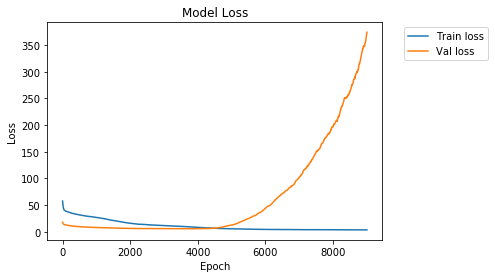

In [29]:
#Plot model loss

w = 1000
h1 = np.array(history.history['loss'])
h4 = np.array(history.history['val_loss'])
h1 = moving_average(h1,w)
h4 = moving_average(h4,w)
plt.plot(h1,label='Train loss')
plt.plot(h4,label='Val loss')
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

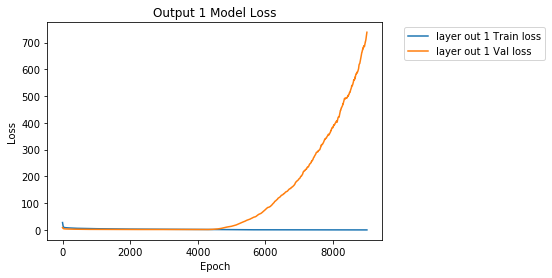

In [30]:
#Plot output 1 loss

h2 = np.array(history.history['out1_loss'])
h5 = np.array(history.history['val_out1_loss'])
h2 = moving_average(h2,w)
h5 = moving_average(h5,w)
plt.plot(h2,label='layer out 1 Train loss')
plt.plot(h5,label='layer out 1 Val loss')
plt.title('Output 1 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

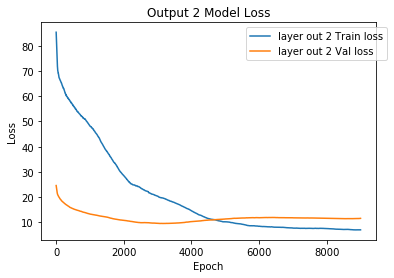

In [31]:
#Plot output 2 loss

h3 = np.array(history.history['out2_loss'])
h6 = np.array(history.history['val_out2_loss'])
h3 = moving_average(h3,w)
h6 = moving_average(h6,w)
plt.plot(h3,label='layer out 2 Train loss')
plt.plot(h6,label='layer out 2 Val loss')
plt.title('Output 2 Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(bbox_to_anchor=(1.05, 1),loc='best')
plt.show()

In [32]:
#Load ground truth RUL

thr = mat['thr']
fleet_NUM = np.arange(0,pad,1)

rul = pd.read_csv(rul_file,index_col=False)
rul = (rul-1)/(thr-1)
rul_Fleet_All = np.zeros(259)
for x in range(259):
    rul_Fleet_All[x] = rul['RUL'][x]
rul_Fleet_All_Full = ((thr-1)*rul_Fleet_All) + 1
rul_Fleet_All_Full

array([18., 50., 50., 50., 15., 50.,  6., 50., 11., 50.,  6., 50., 30.,
       11., 37., 50., 50., 50., 22., 50., 50., 10., 50., 50., 50., 50.,
       50., 50., 50., 50., 50., 11., 50., 50., 50., 50., 50., 50., 48.,
       37., 44., 27., 18.,  6., 15., 50., 50., 13., 50., 13., 50., 50.,
       50., 50., 50., 50., 50., 26., 50., 50., 50., 39., 39., 14., 11.,
       50., 50., 50., 50., 17., 50., 50., 50., 50., 50., 36., 50., 50.,
       50., 15., 50., 50., 50., 17., 47., 50., 21., 50., 50.,  8.,  9.,
       50., 50., 50., 50., 49., 31., 50.,  9., 14., 50.,  8.,  8., 50.,
       50., 50., 50., 50., 35., 50.,  9., 50., 50., 50., 50.,  7., 50.,
       50., 50., 15., 50., 50., 50.,  7., 50., 50., 50., 50., 50., 50.,
       50., 39., 38.,  9., 50., 50., 50.,  7., 50., 50., 50., 47., 50.,
       43., 50., 10., 50., 11., 50., 34., 50., 50., 50., 50., 50., 50.,
       50., 15.,  9., 42., 13., 41., 50., 14., 50., 50., 50., 50., 50.,
       50., 36., 50., 14., 50., 50., 23.,  6., 50., 35., 50., 50

In [33]:
#Make 100 predictions and calculate average RMSE & Score

import sklearn
import math
from sklearn import metrics

rmse = np.zeros(100)
rmse1 = np.zeros(100)
sc = np.zeros(100)
sc1 = np.zeros(100)

for i in range(100):
    
    preds = model(x_test)
    tens_draw = preds[0].sample(1000)
    tens_draw1 = preds[1].sample(1000)
    tens_draw2 = preds[2]
    tens_draw = tf.keras.backend.get_value(tens_draw)
    tens_draw1 = tf.keras.backend.get_value(tens_draw1)
    tens_draw2 = tf.keras.backend.get_value(tens_draw2)

    #RMSE with AU

    mean_Fleet_All = np.zeros(tens_draw.shape[1])
    mean_Fleet = np.zeros(tens_draw.shape[0])
    for y in range(tens_draw.shape[1]):
        for x in range(tens_draw.shape[0]):
            mean_Fleet[x] = tens_draw[x,y,0]
        mean_Fleet_All[y] = mean_Fleet.mean()

    RUL_mse = sklearn.metrics.mean_squared_error(rul_Fleet_All_Full, mean_Fleet_All)
    RUL_rmse = math.sqrt(RUL_mse)
    rmse[i] = RUL_rmse

    #RMSE with EU

    mean_Fleet_All1 = np.zeros(tens_draw1.shape[1])
    mean_Fleet1 = np.zeros(tens_draw1.shape[0])
    for y in range(tens_draw1.shape[1]):
        for x in range(tens_draw1.shape[0]):
            mean_Fleet1[x] = tens_draw1[x,y,0]
        mean_Fleet_All1[y] = mean_Fleet1.mean()

    RUL_mse1 = sklearn.metrics.mean_squared_error(rul_Fleet_All_Full, mean_Fleet_All1)
    RUL_rmse1 = math.sqrt(RUL_mse1)
    rmse1[i] = RUL_rmse1
    
    score = mean_Fleet_All-rul_Fleet_All_Full

    for j in range(100):
        if score[j]<0:
            score[j]= math.exp((-score[j])/13)-1
        else:
            score[j] = math.exp(score[j]/10)-1
    
    sc[i] = np.sum(score)
    
    score1 = mean_Fleet_All1-rul_Fleet_All_Full

    for j in range(100):
        if score1[j]<0:
            score1[j]= math.exp((-score1[j])/13)-1
        else:
            score1[j] = math.exp(score1[j]/10)-1
    
    sc1[i] = np.sum(score1)

In [34]:
#Average RMSE with AU & EU
np.mean(rmse),np.mean(rmse1)

(18.130610858439102, 18.744521192543996)

In [35]:
#Average early prediction Score with AU & EU
np.mean(sc),np.mean(sc1)

(2381.5039356204366, 2558.3062154724107)

In [36]:
#Calculate Mean & Std of prediction with AU

Fleet = pd.DataFrame(np.zeros((pad,tens_draw.shape[0])))
mean = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
std = pd.DataFrame(np.zeros((pad,tens_draw.shape[1])))
for z in range(tens_draw.shape[1]):
    for y in range(tens_draw.shape[0]):
        for x in range(pad):
            Fleet[y][x] = tens_draw[y,z,x]
    row_Mean = Fleet.mean(axis=1)
    row_Std = Fleet.std(axis=1)
    for j in range(pad):
        mean[z][j] = row_Mean[j]
    for k in range(pad):
        std[z][k] = row_Std[k]

In [37]:
#Calculate Mean & Std of prediction with EU

Fleet1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[0])))
mean1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
std1 = pd.DataFrame(np.zeros((pad,tens_draw1.shape[1])))
for z in range(tens_draw1.shape[1]):
    for y in range(tens_draw1.shape[0]):
        for x in range(pad):
            Fleet1[y][x] = tens_draw1[y,z,x]
    row_Mean = Fleet1.mean(axis=1)
    row_Std = Fleet1.std(axis=1)
    for j in range(pad):
        mean1[z][j] = row_Mean[j]
    for k in range(pad):
        std1[z][k] = row_Std[k]

In [38]:
#Load ground truth RUL

fleet_RUL = pd.read_csv(fleet_Rul_File, skiprows = 0,header = None)

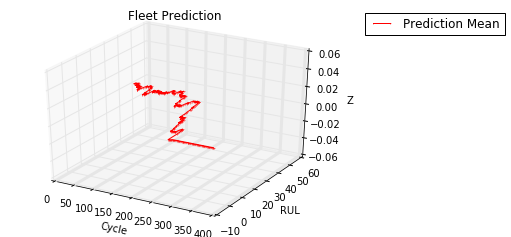

In [39]:
#3d visualization of prediction

from mpl_toolkits import mplot3d
import seaborn as sns
from scipy import stats
from scipy.stats import norm
plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 17

ax.set_title("Fleet Prediction")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
#ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
#ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.jpg',bbox_inches='tight')
plt.show()

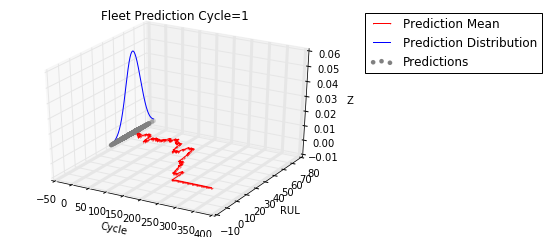

In [40]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 0

ax.set_title("Fleet Prediction Cycle=1")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.1,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y, mu, sigma),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('3D_1.jpg',bbox_inches='tight')
plt.show()

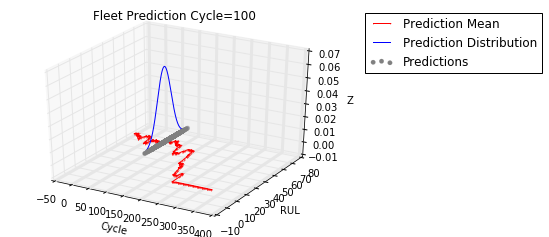

In [41]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 99

ax.set_title("Fleet Prediction Cycle=100")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y,mean[0][i],std[0][i]),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05,1),loc='upper left')
plt.savefig('3D_2.jpg',bbox_inches='tight')
plt.show()

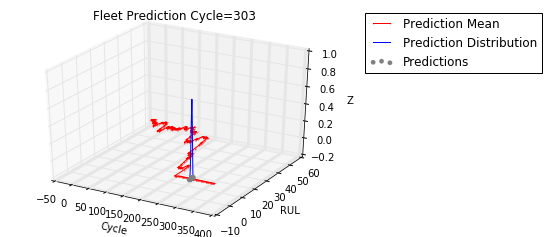

In [42]:
#3d visualization of prediction

plt.style.use('classic')
%matplotlib inline
ax = plt.axes(projection='3d')
ax.xaxis._axinfo["grid"].update({"linewidth":3})

i = 302

ax.set_title("Fleet Prediction Cycle=303")
ax.set_xlabel('Cycle')
ax.set_ylabel('RUL')
ax.set_zlabel('Z')


mu = mean[0][i]
sigma = std[0][i]
x = np.full((1000,),i)
s = np.arange(0,pad,1)
Fleet1 = Fleet.iloc[i:i+1,:].to_numpy()
Fleet1 = Fleet1.reshape(1000,)
mindist = Fleet1.min()
maxdist = Fleet1.max()
y = np.linspace(mindist,maxdist,1000)
ax.plot3D(s,mean[0],linewidth=1,marker="+",markersize=1,color='red',label='Prediction Mean')
ax.scatter3D(x,Fleet1,marker= "o",color='grey',linewidth=0.2,label='Predictions')
ax.plot3D(x,y,stats.norm.pdf(y,mean[0][i],std[0][i]),color='blue',label='Prediction Distribution')
plt.legend(bbox_to_anchor=(1.05,1),loc='upper left')
plt.savefig('3D_3.jpg',bbox_inches='tight')
plt.show()

In [43]:
#Define cycle when RUL ground truth become 0

cycle_lim = np.zeros(259)
S = 0
for K in range(259):
    for L in range(259):
        if fleet_RUL[K][L] == 0:
            S = 0
            break
        else:
            S = S + 1
            cycle_lim[K] = S

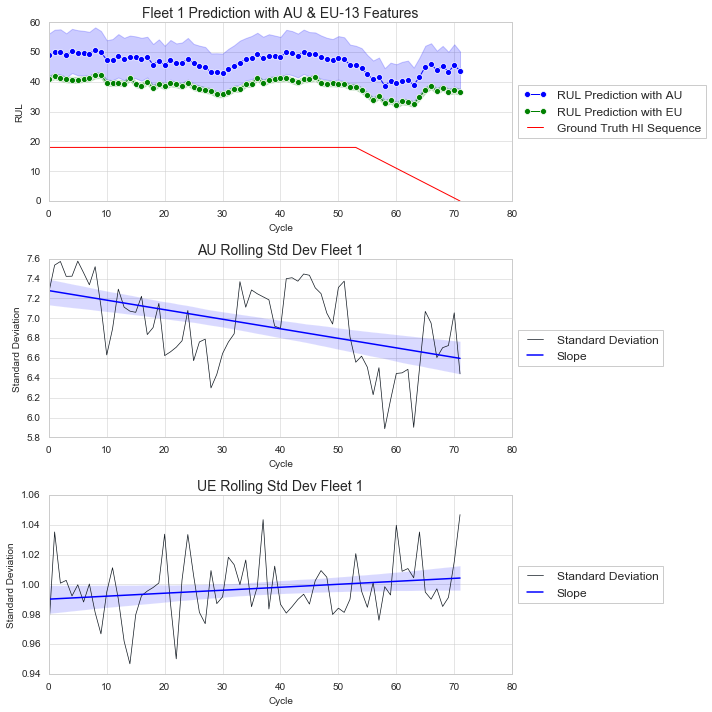

In [44]:
#Visualization Fleet 1

import seaborn as sns
import matplotlib.gridspec as gridspec
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes 
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from scipy import stats
sns.set_style("whitegrid")
for B in range(0,1):
    lim = int(cycle_lim[B]+1)
    lim2 = int(cycle_lim[B]+1)
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Cycle','RUL']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Cycle','RUL']
    
    max_Seq_Arrange1.columns = ['Cycle','RUL']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Cycle','RUL']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Cycle','RUL']
    
    #get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Cycle'],min_Std_Arrange['RUL'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Cycle", y="RUL",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="RUL Prediction with AU")
    sns.lineplot(x="Cycle", y="RUL",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="RUL Prediction with EU")
    sns.lineplot(x="Cycle", y="RUL", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth HI Sequence")
    plt.title('Fleet %i Prediction with AU & EU-13 Features' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Cycle', 'RUL', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Cycle'],min_Std_Arrange['RUL'],scatter = False,label='Slope')
    plt.title('AU Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[2],sharex=ax)
    ax.plot('Cycle', 'RUL', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Cycle'],med_Std_Arrange['RUL'],scatter = False,label='Slope')
    plt.title('UE Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig("Fleet %i Pred" %B+'.jpg')
    plt.tight_layout()
    plt.show()

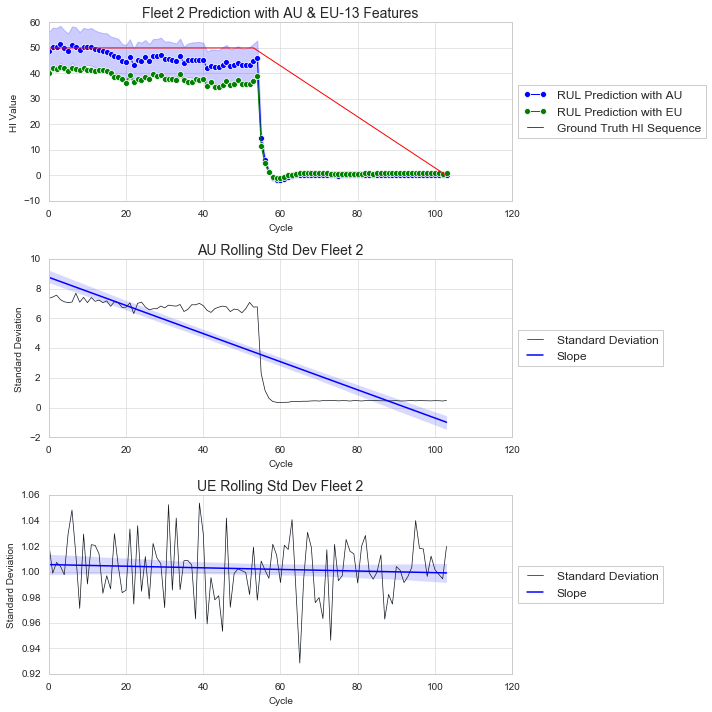

In [45]:
#Visualization Fleet 2

sns.set_style("whitegrid")
for B in range(1,2):
    lim = int(cycle_lim[B]+1)
    lim2 = int(cycle_lim[B]+1)
    max_Seq = pd.DataFrame(np.zeros((lim,tens_draw.shape[0])))
    for y in range(tens_draw.shape[0]):
        for x in range(lim):
            max_Seq[y][x] = tens_draw[y,B,x]

    max_Seq_Arrange = pd.DataFrame(np.zeros((lim*tens_draw.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw.shape[0]:
        if(m < (tens_draw.shape[0])):
            max_Seq_Arrange[0][s] = fleet_NUM[z]
            max_Seq_Arrange[1][s] = max_Seq[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue
    
    max_Seq1 = pd.DataFrame(np.zeros((lim,tens_draw1.shape[0])))
    for y in range(tens_draw1.shape[0]):
        for x in range(lim):
            max_Seq1[y][x] = tens_draw1[y,B,x]

    max_Seq_Arrange1 = pd.DataFrame(np.zeros((lim*tens_draw1.shape[0],2)))
    z = 0
    m = 0
    s = 0
    while s < lim*tens_draw1.shape[0]:
        if(m < (tens_draw1.shape[0])):
            max_Seq_Arrange1[0][s] = fleet_NUM[z]
            max_Seq_Arrange1[1][s] = max_Seq1[m][z]
            m = m + 1
            s = s + 1
        else:
            #print("change")
            z = z + 1
            m = 0
        continue

    max_Seq_Arrange.columns = ['Cycle','HI Value']
    max_RUL_Arrange = pd.DataFrame(np.zeros((lim2,2)))
    for x in range(lim2):
        max_RUL_Arrange[0][x] = fleet_NUM[x]
        max_RUL_Arrange[1][x] = fleet_RUL[B][x]
    max_RUL_Arrange.columns = ['Cycle','HI Value']
    
    max_Seq_Arrange1.columns = ['Cycle','HI Value']

    min_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        min_Std_Arrange[0][x] = fleet_NUM[x]
        min_Std_Arrange[1][x] = std[B][x]
    min_Std_Arrange.columns = ['Cycle','HI Value']
    
    med_Std_Arrange = pd.DataFrame(np.zeros((lim,2)))
    for x in range(lim):
        med_Std_Arrange[0][x] = fleet_NUM[x]
        med_Std_Arrange[1][x] = std1[B][x]
    med_Std_Arrange.columns = ['Cycle','HI Value']
    
    #get coeffs of linear fit
    slope, intercept, r_value, p_value, std_err = stats.linregress(min_Std_Arrange['Cycle'],min_Std_Arrange['HI Value'])
    gs = gridspec.GridSpec(3,1)
    fig = plt.figure(figsize=(10,10))

    ax = fig.add_subplot(gs[0])
    sns.lineplot(x="Cycle", y="HI Value",ci = "sd", marker='o', data=max_Seq_Arrange, ax=ax, label="RUL Prediction with AU")
    sns.lineplot(x="Cycle", y="HI Value",ci = "sd", marker='o', data=max_Seq_Arrange1, ax=ax, label="RUL Prediction with EU")
    sns.lineplot(x="Cycle", y="HI Value", data = max_RUL_Arrange, color='red', ax=ax,label="Ground Truth HI Sequence")
    plt.title('Fleet %i Prediction with AU & EU-13 Features' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    ax = fig.add_subplot(gs[1],sharex=ax)
    ax.plot('Cycle', 'HI Value', data=min_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(min_Std_Arrange['Cycle'],min_Std_Arrange['HI Value'],scatter = False,label='Slope')
    plt.title('AU Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    
    ax = fig.add_subplot(gs[2],sharex=ax)
    ax.plot('Cycle', 'HI Value', data=med_Std_Arrange,linestyle= '-', color = '#101820FF',linewidth=0.7, label='Standard Deviation')
    sns.regplot(med_Std_Arrange['Cycle'],med_Std_Arrange['HI Value'],scatter = False,label='Slope')
    plt.title('UE Rolling Std Dev Fleet %i' %(B+1),fontsize=14)
    ax.set_xlabel('Cycle')
    ax.set_ylabel('Standard Deviation')
    ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))
    plt.savefig("Fleet %i Pred" %B+'.jpg')
    plt.tight_layout()
    plt.show()

In [46]:
#SHAP cannot be used with model with probabilistic layers. So, transfer learned weights of probabilistic LSTM to a new LSTM without probabilistic layers
#Define New LSTM without probabilistic layers for explanation

inputs = tf.keras.Input(shape=(pad,13),dtype='float32')
layer1 = LSTM(unit1,return_sequences = True)(inputs)
layer2 = Dense(size1)(layer1)
layer3 = Dense(1)(layer2)
layer4 = Lambda(lambda t: t[:,-1],name='out2')(layer3)
model2 = tf.keras.Model(inputs=inputs, outputs=layer4)
model2.summary()

Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 367, 13)]         0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 367, 19)           2508      
_________________________________________________________________
dense_3 (Dense)              (None, 367, 196)          3920      
_________________________________________________________________
dense_4 (Dense)              (None, 367, 1)            197       
_________________________________________________________________
out2 (Lambda)                (None, 1)                 0         
Total params: 6,625
Trainable params: 6,625
Non-trainable params: 0
_________________________________________________________________


In [47]:
#Transfer weights from old LSTM to new LSTM

model2.layers[0].set_weights(model.layers[0].get_weights())
model2.layers[1].set_weights(model.layers[1].get_weights())
model2.layers[2].set_weights(model.layers[2].get_weights())
model2.layers[3].set_weights(model.layers[5].get_weights())
model2.layers[4].set_weights(model.layers[8].get_weights())

In [48]:
#Prediction with new LSTM

preds2 = model2(x_test)
y3 = preds2
y3 = tf.keras.backend.get_value(y3)
tens_draw3 = y3

In [49]:
#Import SHAP & initialized JS

import shap
shap.initjs()

In [50]:
#Extract Feature Names

features = pd.read_csv(train_file, index_col=False)
features = features.drop(['Fleet','Cycle','RUL'],axis=1)
features = np.array(list(features.columns))
features

array(['OC1', 'OC2', 'S2', 'S3', 'S4', 'S7', 'S8', 'S11', 'S12', 'S13',
       'S15', 'S17', 'S21'], dtype='<U3')

In [51]:
#load Training Files into Pandas Dataframes for SHAP Plots

xtrain = pd.read_csv(train_file, index_col=False)
xtrain = xtrain.drop(['Fleet','Cycle','RUL'],axis=1)

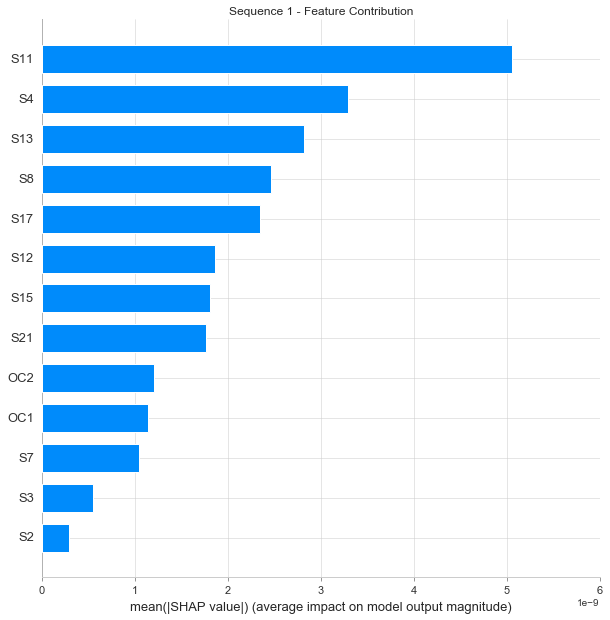

In [52]:
#SHAP Summmary Plot Fleet 1

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(0,1):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(10, 10),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure

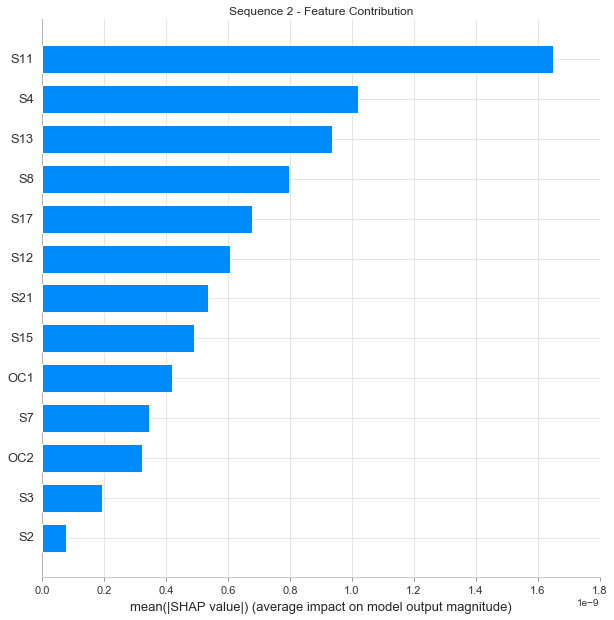

In [53]:
#SHAP Summmary Plot Fleet 2

instance = x_train
instance2 = x_test
explainer = shap.DeepExplainer(model2,instance)
shap_values = explainer.shap_values(instance2)
for i in range(1,2):
    shap.summary_plot(shap_values[0][i],feature_names=xtrain.columns,show=False,plot_size=(10, 10),plot_type="bar")
    plt.title("Sequence %i - Feature Contribution" %(i+1),fontsize=12)
    plt.savefig("Sum_Plot %i" %i+'.tiff')
    plt.figure

In [54]:
#SHAP Force Plot Fleet 1

sns.set_style("ticks")
instance2 = x_train
explainer = shap.DeepExplainer(model2,instance2)
for s in range(0,1):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    #Per individual array 
    for j in range(pad):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,13),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

1 1


1 2


1 3


1 4


1 5


1 6


1 7


1 8


1 9


1 10


1 11


1 12


1 13


1 14


1 15


1 16


1 17


1 18


1 19


1 20


1 21


1 22


1 23


1 24


1 25


1 26


1 27


1 28


1 29


1 30


1 31


1 32


1 33


1 34


1 35


1 36


1 37


1 38


1 39


1 40


1 41


1 42


1 43


1 44


1 45


1 46


1 47


1 48


1 49


1 50


1 51


1 52


1 53


1 54


1 55


1 56


1 57


1 58


1 59


1 60


1 61


1 62


1 63


1 64


1 65


1 66


1 67


1 68


1 69


1 70


1 71


1 72


1 73


1 74


1 75


1 76


1 77


1 78


1 79


1 80


1 81


1 82


1 83


1 84


1 85


1 86


1 87


1 88


1 89


1 90


1 91


1 92


1 93


1 94


1 95


1 96


1 97


1 98


1 99


1 100


1 101


1 102


1 103


1 104


1 105


1 106


1 107


1 108


1 109


1 110


1 111


1 112


1 113


1 114


1 115


1 116


1 117


1 118


1 119


1 120


1 121


1 122


1 123


1 124


1 125


1 126


1 127


1 128


1 129


1 130


1 131


1 132


1 133


1 134


1 135


1 136


1 137


1 138


1 139


1 140


1 141


1 142


1 143


1 144


1 145


1 146


1 147


1 148


1 149


1 150


1 151


1 152


1 153


1 154


1 155


1 156


1 157


1 158


1 159


1 160


1 161


1 162


1 163


1 164


1 165


1 166


1 167


1 168


1 169


1 170


1 171


1 172


1 173


1 174


1 175


1 176


1 177


1 178


1 179


1 180


1 181


1 182


1 183


1 184


1 185


1 186


1 187


1 188


1 189


1 190


1 191


1 192


1 193


1 194


1 195


1 196


1 197


1 198


1 199


1 200


1 201


1 202


1 203


1 204


1 205


1 206


1 207


1 208


1 209


1 210


1 211


1 212


1 213


1 214


1 215


1 216


1 217


1 218


1 219


1 220


1 221


1 222


1 223


1 224


1 225


1 226


1 227


1 228


1 229


1 230


1 231


1 232


1 233


1 234


1 235


1 236


1 237


1 238


1 239


1 240


1 241


1 242


1 243


1 244


1 245


1 246


1 247


1 248


1 249


1 250


1 251


1 252


1 253


1 254


1 255


1 256


1 257


1 258


1 259


1 260


1 261


1 262


1 263


1 264


1 265


1 266


1 267


1 268


1 269


1 270


1 271


1 272


1 273


1 274


1 275


1 276


1 277


1 278


1 279


1 280


1 281


1 282


1 283


1 284


1 285


1 286


1 287


1 288


1 289


1 290


1 291


1 292


1 293


1 294


1 295


1 296


1 297


1 298


1 299


1 300


1 301


1 302


1 303


1 304


1 305


1 306


1 307


1 308


1 309


1 310


1 311


1 312


1 313


1 314


1 315


1 316


1 317


1 318


1 319


1 320


1 321


1 322


1 323


1 324


1 325


1 326


1 327


1 328


1 329


1 330


1 331


1 332


1 333


1 334


1 335


1 336


1 337


1 338


1 339


1 340


1 341


1 342


1 343


1 344


1 345


1 346


1 347


1 348


1 349


1 350


1 351


1 352


1 353


1 354


1 355


1 356


1 357


1 358


1 359


1 360


1 361


1 362


1 363


1 364


1 365


1 366


1 367


In [55]:
#SHAP Force Plot Fleet 2

for s in range(1,2):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    #Per individual array 
    for j in range(pad):
        print(s+1,j+1)
        xtest_df = pd.DataFrame(data = x_test[s][j].reshape(1,13),columns=features).round(3)
        shap_display = shap.force_plot(e[0],shap_values[0][0][j],xtest_df,matplotlib = False,show = False,figsize=(10, 2),text_rotation=15)
        display(shap_display)

2 1


2 2


2 3


2 4


2 5


2 6


2 7


2 8


2 9


2 10


2 11


2 12


2 13


2 14


2 15


2 16


2 17


2 18


2 19


2 20


2 21


2 22


2 23


2 24


2 25


2 26


2 27


2 28


2 29


2 30


2 31


2 32


2 33


2 34


2 35


2 36


2 37


2 38


2 39


2 40


2 41


2 42


2 43


2 44


2 45


2 46


2 47


2 48


2 49


2 50


2 51


2 52


2 53


2 54


2 55


2 56


2 57


2 58


2 59


2 60


2 61


2 62


2 63


2 64


2 65


2 66


2 67


2 68


2 69


2 70


2 71


2 72


2 73


2 74


2 75


2 76


2 77


2 78


2 79


2 80


2 81


2 82


2 83


2 84


2 85


2 86


2 87


2 88


2 89


2 90


2 91


2 92


2 93


2 94


2 95


2 96


2 97


2 98


2 99


2 100


2 101


2 102


2 103


2 104


2 105


2 106


2 107


2 108


2 109


2 110


2 111


2 112


2 113


2 114


2 115


2 116


2 117


2 118


2 119


2 120


2 121


2 122


2 123


2 124


2 125


2 126


2 127


2 128


2 129


2 130


2 131


2 132


2 133


2 134


2 135


2 136


2 137


2 138


2 139


2 140


2 141


2 142


2 143


2 144


2 145


2 146


2 147


2 148


2 149


2 150


2 151


2 152


2 153


2 154


2 155


2 156


2 157


2 158


2 159


2 160


2 161


2 162


2 163


2 164


2 165


2 166


2 167


2 168


2 169


2 170


2 171


2 172


2 173


2 174


2 175


2 176


2 177


2 178


2 179


2 180


2 181


2 182


2 183


2 184


2 185


2 186


2 187


2 188


2 189


2 190


2 191


2 192


2 193


2 194


2 195


2 196


2 197


2 198


2 199


2 200


2 201


2 202


2 203


2 204


2 205


2 206


2 207


2 208


2 209


2 210


2 211


2 212


2 213


2 214


2 215


2 216


2 217


2 218


2 219


2 220


2 221


2 222


2 223


2 224


2 225


2 226


2 227


2 228


2 229


2 230


2 231


2 232


2 233


2 234


2 235


2 236


2 237


2 238


2 239


2 240


2 241


2 242


2 243


2 244


2 245


2 246


2 247


2 248


2 249


2 250


2 251


2 252


2 253


2 254


2 255


2 256


2 257


2 258


2 259


2 260


2 261


2 262


2 263


2 264


2 265


2 266


2 267


2 268


2 269


2 270


2 271


2 272


2 273


2 274


2 275


2 276


2 277


2 278


2 279


2 280


2 281


2 282


2 283


2 284


2 285


2 286


2 287


2 288


2 289


2 290


2 291


2 292


2 293


2 294


2 295


2 296


2 297


2 298


2 299


2 300


2 301


2 302


2 303


2 304


2 305


2 306


2 307


2 308


2 309


2 310


2 311


2 312


2 313


2 314


2 315


2 316


2 317


2 318


2 319


2 320


2 321


2 322


2 323


2 324


2 325


2 326


2 327


2 328


2 329


2 330


2 331


2 332


2 333


2 334


2 335


2 336


2 337


2 338


2 339


2 340


2 341


2 342


2 343


2 344


2 345


2 346


2 347


2 348


2 349


2 350


2 351


2 352


2 353


2 354


2 355


2 356


2 357


2 358


2 359


2 360


2 361


2 362


2 363


2 364


2 365


2 366


2 367


Contribution: [-1.89383646e-17  3.28524481e-16 -3.20406650e-16  6.55337678e-17
  2.71973915e-16 -1.39989400e-16 -2.28781031e-16  5.55826726e-16
 -3.82149899e-16 -2.09093441e-17 -4.40412981e-16  3.66856031e-16
 -3.38761113e-16]


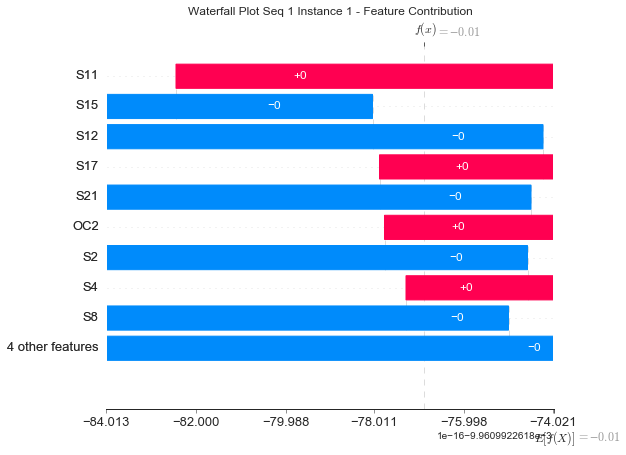

None

Contribution: [-2.97519496e-17 -2.50270416e-16  5.48794731e-17 -1.47460197e-17
  5.12228484e-17  3.06499964e-17 -9.28896221e-19 -9.70704654e-17
  8.08959809e-17 -5.52415160e-18  6.27319549e-17 -6.15791232e-17
  7.80162475e-17]


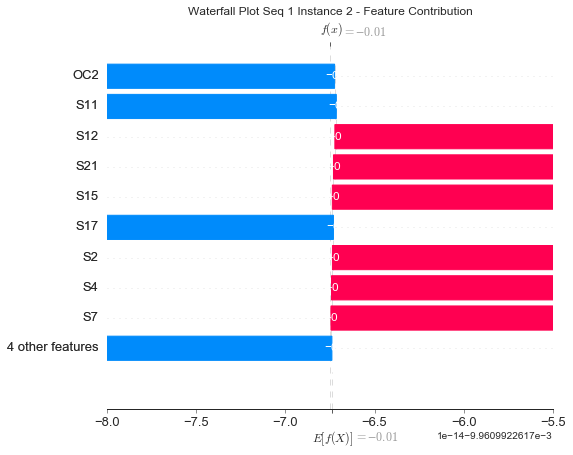

None

Contribution: [ 7.10858438e-17  3.37036580e-16 -1.21080408e-16  7.68861865e-17
  3.53624794e-16 -1.19830479e-16 -1.58981930e-16  4.08417555e-16
 -3.61181440e-16 -4.26537255e-18 -3.01214392e-16  3.43259334e-16
 -4.12650338e-16]


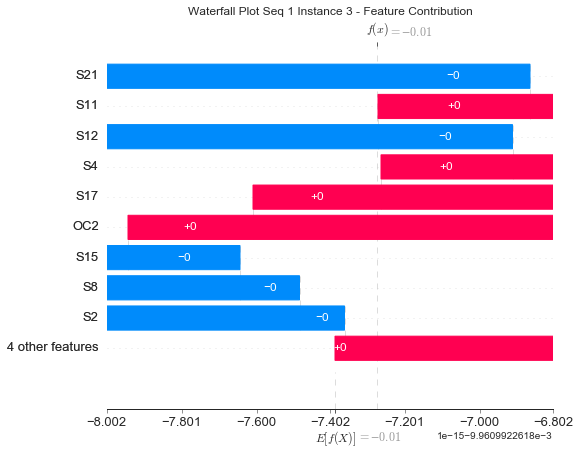

None

Contribution: [-5.12271299e-17 -2.88096128e-16  2.21943715e-16 -1.00928231e-16
 -2.47582992e-16  1.08350476e-16  1.55490804e-16 -3.82650390e-16
  3.43998768e-16  3.47747060e-17  2.92617511e-16 -3.27169652e-16
  3.93153784e-16]


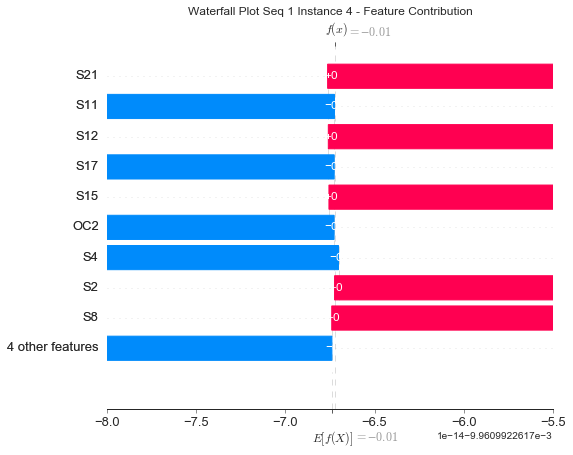

None

Contribution: [ 1.10044833e-17  2.59328670e-18  1.71252989e-16 -3.35719179e-16
 -8.46493599e-16  1.18449895e-16  9.54849865e-16 -1.80811719e-15
  3.06861031e-16  4.45152448e-16  1.46318081e-15 -9.37598769e-16
  3.11511348e-16]


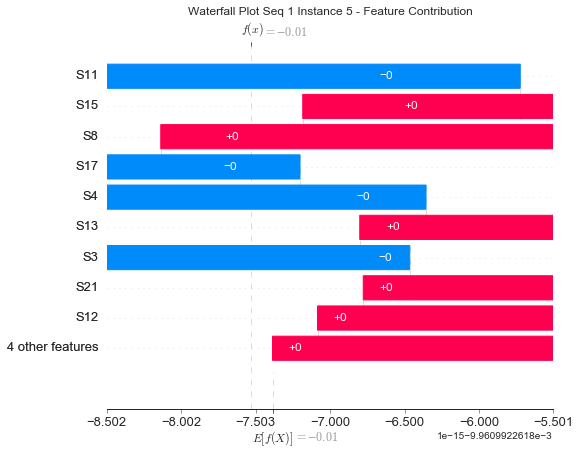

None

Contribution: [-1.12619542e-16 -8.61378178e-17  2.26766787e-16 -2.66406553e-16
 -7.57861448e-16  1.71257873e-16  7.26842360e-16 -1.35515425e-15
  4.50261010e-16  3.03490026e-16  1.12570170e-15 -8.45070690e-16
  4.77493383e-16]


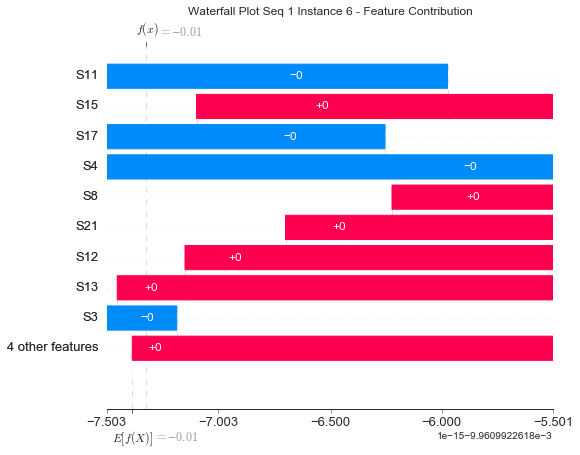

None

Contribution: [ 7.81075021e-17 -2.64365580e-18  1.02306797e-16 -2.25962053e-16
 -6.85615890e-16  1.91020872e-16  6.53205869e-16 -1.31994404e-15
  4.41414571e-16  2.18732137e-16  9.74863666e-16 -7.07850611e-16
  4.51086496e-16]


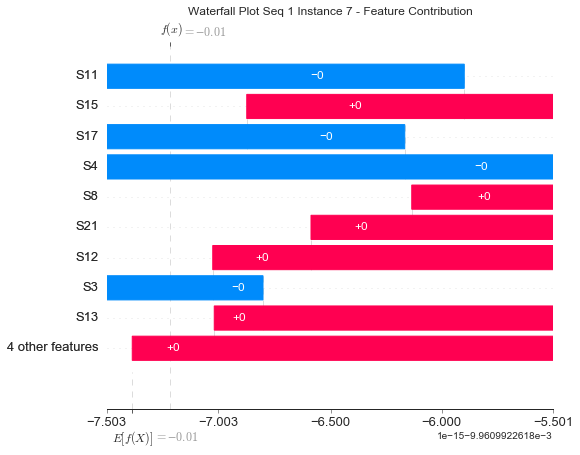

None

Contribution: [ 8.72951361e-17 -9.70519763e-16  4.94703187e-16 -2.84104803e-16
 -1.24983068e-15  4.60686873e-16  4.17231410e-16 -1.27108400e-15
  1.22989247e-15  5.92545579e-18  1.08517965e-15 -1.20737760e-15
  1.27359397e-15]


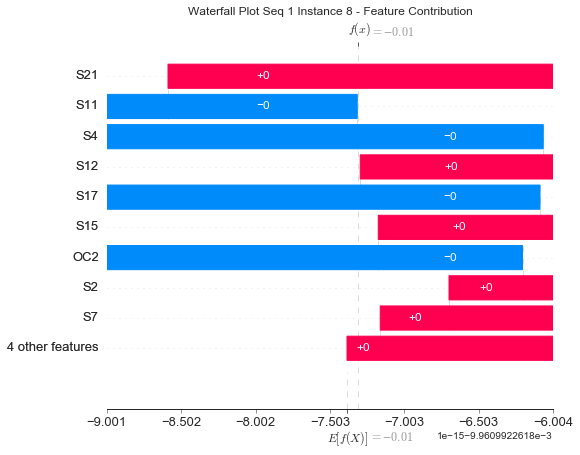

None

Contribution: [-8.99298983e-17  1.85569460e-16  4.74772919e-17 -2.05254678e-17
  2.83921156e-16 -1.51255269e-16 -3.53885303e-17  1.31526336e-16
 -3.92184751e-16 -8.30743031e-18 -3.53206519e-16  1.84731573e-16
 -2.80799998e-16]


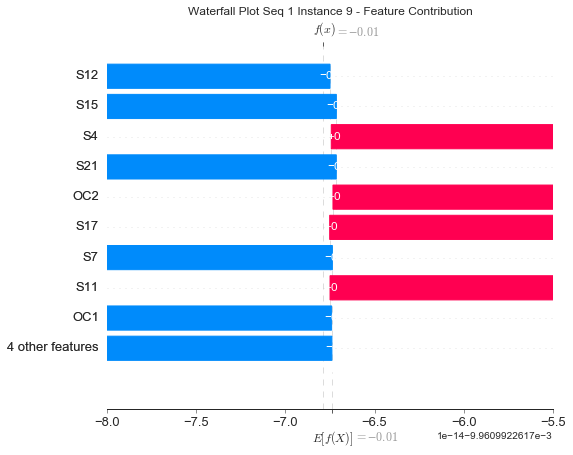

None

Contribution: [ 4.28820885e-17  9.16493143e-16 -2.90603240e-16  2.50852063e-16
  1.35670082e-15 -4.46906918e-16 -5.46696081e-16  1.46879526e-15
 -1.06927883e-15 -9.64012896e-17 -1.24051723e-15  1.10714448e-15
 -1.07637569e-15]


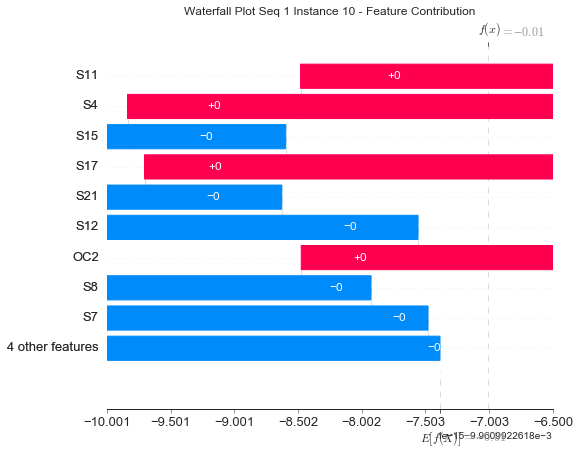

None

Contribution: [ 3.82298064e-17  1.05434913e-15 -1.12396534e-16  1.09695703e-16
  5.63866868e-16 -1.47264857e-16  8.69238181e-17  5.00007466e-16
 -4.47671153e-16  8.75378177e-17 -9.62938289e-16  1.90932357e-16
 -4.24603243e-16]


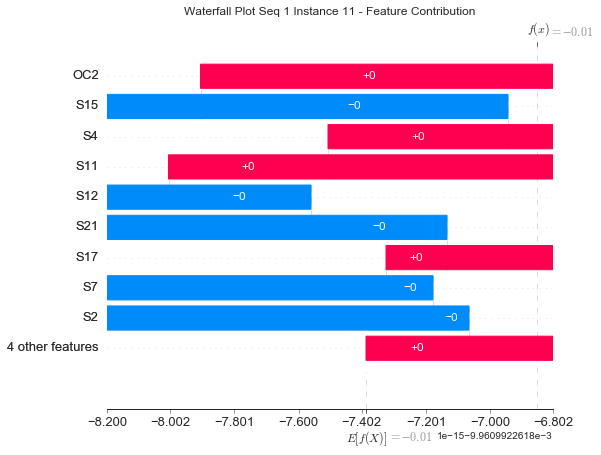

None

Contribution: [-4.08244125e-16 -8.11764295e-16  3.16362518e-16  3.91816166e-17
 -5.53590665e-16  5.08578646e-16 -3.41200859e-16  4.53823683e-16
  1.11446073e-15 -4.87002546e-16 -7.31354134e-16 -4.80381236e-16
  1.27291222e-15]


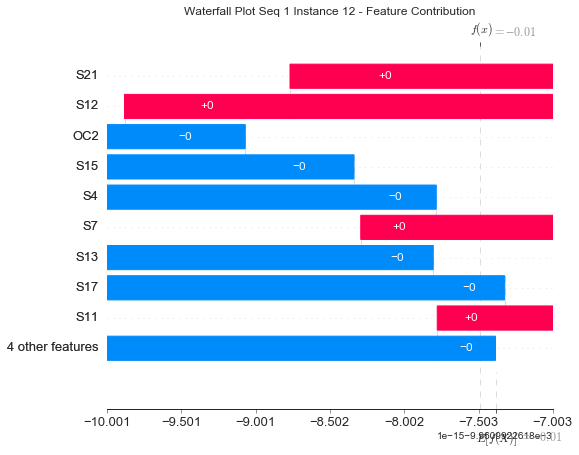

None

Contribution: [ 1.46978666e-16  7.98401980e-16 -7.65523099e-17 -3.43756331e-16
 -2.15382148e-16 -4.30477695e-17  1.15669093e-15 -1.93464040e-15
 -2.06456115e-16  6.51678509e-16  1.86427949e-15 -5.89322008e-16
 -3.20345717e-16]


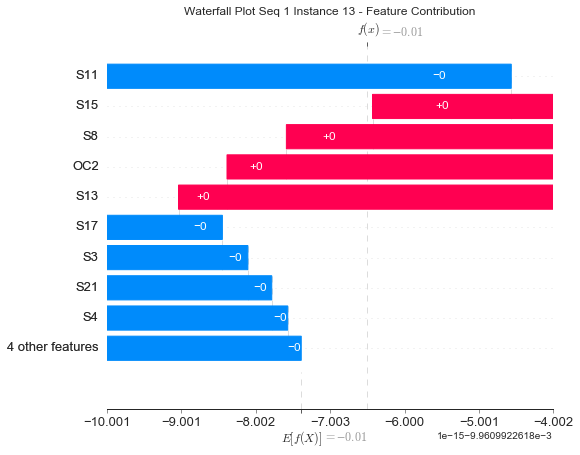

None

Contribution: [ 4.20563081e-16 -1.39721515e-15  5.29708041e-16 -3.88603126e-16
 -1.64808122e-15  4.66443521e-16  3.36919901e-16 -1.54475453e-15
  1.48519752e-15 -2.55248267e-17  1.92194042e-15 -1.10046182e-15
  1.41421817e-15]


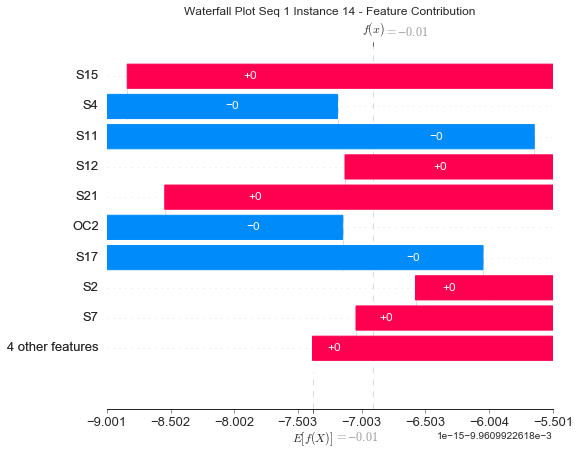

None

Contribution: [ 1.19027677e-16  2.47510778e-15 -4.91715702e-16  3.75876905e-16
  2.20940265e-15 -1.08042525e-15 -9.10851692e-16  3.11585940e-15
 -2.40014176e-15 -4.51196346e-16 -3.50199631e-15  1.51442334e-15
 -2.32536993e-15]


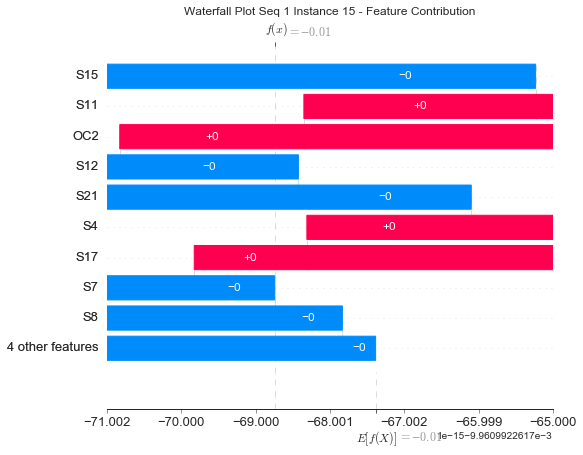

None

Contribution: [-1.88519610e-16 -9.59516143e-17  2.98701775e-16 -9.60283370e-16
 -3.45991317e-15  5.58991188e-16  3.02626407e-15 -5.61316918e-15
  1.51475516e-15  1.67693031e-15  5.43798921e-15 -3.37454496e-15
  1.51730738e-15]


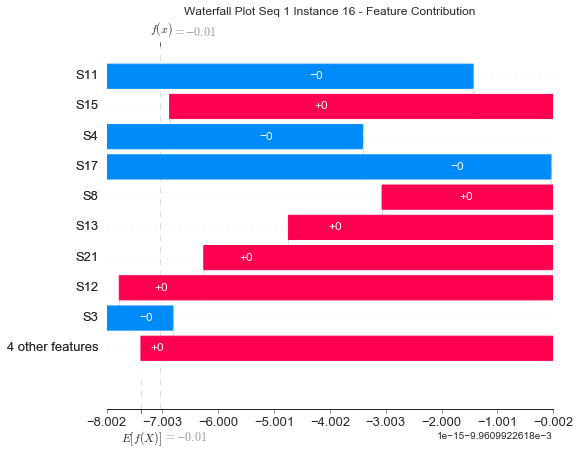

None

Contribution: [ 2.02130278e-16 -1.82053638e-15  7.43679999e-16 -1.18349137e-15
 -5.97228955e-15  1.10106480e-15  3.91352769e-15 -8.60260722e-15
  3.16316556e-15  2.07962386e-15  8.81719455e-15 -5.10939252e-15
  2.96582975e-15]


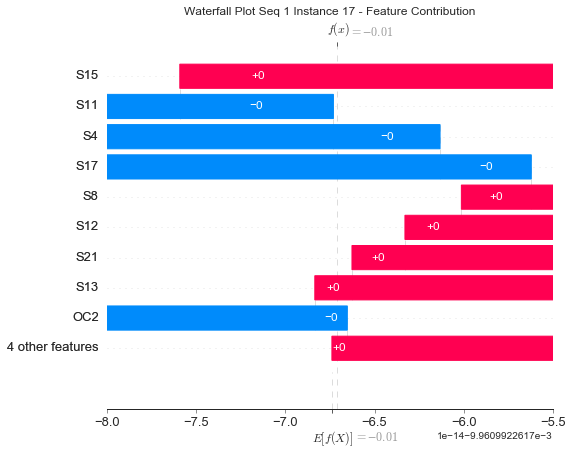

None

Contribution: [ 2.49159612e-16  1.35251151e-15 -6.64213273e-16  5.64677902e-16
  3.75628915e-15 -1.77373368e-15 -1.49786109e-15  3.24369192e-15
 -3.82934956e-15  1.29319370e-18 -1.24545183e-15  3.38669946e-15
 -4.08103693e-15]


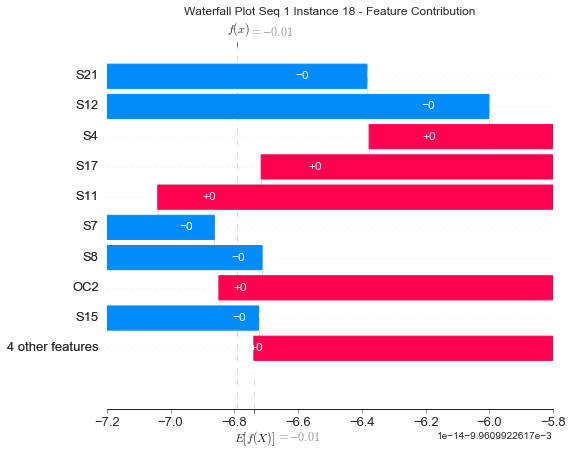

None

Contribution: [ 2.02780521e-16 -1.87125418e-15  4.24242725e-16 -4.82115219e-16
 -3.15884971e-15  1.16135660e-15  8.58511938e-16 -2.31030714e-15
  2.95440539e-15 -5.16575848e-17  2.34583043e-15 -2.31675391e-15
  3.06338592e-15]


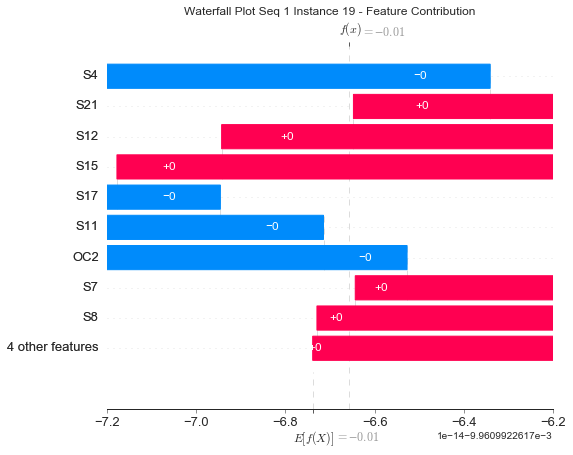

None

Contribution: [ 5.83056585e-17 -1.26110119e-15  6.65402190e-16 -4.42979570e-16
 -2.40328425e-15  8.71053266e-16  8.03148911e-16 -2.52230403e-15
  2.07124797e-15 -7.47166704e-17  9.99595016e-16 -2.29744854e-15
  1.98670583e-15]


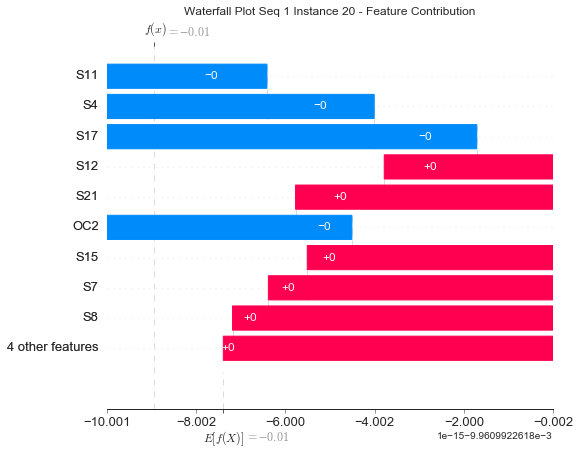

None

Contribution: [ 7.10070168e-17  3.30619639e-15 -3.40807544e-16  6.67391023e-16
  6.38828437e-15 -1.96538579e-15 -2.60710558e-15  7.01633093e-15
 -4.48872701e-15 -8.26561643e-16 -6.62439184e-15  4.58299670e-15
 -4.48503564e-15]


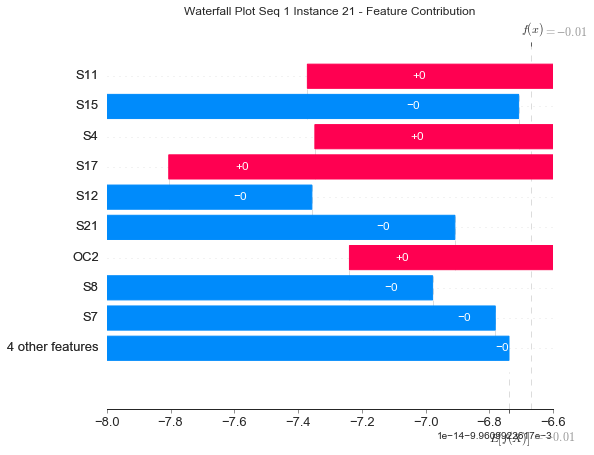

None

Contribution: [ 1.52171507e-16 -9.55774402e-16  6.81782537e-16 -2.28271594e-16
 -1.49324794e-15  3.88752283e-16  2.31078105e-16 -1.27386555e-15
  9.92263416e-16 -1.54357143e-16  2.13344677e-16 -1.09319766e-15
  8.97046114e-16]


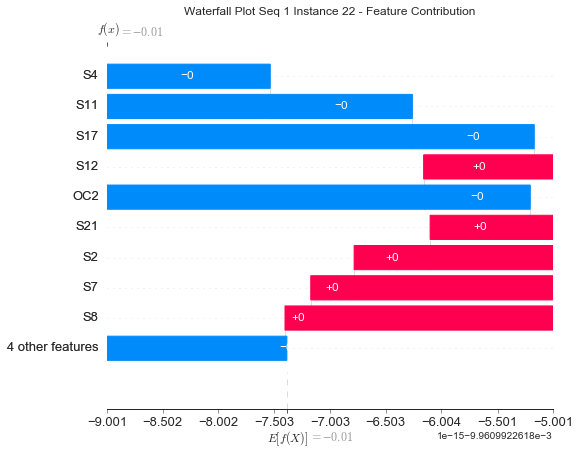

None

Contribution: [ 9.68129873e-17  5.88813047e-16  5.45594409e-16 -6.56545958e-17
  1.55558458e-15 -3.81927024e-16 -1.82346460e-16  6.29475499e-16
 -7.00865501e-16 -2.87446189e-17 -9.08442095e-16  5.27285527e-16
 -7.04845391e-16]


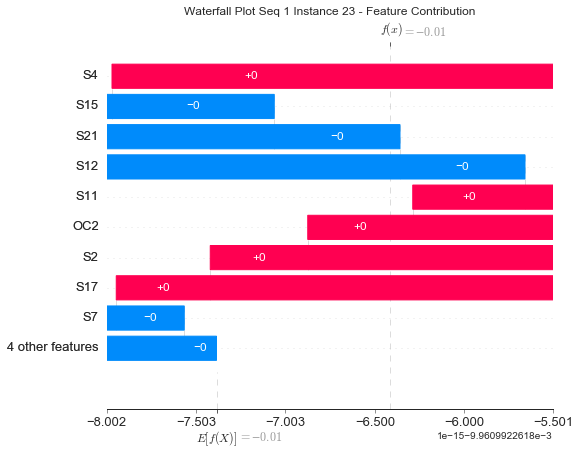

None

Contribution: [ 2.62151377e-16 -5.11115298e-16  3.65008546e-16 -2.12484276e-16
 -1.16514739e-15  3.66815585e-16  3.99770937e-16 -8.42443299e-16
  1.09802670e-15  1.99958224e-17  8.03519965e-16 -8.53532072e-16
  1.15721260e-15]


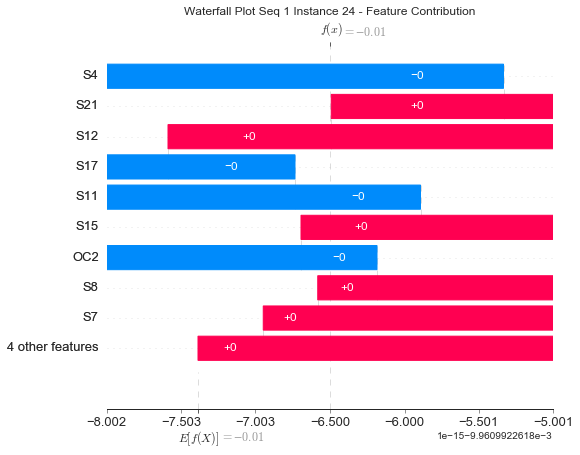

None

Contribution: [-7.91877206e-17 -1.17987814e-15  1.45501930e-16 -7.04874283e-17
 -5.38264556e-16  1.50872264e-16  2.48600894e-17 -7.32465600e-16
  3.28263966e-16  3.93479461e-17  1.54339250e-15 -6.75864091e-18
  3.53438420e-16]


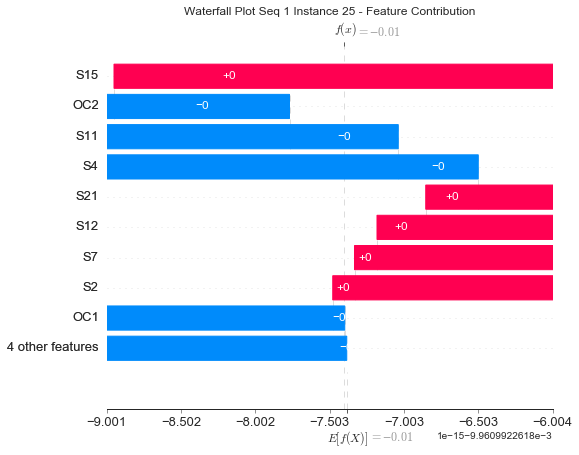

None

Contribution: [-2.26703868e-16 -2.66690335e-16  4.14904796e-16 -1.52335011e-16
  2.20753211e-16  3.11951011e-16 -4.20744054e-18  4.19746912e-16
  7.21774827e-16 -3.47107140e-16 -6.50533533e-16 -3.81123348e-16
  9.61280857e-16]


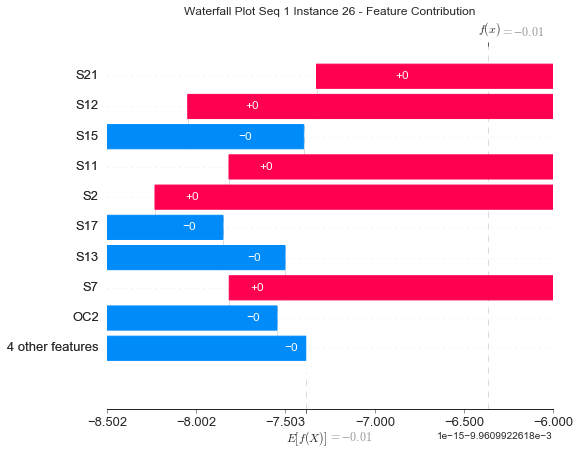

None

Contribution: [-1.73824753e-16 -7.80457058e-16 -3.93328272e-16  9.40922380e-17
 -1.69007828e-15  8.91482378e-16  1.22761994e-16 -2.86323077e-16
  1.90383043e-15 -1.65255202e-16 -8.97048191e-17 -1.08549273e-15
  2.03474720e-15]


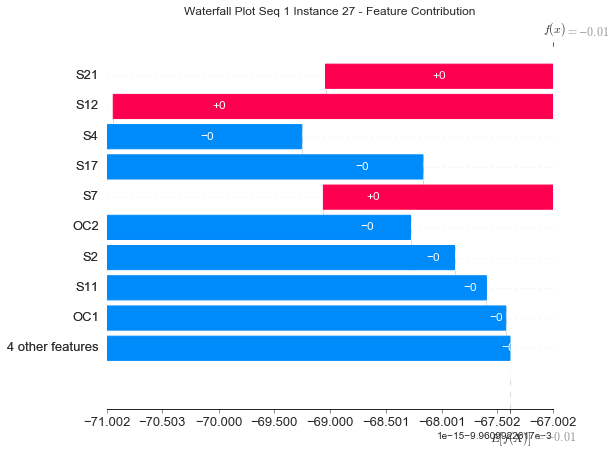

None

Contribution: [ 5.40690459e-16 -1.85702699e-15  5.28191905e-16 -4.30323919e-16
 -3.27980263e-15  1.19884385e-15  6.38036303e-16 -2.34010512e-15
  3.23443321e-15 -2.98958029e-16  1.38028159e-15 -2.31971768e-15
  2.94667219e-15]


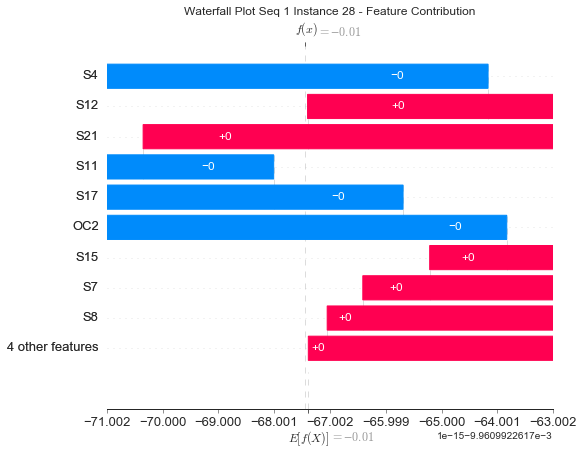

None

Contribution: [-2.52468985e-18 -8.56793626e-16  8.91504189e-16 -2.24182066e-16
  1.08223451e-15 -1.18024433e-16 -3.01996865e-16  3.47820818e-16
  1.04286544e-16 -3.52178459e-16 -7.80213377e-16 -4.10720023e-17
  2.10070166e-16]


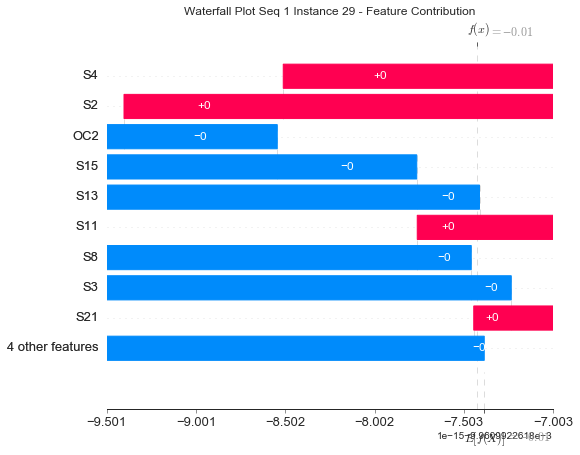

None

Contribution: [ 7.23846934e-16  1.50255789e-15 -5.10083611e-16 -3.94882657e-17
  1.42070316e-15 -8.36506869e-16  8.42475381e-17  6.78497584e-16
 -1.83352225e-15 -8.88309326e-17 -9.59481653e-16  1.03549757e-15
 -2.06860777e-15]


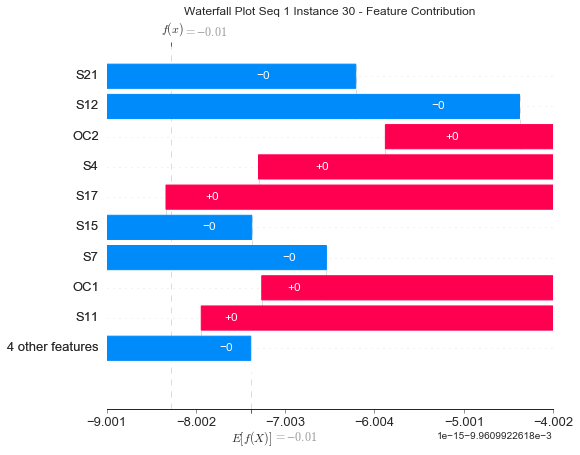

None

Contribution: [-7.69189627e-18  3.91400875e-16 -9.21734967e-17 -4.31979497e-16
 -3.54199532e-16  3.75521171e-17  6.42965293e-16 -1.52182196e-15
 -8.83224746e-17 -2.08742085e-16  1.29341656e-15 -6.01769528e-16
 -9.86216475e-17]


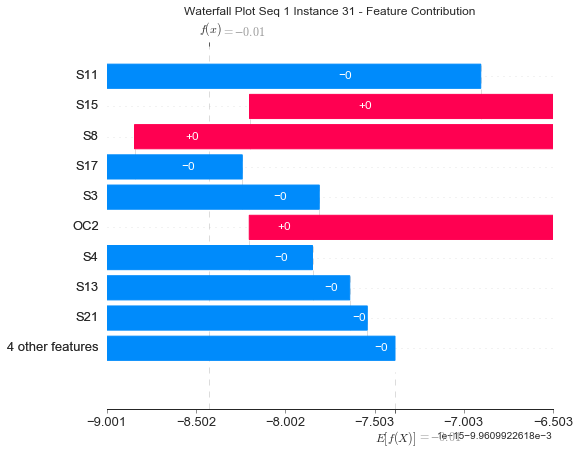

None

Contribution: [-1.76564230e-16  1.91581912e-15 -8.90170959e-16  1.91129252e-16
 -6.40572266e-16  8.28137081e-18  3.84215707e-16  2.68082037e-16
 -4.26754416e-16  1.16405382e-16 -1.21353510e-15 -8.10975152e-17
 -1.53257496e-16]


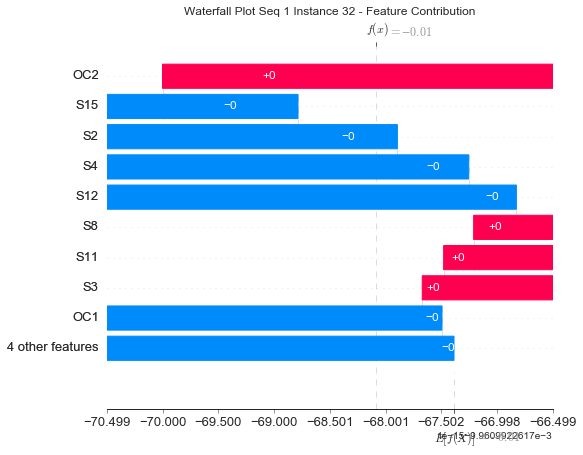

None

Contribution: [ 3.62011691e-16  2.13488958e-15 -6.41829898e-16 -6.16611531e-17
  1.50450511e-15 -1.40003789e-15  3.61698553e-16 -2.05067577e-16
 -3.04538774e-15  6.27419856e-16  6.17041426e-16  1.34614245e-15
 -3.12984031e-15]


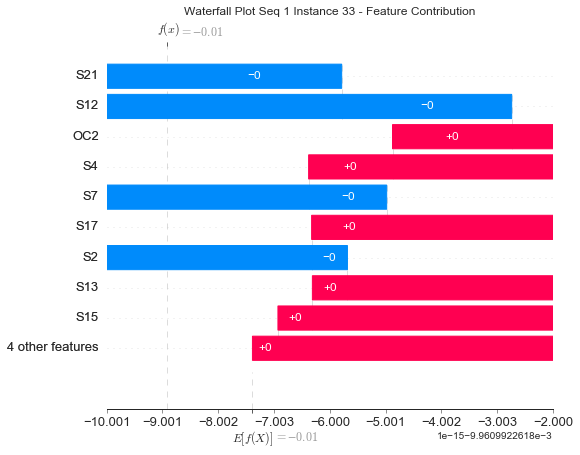

None

Contribution: [-8.01533646e-17 -5.35603391e-16 -1.00216004e-15  2.89639052e-16
 -1.95873764e-15  3.14677478e-16 -1.71730967e-16 -4.63532110e-16
  8.10949873e-16  3.77694691e-16  1.96003488e-15 -6.04804712e-16
  5.60023986e-16]


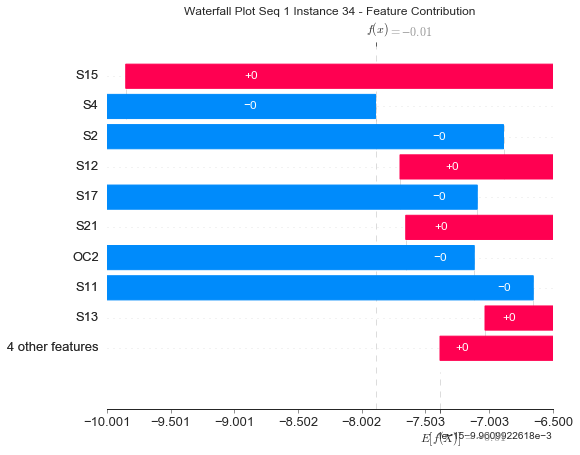

None

Contribution: [-7.13368925e-16  1.28486491e-15 -1.00744669e-15 -2.18238529e-16
 -1.38056354e-15  4.98173905e-16  1.53289723e-15 -1.79269822e-15
  5.56373909e-16  8.06707456e-16  1.98700546e-15 -1.15414306e-15
  7.23330032e-16]


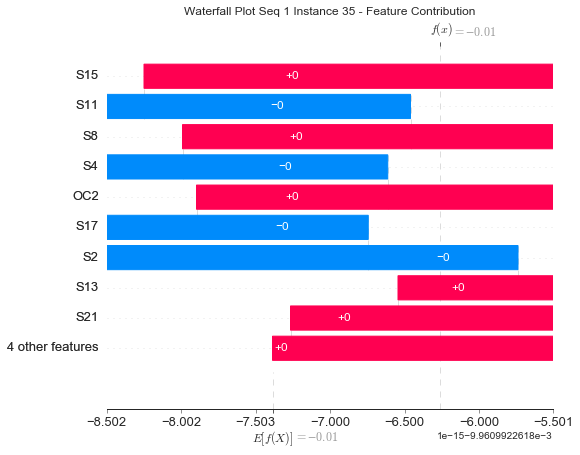

None

Contribution: [-5.95850885e-16  2.91342890e-15 -2.79009074e-15  3.81824919e-15
  1.27193822e-14 -1.54277543e-15 -9.18568607e-15  2.23445411e-14
 -5.68010596e-15 -4.33795218e-15 -2.32594942e-14  1.17194039e-14
 -4.89779692e-15]


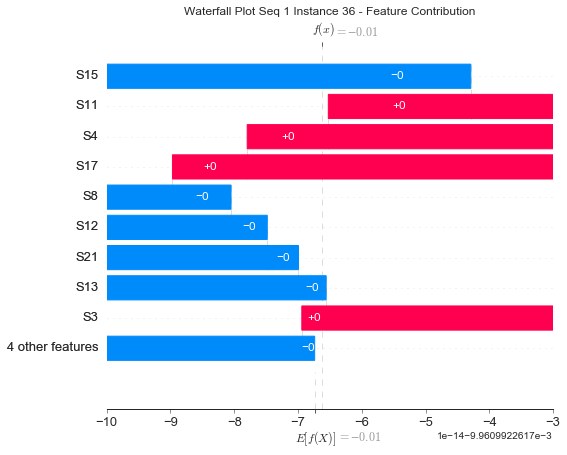

None

Contribution: [ 7.02664586e-17 -6.41526322e-15  3.08306377e-15 -2.34431890e-15
 -1.01011373e-14  3.36001538e-15  5.28271325e-15 -1.40908369e-14
  8.16207894e-15  1.91574098e-15  1.28941479e-14 -9.43168561e-15
  8.34046662e-15]


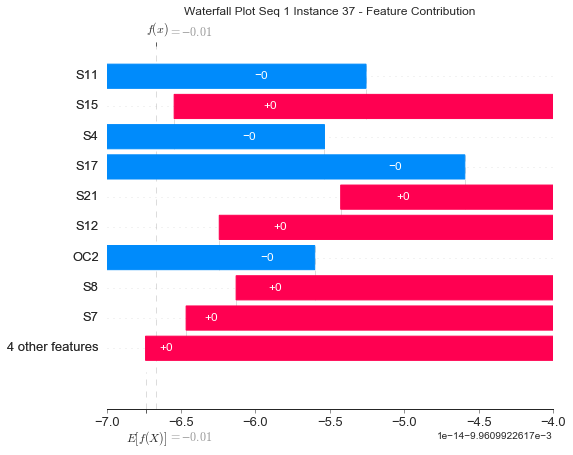

None

Contribution: [-2.12022498e-16  3.09000817e-15 -2.86622609e-15 -2.80287464e-16
  4.18991809e-16 -1.26983696e-15  2.28044351e-15 -3.67216057e-15
 -4.27521500e-15  2.67379375e-15  3.78324386e-15  1.84214462e-15
 -4.33209665e-15]


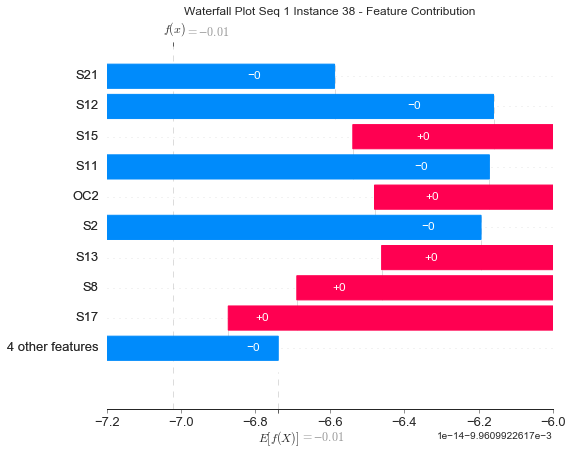

None

Contribution: [-6.91060671e-16  7.34023590e-15 -2.81850404e-15  2.93639800e-16
  5.99312402e-15 -3.60937637e-15  5.52094963e-16  8.83694810e-16
 -8.63396099e-15  2.36591041e-15  2.62728614e-15  4.99612558e-15
 -8.85920653e-15]


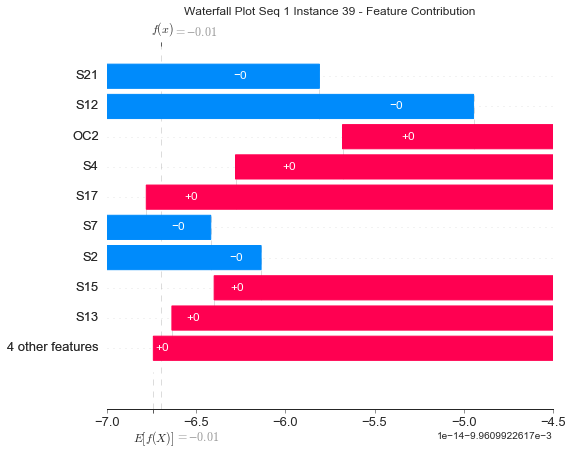

None

Contribution: [ 1.07806044e-15  9.25604782e-16  1.80659782e-15 -1.05610884e-15
 -1.01706687e-15 -3.46714706e-17  1.29083364e-15 -1.82608763e-15
  1.29301718e-15  2.51892749e-16  1.20313428e-15 -2.31337530e-15
  1.46967215e-15]


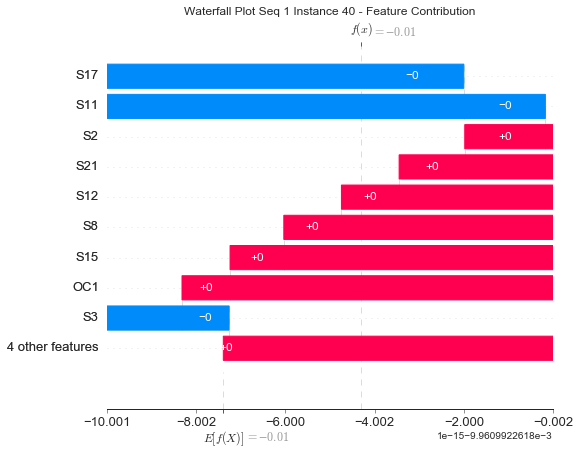

None

Contribution: [-8.42038470e-16 -5.60472045e-15  3.63013545e-15 -3.67935230e-15
 -1.25689000e-14  2.49838276e-15  1.05592245e-14 -2.38088239e-14
  7.79197297e-15  6.17454408e-15  2.06555117e-14 -1.31906857e-14
  7.09185069e-15]


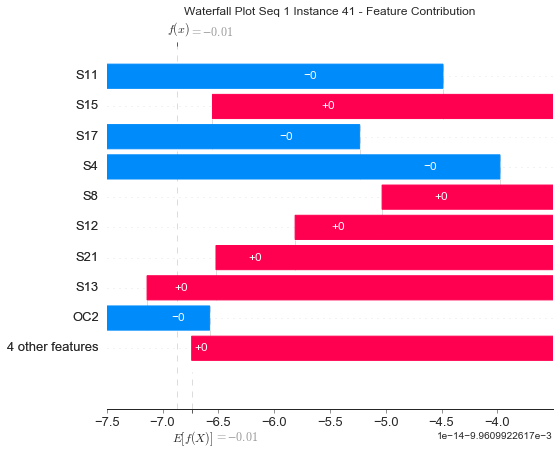

None

Contribution: [-1.41751070e-16 -3.40936669e-15 -2.37371057e-16 -2.82883593e-16
 -7.49464662e-15  3.38452851e-15  1.27418827e-15 -5.06881329e-15
  7.21784303e-15 -3.09869719e-16  3.61664984e-15 -3.99439774e-15
  6.79245885e-15]


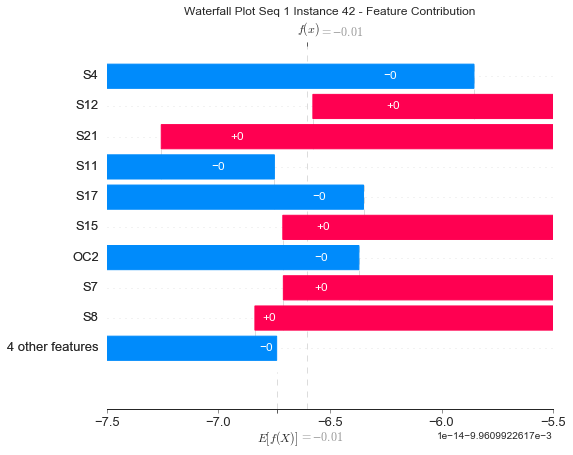

None

Contribution: [ 1.87473252e-15  8.00761655e-15 -1.62146427e-15  3.76269230e-15
  1.65443661e-14 -5.83621117e-15 -1.38336718e-14  2.73244714e-14
 -1.22891530e-14 -6.56696047e-15 -2.42014880e-14  1.61833590e-14
 -1.26948767e-14]


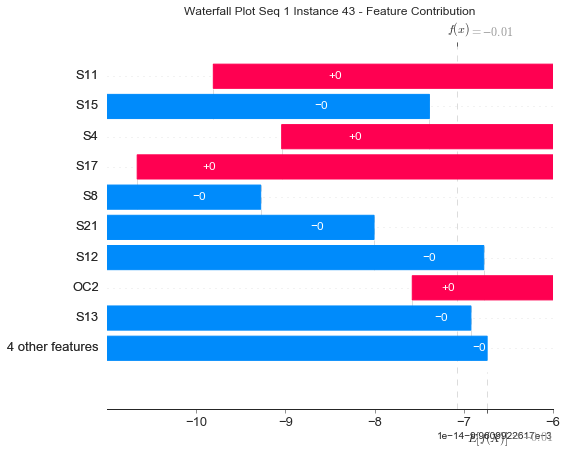

None

Contribution: [-2.76404067e-15 -4.01732057e-15  7.15239068e-16  3.83496327e-15
  5.06506687e-15  1.20292496e-15 -1.08152301e-14  2.10460532e-14
  3.40853448e-15 -6.91947567e-15 -2.11754120e-14  5.20152091e-15
  3.97612258e-15]


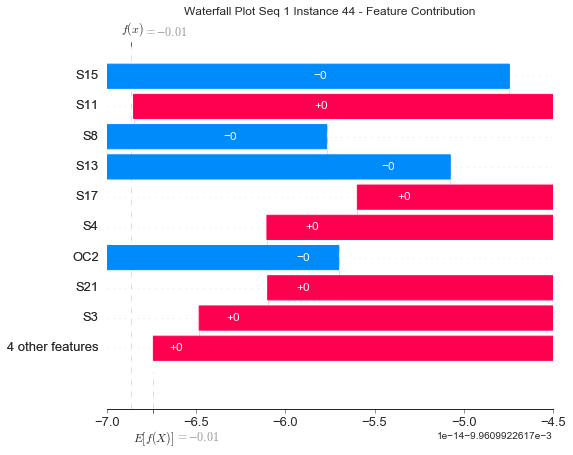

None

Contribution: [-3.15493965e-16 -2.58544446e-16 -1.56357909e-15  3.88175591e-15
  9.58897455e-15 -3.24375370e-16 -1.23881703e-14  2.27362938e-14
 -1.78435283e-15 -5.65466405e-15 -2.47756358e-14  1.13795209e-14
 -1.70129130e-15]


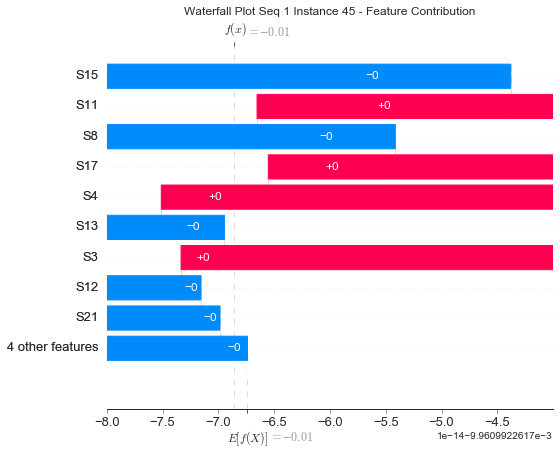

None

Contribution: [-1.28609205e-15  6.36434637e-15 -3.27611338e-15  2.86932284e-15
  1.54500673e-14 -6.10202832e-15 -4.16279636e-15  8.29861895e-15
 -1.56011153e-14  7.13053881e-16 -5.79910562e-15  1.20495062e-14
 -1.55524092e-14]


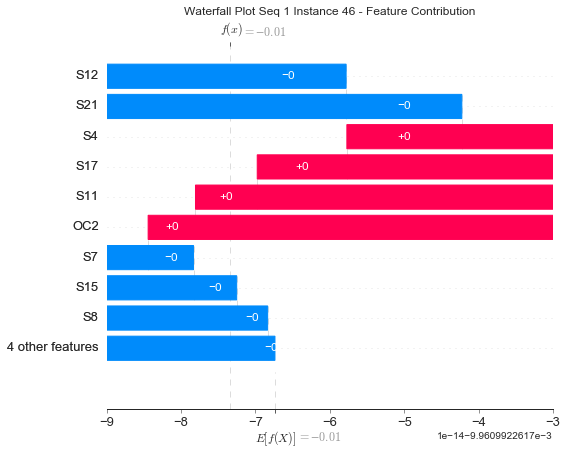

None

Contribution: [-1.66310208e-15  4.02323879e-15 -2.78933900e-15 -3.78592768e-15
 -2.38581297e-14  5.46937263e-15  1.47065689e-14 -2.70487097e-14
  1.16178116e-14  7.59391380e-15  1.60694313e-14 -1.83977064e-14
  1.19136209e-14]


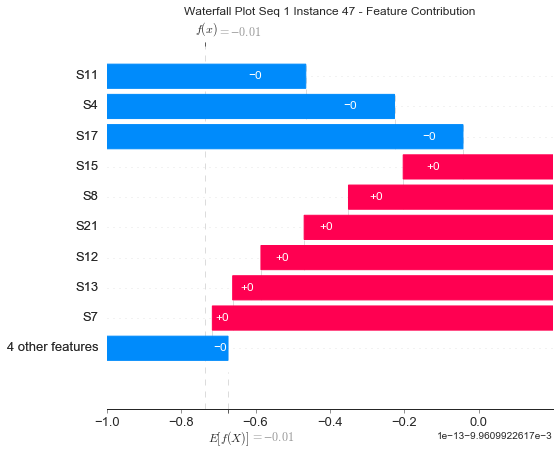

None

Contribution: [-2.50804084e-15 -4.15953994e-15 -2.05978190e-15  7.39573096e-15
  1.72676933e-14  4.50884373e-16 -2.15669970e-14  4.25503477e-14
 -6.33669424e-16 -1.22169798e-14 -3.75347709e-14  1.82359417e-14
 -3.77265934e-16]


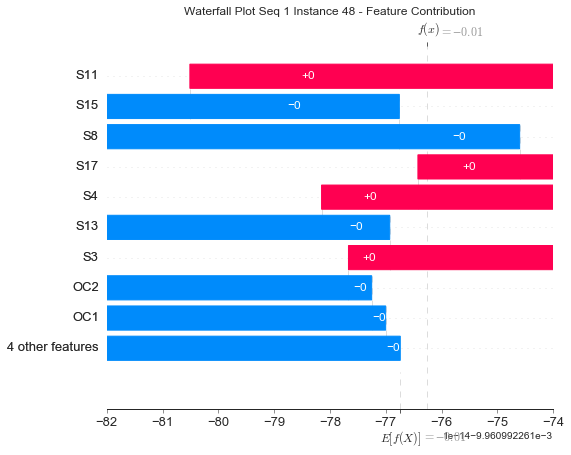

None

Contribution: [ 5.08262014e-16  1.38621886e-15 -3.89985870e-15 -7.32157968e-16
 -4.40046406e-15 -1.40120891e-15  4.07090006e-15 -1.29131731e-14
 -4.87034754e-15  4.95639593e-15  2.02162421e-14  1.17631065e-16
 -6.02188418e-15]


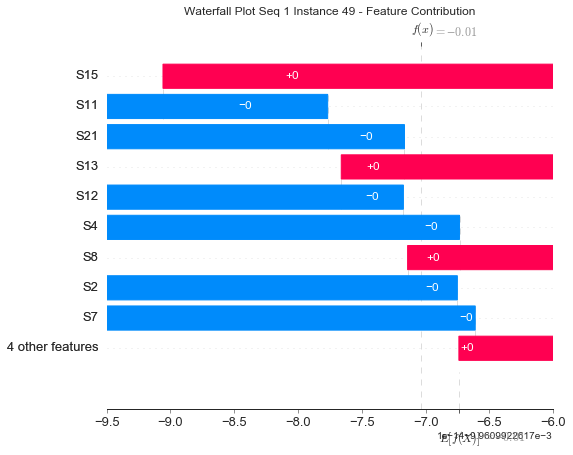

None

Contribution: [ 4.67030208e-15  1.13603483e-14 -1.01685425e-16  3.31646751e-15
  2.72116195e-14 -1.38019767e-14 -1.01795734e-14  2.26311855e-14
 -2.84558957e-14 -1.35509570e-15 -1.40824420e-14  2.37110238e-14
 -3.00365608e-14]


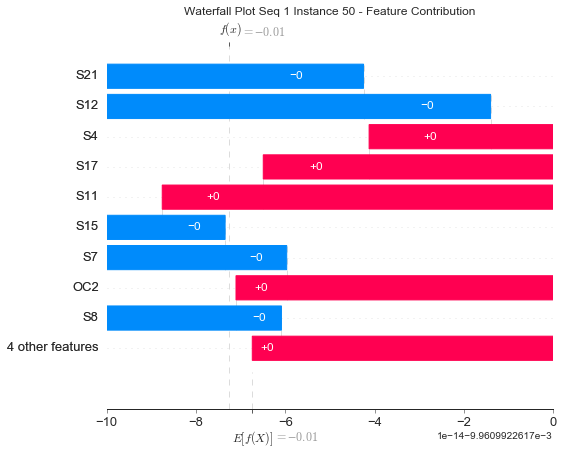

None

Contribution: [-2.47094927e-15 -2.02748813e-15  1.82056878e-15  4.39579479e-15
  1.64301793e-14 -1.86973206e-15 -1.79460583e-14  3.53590753e-14
 -3.89842213e-15 -9.35933460e-15 -3.40170566e-14  1.61781091e-14
 -2.55257106e-15]


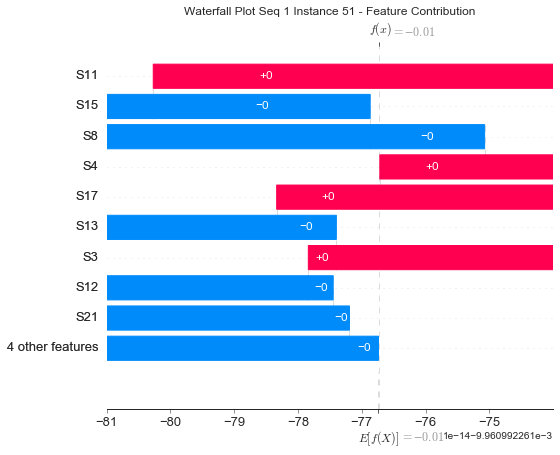

None

Contribution: [-9.21947823e-16  7.17112832e-15  2.57077067e-16  4.46798233e-16
  1.02553667e-14 -5.73739927e-15 -6.91342045e-16  4.74669979e-15
 -1.26309079e-14  1.50427334e-15 -1.67631558e-15  5.74400231e-15
 -1.29859502e-14]


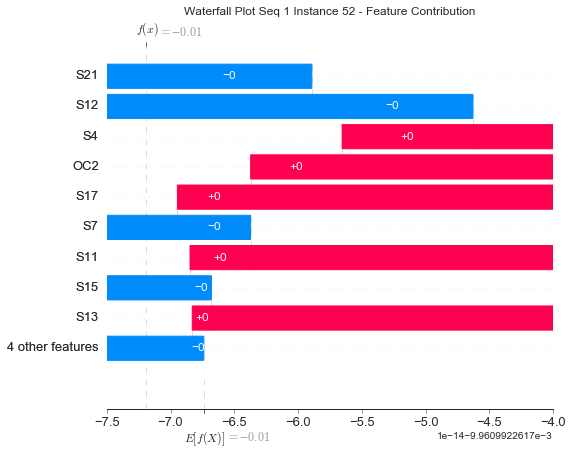

None

Contribution: [ 1.24004649e-15 -1.21226331e-14  1.38676171e-15 -4.89093637e-15
 -3.11870010e-14  5.20704187e-15  1.51088231e-14 -4.07569520e-14
  1.39099590e-14  8.71563530e-15  4.44230054e-14 -2.07971576e-14
  1.26492512e-14]


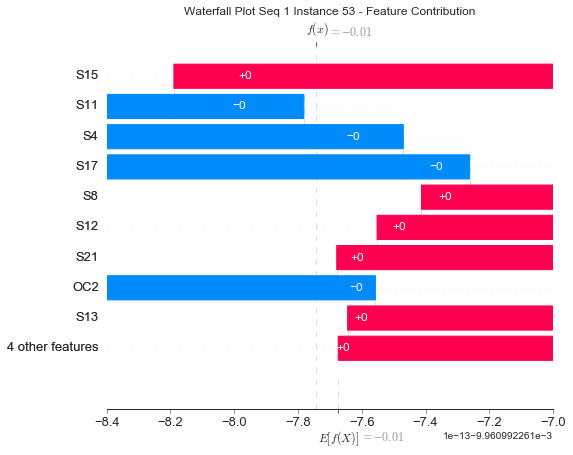

None

Contribution: [ 1.93849049e-16  2.43680918e-15  8.59411804e-16 -3.64455492e-15
 -2.23481003e-14  5.67579922e-15  1.27466507e-14 -2.54358692e-14
  1.32940178e-14  3.95237389e-15  9.69431580e-15 -1.94403277e-14
  1.36590670e-14]


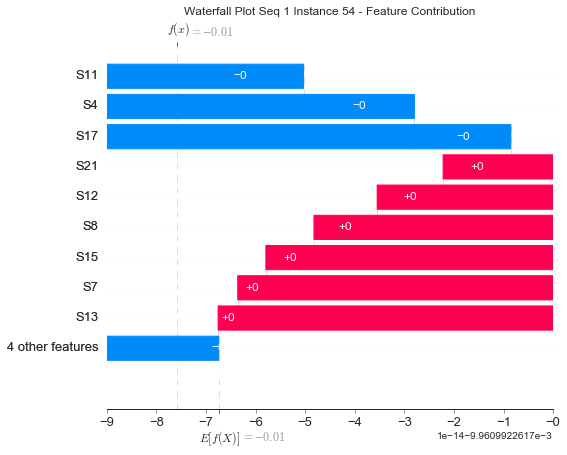

None

Contribution: [ 1.95263032e-15 -4.40372495e-17  3.13606685e-15 -3.94195708e-15
 -1.73927425e-14  2.96297144e-15  1.06652112e-14 -2.15810459e-14
  9.86253061e-15  3.64545616e-15  1.15598847e-14 -1.67684792e-14
  9.49868253e-15]


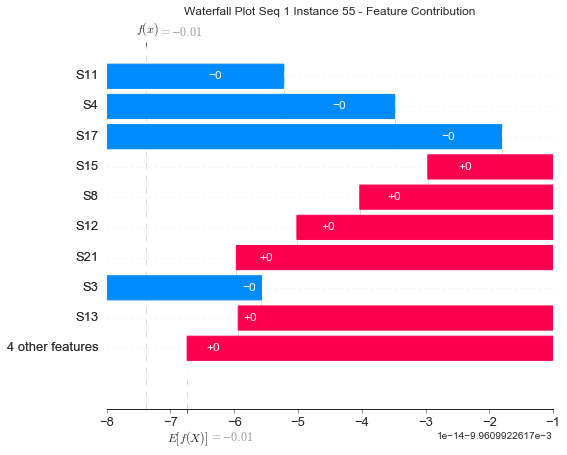

None

Contribution: [-1.43795977e-15 -1.59302482e-15 -9.40902621e-16 -2.29311661e-15
 -7.06951528e-15  1.96139457e-15  8.77349866e-15 -1.48829703e-14
  5.16115386e-15  4.55925225e-15  1.28573223e-14 -1.08655167e-14
  5.44813370e-15]


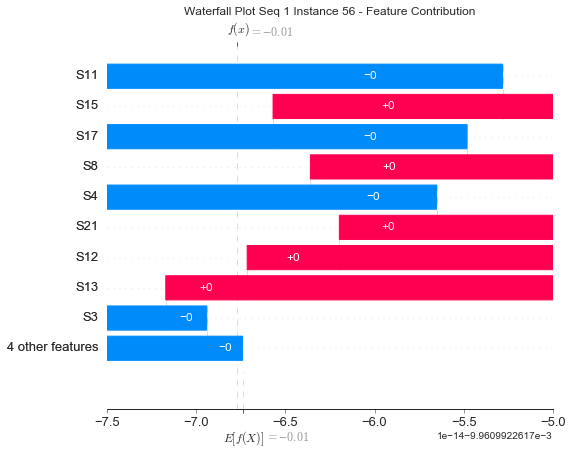

None

Contribution: [ 7.87787651e-16 -2.70953113e-15  3.77842848e-15 -1.34232223e-15
 -1.63862356e-15  7.03456628e-16  3.75802102e-16 -3.28035955e-15
  3.42241248e-15 -6.66014807e-16 -1.70829499e-15 -4.42736837e-15
  2.84322448e-15]


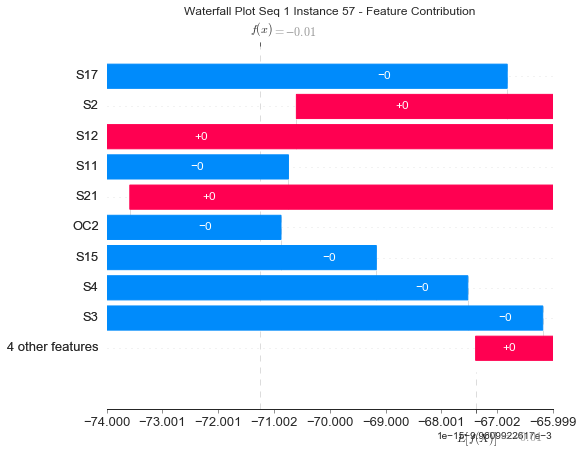

None

Contribution: [ 2.96480557e-17 -1.50590938e-14 -9.00830720e-15  3.52231261e-15
 -2.48798632e-14  8.79782121e-15  2.13394027e-15 -1.19290598e-14
  1.69655194e-14  1.73137791e-15  1.87308021e-14 -6.81465831e-15
  1.61412631e-14]


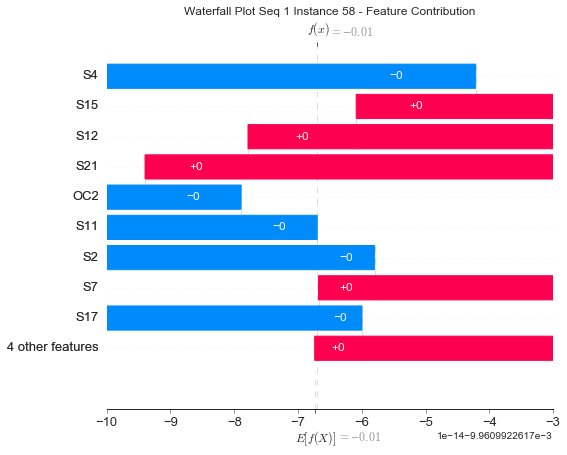

None

Contribution: [-2.21021304e-15 -9.51492693e-15 -3.42373576e-15  2.84301929e-15
 -7.68995378e-15  7.25034792e-15 -3.95195165e-15  7.19820796e-15
  1.28625909e-14 -5.68597463e-15 -1.41702624e-14 -1.05745975e-16
  1.38355217e-14]


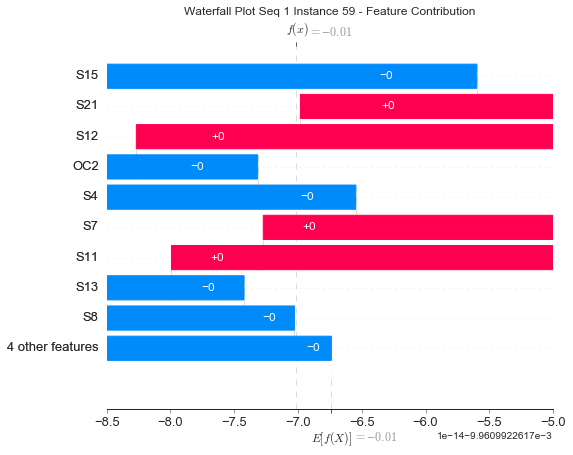

None

Contribution: [-6.75140189e-15 -1.63530620e-14 -4.17799255e-15 -7.47043725e-16
 -2.01419691e-14  1.28159482e-14  3.52220207e-15 -1.23186670e-14
  2.52689783e-14 -2.91684350e-15  9.31872360e-15 -1.54536604e-14
  2.69178329e-14]


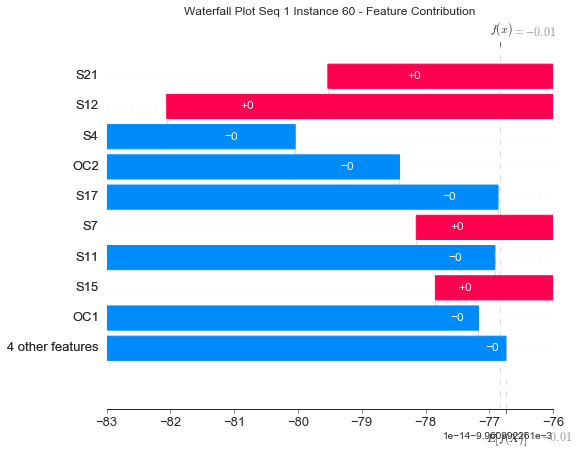

None

Contribution: [ 4.58406650e-15 -1.02809496e-14  1.51190519e-14 -1.55819131e-14
 -3.91372115e-14  4.87360311e-15  3.10190750e-14 -7.70766372e-14
  2.10127410e-14  1.42900591e-14  6.63543181e-14 -4.05528306e-14
  1.65928892e-14]


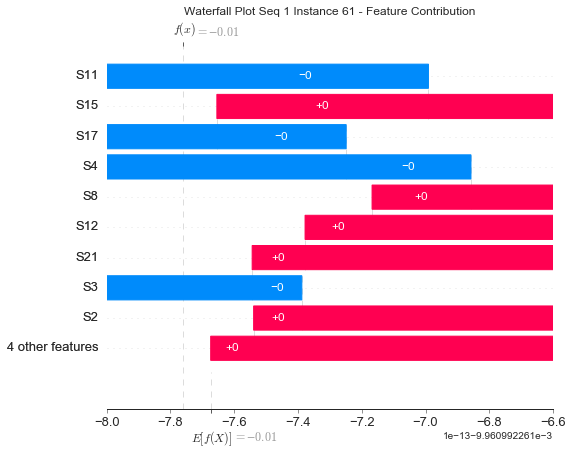

None

Contribution: [-7.12569262e-15 -2.92724524e-14  1.44663097e-14 -6.76857125e-15
 -2.11613089e-14  1.49007614e-14  1.26947759e-14 -3.81404638e-14
  3.12834238e-14  4.00454599e-16  2.07110669e-14 -3.05359409e-14
  3.35371820e-14]


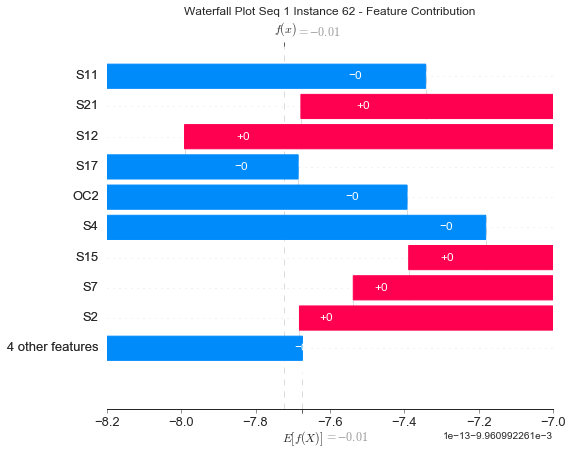

None

Contribution: [ 1.53170291e-15  8.98581361e-16  5.75211901e-15 -2.63036426e-15
  2.15212352e-15 -1.52113152e-15  2.77577660e-17 -1.66155688e-15
 -2.09163034e-15 -3.86211899e-16 -9.87977027e-15 -2.16690488e-15
 -1.56765745e-15]


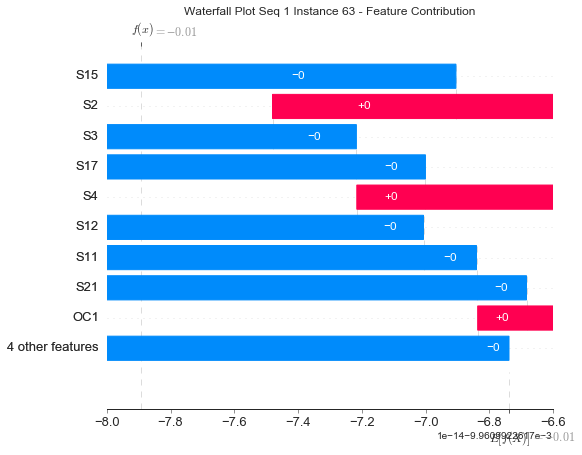

None

Contribution: [-3.19938193e-15  1.55801817e-14 -1.66288255e-14  1.51302361e-14
  5.26464214e-14 -1.23265461e-14 -3.36537642e-14  7.90159360e-14
 -3.65380740e-14 -1.56795760e-14 -6.92922756e-14  5.03097421e-14
 -3.44380693e-14]


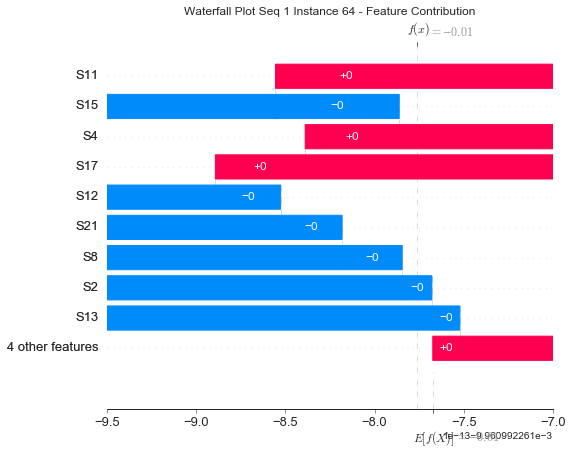

None

Contribution: [ 1.55786998e-15 -1.29845306e-14  1.71939608e-14 -7.16060817e-15
 -2.60119566e-14  1.03440959e-14  1.18422524e-14 -3.73322385e-14
  2.56738143e-14 -6.01602769e-16  9.41866502e-15 -3.02066315e-14
  2.54681022e-14]


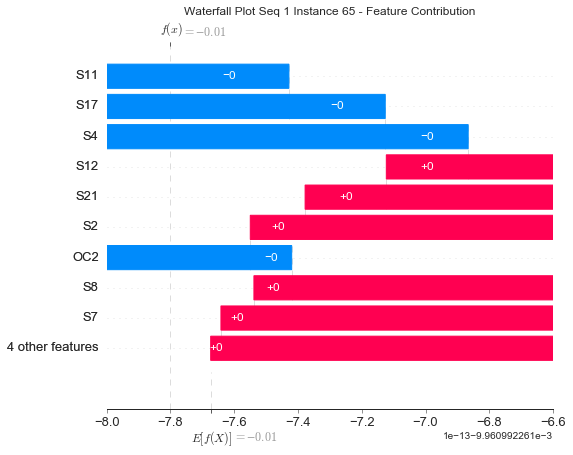

None

Contribution: [ 8.83416909e-15 -4.12870354e-14  2.42055233e-14 -9.81851370e-15
 -4.97597230e-14  1.63389623e-14  1.28010768e-14 -5.35956438e-14
  4.61006491e-14 -2.92287120e-15  3.60877100e-14 -4.39285822e-14
  4.19503299e-14]


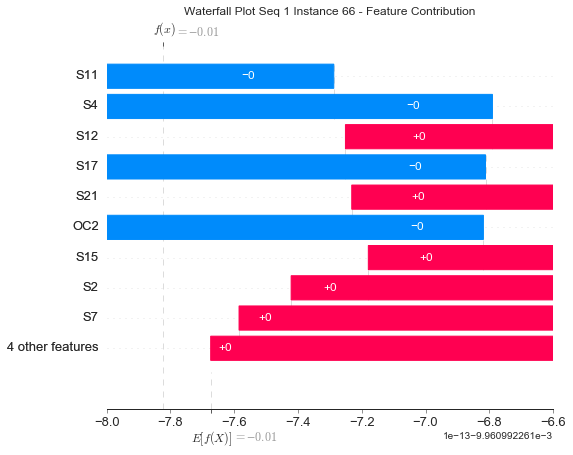

None

Contribution: [-2.22988755e-16 -1.16701946e-14 -2.51404863e-15  9.26537069e-15
  2.94344390e-14 -3.18754782e-15 -2.76165436e-14  5.02440463e-14
 -9.29634330e-15 -1.69443842e-14 -3.53705780e-14  2.82360042e-14
 -9.17130091e-15]


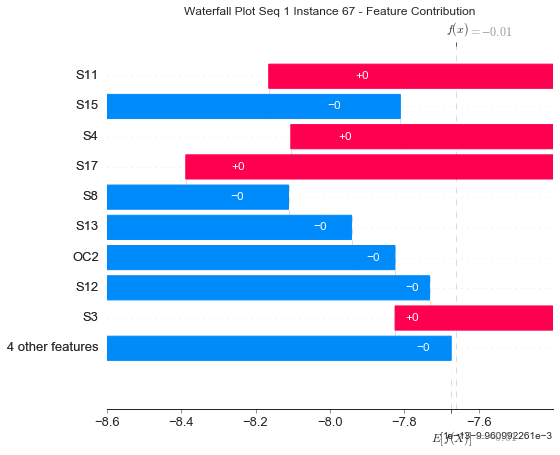

None

Contribution: [-6.48275946e-15  5.75435831e-14 -1.26105427e-14  1.10168815e-14
  6.64301716e-14 -1.70888304e-14 -1.47419274e-14  6.94654769e-14
 -4.85660232e-14 -1.68604862e-15 -8.13182461e-14  4.05821244e-14
 -4.55467065e-14]


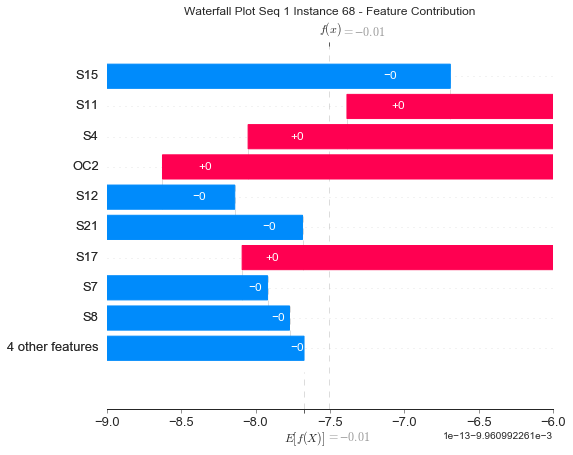

None

Contribution: [-3.30303568e-15 -4.29598780e-14 -2.95886036e-15  9.20615652e-16
 -1.57371488e-14  1.29345023e-14 -3.70108251e-15 -2.14038399e-14
  2.63497601e-14 -1.38747978e-15  4.58420397e-14  8.36839369e-17
  2.38775369e-14]


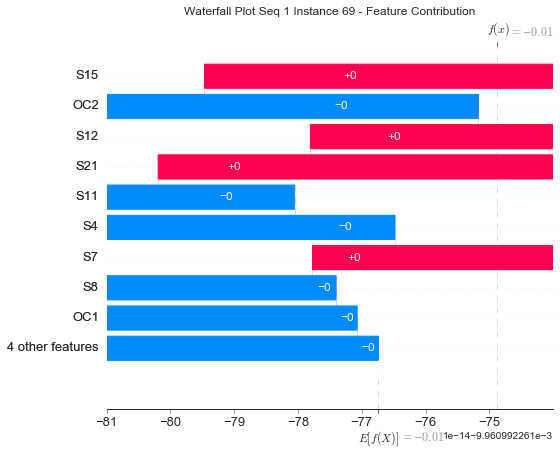

None

Contribution: [ 9.27487271e-15  4.77245264e-14 -1.63459741e-14  8.43186062e-15
  4.11023144e-14 -2.30545428e-14 -5.10880976e-15  3.36595172e-14
 -5.20902291e-14  1.36124700e-14 -2.07611130e-14  4.14989562e-14
 -5.81969911e-14]


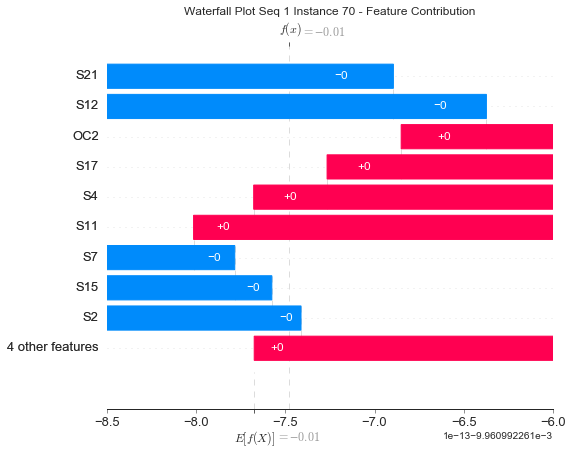

None

Contribution: [ 4.87679685e-15 -1.23003694e-14  1.01310943e-14 -2.72458871e-14
 -1.03495080e-13  1.31345410e-14  7.75538962e-14 -1.71059781e-13
  3.82684674e-14  4.62599895e-14  1.83450789e-13 -8.12677630e-14
  3.10093172e-14]


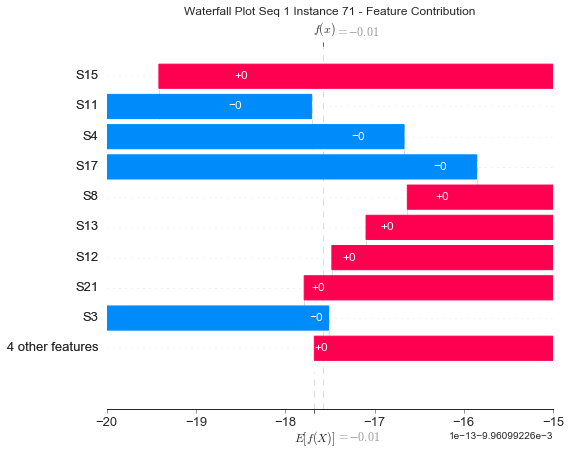

None

Contribution: [ 4.37215834e-15  7.53625068e-14 -9.11336046e-15  1.87587999e-14
  1.33580674e-13 -4.35741971e-14 -4.66015098e-14  1.36937269e-13
 -9.77859287e-14 -1.23323974e-14 -1.22145824e-13  9.57784131e-14
 -9.82163095e-14]


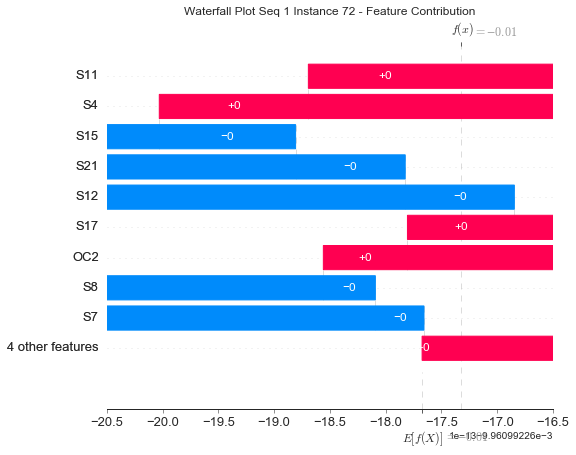

None

Contribution: [-9.57024622e-16 -6.81728301e-14  1.80705331e-14 -9.65845158e-15
 -7.86611377e-14  3.45575517e-14  1.04503588e-14 -5.04809986e-14
  8.59026527e-14 -6.01311612e-15  5.43036956e-14 -5.25836190e-14
  8.60190147e-14]


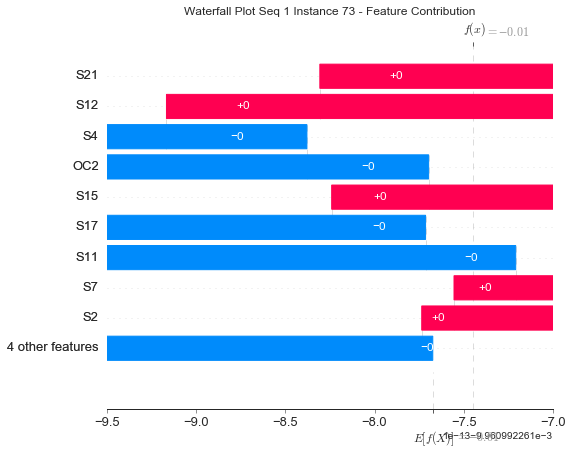

None

Contribution: [-9.93326295e-15 -5.51521278e-14  8.24333481e-15 -4.09060205e-15
 -7.60038530e-14  3.73105850e-14  1.30932185e-14 -5.60709587e-14
  7.43211170e-14 -8.02190600e-15  2.04429250e-14 -5.03819602e-14
  7.20776723e-14]


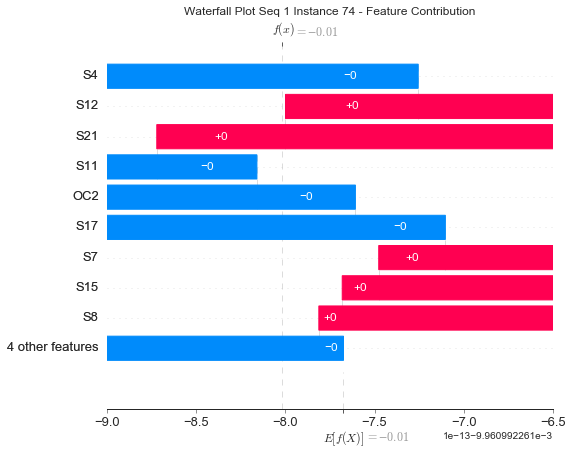

None

Contribution: [ 2.94611357e-15 -8.10267059e-15  1.82652110e-15 -2.91890738e-14
 -1.12880496e-13  1.92402399e-14  1.09001756e-13 -2.21064337e-13
  4.45809229e-14  6.48328505e-14  2.04356524e-13 -1.03337688e-13
  4.24055356e-14]


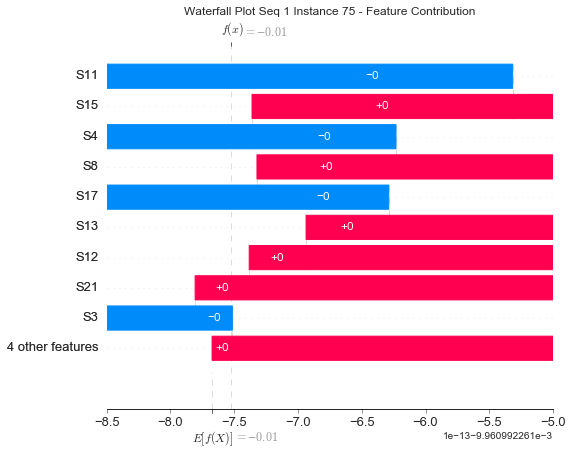

None

Contribution: [ 9.19402256e-15 -2.48133575e-14  2.34842121e-14 -7.92055935e-15
 -2.60203185e-14  1.35565057e-14  9.00490128e-15 -1.71798526e-14
  4.25091921e-14 -4.96988831e-15  1.80467027e-14 -3.23240309e-14
  4.31568233e-14]


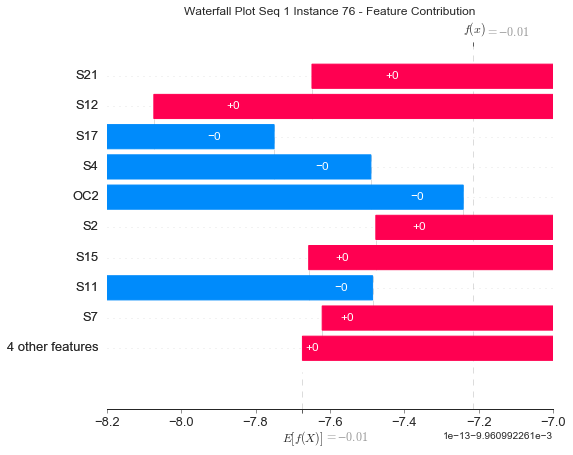

None

Contribution: [-2.52723228e-15 -5.23160007e-14 -6.71471478e-15  1.40871108e-14
  5.70685738e-14 -3.03681280e-15 -5.15891752e-14  8.82623578e-14
 -1.12144350e-14 -2.01577155e-14 -2.17770341e-14  6.02368700e-14
 -1.13809032e-14]


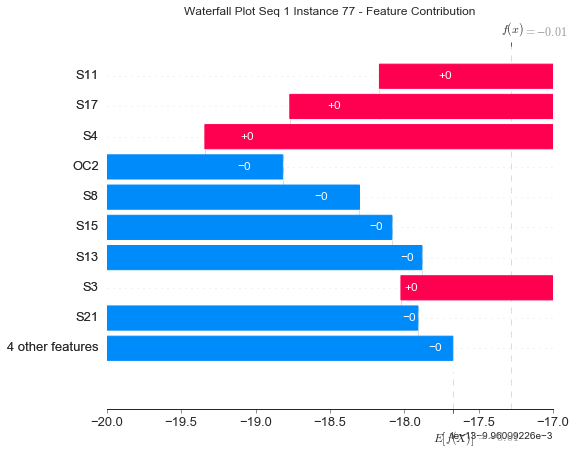

None

Contribution: [-1.42947652e-14 -8.36376934e-14  1.58075948e-14 -1.33243094e-14
 -1.35501744e-13  6.38616493e-14  3.35994999e-14 -8.52929110e-14
  1.45343562e-13 -4.58577073e-15  7.08827731e-14 -1.01757232e-13
  1.55642169e-13]


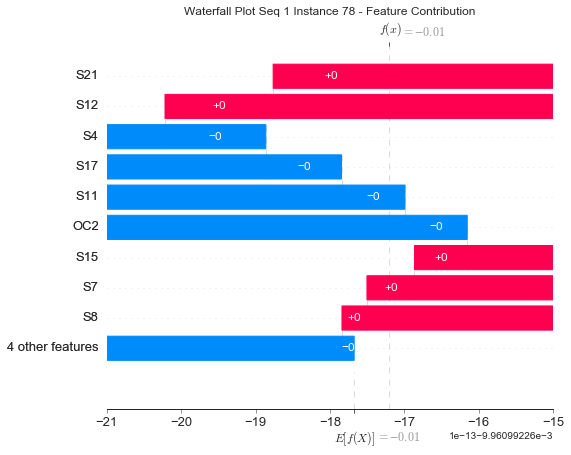

None

Contribution: [-3.63463532e-15 -2.20551997e-14  7.73127258e-16 -6.28032663e-15
 -5.61695906e-14  2.11808601e-14  1.69374724e-14 -3.35868418e-14
  4.56959469e-14  1.06768249e-15  3.48113872e-14 -3.36942625e-14
  4.98397473e-14]


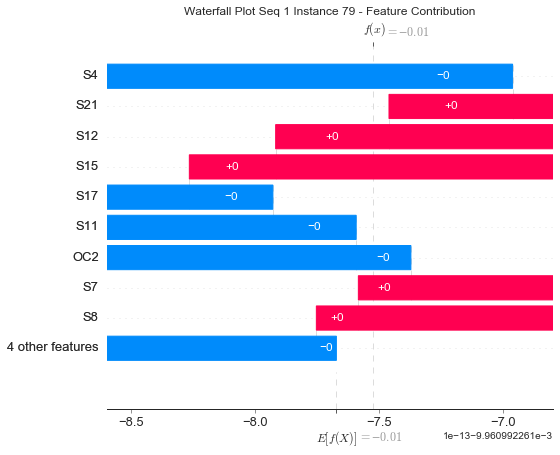

None

Contribution: [ 9.56496286e-16 -6.00534332e-15 -2.19601614e-15  4.40235501e-16
 -5.76364992e-14  1.08188893e-14  1.01396781e-14 -2.82434937e-14
  2.09484055e-14 -7.05676659e-15 -1.36875146e-14 -2.56028041e-14
  2.08512390e-14]


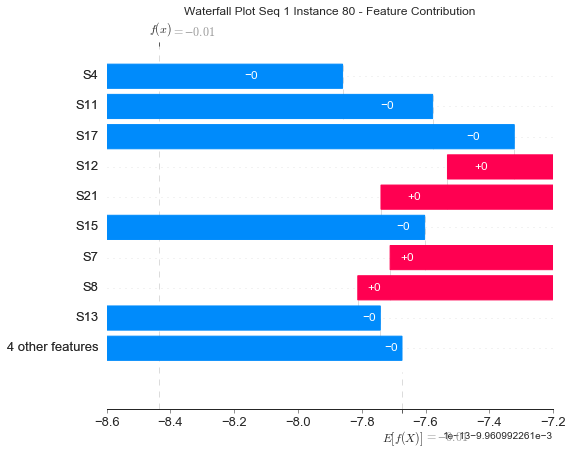

None

Contribution: [ 2.18873991e-14 -8.46688306e-14  3.37686625e-14 -3.44937905e-14
 -1.65955086e-13  5.22367760e-14  5.96540097e-14 -1.53482221e-13
  1.41642164e-13  6.69215321e-15  1.62216174e-13 -1.32331849e-13
  1.33656486e-13]


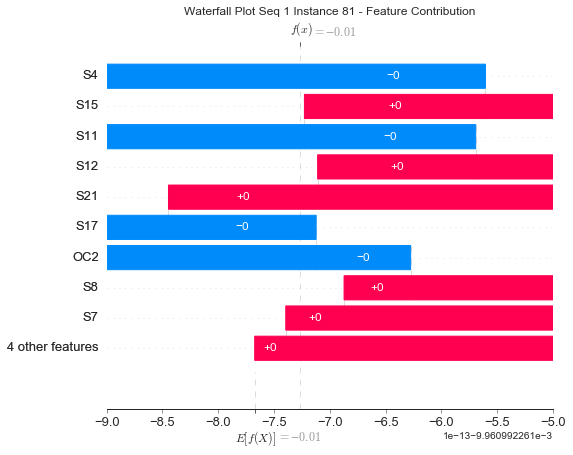

None

Contribution: [ 6.50169870e-15  7.62522573e-14 -1.37124902e-14  1.33258467e-14
  1.23965549e-13 -4.39448892e-14 -4.00005922e-14  1.16413498e-13
 -9.75077359e-14 -7.39410635e-15 -1.07204257e-13  9.60429449e-14
 -9.81012756e-14]


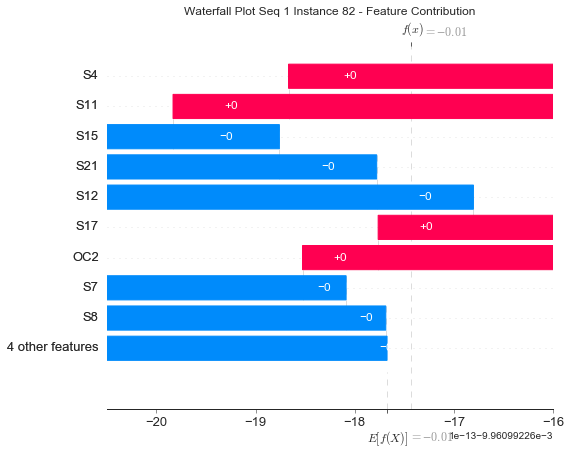

None

Contribution: [-7.64278411e-16  3.53048957e-14 -1.66924427e-14 -1.90682499e-14
 -7.47387924e-14  6.21766780e-15  1.00470257e-13 -1.64411006e-13
  6.72927061e-15  6.85001101e-14  2.02615756e-13 -7.22005802e-14
  4.96815444e-15]


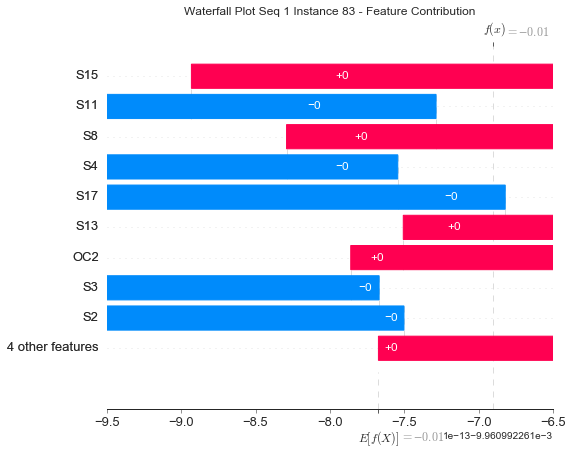

None

Contribution: [-6.58082513e-15 -2.04106226e-14  4.84867790e-15  2.84444607e-14
  1.15599655e-13 -1.70203343e-14 -9.77574616e-14  1.98424746e-13
 -4.52759710e-14 -5.36633522e-14 -1.26936479e-13  1.14966196e-13
 -3.98896411e-14]


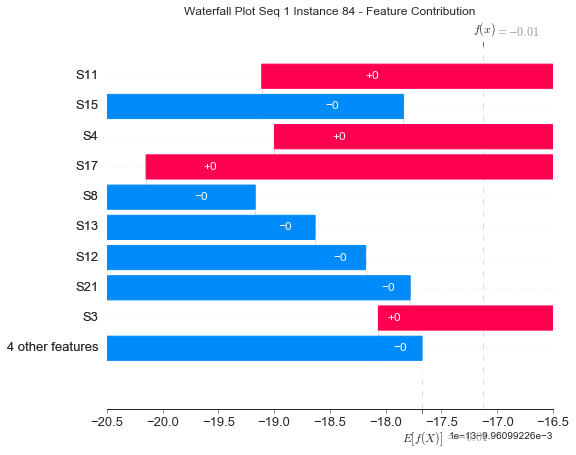

None

Contribution: [ 4.63562116e-15 -4.08601375e-14 -1.50180703e-14  1.41554621e-14
 -2.64941691e-14  1.65789064e-14 -3.44846256e-14  6.46092270e-14
  3.09577024e-14 -3.58900057e-14 -5.05437739e-14  7.53708382e-15
  2.86471760e-14]


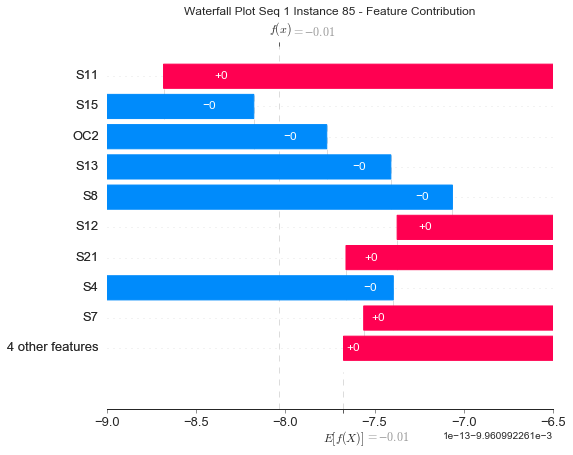

None

Contribution: [ 7.70928223e-15 -9.39724644e-14  2.03073642e-14 -2.75151843e-14
 -2.79103699e-13  7.23355837e-14  1.31852835e-13 -3.11163801e-13
  1.85885351e-13  7.10882227e-14  3.64707098e-13 -2.00979763e-13
  1.61981688e-13]


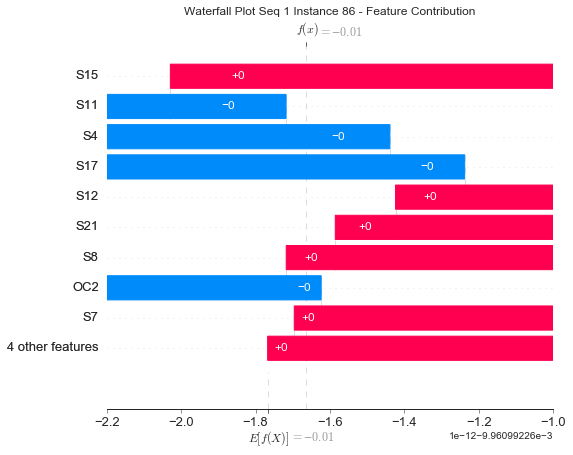

None

Contribution: [-6.35325956e-15 -3.52506551e-14 -6.98252965e-15 -1.91257803e-14
 -1.27396710e-13  4.64920325e-14  6.00812463e-14 -1.42804727e-13
  9.78941456e-14  1.32870340e-14  1.36604324e-13 -9.42428915e-14
  1.02019948e-13]


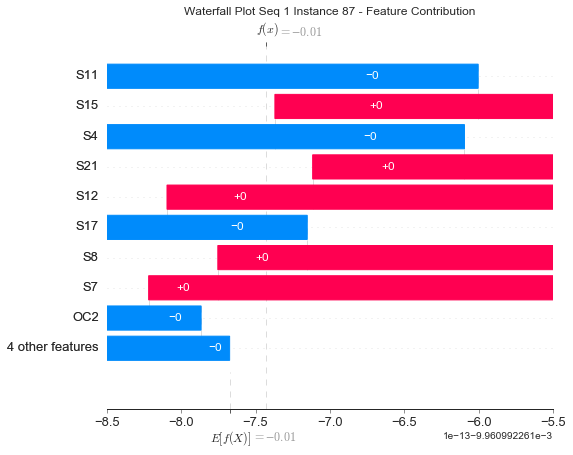

None

Contribution: [-5.42800608e-15  7.08611839e-14 -9.07776136e-15  1.03477755e-14
  1.41397704e-13 -4.81464573e-14 -2.93126729e-14  9.45808576e-14
 -1.15969707e-13  2.58074888e-15 -7.50107238e-14  9.36644696e-14
 -1.15778304e-13]


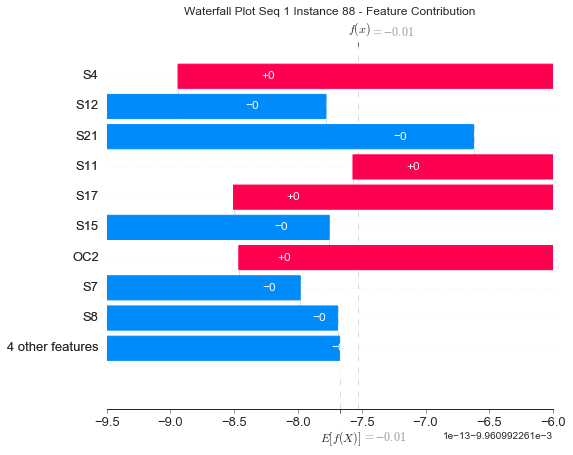

None

Contribution: [ 1.19152396e-14  7.04628074e-14  3.89719317e-14 -1.41631549e-14
  1.53000767e-13 -7.42644471e-14 -8.95732175e-15  4.50222304e-14
 -1.43095998e-13  2.37900452e-14 -3.51697499e-14  7.13569015e-14
 -1.49581072e-13]


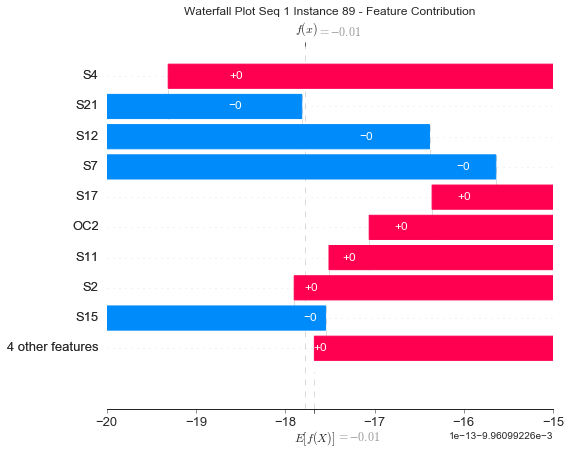

None

Contribution: [ 2.44979360e-14  1.14506562e-13 -5.24181088e-14  1.42168991e-14
  5.46424817e-14 -5.44952199e-14  3.68428839e-15  3.96983404e-14
 -1.20152301e-13  3.33970895e-14  4.99636572e-15  6.03890852e-14
 -1.26316587e-13]


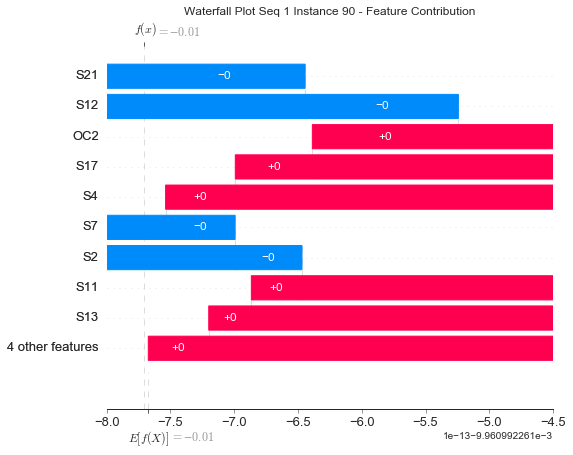

None

Contribution: [ 5.79258389e-15 -8.93926385e-16 -2.99260467e-14  5.24978993e-15
 -7.85459242e-15 -4.76215772e-15  9.60496483e-15 -2.97536078e-14
 -2.29180265e-14  6.02311322e-15  3.21695659e-14  1.64638522e-14
 -2.94189688e-14]


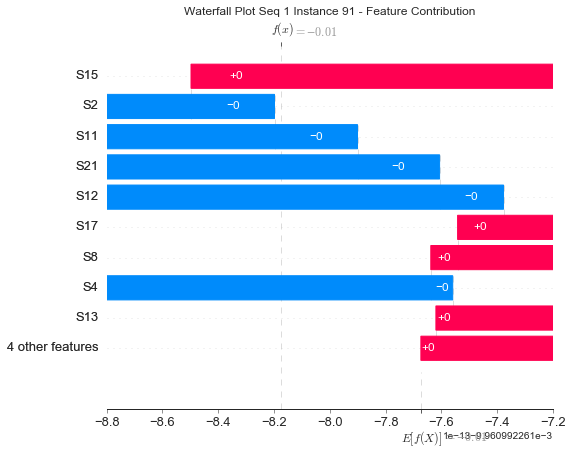

None

Contribution: [-2.20532871e-14  1.58364424e-13 -7.98611665e-14  5.73984694e-14
  2.52443086e-13 -9.63011070e-14 -7.62139511e-14  2.39777490e-13
 -2.57855667e-13  1.24595550e-15 -1.88118821e-13  2.07220119e-13
 -2.44826783e-13]


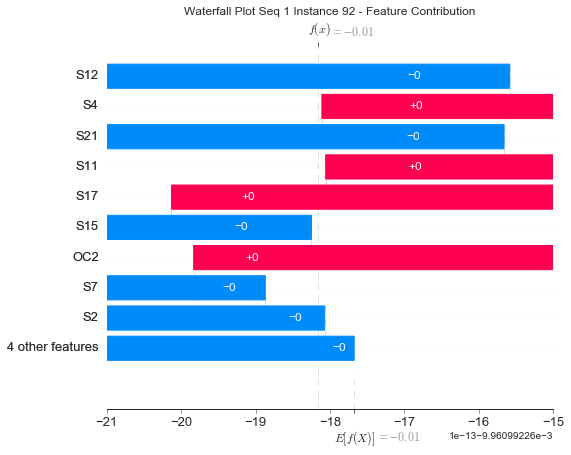

None

Contribution: [-5.53704523e-14 -2.76640500e-13  1.17681675e-13 -9.05849695e-14
 -3.83444687e-13  1.93715690e-13  2.08442340e-13 -5.49736146e-13
  4.07845741e-13  7.47612015e-14  4.12451621e-13 -3.93635997e-13
  4.14624959e-13]


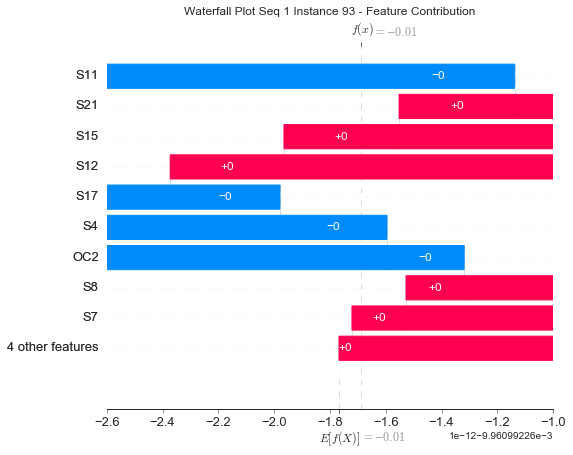

None

Contribution: [ 1.38949521e-14 -7.18382060e-14 -7.11127188e-14  7.60817055e-14
 -2.73531198e-14  4.35094838e-14 -9.52948115e-14  1.92211983e-13
  8.32960206e-14 -3.82913610e-14 -1.65903871e-13  6.69628063e-14
  7.61080719e-14]


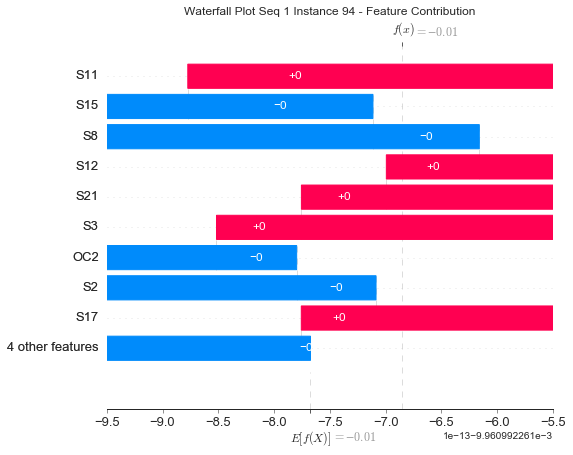

None

Contribution: [-3.94036068e-14 -2.78923586e-13  1.78034968e-13 -9.51103752e-14
 -3.05739429e-13  1.78190457e-13  1.69606882e-13 -4.80140829e-13
  3.94242256e-13  2.43086902e-14  2.93496970e-13 -3.76468225e-13
  4.04996972e-13]


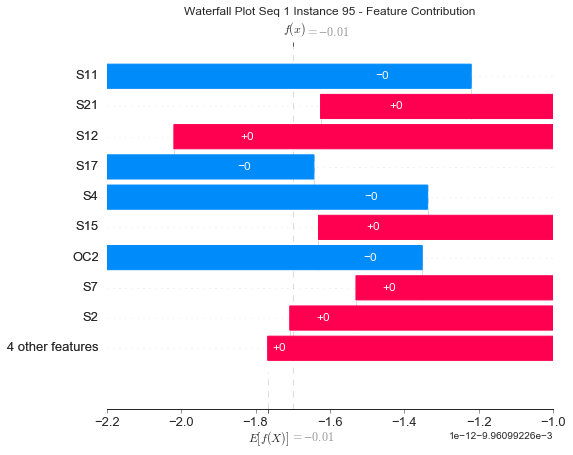

None

Contribution: [-4.76565342e-15  4.64173649e-14 -1.60353881e-13  1.79213659e-13
  4.79450030e-13 -4.90290520e-14 -4.24210309e-13  8.94597710e-13
 -1.95422644e-13 -1.99029825e-13 -8.76011232e-13  4.99116536e-13
 -1.86311795e-13]


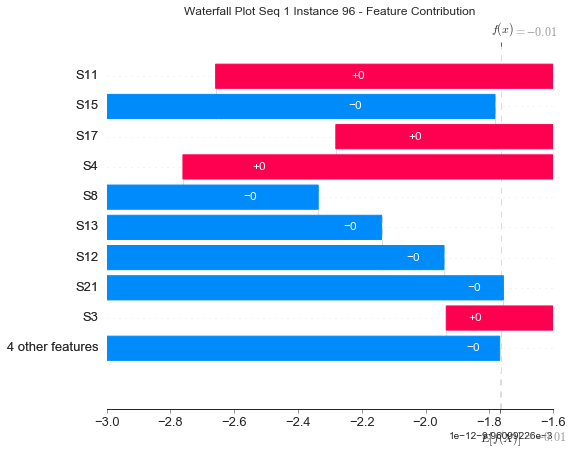

None

Contribution: [ 3.38430320e-14 -3.32268311e-13  1.96249036e-13 -1.21388522e-13
 -5.60470507e-13  1.73654494e-13  2.40626610e-13 -7.20252796e-13
  4.72160776e-13  5.29994241e-14  5.11559762e-13 -4.83597483e-13
  4.27043627e-13]


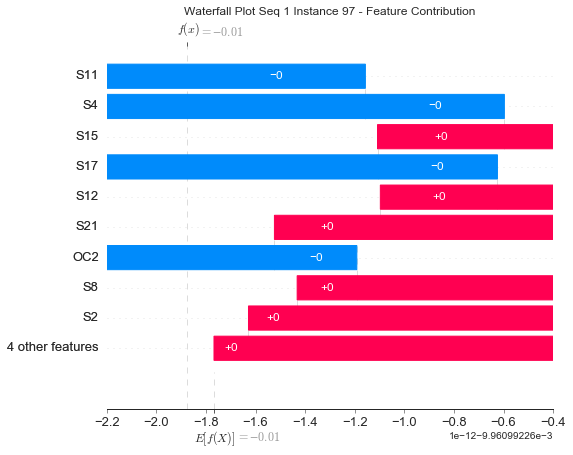

None

Contribution: [-4.56151908e-14 -3.67122429e-13  4.31567759e-14 -8.89995204e-14
 -5.17292643e-13  1.50537745e-13  2.47806631e-13 -6.71251466e-13
  3.56612472e-13  1.19235961e-13  6.59098481e-13 -3.84621344e-13
  3.81025560e-13]


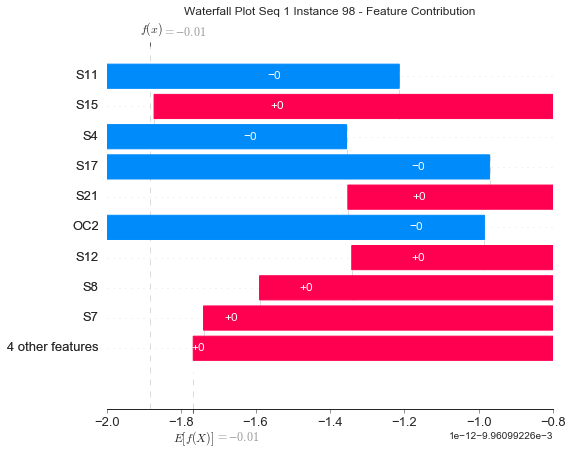

None

Contribution: [-4.10001385e-14  1.38235425e-13 -5.86159471e-14  2.91710388e-14
  2.36536078e-13 -8.52710101e-14 -6.03746518e-14  1.51121804e-13
 -2.34850767e-13 -1.16257949e-14 -1.27854202e-13  1.70427962e-13
 -2.45304211e-13]


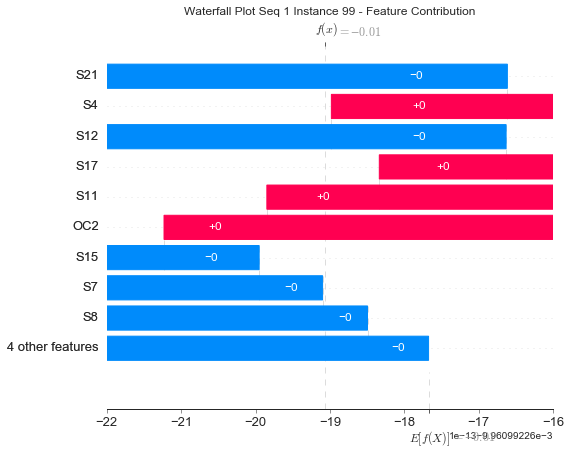

None

Contribution: [-7.48986173e-14 -7.48194367e-13  2.33169793e-13 -1.39059540e-13
 -9.51241256e-13  4.74526668e-13  3.77540772e-13 -1.07383460e-12
  1.03484062e-12  3.44699041e-14  7.53452205e-13 -8.66020038e-13
  1.06081159e-12]


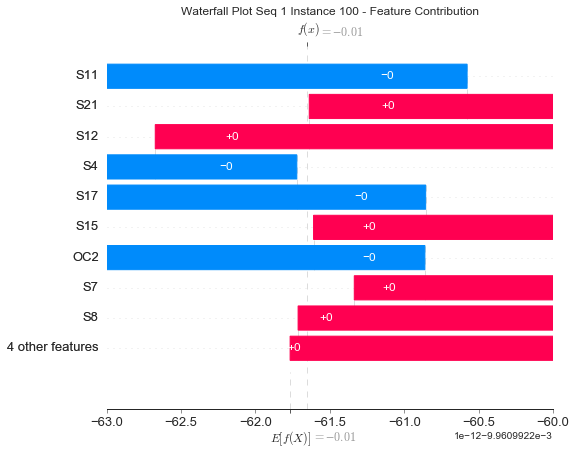

None

Contribution: [ 7.92568813e-15  7.94102604e-14 -2.87930322e-15 -4.30948307e-14
 -9.57944881e-15 -4.28124333e-14  1.16576521e-13 -1.79768310e-13
 -6.95988541e-14  1.02961076e-13  2.63396970e-13 -4.61529313e-14
 -5.94543268e-14]


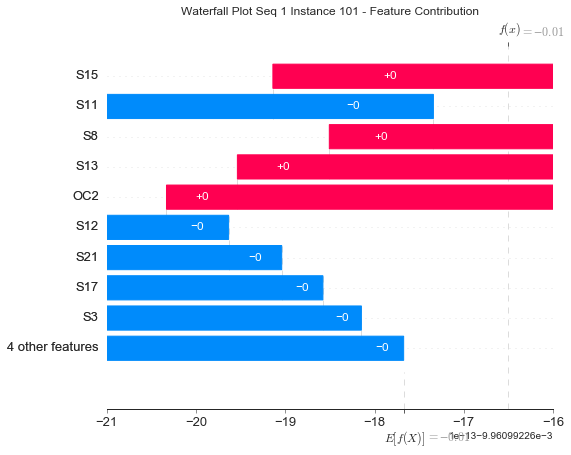

None

Contribution: [ 8.48084962e-14 -5.01120846e-13  1.72686816e-13 -1.40032652e-13
 -7.05329024e-13  1.64586389e-13  2.90377260e-13 -9.14037184e-13
  4.75876771e-13  9.51779549e-14  8.81770947e-13 -5.80472302e-13
  4.87654350e-13]


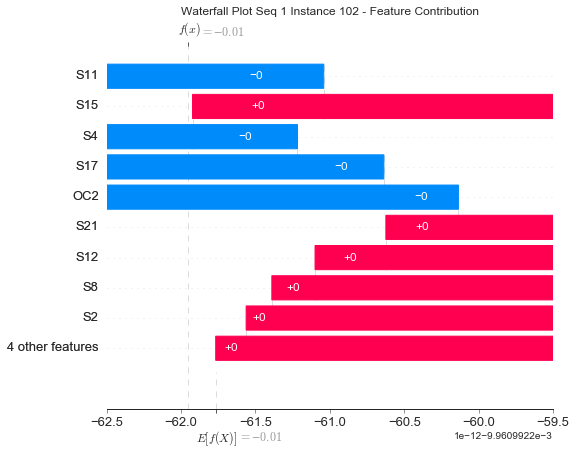

None

Contribution: [ 6.51234709e-14 -8.08903563e-13  3.60303069e-13 -1.86856783e-13
 -1.21329151e-12  4.99449278e-13  4.25012781e-13 -1.33343803e-12
  1.23229454e-12  8.59403779e-15  8.93791009e-13 -9.98861692e-13
  1.18923393e-12]


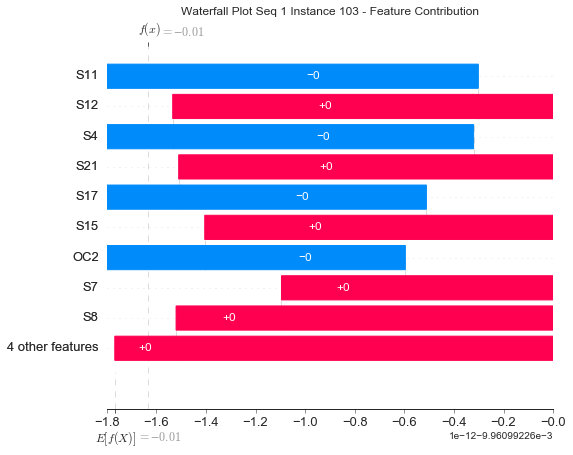

None

Contribution: [-2.22850455e-14 -9.15376824e-13  3.24771595e-13 -2.00055372e-13
 -1.38814177e-12  5.66566108e-13  5.36554091e-13 -1.48920167e-12
  1.32733776e-12  5.62648005e-14  1.11651953e-12 -1.17026408e-12
  1.33927483e-12]


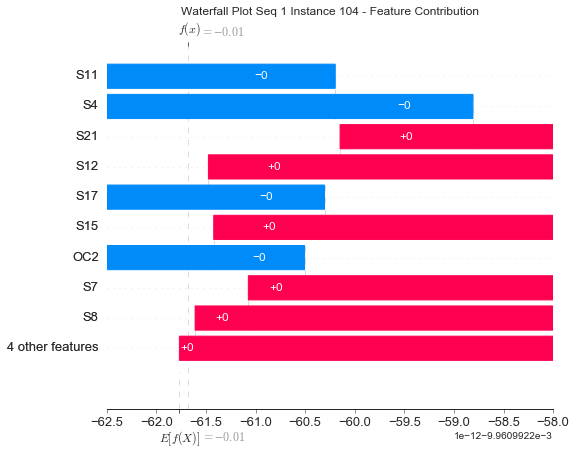

None

Contribution: [ 1.31649037e-14  5.01110492e-13 -1.11795935e-13  5.76925186e-14
  6.27581212e-13 -2.43946356e-13 -1.84212766e-13  6.15877520e-13
 -5.46047799e-13  7.41211258e-15 -5.58453023e-13  4.19732554e-13
 -5.27859332e-13]


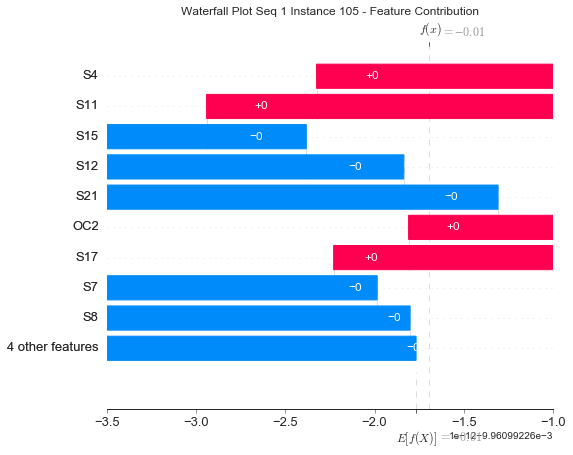

None

Contribution: [-1.25619336e-13 -1.08488099e-12  2.30624086e-13 -2.30762864e-13
 -1.54093177e-12  6.66137826e-13  6.95339890e-13 -1.86560381e-12
  1.47723706e-12  1.84374895e-13  1.41164185e-12 -1.32117386e-12
  1.46737516e-12]


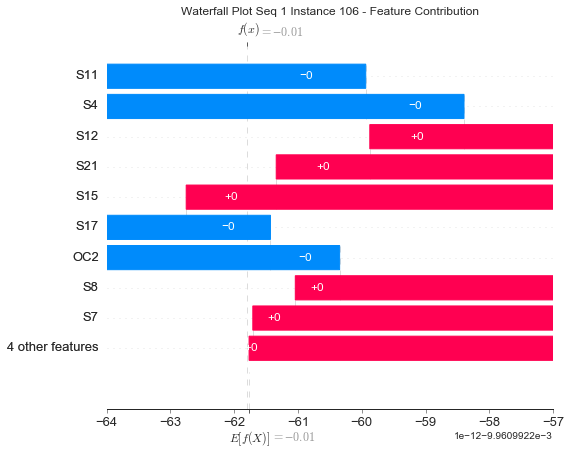

None

Contribution: [ 2.61071546e-14  1.52347295e-14  2.86987502e-14  1.98481897e-13
  8.65692609e-13 -1.30442030e-13 -8.72208555e-13  1.56854239e-12
 -3.21087720e-13 -5.07696044e-13 -1.49531938e-12  8.45134455e-13
 -3.28384889e-13]


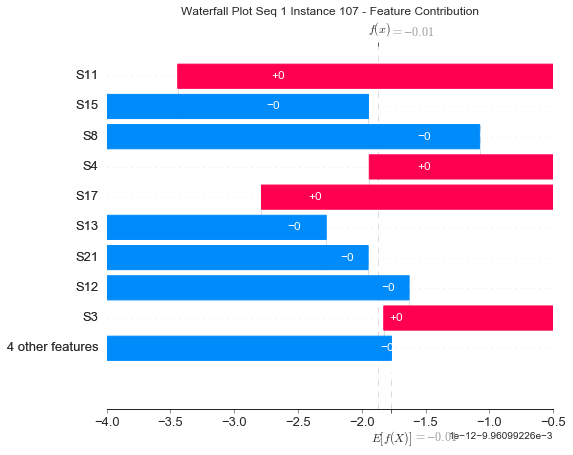

None

Contribution: [ 7.26171002e-15  2.10037174e-13 -2.29787604e-14  1.61840715e-13
  1.01074401e-12 -2.45810696e-13 -8.29907378e-13  1.63948575e-12
 -5.47869367e-13 -4.15027442e-13 -1.70402321e-12  8.68299519e-13
 -5.31734867e-13]


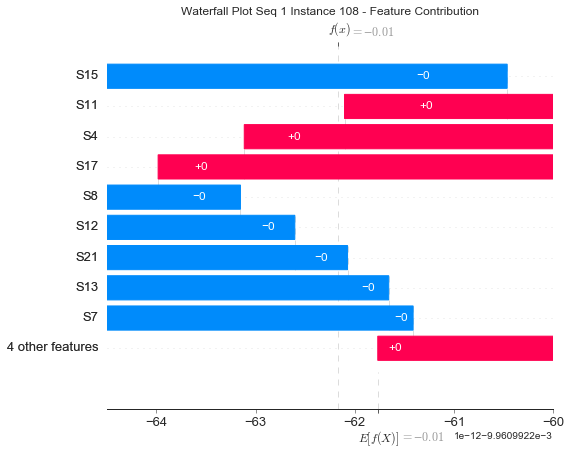

None

Contribution: [-1.97733895e-14  3.70322154e-13 -4.70851758e-14 -2.02604733e-15
  3.34507649e-13 -2.11708594e-13  1.69925431e-14  3.85071385e-15
 -4.74815174e-13  7.12775244e-14  5.30889657e-14  2.54425875e-13
 -5.26261814e-13]


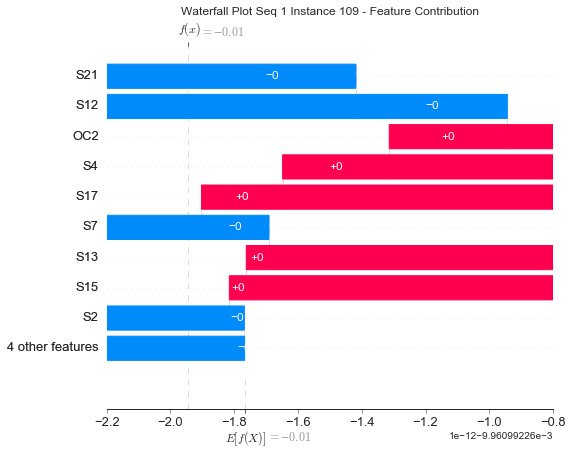

None

Contribution: [-2.90972182e-14 -1.50561624e-13  2.16508614e-13 -1.73899903e-13
 -7.74711946e-13  2.72175809e-13  4.47815559e-13 -9.69255492e-13
  6.57520533e-13  7.55642632e-14  2.92246072e-13 -8.50903712e-13
  6.92198414e-13]


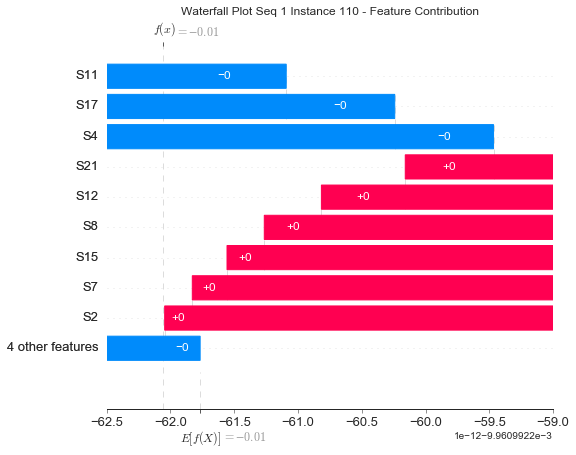

None

Contribution: [ 1.34735684e-14  2.84601010e-13 -2.56333871e-14  5.85127175e-14
  6.30469418e-13 -3.17180554e-13 -2.44388900e-13  4.49979680e-13
 -6.86067522e-13  1.49317983e-14 -2.89280400e-13  5.64578278e-13
 -7.18134536e-13]


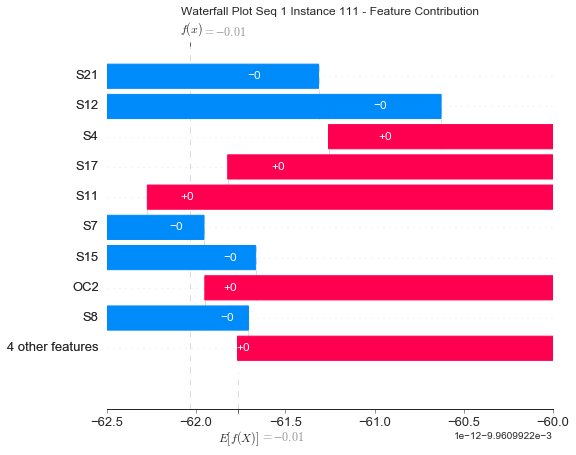

None

Contribution: [-1.56041873e-13  5.37306907e-13 -1.54554578e-13  2.33963731e-14
  5.76621433e-13 -2.85079767e-13  5.85827163e-14  4.03045635e-15
 -7.74613826e-13  1.78099113e-13  7.58895984e-14  3.99741411e-13
 -7.39917296e-13]


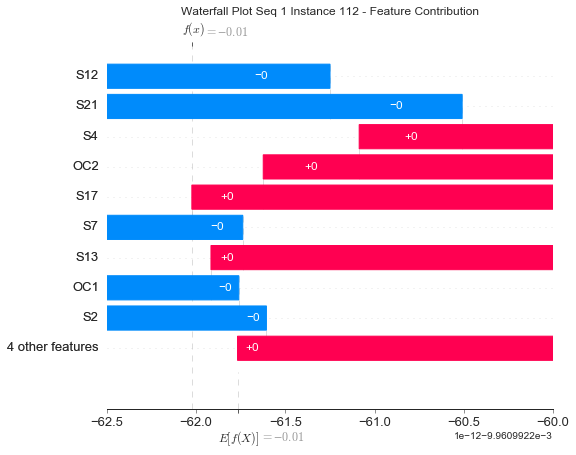

None

Contribution: [ 2.41522754e-14  7.69313161e-13 -7.89508094e-14  6.67612802e-14
  5.71402355e-13 -2.51415208e-13 -1.26011818e-13  5.47688685e-13
 -5.69880894e-13 -4.69168161e-14 -1.14928889e-12  2.93991529e-13
 -5.56841303e-13]


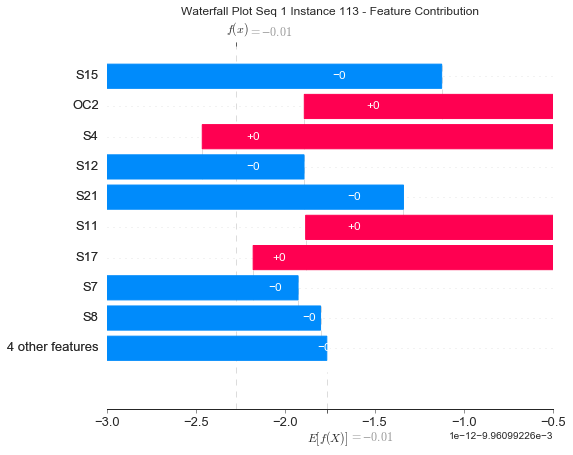

None

Contribution: [-5.01411250e-14  5.13680244e-13 -7.23709490e-14  4.14898557e-14
  7.22525392e-13 -2.54892624e-13 -1.27105845e-13  5.09115699e-13
 -6.12690942e-13  6.26583136e-14 -4.24186511e-13  4.14517135e-13
 -5.98436611e-13]


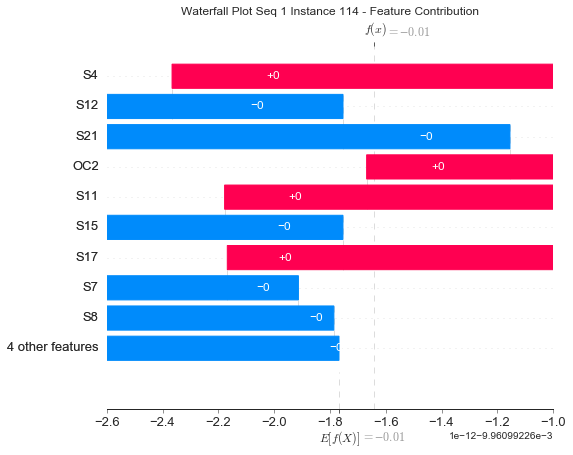

None

Contribution: [ 7.92294832e-14  5.80739124e-13 -5.06143589e-14  1.08087794e-13
  8.88208615e-13 -4.78793491e-13 -3.34465664e-13  8.41649612e-13
 -9.94489538e-13  9.28748333e-15 -6.79106348e-13  7.63770611e-13
 -1.02874382e-12]


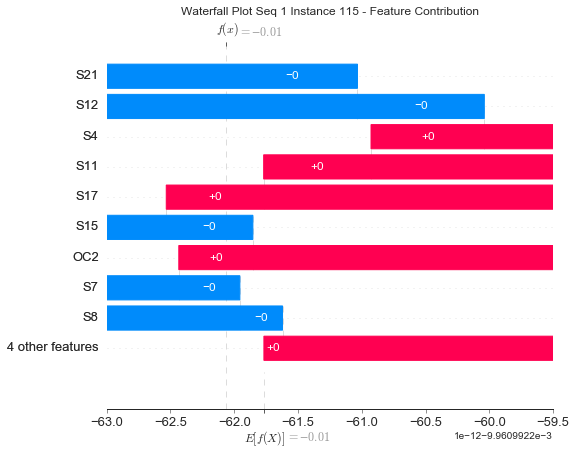

None

Contribution: [-3.05235162e-15  1.66735115e-14  2.37275070e-13 -9.40996955e-14
  1.49184647e-13 -1.86526125e-14 -9.47980708e-14  1.35784098e-13
  2.92841923e-14 -9.73163743e-14 -5.07330289e-13 -1.99391386e-14
  2.67888146e-14]


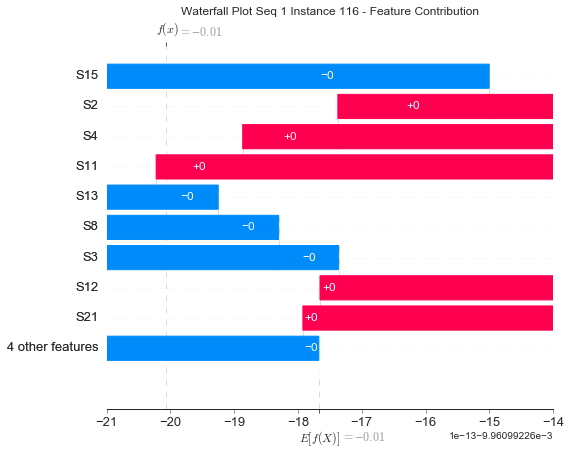

None

Contribution: [-1.99099041e-14  1.85319045e-13 -1.31055323e-13  1.67164070e-14
  4.63245978e-14 -1.08439826e-14  1.19595848e-13 -9.79885999e-14
 -6.07615764e-14  7.45547558e-14 -1.55033728e-13 -6.22265775e-14
 -6.58353512e-14]


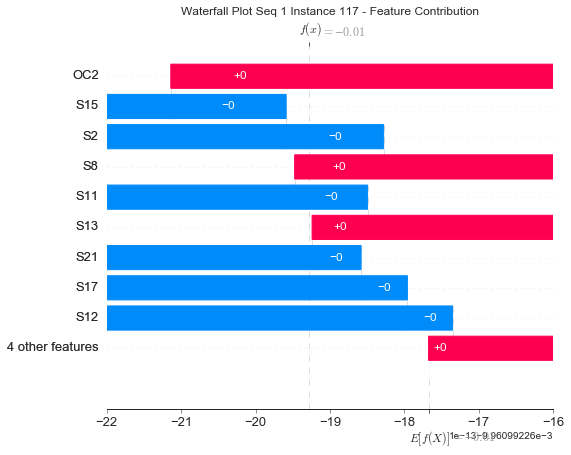

None

Contribution: [-3.68055365e-14 -3.57029998e-13  2.57815335e-13 -2.36212959e-13
 -9.30963206e-13  2.74426369e-13  5.80518923e-13 -1.43362969e-12
  6.42323597e-13  2.82194705e-13  1.20639382e-12 -8.38697276e-13
  6.24627628e-13]


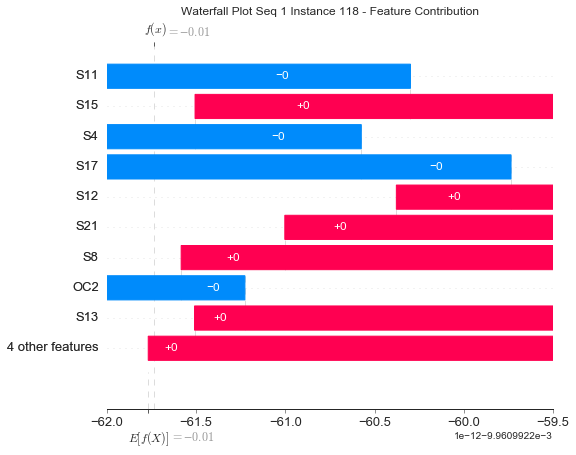

None

Contribution: [-4.55650396e-14 -5.98054999e-14  2.15506771e-13 -6.65336587e-14
 -4.92483658e-14 -1.69924974e-14  1.04633655e-13 -3.80118680e-13
  5.27822991e-15  1.15111845e-13  2.54585551e-13 -1.66000230e-13
  1.52175076e-14]


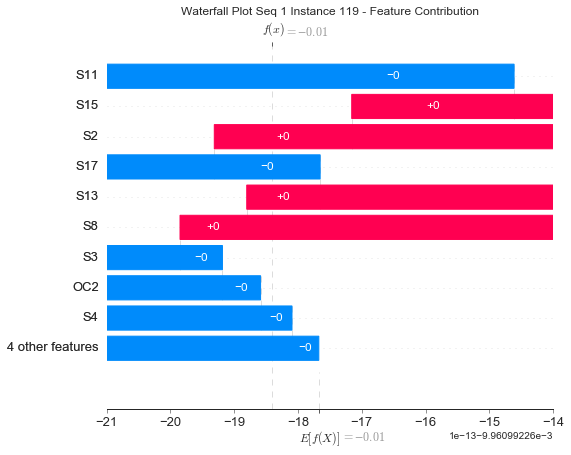

None

Contribution: [-3.53342098e-14 -4.16131647e-13  7.51728188e-14  6.53794374e-14
 -2.61313920e-13  1.90447132e-13 -1.51014346e-13  1.23428232e-13
  4.35883371e-13 -1.00633694e-13 -1.66033908e-13 -1.46902659e-13
  4.34654645e-13]


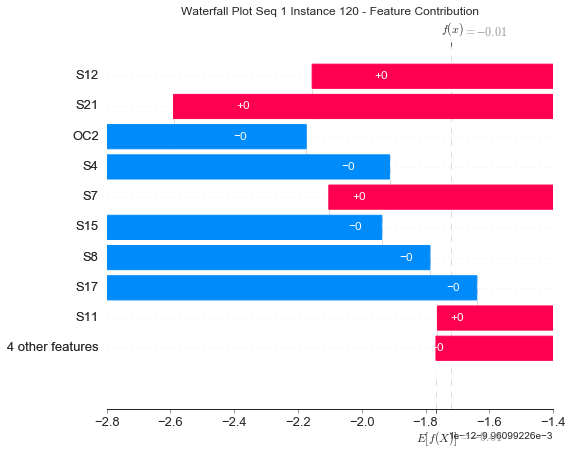

None

Contribution: [-2.38840658e-13 -1.15032029e-12  2.98431337e-13 -1.05608779e-13
 -1.15433899e-12  6.37410535e-13  1.56173306e-13 -9.15823190e-13
  1.31589856e-12 -1.28177620e-13  7.13375539e-13 -8.59750747e-13
  1.37188861e-12]


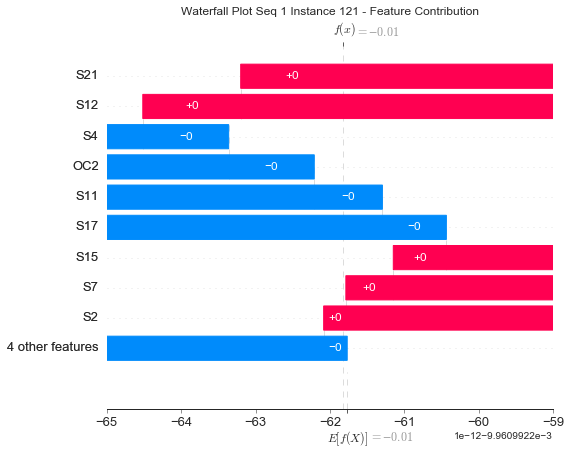

None

Contribution: [-2.91901174e-14  1.15348616e-14  4.40280238e-14  1.83654497e-13
  5.35618858e-13 -1.01579667e-13 -4.17555557e-13  9.16582673e-13
 -3.13155941e-13 -2.20159543e-13 -8.09572624e-13  5.89436648e-13
 -3.21696798e-13]


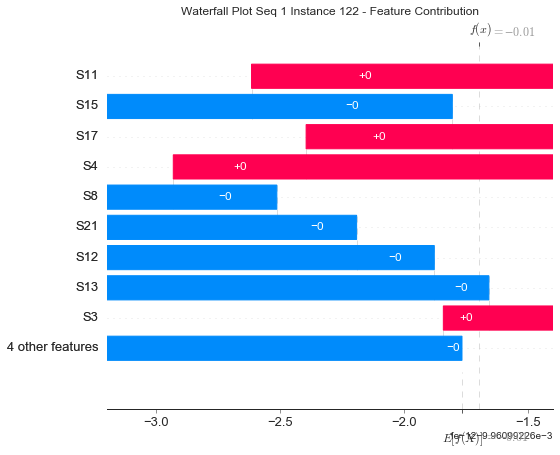

None

Contribution: [ 1.61218383e-13  9.43865645e-13 -5.48468911e-14  3.24775505e-14
  3.78116321e-13 -9.07381944e-14  1.13502720e-13  4.09616649e-13
 -1.80611575e-13  8.26852896e-14 -4.52446349e-13  1.14101518e-13
 -2.48234186e-13]


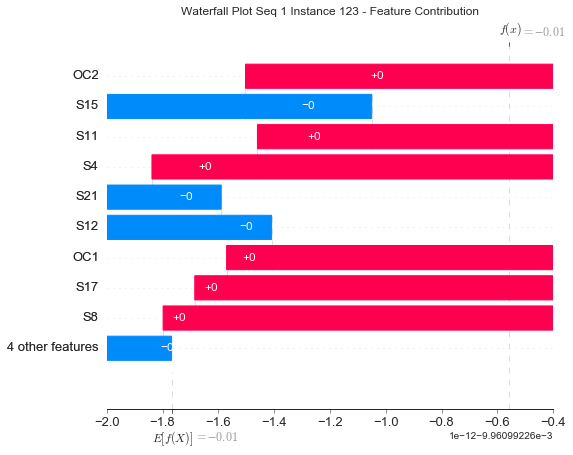

None

Contribution: [-5.16268411e-14 -3.09353481e-13  4.18509845e-13 -8.55928121e-13
 -2.02132191e-12  2.28911128e-13  1.84282472e-12 -3.78202764e-12
  6.94797898e-13  8.45694717e-13  3.92095167e-12 -2.01268082e-12
  6.69617898e-13]


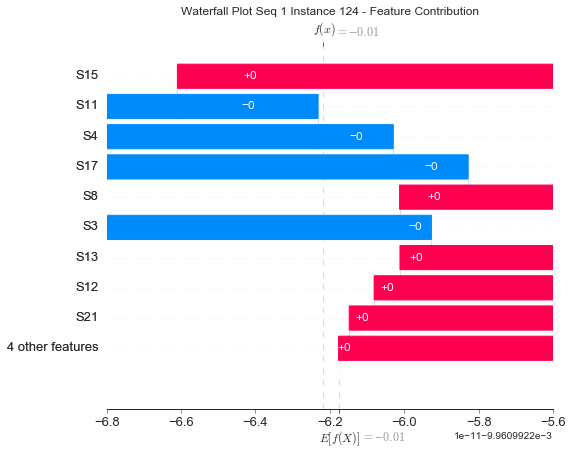

None

Contribution: [ 1.21606935e-13  1.45918827e-13 -7.47316055e-13  6.07262016e-13
  2.06170237e-12 -7.08910361e-13 -1.49037672e-12  2.88490260e-12
 -1.61140535e-12 -4.66398730e-13 -1.21678004e-12  2.32122286e-12
 -1.78015718e-12]


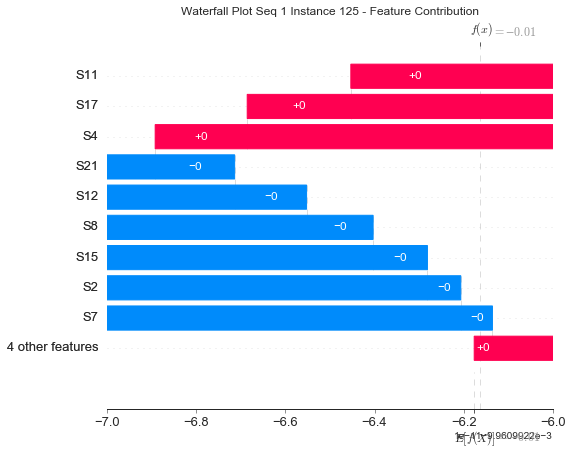

None

Contribution: [ 7.25647620e-15 -5.16357952e-13  9.48638845e-13 -1.53851530e-12
 -4.48972153e-12  7.52957592e-13  4.56146839e-12 -8.69654175e-12
  2.15404149e-12  2.05689047e-12  7.94000889e-12 -5.06846344e-12
  2.16262988e-12]


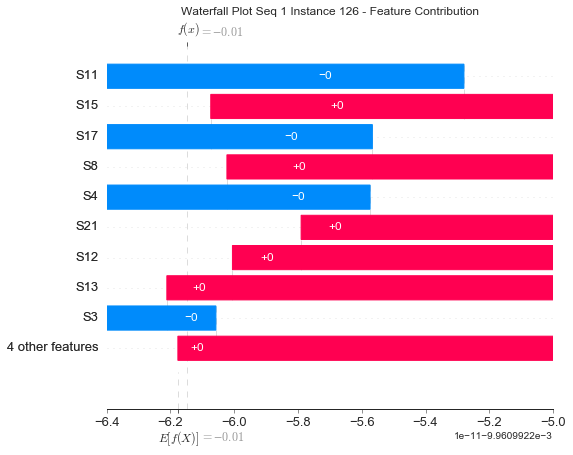

None

Contribution: [-1.26010164e-13 -1.31067748e-12  6.79784029e-13 -5.82856652e-14
 -5.85704445e-13  4.78414292e-13 -3.20631298e-13 -2.22049945e-13
  1.07290988e-12 -3.47920423e-13 -3.59256868e-13 -3.40178948e-13
  1.07532353e-12]


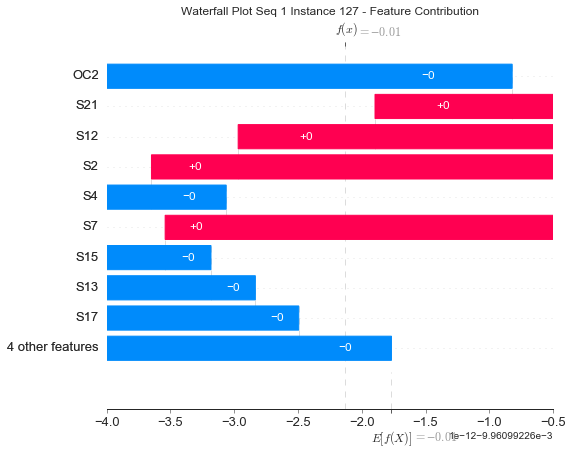

None

Contribution: [ 2.83082992e-13 -2.44890501e-12  1.24080412e-12 -5.52937850e-13
 -3.53105652e-12  1.19338708e-12  1.14459082e-12 -3.75115954e-12
  2.85584403e-12  9.58623948e-15  2.39716168e-12 -3.22795371e-12
  2.78543399e-12]


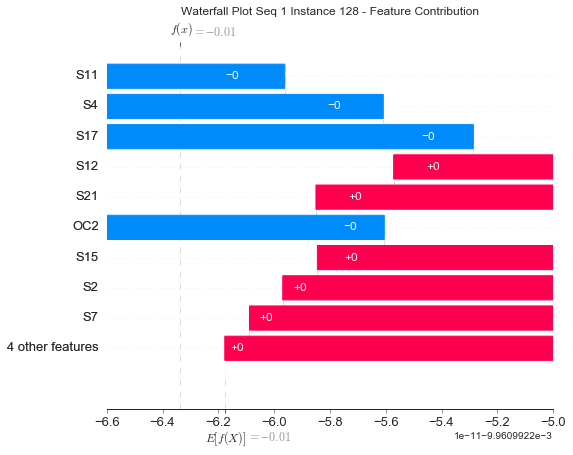

None

Contribution: [-7.24448388e-13  3.95163373e-12 -1.27339697e-12  1.02284999e-12
  5.16526665e-12 -9.86444108e-13 -1.55452203e-12  6.16071257e-12
 -3.07404666e-12 -3.07084572e-13 -6.33837947e-12  3.51165451e-12
 -3.05295481e-12]


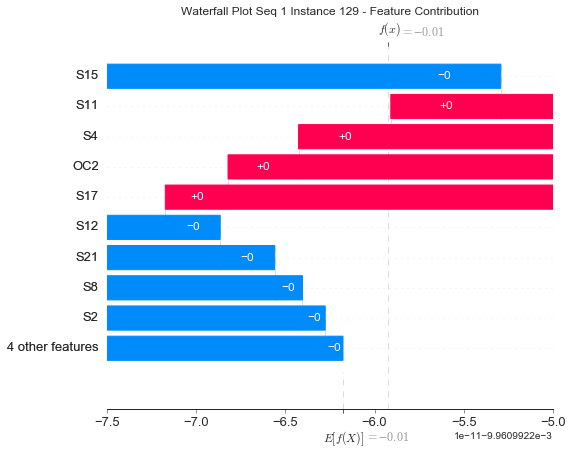

None

Contribution: [-1.70475247e-13 -4.99784459e-12  2.57595513e-13  2.54142495e-14
 -1.49186761e-12  1.15315960e-12 -6.12611849e-13 -1.56258676e-12
  2.53431195e-12 -4.22416117e-13  3.46373429e-12 -1.43187057e-13
  2.45045173e-12]


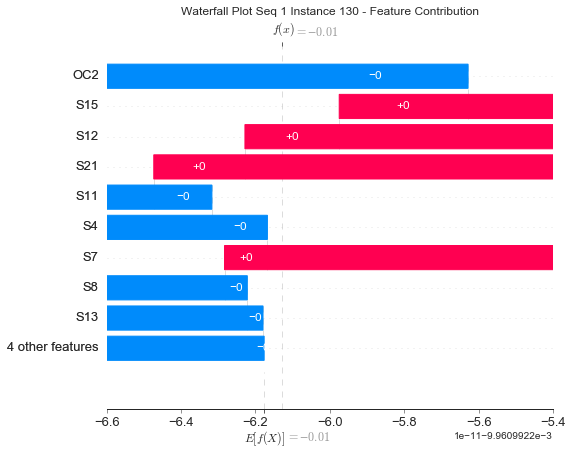

None

Contribution: [ 5.65742223e-13 -1.27680353e-12  9.95568970e-13 -4.01794158e-13
 -2.56863844e-12  8.43205605e-13  5.88159350e-13 -1.28668398e-12
  2.57846305e-12 -2.76292850e-13  6.74630653e-13 -2.36710066e-12
  2.68251003e-12]


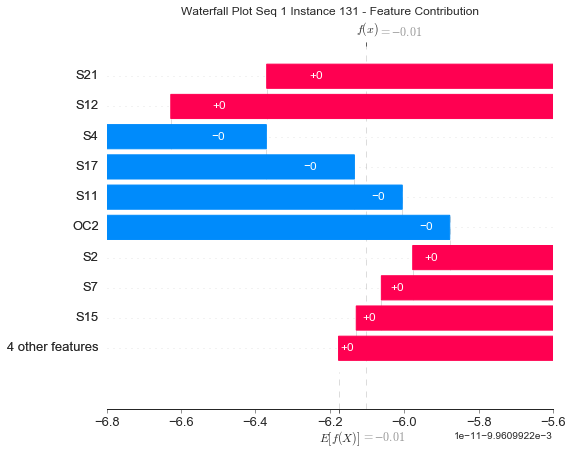

None

Contribution: [-4.71961771e-13  4.54218694e-12 -2.26340149e-12  1.32543802e-12
  7.46270407e-12 -2.89726338e-12 -2.76871863e-12  7.90734925e-12
 -6.99385732e-12 -2.62957679e-13 -5.38273679e-12  6.61376206e-12
 -6.69935288e-12]


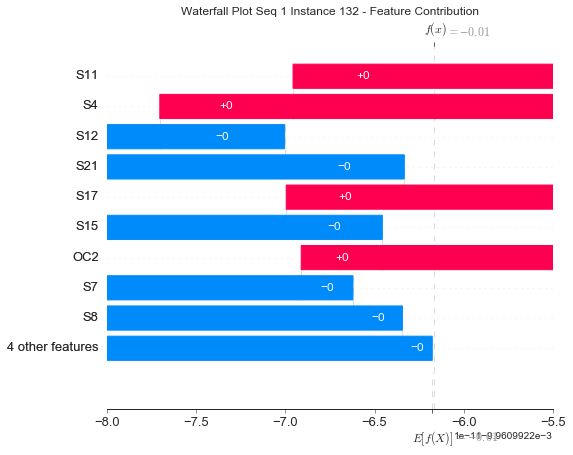

None

Contribution: [-6.49193373e-13  4.42627879e-12 -1.28755958e-12  1.99701930e-12
  1.03762277e-11 -1.45353868e-12 -5.65508577e-12  1.50671368e-11
 -4.71284817e-12 -2.61899118e-12 -1.47160721e-11  7.81027153e-12
 -4.57333000e-12]


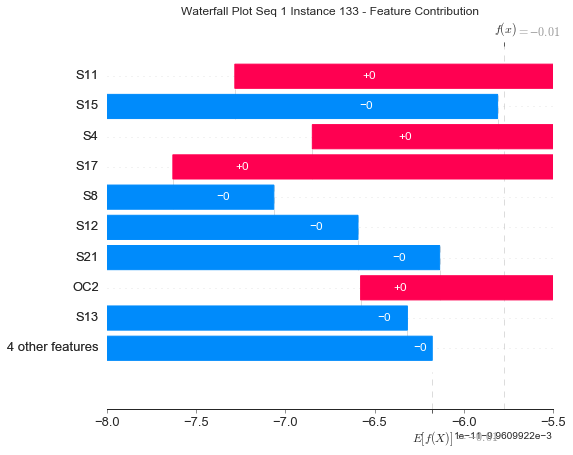

None

Contribution: [-3.29027468e-13 -2.14733851e-12 -7.97794339e-13  8.38551234e-13
  2.96010417e-12 -2.16239095e-13 -2.38158625e-12  3.64255848e-12
 -9.36385626e-13 -7.90756241e-13 -6.29442380e-14  3.42168438e-12
 -1.11789614e-12]


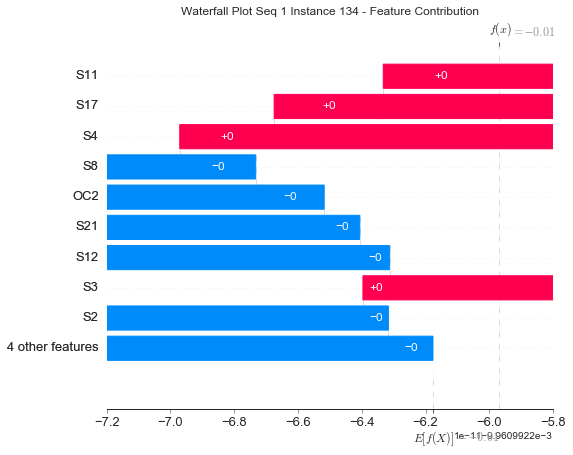

None

Contribution: [-7.88318575e-13  8.61299400e-12 -3.65493009e-12  2.44316655e-12
  1.51793439e-11 -5.20758133e-12 -6.13288803e-12  1.73622332e-11
 -1.31872013e-11 -1.16991529e-12 -1.38488483e-11  1.23492666e-11
 -1.24849506e-11]


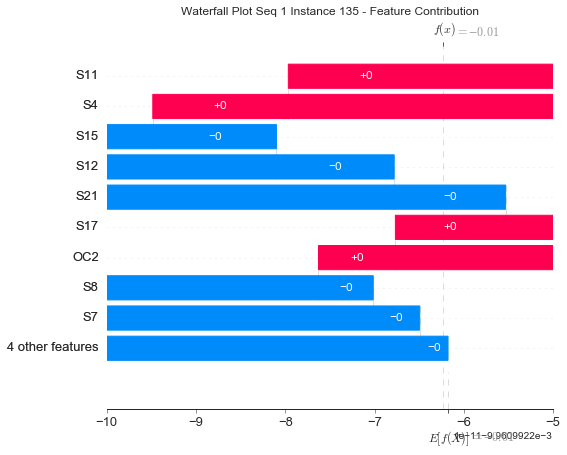

None

Contribution: [-5.34283934e-13 -1.75167357e-12 -1.21016391e-12  1.28372139e-12
  4.05618508e-12 -5.34215738e-13 -3.35156729e-12  6.69758346e-12
 -2.14001950e-12 -1.02787288e-12 -2.00674937e-12  4.82389519e-12
 -2.19542548e-12]


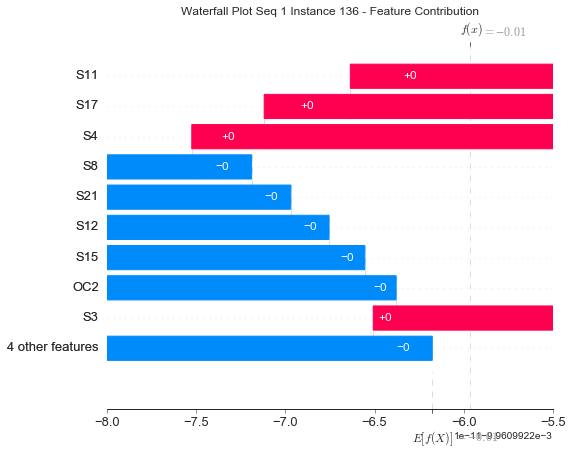

None

Contribution: [ 4.79942293e-15 -2.09438890e-12 -3.84307318e-14  4.29010262e-13
  1.46219506e-12 -3.24993633e-14 -1.47687147e-12  2.01713039e-12
 -2.05210415e-13 -5.27805610e-13  1.01823465e-12  2.18419944e-12
 -2.09976418e-13]


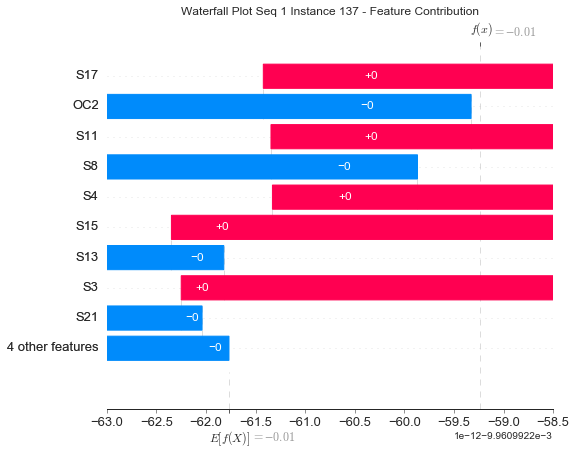

None

Contribution: [ 1.82942420e-13 -6.19639062e-12  1.74089877e-12 -8.29132607e-13
 -7.48844649e-12  3.02491799e-12  2.23643586e-12 -7.73667849e-12
  7.17761137e-12 -3.75782305e-13  5.93599605e-12 -5.97541938e-12
  7.13708736e-12]


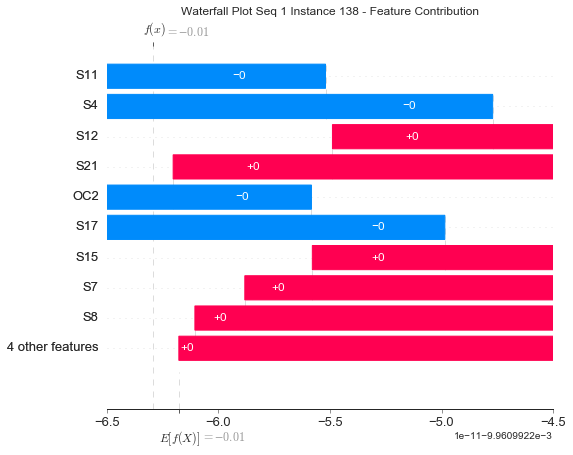

None

Contribution: [-4.95246910e-13 -4.96927976e-12  1.17438383e-12 -3.15346165e-13
 -4.35400370e-12  2.45460184e-12  8.04630939e-13 -3.62122246e-12
  5.13420426e-12 -8.48317618e-13  2.39336892e-12 -3.29617562e-12
  5.21254177e-12]


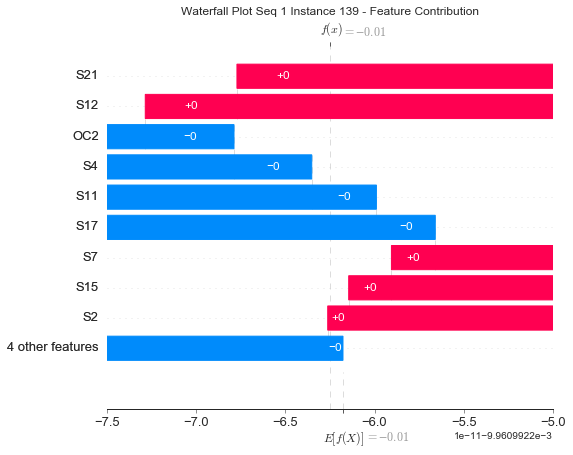

None

Contribution: [ 3.05826951e-13 -1.75065453e-12  7.98025491e-13 -3.86514768e-13
 -2.48832920e-12  1.51114082e-12  5.36688370e-13 -1.30927138e-12
  3.79771778e-12 -6.42215773e-13  4.79547825e-13 -2.33712355e-12
  3.89732170e-12]


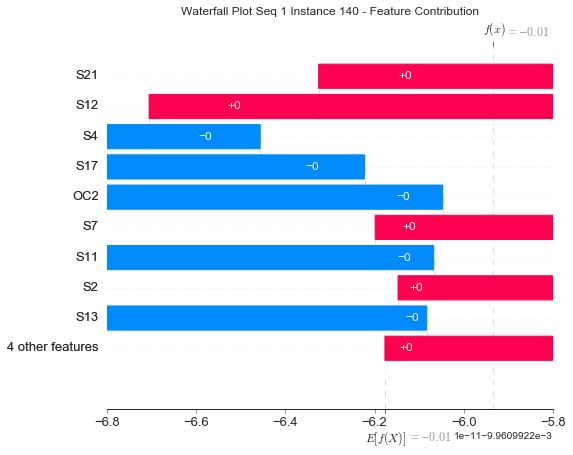

None

Contribution: [-1.97858589e-13  7.88960910e-12 -7.32537349e-13  1.92027319e-12
  1.74043280e-11 -5.52459727e-12 -8.16177161e-12  2.12494553e-11
 -1.26303100e-11 -3.13545565e-12 -1.96378712e-11  1.30299122e-11
 -1.22402999e-11]


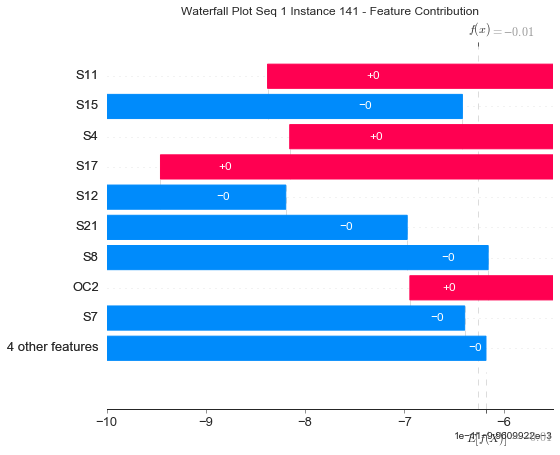

None

Contribution: [ 2.24355013e-13 -2.32003934e-12 -1.24448601e-13 -7.91695878e-14
 -3.56544069e-12  1.01142933e-12  7.85615334e-13 -2.58910601e-12
  2.20645464e-12 -8.89693660e-14  2.76288020e-12 -1.93677604e-12
  2.38936496e-12]


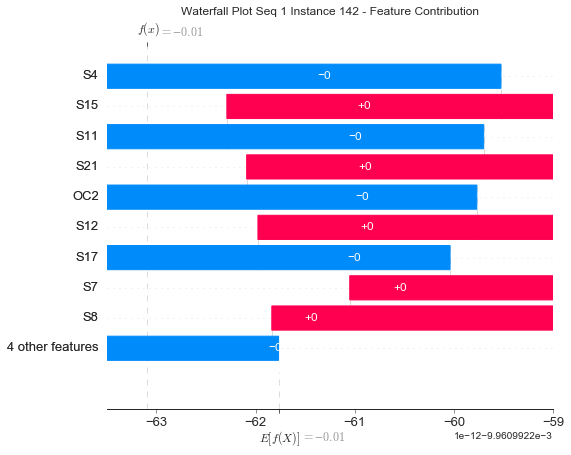

None

Contribution: [-5.19577925e-13  6.93849665e-12  5.50456863e-14  3.94929342e-13
  1.20785161e-11 -3.99914650e-12 -3.43965850e-12  1.10201414e-11
 -9.04064931e-12 -6.49305208e-13 -9.85701971e-12  7.16275173e-12
 -8.70666126e-12]


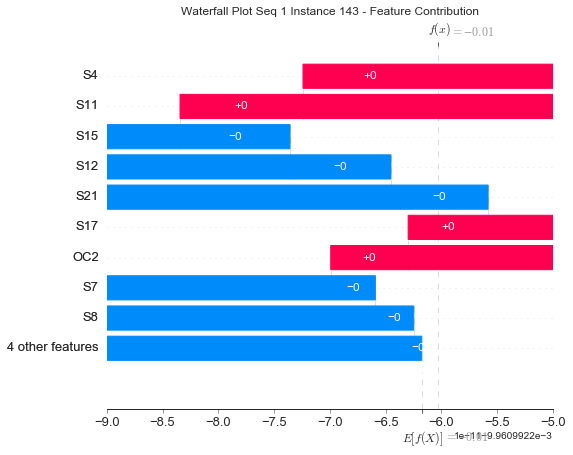

None

Contribution: [ 8.40794855e-14 -1.02462949e-12  9.92371116e-13 -1.69465272e-13
  1.00594327e-12  2.64651311e-13 -3.18595573e-13  3.64396095e-13
  8.07281921e-13 -3.99579187e-13 -4.56017711e-13  5.65783009e-14
  5.91100465e-13]


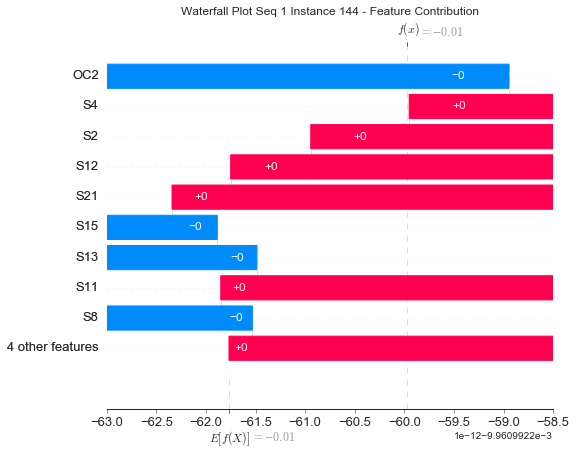

None

Contribution: [ 3.31774511e-13  5.38414094e-13 -9.93086364e-13  1.50833935e-13
 -1.34955675e-12  3.36495900e-14  3.42275985e-13 -8.02337146e-13
 -2.66670610e-13  2.53894020e-13  2.79762216e-13 -3.37140831e-14
 -3.49422775e-13]


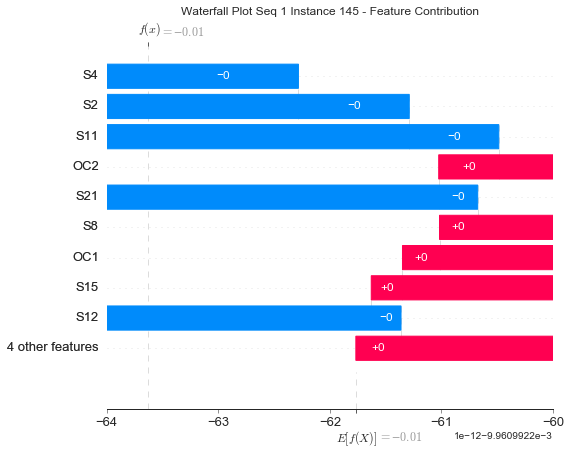

None

Contribution: [-6.61271422e-15 -1.26443222e-13 -2.18498505e-12  6.13968945e-13
 -5.10695652e-12  1.34930001e-12  2.47005498e-12 -4.58886922e-12
  2.68459734e-12  2.28074135e-12  5.78624084e-12 -2.84525637e-12
  2.10203382e-12]


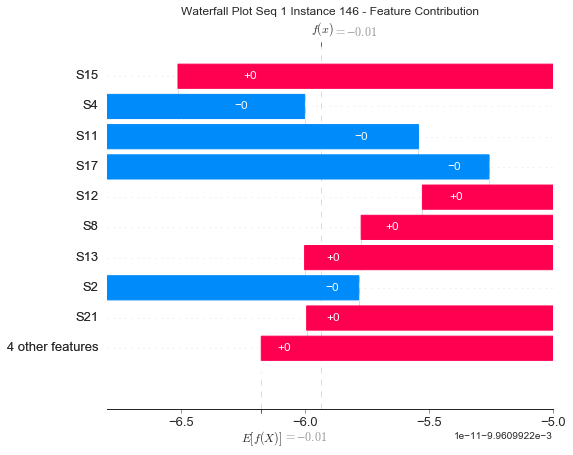

None

Contribution: [ 5.90376923e-13  2.83818845e-12 -4.51736912e-12  2.65230654e-12
  1.32288516e-12 -7.41319603e-13 -2.26753772e-12  5.63098656e-12
 -3.14829890e-12  3.85251130e-13 -2.86262485e-12  4.70680482e-12
 -3.24795204e-12]


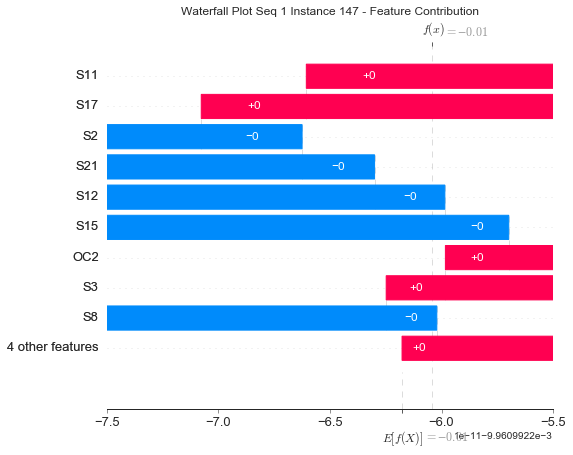

None

Contribution: [ 8.03152195e-13  1.49409163e-12 -3.12283879e-12  2.87711695e-12
  4.34247386e-12 -1.14513282e-12 -5.10055409e-12  1.00380060e-11
 -3.38194772e-12 -1.25525176e-12 -6.02055775e-12  7.15220027e-12
 -3.95057901e-12]


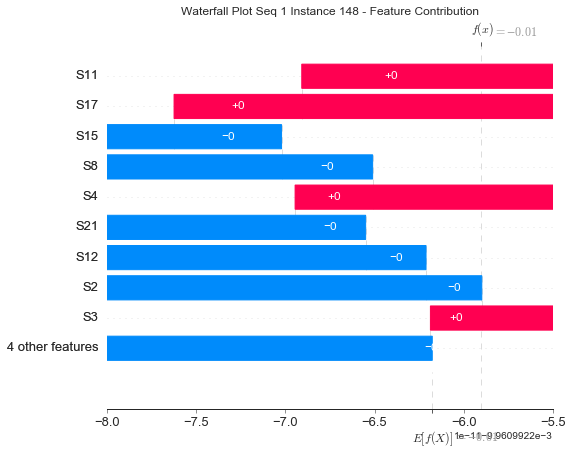

None

Contribution: [-3.37716779e-13  1.13580683e-12 -5.22768591e-12  4.18064802e-12
  5.79246503e-12 -2.67909555e-13 -6.93439490e-12  1.49422662e-11
 -2.95831111e-12 -2.07241451e-12 -1.26271224e-11  9.00261463e-12
 -3.02277973e-12]


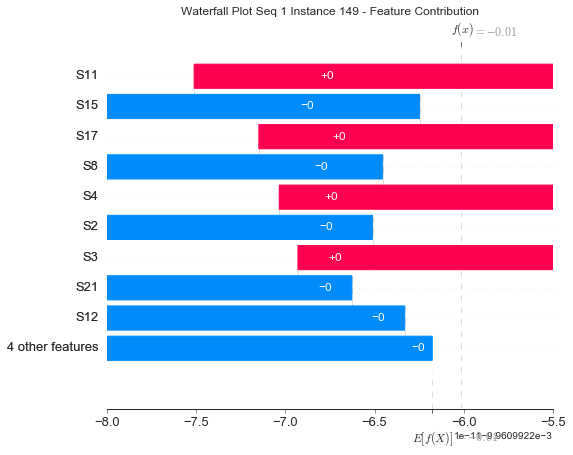

None

Contribution: [ 1.15254551e-12 -5.20877482e-12  3.01037840e-12 -2.30395043e-12
 -8.15793873e-12  1.68899324e-12  3.92971940e-12 -1.16791672e-11
  5.64077734e-12  1.30452105e-12  1.13826370e-11 -7.52154849e-12
  5.41301249e-12]


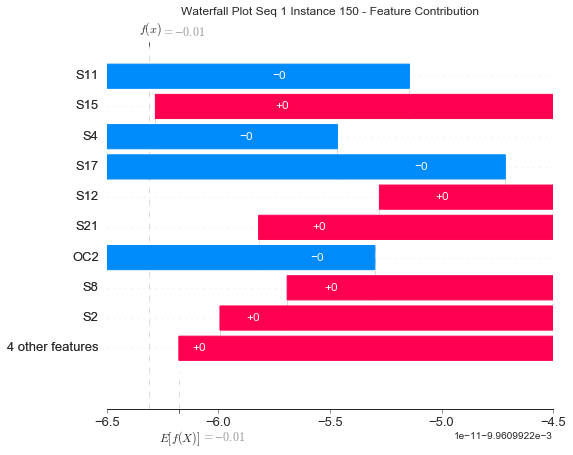

None

Contribution: [-4.18673234e-13  8.58090335e-12 -3.21985548e-13  1.02173131e-12
  6.06567097e-12 -1.84664480e-12 -2.47389912e-12  9.21050996e-12
 -5.05327984e-12 -1.34212823e-12 -1.39014330e-11  3.75295107e-12
 -4.36011427e-12]


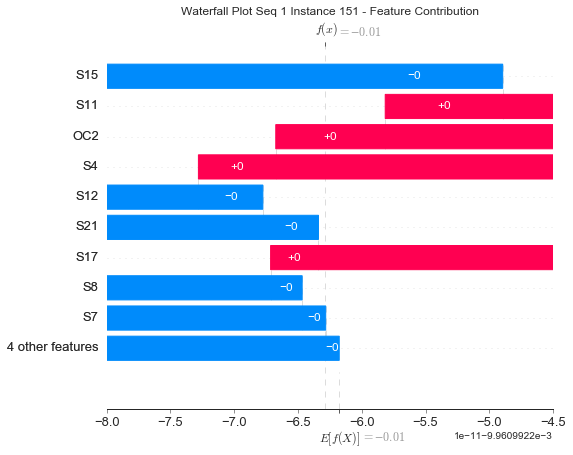

None

Contribution: [ 1.69890415e-12 -9.23696362e-12  8.22763298e-12 -4.81838354e-12
 -1.54168987e-11  3.68543867e-12  8.74184492e-12 -2.47789358e-11
  1.29211945e-11  2.66547808e-12  2.09017491e-11 -1.47172240e-11
  1.08563245e-11]


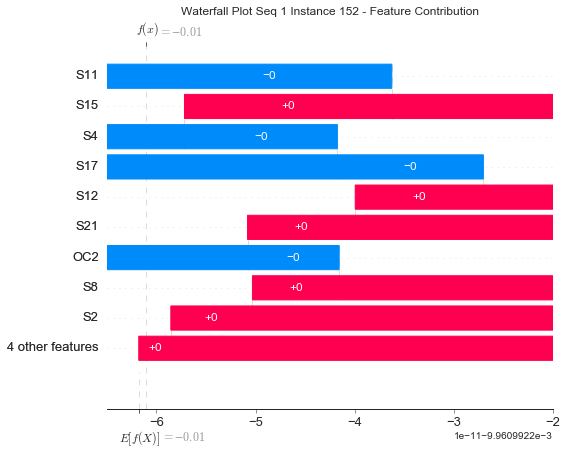

None

Contribution: [-7.21964914e-13 -7.02292304e-12  8.93487920e-13 -2.50874842e-12
 -1.20205425e-11  2.15638076e-12  5.36005441e-12 -1.57633351e-11
  6.35981025e-12  2.43435393e-12  1.74536826e-11 -8.89727615e-12
  6.91372046e-12]


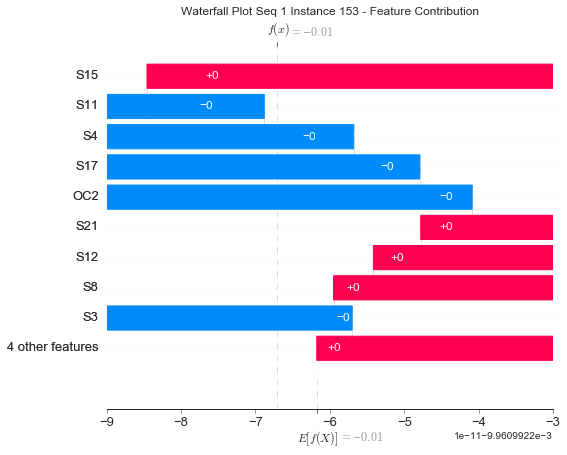

None

Contribution: [ 2.20914866e-12  8.10096868e-12 -3.74705865e-12  6.05266596e-13
  4.77825028e-12 -5.38903124e-12  2.60659414e-13 -2.85713158e-13
 -1.22786694e-11  2.91795624e-12  4.12325908e-13  6.10446979e-12
 -1.35715640e-11]


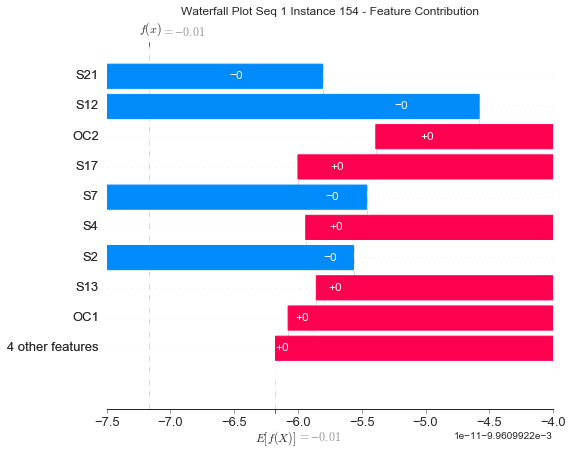

None

Contribution: [-2.01093547e-12  1.14539532e-11 -7.53851322e-12  3.04790893e-12
  1.63221416e-11 -7.80070539e-12 -3.78942884e-12  1.12784816e-11
 -1.99075322e-11  1.86921008e-12 -5.19893677e-12  1.46739669e-11
 -1.95438839e-11]


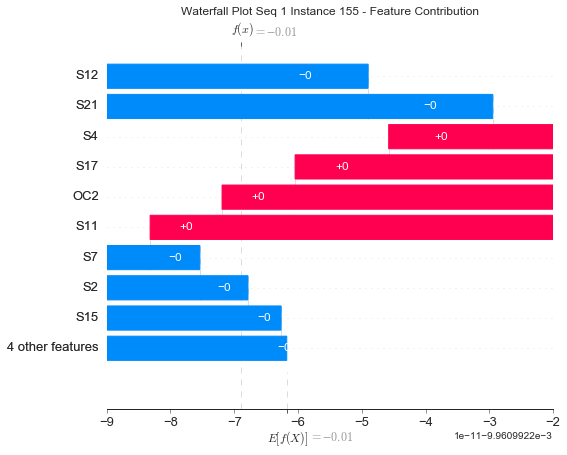

None

Contribution: [ 2.87818337e-12 -2.08559541e-11  6.78093692e-12 -4.66146219e-12
 -2.82583158e-11  8.97860692e-12  7.25584133e-12 -2.91198385e-11
  2.39236183e-11  9.00720352e-15  2.59947099e-11 -2.06792430e-11
  2.31588550e-11]


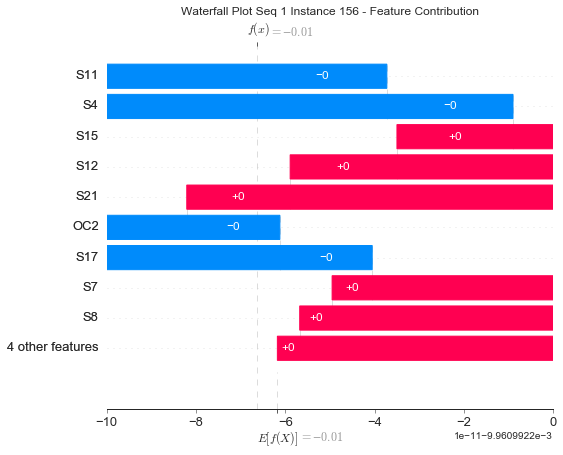

None

Contribution: [ 2.63424807e-12 -2.27678380e-11  1.28300599e-11 -9.75248094e-12
 -4.70697578e-11  1.49701605e-11  1.86971758e-11 -5.61501158e-11
  3.92922014e-11  4.46071045e-12  4.14716039e-11 -3.92298936e-11
  3.57515129e-11]


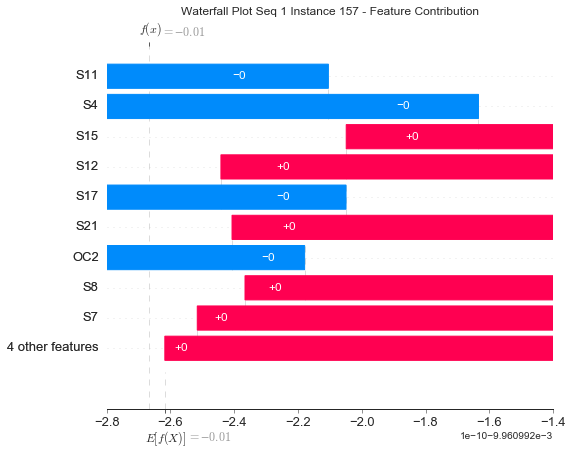

None

Contribution: [-1.33351229e-12  3.29295770e-12  4.19561304e-12 -5.90341708e-12
 -2.44439486e-11  6.48408844e-12  1.73541095e-11 -3.24556770e-11
  1.51537602e-11  6.38047991e-12  1.19937948e-11 -2.43273266e-11
  1.64518260e-11]


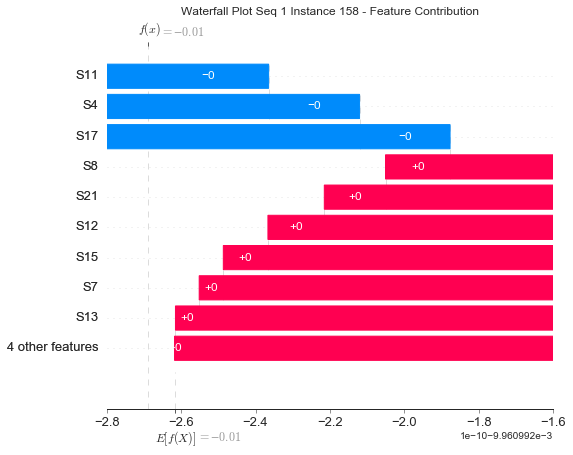

None

Contribution: [ 1.28885791e-12  2.89925245e-12 -2.50017997e-12  5.10005612e-13
  2.49913306e-12 -3.51720389e-13 -1.28569518e-12  4.67970671e-12
  2.66449569e-13  2.45182807e-13 -1.52908589e-12  3.06828521e-12
  7.07809787e-13]


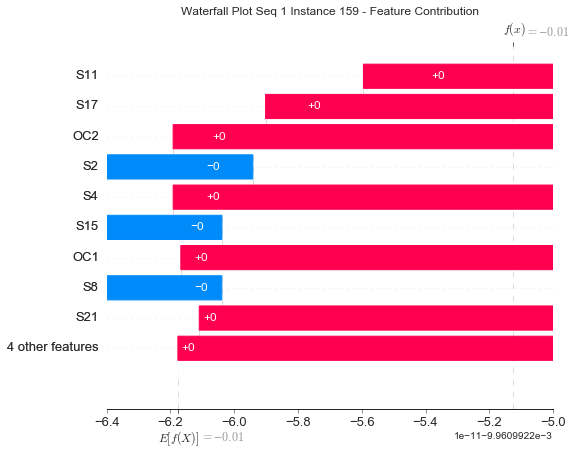

None

Contribution: [ 2.29350935e-12  2.48334183e-11 -5.94553269e-13 -1.74972038e-12
  5.00965632e-12 -8.18209389e-12  5.68314146e-12 -3.21248453e-12
 -1.55285212e-11  4.51572980e-12 -1.02404136e-11 -2.69666169e-12
 -1.54972146e-11]


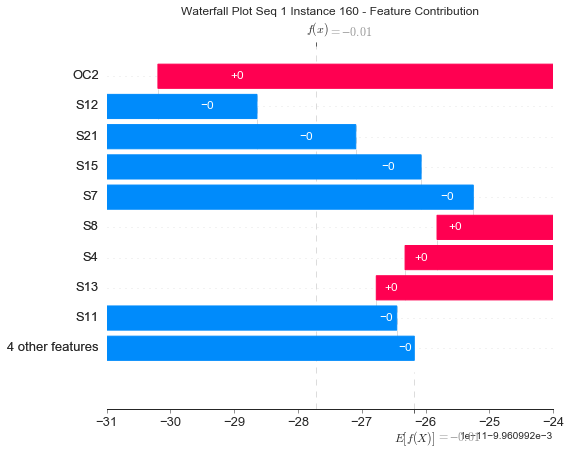

None

Contribution: [-1.19370074e-12  5.34509112e-12 -2.96382797e-12  1.07238940e-11
  4.43129804e-11 -5.72440576e-12 -3.46185129e-11  7.94430285e-11
 -1.64171784e-11 -2.31153239e-11 -8.56806362e-11  3.75834398e-11
 -1.39428226e-11]


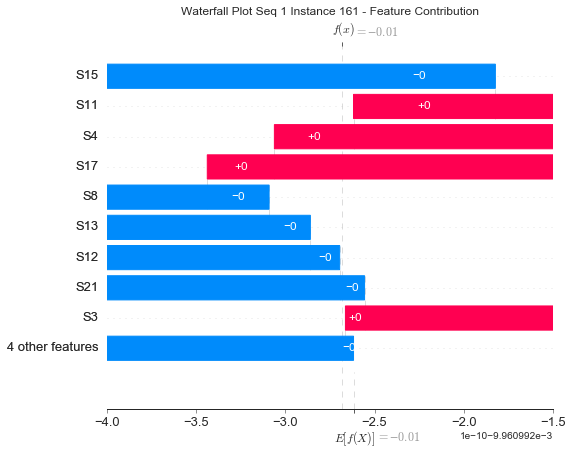

None

Contribution: [ 3.16098796e-12 -3.27112851e-11  1.27335625e-11 -1.31407810e-11
 -8.32319491e-11  2.46281381e-11  3.55208016e-11 -9.74455100e-11
  5.97416283e-11  1.52099132e-11  8.46677589e-11 -6.22342455e-11
  5.42282400e-11]


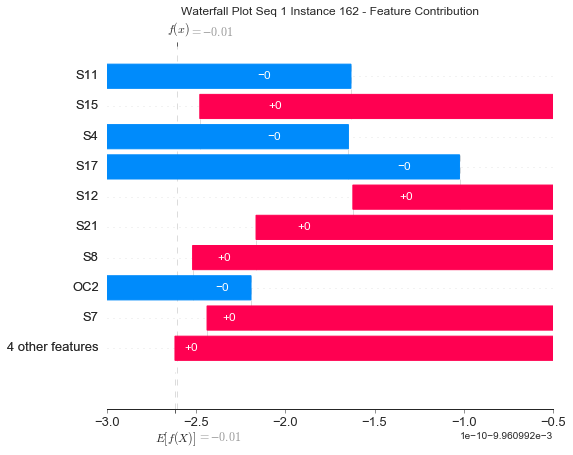

None

Contribution: [ 3.89578734e-12 -2.72334238e-11  9.48707779e-12 -9.39582526e-12
 -6.16104945e-11  1.71267601e-11  2.30681550e-11 -6.83797810e-11
  4.53174755e-11  8.33336351e-12  5.86057938e-11 -4.29991563e-11
  4.10567275e-11]


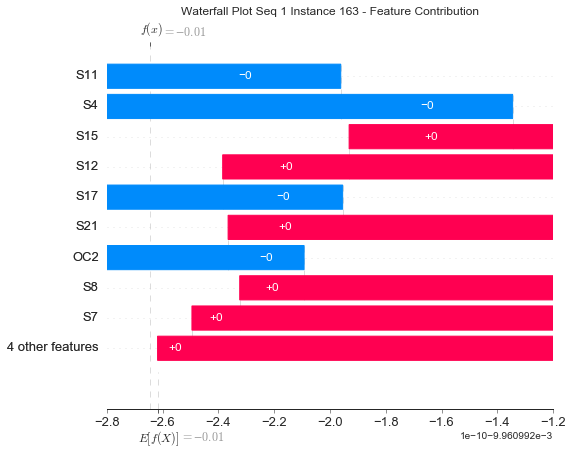

None

Contribution: [-3.89393379e-12 -3.41950426e-11  6.11948339e-12 -6.96836555e-12
 -6.15084303e-11  2.41075319e-11  2.13282118e-11 -6.49431481e-11
  5.34090029e-11  5.93419931e-12  5.01077409e-11 -4.04861561e-11
  5.23559980e-11]


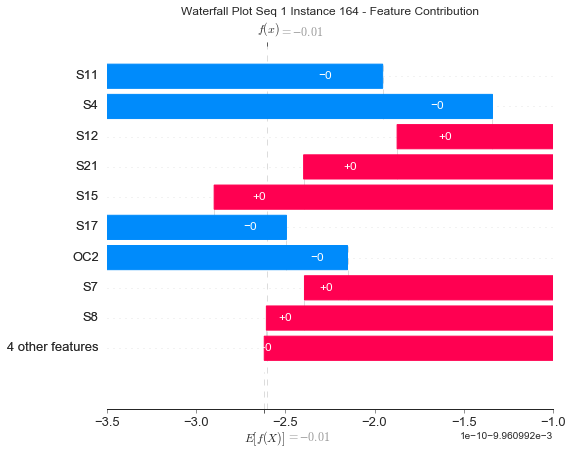

None

Contribution: [-1.94206456e-12  1.26780184e-11 -4.48141827e-12  2.37503983e-12
  2.30469324e-11 -9.56934532e-12 -4.97060769e-12  1.21348990e-11
 -2.51192678e-11  2.61933747e-12 -8.84494821e-12  1.70035947e-11
 -2.47955788e-11]


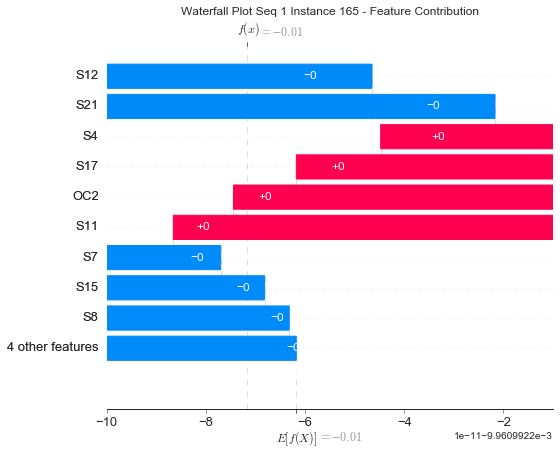

None

Contribution: [-3.05291231e-12 -3.23893516e-11  3.72266931e-12 -8.15655009e-12
 -7.37865810e-11  2.72989305e-11  2.96700789e-11 -8.11858775e-11
  5.97992211e-11  1.30035349e-11  6.80183895e-11 -5.11097310e-11
  5.70246940e-11]


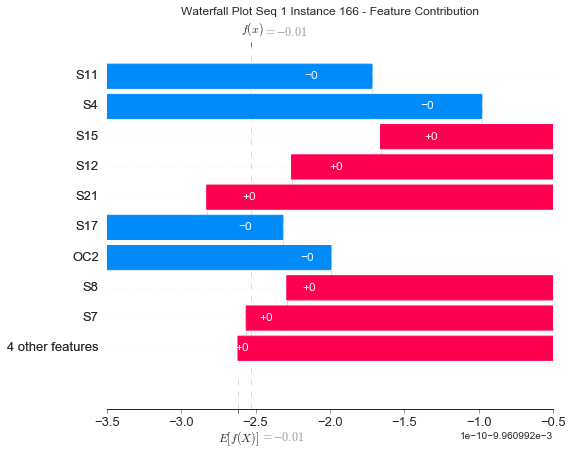

None

Contribution: [ 6.91365774e-14  1.51211942e-11 -4.59481357e-13  1.81475223e-12
  2.77132328e-11 -1.37504912e-11 -4.96173545e-12  1.31579053e-11
 -3.07026661e-11  3.73530547e-12 -9.32644240e-12  1.77513212e-11
 -3.11050422e-11]


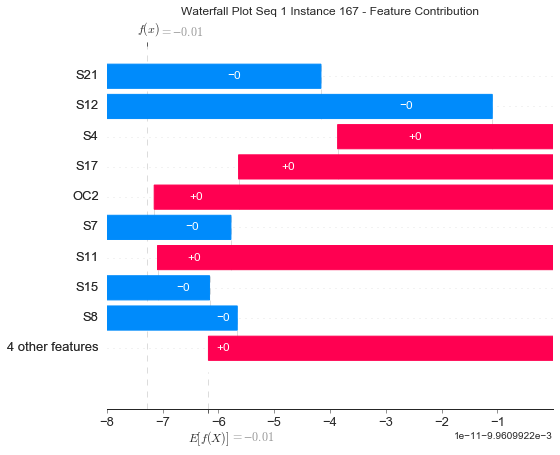

None

Contribution: [-5.19635279e-13 -9.57321028e-12 -4.39962818e-13 -1.13542801e-12
 -2.13249314e-11  5.88343436e-12  3.72916194e-12 -1.49693279e-11
  1.28403720e-11  2.46748531e-13  1.63698725e-11 -1.07897528e-11
  1.27737803e-11]


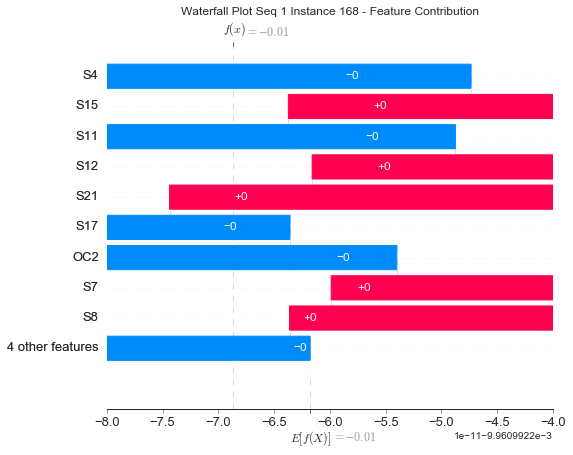

None

Contribution: [-1.66482334e-12 -6.40987697e-13  4.73713256e-12  5.80961581e-12
  3.82593436e-11 -4.27433392e-12 -2.77802954e-11  5.86112617e-11
 -9.28701040e-12 -2.55333324e-11 -6.28683772e-11  2.62537752e-11
 -7.74756214e-12]


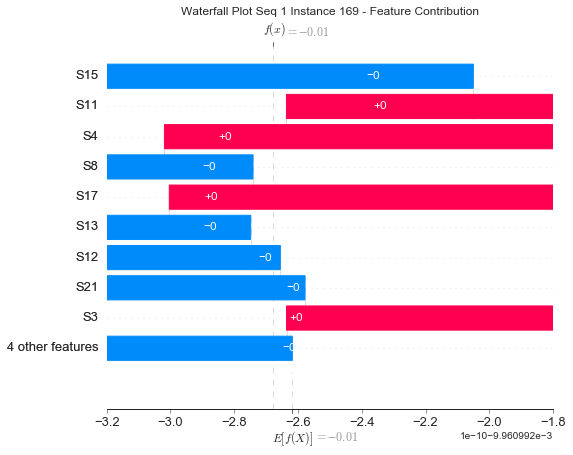

None

Contribution: [ 1.15583389e-12  1.08030924e-12  4.35532816e-12  1.38108578e-12
  1.27131188e-11 -5.26455528e-12 -3.94129477e-12  8.37302189e-12
 -8.45610821e-12 -6.04820339e-13 -9.13070487e-12  5.79602468e-12
 -9.56364241e-12]


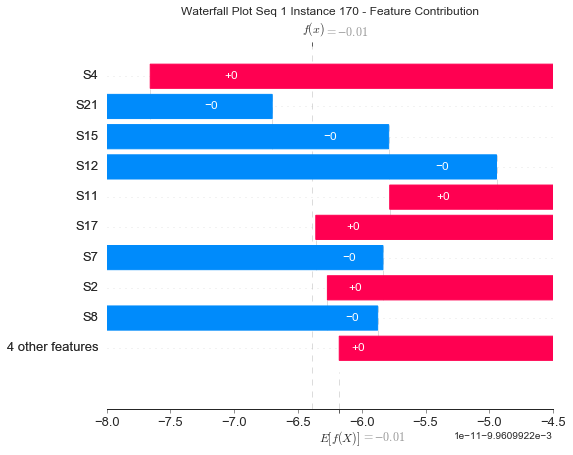

None

Contribution: [ 4.66084853e-13 -3.85270938e-12 -2.60358662e-12  1.36495221e-12
 -5.60378697e-12  1.03450993e-12 -2.64793309e-12  1.19834665e-12
  1.70448551e-12 -1.62922681e-12  4.61900483e-12  6.16948495e-13
  1.36608509e-12]


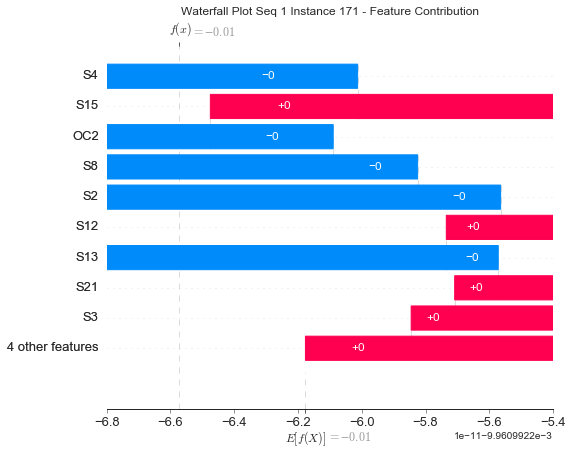

None

Contribution: [-1.00997021e-12  2.27161687e-13  3.70237304e-12  7.87001107e-13
  9.88551515e-12 -4.93698832e-12 -4.27000449e-12  7.42596696e-12
 -8.95797499e-12 -7.54998006e-13 -2.78049177e-12  5.13575033e-12
 -8.73659912e-12]


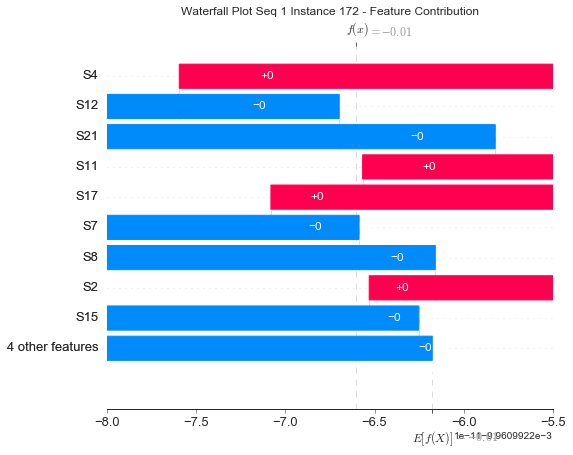

None

Contribution: [-4.27174409e-13  2.78117004e-12  9.26705501e-12 -5.47556922e-12
  8.30135787e-12 -4.24922727e-12  3.11731565e-12 -7.79054252e-12
 -5.25756478e-12 -3.41209743e-12  5.72445520e-12 -3.74258567e-12
 -5.28293468e-12]


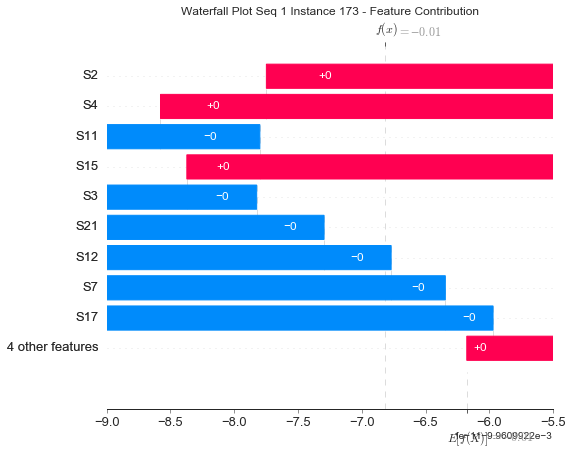

None

Contribution: [-1.75515407e-12  2.69237046e-11 -2.43273804e-11  9.09247764e-12
  1.36453236e-11 -9.47695047e-12 -8.33830748e-12  3.24954647e-11
 -2.98205835e-11  1.41412164e-12 -1.70344173e-11  2.64721006e-11
 -2.58031981e-11]


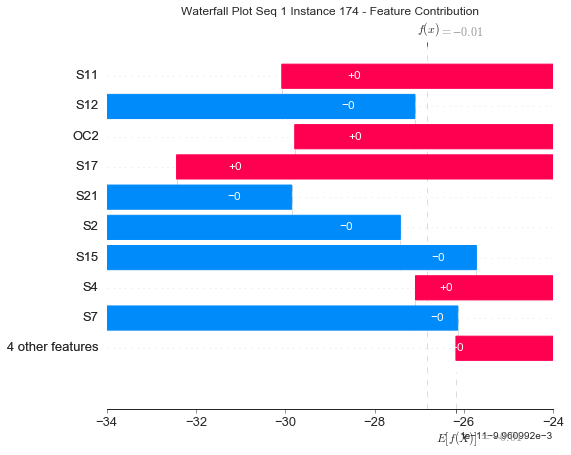

None

Contribution: [-1.41044251e-12 -1.90308325e-11  1.17219411e-11 -2.52878729e-12
 -1.00840039e-11  5.19590534e-12  2.06347005e-12 -1.49988130e-11
  1.42549939e-11 -2.71720038e-12  1.22777986e-11 -1.48949846e-11
  1.38796179e-11]


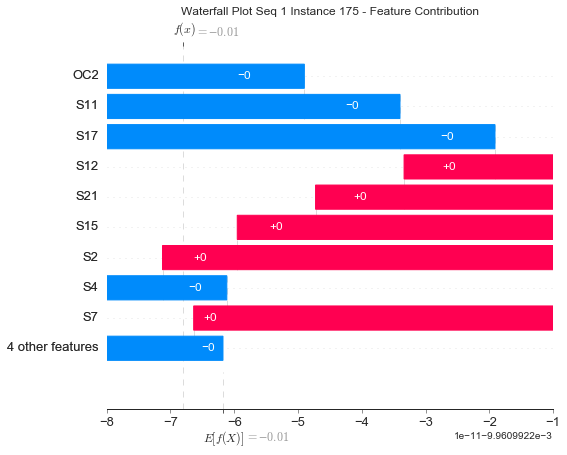

None

Contribution: [-4.87855904e-13 -1.09793927e-11  1.10293458e-11 -2.59931269e-12
 -7.56622976e-12  5.25423715e-12  2.25134066e-13 -2.52445742e-12
  1.77038505e-11 -5.91973345e-12 -3.57864021e-12 -1.22600107e-11
  1.75562447e-11]


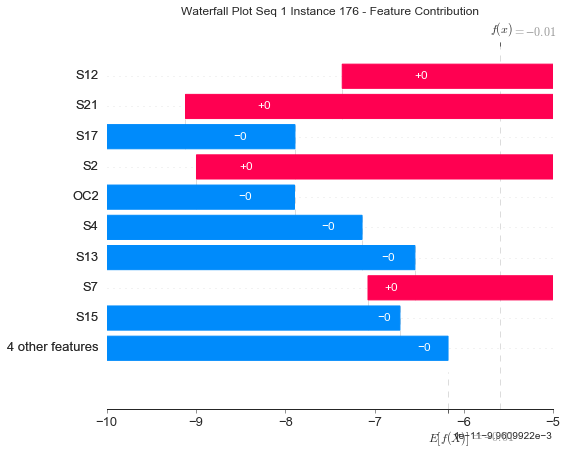

None

Contribution: [ 1.68058642e-13 -1.34303228e-11 -9.91071114e-12  1.27904935e-11
  3.07820124e-11 -5.94171630e-12 -3.81962760e-11  6.50455523e-11
 -1.60910920e-11 -1.97045956e-11 -2.96128434e-11  3.97930543e-11
 -1.73297123e-11]


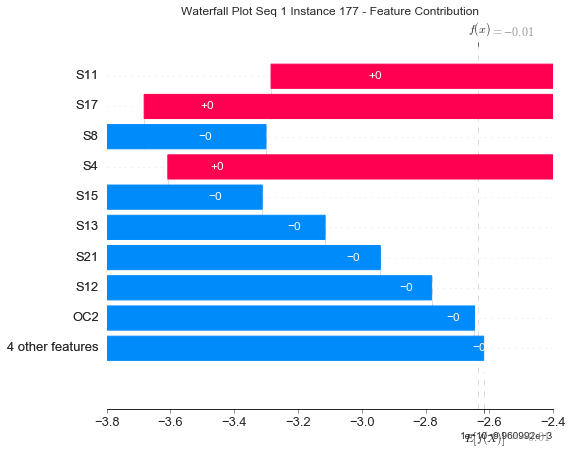

None

Contribution: [-4.72598696e-12 -3.22175758e-11  1.45586286e-11  6.06879076e-13
 -1.41610734e-11  1.40423003e-11 -1.42874931e-11  2.06309605e-11
  3.85839381e-11 -1.81907926e-11 -1.69664525e-11 -9.95846287e-12
  3.99143635e-11]


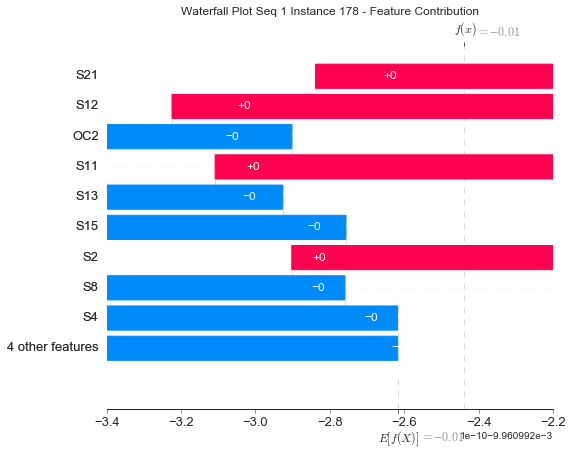

None

Contribution: [ 3.66408162e-12 -2.99930705e-11  1.58314056e-11 -7.78276835e-12
 -4.46466614e-11  1.31325818e-11  8.65849059e-12 -3.76766326e-11
  3.46500779e-11 -3.69391800e-12  2.70977546e-11 -3.28258254e-11
  3.15535341e-11]


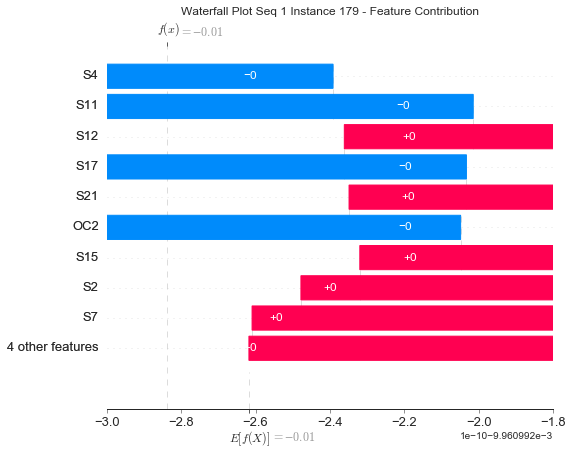

None

Contribution: [ 7.79066395e-12  8.98666003e-11 -4.22462378e-11  2.40683706e-11
  1.29214792e-10 -5.98691582e-11 -5.65020183e-11  1.61193892e-10
 -1.40283410e-10 -1.00467351e-11 -1.09783363e-10  1.14466034e-10
 -1.34807401e-10]


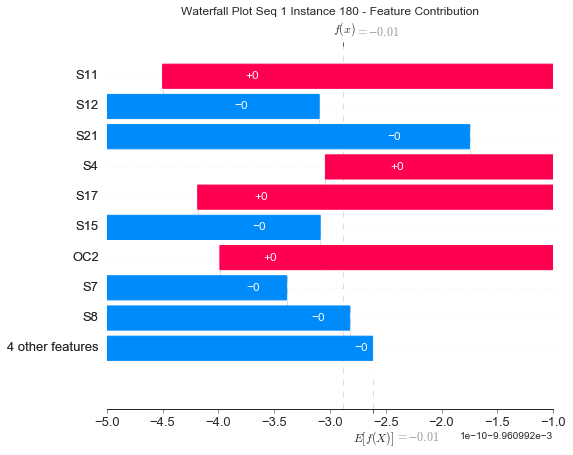

None

Contribution: [-1.93803133e-11 -6.35098016e-11  2.31508372e-11 -5.40240942e-12
 -5.48258210e-11  3.76550180e-11 -5.06925014e-13 -1.60782308e-11
  8.76730633e-11 -2.24057300e-11  1.66412734e-11 -4.89982430e-11
  9.25112070e-11]


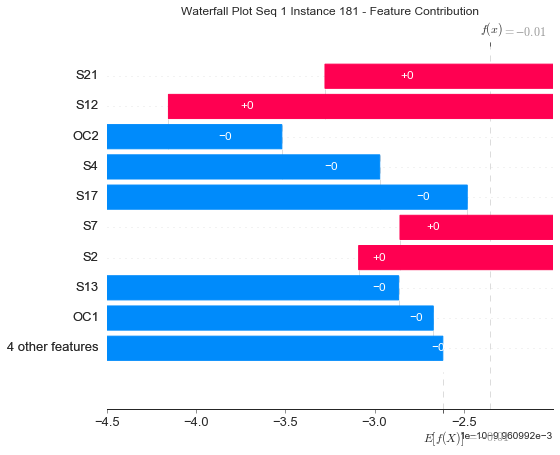

None

Contribution: [ 6.43636490e-12 -3.50411158e-11  1.78394816e-11 -4.37525970e-12
 -3.95020093e-11  1.89223810e-11  1.50435220e-13 -8.39005948e-12
  5.43988257e-11 -1.10563520e-11  1.20940263e-11 -3.04525745e-11
  5.10821212e-11]


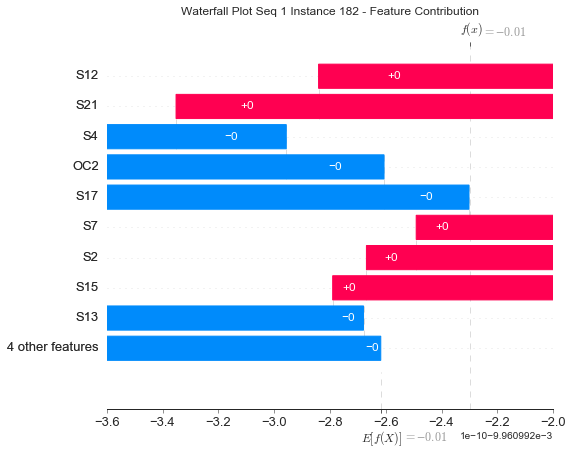

None

Contribution: [ 1.36198973e-12 -8.51745896e-11  6.70112273e-12 -3.52167817e-12
 -5.34260483e-11  2.36622996e-11 -1.19546300e-12 -4.85663801e-11
  5.66009010e-11 -7.15282087e-12  1.03584842e-10 -1.93178355e-11
  4.92239756e-11]


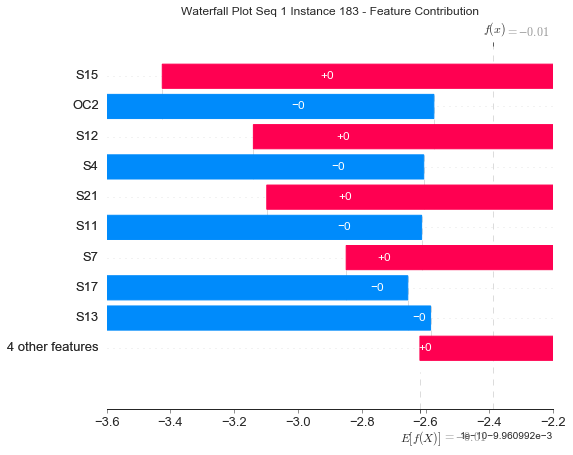

None

Contribution: [-9.14578829e-12  1.07178710e-10 -4.34059941e-11  2.74171866e-11
  1.87650895e-10 -6.63585159e-11 -6.93308952e-11  1.99591635e-10
 -1.71262185e-10 -2.03943563e-11 -1.54107643e-10  1.43890996e-10
 -1.58543872e-10]


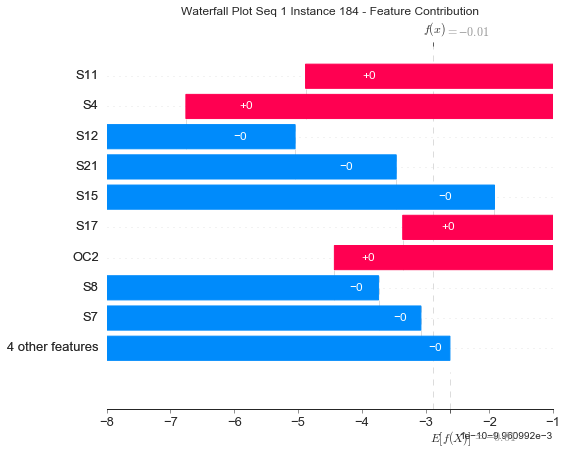

None

Contribution: [ 1.03433529e-11  1.20348564e-10 -3.84311229e-11  2.48084105e-11
  1.90011493e-10 -8.51037435e-11 -7.29403551e-11  2.03173894e-10
 -1.91998237e-10 -1.56305299e-11 -1.37877945e-10  1.57021868e-10
 -1.87434429e-10]


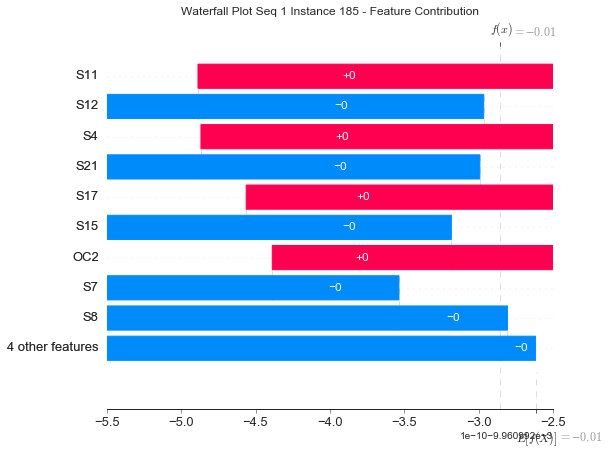

None

Contribution: [ 6.70166787e-12 -6.47032983e-11  2.55991582e-11 -1.49163338e-11
 -1.11510877e-10  4.64205965e-11  2.33085998e-11 -7.02284828e-11
  1.19459637e-10 -1.62471391e-11  5.61582482e-11 -8.40422870e-11
  1.15767784e-10]


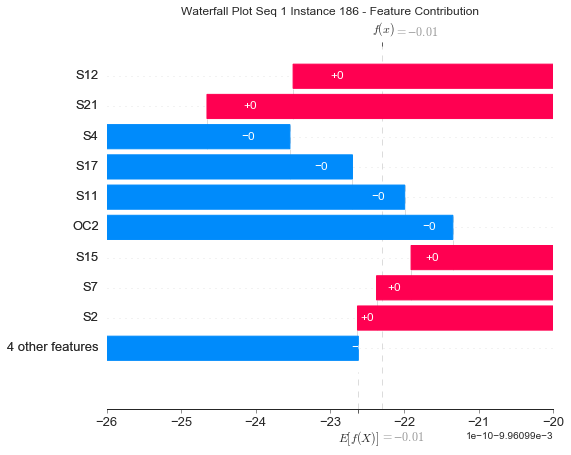

None

Contribution: [-4.56256387e-12 -4.49836418e-11 -1.18684021e-11  1.40811529e-11
  4.91741960e-11 -4.85598584e-12 -4.85229565e-11  8.40980618e-11
 -1.68459222e-11 -2.80246885e-11  3.42526853e-12  5.46021700e-11
 -1.58887677e-11]


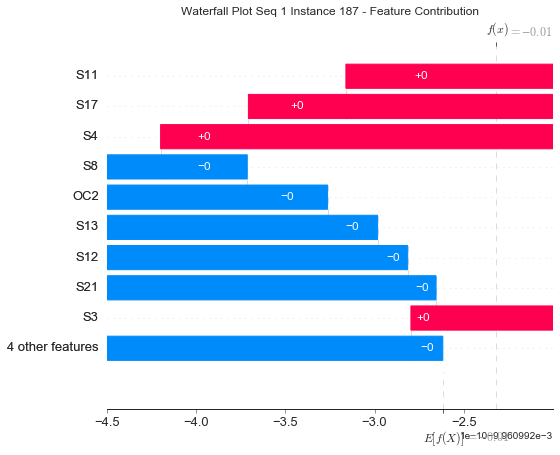

None

Contribution: [ 2.36147282e-11  1.26933283e-10 -2.50879994e-11  2.49281394e-11
  2.28589855e-10 -1.06599916e-10 -8.39939229e-11  2.35302611e-10
 -2.24487873e-10 -2.08529392e-11 -1.43130993e-10  1.69315978e-10
 -2.22648927e-10]


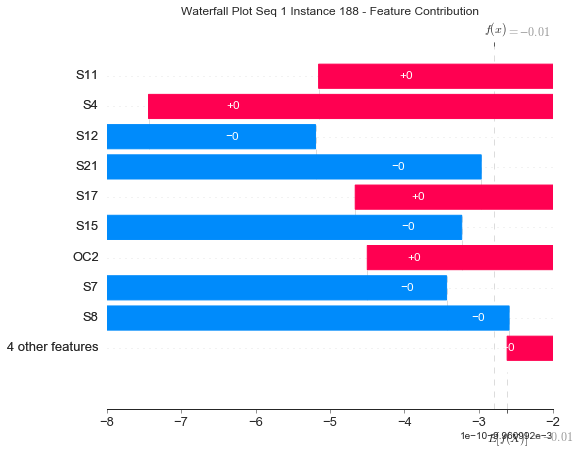

None

Contribution: [-6.38382489e-12 -4.63445948e-11  8.74537682e-12  7.27802280e-12
 -1.39793663e-11  1.96308751e-11 -3.78682433e-11  6.83651954e-11
  5.08340280e-11 -4.24990911e-11 -5.06139471e-11  1.20194450e-13
  5.26139549e-11]


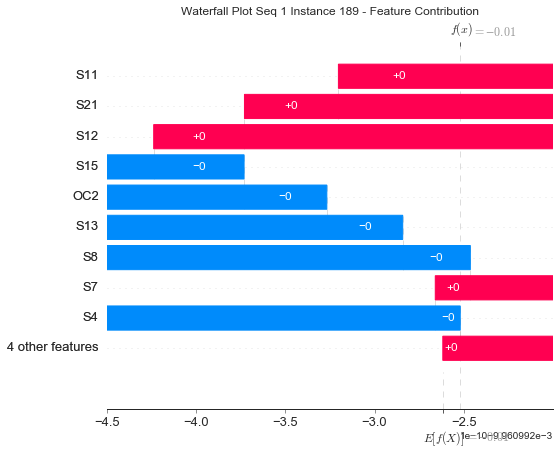

None

Contribution: [-8.13227870e-12 -6.71772291e-11  1.03843089e-11 -6.04390886e-12
 -7.07551587e-11  3.53809516e-11  9.48990799e-12 -5.93307556e-11
  7.49948992e-11 -1.62663546e-11  5.29898937e-11 -5.33250978e-11
  7.30847882e-11]


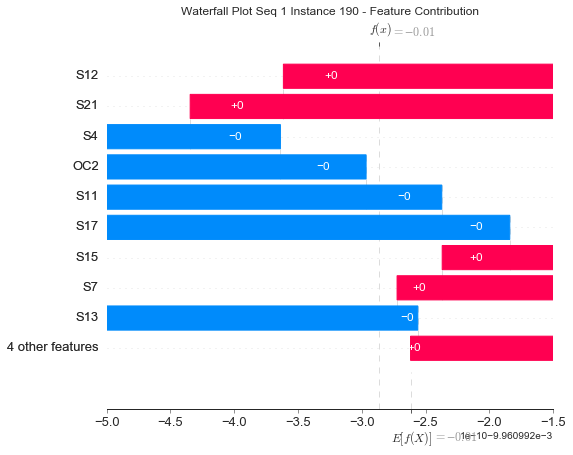

None

Contribution: [-1.80034384e-12 -3.67072137e-11  4.07985928e-13 -4.01755062e-12
 -6.19704774e-11  2.99512776e-11  5.91076927e-12 -1.84545226e-11
  6.67862987e-11 -1.37638841e-11  3.17186347e-11 -4.19906367e-11
  6.77570014e-11]


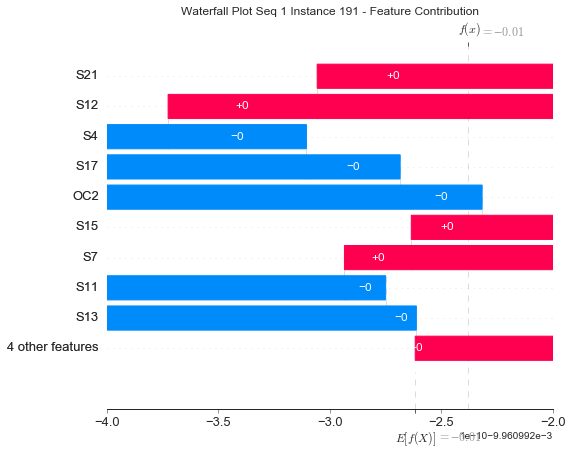

None

Contribution: [-5.61509335e-13 -1.19953231e-11 -4.09982486e-13  1.26913991e-11
  8.88904436e-11 -1.97745778e-11 -5.66142029e-11  1.16757742e-10
 -4.53609407e-11 -2.77639786e-11 -5.04731291e-11  7.08341164e-11
 -4.43720442e-11]


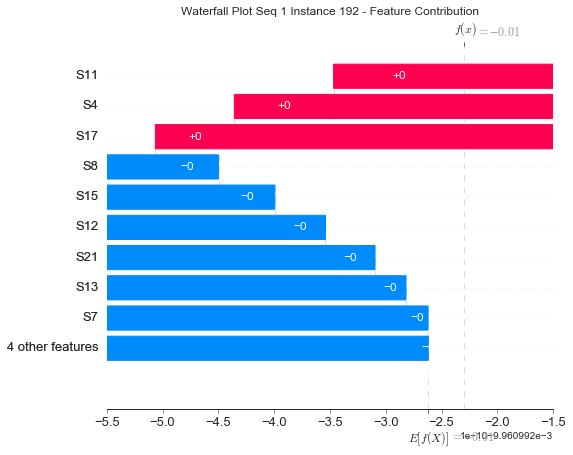

None

Contribution: [ 3.90309486e-12  7.62093721e-11  5.05518110e-12  7.50660038e-12
  1.81068147e-10 -7.07156902e-11 -4.72129211e-11  1.42789960e-10
 -1.46796894e-10 -9.48273925e-12 -1.00085044e-10  1.03573136e-10
 -1.41606477e-10]


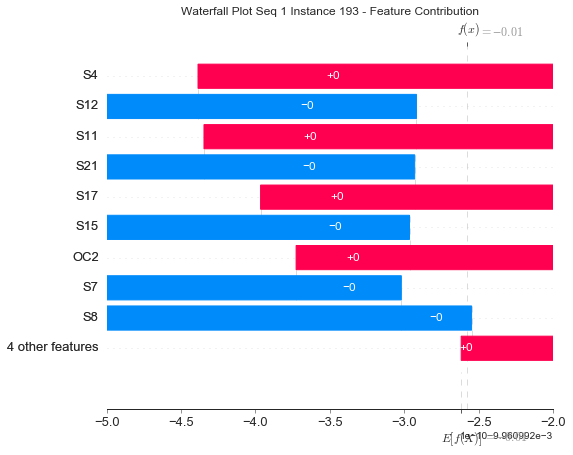

None

Contribution: [ 2.60392012e-12 -1.81445744e-11  3.09693330e-12 -9.55375319e-13
 -3.13091116e-11  1.37272164e-11 -1.21997887e-12 -3.81424970e-12
  2.82085570e-11 -1.57675227e-11 -1.64682729e-11 -1.75594938e-11
  2.86397260e-11]


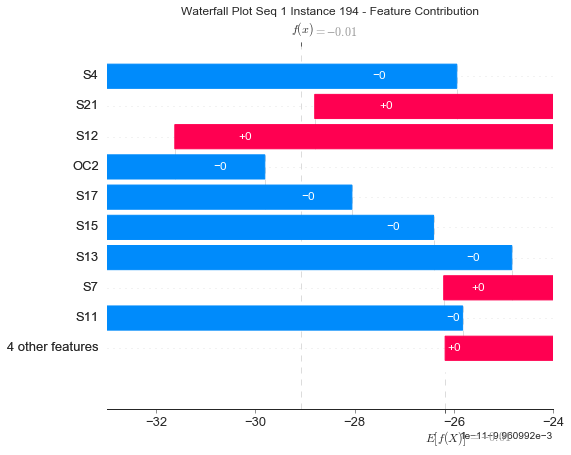

None

Contribution: [ 2.45112437e-12 -2.50105180e-11 -1.92068531e-11 -1.90446769e-12
 -7.67629224e-11  3.22920891e-11  1.94581816e-11 -4.19910599e-11
  6.18013488e-11  4.26041824e-13  4.52050272e-11 -3.41124247e-11
  6.42665920e-11]


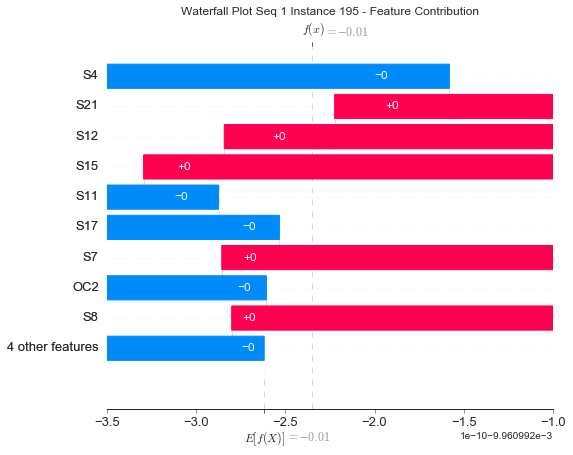

None

Contribution: [-1.08867060e-12  2.05623817e-11  2.47037876e-11 -3.89480288e-12
  1.17670762e-10 -3.09244609e-11 -2.29920041e-11  7.05062814e-11
 -6.28657335e-11 -9.40529252e-12 -8.59531196e-11  5.06763208e-11
 -5.95481026e-11]


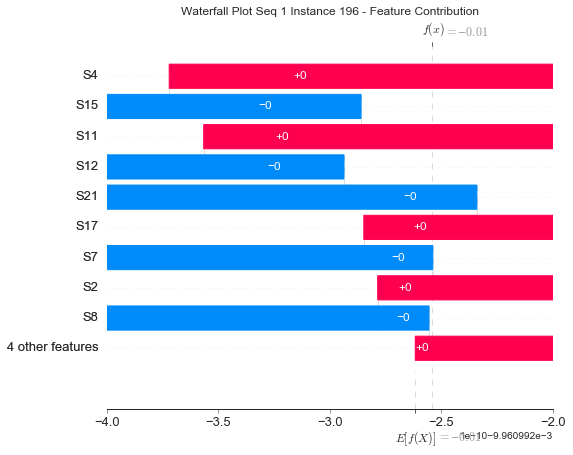

None

Contribution: [ 6.40084990e-12 -9.53960001e-12  2.22175819e-11 -1.81589518e-11
 -4.39750007e-11  1.34301468e-11  3.91549640e-11 -7.82126655e-11
  3.56062853e-11  1.85381328e-11  4.48868720e-11 -4.25007737e-11
  3.72815563e-11]


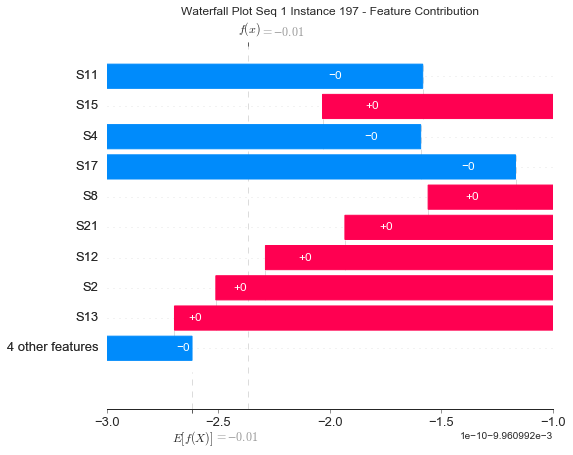

None

Contribution: [ 1.36284916e-11  2.57762193e-12  4.48598103e-11 -3.09509605e-11
 -4.19214316e-11  6.55158480e-12  5.88260274e-11 -1.16807244e-10
  3.04419094e-11  3.08462839e-11  5.05515109e-11 -6.12222079e-11
  2.81753613e-11]


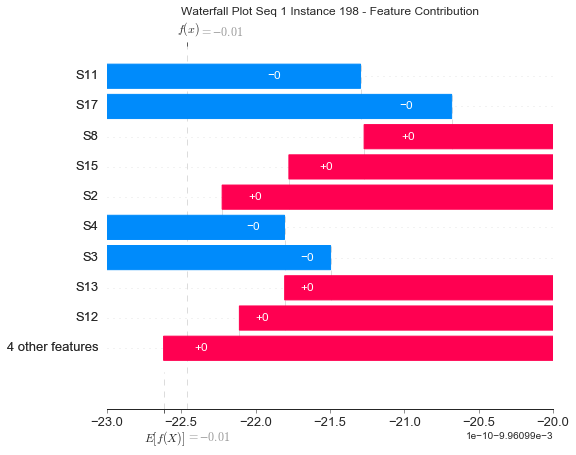

None

Contribution: [-6.14436410e-12 -5.40530641e-11  6.31152214e-11 -3.61944259e-11
 -6.35184336e-11  4.66858774e-11  8.07602735e-11 -1.75740741e-10
  1.05872644e-10  4.41706290e-11  4.23260177e-11 -1.02225624e-10
  9.86676296e-11]


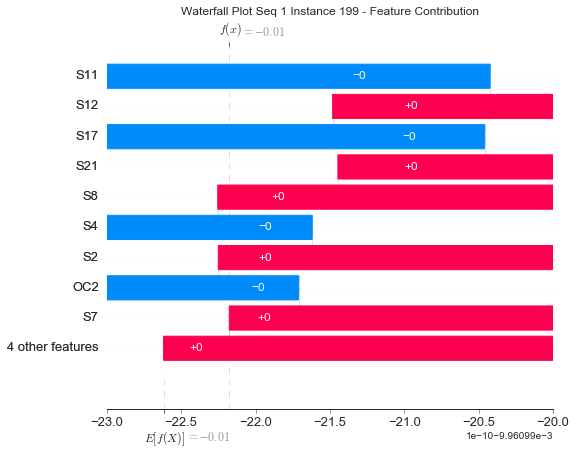

None

Contribution: [ 4.44530766e-11  2.83015122e-11 -2.47611705e-11  3.62477409e-11
  4.91558114e-11 -7.13950513e-12 -8.35897462e-11  1.56543126e-10
 -2.77706226e-11 -3.25006758e-11 -1.31341896e-10  7.84269524e-11
 -2.47343448e-11]


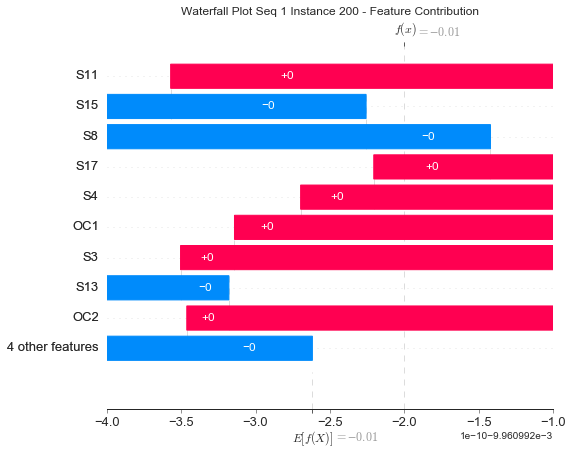

None

Contribution: [ 4.54339240e-11  2.95346456e-11 -2.40231619e-11  3.92611707e-11
  8.06993361e-11 -6.01836419e-12 -9.43563144e-11  2.07340825e-10
 -2.50148270e-11 -4.49605908e-11 -2.73529560e-10  1.02154167e-10
 -1.55770292e-11]


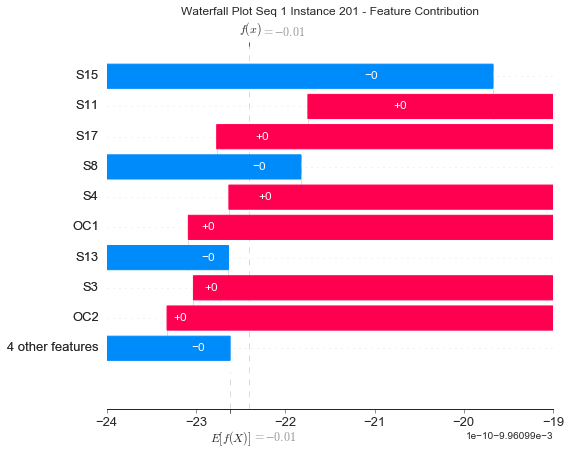

None

Contribution: [ 5.90711507e-11  1.74174286e-10 -5.78782161e-11  1.34786973e-11
  1.03044052e-10 -5.37420039e-11  2.57233505e-11  5.00512548e-11
 -1.36096454e-10  7.18325607e-11 -1.44265100e-10  8.41949496e-11
 -1.17103216e-10]


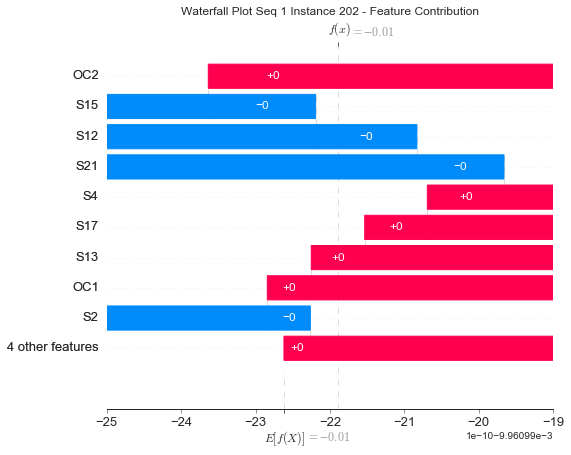

None

Contribution: [ 4.38199720e-11  1.59922284e-10 -6.52667226e-11  2.25310152e-11
  1.10314750e-10 -6.66994793e-11  2.06101369e-11  3.01945031e-11
 -1.79595977e-10  7.76380280e-11 -1.81928556e-10  1.08845363e-10
 -1.69174383e-10]


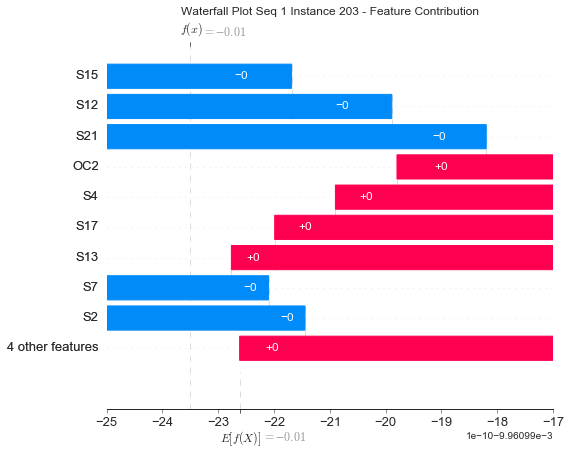

None

Contribution: [ 3.39239331e-11 -3.58252455e-11  5.47532852e-11 -7.70979808e-11
 -3.66661784e-10  7.77959155e-11  2.30311881e-10 -5.22975829e-10
  2.05130732e-10  1.61538394e-10  2.65122646e-10 -2.63721267e-10
  1.85810589e-10]


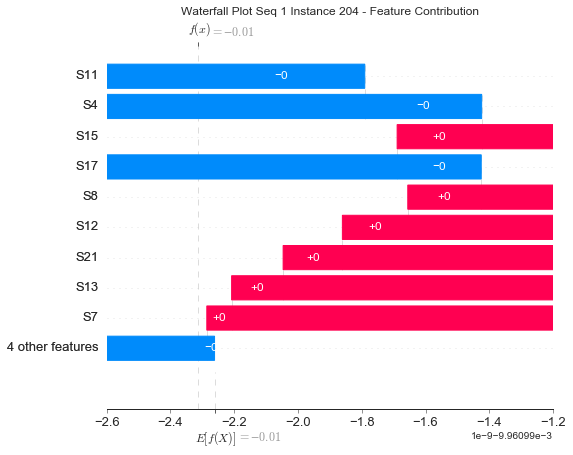

None

Contribution: [ 5.24495343e-11  1.93277935e-10  4.09715213e-11 -4.86100084e-11
 -1.98266653e-10  4.83671922e-11  2.10871168e-10 -3.59554830e-10
  9.53845614e-11  1.59536384e-10 -1.41532078e-10 -1.95613664e-10
  1.01580654e-10]


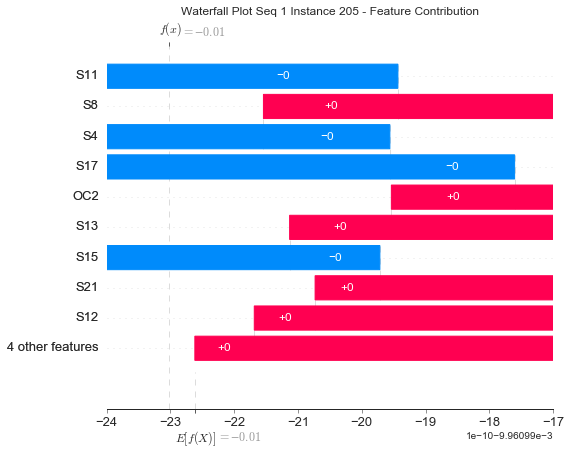

None

Contribution: [ 8.94584615e-11  1.33200159e-10 -2.94200567e-11 -2.61312777e-11
 -5.78136046e-11 -2.19262265e-11  1.33952585e-10 -2.57619509e-10
 -7.21910934e-11  1.71842790e-10 -9.44200551e-11 -4.98013158e-11
 -6.43645970e-11]


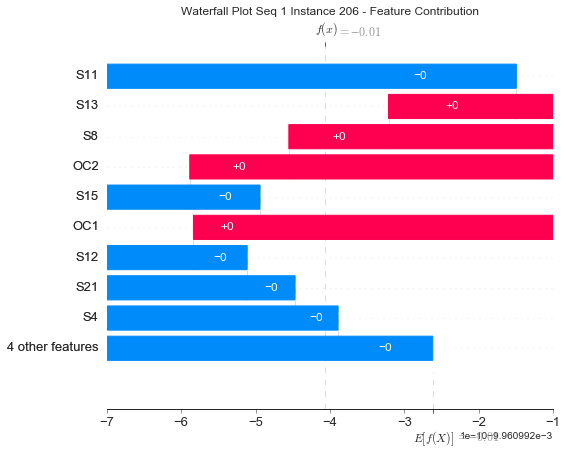

None

Contribution: [ 5.19247388e-11  2.86590252e-10  4.97651295e-11 -7.37372108e-11
 -1.78868323e-10  4.09450529e-11  2.60738264e-10 -4.09414280e-10
  7.93281621e-11  2.14092702e-10 -3.36805417e-10 -2.43236598e-10
  8.23080007e-11]


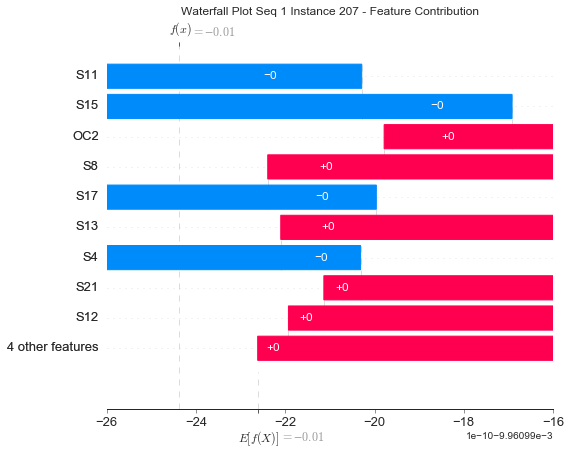

None

Contribution: [-4.57730902e-11 -3.40062034e-10  1.60051347e-10 -1.45478199e-10
 -9.48844892e-10  4.62300975e-10  4.78218076e-10 -1.17775534e-09
  9.40175160e-10  2.75347189e-10  3.29781036e-10 -7.11212145e-10
  8.83327245e-10]


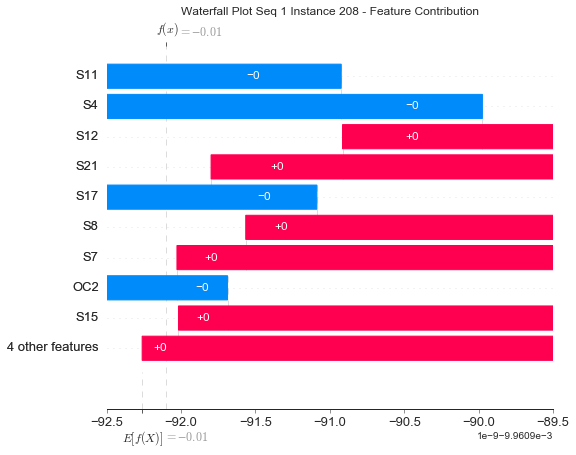

None

Contribution: [ 1.12680816e-10  1.57863986e-10 -6.23024479e-11  1.52284144e-10
  5.04135733e-10 -5.18272474e-11 -3.94215161e-10  8.67032224e-10
 -1.91316449e-10 -2.99181457e-10 -1.30553579e-09  4.33689501e-10
 -1.44272275e-10]


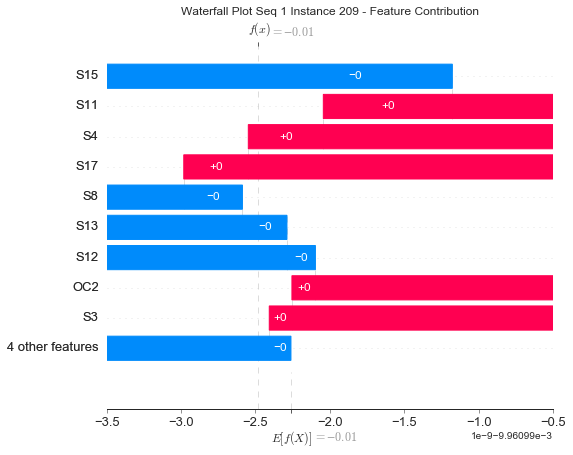

None

Contribution: [ 9.15486784e-12 -3.49967305e-10  2.40885534e-10 -2.20338914e-10
 -1.32459521e-09  5.28024346e-10  6.12340678e-10 -1.57264335e-09
  1.17645471e-09  3.53301860e-10  4.85541607e-10 -9.74128334e-10
  1.05276654e-09]


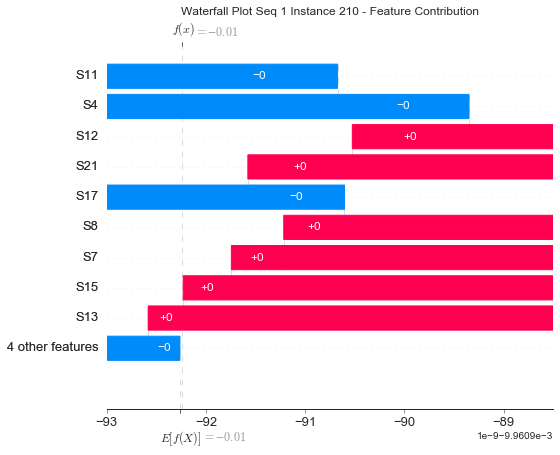

None

Contribution: [ 3.00912316e-11 -3.79876158e-10  2.87479651e-10 -2.87182306e-10
 -1.70360381e-09  5.81248438e-10  8.68269734e-10 -2.16493645e-09
  1.36869327e-09  5.71448666e-10  9.11375420e-10 -1.25314048e-09
  1.22625066e-09]


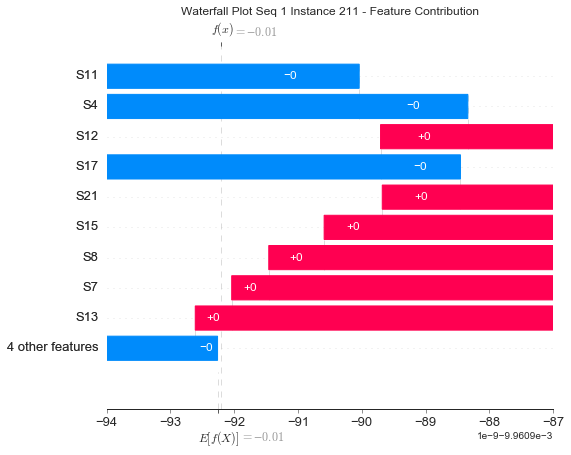

None

Contribution: [ 1.15055278e-10  3.37933320e-10  8.29475863e-11 -1.47062570e-10
 -7.58891616e-10  2.40714254e-10  6.49006626e-10 -1.16195287e-09
  4.89587371e-10  5.16979237e-10 -2.32144373e-10 -6.34407138e-10
  5.03344089e-10]


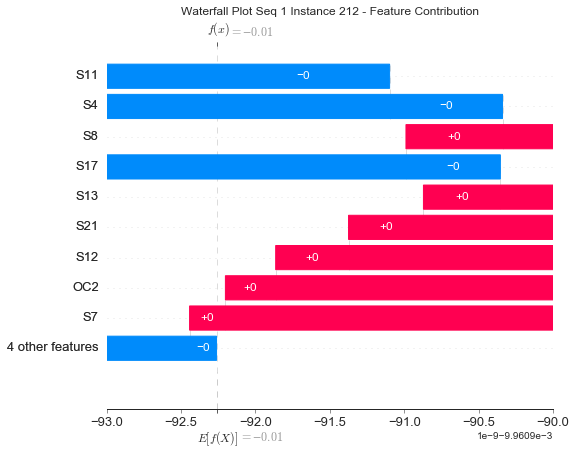

None

Contribution: [ 3.20249299e-10  4.62178712e-10 -4.32445642e-11 -6.02999664e-11
 -8.43407219e-11 -9.29571437e-12  3.63790054e-10 -4.88733831e-10
 -3.92108741e-11  5.11997555e-10 -3.69950626e-10 -8.61898955e-11
 -2.19046205e-11]


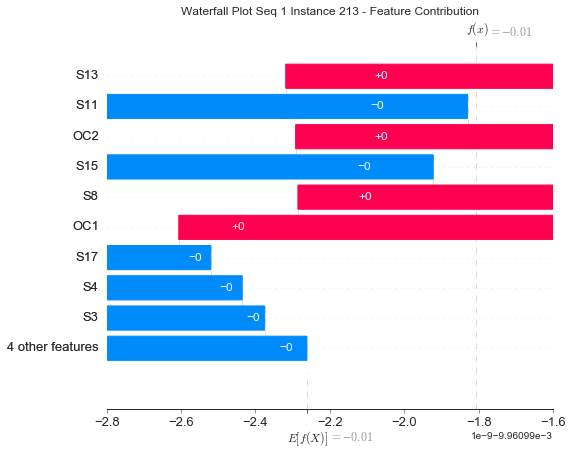

None

Contribution: [ 3.00118902e-10  4.27394287e-10 -8.88791679e-11 -2.89106863e-11
 -7.13480872e-11 -1.27072936e-10  3.13414211e-10 -5.37931588e-10
 -3.26846938e-10  5.06076181e-10 -5.41528877e-10 -7.67846276e-14
 -2.97870117e-10]


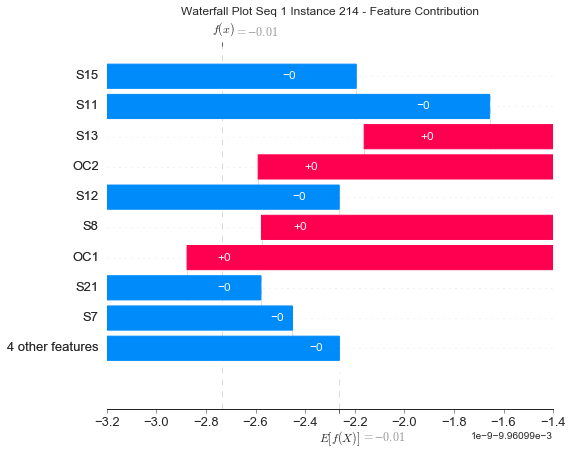

None

Contribution: [ 1.09991877e-11 -4.00937145e-10  3.22523758e-10 -3.73604175e-10
 -2.27266694e-09  8.49230797e-10  1.12193865e-09 -2.78065326e-09
  1.86674165e-09  7.72046316e-10  6.76388057e-10 -1.58458024e-09
  1.65533076e-09]


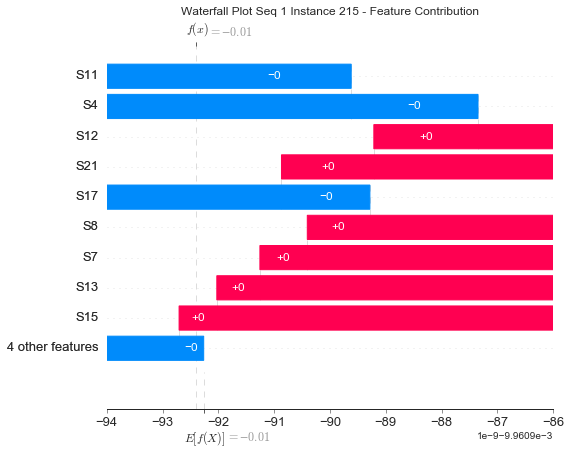

None

Contribution: [ 1.91321667e-10  5.80027359e-10  1.06115935e-10 -2.23899788e-10
 -1.15260368e-09  2.92980223e-10  9.78203851e-10 -1.74885928e-09
  6.06176942e-10  8.83965789e-10 -5.03122100e-10 -8.79896767e-10
  5.73672165e-10]


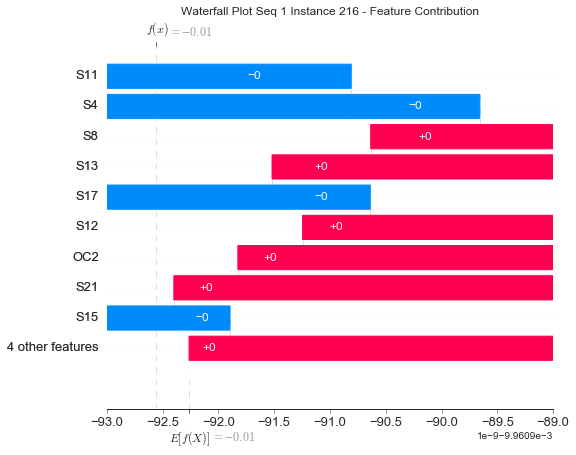

None

Contribution: [ 1.12781395e-10  2.46020843e-11  1.00293891e-10 -2.11740236e-10
 -1.64825020e-09  5.50285983e-10  1.04720166e-09 -2.16803020e-09
  1.10090992e-09  1.00227970e-09  2.73810748e-11 -1.06756604e-09
  1.05649667e-09]


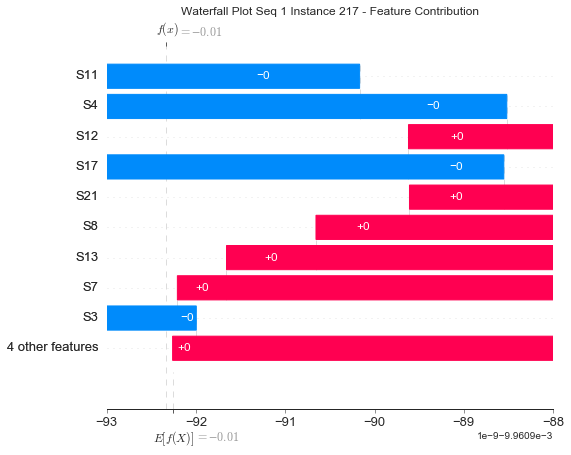

None

Contribution: [ 5.22250798e-10  7.00411673e-10 -9.20861096e-11 -1.58486571e-10
 -5.27347777e-10  5.11271372e-11  8.60185534e-10 -1.45884593e-09
  6.04235689e-11  1.15722820e-09 -4.72104023e-10 -4.23226093e-10
  8.63864674e-11]


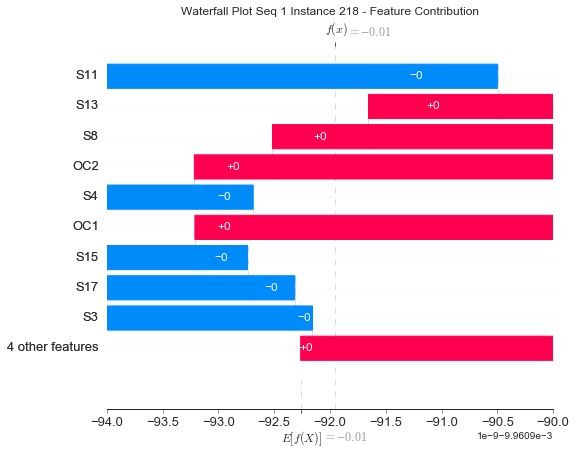

None

Contribution: [-6.68442177e-11 -4.13059364e-10  2.05975695e-10 -4.39056486e-10
 -3.29253158e-09  1.44150647e-09  1.86463889e-09 -4.13740242e-09
  2.78150991e-09  1.54182644e-09  7.77357567e-10 -2.22355268e-09
  2.49173948e-09]


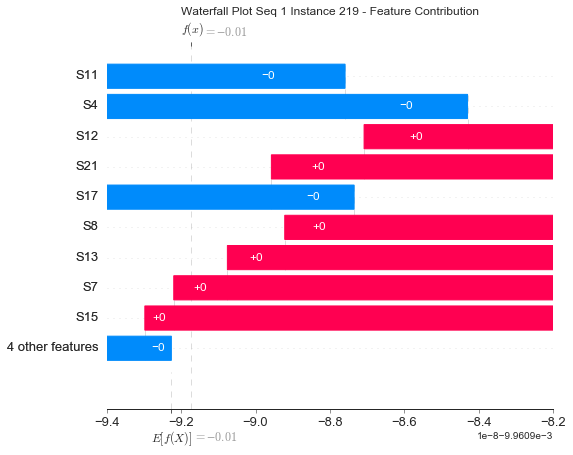

None

Contribution: [ 1.11077203e-09  9.59708757e-10 -9.09052278e-11 -1.69419812e-10
 -3.74841241e-10 -1.61256647e-10  9.67203651e-10 -1.77284976e-09
 -3.89590304e-10  1.45724866e-09 -9.22369181e-10 -3.04854003e-10
 -3.41073253e-10]


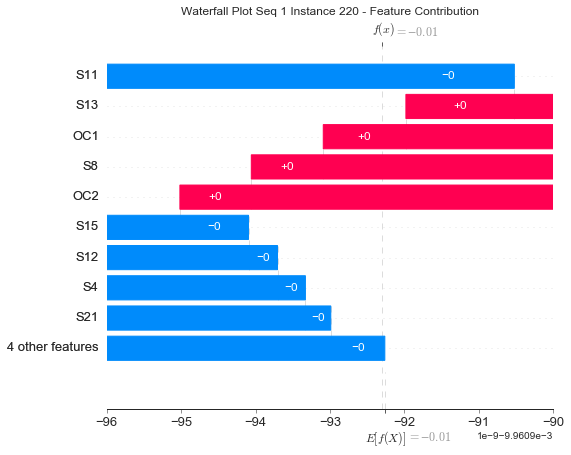

None

Contribution: [ 2.95182961e-10  2.14048362e-10  1.43143483e-11 -3.35875550e-10
 -2.80843460e-09  1.11384701e-09  1.91134264e-09 -3.99408284e-09
  2.00534678e-09  2.02743511e-09 -1.04458317e-10 -1.75581583e-09
  1.80682402e-09]


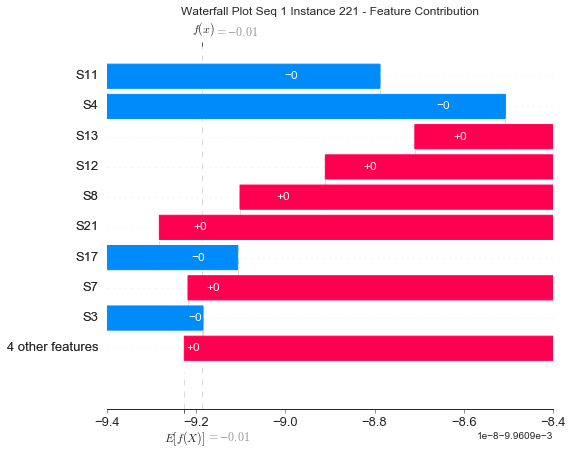

None

Contribution: [ 1.41626388e-09  1.00529973e-09  1.05838810e-11  6.83751805e-11
  4.09447753e-10 -9.07108937e-12 -4.79197404e-10  8.14969425e-10
 -1.03664223e-10 -4.60506744e-10 -2.71810907e-09  4.41455428e-10
  1.57383412e-11]


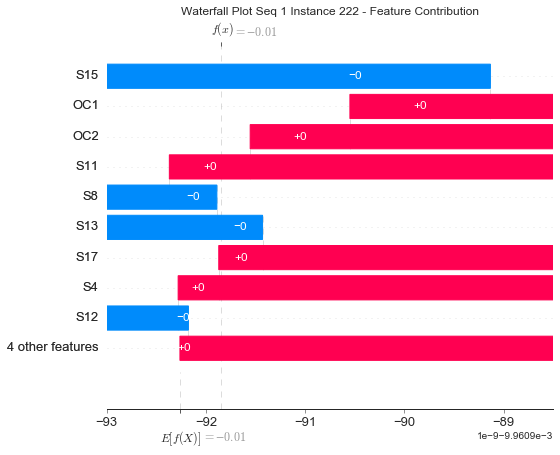

None

Contribution: [ 2.17745000e-09  1.48573054e-09 -1.36242573e-10 -3.32315647e-10
 -1.03714914e-09 -1.38830045e-10  1.57232138e-09 -3.12525095e-09
 -2.93746111e-10  2.21744489e-09 -1.16941257e-09 -6.94283575e-10
 -2.55754307e-10]


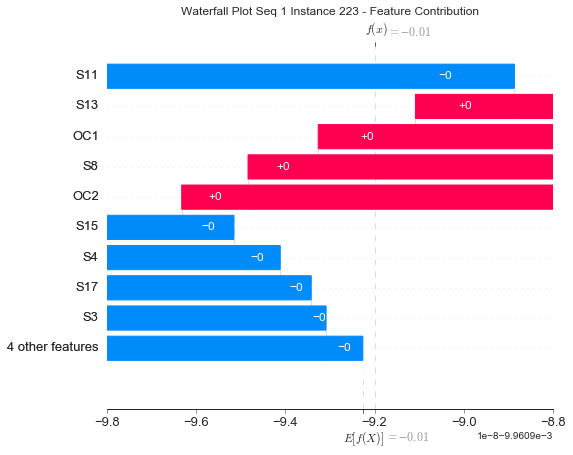

None

Contribution: [ 1.29932431e-09  1.05735753e-09 -7.57995750e-11  1.02362605e-10
  5.00485209e-10 -8.36028642e-12 -4.72430095e-10  7.67412744e-10
 -1.55988208e-10 -4.54184301e-10 -4.57154892e-09  4.46156195e-10
  1.04371668e-11]


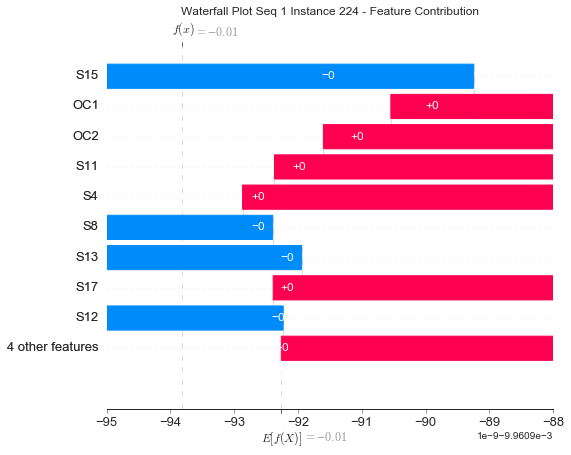

None

Contribution: [ 3.68601705e-10  6.36962372e-10  1.02331241e-10 -6.18785190e-10
 -4.57676252e-09  1.53075386e-09  2.97809910e-09 -6.57828991e-09
  2.86777113e-09  3.11043835e-09 -7.23632931e-10 -2.87887469e-09
  2.60888378e-09]


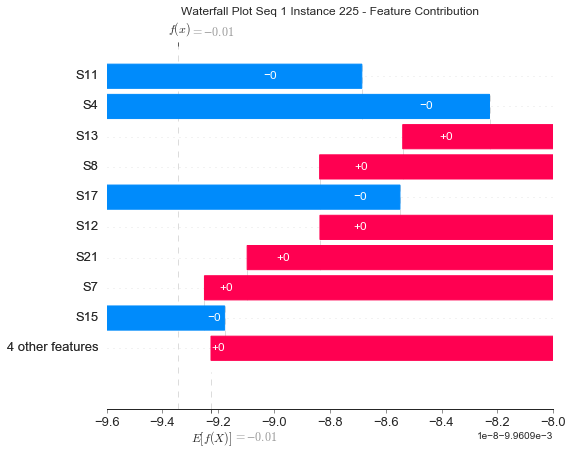

None

Contribution: [ 1.72547221e-09  1.96469063e-09 -6.49289164e-11 -4.70770145e-10
 -1.99562944e-09  2.83117613e-10  2.44080378e-09 -4.47294024e-09
  5.27217381e-10  3.13577386e-09 -2.24445351e-09 -1.23847654e-09
  5.10045284e-10]


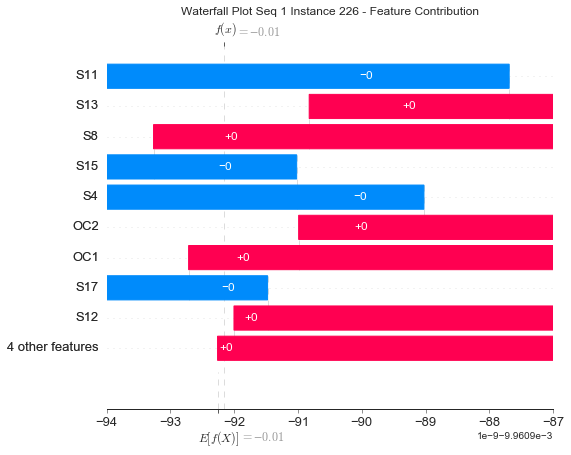

None

Contribution: [ 1.16627819e-09  2.36843034e-09  4.53061824e-11 -7.35141448e-10
 -5.02753394e-09  1.63108205e-09  4.14509538e-09 -7.67136932e-09
  3.01019343e-09  4.08339629e-09 -2.26783259e-09 -3.47009577e-09
  2.82794854e-09]


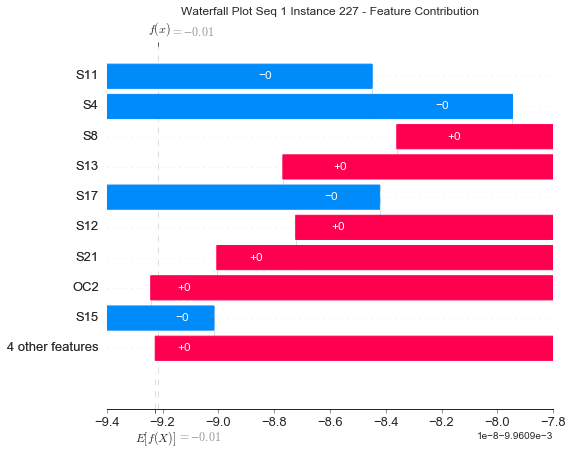

None

Contribution: [ 3.75599951e-09  2.67586087e-09 -2.14032514e-10 -6.36189434e-10
 -2.41428766e-09 -1.14190629e-10  3.05888559e-09 -5.78077497e-09
 -2.78206846e-10  4.07376266e-09 -2.33994069e-09 -1.50442603e-09
 -1.93529456e-10]


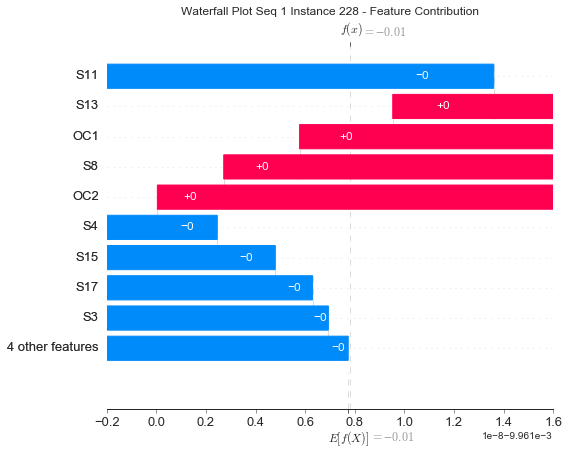

None

Contribution: [ 4.14416235e-09  2.84220869e-09 -1.96757680e-10 -7.41723183e-10
 -2.61884092e-09 -1.57175689e-10  3.34594286e-09 -6.57230759e-09
 -3.25191124e-10  4.44902826e-09 -2.51603915e-09 -1.73915016e-09
 -2.13497664e-10]


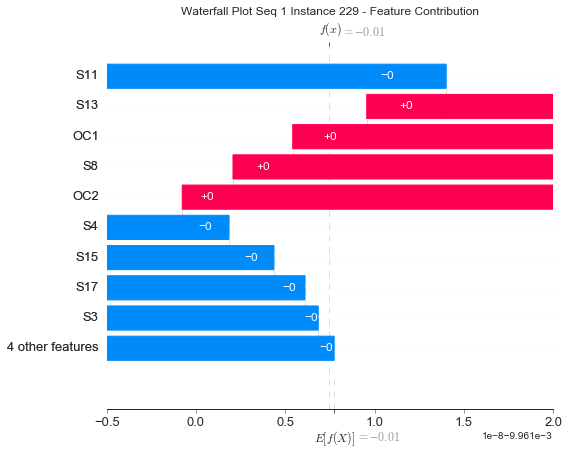

None

Contribution: [ 4.37454206e-09  2.83852875e-09 -1.41286788e-10 -9.43573442e-10
 -3.47728002e-09  1.24221522e-10  3.81103460e-09 -7.68071384e-09
  2.73469830e-10  4.86983343e-09 -2.87324986e-09 -2.25639285e-09
  3.78335308e-10]


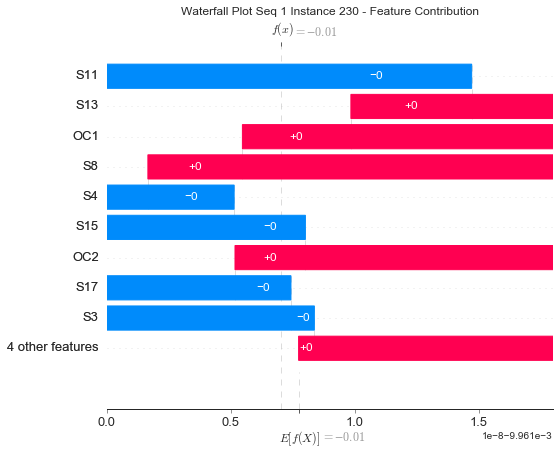

None

Contribution: [ 4.38143166e-09  3.13906812e-09 -2.33003616e-10 -1.00810849e-09
 -3.96069666e-09 -6.40236753e-11  4.15303036e-09 -8.69259686e-09
 -1.39194933e-10  5.51495649e-09 -3.26751048e-09 -2.33677122e-09
 -6.09337927e-11]


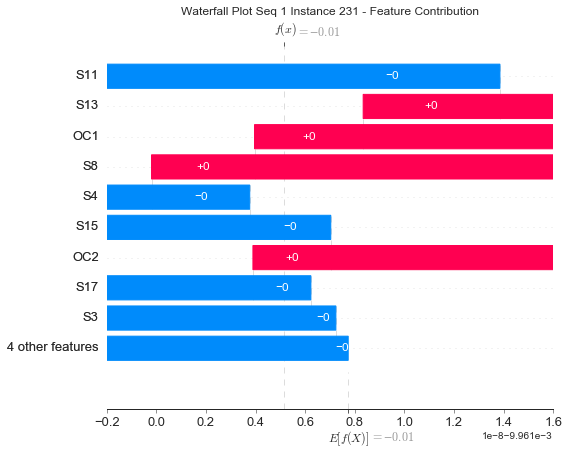

None

Contribution: [ 3.06907189e-09  3.30856142e-09 -8.66431510e-11 -1.21976107e-09
 -4.67872141e-09  6.77147616e-10  4.83612039e-09 -9.49514334e-09
  1.30851896e-09  6.24923802e-09 -4.49627269e-09 -3.15801763e-09
  1.30935141e-09]


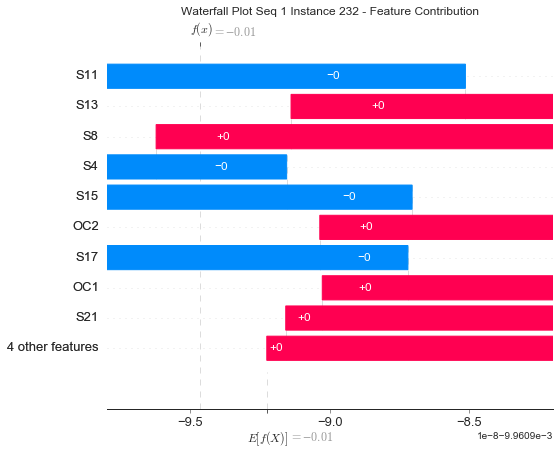

None

Contribution: [ 8.41110515e-10  1.74870218e-09  3.75716458e-10 -1.90616101e-09
 -1.16966650e-08  3.88872934e-09  7.72989939e-09 -1.71475971e-08
  7.26908400e-09  8.21357560e-09 -2.39210829e-09 -7.57815677e-09
  6.44046105e-09]


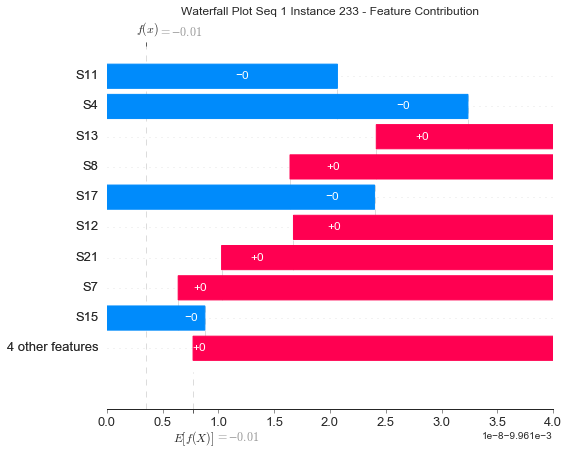

None

Contribution: [ 1.34163058e-09  2.14297424e-09  6.02933120e-11 -1.63447766e-09
 -1.24958435e-08  5.05903985e-09  9.38777411e-09 -1.86488638e-08
  8.56593818e-09  1.03629549e-08 -1.96775551e-09 -8.26621704e-09
  7.89107357e-09]


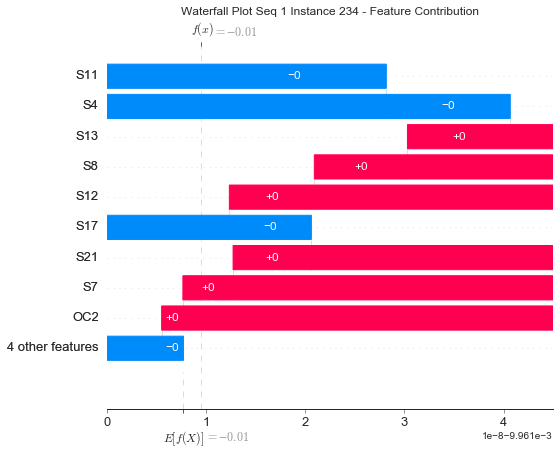

None

Contribution: [ 5.76985393e-09  4.03326750e-09  1.08727582e-10 -5.02774711e-10
 -2.41531661e-09  7.53089702e-10  4.03368117e-10 -2.48600318e-09
  1.36243317e-09  1.61070740e-10 -9.49546042e-09 -1.32479117e-09
  1.82008719e-09]


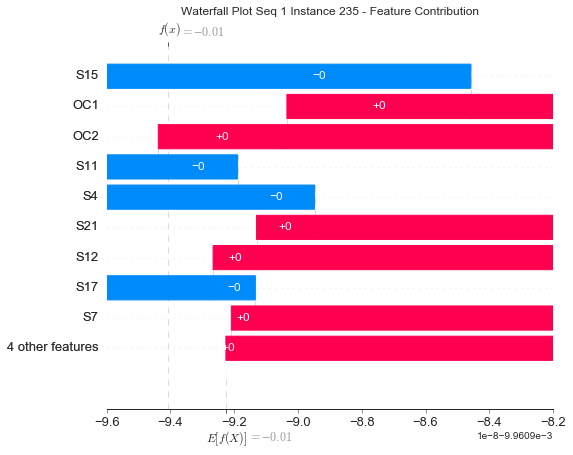

None

Contribution: [ 5.99443517e-09  4.81490714e-09 -2.35449771e-10 -1.81689819e-09
 -6.55057342e-09  7.96368180e-11  6.85923141e-09 -1.44601149e-08
  1.84688431e-10  9.25121313e-09 -6.61335653e-09 -4.22218083e-09
  2.90171637e-10]


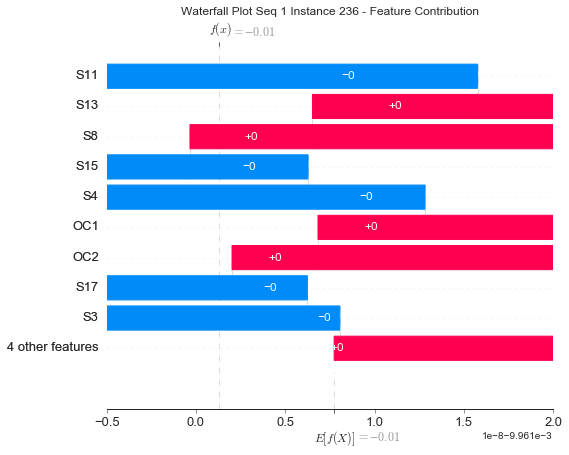

None

Contribution: [ 9.96811411e-10  2.49254217e-09  9.55561741e-10 -2.74208056e-09
 -1.78027957e-08  5.64258817e-09  1.13483614e-08 -2.58157495e-08
  1.07265068e-08  1.20830776e-08 -4.04637612e-09 -1.19455139e-08
  9.61382796e-09]


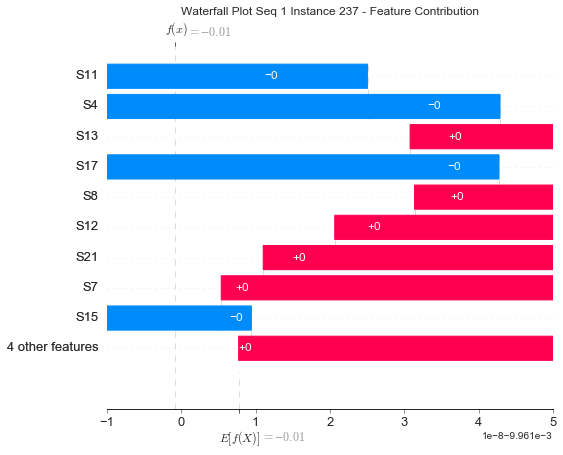

None

Contribution: [ 2.77349299e-09  7.05536074e-09  1.01430497e-09 -3.00173775e-09
 -1.63612448e-08  5.10097831e-09  1.33177576e-08 -2.57654094e-08
  9.63940128e-09  1.35654163e-08 -9.91490534e-09 -1.21284263e-08
  9.02361386e-09]


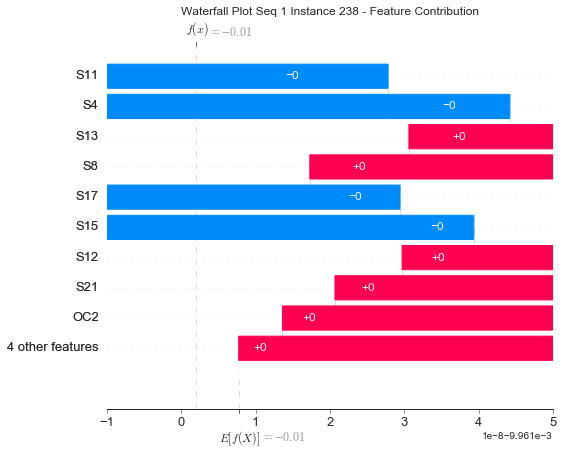

None

Contribution: [ 4.25530366e-09  8.72333494e-09  4.70193384e-10 -2.75508394e-09
 -1.72435008e-08  6.13552942e-09  1.51685793e-08 -2.77582544e-08
  1.08508162e-08  1.57482667e-08 -1.02058326e-08 -1.27529640e-08
  1.04384803e-08]


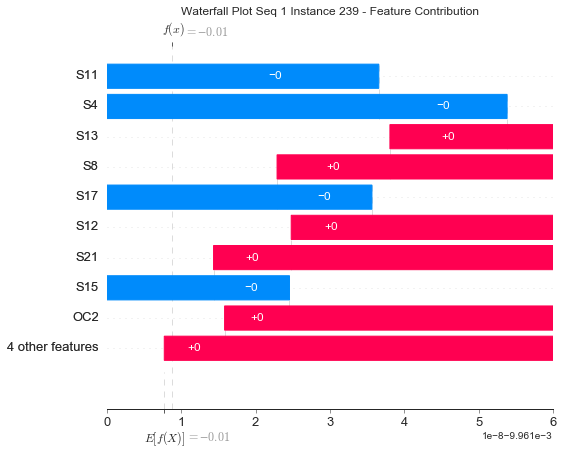

None

Contribution: [ 1.24604771e-08  8.91748009e-09 -5.50201329e-10 -2.51941290e-09
 -9.96219462e-09  1.76579487e-10  1.14453806e-08 -2.15703224e-08
  4.37901687e-10  1.54329403e-08 -9.52757162e-09 -6.27559782e-09
  6.67949751e-10]


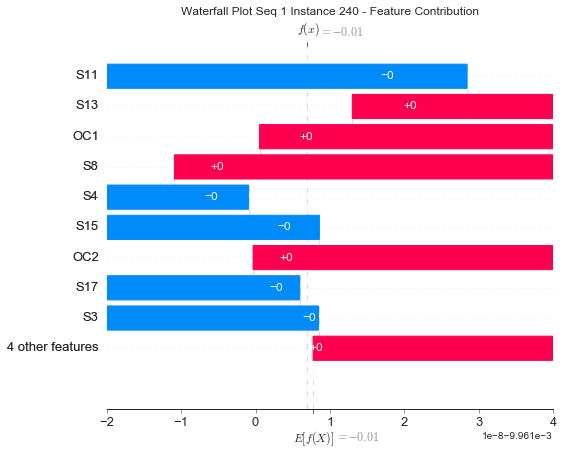

None

Contribution: [ 1.07243352e-08  9.76497727e-09 -3.88534677e-10 -2.62483990e-09
 -1.04122639e-08  2.15954143e-09  1.27223672e-08 -2.33575257e-08
  3.61885988e-09  1.71117946e-08 -1.01599342e-08 -7.52292983e-09
  4.00854727e-09]


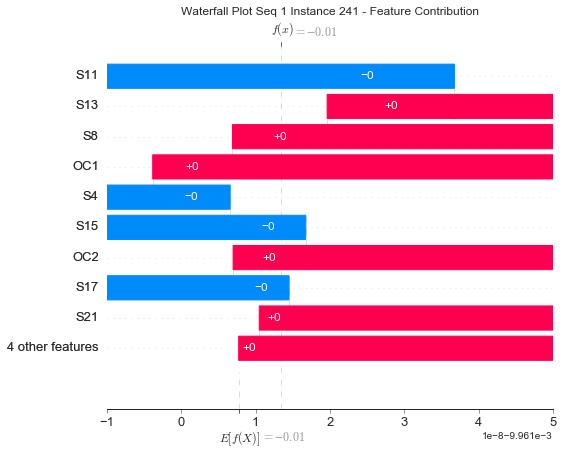

None

Contribution: [ 7.93486166e-09  5.95863536e-09  2.12515394e-10 -1.24824373e-09
 -5.09276443e-09  1.23076749e-09  9.09645803e-10 -5.06907005e-09
  2.61256750e-09  6.51024123e-10 -2.37931612e-08 -2.37382425e-09
  3.25574034e-09]


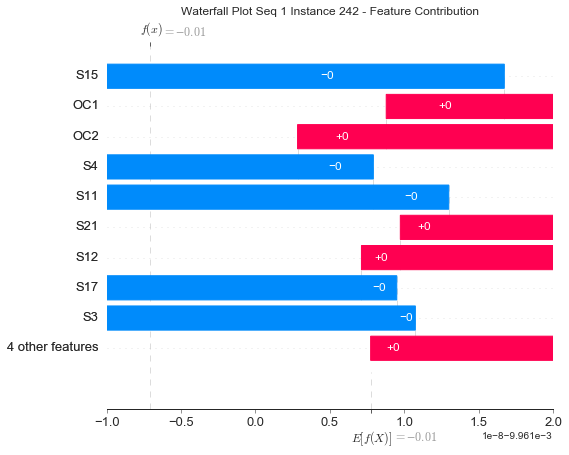

None

Contribution: [ 3.48081297e-09  1.00348112e-08  2.66594058e-09 -5.19145793e-09
 -2.67360782e-08  8.09182055e-09  2.10509548e-08 -4.13461194e-08
  1.58013549e-08  2.04376551e-08 -1.48041215e-08 -2.11256790e-08
  1.47324117e-08]


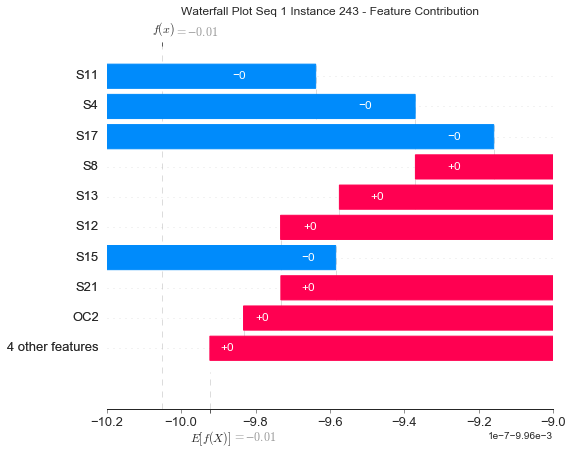

None

Contribution: [ 2.65536343e-10  1.26368838e-09  4.07988621e-09 -5.45749579e-09
 -4.23999111e-08  1.90424085e-08  2.69961404e-08 -5.72073482e-08
  3.41617259e-08  2.42862424e-08 -4.92559016e-09 -3.01666105e-08
  3.17796705e-08]


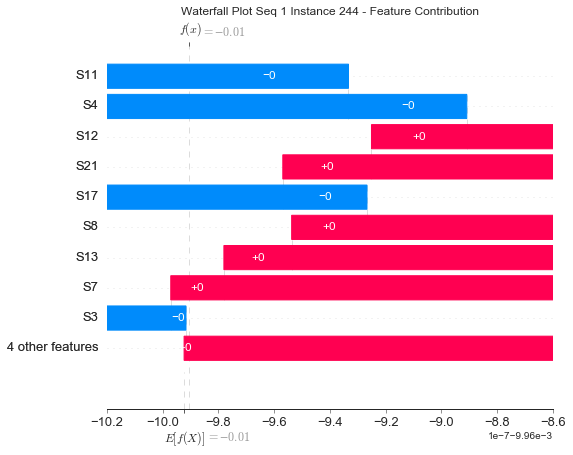

None

Contribution: [ 1.33106983e-08  1.30246951e-08 -3.54302421e-10 -3.67621311e-09
 -1.44795065e-08  6.60828336e-11  1.73246733e-08 -3.29923466e-08
  1.76301432e-10  2.33795898e-08 -1.55901212e-08 -1.04352562e-08
  5.85462845e-10]


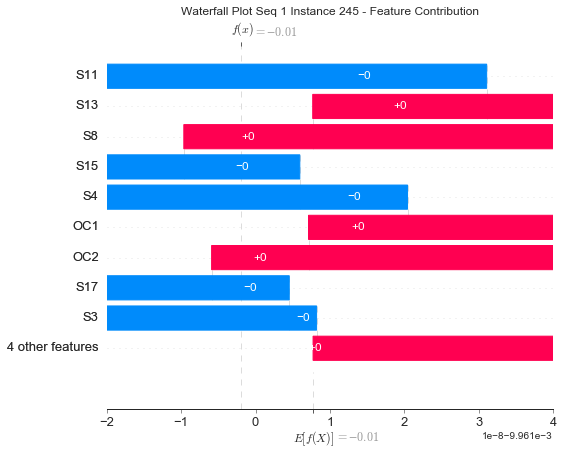

None

Contribution: [ 5.48509987e-11  9.28194410e-10  4.73776129e-09 -5.89973803e-09
 -5.03092537e-08  2.42143887e-08  3.28729932e-08 -6.88036152e-08
  4.19250306e-08  3.05793613e-08 -3.61551900e-09 -3.61094301e-08
  3.87882686e-08]


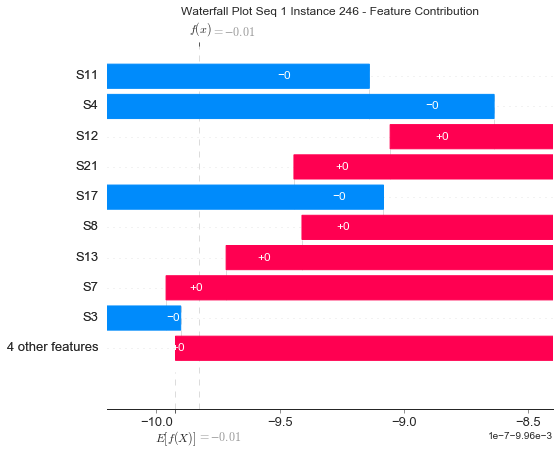

None

Contribution: [ 1.16719088e-08  1.10965752e-08  1.07024237e-10 -1.50935087e-09
 -8.21926971e-09  1.68197001e-09  1.65500025e-09 -8.89443541e-09
  3.27723026e-09  1.38907441e-09 -3.67617936e-08 -3.72708042e-09
  4.74055373e-09]


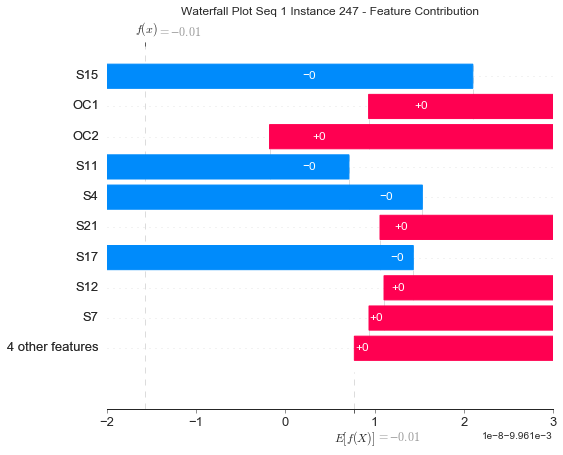

None

Contribution: [-1.60485833e-10  4.86547747e-10  8.66783090e-09 -8.38129299e-09
 -6.40317950e-08  2.52360728e-08  3.75065383e-08 -8.32666203e-08
  4.88017164e-08  3.36718813e-08 -3.47604812e-09 -4.42983854e-08
  4.37975274e-08]


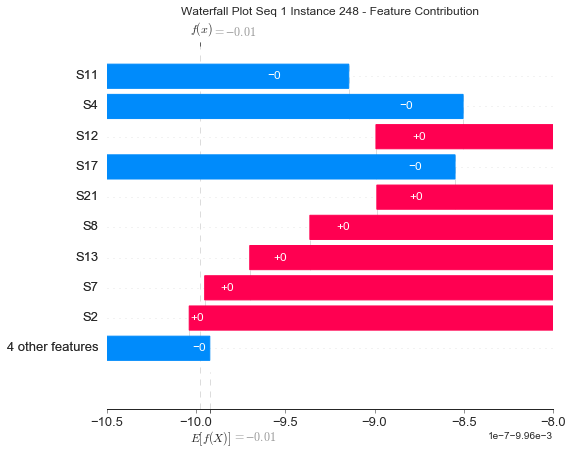

None

Contribution: [ 2.43526976e-10  1.33021161e-09  8.95814356e-09 -6.72440370e-09
 -6.49787637e-08  2.88508613e-08  4.12242898e-08 -8.75511574e-08
  5.26251611e-08  3.75335993e-08 -5.83796744e-09 -4.51051783e-08
  4.93728614e-08]


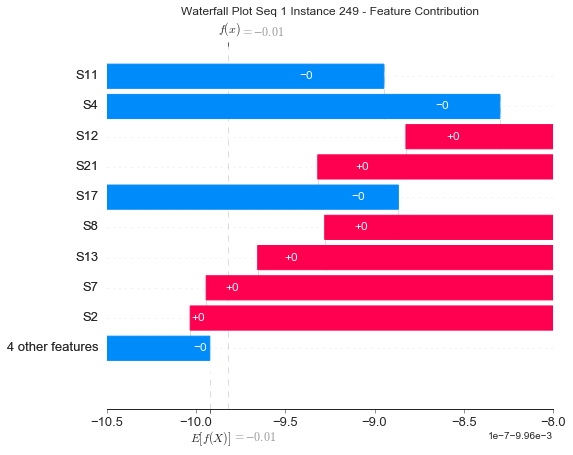

None

Contribution: [ 1.26742190e-08  2.09026574e-08  6.30191066e-10 -4.11165635e-09
 -2.09583408e-08  3.61162056e-09  2.68331384e-08 -4.74334492e-08
  6.71755851e-09  3.60636783e-08 -2.67662070e-08 -1.60771343e-08
  7.43850270e-09]


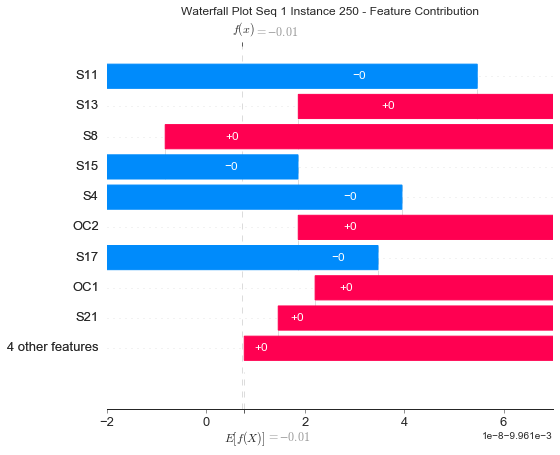

None

Contribution: [-1.66996930e-10  1.52098312e-09  1.08616698e-08 -8.56200977e-09
 -7.83428931e-08  3.16968318e-08  4.61119285e-08 -1.01119781e-07
  6.00056893e-08  4.29343743e-08 -7.73917197e-09 -5.28715596e-08
  5.44150538e-08]


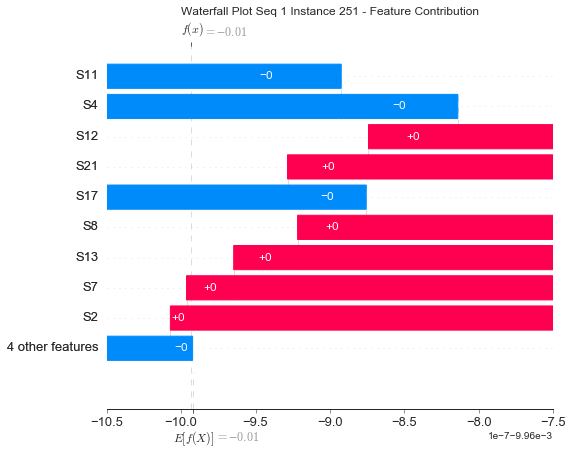

None

Contribution: [ 8.27641955e-09  2.49848888e-08  6.03578076e-09 -6.14868600e-09
 -5.15358742e-08  1.79051973e-08  4.51225652e-08 -7.95965533e-08
  3.18330002e-08  4.64230077e-08 -2.80563643e-08 -3.94579800e-08
  3.24005001e-08]


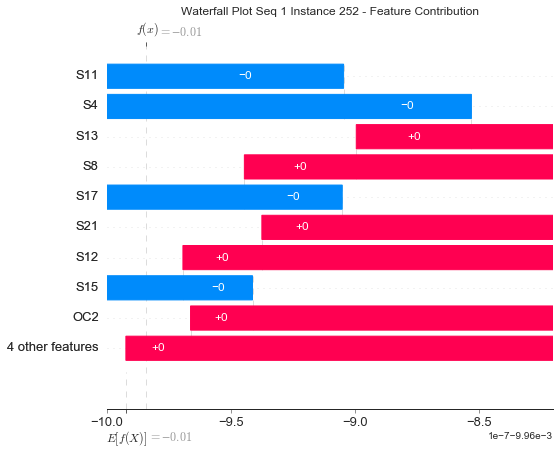

None

Contribution: [ 1.83947968e-08  2.56208903e-08  5.30037181e-10 -4.79345896e-09
 -2.71649778e-08  5.70244962e-09  3.33499486e-08 -5.62495472e-08
  9.80173276e-09  4.48261055e-08 -2.53927741e-08 -2.04518269e-08
  1.11025749e-08]


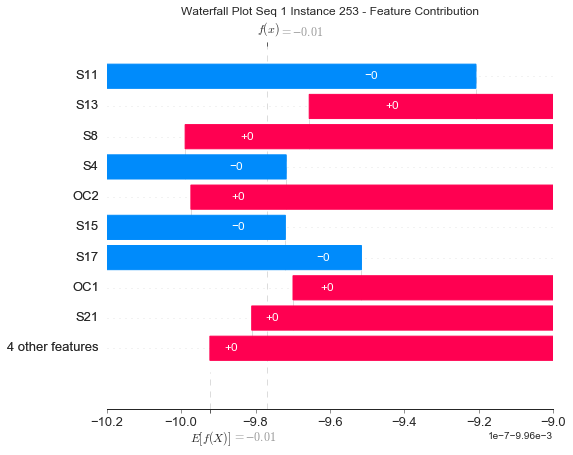

None

Contribution: [ 1.38575587e-08  2.18695941e-08  1.60170863e-10 -5.11334486e-09
 -2.84005868e-08  2.53764121e-10  2.85294934e-08 -5.43659198e-08
  6.41496800e-10  4.06174756e-08 -2.96766682e-08 -1.96218934e-08
  1.45659251e-09]


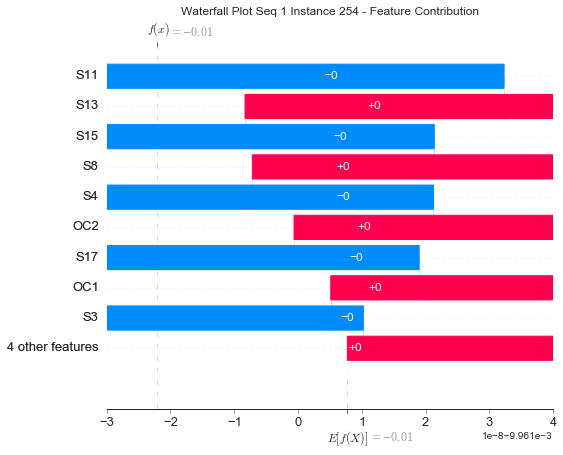

None

Contribution: [ 5.74911097e-09  2.50436667e-08  6.09556006e-09 -6.86767621e-09
 -5.05296853e-08  2.00305355e-08  4.36256222e-08 -7.72239588e-08
  3.19476570e-08  4.80459939e-08 -2.87430524e-08 -4.80662123e-08
  3.40819142e-08]


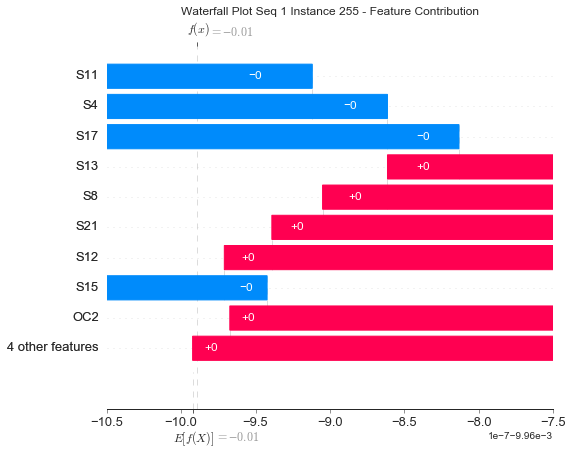

None

Contribution: [ 5.49808510e-09  1.51649733e-08 -1.54689928e-10 -1.04084541e-09
 -6.43350218e-09  2.13333173e-09  1.18504573e-09 -8.25396640e-09
  2.70272604e-09  1.48255552e-09 -4.83693405e-08 -5.42118084e-09
  5.35933253e-09]


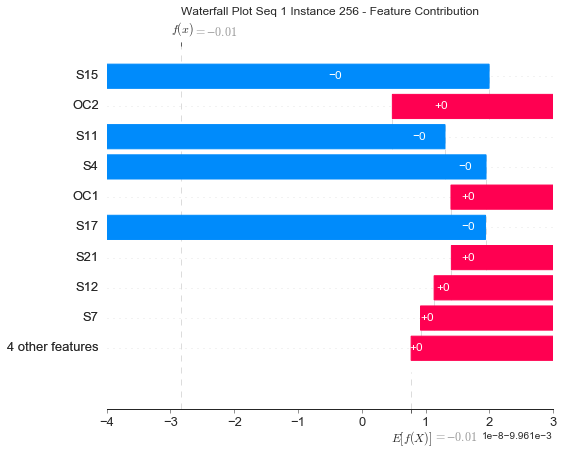

None

Contribution: [-1.07484741e-08  1.74165731e-08  1.98457761e-09 -1.01141551e-09
 -1.87343545e-08  6.65893007e-10  1.69587047e-08 -2.58386503e-08
  1.42322776e-09  2.72453224e-08 -2.41331151e-08 -2.12554117e-08
  1.78580295e-09]


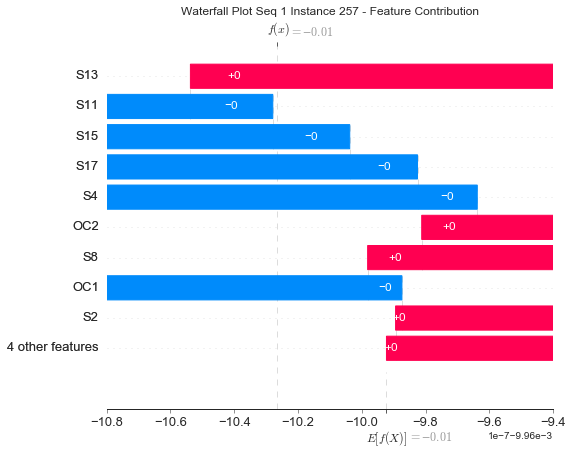

None

Contribution: [-8.44432435e-09  2.45639753e-09  1.23445041e-08  6.95668056e-09
 -2.51076688e-08  9.60969526e-09  4.62175676e-09 -1.34242939e-09
  1.06230491e-08  1.41057006e-08 -1.06322426e-08 -5.30276587e-08
  1.99645314e-08]


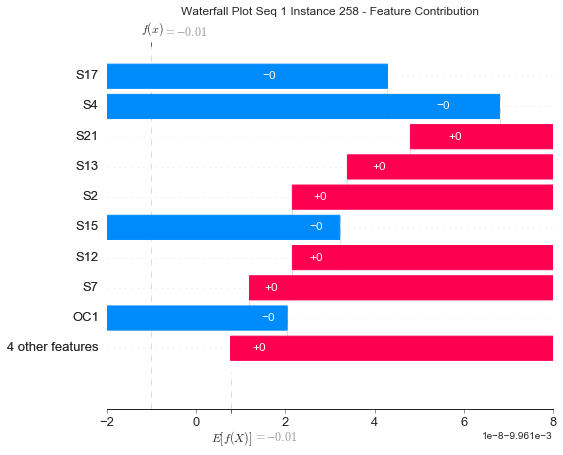

None

Contribution: [ 6.57607746e-10  3.05103276e-10 -4.11987285e-11 -2.25009608e-10
 -1.24350785e-09  1.95528649e-10  5.83856796e-10 -1.71149650e-09
  3.72757714e-10  8.53349724e-10 -9.91700722e-10 -6.00731742e-10
  3.42557149e-10]


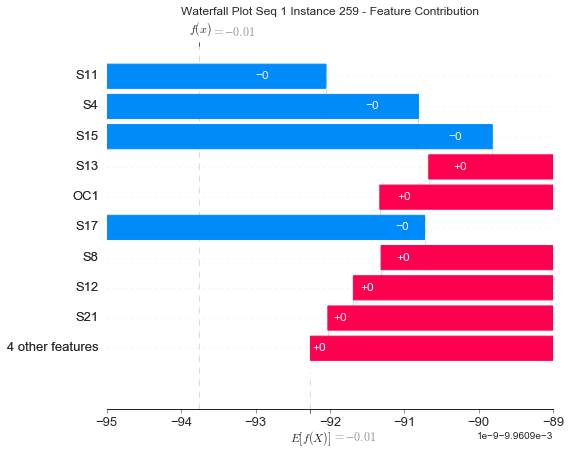

None

Contribution: [ 2.02732151e-10  2.14771645e-10 -5.08953556e-12 -5.16223397e-10
 -2.99942648e-09  1.06383458e-09  1.68715575e-09 -4.27412683e-09
  1.85543481e-09  2.01417438e-09 -1.55809740e-10 -1.93390615e-09
  1.50439150e-09]


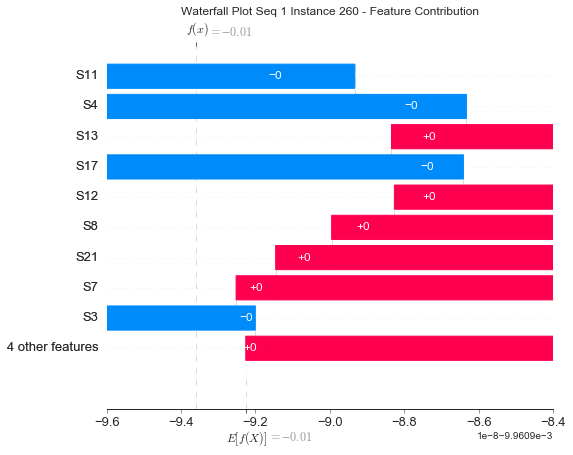

None

Contribution: [ 7.38532957e-10  8.03782818e-10 -2.87347889e-11 -2.03779854e-10
 -7.66873010e-10  2.45182014e-10  6.61180444e-10 -1.39287337e-09
  3.81203569e-10  7.25420723e-10 -1.96176209e-09 -5.95856087e-10
  3.95145611e-10]


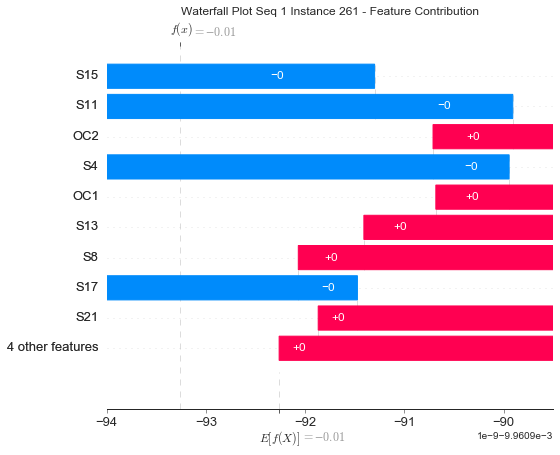

None

Contribution: [ 7.58690555e-10  6.11532214e-10 -4.63248190e-11 -2.04350800e-10
 -1.12100251e-09  1.10052779e-10  6.59145516e-10 -1.65037406e-09
  2.20789290e-10  8.70907180e-10 -1.53681834e-09 -5.63701807e-10
  2.62732558e-10]


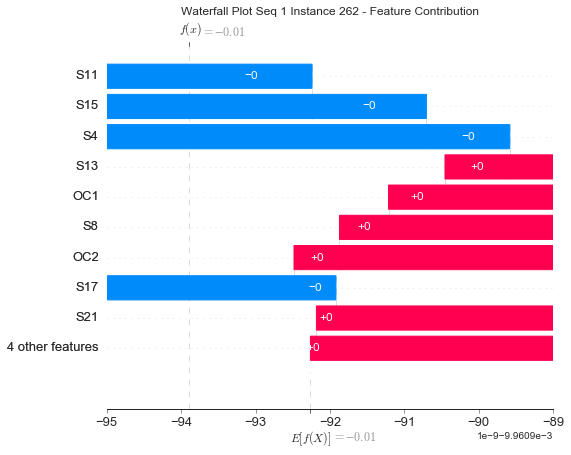

None

Contribution: [-1.46750931e-10 -3.80512635e-11  9.93332638e-11 -5.49852275e-10
 -4.13581791e-09  1.81189697e-09  2.09161910e-09 -5.06453723e-09
  3.09166803e-09  2.05792894e-09 -2.45129944e-10 -2.55902211e-09
  2.65537281e-09]


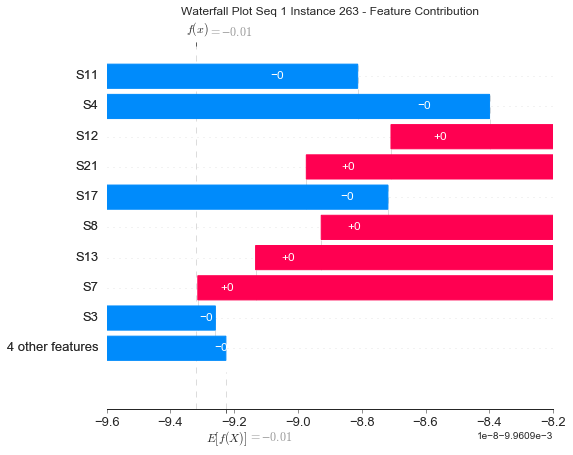

None

Contribution: [ 1.00690700e-09  1.02776476e-09 -3.63326660e-11 -3.30400401e-10
 -1.80183601e-09  3.41620648e-10  1.64066349e-09 -3.28596594e-09
  5.91825089e-10  2.11729212e-09 -1.23564003e-09 -1.18035470e-09
  5.88023741e-10]


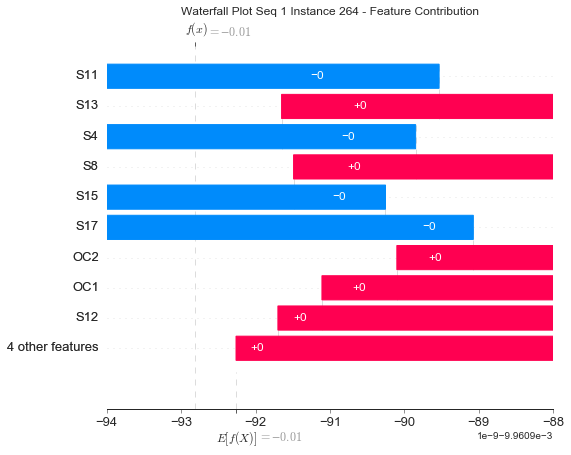

None

Contribution: [ 8.81845430e-10  1.02522102e-09 -6.47043460e-11 -4.93031616e-10
 -3.02293612e-09  7.49601936e-10  2.28363017e-09 -4.67941508e-09
  1.30804056e-09  2.84145507e-09 -8.26216318e-10 -1.78077486e-09
  1.13996435e-09]


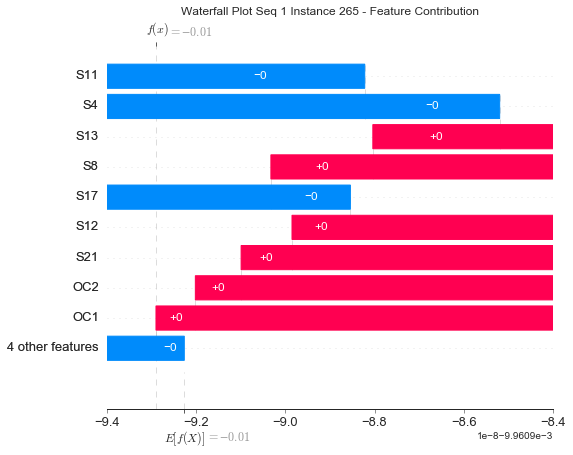

None

Contribution: [ 8.46293757e-10  6.89489965e-10 -1.57173052e-10 -5.91105942e-10
 -3.42627704e-09  1.25324728e-09  2.67075828e-09 -5.82202730e-09
  2.07088724e-09  3.44107187e-09 -4.01833677e-10 -2.00470129e-09
  1.64750935e-09]


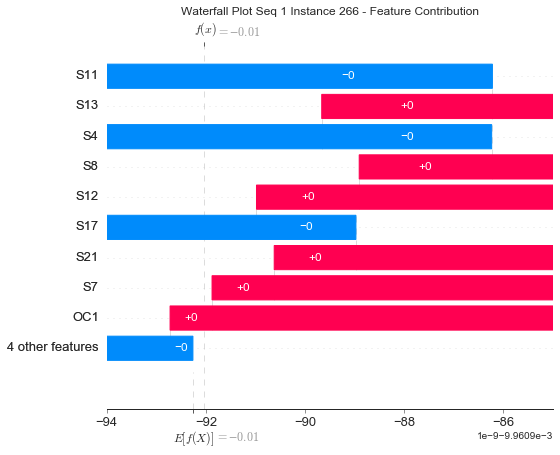

None

Contribution: [ 1.93199945e-09  1.61263314e-09 -1.66709202e-10 -4.80882001e-10
 -2.19764518e-09  6.56749710e-10  2.32485076e-09 -4.39057146e-09
  9.99097804e-10  3.18974913e-09 -1.42890522e-09 -1.40998502e-09
  9.69111680e-10]


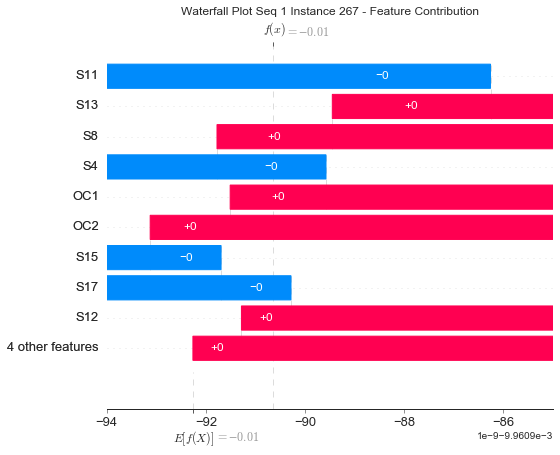

None

Contribution: [ 2.26417840e-09  1.37062994e-09  7.97248934e-11 -2.07452541e-10
 -9.85360238e-10  3.85782933e-10  2.69130940e-10 -1.23902433e-09
  5.96807326e-10  2.50052618e-10 -2.02474815e-09 -5.85384741e-10
  6.78200107e-10]


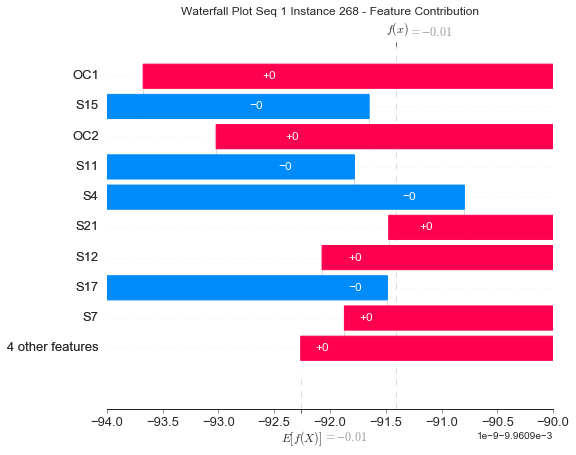

None

Contribution: [ 3.34086758e-09  2.05005035e-09 -9.81326409e-11 -8.88919993e-10
 -3.63394470e-09  7.94924904e-10  3.21936167e-09 -7.00365277e-09
  1.35735445e-09  4.10012158e-09 -1.38866929e-09 -2.45878518e-09
  1.29095423e-09]


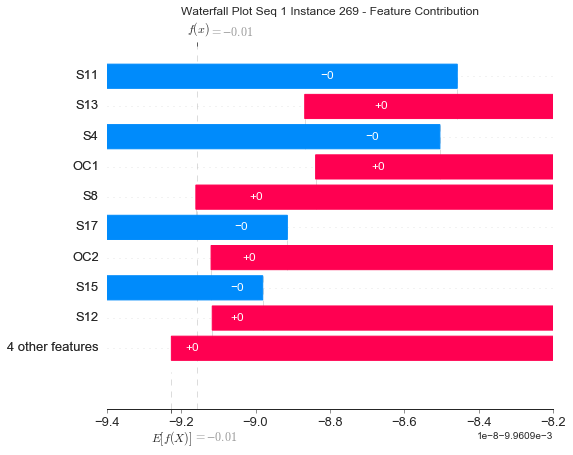

None

Contribution: [ 3.77058162e-09  2.30830532e-09  2.70338214e-11 -3.27233685e-10
 -9.41576928e-10  8.97513053e-12  7.59143359e-10 -1.72085890e-09
 -8.99400138e-11  1.30685640e-09 -3.03389580e-09 -5.71192760e-10
  1.62073396e-10]


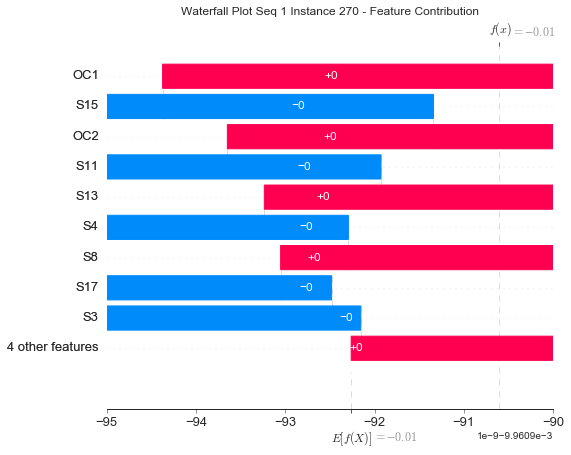

None

Contribution: [ 2.87216428e-09  1.79966630e-09  2.13102296e-11 -5.33012690e-10
 -1.34163380e-09 -2.08811302e-11  1.92255278e-09 -4.13363344e-09
 -1.66413994e-10  2.98293101e-09 -1.44696077e-09 -1.11839304e-09
  8.71221064e-12]


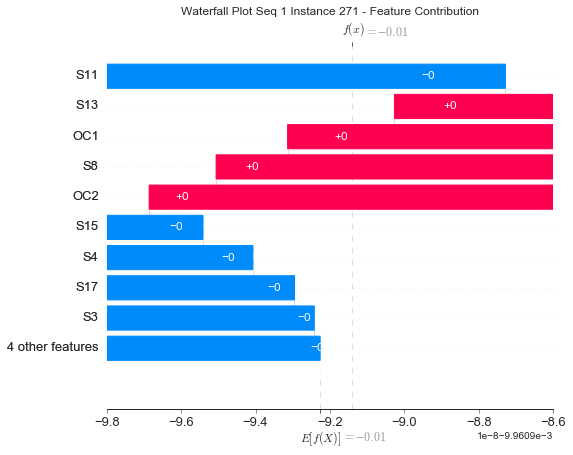

None

Contribution: [ 1.85857407e-09  1.51751722e-09  3.06797698e-10 -1.50640056e-10
 -1.60046765e-09  8.46428705e-10  6.12117801e-10 -1.47330126e-09
  1.24791644e-09  5.26909683e-10 -2.51691445e-09 -1.64027547e-09
  1.43863199e-09]


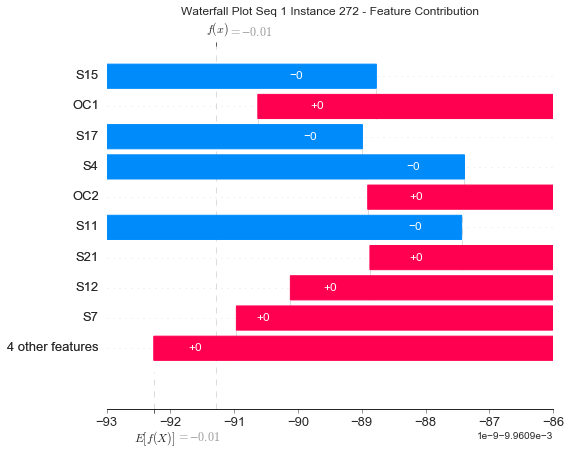

None

Contribution: [ 2.30032482e-09  1.77354864e-09 -8.01773231e-12 -1.59502717e-10
 -8.69286421e-10  1.62755642e-10  4.76442552e-10 -1.33493938e-09
  2.41521775e-10  6.66675604e-10 -2.86191071e-09 -5.79683357e-10
  3.50411755e-10]


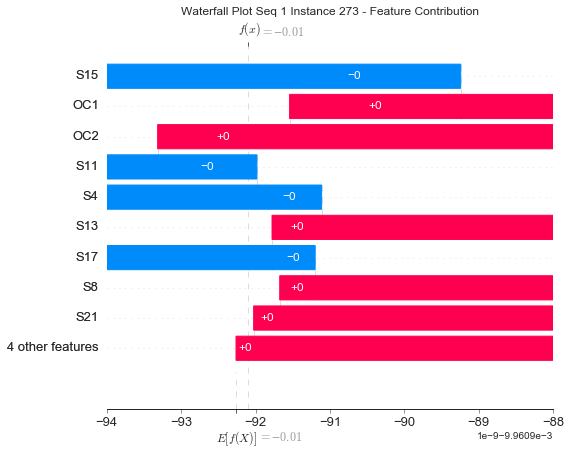

None

Contribution: [ 4.05369072e-09  2.26501284e-09  3.25165006e-10 -2.02719286e-10
  1.39196085e-10 -8.98633112e-10  4.94703112e-10 -1.29114053e-09
 -1.68906567e-09  1.30233824e-09 -3.60822483e-09 -3.25260818e-10
 -1.06024645e-09]


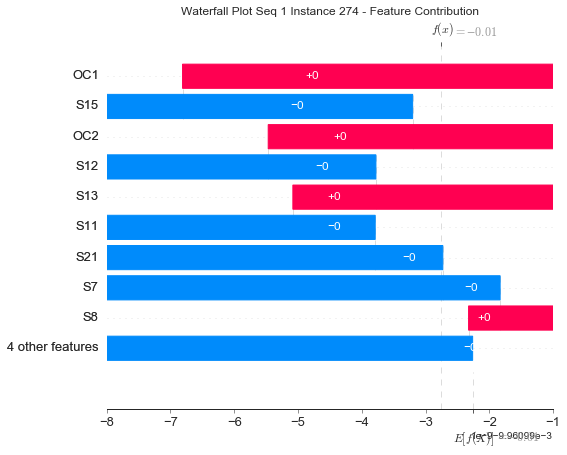

None

Contribution: [ 1.42084478e-09  1.18715648e-09  6.76176060e-10  1.40265008e-10
 -1.19246080e-09  2.34476299e-10 -7.52673202e-10  3.16763338e-10
  7.47425122e-10 -1.00722508e-09 -4.77737538e-09 -1.92478389e-09
  1.18598509e-09]


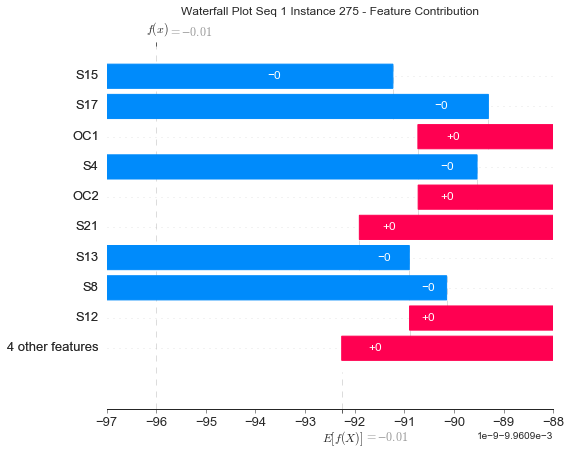

None

Contribution: [ 2.28982877e-09  2.30768094e-09  3.19728653e-11 -6.42037812e-10
 -2.53912069e-09 -6.17693917e-12  1.96181804e-09 -5.10509590e-09
 -1.84564031e-11  2.59088262e-09 -5.66335245e-09 -2.02641881e-09
  1.83606422e-10]


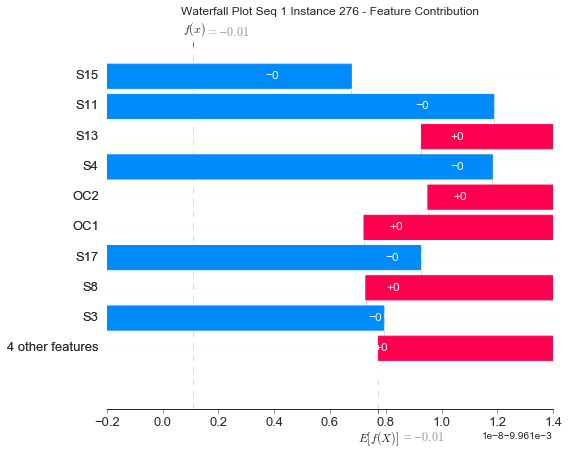

None

Contribution: [-1.41025502e-09  2.32952740e-10  8.54323112e-10 -1.51008217e-09
 -1.21657990e-08  4.46278881e-09  6.45979581e-09 -1.52526329e-08
  8.38814351e-09  6.06462081e-09 -1.28447109e-09 -8.27853786e-09
  7.36398365e-09]


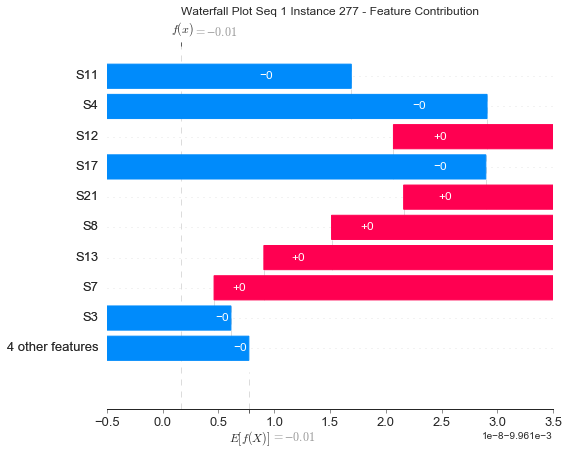

None

Contribution: [ 1.25439936e-09  2.09841544e-09  1.01036179e-09 -6.29572783e-10
 -7.41465556e-09  1.70519088e-09  4.81666973e-09 -1.02755164e-08
  3.69520170e-09  5.53946622e-09 -2.98181879e-09 -6.12801365e-09
  3.74875686e-09]


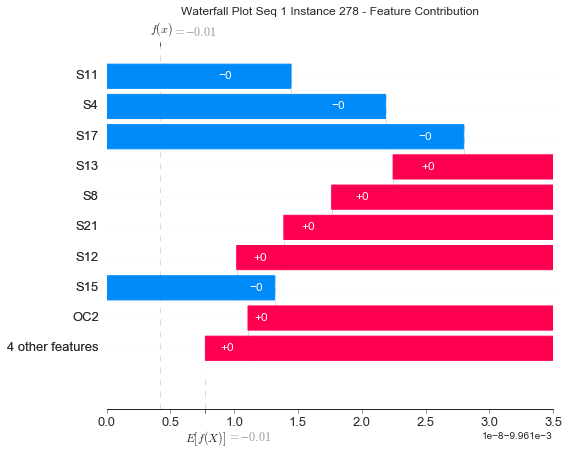

None

Contribution: [ 2.03147366e-09  2.31465247e-09  1.80648607e-10 -1.27082445e-09
 -1.09475895e-08  3.92148447e-09  7.07061920e-09 -1.55929332e-08
  6.92727831e-09  7.79423015e-09 -5.13995779e-09 -6.55680843e-09
  6.45646336e-09]


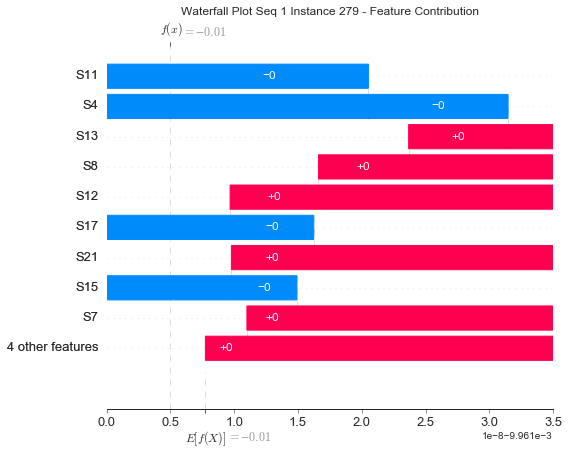

None

Contribution: [ 6.14170137e-09  4.13659906e-09 -1.38631481e-10 -1.83847071e-09
 -1.03200701e-08  2.28467134e-09  8.32098124e-09 -1.77474551e-08
  4.16119539e-09  1.02830349e-08 -4.13483425e-09 -6.47018794e-09
  3.68968101e-09]


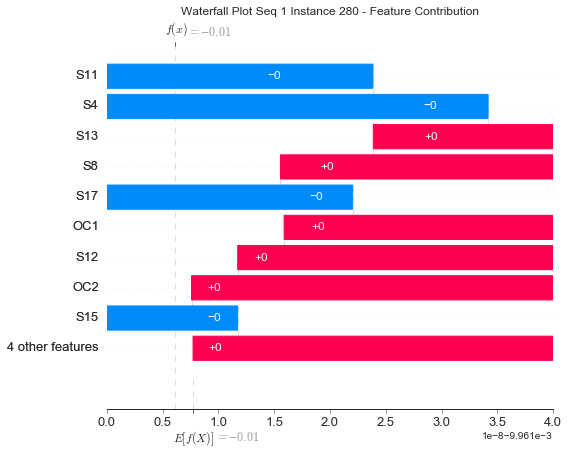

None

Contribution: [ 6.68141942e-09  5.93896488e-09 -4.91126695e-10 -1.72850800e-09
 -6.94564939e-09  8.91397900e-10  7.81918263e-09 -1.53733541e-08
  1.52135338e-09  1.08279048e-08 -6.53632437e-09 -4.67646100e-09
  1.61190972e-09]


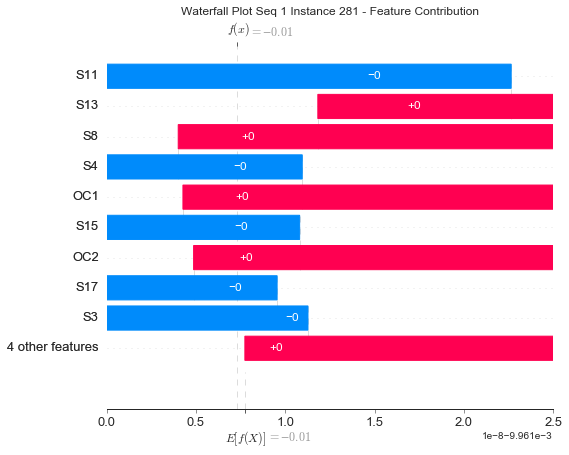

None

Contribution: [ 6.93826285e-09  6.82075108e-09 -5.39559786e-10 -2.05292050e-09
 -8.98377372e-09  2.10196793e-09  9.45696765e-09 -1.78971096e-08
  3.68262443e-09  1.23114079e-08 -6.68570443e-09 -6.65902622e-09
  3.43835604e-09]


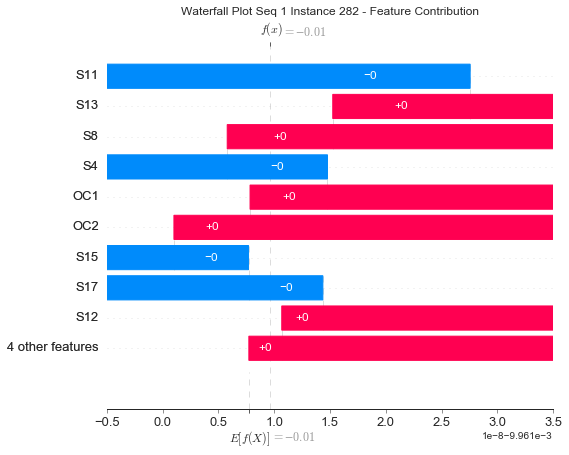

None

Contribution: [ 6.77462841e-09  5.56282620e-09 -3.02046277e-10 -1.01927988e-09
 -5.43023138e-09  1.77091053e-09  2.94313263e-09 -7.77260833e-09
  2.95356783e-09  3.28022232e-09 -1.14652314e-08 -3.35498473e-09
  3.14485815e-09]


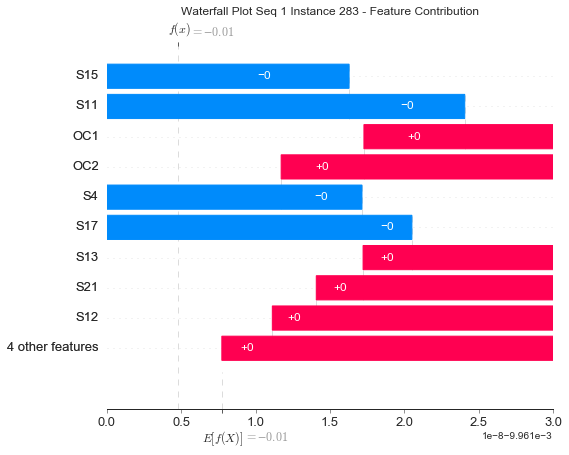

None

Contribution: [ 5.80335113e-09  4.33299663e-09 -9.94480401e-11 -5.33799116e-10
 -3.08620729e-09  6.03784411e-10  3.04207493e-11 -2.41338549e-09
  1.09171161e-09  3.37501346e-11 -1.83588504e-08 -1.14549836e-09
  1.53071888e-09]


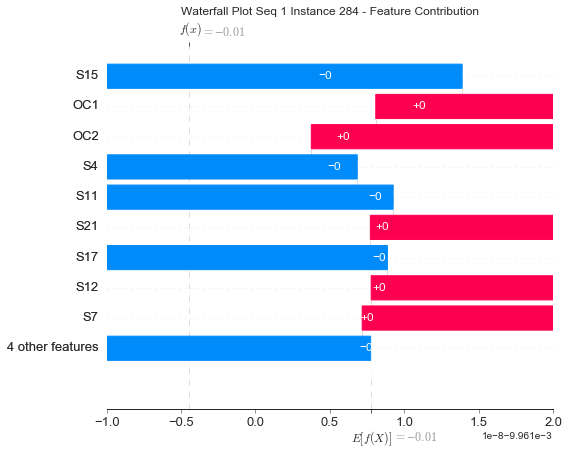

None

Contribution: [ 1.32181244e-09  2.67851208e-09  6.04462203e-10 -3.52954865e-09
 -2.35586448e-08  6.95442015e-09  1.37842333e-08 -3.25817275e-08
  1.33427314e-08  1.45058392e-08 -4.78357087e-09 -1.50690287e-08
  1.17112418e-08]


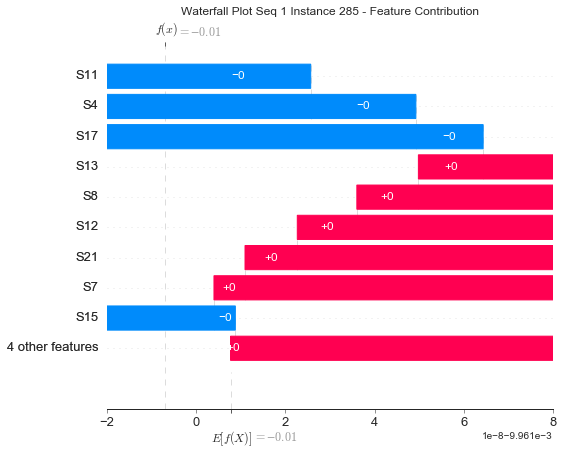

None

Contribution: [ 3.40291950e-09  3.73320264e-09  7.95840172e-10 -3.29429128e-09
 -2.13140154e-08  6.04667161e-09  1.41127057e-08 -3.18432996e-08
  1.15909637e-08  1.52269770e-08 -6.01270944e-09 -1.37030440e-08
  1.06842784e-08]


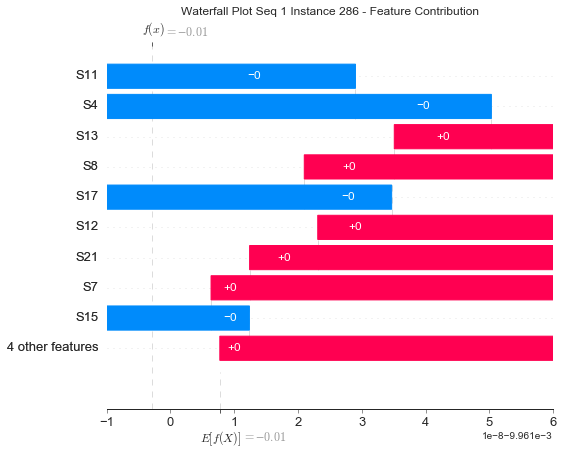

None

Contribution: [ 1.73285319e-09  1.10749199e-09  1.15803889e-09 -3.87750232e-09
 -2.84941351e-08  1.16016707e-08  1.75646306e-08 -3.92160153e-08
  2.12744080e-08  1.71700414e-08 -3.83485466e-09 -1.89719991e-08
  1.87419911e-08]


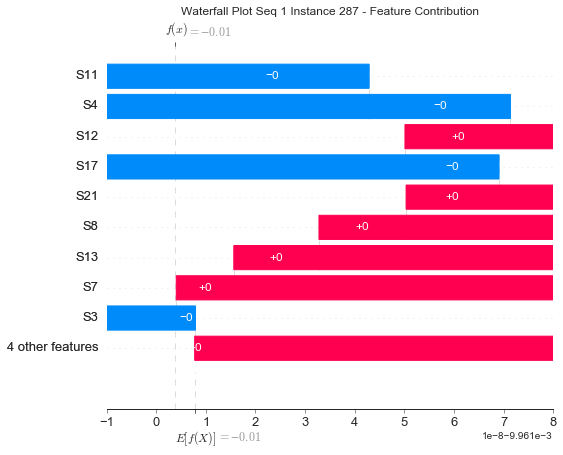

None

Contribution: [ 9.26133481e-09  9.59901314e-09 -1.52754398e-09 -2.88121038e-09
 -1.33690321e-08  2.52696064e-09  1.33657290e-08 -2.49526746e-08
  4.54998084e-09  1.75795680e-08 -1.04411999e-08 -8.64145022e-09
  4.12675583e-09]


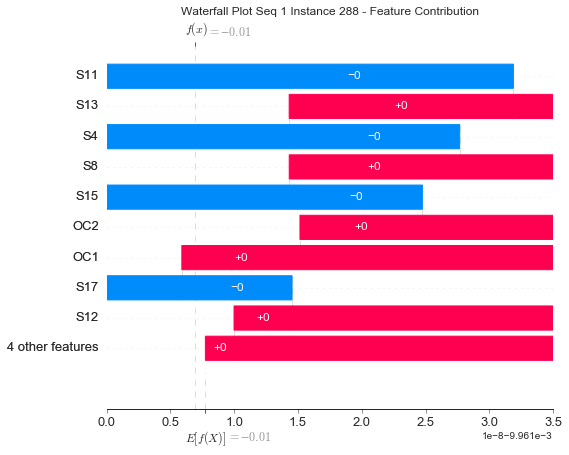

None

Contribution: [ 8.63529337e-09  7.04058500e-09 -2.09072271e-09 -3.47929330e-09
 -1.80615150e-08  2.63687805e-09  1.35375249e-08 -3.09186561e-08
  5.05316278e-09  1.77687554e-08 -1.00222222e-08 -9.00382613e-09
  3.52114182e-09]


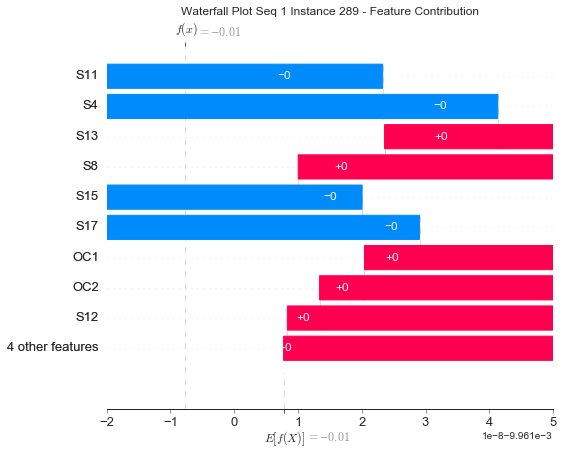

None

Contribution: [ 4.36091518e-09  5.19940491e-09 -1.65477121e-09 -4.50184690e-09
 -3.03676693e-08  1.01281099e-08  2.03485868e-08 -4.50688979e-08
  1.80767472e-08  2.29891626e-08 -6.56195542e-09 -1.78489810e-08
  1.56012483e-08]


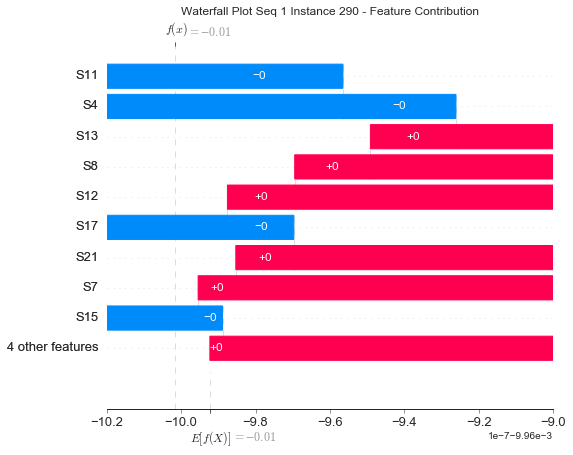

None

Contribution: [ 1.24561037e-08  9.40141387e-09 -2.75715450e-09 -4.16838652e-09
 -1.96012859e-08  3.71490283e-09  1.79507147e-08 -3.89027726e-08
  6.00542682e-09  2.41608813e-08 -1.17066836e-08 -9.11443010e-09
  4.43337811e-09]


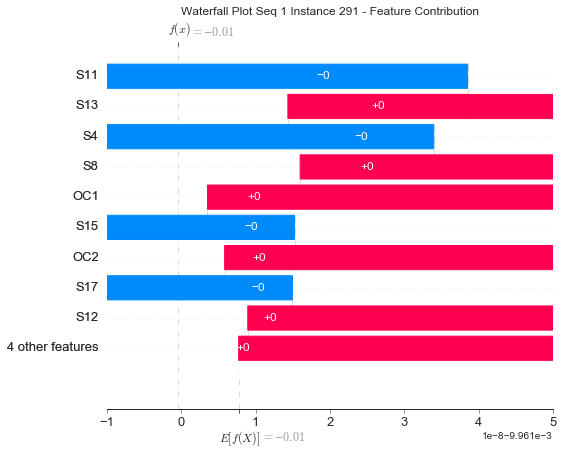

None

Contribution: [ 1.34821718e-08  8.03789124e-09 -6.95464686e-10 -4.85308416e-09
 -2.96303710e-08  1.06127835e-08  1.82791595e-08 -4.34619132e-08
  1.79661939e-08  2.05477413e-08 -4.36711201e-09 -1.85109084e-08
  1.63110112e-08]


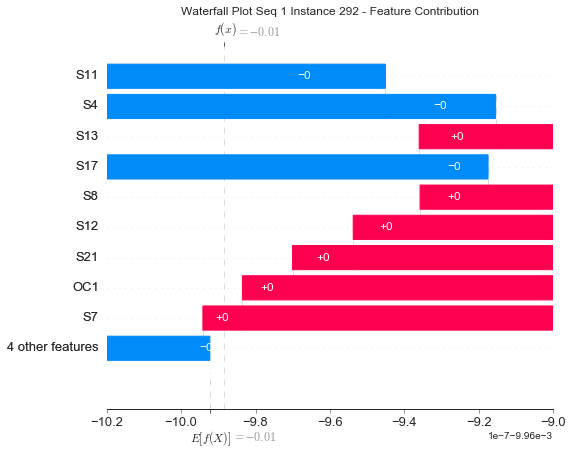

None

Contribution: [ 3.02087066e-08  1.33477771e-08 -1.84531468e-09 -4.00342959e-09
 -1.19530075e-08  9.92438132e-10  9.38816047e-09 -2.54072390e-08
  1.67000858e-09  1.27687674e-08 -2.53941170e-08 -3.64804542e-09
  2.31239006e-09]


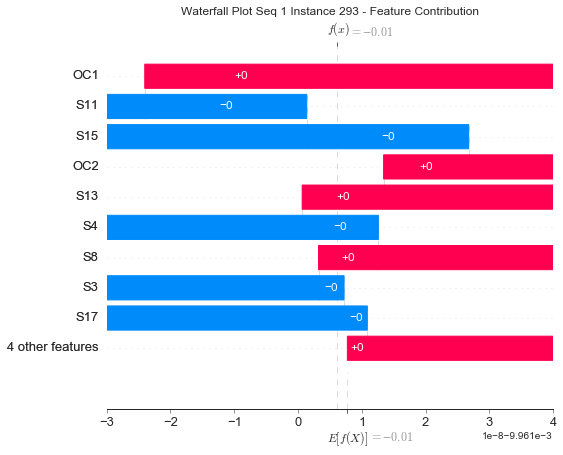

None

Contribution: [ 4.52550042e-09  9.77053105e-09 -6.24189089e-10 -5.79872195e-09
 -2.58177639e-08  7.53862928e-09  1.97621670e-08 -4.08232133e-08
  1.40985081e-08  2.08892175e-08 -1.45139420e-08 -1.92936671e-08
  1.23429613e-08]


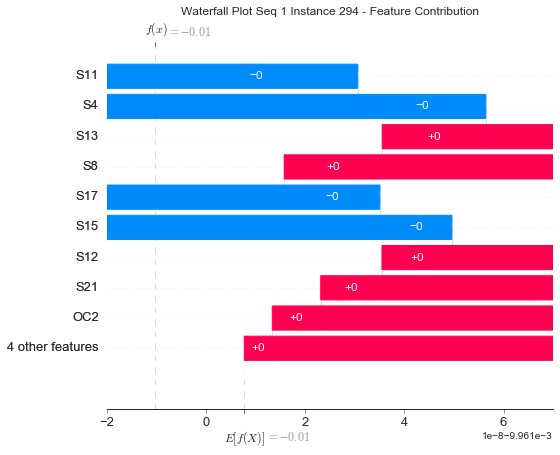

None

Contribution: [ 7.79908961e-13  0.00000000e+00 -8.35176150e-10 -6.82583323e-09
 -4.57154563e-08  1.95352676e-08  2.66385403e-08 -6.11580404e-08
  3.42124018e-08  2.57924349e-08 -2.62098565e-09 -2.88271416e-08
  2.90784037e-08]


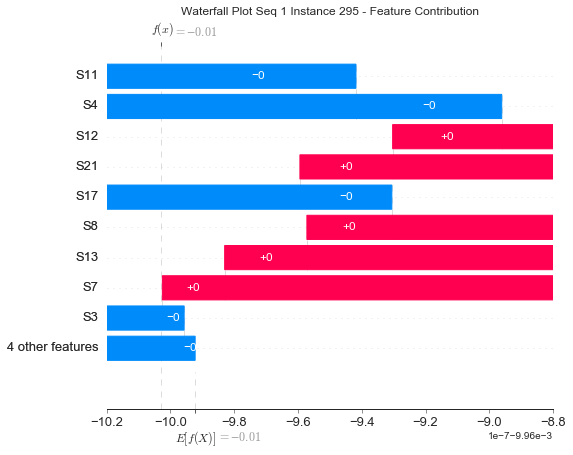

None

Contribution: [ 2.12980442e-08  1.26445832e-08 -1.45511914e-09 -4.75296158e-09
 -1.68160081e-08  3.83850729e-11  1.81392057e-08 -3.74806177e-08
  1.14871952e-10  2.67461679e-08 -1.33519862e-08 -9.59079927e-09
  4.27450186e-10]


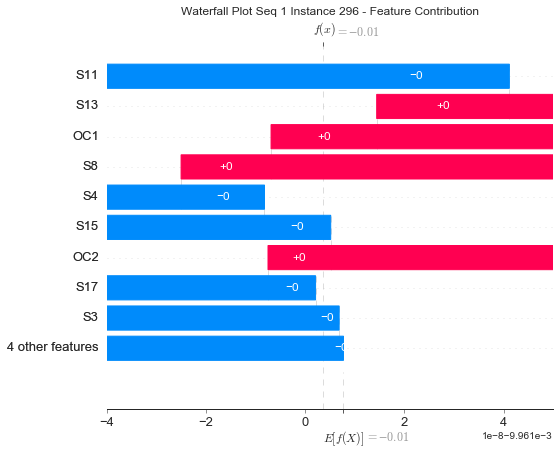

None

Contribution: [ 1.04794656e-12  1.17496473e-11 -3.17878857e-09 -1.03616351e-08
 -5.85182001e-08  2.71927263e-08  3.58863019e-08 -8.22692598e-08
  4.50733850e-08  3.65576192e-08 -3.16416737e-09 -3.27813474e-08
  3.59357735e-08]


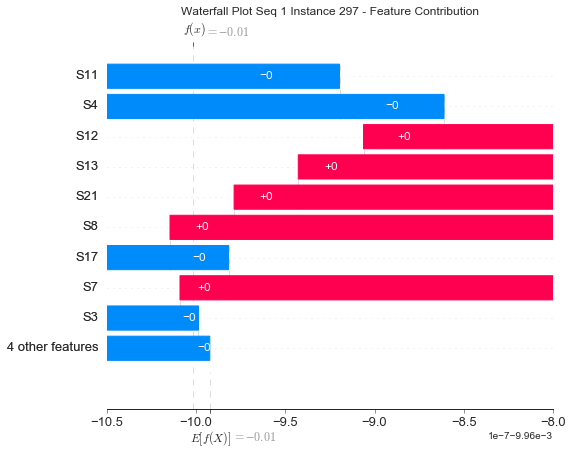

None

Contribution: [ 4.00744931e-08  2.54807642e-08 -3.67526276e-09 -7.39315986e-09
 -2.28635351e-08  4.93342256e-09  3.21930926e-08 -5.46508261e-08
  6.75945744e-09  4.66936072e-08 -1.01375246e-08 -1.20190142e-08
  6.83632173e-09]


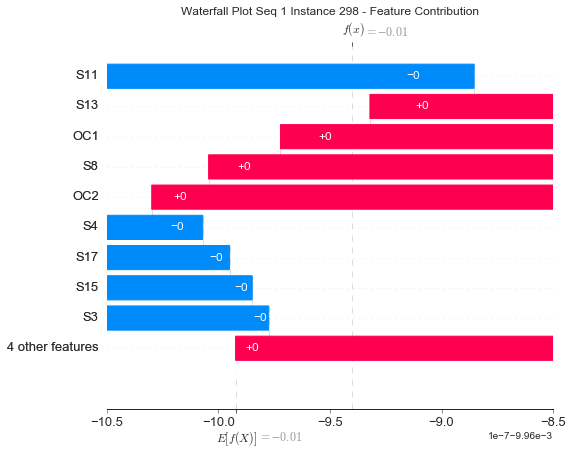

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


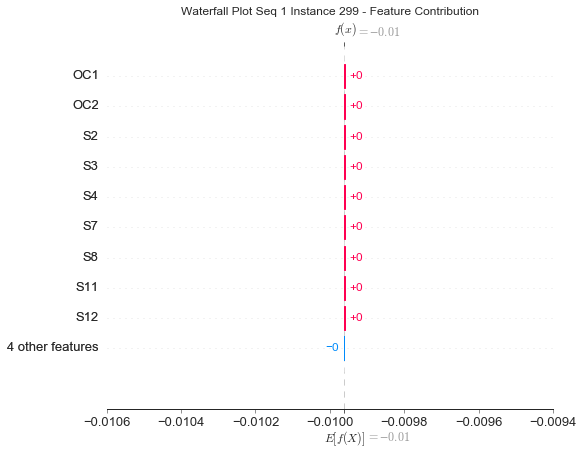

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


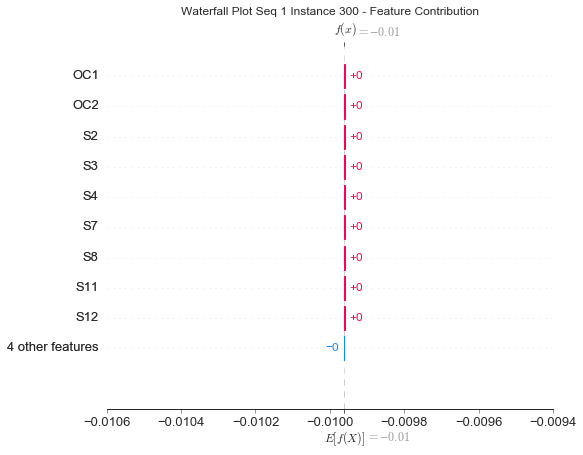

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


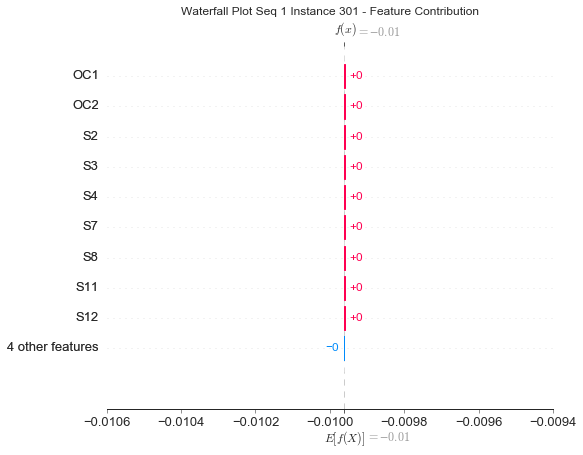

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


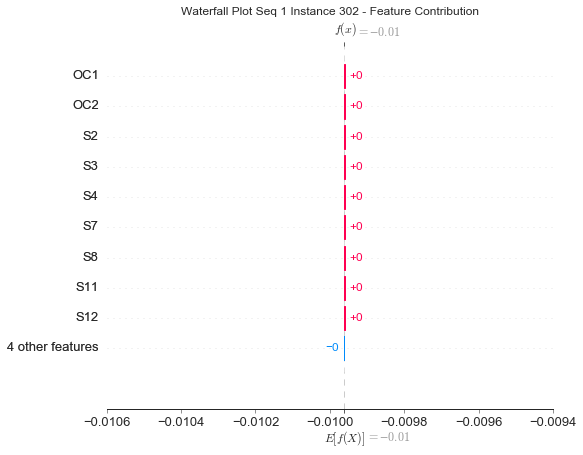

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


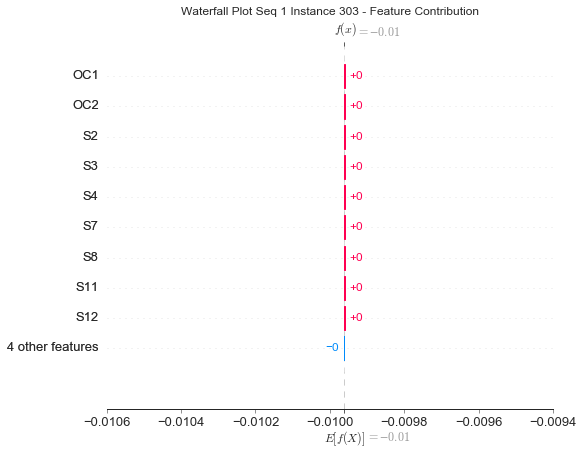

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


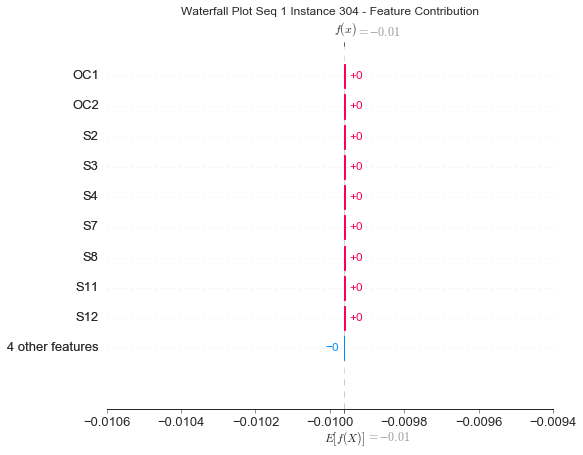

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


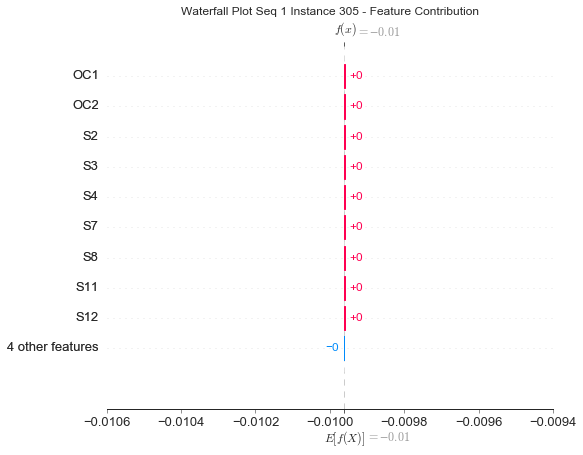

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


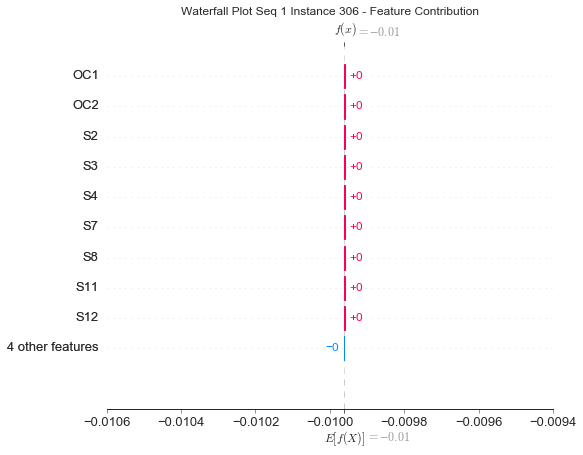

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


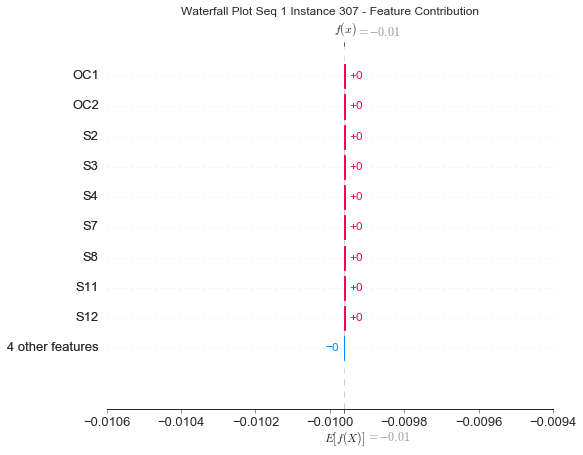

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


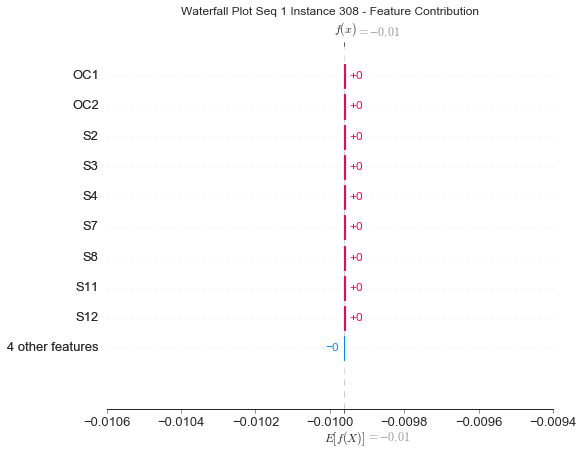

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


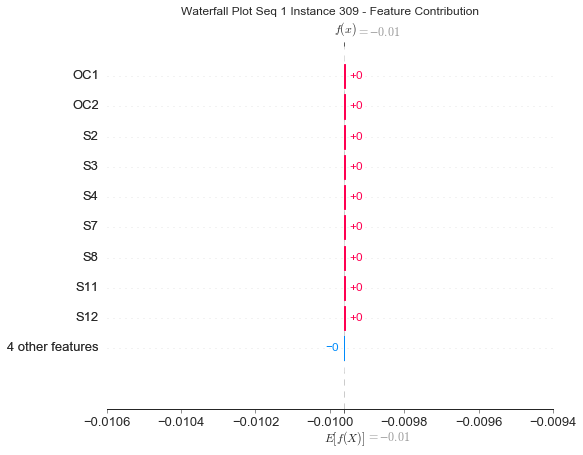

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


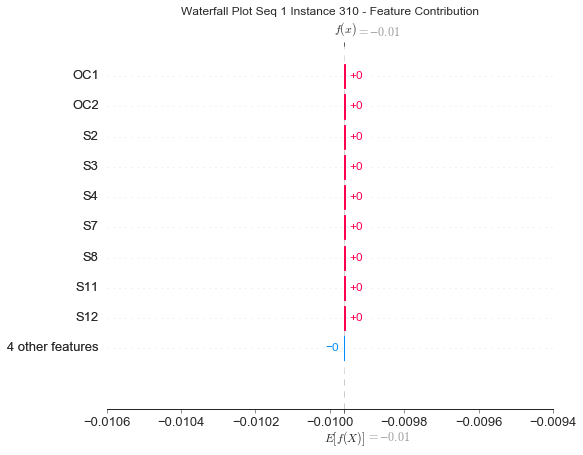

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


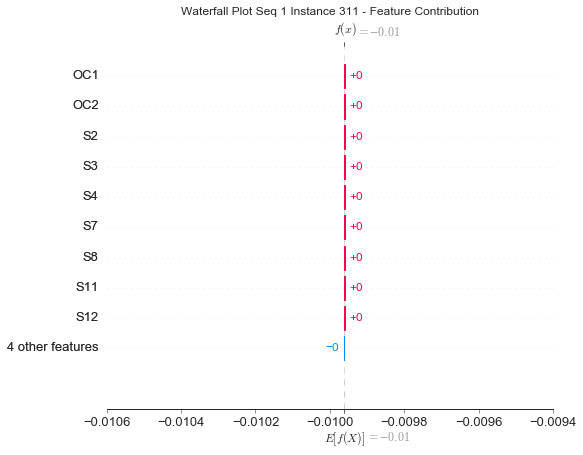

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


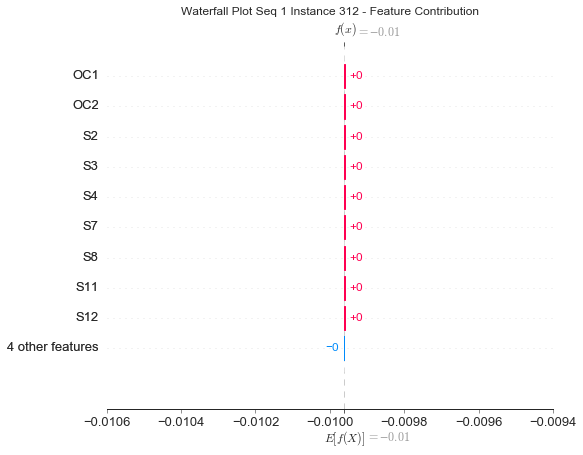

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


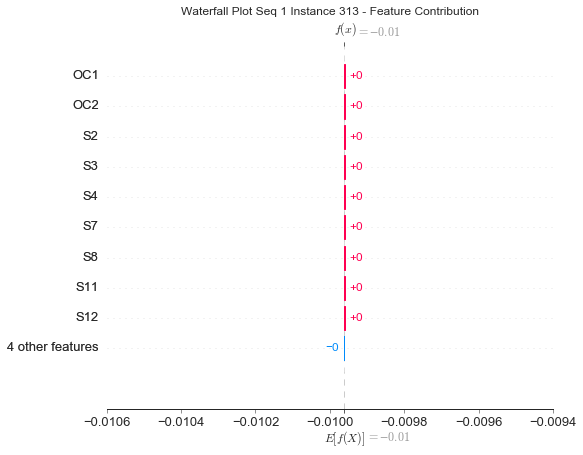

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


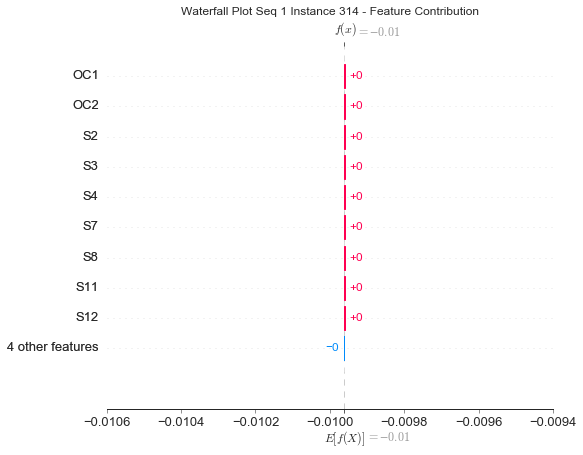

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


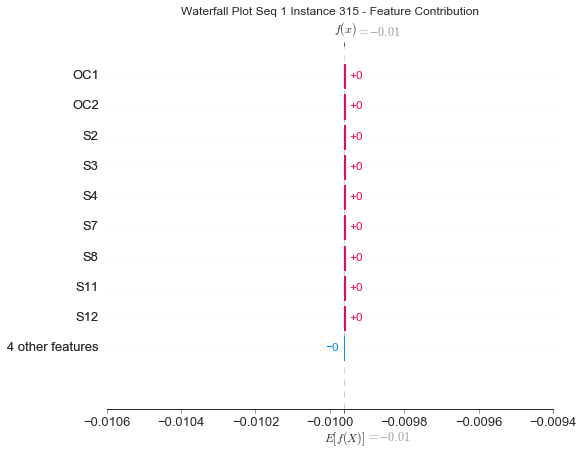

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


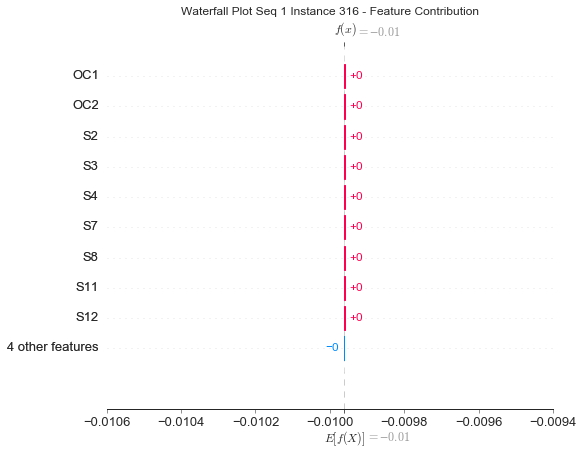

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


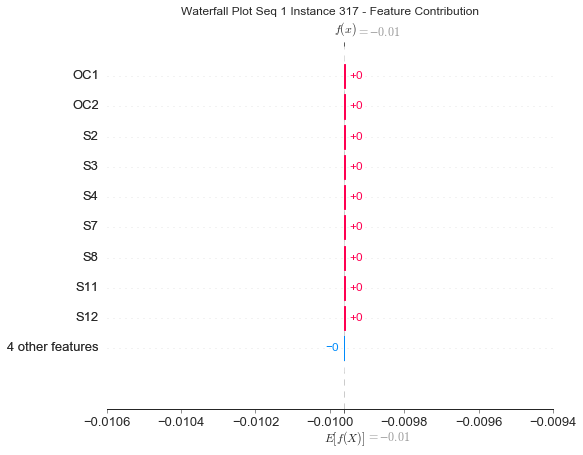

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


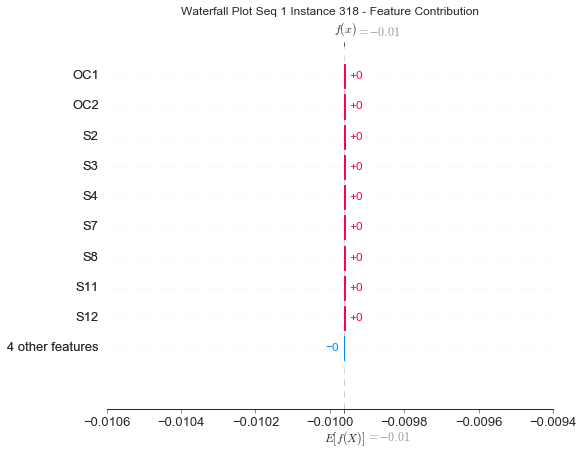

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


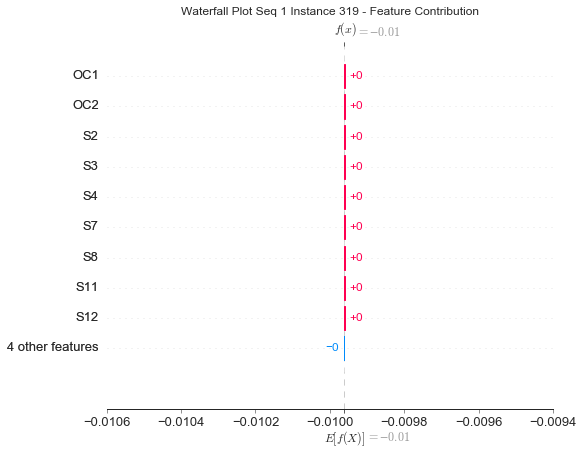

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


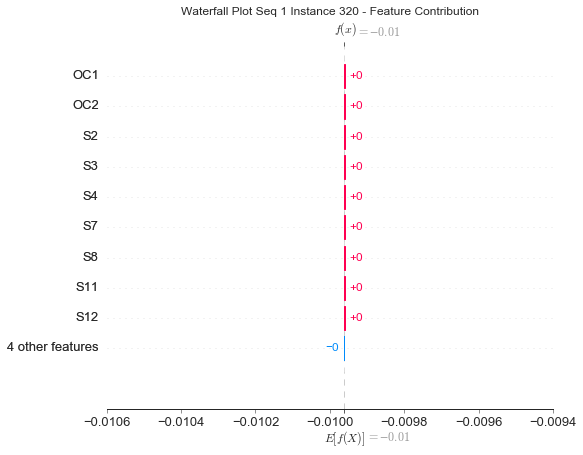

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


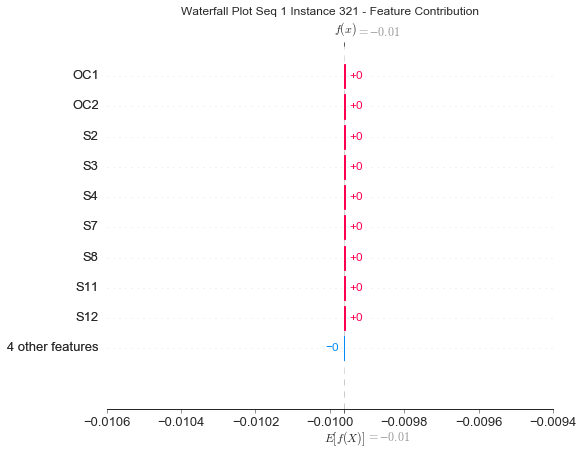

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


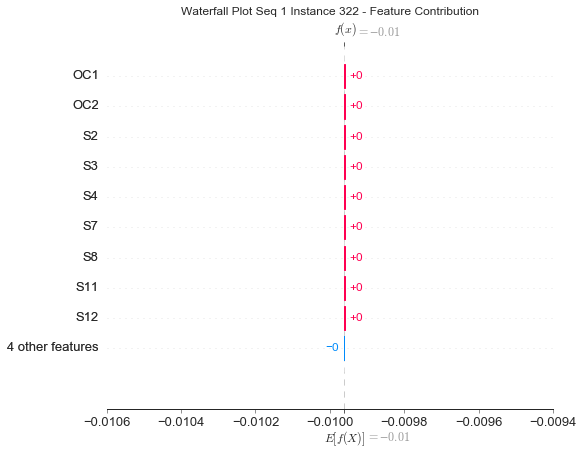

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


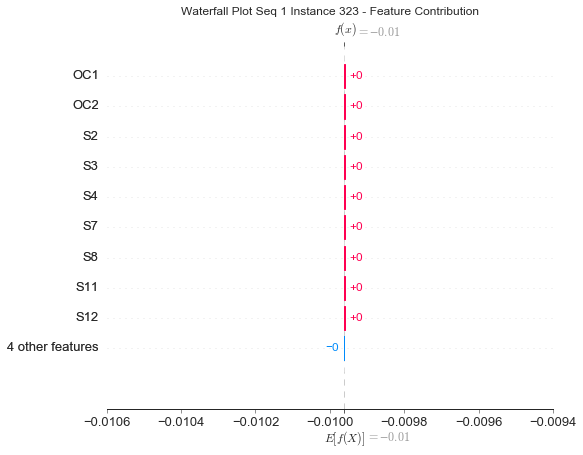

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


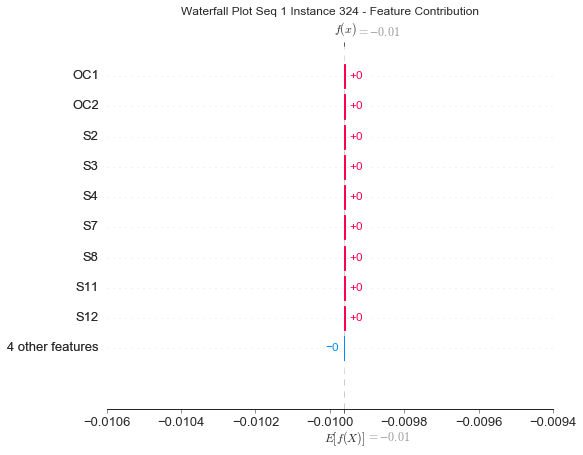

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


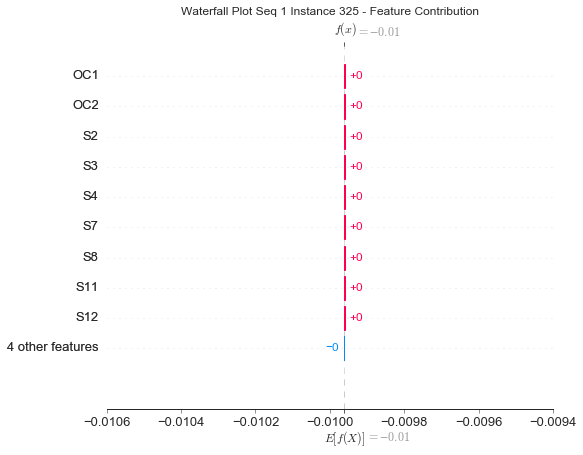

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


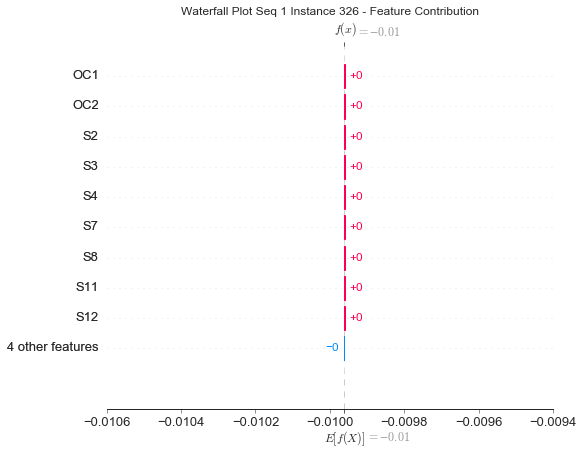

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


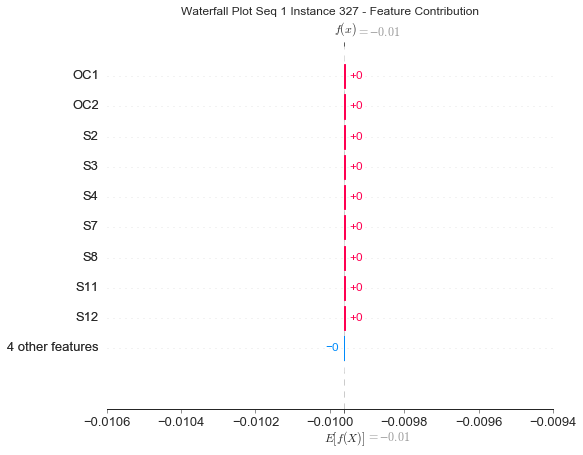

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


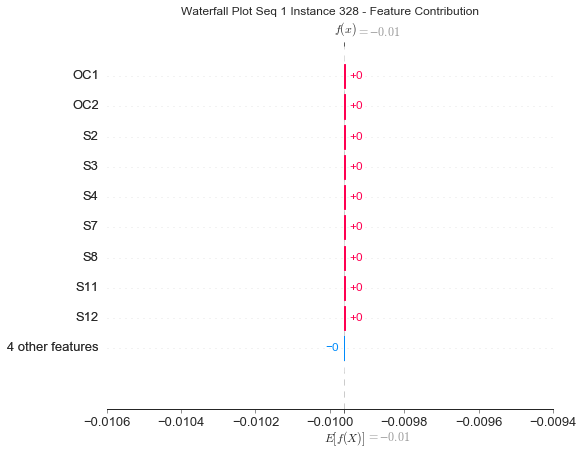

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


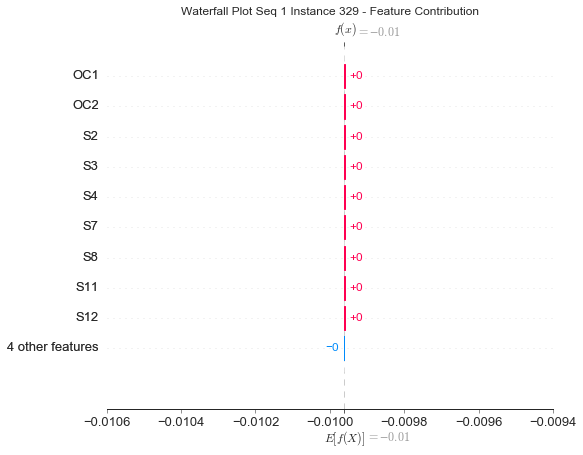

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


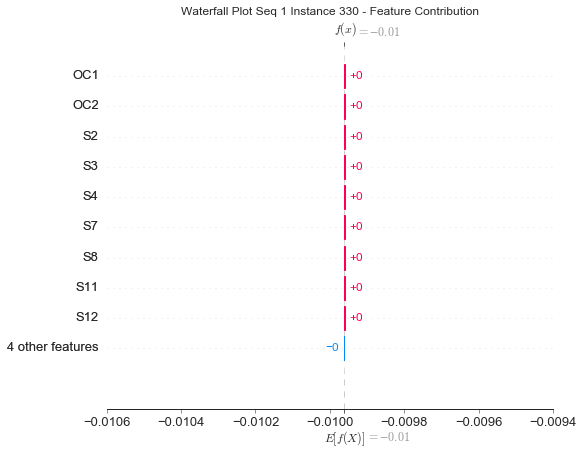

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


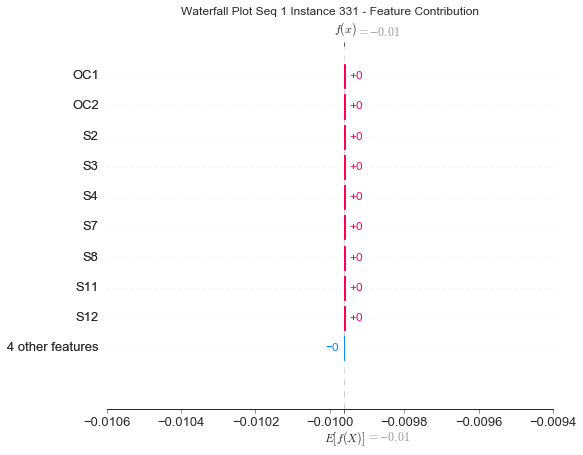

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


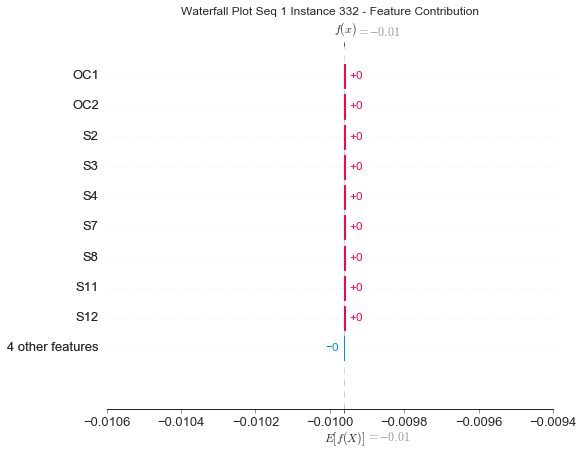

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


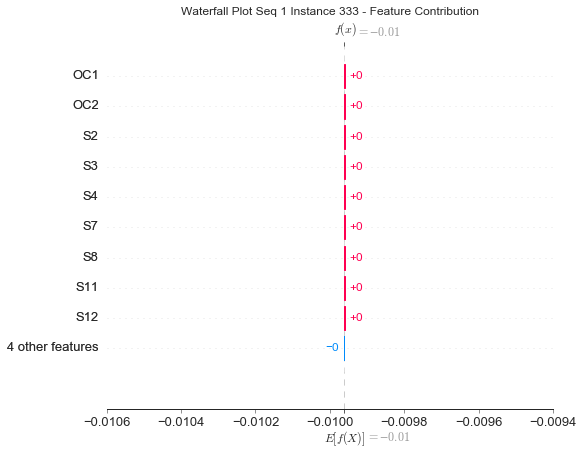

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


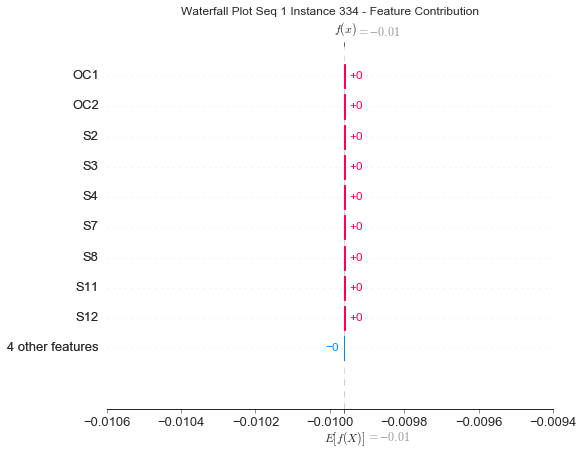

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


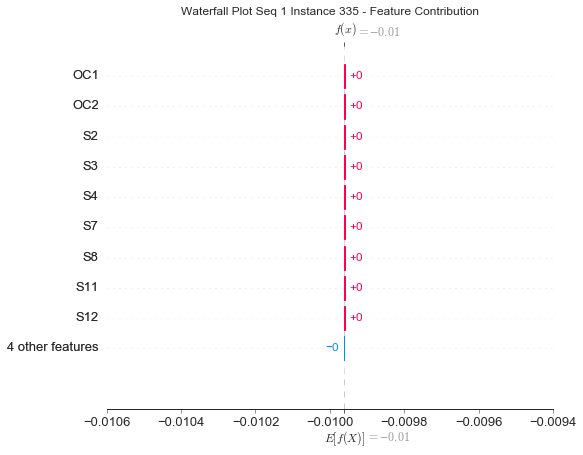

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


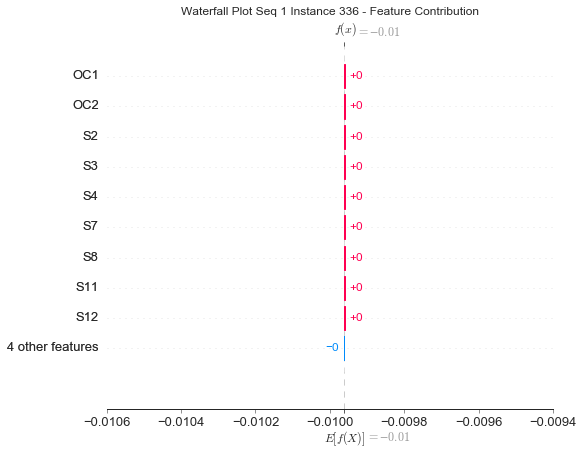

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


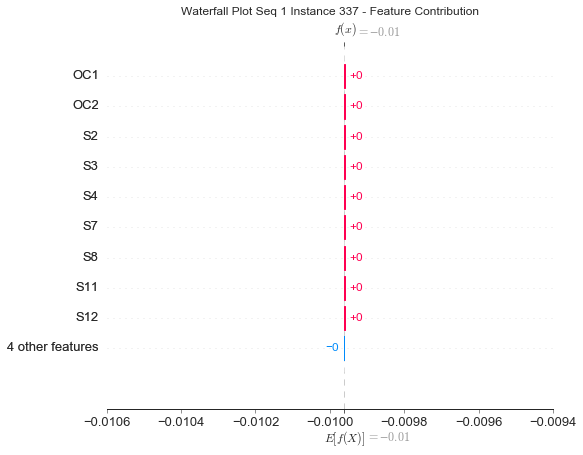

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


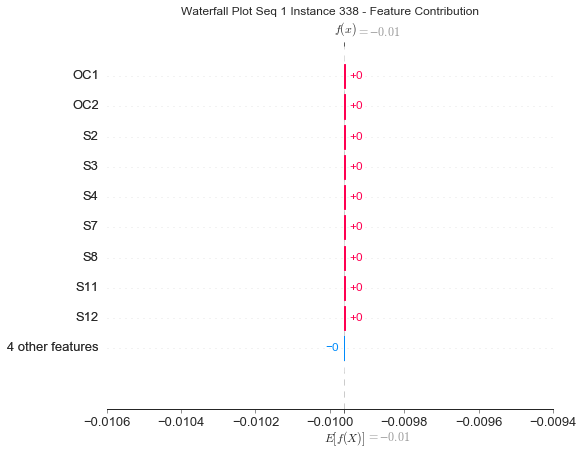

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


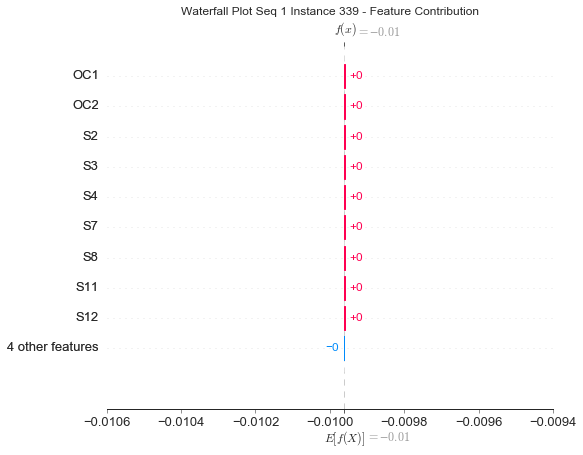

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


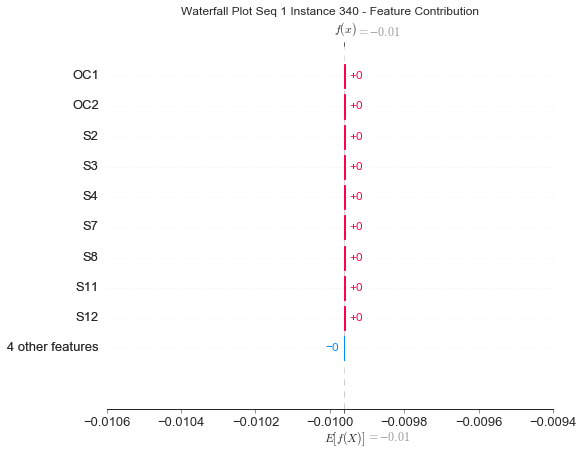

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


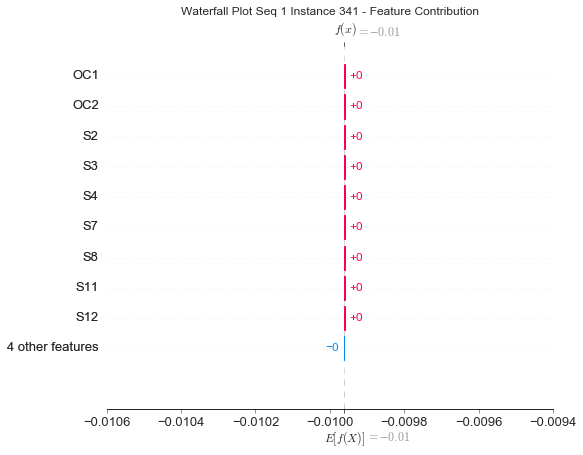

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


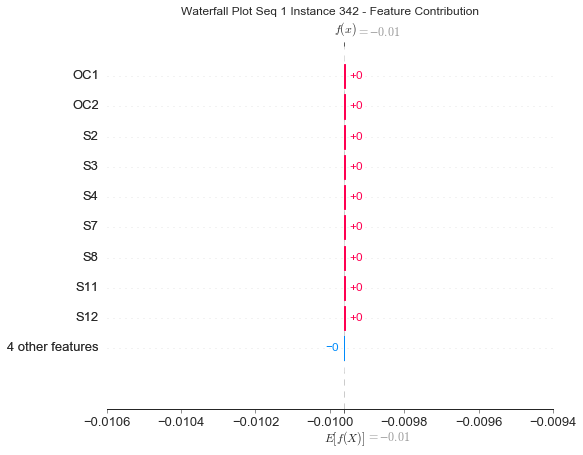

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


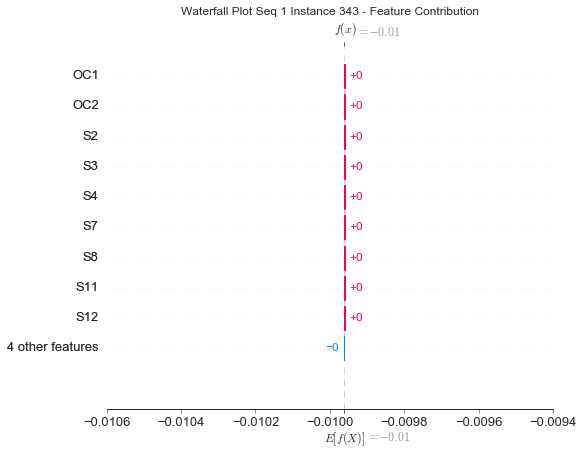

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


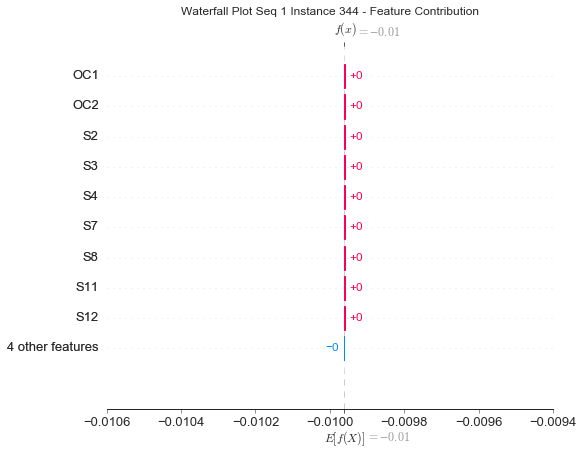

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


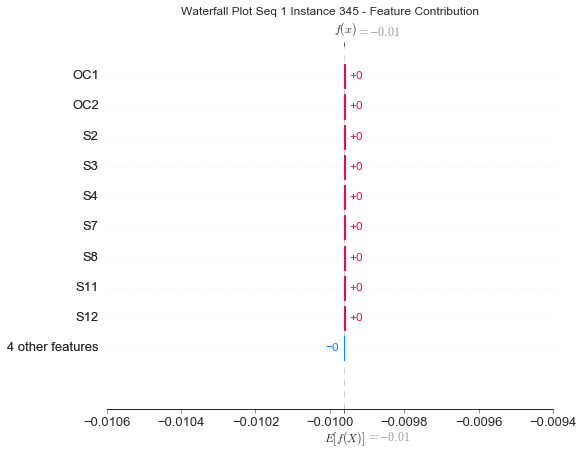

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


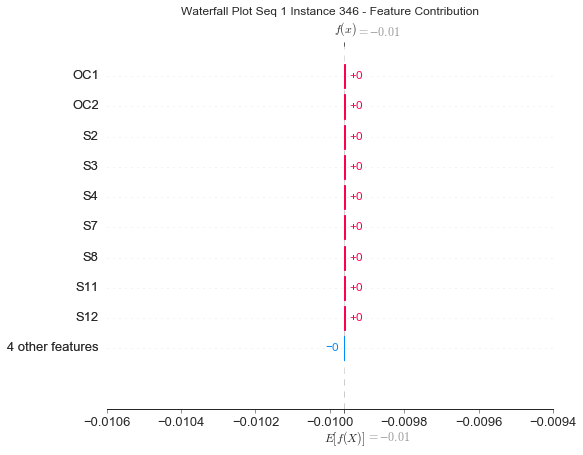

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


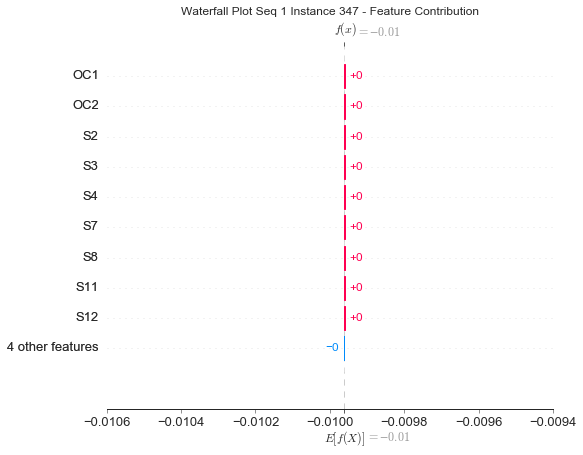

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


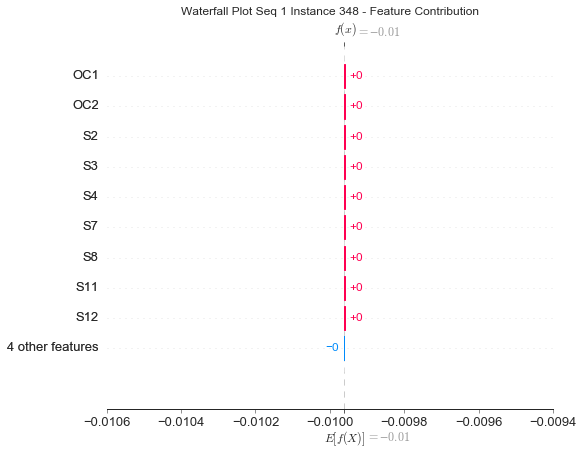

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


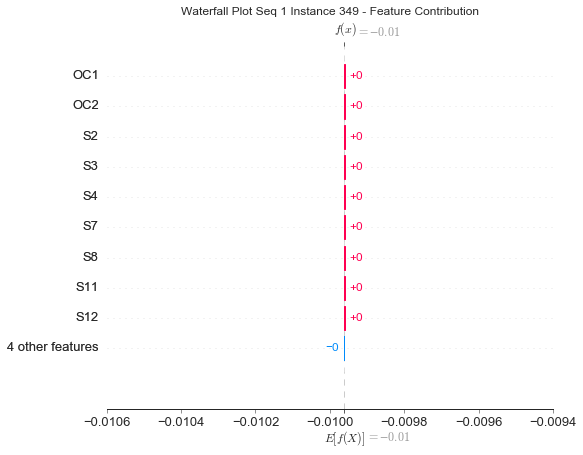

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


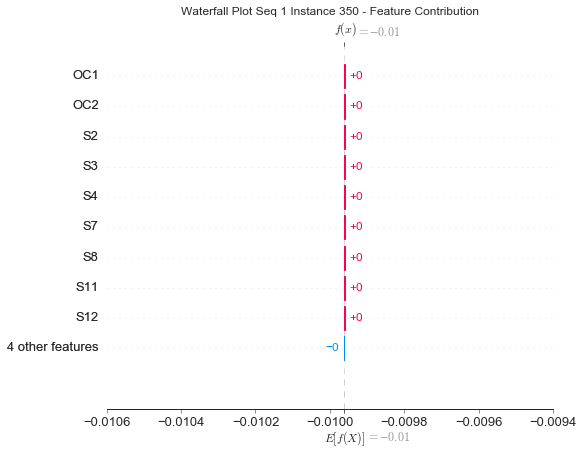

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


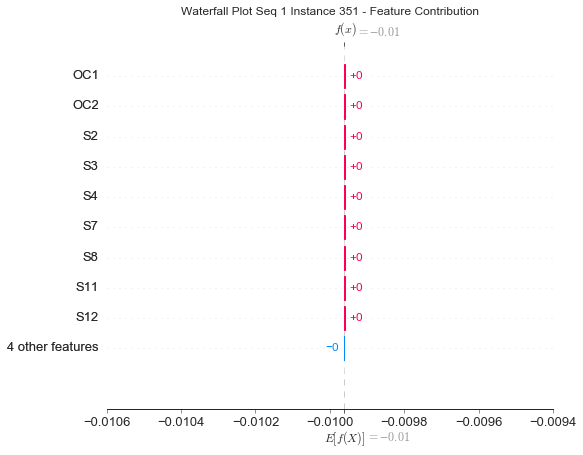

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


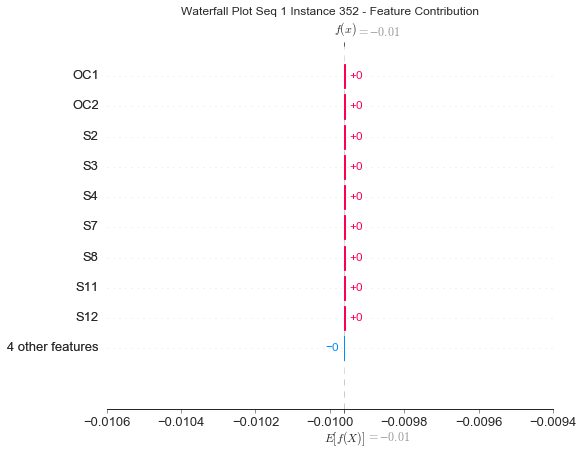

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


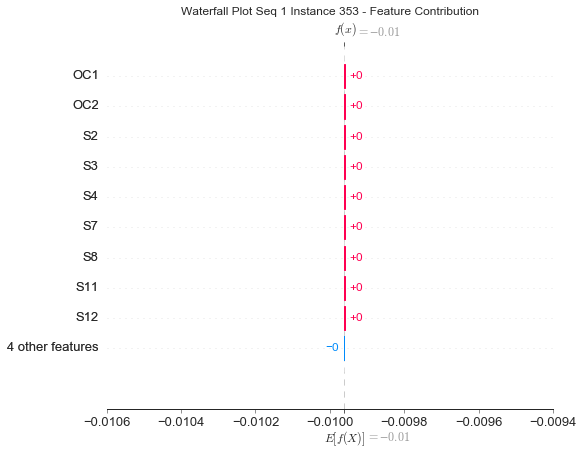

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


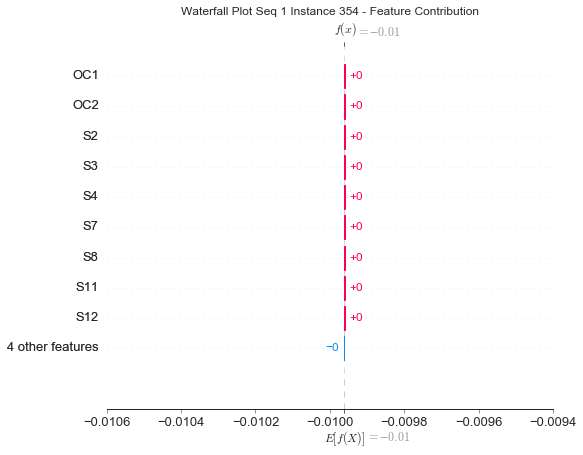

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


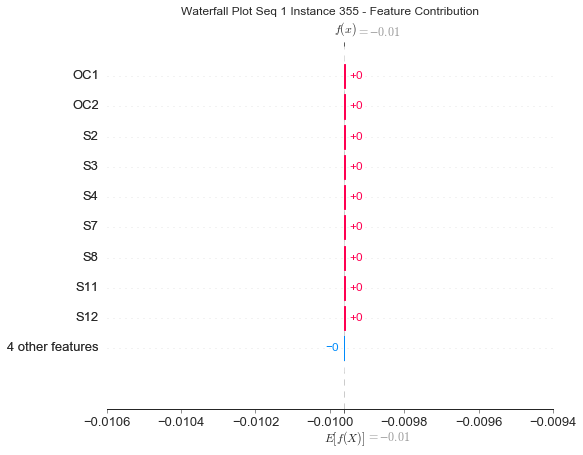

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


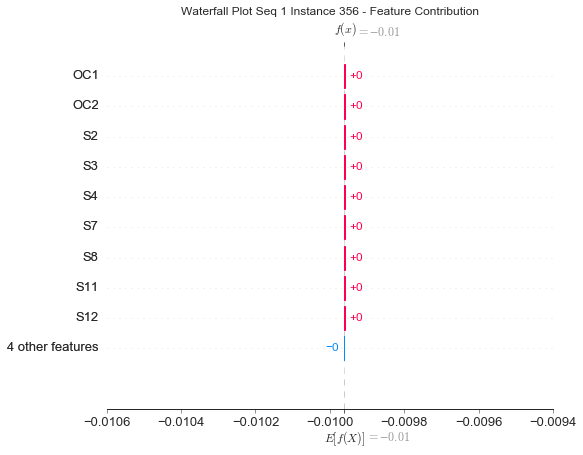

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


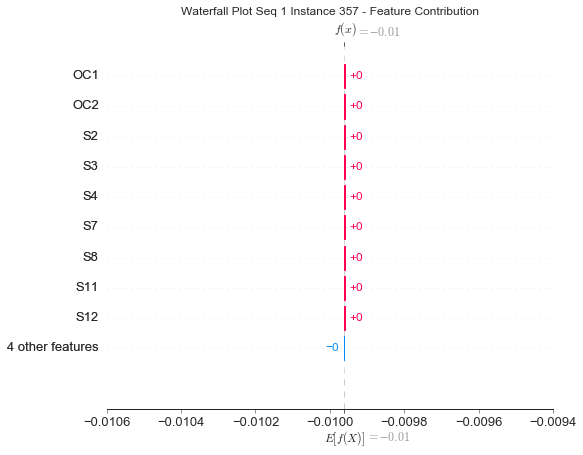

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


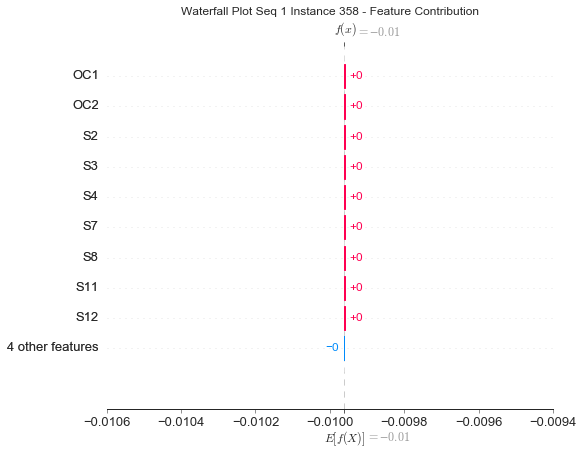

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


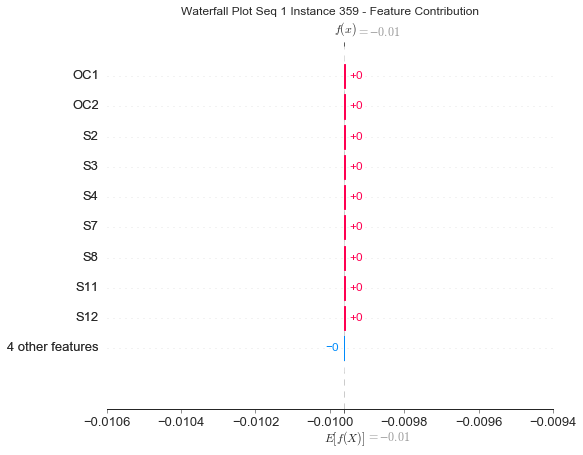

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


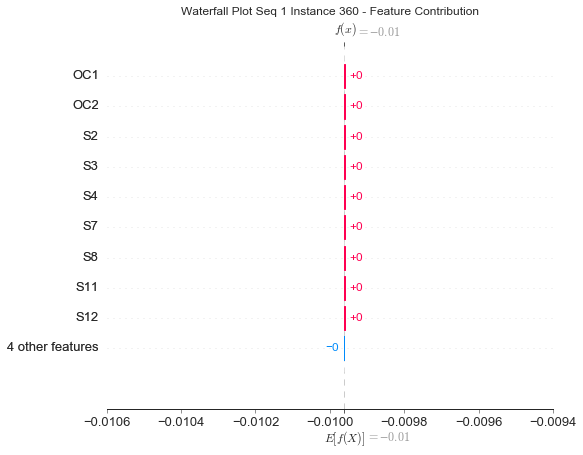

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


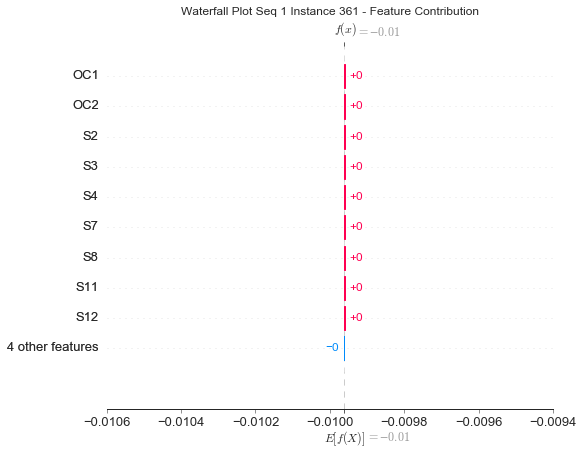

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


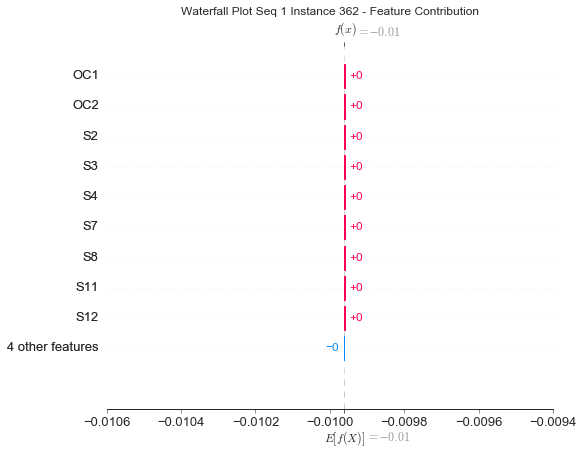

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


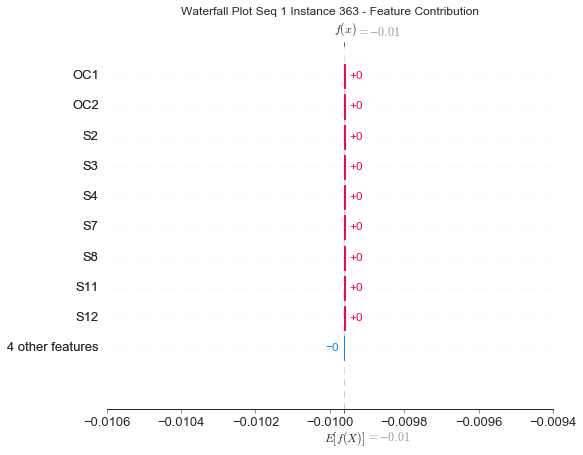

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


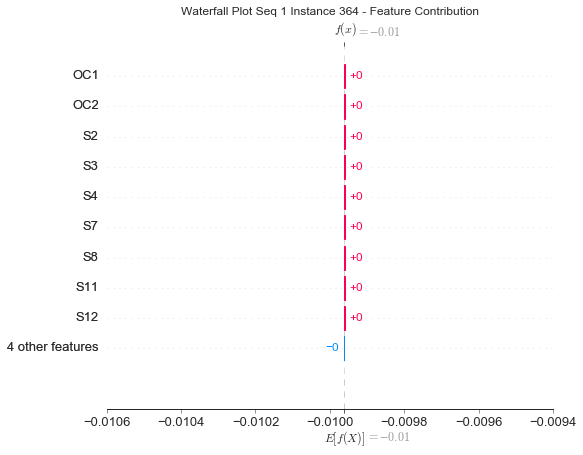

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


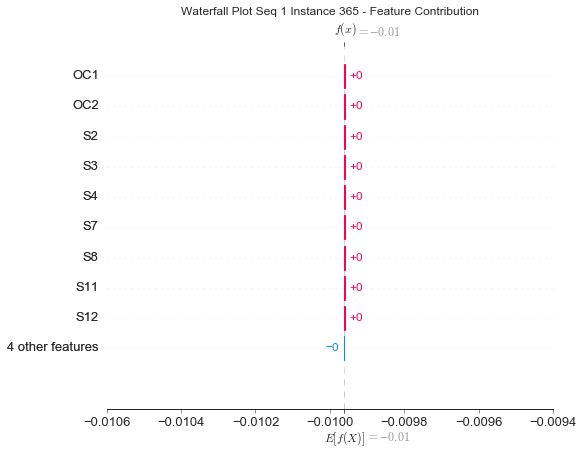

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


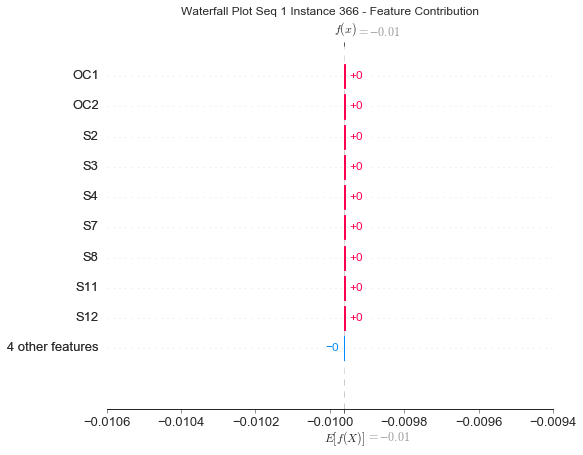

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


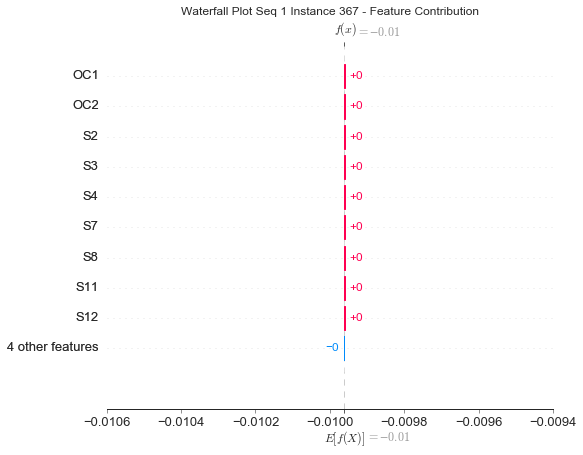

None

<Figure size 432x288 with 0 Axes>

In [56]:
#Waterfall Plot Fleet 1

for s in range(0,1):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(pad):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)
        plt.savefig("Waterfall_Plot %i" %i+'.tiff')
        plt.figure

Contribution: [ 1.09138078e-23  4.37325269e-23 -1.53683767e-23  2.95802270e-24
  5.01265569e-23 -2.91492940e-23 -1.19869095e-23  3.81771034e-23
 -6.44403939e-23  5.35617070e-24 -3.10537872e-23  3.96704707e-23
 -7.18832208e-23]


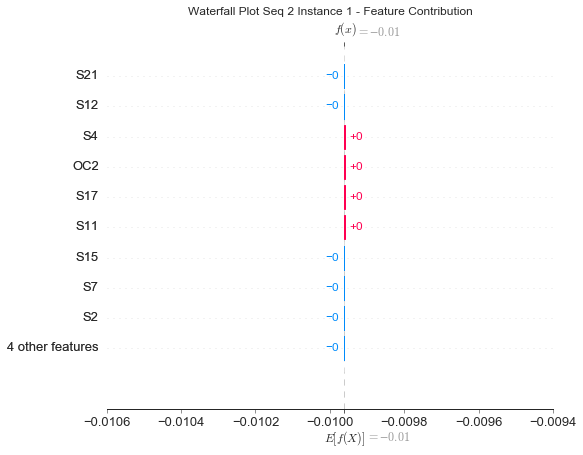

None

Contribution: [ 3.86754126e-24  2.96731954e-23 -8.04890717e-24  3.87131202e-24
  5.19263620e-23 -1.85434330e-23 -1.63002029e-23  4.30338044e-23
 -4.39836908e-23  1.25651619e-24 -2.42208618e-23  3.83694561e-23
 -4.61366878e-23]


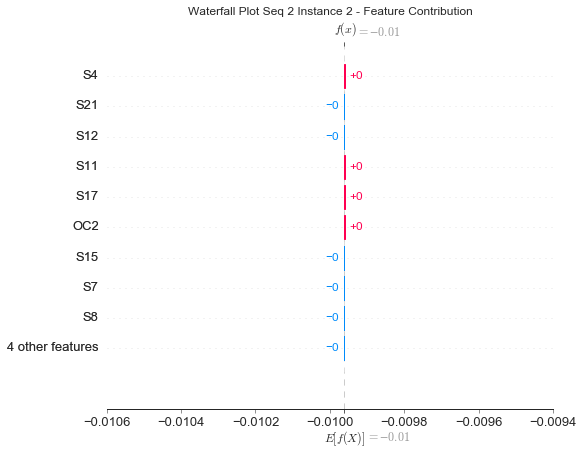

None

Contribution: [ 1.09192135e-24  1.51434394e-23 -9.34886849e-25  1.78083365e-25
  2.42218132e-23 -7.85926816e-24 -3.51266863e-24  1.93890540e-23
 -1.61431123e-23  1.55062927e-24 -8.68536646e-24  1.34377832e-23
 -1.59427984e-23]


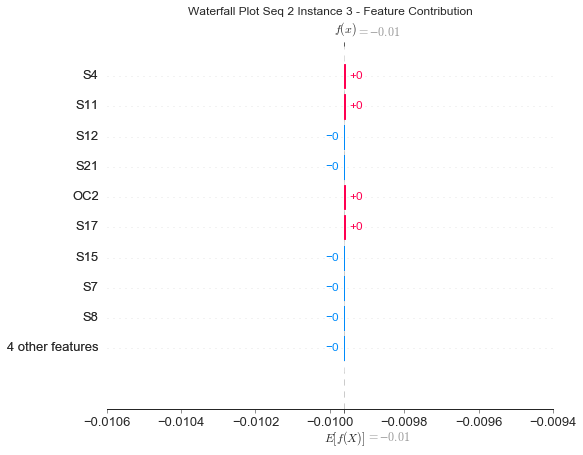

None

Contribution: [-3.92754597e-24  2.19622110e-23 -9.79752070e-24  3.37571212e-24
  2.74624064e-23 -7.69029968e-24 -5.71195919e-24  2.75596761e-23
 -2.11779571e-23  2.91163630e-24 -1.57390009e-23  2.11627967e-23
 -1.94281405e-23]


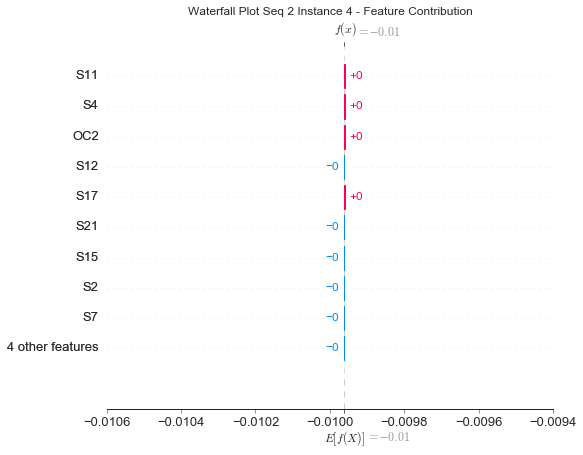

None

Contribution: [ 4.59278073e-25 -2.95452643e-23 -5.21572309e-24 -7.35552003e-25
 -4.16409001e-23  1.04143831e-23  1.45544001e-23 -4.02957124e-23
  2.28077626e-23  1.05833910e-23  6.46037323e-23 -2.11845141e-23
  2.25681004e-23]


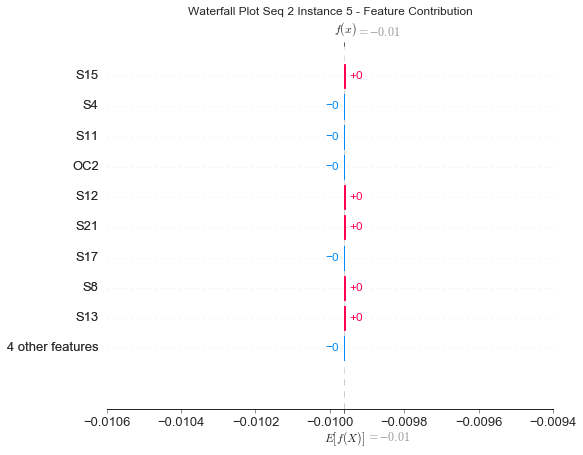

None

Contribution: [ 8.97582800e-25 -2.93008689e-23 -2.96145207e-24 -2.28694563e-24
 -5.35031341e-23  1.76787752e-23  1.60713780e-23 -4.48042008e-23
  3.90018511e-23  3.79258882e-24  5.10916052e-23 -3.39986870e-23
  4.00247450e-23]


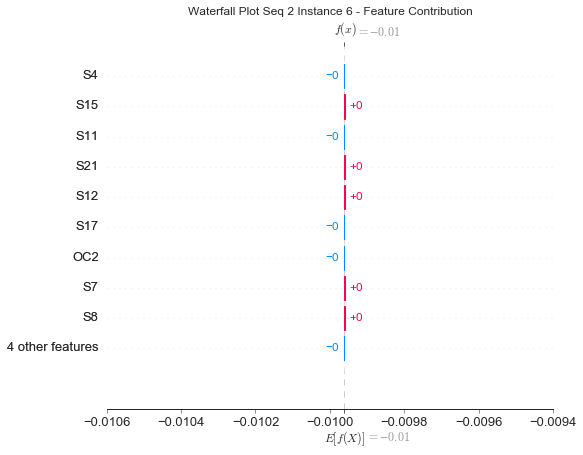

None

Contribution: [-1.03394599e-24  9.77190008e-25 -1.85823523e-24  3.82227879e-24
  9.86271059e-24 -2.38041066e-24 -1.04053010e-23  1.85657609e-23
 -5.45663805e-24 -2.97572178e-24 -1.24611372e-23  1.09021587e-23
 -5.75643793e-24]


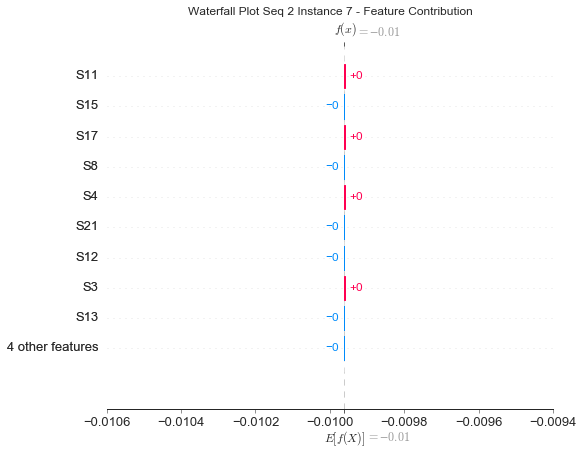

None

Contribution: [-2.05660002e-24  2.73417849e-24  4.14900801e-24  8.98179376e-25
  2.82230829e-23 -2.79129912e-24 -2.34355587e-23  4.53566653e-23
 -8.44506680e-24 -1.46110245e-23 -5.54280556e-23  2.29939890e-23
 -7.07416144e-24]


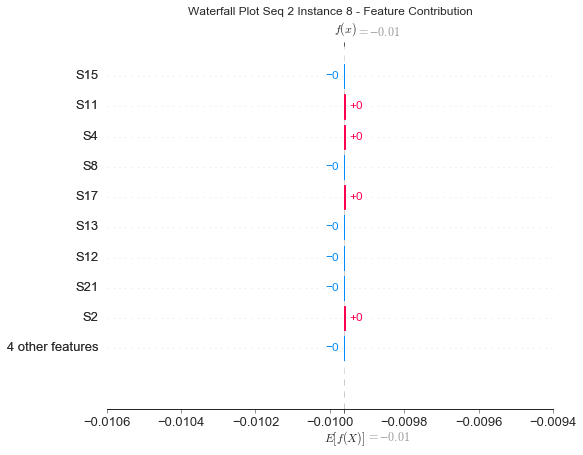

None

Contribution: [-4.44483184e-25 -3.82621087e-24  1.24241664e-23 -6.43729352e-24
 -1.58888956e-23  5.73560885e-24  1.35233352e-23 -2.71635985e-23
  1.65242757e-23  3.28020966e-24  1.63164992e-23 -2.15993398e-23
  1.58129772e-23]


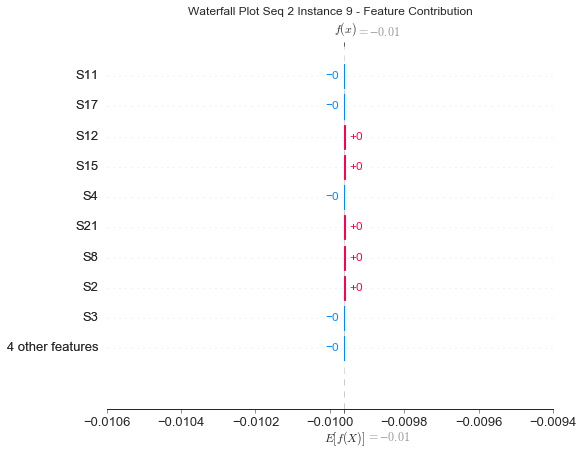

None

Contribution: [-6.28663253e-24 -1.08887354e-23  8.19650383e-24 -1.16311999e-24
  1.09667057e-23 -4.56395692e-26 -5.69196906e-24  7.12694176e-24
  2.26037813e-25 -2.18688710e-24 -2.81385482e-24  2.27729510e-24
  2.83470106e-24]


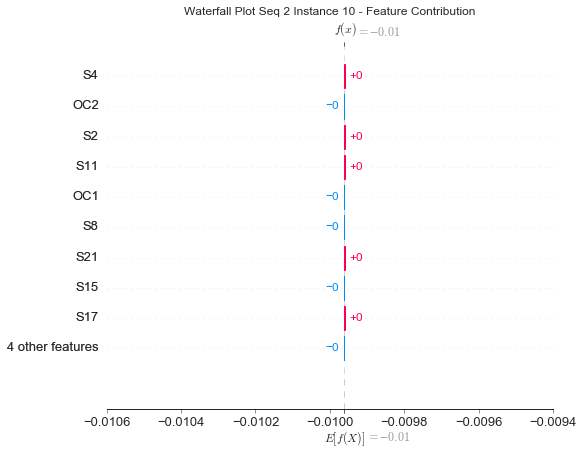

None

Contribution: [-5.47737799e-24  1.18404768e-24  4.19227625e-24  8.64849983e-24
  2.45455128e-23 -6.47748165e-24 -2.48257809e-23  4.68693755e-23
 -1.18325231e-23 -7.50404725e-24 -3.35279832e-23  2.34516309e-23
 -8.86324433e-24]


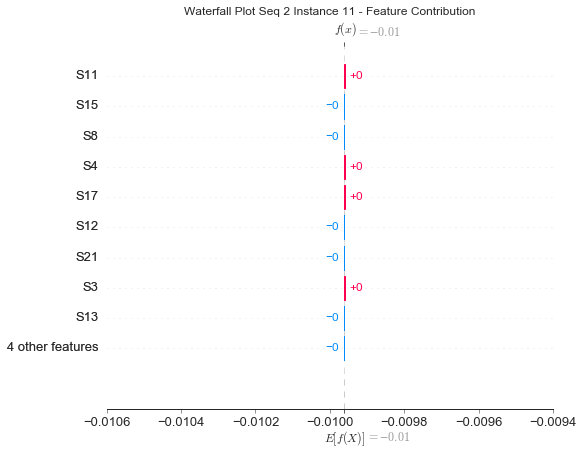

None

Contribution: [ 1.00093788e-24  1.26781741e-23  3.18207458e-24 -1.31845660e-23
 -2.23172963e-23  1.53241230e-24  3.52877268e-23 -6.19264646e-23
  4.24259177e-24  1.36397742e-23  5.04960278e-23 -3.07888088e-23
  4.76049710e-24]


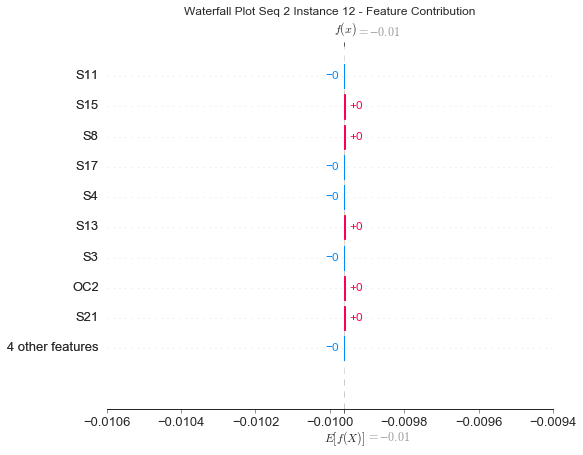

None

Contribution: [ 1.23257410e-23 -2.97517723e-23  2.64506324e-23 -1.35202113e-23
 -3.96593793e-23  8.63179491e-24  1.22314130e-23 -4.30456026e-23
  3.48551565e-23 -1.78578178e-25  3.64362041e-23 -3.83793263e-23
  3.34124466e-23]


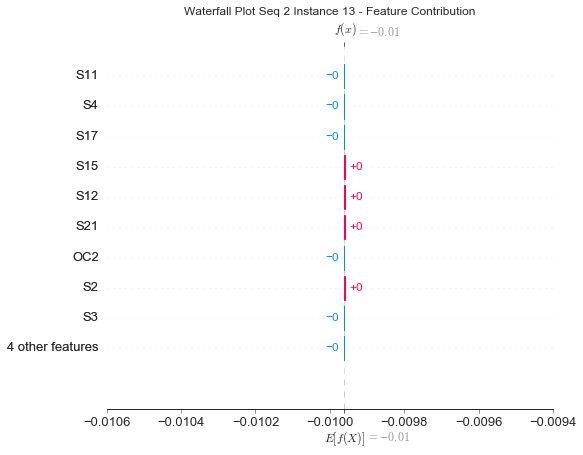

None

Contribution: [-2.73038249e-24  4.90944334e-23 -2.07218002e-24  1.56040040e-24
  2.56644031e-23 -9.59814952e-24  7.89874986e-24  1.00102181e-23
 -2.29901283e-23  6.13972217e-24 -2.55332739e-23  7.78099580e-24
 -2.24416554e-23]


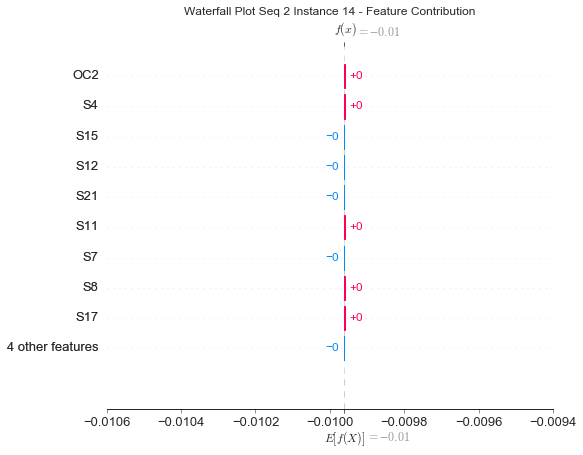

None

Contribution: [ 1.56781983e-24 -1.05742639e-23 -2.31039278e-23  7.94842206e-24
  2.41273976e-23 -6.76312700e-24 -2.04761186e-23  3.70469591e-23
 -1.70306140e-23 -2.59992008e-24  8.16802408e-25  3.41266623e-23
 -1.83076819e-23]


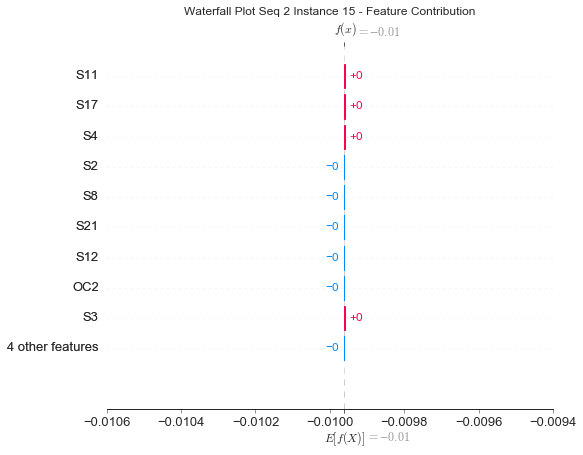

None

Contribution: [ 3.33855106e-25 -2.20771544e-23 -1.37499592e-23  9.63465248e-24
  3.15673294e-23 -8.32272394e-24 -2.78950588e-23  4.01115859e-23
 -2.14912201e-23 -5.64303011e-24  4.50285552e-24  4.19572807e-23
 -2.76140886e-23]


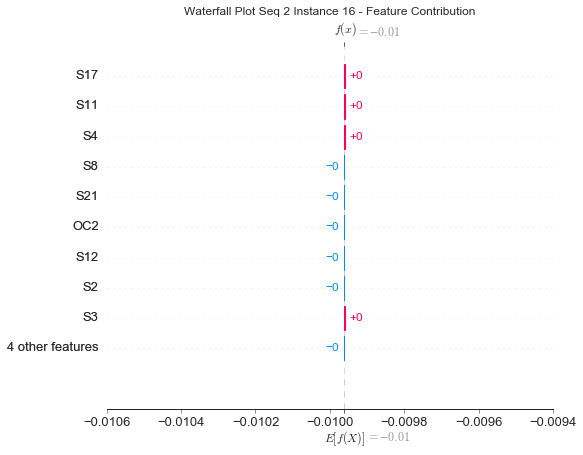

None

Contribution: [-1.22252567e-23 -4.77506247e-23 -2.82875202e-23  1.23389592e-23
  2.99470627e-23 -7.52971126e-24 -1.94925447e-23  2.55446453e-24
 -2.76585520e-23  4.43111690e-24  4.73926995e-23  5.01963680e-23
 -2.93966208e-23]


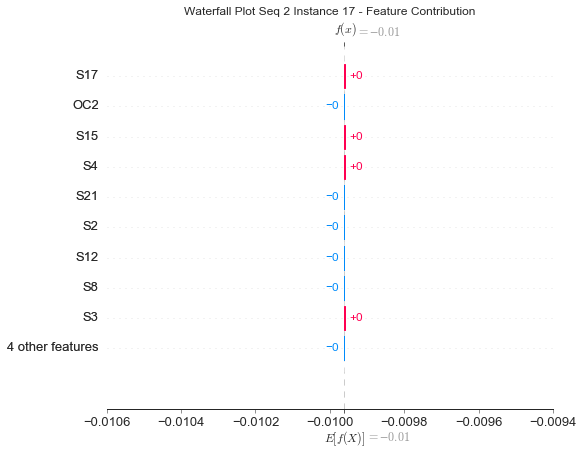

None

Contribution: [-2.46229521e-23 -9.40725970e-23  2.80917944e-23 -2.01938326e-23
 -1.02862868e-22  6.71258784e-23  4.39945550e-23 -1.20026891e-22
  1.34064147e-22 -7.88509665e-25  8.26362154e-23 -1.05834854e-22
  1.49055306e-22]


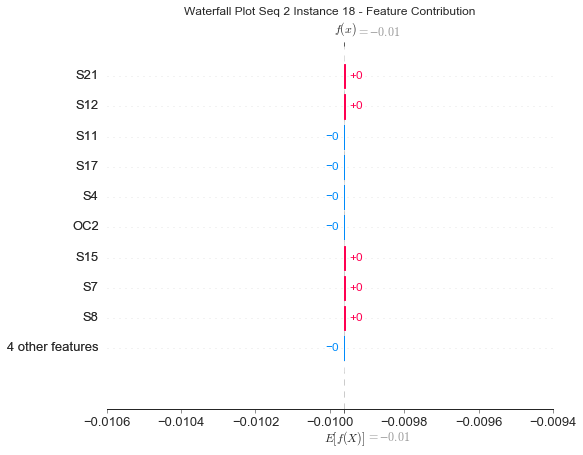

None

Contribution: [ 2.72398562e-23 -3.96040392e-23  3.55863832e-23 -1.95747061e-23
 -5.31598470e-23  1.10559802e-23  1.80705930e-23 -6.16362900e-23
  5.19236010e-23  1.68980939e-26  6.31951612e-23 -4.99982850e-23
  4.53383637e-23]


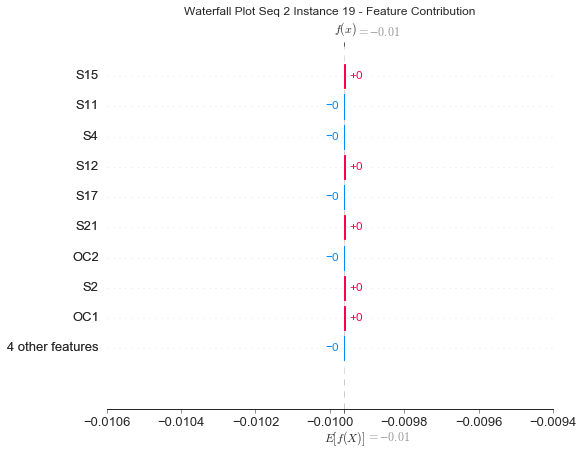

None

Contribution: [ 4.56773854e-24  4.12328160e-23  1.02994839e-23 -3.90505160e-24
  1.67579016e-23 -3.63269776e-24  8.39907384e-24  8.98865902e-24
 -5.01875635e-24 -1.50611851e-25 -4.49835720e-23 -9.00018743e-24
 -5.57321828e-24]


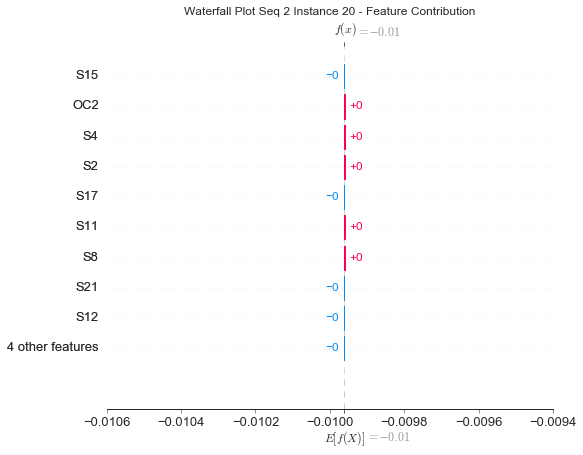

None

Contribution: [ 1.50439498e-23 -5.97155904e-23  4.83092865e-23 -8.31682232e-23
 -3.15228893e-22  5.05430439e-23  2.42675526e-22 -5.48557920e-22
  1.44850046e-22  1.12200923e-22  5.87241689e-22 -2.89473481e-22
  1.25237550e-22]


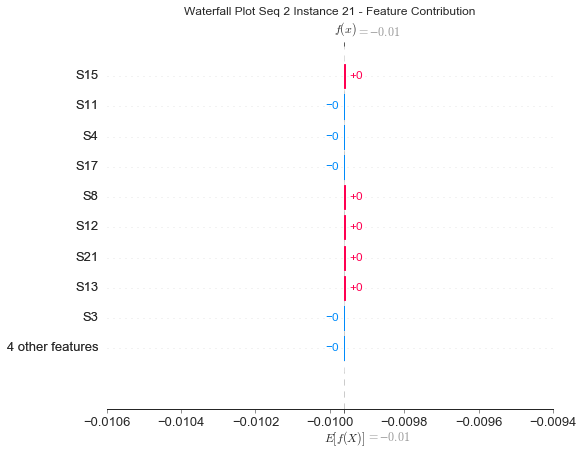

None

Contribution: [-5.18813812e-23  2.26090943e-22 -1.33423428e-22  6.87748753e-23
  3.27068093e-22 -1.26326115e-22 -1.14492975e-22  3.60895786e-22
 -3.38732607e-22 -5.21012375e-24 -2.96253191e-22  2.94141139e-22
 -3.00923147e-22]


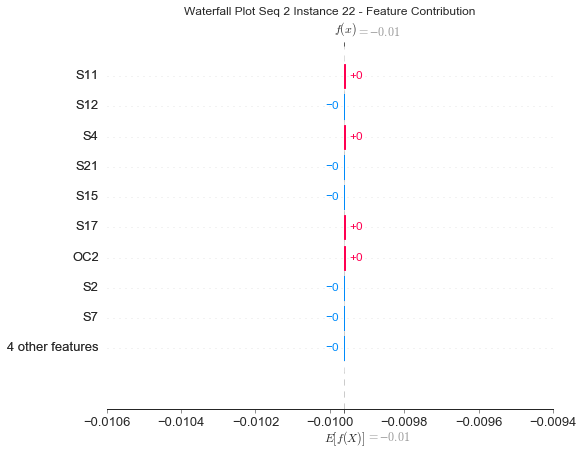

None

Contribution: [-7.27825011e-25 -3.35938468e-23  2.08562296e-23 -6.21665426e-24
 -7.31718346e-23  4.30512130e-23  3.16116507e-23 -8.81440927e-23
  9.69635387e-23  4.00890854e-25  1.84094024e-23 -5.08203696e-23
  9.06020444e-23]


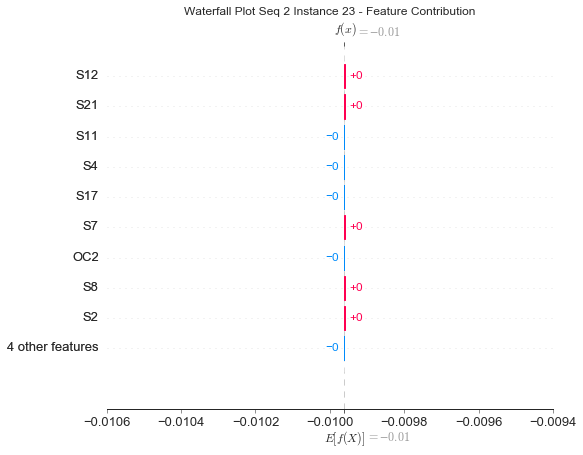

None

Contribution: [-8.78489940e-24 -9.30427801e-23  3.30718796e-23 -2.17051591e-23
 -1.46462427e-22  6.16888975e-23  6.14377305e-23 -1.84396754e-22
  1.37116912e-22  9.79352966e-25  7.95598030e-23 -1.29782677e-22
  1.39219813e-22]


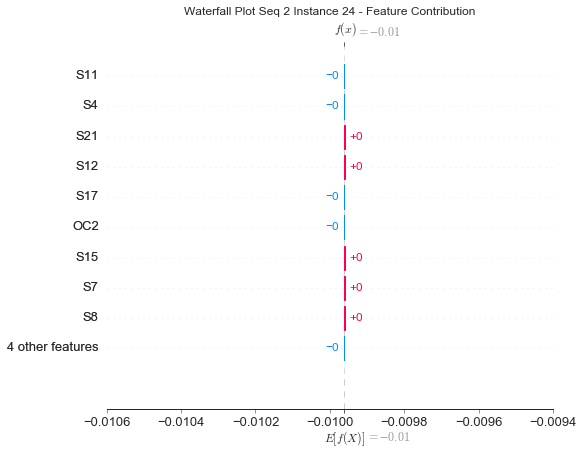

None

Contribution: [-1.79689198e-23 -1.51299975e-22  4.74742520e-23 -4.52749078e-23
 -2.38631787e-22  1.15597695e-22  8.99121761e-23 -2.56832689e-22
  2.61234684e-22 -3.73088965e-24  1.48904829e-22 -2.14416584e-22
  2.76764061e-22]


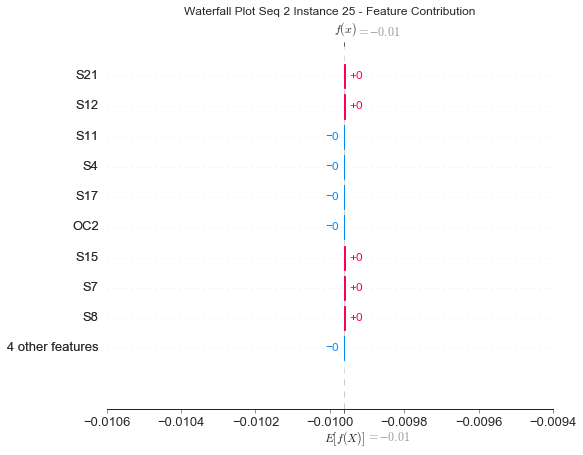

None

Contribution: [-1.45400049e-23  2.32417829e-23 -1.66440248e-23  8.28625569e-24
 -2.98998036e-23  3.28804562e-24 -3.31378260e-24 -1.44157688e-23
 -1.15527331e-23 -8.94663166e-24 -7.37388867e-23  8.47158121e-24
 -6.25088569e-24]


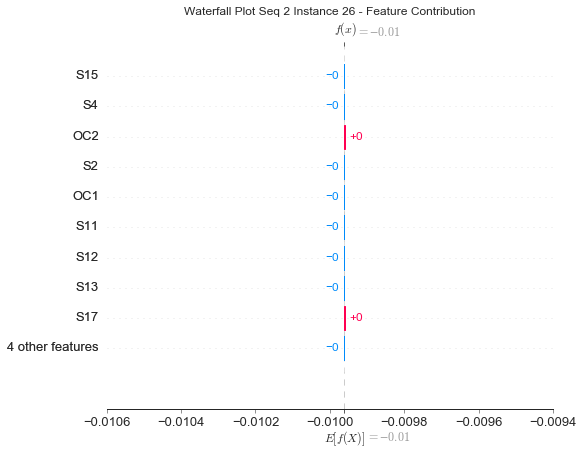

None

Contribution: [-2.04342190e-23  1.55617076e-22  3.79272056e-24  4.49873995e-23
  2.89305510e-22 -4.60572180e-23 -1.45864799e-22  3.80518581e-22
 -1.37102978e-22 -8.60322237e-23 -5.53549175e-22  1.82984239e-22
 -1.26002329e-22]


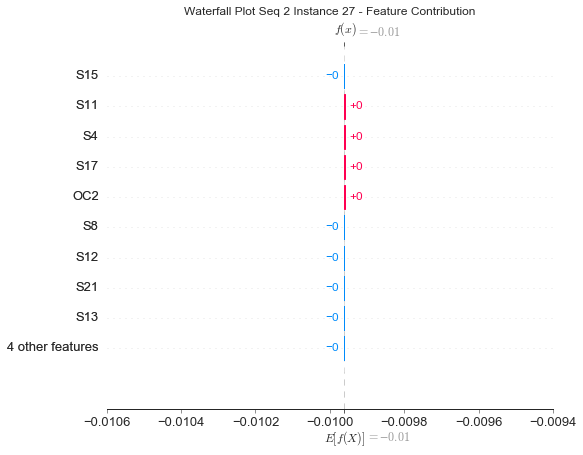

None

Contribution: [ 1.82020819e-23  2.46144166e-22 -2.88782855e-23  2.43061803e-23
  2.73158449e-22 -1.39536645e-22 -6.41595089e-23  2.44842533e-22
 -2.97543970e-22 -3.37710959e-24 -2.70810042e-22  1.89957226e-22
 -2.89731268e-22]


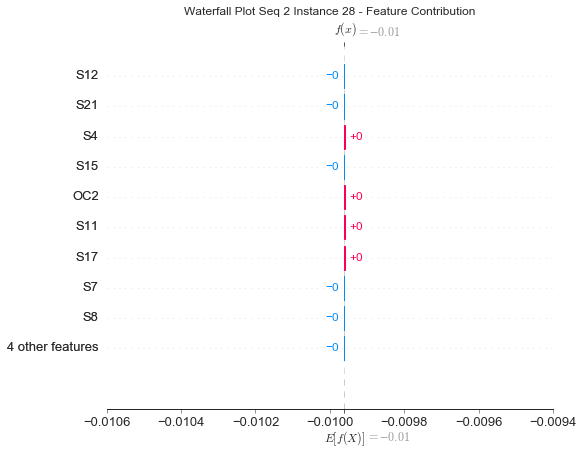

None

Contribution: [ 1.57703077e-23 -1.42461514e-22  3.06068628e-23 -1.61989668e-23
 -1.71843932e-22  7.82214531e-23  1.76669833e-23 -3.72942450e-23
  2.12905253e-22 -2.76958398e-23  4.66287919e-23 -1.27106192e-22
  2.16497738e-22]


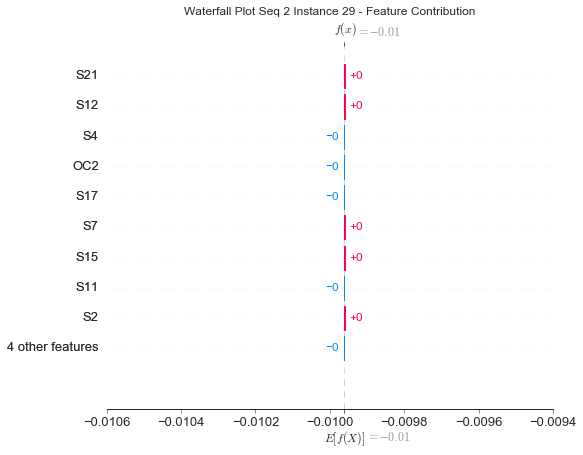

None

Contribution: [ 7.45161324e-24 -3.96369504e-23  3.99962324e-23  4.70968798e-23
  2.47785047e-22 -6.63090981e-23 -1.87540093e-22  3.29080029e-22
 -1.42375169e-22 -1.11386251e-22 -2.15653064e-22  2.24413888e-22
 -1.49346806e-22]


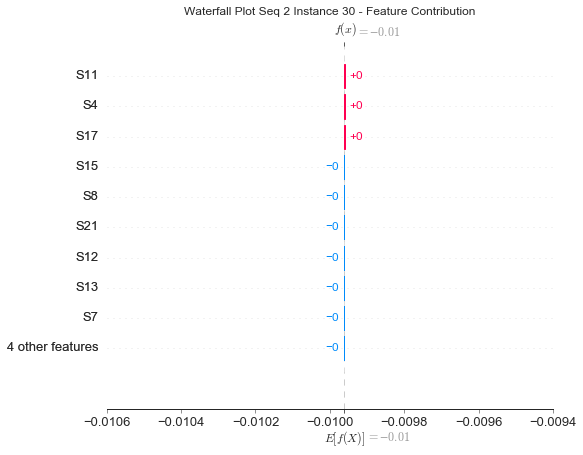

None

Contribution: [ 1.44411599e-24 -5.42895148e-23  3.10654592e-23  2.58327981e-23
  9.08260494e-23  1.61865028e-23 -1.12469628e-22  2.53977012e-22
  5.26781686e-23 -9.39177909e-23 -3.03549461e-22  5.66768540e-23
  6.00793310e-23]


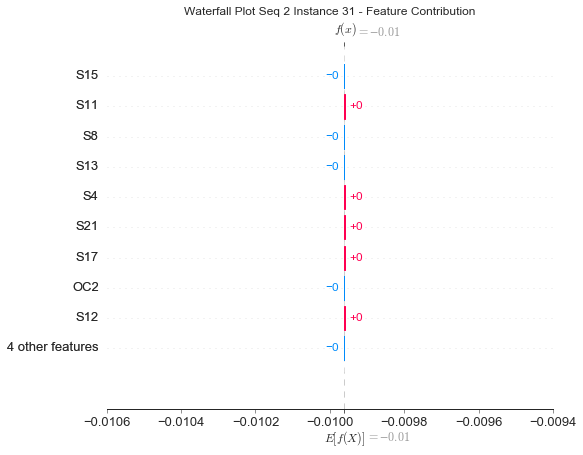

None

Contribution: [-4.79900723e-23 -2.64662430e-22  1.84163381e-23 -4.69561313e-23
 -5.21699692e-22  2.59088048e-22  1.48700154e-22 -4.24782690e-22
  5.32376855e-22 -1.04488595e-23  2.61122476e-22 -3.90894084e-22
  5.48949397e-22]


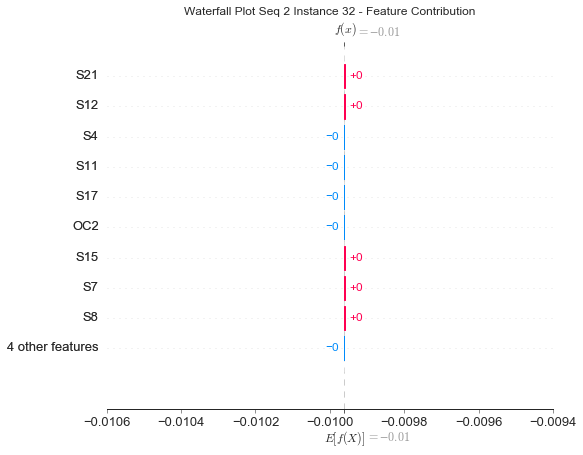

None

Contribution: [-1.27354738e-23 -6.56077313e-23  1.72641452e-23  1.57802931e-23
  6.30010864e-24  3.97329643e-23 -7.47602533e-23  1.83237823e-22
  9.21936313e-23 -7.52474223e-23 -1.87751735e-22  1.43479552e-23
  1.04445783e-22]


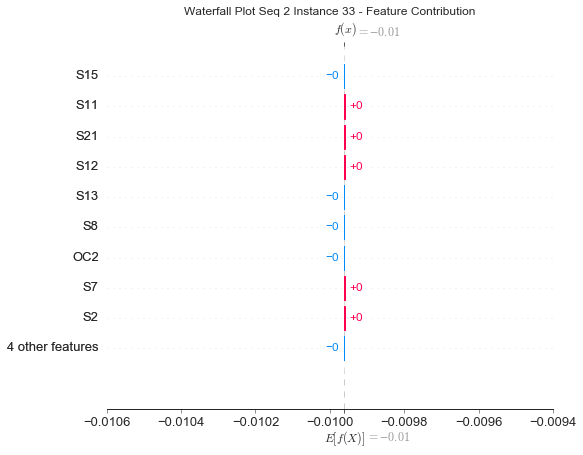

None

Contribution: [-2.62116028e-23 -7.27807363e-23 -6.22074316e-23  1.63564156e-23
 -1.93940532e-22  9.32818933e-23  1.17570023e-23 -5.01318202e-23
  1.72678724e-22 -1.83847000e-23  3.42296844e-23 -7.97859473e-23
  1.87837488e-22]


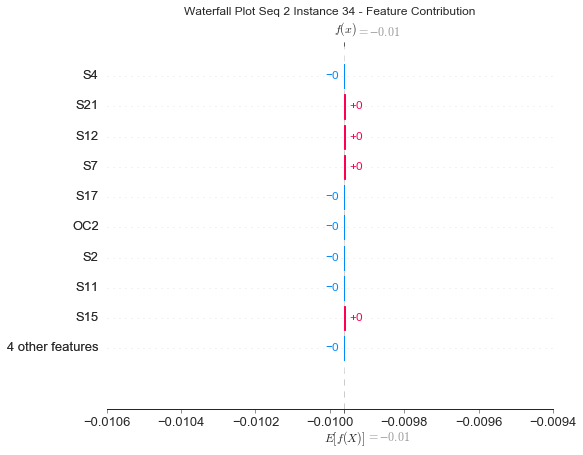

None

Contribution: [-1.30366435e-23  2.04593095e-22 -9.46670873e-24  4.70239512e-23
  5.05207122e-22 -1.50779491e-22 -1.78772933e-22  4.89378206e-22
 -3.54200717e-22 -5.86097210e-23 -5.22264895e-22  3.03633067e-22
 -3.34060228e-22]


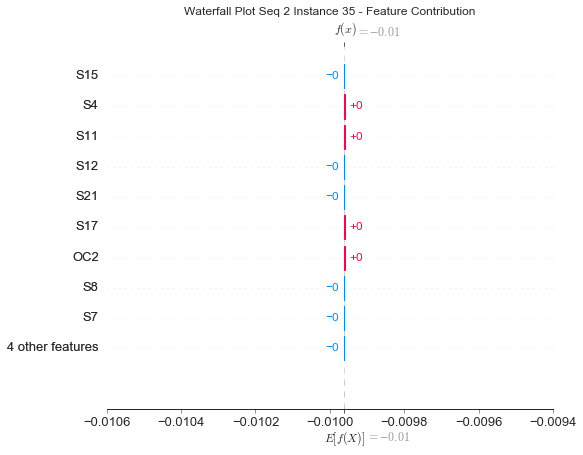

None

Contribution: [-1.98381841e-23 -1.03791622e-22  7.00633818e-23 -4.86899497e-23
 -1.06609440e-22  4.48364210e-23  8.60280585e-23 -2.13629137e-22
  1.25653892e-22  7.46151897e-24  1.40375753e-22 -1.59961011e-22
  1.39026839e-22]


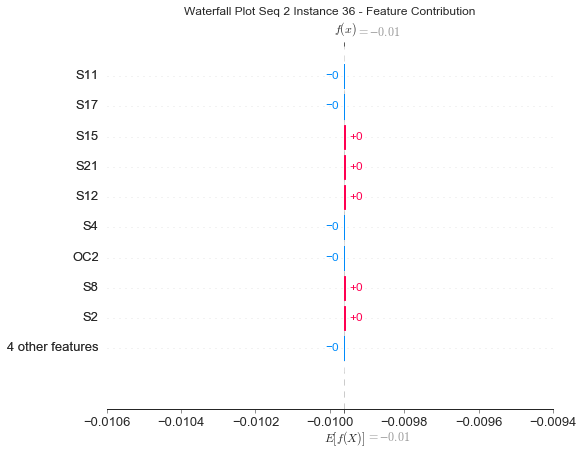

None

Contribution: [-4.71316633e-25 -4.46560495e-23 -1.02230706e-22  3.97832052e-23
 -2.31466330e-22  8.91360190e-23  2.18633336e-23 -6.07171219e-23
  1.61098397e-22  8.13009578e-23  7.89262846e-23 -7.89907818e-23
  1.34350901e-22]


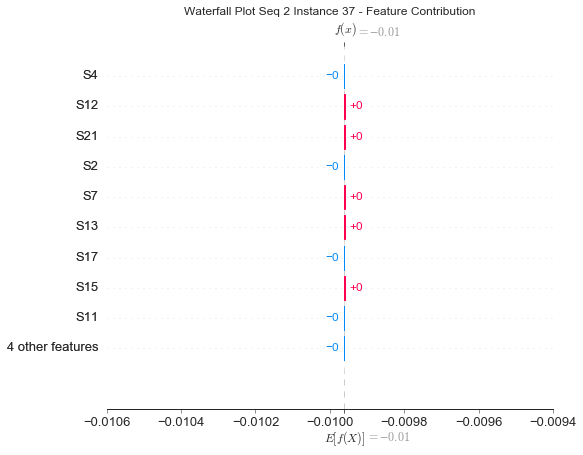

None

Contribution: [ 7.85804621e-24  1.60651725e-22 -1.03006276e-22  8.52741473e-23
  3.36947585e-22 -1.00210541e-22 -2.31221998e-22  5.41586712e-22
 -2.70891301e-22 -8.54604321e-23 -4.95097233e-22  3.33572699e-22
 -2.48620003e-22]


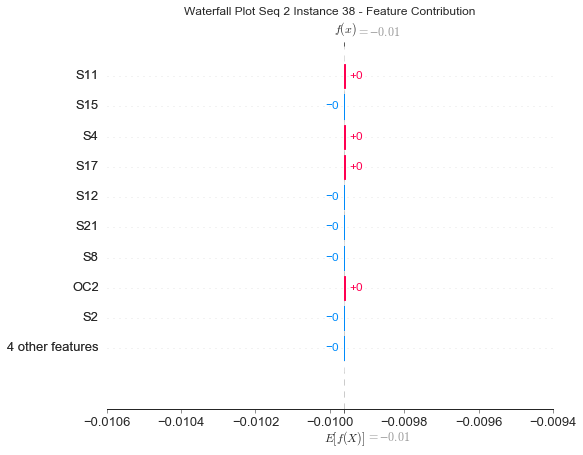

None

Contribution: [ 1.50098300e-23  1.27871773e-23 -1.52962693e-24  1.29731868e-23
  1.21444770e-22 -2.90627875e-23 -7.12122347e-23  1.68449483e-22
 -6.52601971e-23 -5.60865399e-23 -1.27069538e-22  1.08975871e-22
 -7.42761389e-23]


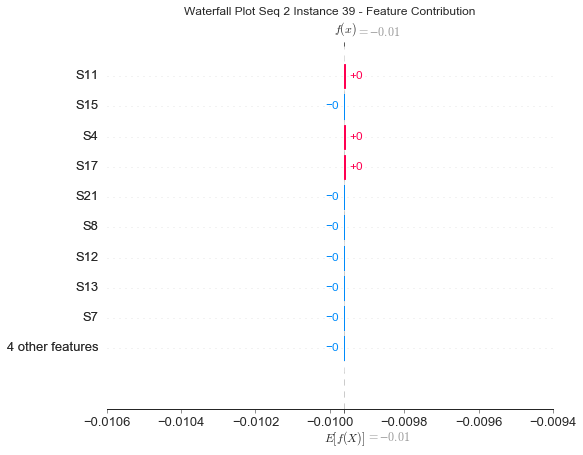

None

Contribution: [-1.91471905e-24 -5.73228490e-23 -1.54201591e-23 -1.80722874e-23
 -1.07081052e-22  4.73518870e-23  2.77569797e-23 -9.57944216e-23
  8.81401989e-23 -5.27326773e-24  4.09616025e-23 -7.78505307e-23
  8.53676242e-23]


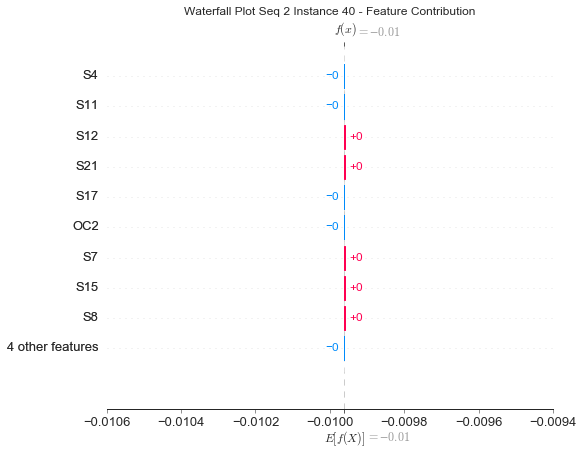

None

Contribution: [ 1.01538405e-23 -4.72126657e-23  1.54084313e-22 -4.61310112e-23
 -1.59616806e-23  5.31081230e-23 -1.83395377e-23  8.26202425e-24
  1.43232856e-22 -8.52007517e-23 -1.78661899e-22 -1.02912869e-22
  1.53705370e-22]


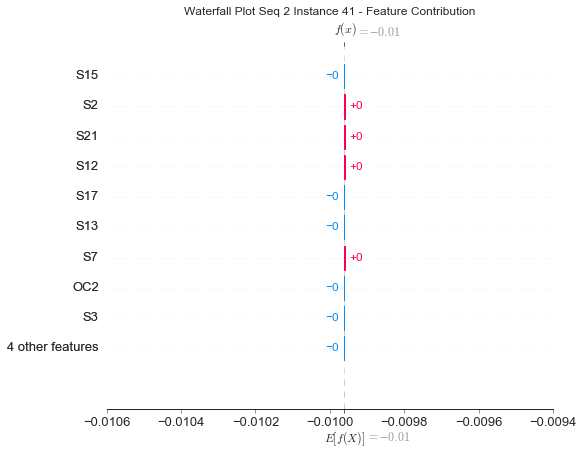

None

Contribution: [-1.55575576e-22  3.62323031e-22 -2.72808801e-22  1.53651904e-22
  5.68540057e-22 -1.73152040e-22 -1.91052531e-22  5.98781121e-22
 -5.87857127e-22 -4.51604369e-24 -5.32363628e-22  5.22658240e-22
 -4.98416608e-22]


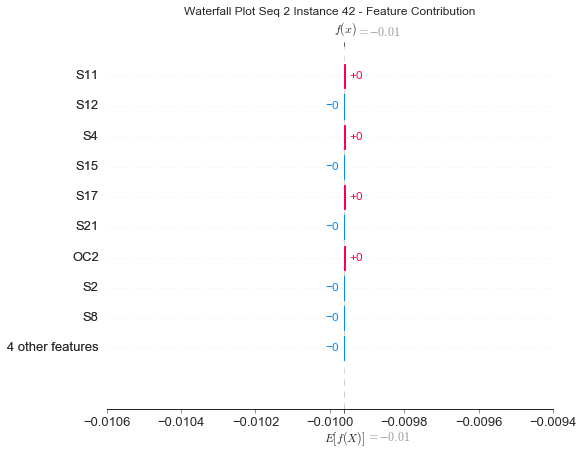

None

Contribution: [-8.27119776e-23 -6.18267829e-22  2.08945803e-22 -1.36309926e-22
 -6.02816151e-22  3.21857395e-22  3.06398776e-22 -8.82638569e-22
  7.32569911e-22  7.12101079e-23  7.94604267e-22 -5.74154323e-22
  6.98072986e-22]


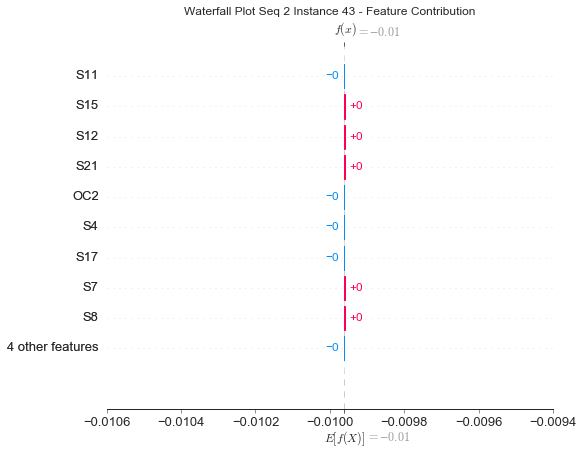

None

Contribution: [-9.14945553e-23 -1.98314091e-22 -2.97103729e-23  2.09605757e-22
  4.69607912e-22 -3.64809514e-24 -6.19650872e-22  1.19345572e-21
 -5.21714422e-23 -4.06390467e-22 -9.72982707e-22  4.86938467e-22
 -2.24074268e-23]


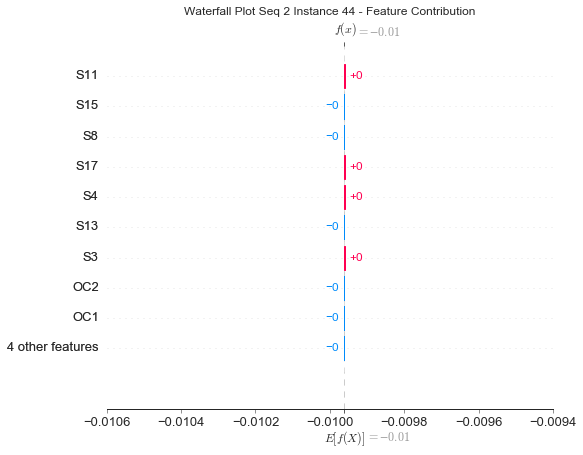

None

Contribution: [ 8.89159899e-23  2.21686600e-22 -4.46162436e-23  2.33628213e-22
  9.80404209e-22 -2.73551920e-22 -7.68112223e-22  1.57471813e-21
 -6.03351870e-22 -4.59174602e-22 -1.41782766e-21  9.20219145e-22
 -6.06378874e-22]


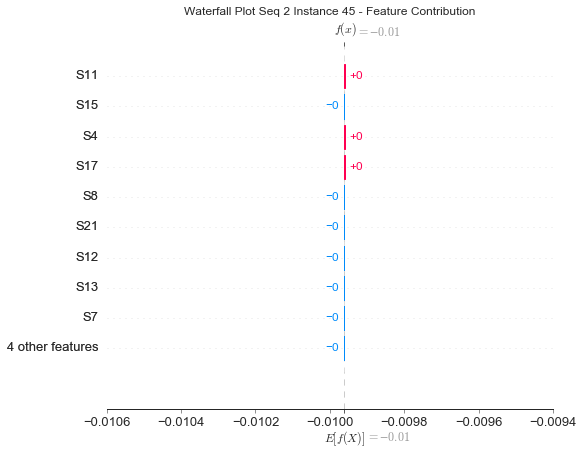

None

Contribution: [-1.00598075e-23  7.78222138e-23 -2.30577353e-22  3.51866648e-22
  9.77044999e-22 -1.05724729e-22 -8.21541709e-22  1.92407946e-21
 -3.62479087e-22 -4.22204314e-22 -1.91256113e-21  9.87377790e-22
 -3.10224764e-22]


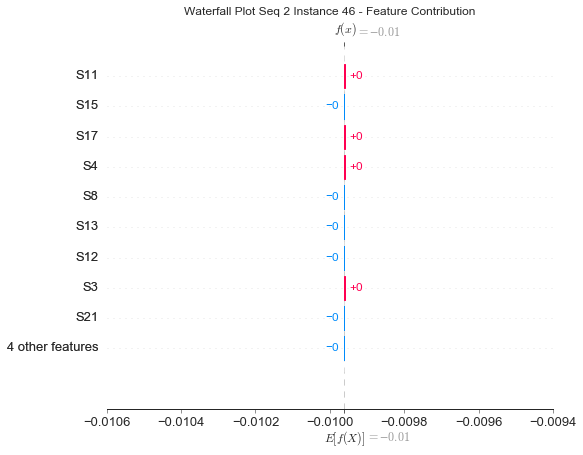

None

Contribution: [-8.49741719e-23 -4.65372449e-22  1.54455267e-22 -2.15774965e-22
 -1.01428459e-21  3.44322412e-22  6.06712291e-22 -1.44714249e-21
  8.06890454e-22  2.53630494e-22  1.16262578e-21 -9.17709937e-22
  7.69386870e-22]


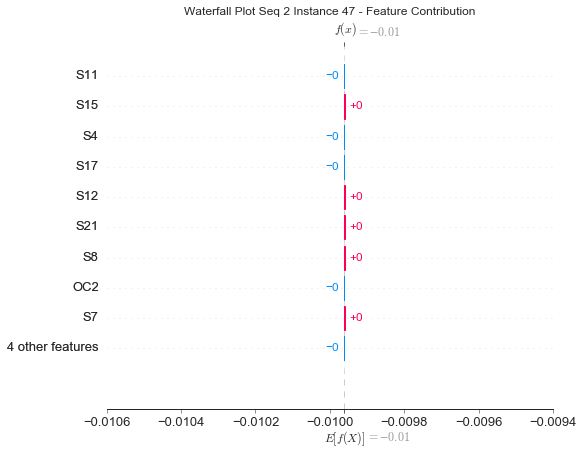

None

Contribution: [ 2.63267449e-23  4.75141046e-22 -2.31786494e-22  1.38262149e-22
  8.88172662e-22 -3.62928043e-22 -2.51199414e-22  7.37598931e-22
 -9.08068012e-22  3.60038831e-23 -3.99042020e-22  6.93831969e-22
 -9.39941728e-22]


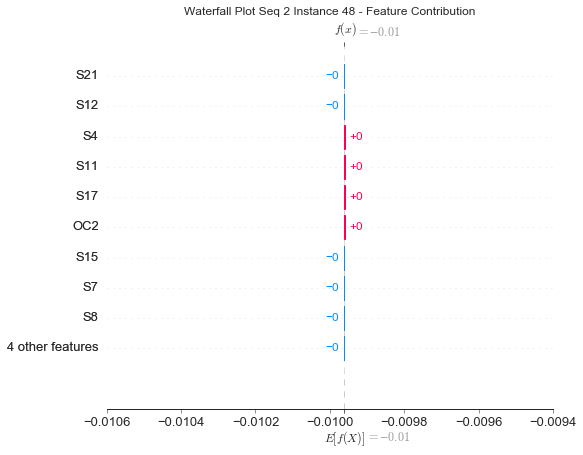

None

Contribution: [-1.58342155e-22  3.97366934e-22 -1.90323902e-22  1.26608831e-23
  4.70815008e-22 -1.95463917e-22  5.76180787e-23 -5.75708732e-23
 -6.27098779e-22  1.44573490e-22  3.89705315e-22  3.14886843e-22
 -6.13098959e-22]


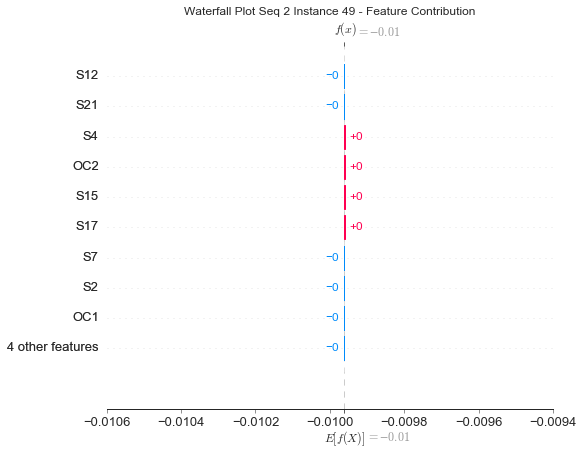

None

Contribution: [-1.81909747e-22 -1.32859201e-21  1.49520709e-22 -1.98272628e-22
 -1.71542901e-21  7.14725802e-22  7.20231117e-22 -2.14469414e-21
  1.55254904e-21  3.20464204e-22  1.91119374e-21 -1.24634782e-21
  1.53196465e-21]


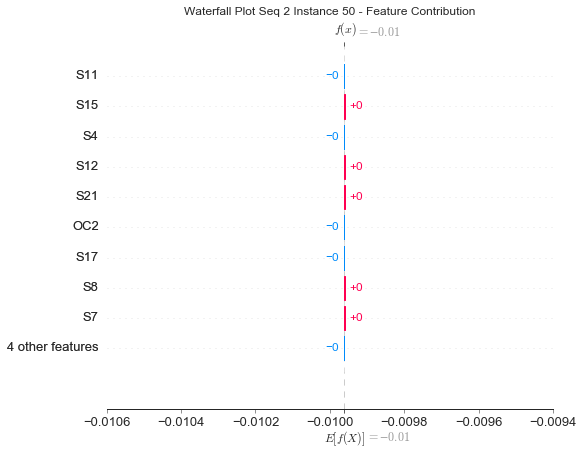

None

Contribution: [ 1.30869020e-22  1.46287351e-22 -5.35793443e-23 -1.19014246e-22
 -2.64028009e-22 -3.16352566e-23  4.28237573e-22 -8.36106883e-22
 -9.90520637e-23  3.08626544e-22  7.76904248e-22 -2.16815731e-22
 -1.41595648e-22]


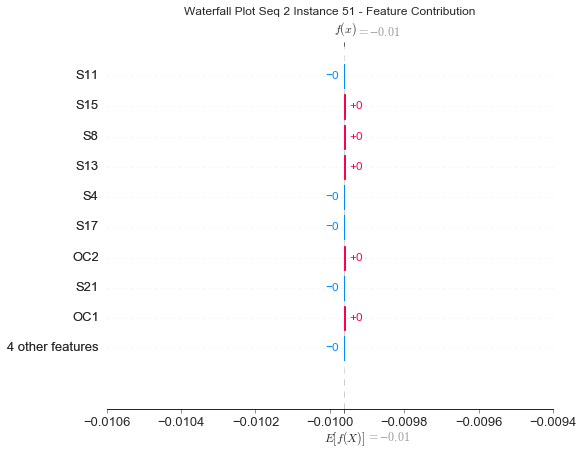

None

Contribution: [-1.34575963e-23 -4.99050669e-23  8.58139301e-23 -1.36850795e-22
 -3.06377041e-22  5.73020421e-23  3.40721899e-22 -7.73570736e-22
  1.35687143e-22  1.90186703e-22  7.83353924e-22 -3.24752754e-22
  9.32655923e-23]


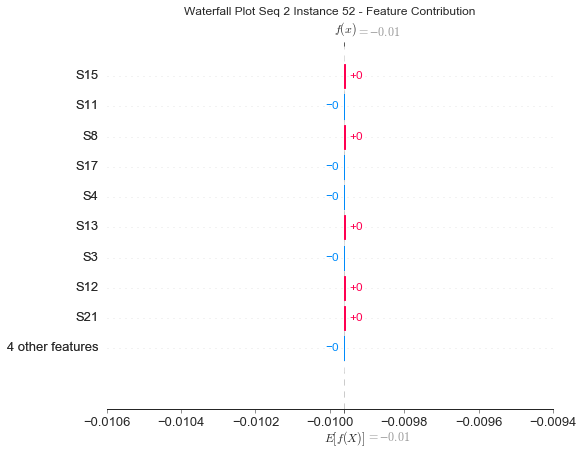

None

Contribution: [ 1.93152403e-22  6.66404348e-22 -4.13316824e-23 -3.99366134e-23
  5.75712254e-22 -4.61181060e-22  8.57904662e-23 -1.79959904e-23
 -9.53415220e-22  2.52874828e-22 -6.15107286e-23  3.45396449e-22
 -1.01220492e-21]


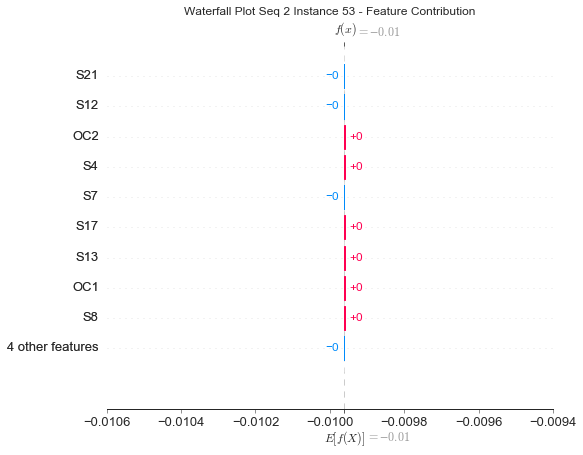

None

Contribution: [ 8.75718656e-23 -2.93692284e-23  4.06846871e-23 -1.61780617e-22
 -3.06518304e-22  3.92324131e-23  1.98283962e-22 -4.35902473e-22
  2.18908598e-22  1.18148884e-22  5.48440588e-22 -3.46752432e-22
  2.13861857e-22]


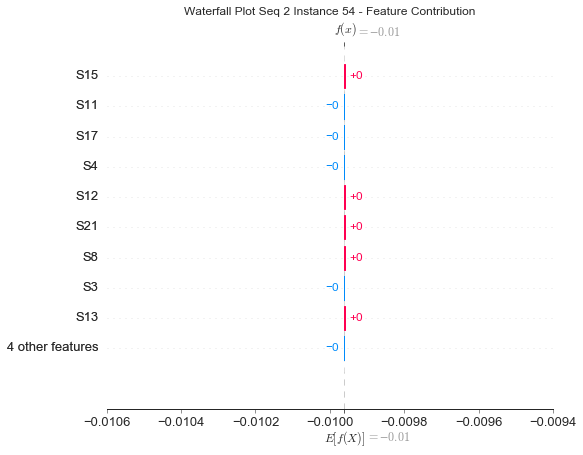

None

Contribution: [ 6.61973575e-24 -9.17762746e-22  6.57019592e-23 -3.47074842e-22
 -2.05725453e-21  6.15483617e-22  7.65920780e-22 -2.02744573e-21
  1.46485639e-21  3.54268673e-22  2.06794628e-21 -1.37113093e-21
  1.31457599e-21]


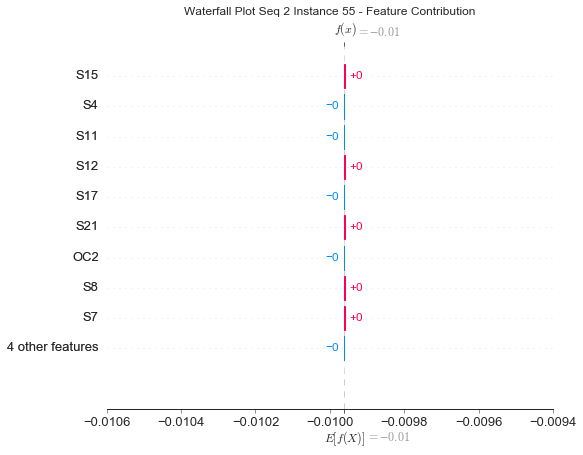

None

Contribution: [-4.23039648e-22 -7.24368686e-22  8.79014517e-23  5.23765877e-22
  3.40174675e-21 -1.11966530e-21 -2.47597755e-21  5.07813206e-21
 -2.14531433e-21 -2.06894774e-21  7.04802008e-22  2.54261103e-21
 -1.99007094e-21]


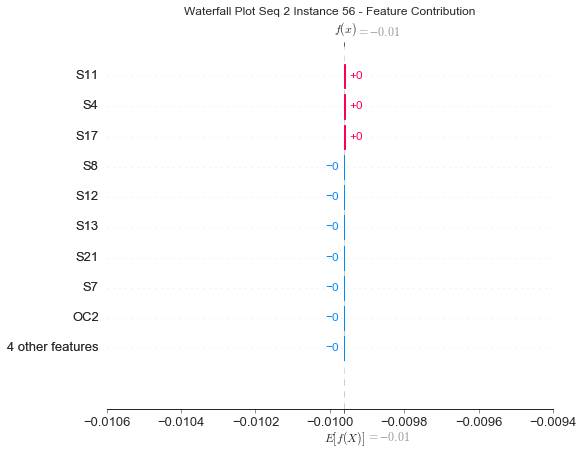

None

Contribution: [-1.70585342e-21 -1.88216911e-21  3.27836677e-23  2.47897709e-22
  1.67638188e-21 -4.23573726e-22 -2.10239908e-21  3.55862430e-21
 -6.43782998e-22 -2.35975121e-21  1.25813060e-21  1.32586389e-21
 -7.38518453e-22]


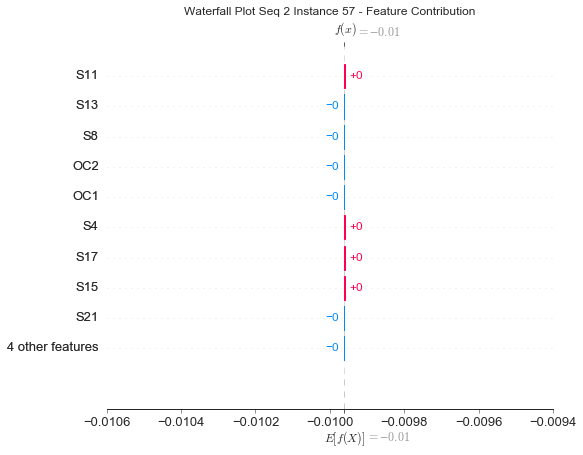

None

Contribution: [-1.81607806e-21 -1.87970271e-21  2.71562804e-22 -1.69174124e-22
 -2.13301552e-22  1.28364014e-22  1.83864216e-22 -2.46472332e-22
  3.15178785e-22 -1.96956076e-22  4.11002620e-21 -3.74738566e-22
  3.19672692e-22]


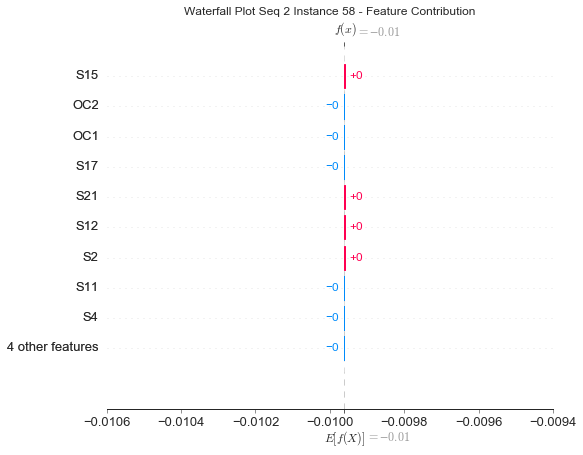

None

Contribution: [-1.67983621e-21 -2.95817235e-21  4.29241610e-22 -3.86233083e-23
  6.24676509e-22  1.90116425e-22 -2.00275532e-21  2.86183328e-21
  5.42844901e-22 -2.65406736e-21  2.72560132e-21  3.85446324e-22
  4.82004868e-22]


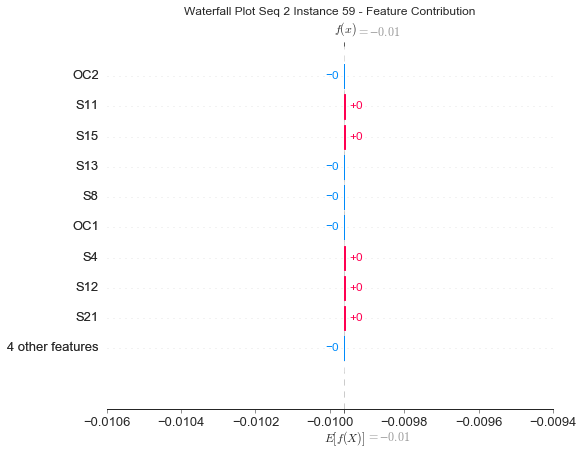

None

Contribution: [-1.70109390e-21 -2.55446177e-21  1.59140369e-22  7.68208337e-23
  1.11998680e-21 -1.29645061e-22 -2.15839069e-21  3.32092841e-21
 -1.61626164e-22 -2.65137034e-21  2.53029682e-21  9.49346970e-22
 -6.42684033e-23]


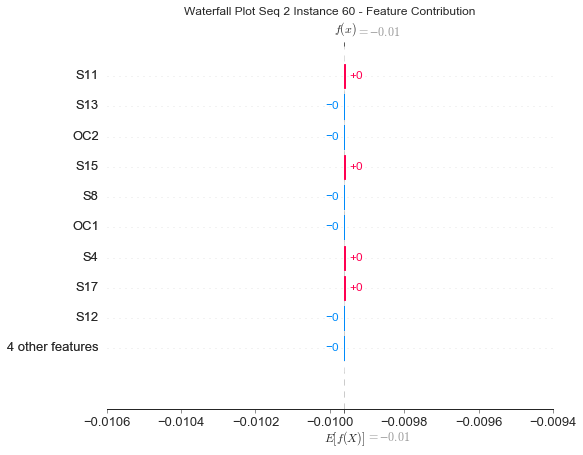

None

Contribution: [-1.18502044e-21 -2.47962656e-21  3.11884956e-22 -2.81329256e-22
  1.98362435e-21 -9.59380776e-22 -1.93349187e-21  2.98196046e-21
 -1.63275093e-21 -2.14723465e-21  3.28454781e-21  1.40475241e-21
 -1.38327550e-21]


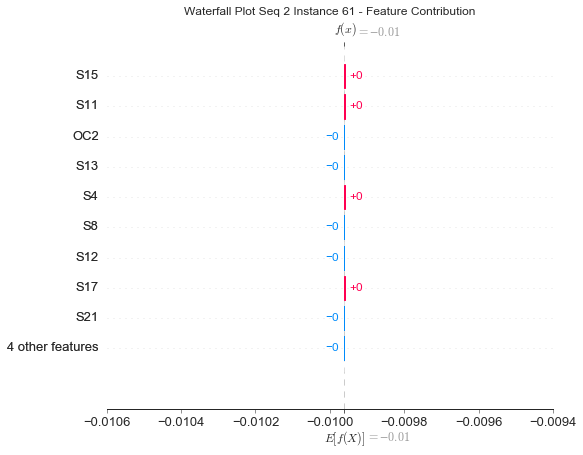

None

Contribution: [-1.80254631e-21 -2.59594742e-21  9.48503229e-22 -7.18214562e-22
  1.26318325e-21 -2.54862404e-22 -1.14551711e-21  2.15957855e-21
 -2.13251948e-22 -2.17303942e-21  3.06498528e-21  4.49712512e-22
  2.59533168e-22]


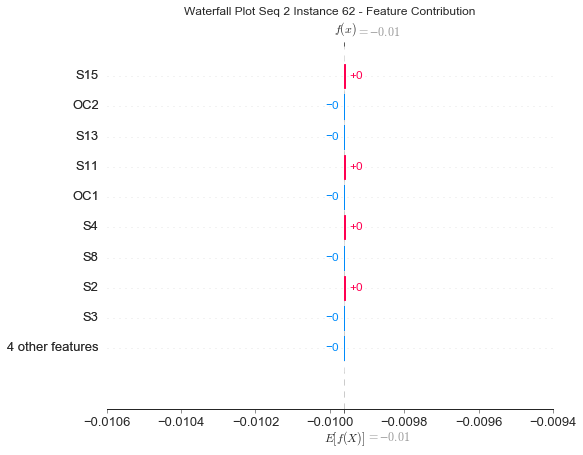

None

Contribution: [-1.28043530e-21 -2.54103846e-21  4.26469868e-22 -2.22461300e-22
 -1.00898200e-22  6.50642074e-22  6.39186451e-22 -1.31319819e-22
  1.00076374e-21  9.19670641e-23  4.38075256e-21 -2.29109441e-22
  1.39884037e-21]


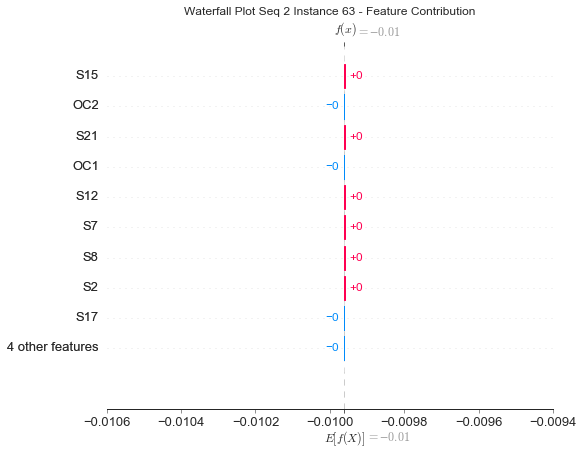

None

Contribution: [ 1.64615525e-21  2.83857826e-22 -6.06114524e-22 -2.05552300e-22
  5.34734259e-21 -2.68670525e-21 -3.92894272e-21  7.49301881e-21
 -4.87883565e-21 -3.17431933e-21 -5.88408901e-22  4.34430371e-21
 -4.90568510e-21]


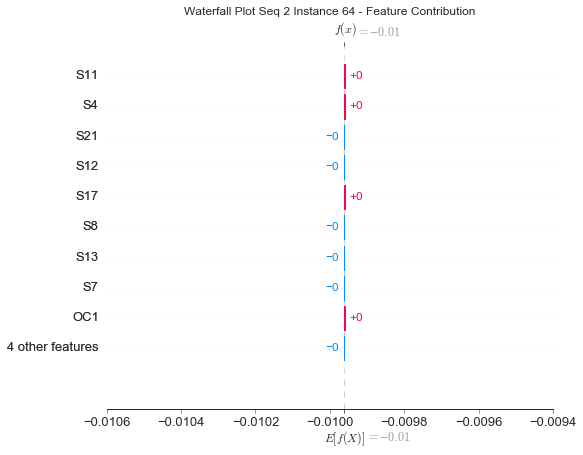

None

Contribution: [ 5.24621885e-22 -1.81056995e-22  8.57530831e-22 -1.21102947e-21
  9.16554287e-22 -5.29479148e-22  1.86152872e-22  3.13493980e-22
 -8.28905605e-22 -1.20575630e-21  2.65584678e-22 -2.04145515e-22
 -4.28790103e-22]


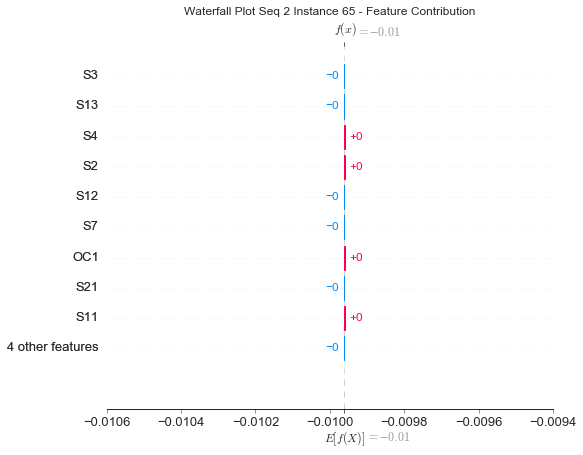

None

Contribution: [ 9.20375050e-22  2.57544708e-22  7.90526475e-22 -1.65130090e-21
 -1.31397696e-22 -7.13812945e-22  2.60589721e-21 -3.40458897e-21
 -1.37410522e-21  1.78080394e-21  2.47629300e-21 -6.44917494e-22
 -5.77717197e-22]


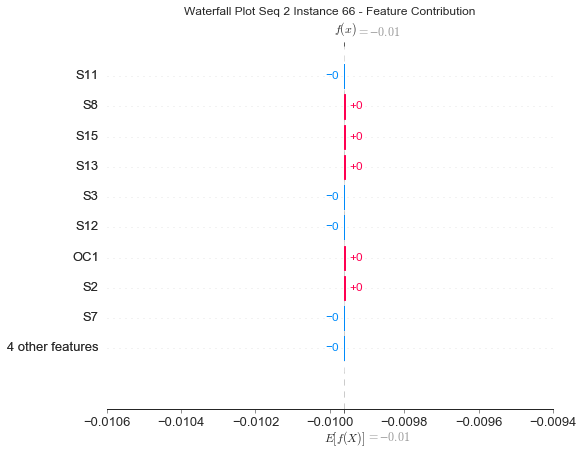

None

Contribution: [ 4.28637198e-21  2.51378613e-21  5.77827007e-22 -2.01806038e-21
  5.33933473e-22 -1.08091160e-21  3.90812588e-21 -4.39495277e-21
 -2.45750311e-21  3.40709797e-21  6.47561705e-22 -4.68046851e-22
 -1.45537087e-21]


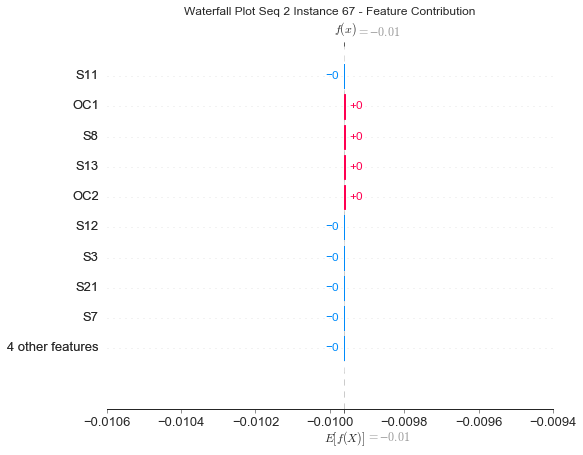

None

Contribution: [ 5.85648236e-21  4.16104685e-21 -1.89180836e-22 -1.96599506e-21
  4.30263973e-21 -2.11568082e-21  3.89459745e-22  1.14585517e-21
 -4.35076888e-21  1.39904090e-21 -4.89209155e-21  2.81965353e-21
 -3.41848261e-21]


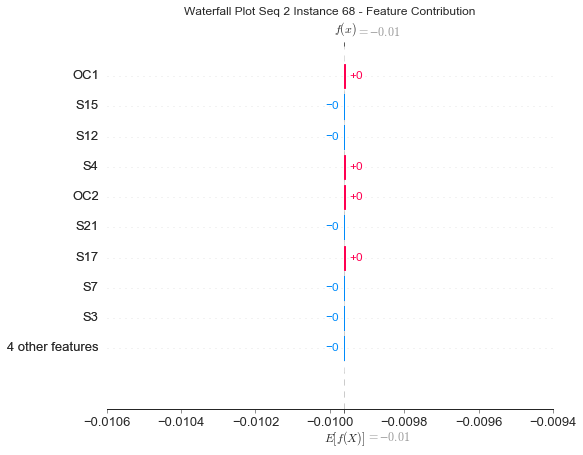

None

Contribution: [ 7.68718573e-21  5.15525211e-21  1.25774781e-21 -3.27668071e-21
 -3.74170182e-21  6.29716889e-22  8.12163326e-21 -1.29494769e-20
  5.23549691e-22  6.46900597e-21 -3.60701315e-21 -3.90368018e-21
  1.58491461e-21]


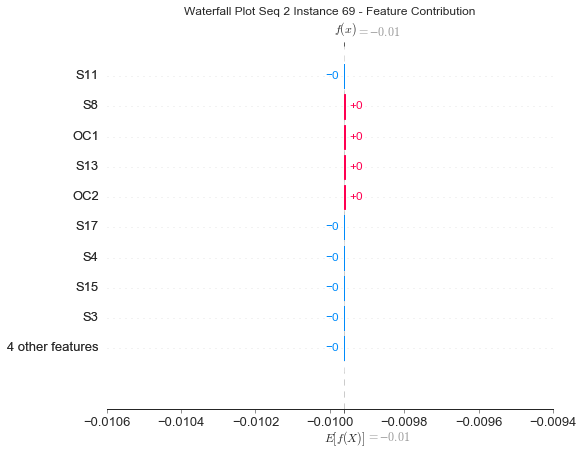

None

Contribution: [ 1.10789889e-20  9.03472191e-21  5.70435898e-22 -2.68250492e-21
 -2.77751599e-21  2.68793284e-22  7.93681252e-21 -1.15828655e-20
 -1.67922965e-22  7.19108415e-21 -7.34578228e-21 -3.07689640e-21
  1.41546557e-21]


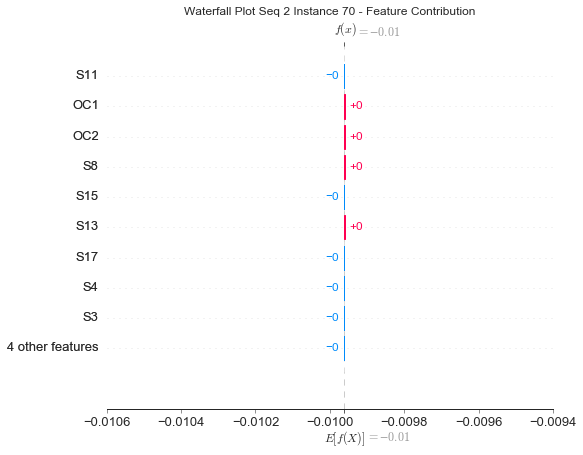

None

Contribution: [ 1.74587955e-20  1.15361767e-20 -1.06050704e-21 -2.80839955e-21
  1.33114383e-21 -2.56274084e-21  5.31950805e-21 -6.41762303e-21
 -5.68952233e-21  6.52279896e-21 -1.76653774e-20  1.35599904e-21
 -4.27464363e-21]


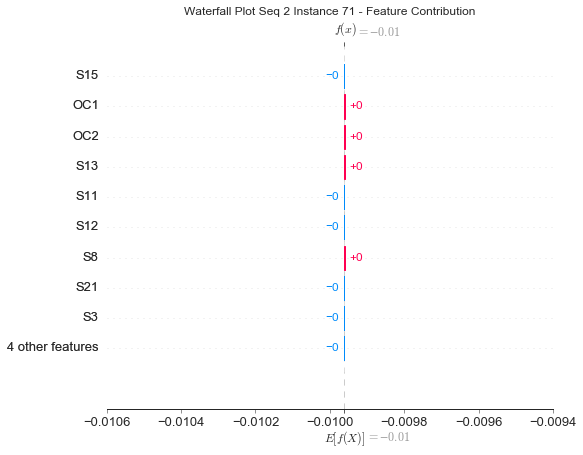

None

Contribution: [ 1.45013825e-20  1.66230991e-20 -6.21183963e-22 -4.33669510e-21
 -1.65711600e-21 -3.94409450e-21  9.20127683e-21 -1.58560426e-20
 -7.72736861e-21  1.17958144e-20 -1.88656504e-20 -1.71783886e-21
 -6.32044667e-21]


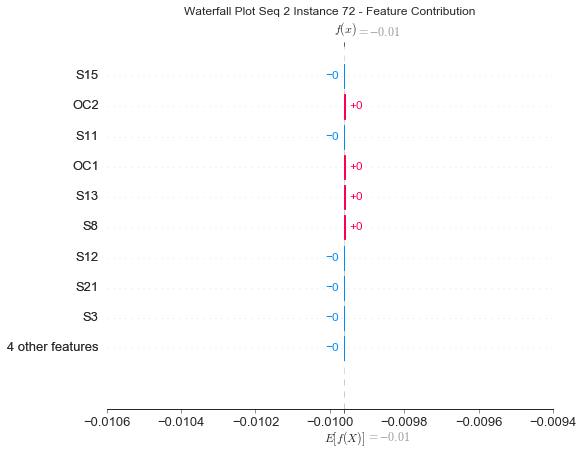

None

Contribution: [ 6.65054424e-21  8.39407861e-21  4.11063811e-21 -6.06842396e-21
 -3.73410848e-20  1.47472086e-20  3.05429623e-20 -5.88098532e-20
  2.75795878e-20  2.32515704e-20 -1.19580654e-20 -2.93231327e-20
  2.69444956e-20]


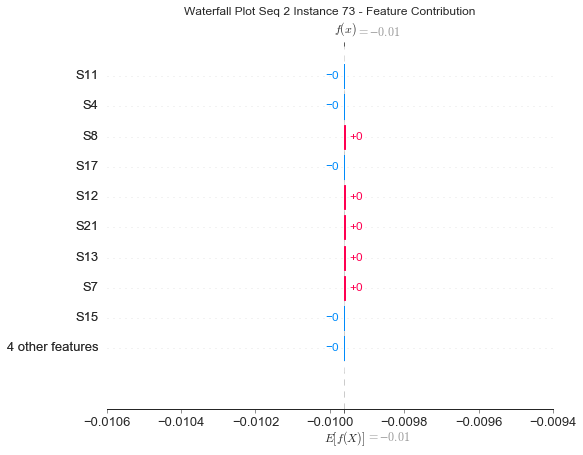

None

Contribution: [ 1.64047752e-20  1.57693195e-20  2.60734236e-21 -7.10429885e-21
 -3.05955529e-20  1.24425097e-20  3.42253766e-20 -6.08002049e-20
  2.13297504e-20  2.98145200e-20 -1.76067429e-20 -2.48762775e-20
  2.16839614e-20]


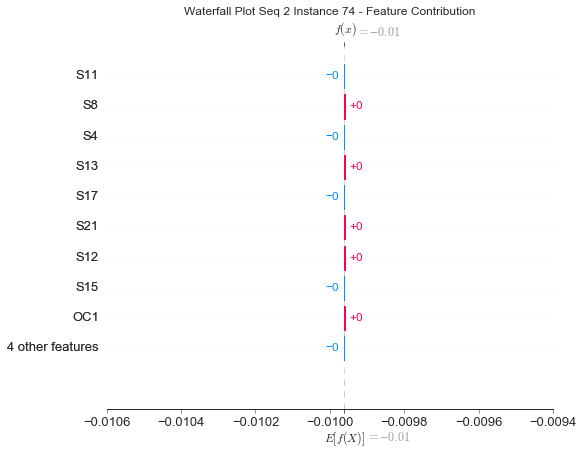

None

Contribution: [ 3.14998391e-20  2.70364516e-20  1.07692514e-21 -8.01516365e-21
 -1.82751775e-20  1.64017031e-21  2.92860291e-20 -4.91857942e-20
  2.12619587e-21  2.80540243e-20 -3.00137509e-20 -1.54342500e-20
  4.35091267e-21]


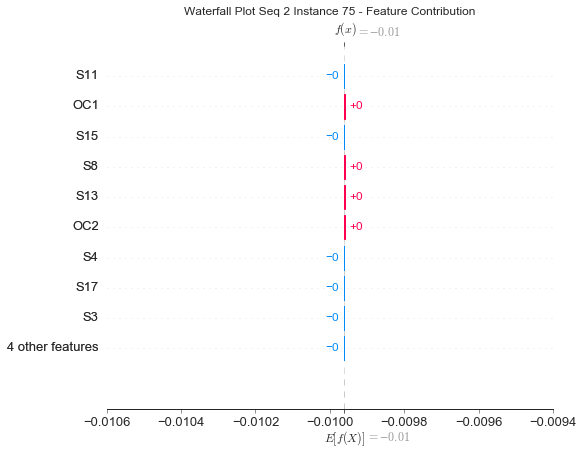

None

Contribution: [ 2.89687698e-20  3.46134923e-20  1.39214739e-21 -1.10294510e-20
 -3.11151936e-20  4.70286964e-22  4.21480802e-20 -7.61888791e-20
  1.02079076e-21  4.31553309e-20 -3.68171822e-20 -2.35031464e-20
  3.08319618e-21]


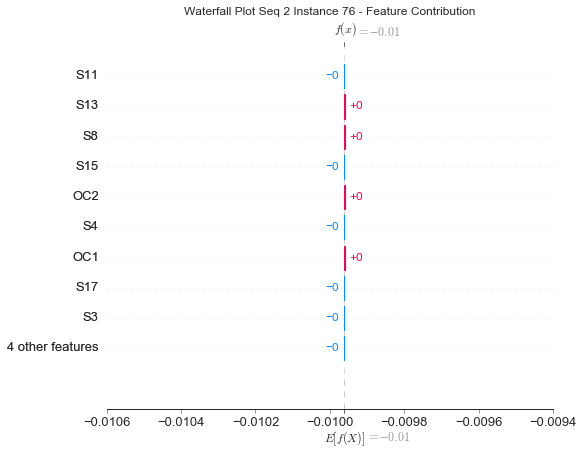

None

Contribution: [ 1.33511741e-20  1.85567404e-20  1.20375297e-20 -1.64190618e-20
 -8.09776539e-20  3.14948437e-20  6.83221782e-20 -1.30863114e-19
  5.87399888e-20  5.03538960e-20 -3.48140674e-20 -6.26887422e-20
  5.90725348e-20]


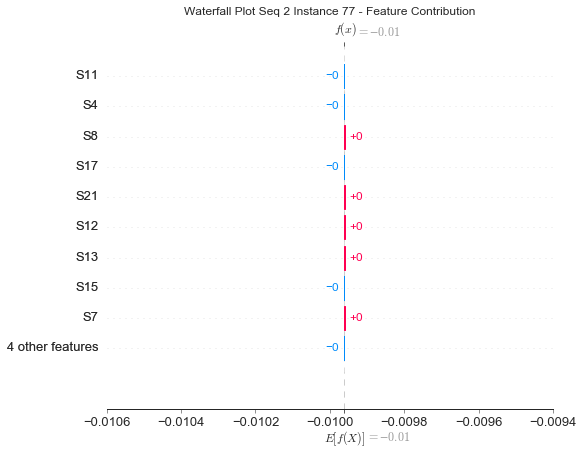

None

Contribution: [ 2.52233864e-20  3.22765617e-20  6.51358567e-21 -1.26795228e-20
 -7.34493215e-20  2.19752954e-20  6.19243110e-20 -1.19273189e-19
  4.34778053e-20  5.17062652e-20 -5.14309595e-20 -5.68460037e-20
  4.49802109e-20]


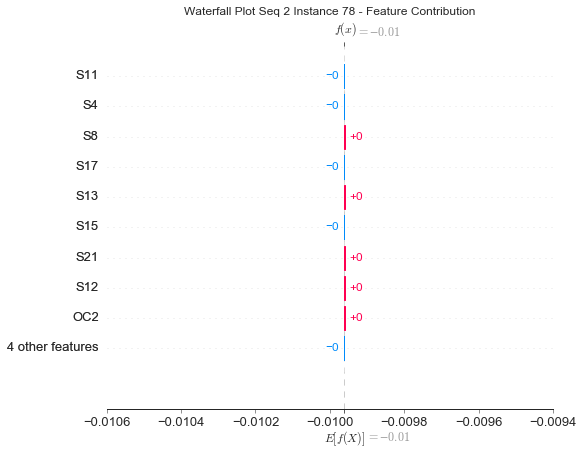

None

Contribution: [ 2.23728930e-20  3.41033577e-20  1.38505561e-20 -1.86194899e-20
 -1.09421442e-19  3.62289276e-20  1.01043356e-19 -1.85423417e-19
  6.77474105e-20  8.59886365e-20 -3.67795810e-20 -8.52759816e-20
  7.12693646e-20]


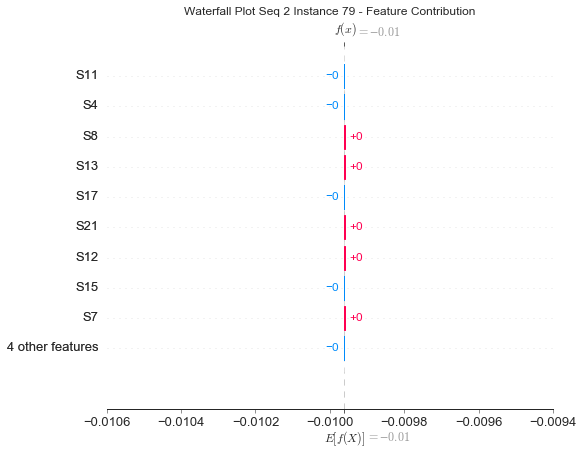

None

Contribution: [ 2.23808982e-20  4.27017613e-20  1.66236759e-20 -2.19562460e-20
 -1.14979475e-19  4.00368083e-20  1.08646671e-19 -1.99479658e-19
  7.19703097e-20  9.36999696e-20 -5.34874823e-20 -9.10170416e-20
  7.93633140e-20]


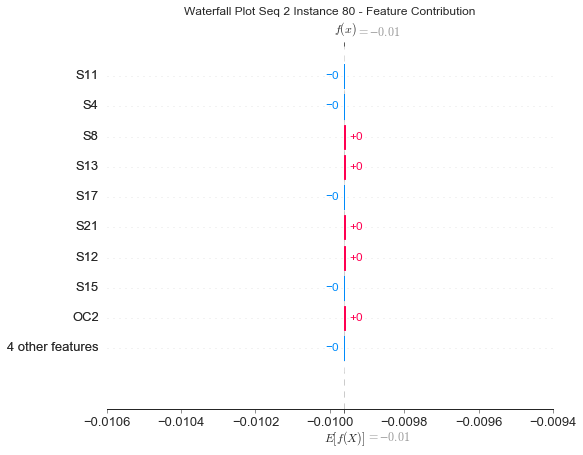

None

Contribution: [ 3.77617255e-20  5.35879428e-20  1.13764670e-20 -2.09931105e-20
 -1.27414378e-19  4.16718535e-20  1.25420175e-19 -2.22236289e-19
  7.47929407e-20  1.12105087e-19 -5.59481896e-20 -9.62843209e-20
  7.86157753e-20]


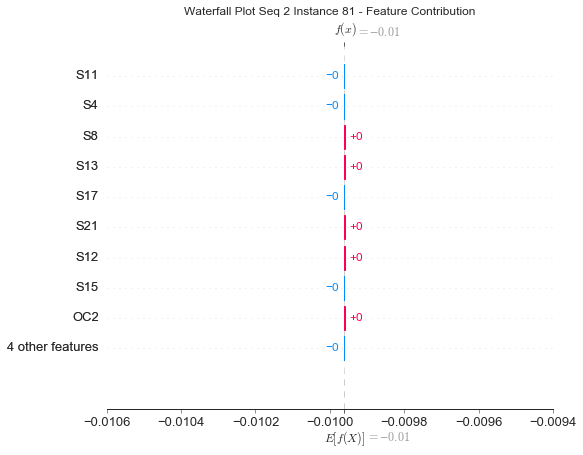

None

Contribution: [ 6.07670724e-20  6.45311384e-20  1.91297836e-21 -1.63259248e-20
 -1.68113874e-19  5.18449440e-20  1.44573684e-19 -2.61746519e-19
  1.02057395e-19  1.36065278e-19 -5.30830815e-20 -1.15428001e-19
  9.21902422e-20]


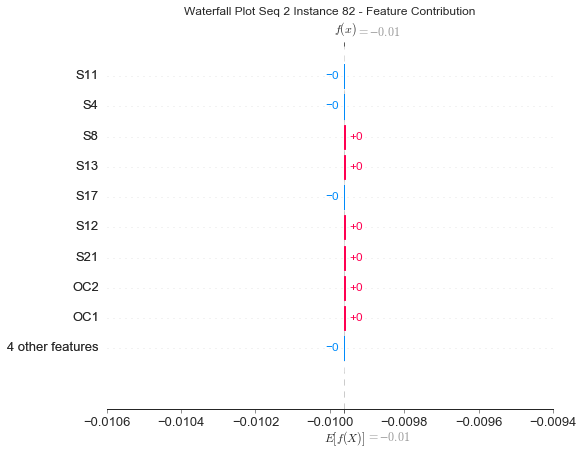

None

Contribution: [ 5.83792475e-20  9.10471109e-20  1.54000722e-20 -2.23158450e-20
 -1.42375296e-19  4.65661294e-20  1.42358662e-19 -2.43591404e-19
  8.46714224e-20  1.37030482e-19 -9.72210448e-20 -1.10340297e-19
  9.34842499e-20]


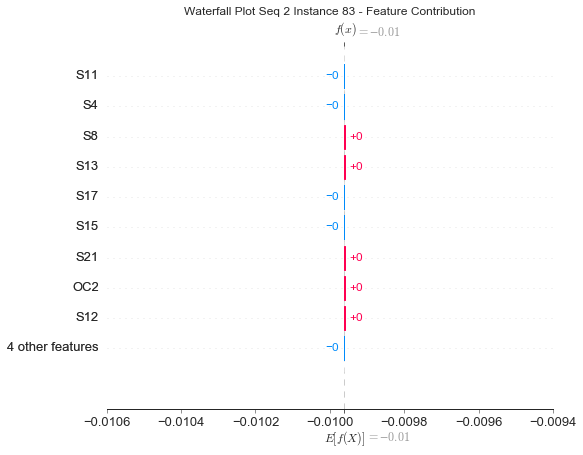

None

Contribution: [ 6.96559876e-20  7.22704341e-20  1.06167759e-20 -1.59281576e-20
 -1.33021215e-19  4.87212967e-20  1.20660939e-19 -2.20014016e-19
  8.48259630e-20  1.06623452e-19 -1.25208933e-19 -1.02592827e-19
  9.11406857e-20]


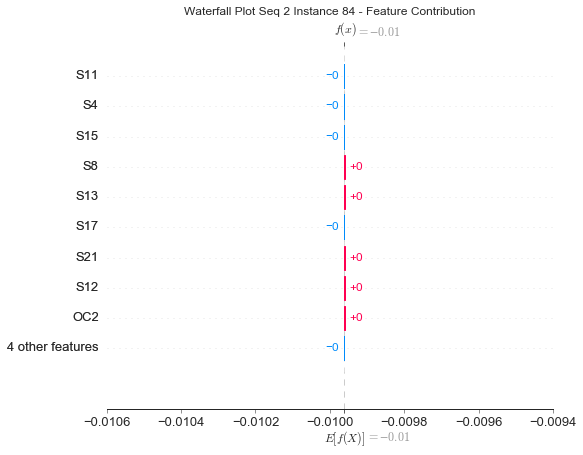

None

Contribution: [ 8.83390443e-20  1.39436117e-19 -1.18464411e-21 -2.17393663e-20
 -1.32189110e-19  1.80457965e-20  1.50307403e-19 -2.51866467e-19
  3.51678228e-20  1.41930325e-19 -1.67546738e-19 -1.05742046e-19
  4.08772561e-20]


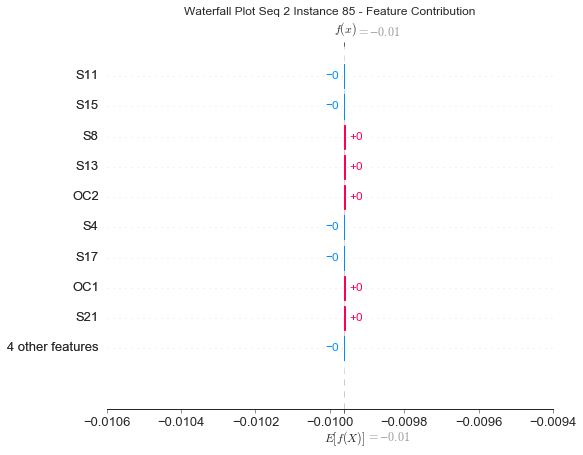

None

Contribution: [-2.94576658e-20  2.41141114e-20  3.30709265e-20 -2.25067331e-20
 -3.06937076e-19  1.33089031e-19  2.10908800e-19 -4.20579155e-19
  2.50419961e-19  1.58370643e-19 -1.09821048e-19 -2.28317540e-19
  2.49948804e-19]


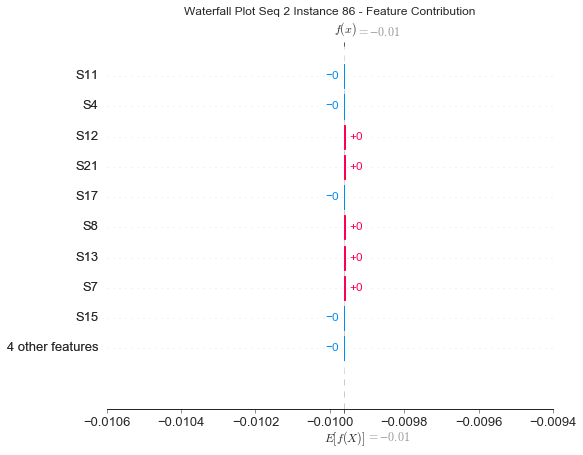

None

Contribution: [-8.04874589e-20  2.68461435e-20  5.59466063e-20 -3.57128056e-20
 -4.14367339e-19  1.84383276e-19  3.13771914e-19 -5.91415630e-19
  3.43602167e-19  2.21350766e-19 -9.39648418e-20 -3.28706014e-19
  3.44334351e-19]


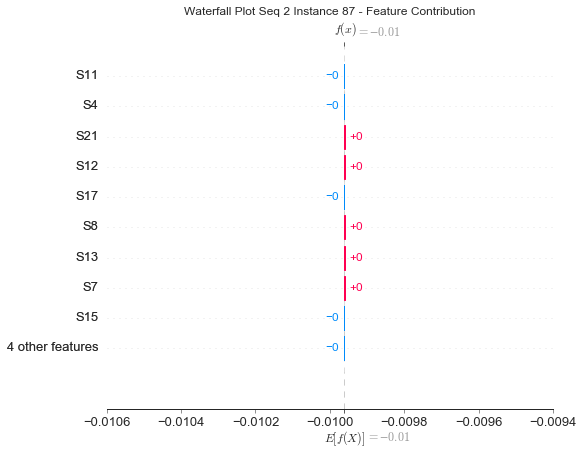

None

Contribution: [ 4.68472649e-21  1.71854527e-19  3.74841871e-20 -4.97705204e-20
 -3.68467320e-19  1.28363968e-19  4.19443333e-19 -6.77959970e-19
  2.34542668e-19  3.50989614e-19 -7.24868775e-20 -3.18820379e-19
  2.41545683e-19]


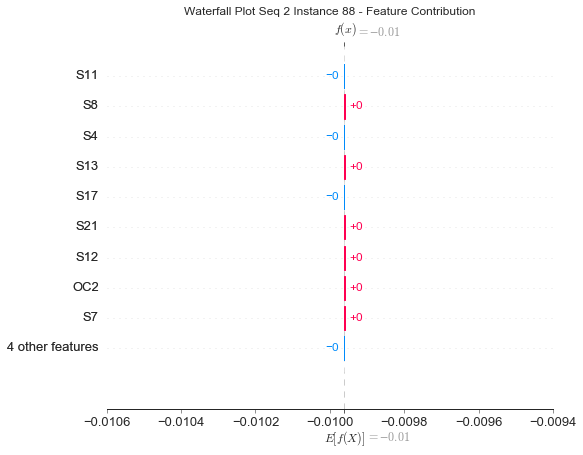

None

Contribution: [-1.28478040e-20  2.16695261e-20  5.56541075e-20 -1.89015455e-20
 -4.37308573e-19  2.37723927e-19  3.07157442e-19 -6.04275807e-19
  4.13407474e-19  2.41240401e-19 -7.32187579e-20 -3.43678810e-19
  4.12488657e-19]


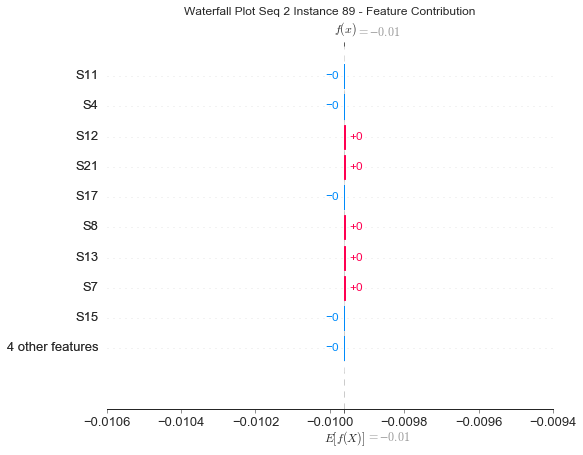

None

Contribution: [ 1.93745267e-19  3.75620338e-19 -5.70699499e-20 -5.64603679e-21
  2.15747949e-19 -1.88274515e-19 -4.92097275e-20  1.74651018e-19
 -3.25927747e-19  4.73474273e-20 -5.38326713e-19  1.61310469e-19
 -3.00691423e-19]


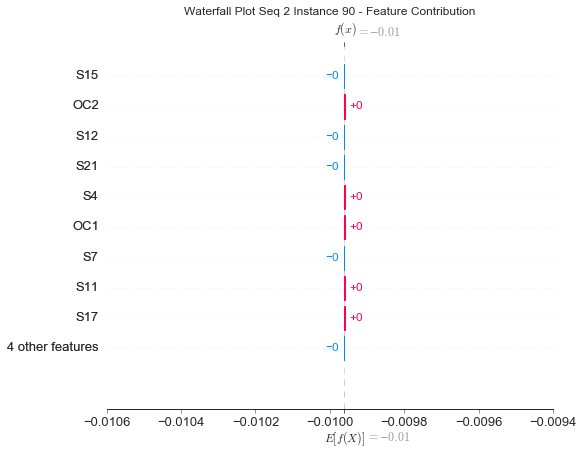

None

Contribution: [-1.60705826e-19  1.07408782e-19  1.17835523e-19 -6.19835837e-20
 -5.80787031e-19  2.94709279e-19  5.20003473e-19 -8.82506795e-19
  5.33693984e-19  3.21806294e-19 -1.79513664e-19 -5.35364889e-19
  5.46692352e-19]


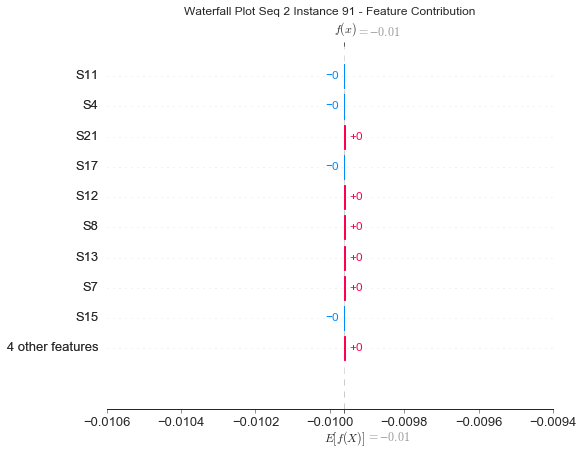

None

Contribution: [ 8.39268759e-21 -4.55621825e-21  5.68893272e-20 -5.34683893e-21
 -5.94592314e-19  2.55345795e-19  4.08131043e-19 -7.69913503e-19
  4.82506135e-19  3.07146999e-19  4.10242745e-20 -4.25350566e-19
  4.64325894e-19]


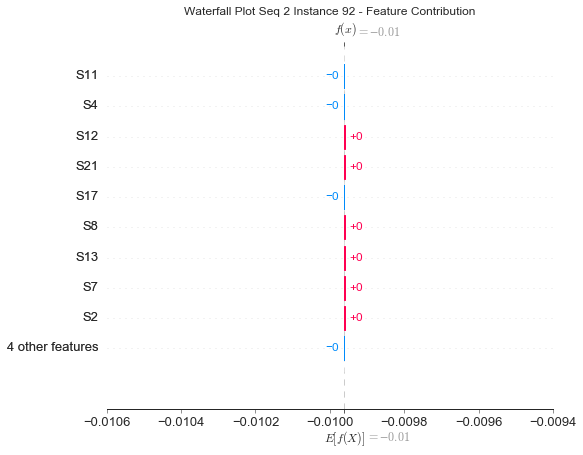

None

Contribution: [ 9.32655963e-20  2.34055359e-20 -2.41893279e-21  2.10495122e-20
 -5.30019079e-20 -4.42060215e-20 -3.82559886e-20 -6.20364069e-20
 -3.84831918e-20 -3.63792999e-20 -2.80317965e-19  5.36256667e-21
 -4.50056176e-20]


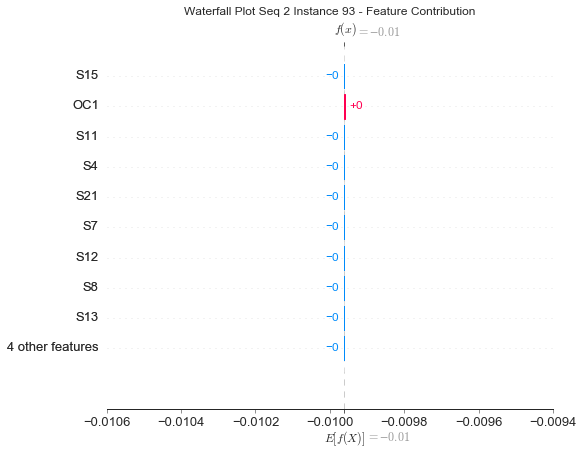

None

Contribution: [-1.45252670e-19  3.34808138e-20  6.98474023e-20 -3.42203909e-20
 -9.18827778e-19  3.85284754e-19  9.56185116e-19 -1.58603942e-18
  6.75135097e-19  7.87425795e-19  3.67720634e-19 -7.51148962e-19
  6.52375481e-19]


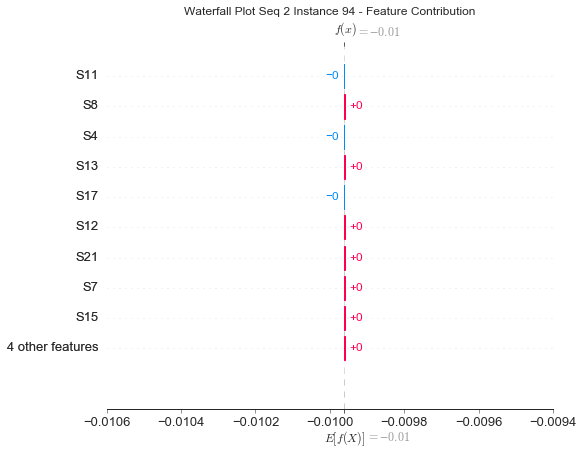

None

Contribution: [ 1.51289686e-20 -8.62147573e-21 -4.63911710e-20  6.83165818e-20
 -2.51800499e-19  7.73484442e-20  7.11576047e-20 -2.12566211e-19
  1.34566466e-19  1.00697291e-19 -1.20734623e-19 -1.08851695e-19
  1.13569055e-19]


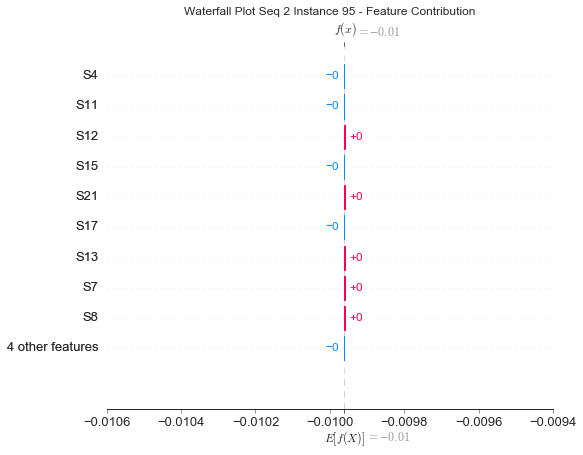

None

Contribution: [ 3.75379538e-20 -1.68873526e-20  1.36575063e-23  5.43114447e-20
 -4.44578353e-19  1.45394493e-19  1.53888229e-19 -4.14223513e-19
  3.09617270e-19  1.08728601e-19 -4.78731038e-20 -2.59482681e-19
  2.25167636e-19]


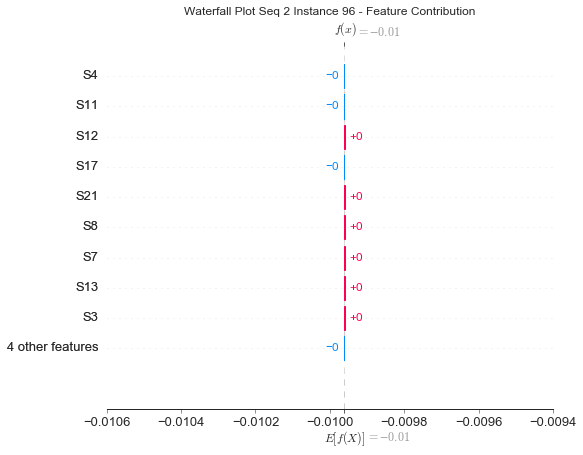

None

Contribution: [-1.49595317e-19 -3.88251825e-19  4.88111395e-20  4.07916881e-20
 -4.67125694e-19  2.71692745e-19  2.42864829e-19 -5.77658375e-19
  5.25714638e-19  1.71471374e-19  2.65686225e-19 -3.01640949e-19
  4.31113352e-19]


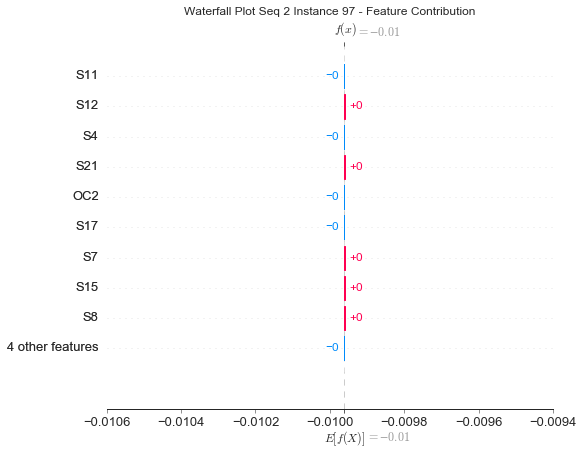

None

Contribution: [ 1.25906634e-19  5.02457732e-19 -1.27005751e-19  3.36379168e-20
  9.11670585e-20 -3.64980340e-19  3.06675248e-19 -3.45590709e-19
 -5.92261474e-19  6.19216808e-19  1.72463061e-19  1.21122144e-19
 -6.22261557e-19]


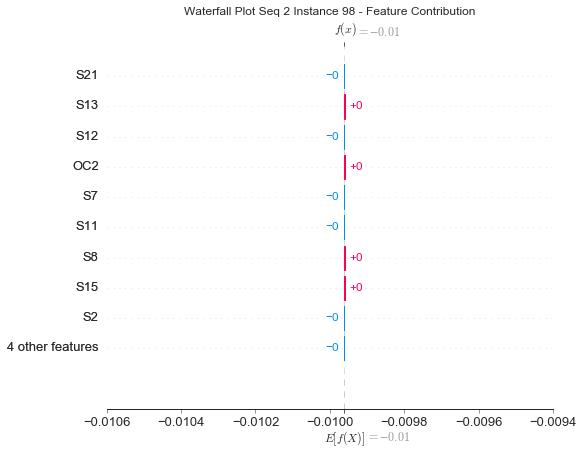

None

Contribution: [-5.24868226e-19 -4.33845084e-20  7.71866593e-20  3.21647566e-20
 -5.87090974e-19  3.59110071e-19  5.40958802e-19 -7.94124097e-19
  6.47653934e-19  4.02708823e-19  2.92759071e-19 -5.29020517e-19
  6.07252158e-19]


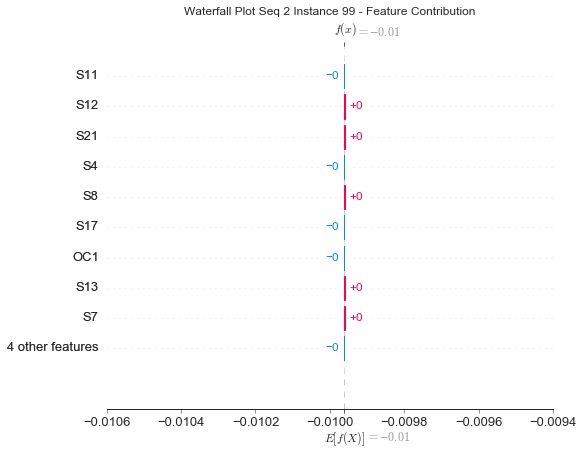

None

Contribution: [-3.59707606e-19 -4.85972642e-19 -6.92494671e-20  2.05123266e-19
 -9.62287835e-20  3.12555804e-19 -4.13317130e-19  5.53172795e-19
  5.48886604e-19 -3.67912824e-19  1.63758807e-19  1.09828171e-20
  4.23992335e-19]


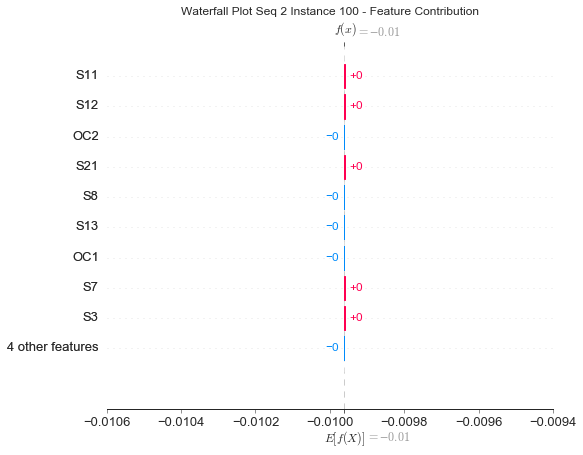

None

Contribution: [-1.55767040e-19 -3.46758223e-19 -1.36152908e-19  1.95682938e-19
  5.29519876e-19 -1.49492976e-20 -8.83610564e-19  1.49116604e-18
 -6.01790439e-20 -7.65876913e-19 -6.65966787e-21  5.58353945e-19
 -1.21761283e-19]


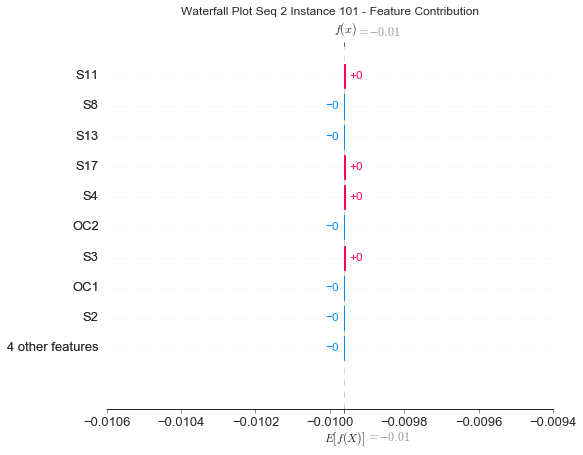

None

Contribution: [ 5.16786613e-20  2.43773384e-19 -2.29071851e-19  2.30712848e-19
  1.60488393e-18 -7.90816098e-19 -1.40365405e-18  2.53533195e-18
 -1.42321439e-18 -9.81898232e-19 -3.16462655e-19  1.28986574e-18
 -1.37883160e-18]


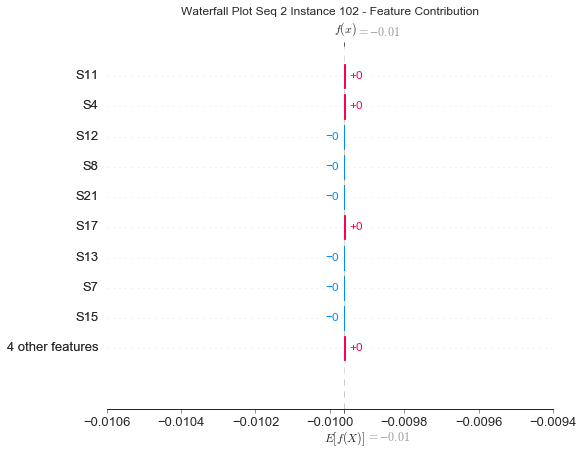

None

Contribution: [-6.18068578e-19 -5.75112158e-19 -2.63376659e-19  4.35757196e-19
  1.19515263e-18 -3.10862565e-19 -1.50547357e-18  2.59899404e-18
 -5.08415086e-19 -1.28703885e-18 -1.53267365e-19  1.01811706e-18
 -6.79491805e-19]


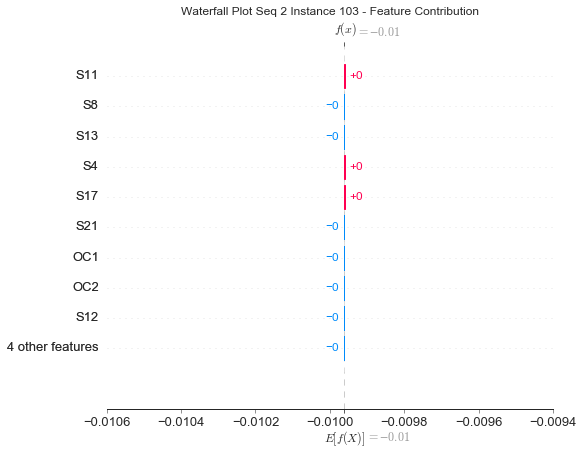

None

Contribution: [-1.53610852e-18 -1.63086195e-18  1.19416950e-19  3.47763557e-19
 -5.18237132e-19  6.74521432e-19 -6.57976786e-19  7.22944120e-19
  1.30303146e-18 -1.07404977e-18  1.45950218e-18 -2.90529483e-19
  1.01269365e-18]


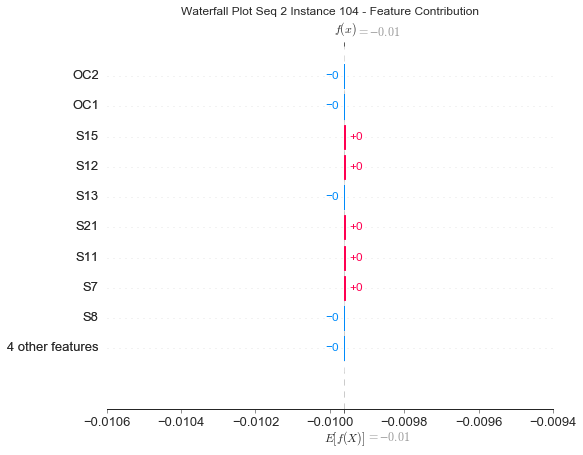

None

Contribution: [-1.40462144e-18 -3.59249943e-19  3.34547383e-20  1.06480136e-19
  1.86661805e-18 -7.35047065e-19 -1.26967902e-18  2.68766222e-18
 -1.53377690e-18 -9.82073077e-19  8.11173272e-19  1.29753092e-18
 -1.15649259e-18]


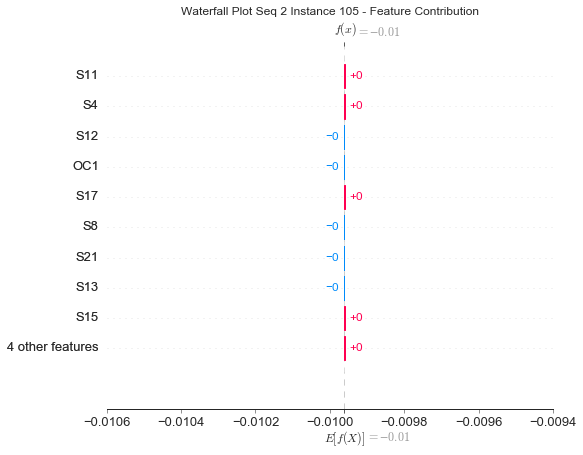

None

Contribution: [-1.22124305e-18 -4.55468703e-19 -2.07171688e-19  6.40068274e-19
  1.15059696e-18 -2.99215862e-19 -1.16761227e-18  2.34733075e-18
 -6.53684856e-19 -3.92468172e-19  2.40642867e-18  8.60050082e-19
 -6.71724734e-19]


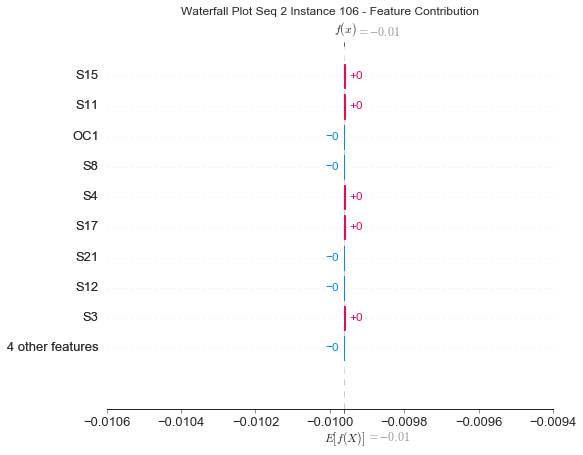

None

Contribution: [-2.21509378e-19 -1.75090623e-18 -7.41975167e-19  1.21598797e-18
  3.53050322e-18 -1.19230723e-18 -4.40022036e-18  7.48255919e-18
 -2.00962289e-18 -3.06804370e-18  1.63658553e-18  3.34778295e-18
 -2.51411166e-18]


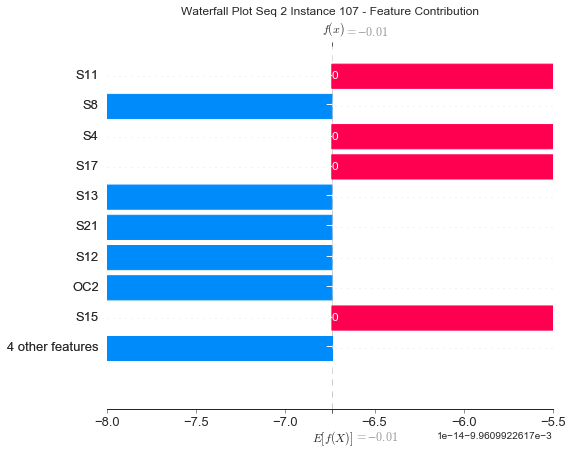

None

Contribution: [-2.71058970e-19  3.16564321e-19 -1.53016212e-18  8.32049811e-19
  6.75936552e-18 -3.16188610e-18 -3.98783773e-18  8.76825429e-18
 -6.19466214e-18 -2.47712966e-18  4.96378213e-19  5.40716717e-18
 -6.23792037e-18]


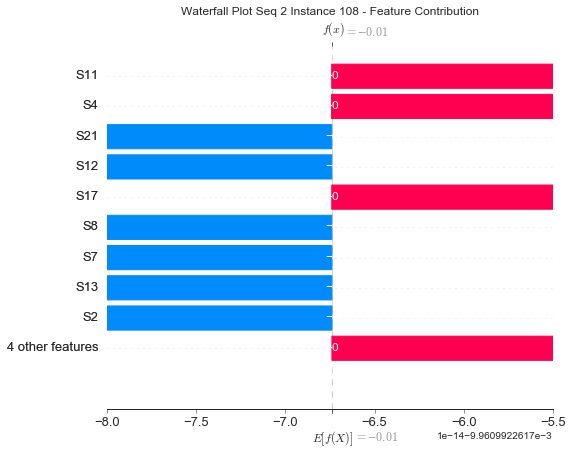

None

Contribution: [-3.11213739e-18 -2.41402508e-18 -3.18600064e-19  3.64659911e-19
  4.15964646e-18 -8.81656763e-19 -4.61690114e-18  7.71976316e-18
 -1.76215609e-18 -4.28480178e-18  1.86418283e-18  3.06832371e-18
 -2.29330614e-18]


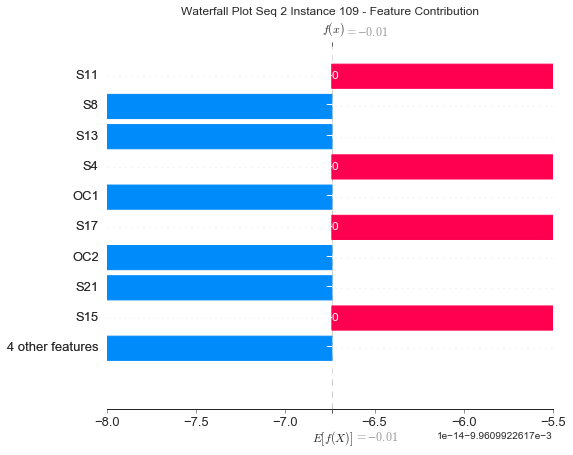

None

Contribution: [-5.34443544e-18 -5.57971787e-18  3.00441718e-19  3.14034725e-19
  1.43335139e-18  2.28121999e-18 -1.53725158e-18  3.01840398e-18
  2.66116080e-18 -2.60421872e-18  5.96327821e-18  7.08430667e-19
  3.10918477e-18]


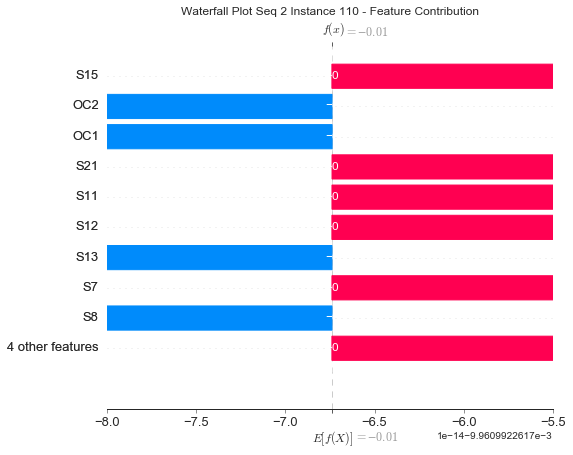

None

Contribution: [ 1.22868695e-18 -4.00508445e-19 -2.14125897e-18  2.40817960e-18
  1.35842115e-17 -5.71238068e-18 -1.42243583e-17  2.36840272e-17
 -1.04544264e-17 -1.02081540e-17  7.96110623e-19  1.14418733e-17
 -1.06307763e-17]


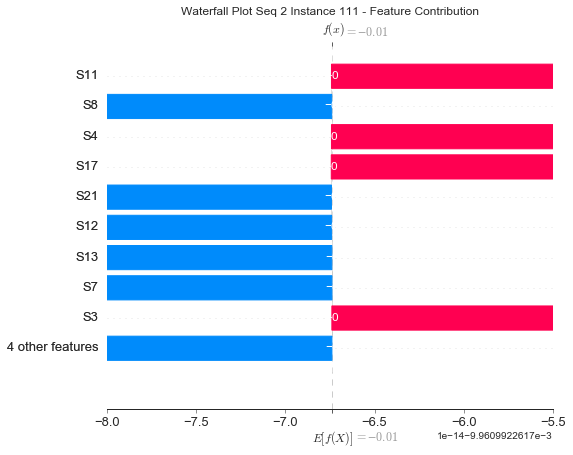

None

Contribution: [-1.11311234e-18 -2.91367981e-18 -1.51885880e-18  1.64759303e-18
  9.43515625e-18 -3.54665268e-18 -8.96634006e-18  1.56394327e-17
 -6.60734544e-18 -6.59060289e-18  3.22753881e-18  7.61504871e-18
 -7.31819675e-18]


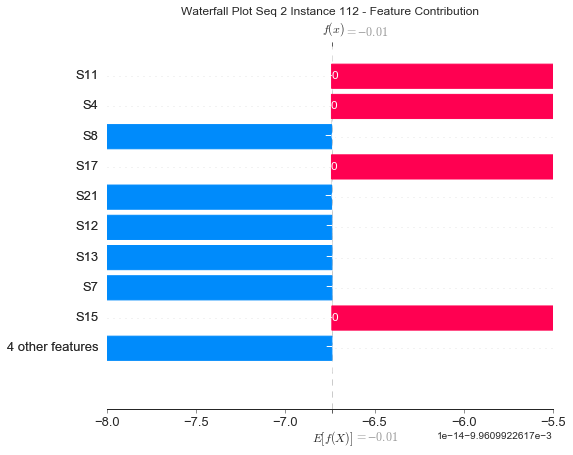

None

Contribution: [-3.34835371e-18  6.95160907e-20 -8.09537884e-19  1.24214704e-18
  1.00011645e-17 -2.40907296e-18 -7.15178869e-18  1.62564449e-17
 -5.14390329e-18 -6.62548758e-18  1.10680881e-18  6.08333769e-18
 -4.59785862e-18]


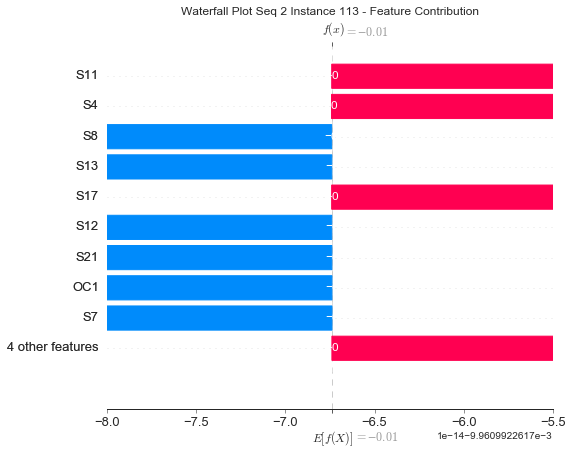

None

Contribution: [ 4.87309346e-18  1.40692483e-18 -2.77258802e-18  1.73148279e-18
  1.51522878e-17 -7.33539631e-18 -9.75167443e-18  2.13444842e-17
 -1.38517027e-17 -5.50302582e-18  4.90792934e-18  1.21059827e-17
 -1.41744032e-17]


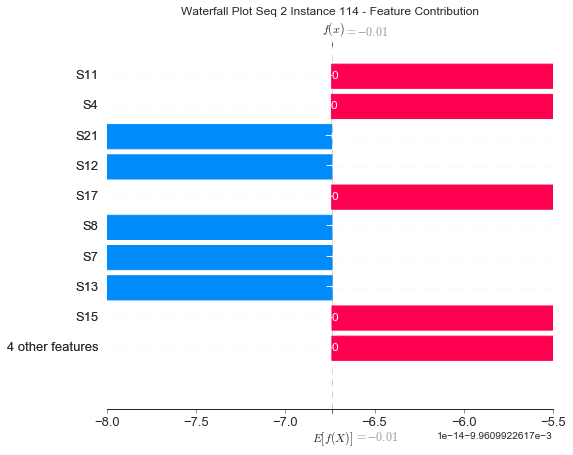

None

Contribution: [ 2.53749006e-18 -2.63885174e-18 -5.69248244e-18  5.32623292e-18
  3.27729852e-17 -1.44998822e-17 -3.45129993e-17  5.74601740e-17
 -2.51152862e-17 -2.56655814e-17 -1.40931972e-17  2.78234077e-17
 -2.62159079e-17]


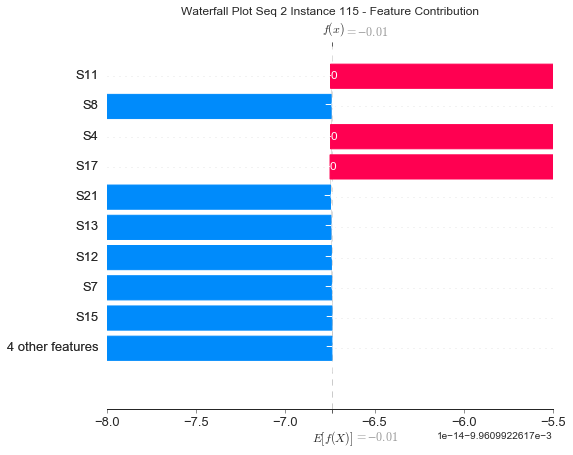

None

Contribution: [-1.61073804e-17 -1.72268485e-17  2.85919259e-18  4.83336140e-20
 -1.04337676e-17  1.12072600e-17  2.42685403e-18 -7.29541371e-18
  1.92717317e-17 -2.66971550e-18  1.88371078e-17 -9.45564055e-18
  1.64970552e-17]


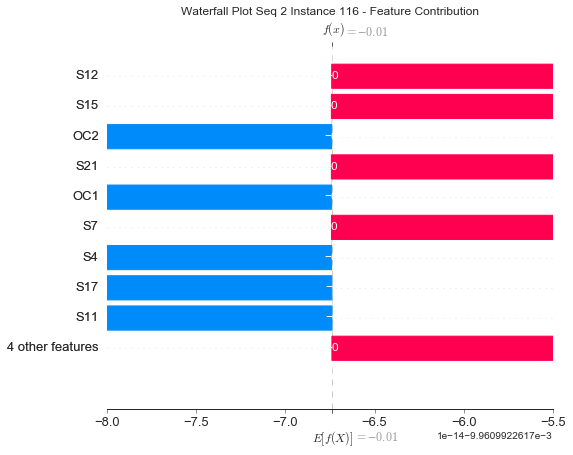

None

Contribution: [-5.65859905e-18 -7.59629983e-18 -2.22255572e-18  1.29834941e-18
  2.31082764e-17 -7.74461828e-18 -1.81411396e-17  3.17673553e-17
 -1.50903634e-17 -1.35239142e-17  4.61149593e-18  1.79438884e-17
 -1.47280517e-17]


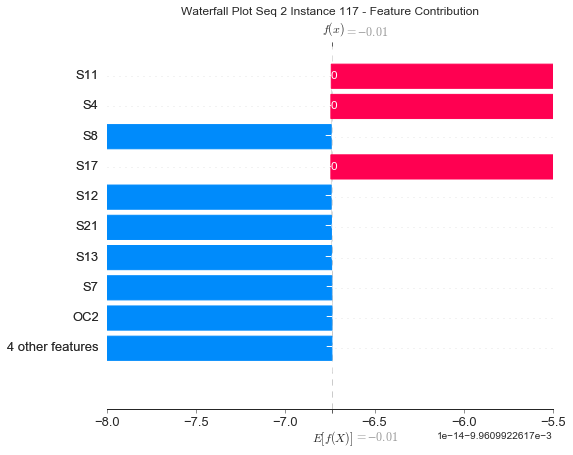

None

Contribution: [-6.91258294e-18 -5.19530016e-19 -1.62677041e-18  1.73197631e-18
  2.20920275e-18  4.14620891e-18 -4.85220890e-19  7.15710415e-18
  4.44593946e-18 -1.20589388e-18  1.72560844e-17  2.79413572e-19
  4.17245617e-18]


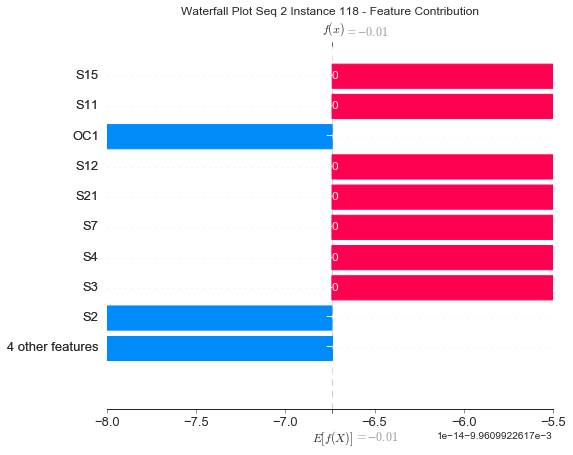

None

Contribution: [ 8.48496726e-18 -1.06228075e-18 -6.83966408e-18  7.04753911e-18
  5.06094874e-17 -1.97973288e-17 -5.32685852e-17  8.85677039e-17
 -3.79761068e-17 -4.15876236e-17 -2.17698945e-18  4.41653831e-17
 -3.50295339e-17]


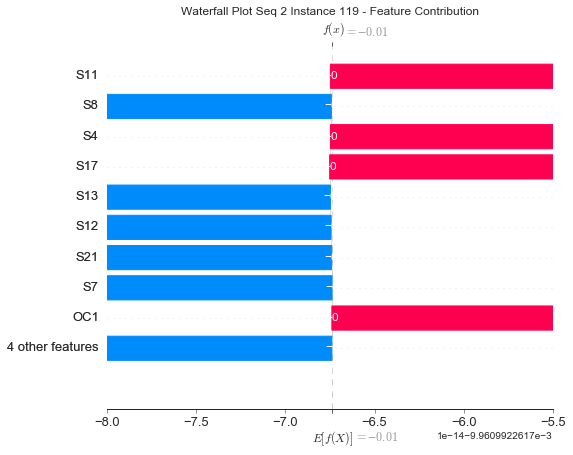

None

Contribution: [ 5.44832437e-18 -1.59641236e-18 -6.53796194e-18  6.03270927e-18
  7.04511448e-17 -3.06213230e-17 -6.70860219e-17  1.12451207e-16
 -5.44500803e-17 -5.24168836e-17 -3.24239117e-17  5.58087046e-17
 -5.20594920e-17]


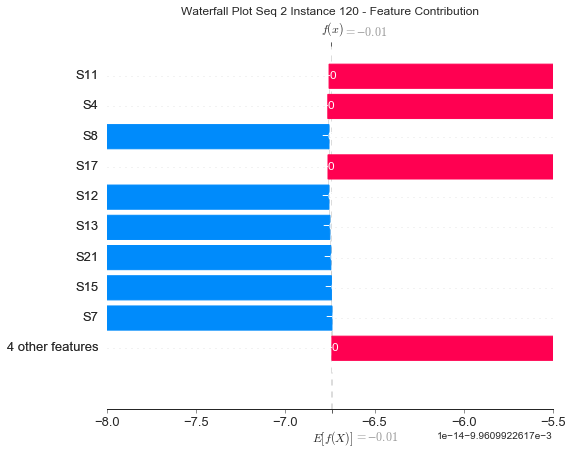

None

Contribution: [-2.85536295e-17 -3.38922168e-17  1.89110073e-18  2.92454007e-18
 -1.72303889e-17  1.62290338e-17  3.84431032e-18 -1.31027948e-17
  2.72621442e-17 -1.14353315e-18  3.39655050e-17 -1.00566865e-17
  2.61978721e-17]


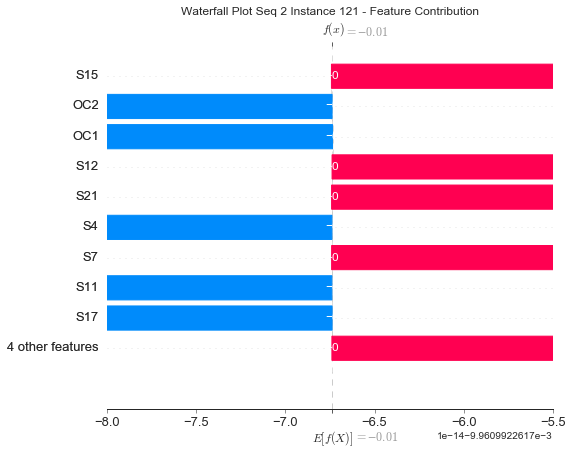

None

Contribution: [ 1.13469625e-17 -1.17978306e-17 -6.17078350e-18  2.18929272e-18
  2.86605608e-17 -1.99061329e-17 -1.66822560e-17  2.98898273e-17
 -3.56628035e-17 -3.34947888e-18  4.18164086e-17  2.87779510e-17
 -3.72376859e-17]


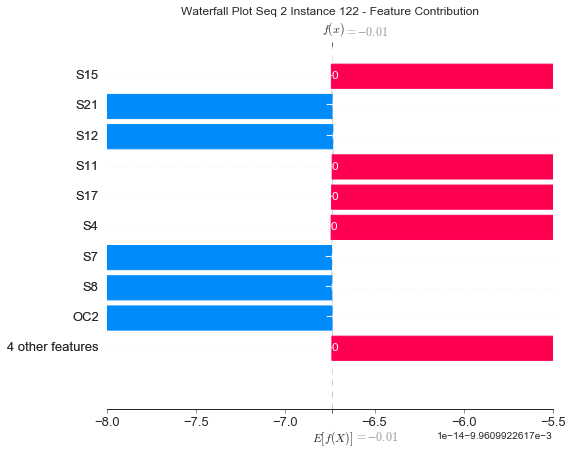

None

Contribution: [ 1.14833440e-17  1.00971216e-17 -4.46931393e-18  7.74600825e-19
  5.79160432e-17 -2.36191829e-17 -3.10892061e-17  6.46268338e-17
 -4.31235955e-17 -1.80413998e-17  9.80600779e-18  3.81274312e-17
 -4.19625681e-17]


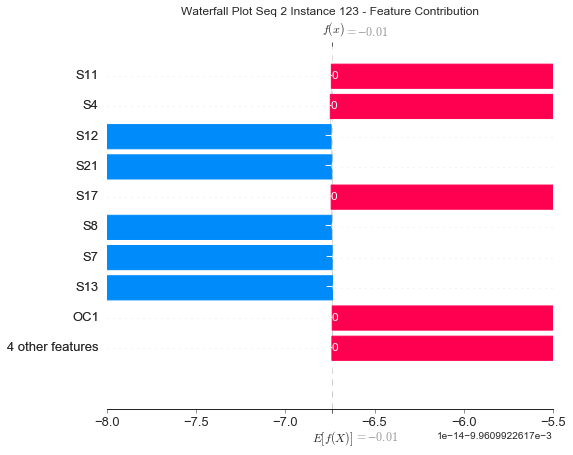

None

Contribution: [-9.10131112e-18 -1.66738105e-17 -3.06595476e-19  3.59392978e-18
  6.15679596e-17 -1.54188418e-17 -7.14140956e-17  1.19077281e-16
 -2.99425253e-17 -7.09167747e-17 -2.57196426e-17  4.60946231e-17
 -2.52631067e-17]


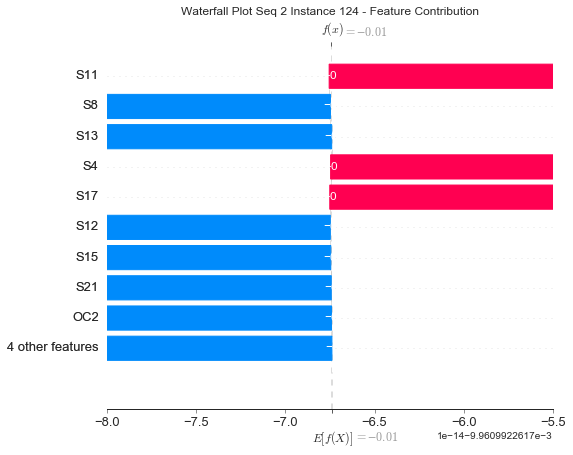

None

Contribution: [-1.02368283e-17 -3.03008765e-17 -7.44040110e-18  7.66967985e-18
  6.09424456e-17 -2.55743913e-17 -6.59114320e-17  1.02414403e-16
 -4.33611783e-17 -5.21881649e-17  1.63368915e-17  5.46482265e-17
 -4.51035515e-17]


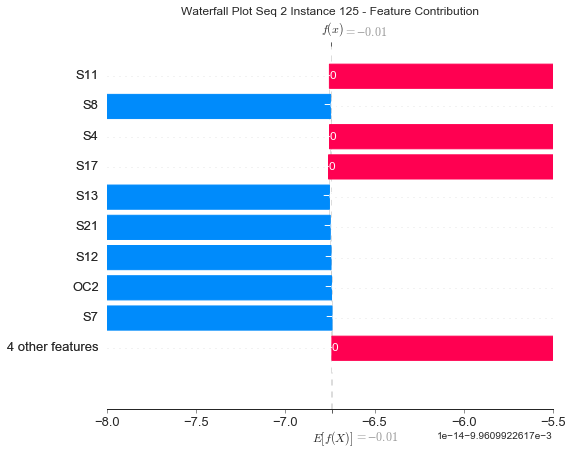

None

Contribution: [-3.75920733e-17 -5.97416904e-17  4.36990749e-18  4.69848431e-18
 -4.96533989e-17  4.66158792e-17  1.50827848e-17 -4.05654269e-17
  8.71379851e-17 -1.11164976e-17  5.32376222e-17 -3.92504877e-17
  7.55031670e-17]


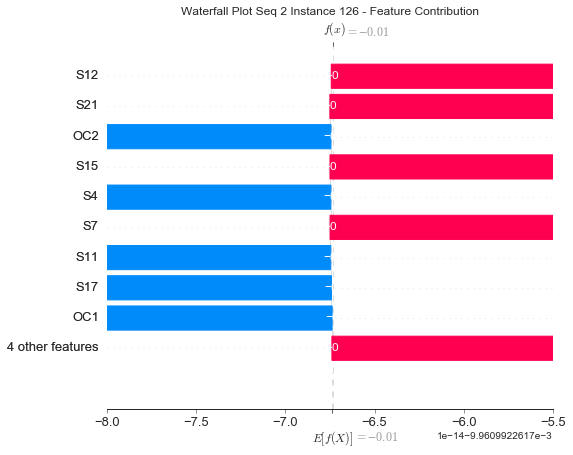

None

Contribution: [ 8.50486923e-18 -7.84559552e-18 -7.34036022e-18 -9.11568545e-19
  4.11613576e-17 -2.97305421e-17 -1.79329514e-17  3.52337582e-17
 -5.58728806e-17 -2.34779397e-18  5.01423024e-17  3.38257314e-17
 -5.47126738e-17]


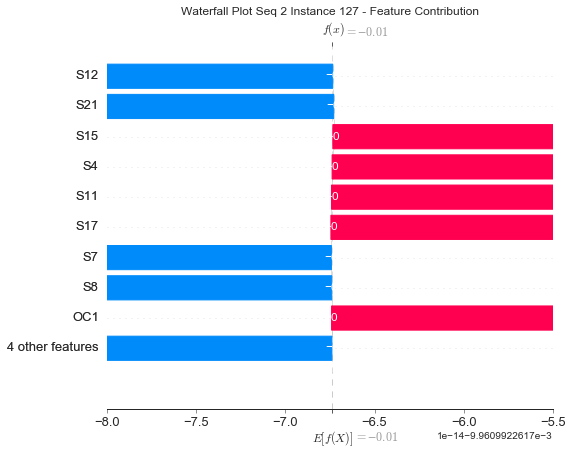

None

Contribution: [-2.81984117e-17 -4.50069037e-17  7.93142875e-18 -2.57179474e-19
  2.14196087e-17  4.69556685e-18 -3.97954078e-17  5.17205895e-17
  6.19410172e-18 -5.32235998e-17  2.44334016e-17  1.19381452e-17
  9.31693063e-18]


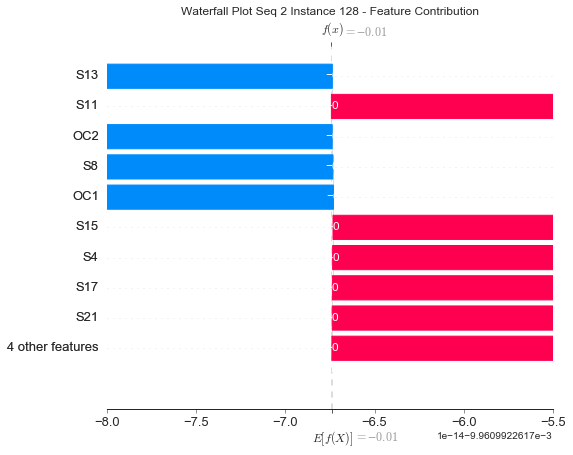

None

Contribution: [-2.52670871e-17 -2.72574342e-17  5.53680788e-18 -1.02979420e-17
  2.63197257e-17 -1.69854806e-17 -1.65365264e-18 -4.40083299e-19
 -3.20732665e-17 -2.34766348e-18  6.24352551e-17  9.72939763e-18
 -2.92154733e-17]


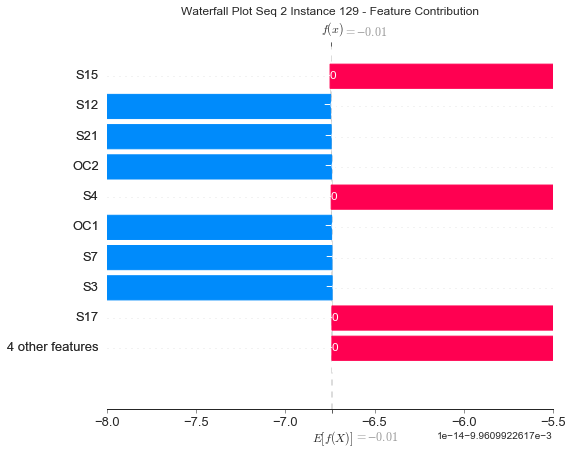

None

Contribution: [-5.50943151e-18 -7.62380441e-18 -1.27917640e-18 -3.94133571e-18
 -4.50906409e-18 -1.12537043e-18  3.37622072e-17 -3.73228094e-17
 -2.94037231e-18  2.36088861e-17  5.74353719e-17 -1.39200518e-17
 -4.39019286e-18]


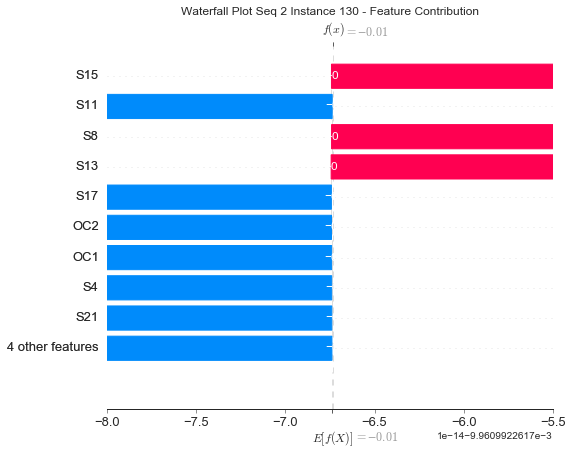

None

Contribution: [ 1.15274658e-17 -6.44466077e-17 -9.15028352e-18  7.70368111e-18
  7.05313830e-18  7.84622997e-19 -5.33082766e-17  7.63711706e-17
  5.52923793e-18 -5.39938373e-17  2.24777067e-17  2.49289440e-17
 -3.93418721e-18]


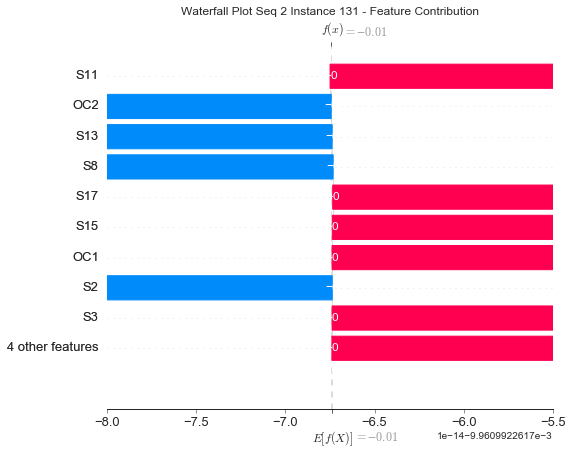

None

Contribution: [-2.66089312e-17 -2.83804940e-17  1.07989744e-17 -1.29588398e-17
  2.54620073e-17  2.34676467e-17  2.84825086e-18  1.14717320e-17
  1.72092759e-17 -8.64377932e-18  2.46778880e-17 -8.32600300e-18
  4.11405623e-17]


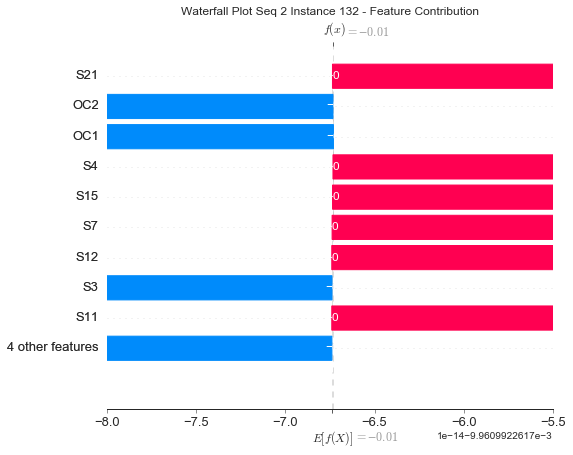

None

Contribution: [ 2.21037417e-17 -5.95639061e-17 -2.56278057e-17  2.26778563e-17
  1.02656701e-16 -3.47177166e-17 -1.80272619e-16  2.45198965e-16
 -6.30977011e-17 -1.42834901e-16 -1.33722415e-16  1.09671636e-16
 -6.46892231e-17]


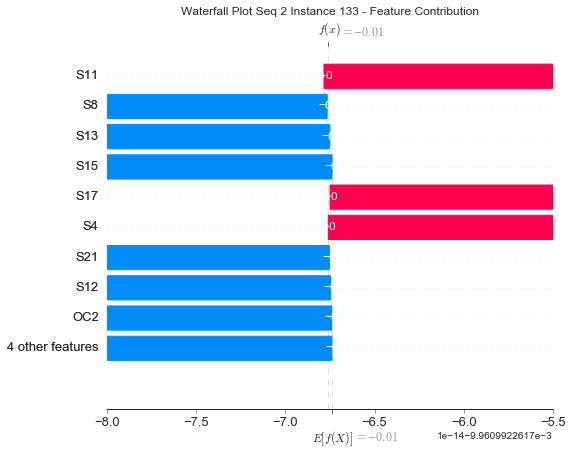

None

Contribution: [-9.58620207e-17 -1.19165068e-16  5.99993671e-17 -3.74038004e-17
 -1.77939295e-16  1.14760338e-16  1.01888700e-16 -2.36042486e-16
  1.99411977e-16  2.31870124e-17  1.09607367e-16 -1.55760346e-16
  2.09023313e-16]


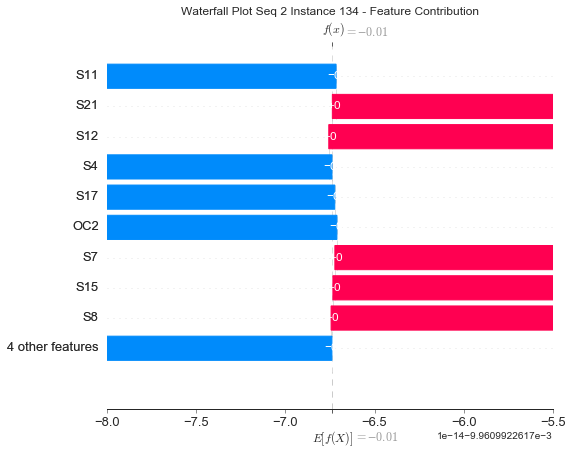

None

Contribution: [ 3.56657880e-17  1.61921267e-17  1.04145373e-17 -6.99743182e-18
  2.99095109e-17 -5.94922483e-18 -1.33830701e-17  3.21782523e-17
 -1.34883272e-17 -2.11488741e-17 -4.77660044e-17  1.87711865e-17
  5.98218012e-18]


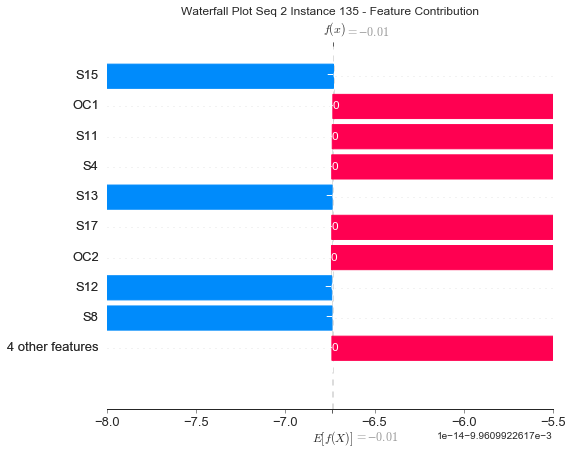

None

Contribution: [ 2.66287058e-17 -1.08824073e-16  1.65968794e-17  1.50876040e-17
 -2.12583383e-17  3.93660978e-17 -5.36250008e-17  2.86549823e-17
  6.30783715e-17 -3.99531875e-17 -7.34086977e-18  2.65455262e-17
  8.48292644e-17]


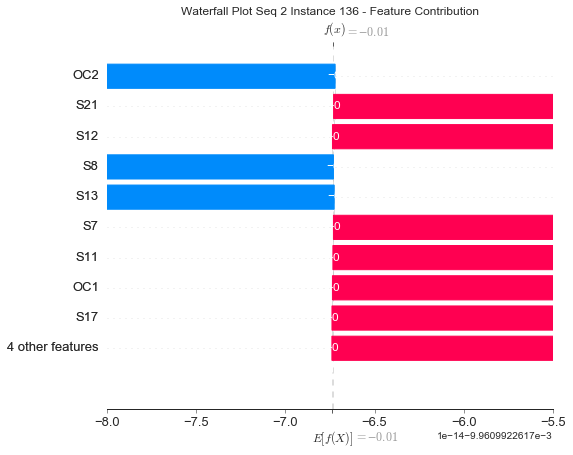

None

Contribution: [ 1.66346352e-16  1.19804208e-16  5.41140167e-17 -4.48057301e-17
  6.14102460e-17 -1.06954586e-16 -5.15760678e-17  1.63827571e-17
 -1.27645708e-16 -5.95592143e-17 -1.19998522e-16  1.67024640e-17
 -1.22901265e-16]


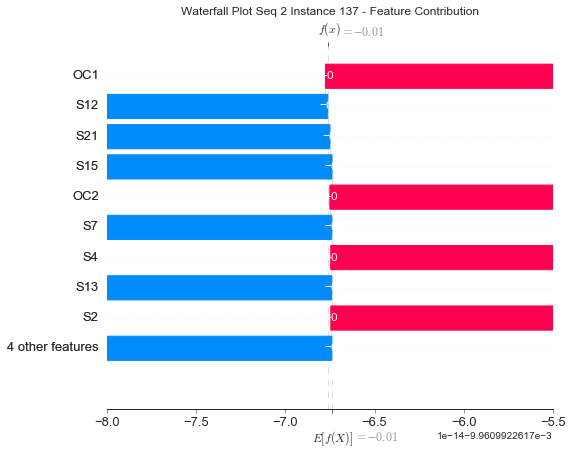

None

Contribution: [-1.24361099e-16 -3.68801156e-17  1.30743625e-16 -1.66718650e-16
 -4.73524928e-16  1.86587409e-16  6.50319021e-16 -1.04799924e-15
  3.33455140e-16  4.50996446e-16  1.16080770e-16 -4.46634967e-16
  3.89659852e-16]


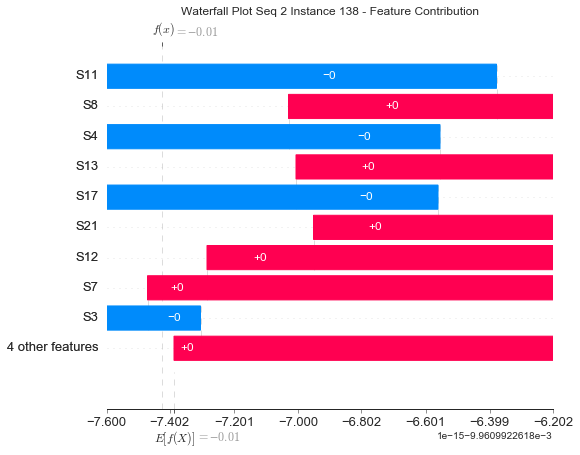

None

Contribution: [ 1.73585188e-16  2.33427404e-16  5.64440191e-17 -1.38203034e-16
 -2.26610748e-16 -3.54205058e-17  5.80703183e-16 -8.27045140e-16
 -5.71190117e-17  5.31310575e-16  1.40554172e-16 -2.27512600e-16
 -2.81743044e-17]


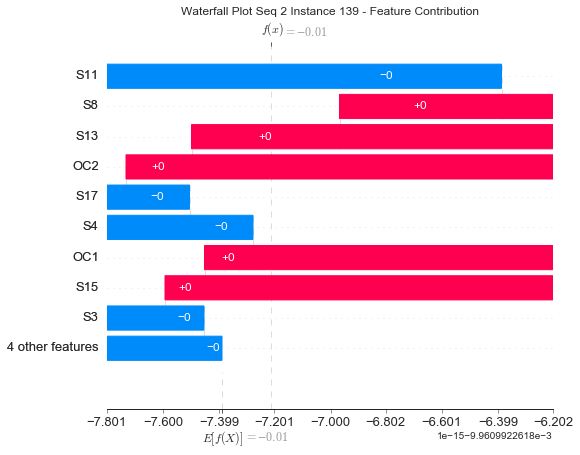

None

Contribution: [ 2.46040228e-16  2.16791280e-16  5.66846757e-17 -1.15935213e-16
 -4.81177394e-16  1.78226519e-16  6.72818440e-16 -1.03564580e-15
  2.96366108e-16  5.79638834e-16  4.23142773e-16 -4.11490776e-16
  3.21156989e-16]


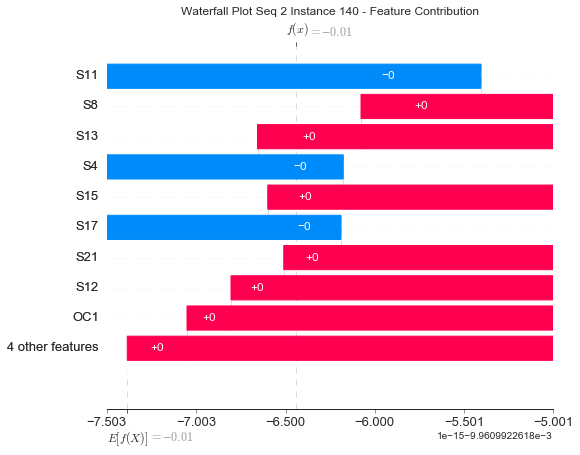

None

Contribution: [ 5.35814831e-16  4.72805850e-16 -1.73344088e-16  5.15114815e-17
  4.82929376e-16 -2.80122901e-16 -5.62027404e-17  4.82954946e-16
 -5.97461942e-16  1.20852557e-16 -5.39074479e-16  4.40490273e-16
 -5.02825757e-16]


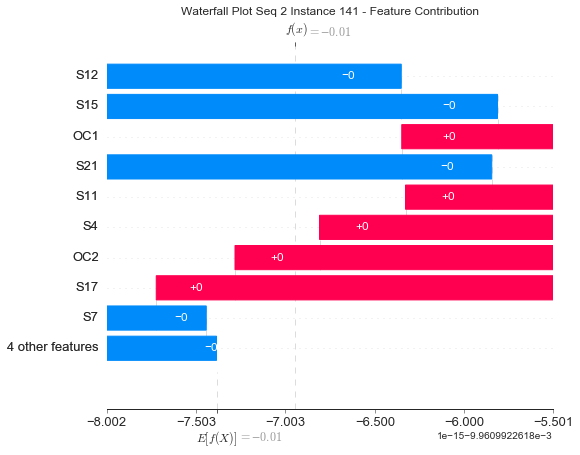

None

Contribution: [ 5.08059414e-16  8.14624355e-16 -2.02681180e-16 -3.56587239e-17
  7.26959568e-16 -4.25532253e-16  3.68914447e-17  4.41967154e-16
 -9.29880816e-16  1.84779880e-16 -8.65461525e-16  5.67098934e-16
 -7.61349106e-16]


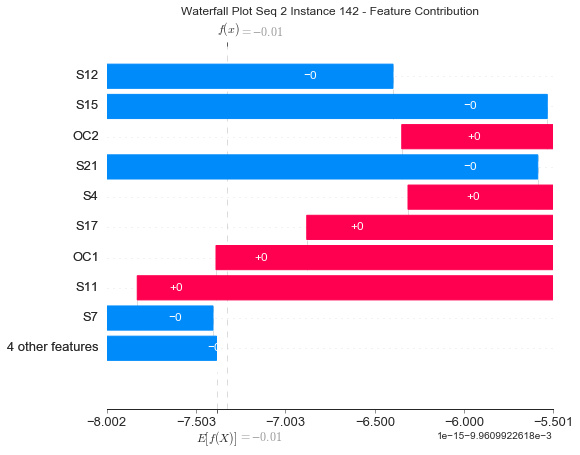

None

Contribution: [ 4.74233683e-16  5.85505648e-16 -3.58271412e-17 -1.33577915e-17
 -2.09043073e-16  1.69214657e-16  3.19112463e-16 -3.49314296e-16
  2.38715484e-16  1.72738460e-16 -9.14339985e-16 -2.30138455e-16
  2.44764702e-16]


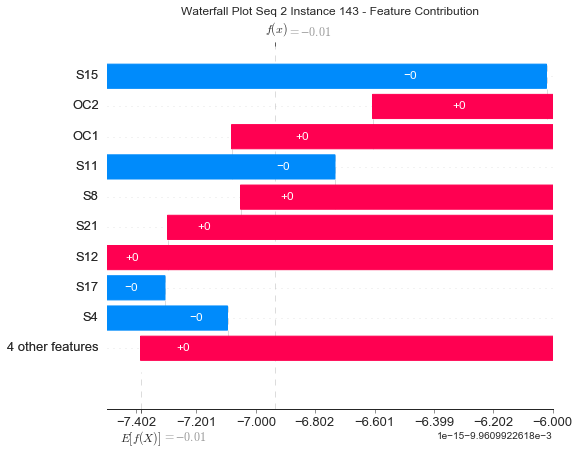

None

Contribution: [ 4.24269115e-16 -3.22863787e-16  6.37575927e-17 -1.06835663e-16
 -8.23318142e-16  6.44558721e-16  8.53261128e-16 -1.59914039e-15
  1.01639867e-15  5.69133666e-16  2.46986893e-16 -5.82109470e-16
  1.03555294e-15]


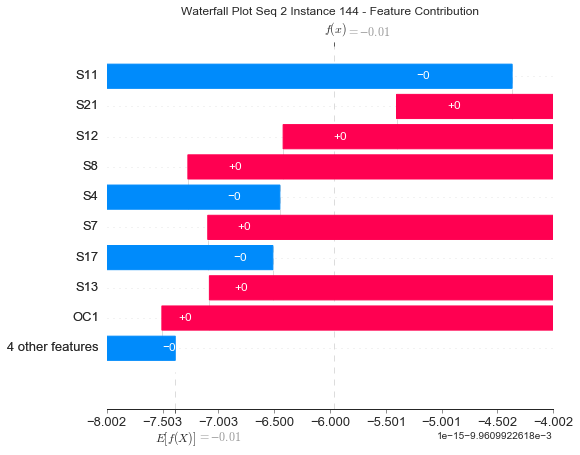

None

Contribution: [ 1.27273455e-15  1.43601138e-15 -3.21241533e-16  1.00825058e-16
  1.14894143e-15 -6.56318926e-16 -2.47805444e-16  9.63734606e-16
 -1.40099800e-15 -4.30087001e-17 -1.71369758e-15  8.25482206e-16
 -1.23126552e-15]


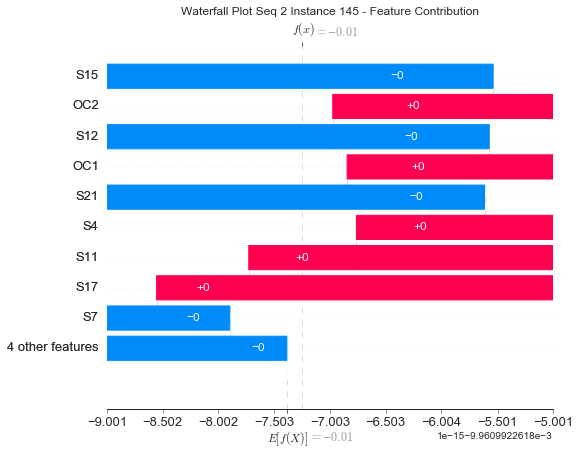

None

Contribution: [ 1.06824884e-15  1.58590487e-15 -1.44487608e-16 -5.31905324e-17
  4.24122287e-16 -2.79845074e-16  8.86783886e-16 -8.53379236e-16
 -6.92293474e-16  7.97565800e-16 -1.52253770e-15 -4.26389603e-17
 -6.14883663e-16]


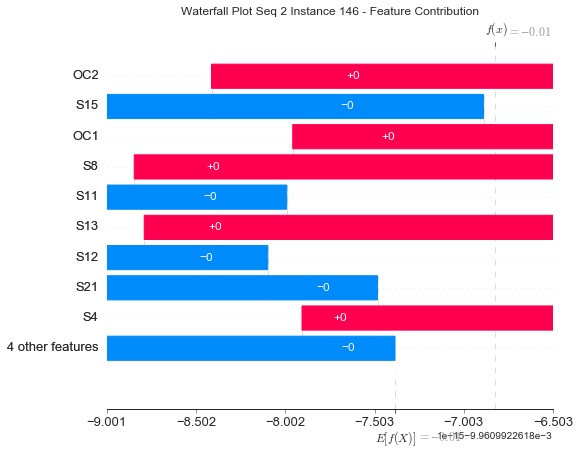

None

Contribution: [ 6.79442820e-16  1.43544577e-15 -3.94027443e-18 -5.34144734e-17
 -4.11838642e-16  8.75744982e-17  1.35720830e-15 -1.57444525e-15
 -6.21200398e-17  1.04191966e-15 -1.35585803e-15 -4.92136095e-16
  1.67833252e-16]


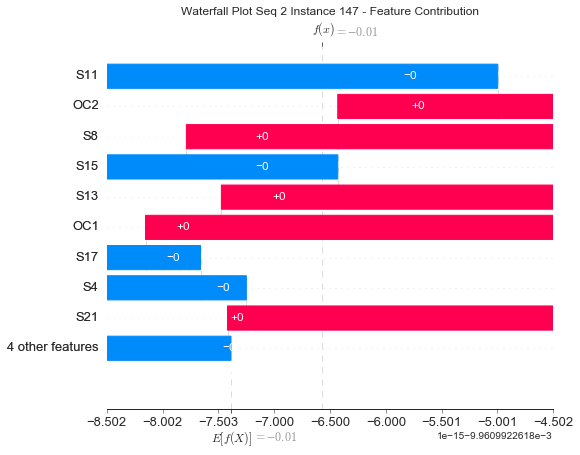

None

Contribution: [ 8.81813920e-16  2.45990332e-16 -4.51833645e-17  1.60349541e-17
 -1.34652997e-15  6.68564746e-16  1.47173669e-15 -2.64068366e-15
  1.07391390e-15  1.24992480e-15 -1.08003934e-16 -8.85515454e-16
  1.03204135e-15]


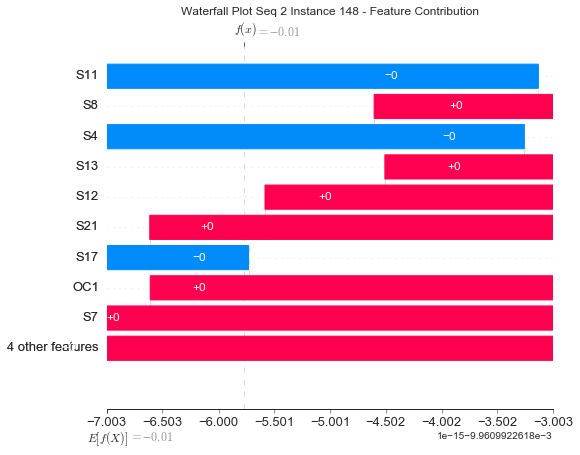

None

Contribution: [ 1.28281996e-15  2.30567853e-15 -1.63753554e-17 -2.92413667e-16
  4.58737109e-16 -8.42290410e-16  1.16173216e-15 -1.60331203e-15
 -1.50230971e-15  1.00961817e-15 -2.46021927e-15 -1.05252526e-16
 -1.34619942e-15]


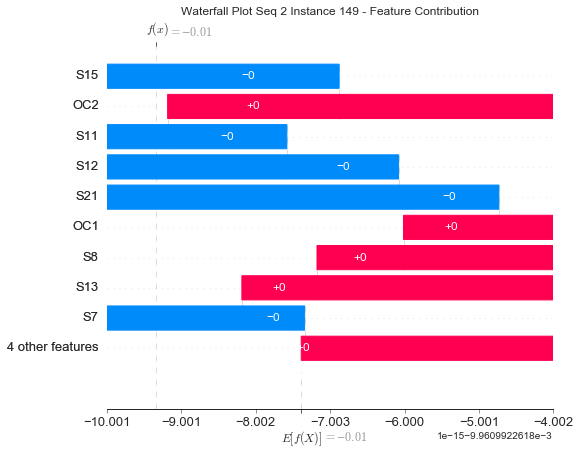

None

Contribution: [-3.55399302e-16  6.53518741e-16  9.84989521e-16 -6.17150641e-16
 -6.27744926e-15  3.11502274e-15  5.89988052e-15 -9.81597006e-15
  5.81556431e-15  3.82113334e-15  1.16167848e-15 -5.39604711e-15
  5.60456798e-15]


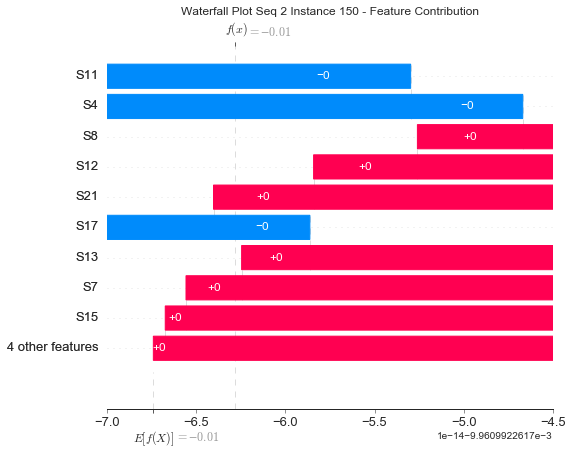

None

Contribution: [ 1.78565705e-15  8.04940492e-16  2.44299416e-16  1.45441407e-16
 -2.29292158e-15  1.13645574e-15  2.23340904e-15 -3.63812509e-15
  2.00612893e-15  1.91110475e-15 -7.56158223e-16 -1.74394110e-15
  2.11154705e-15]


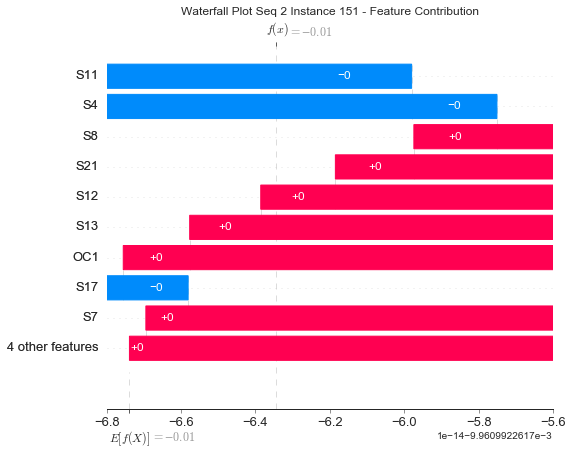

None

Contribution: [ 2.77295336e-15  4.91285377e-15 -4.95443812e-16  3.86488481e-16
  5.60261430e-15 -2.81991181e-15 -2.54091758e-15  6.33708674e-15
 -5.30913433e-15 -2.06962103e-15 -9.27622203e-15  3.49967248e-15
 -4.40734409e-15]


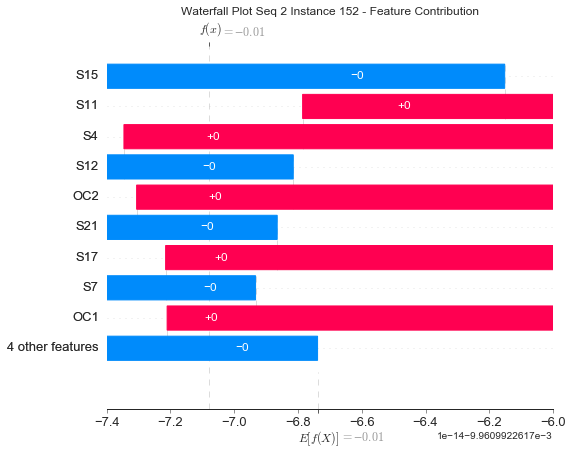

None

Contribution: [-9.02650401e-16  4.10232747e-16  4.03902738e-16 -2.31262256e-16
 -8.20169890e-15  3.31053044e-15  6.02619642e-15 -1.11284290e-14
  6.16214690e-15  4.02038556e-15 -2.64761654e-17 -5.84776088e-15
  5.53393560e-15]


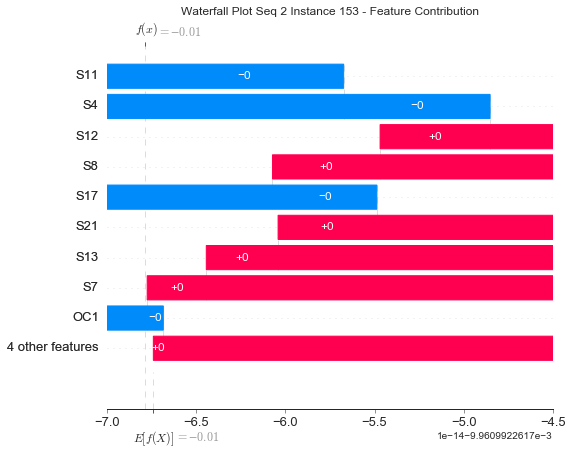

None

Contribution: [ 1.62752277e-15  3.11719560e-15 -1.99982613e-16  3.40069666e-17
 -4.84637948e-15  1.46534847e-15  5.46930487e-15 -8.72184320e-15
  2.65896009e-15  5.52965639e-15 -4.99587920e-16 -3.61942684e-15
  2.25114633e-15]


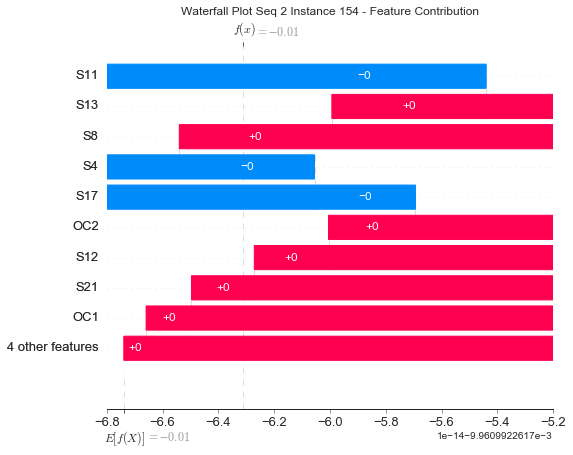

None

Contribution: [ 1.69586510e-15  2.34582323e-15 -4.10437491e-16  8.35244962e-17
 -9.65781037e-16  5.15539615e-16  2.03330195e-15 -3.04152485e-15
  7.20069696e-16  2.27558853e-15 -2.46053394e-15 -7.25721630e-16
  6.64889841e-16]


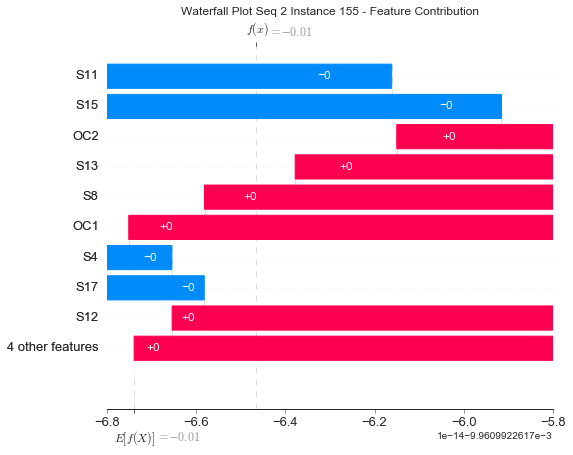

None

Contribution: [ 3.71860085e-15  4.74173830e-15 -4.67075143e-16  3.19641700e-16
 -3.94036207e-16 -8.83207236e-16  2.10865845e-15 -2.73554754e-15
 -1.57232757e-15  3.31326339e-15 -2.56623963e-15 -3.83624398e-16
 -1.60417008e-15]


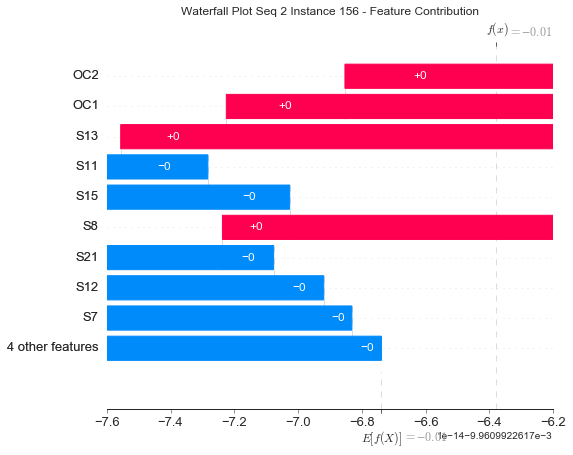

None

Contribution: [ 1.33482080e-15  3.20021562e-15 -1.94480234e-16  4.55277403e-16
  1.18252915e-15 -2.16146410e-16 -2.66045108e-15  3.61241807e-15
 -2.28809592e-16 -2.40967109e-15 -7.63566405e-15  9.29306210e-16
 -4.17987201e-16]


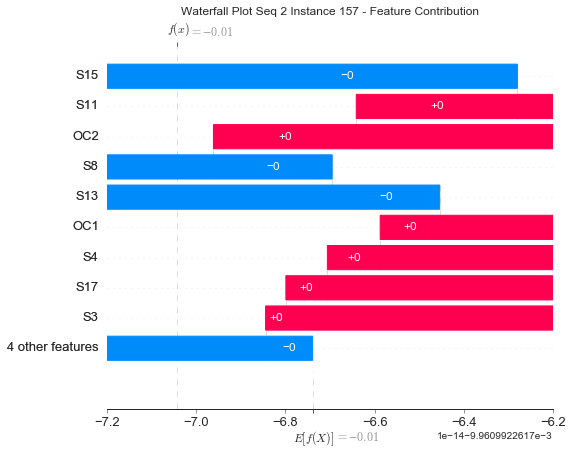

None

Contribution: [-2.05991044e-15  9.66566449e-16  2.20536211e-16  6.93735389e-16
 -2.12455006e-15  1.87520410e-15  1.37630603e-17 -9.34449712e-16
  3.56987414e-15 -1.41074989e-15 -6.06711997e-15 -2.02876546e-15
  3.09507702e-15]


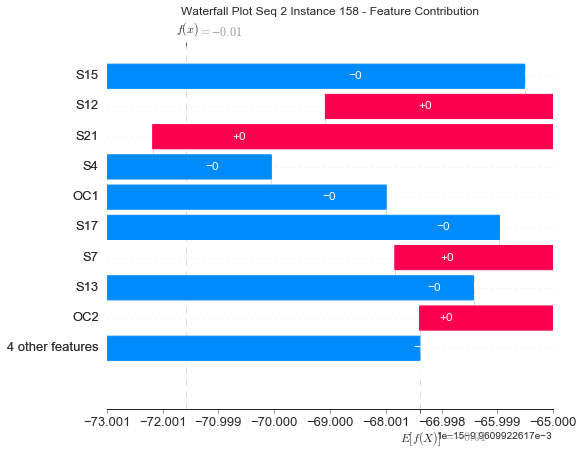

None

Contribution: [-3.92743894e-15  4.47415296e-16  5.00523892e-16  1.17879744e-15
 -7.67789881e-15  5.16754557e-15  4.81718098e-15 -8.69288569e-15
  9.21476640e-15  3.29257334e-15 -3.53688639e-16 -6.30486179e-15
  8.41534348e-15]


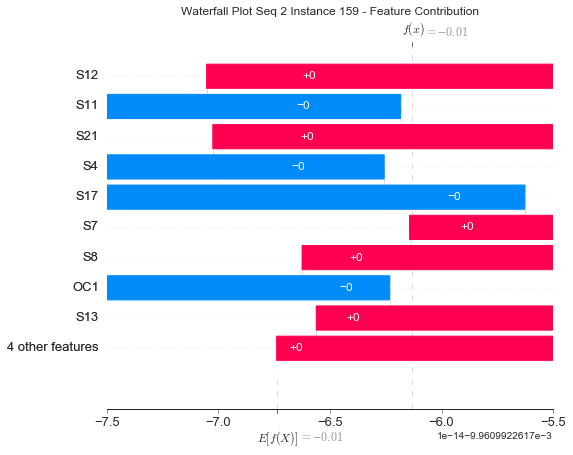

None

Contribution: [ 1.39355885e-16  5.05429642e-16 -1.21506749e-15  2.26526489e-15
  1.42099264e-15 -8.24819508e-16 -4.71472303e-15  6.37698453e-15
 -7.60786358e-16 -2.97783919e-15 -3.18863880e-15  2.30874648e-15
 -1.64140077e-15]


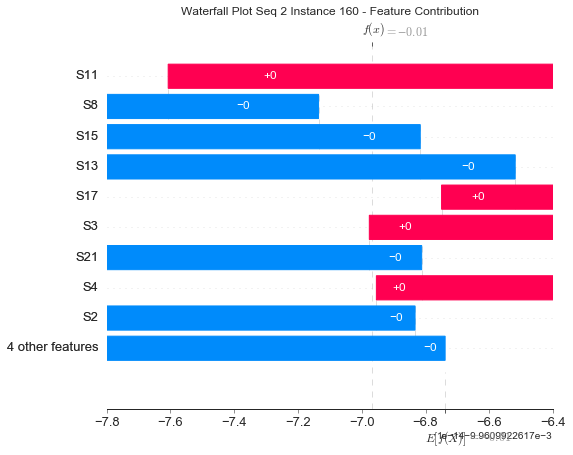

None

Contribution: [ 1.01418345e-16  1.92872346e-15 -1.33206042e-15  1.99950725e-15
  4.37400487e-15 -3.34557389e-15 -6.37135515e-15  8.84420558e-15
 -4.86067358e-15 -3.32523388e-15 -9.88018511e-16  4.57723603e-15
 -6.44685839e-15]


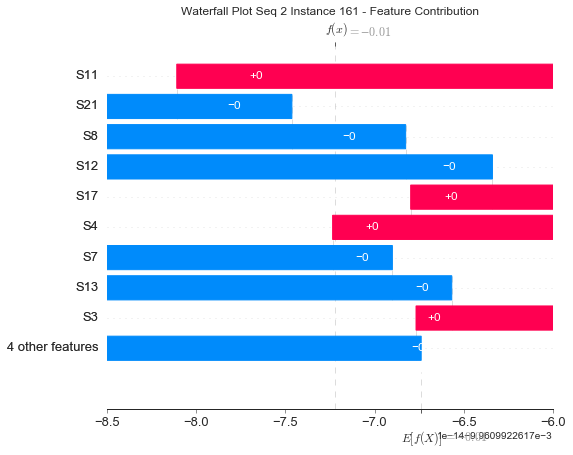

None

Contribution: [-6.95932773e-15 -4.76372007e-15 -7.43272523e-16  1.74053116e-15
 -2.33060395e-15  1.08655798e-15 -6.74198415e-16 -1.47878506e-16
  2.15187598e-15 -1.28527795e-15  4.77940458e-15 -9.12391915e-16
  7.69259176e-16]


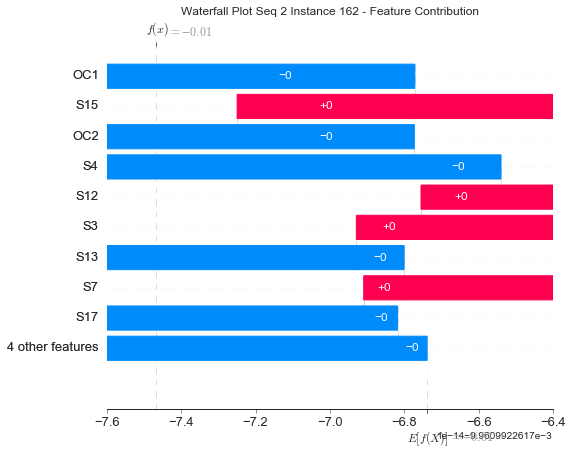

None

Contribution: [-7.61596715e-15 -2.94821760e-15 -1.91143805e-15  3.63586944e-15
  5.27690938e-15 -1.00642835e-15 -9.04619753e-15  1.55382756e-14
 -1.53347702e-15 -6.91457644e-15  4.55993707e-15  4.62685225e-15
 -2.75766208e-15]


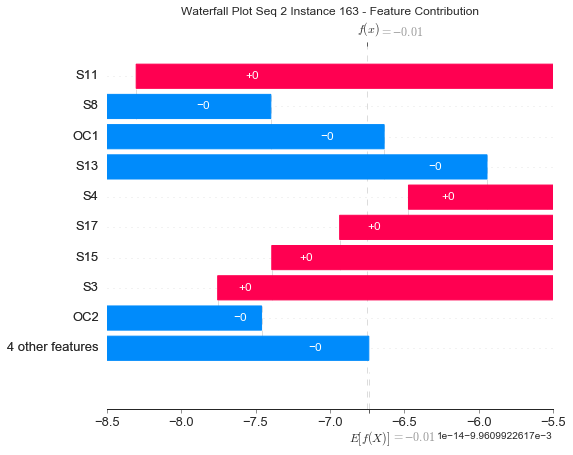

None

Contribution: [-4.04541030e-15 -6.89589343e-15 -3.29964056e-15  4.80201697e-15
  1.31365594e-14 -5.48661653e-15 -1.70759470e-14  2.75043812e-14
 -8.87403385e-15 -1.37852969e-14  8.79389945e-15  1.16682803e-14
 -1.13260087e-14]


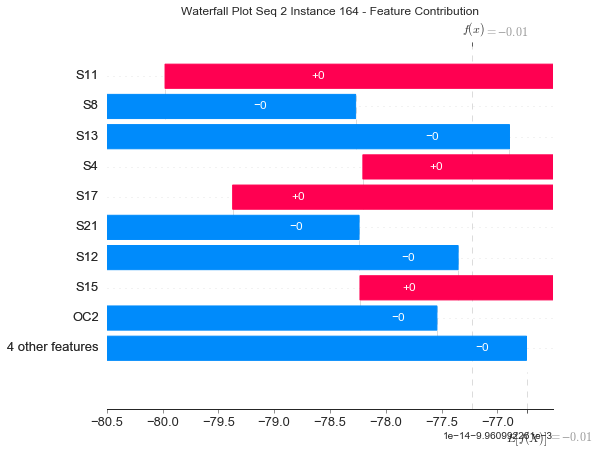

None

Contribution: [-8.13636471e-15 -9.37142260e-15 -8.22983649e-15  7.63980520e-15
  2.30404786e-14 -9.86138458e-15 -2.69724005e-14  4.69373211e-14
 -1.79381317e-14 -1.94763385e-14  4.08162180e-15  2.25196601e-14
 -2.12034556e-14]


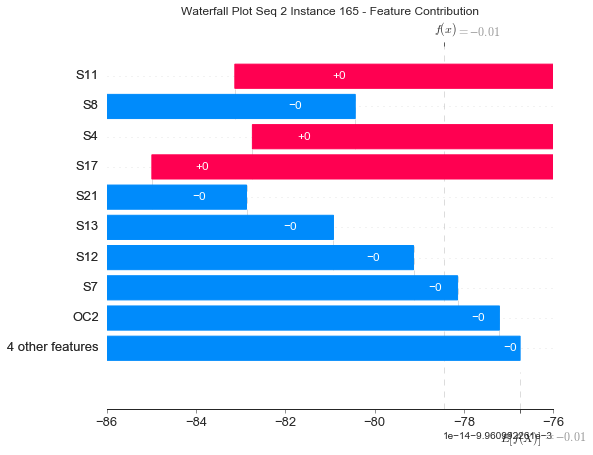

None

Contribution: [-2.44574682e-14 -2.44862995e-14 -4.38117231e-16  1.02718584e-15
  1.36489458e-14 -5.41679010e-15 -2.70203951e-14  3.28362080e-14
 -5.37050229e-15 -2.31848927e-14  2.64946620e-14  1.40089526e-14
 -1.11082908e-14]


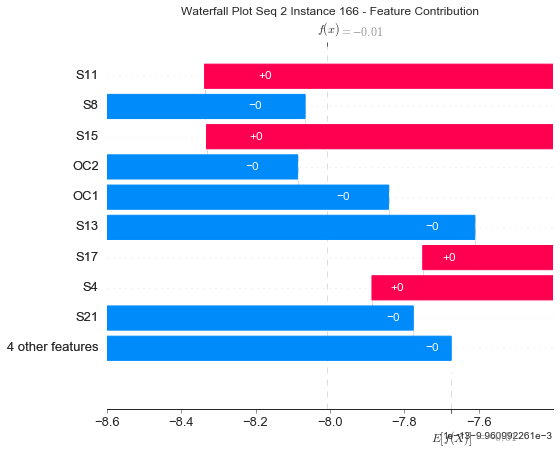

None

Contribution: [-3.11383474e-14 -2.96855165e-14 -8.78455802e-18  3.73403167e-15
  2.75071938e-15  2.96756850e-15 -2.12981522e-14  3.01492230e-14
  1.00477716e-14 -1.99087657e-14  4.43795628e-14  5.64067573e-15
  4.30319927e-15]


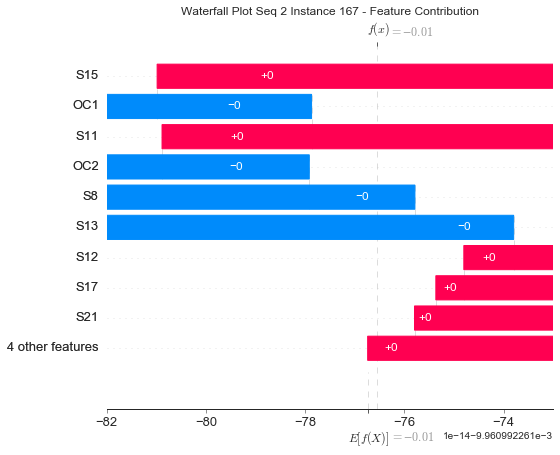

None

Contribution: [-2.08026125e-14 -1.23877349e-14 -8.54207062e-15  6.65154687e-15
  5.01424430e-14 -2.03692823e-14 -4.64267601e-14  8.73794919e-14
 -3.59056826e-14 -3.27040878e-14  1.66254458e-14  4.03985723e-14
 -3.96035642e-14]


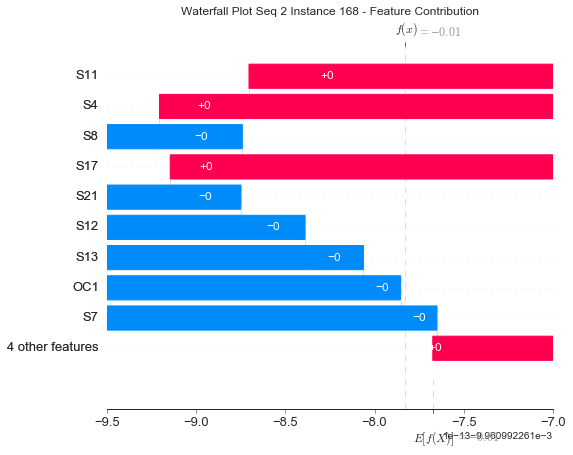

None

Contribution: [-3.65301830e-14 -4.44620435e-14 -7.04677541e-15  9.73191220e-15
  3.41847420e-14 -5.75727828e-15 -4.73278541e-14  7.83755453e-14
 -1.22240314e-14 -2.91034422e-14  5.93794016e-14  3.60068793e-14
 -1.71348700e-14]


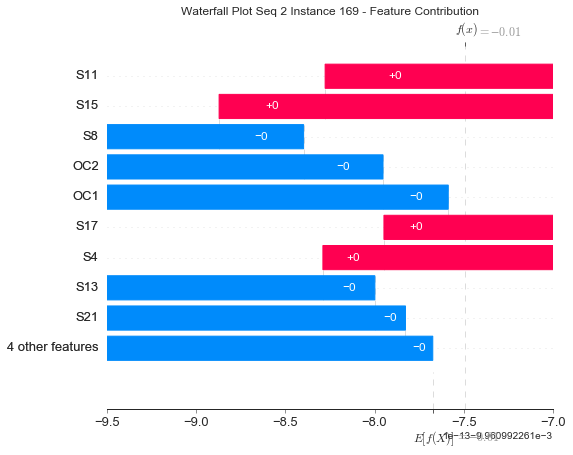

None

Contribution: [-3.84591346e-14 -6.06271557e-14 -9.28192087e-15  1.93787637e-14
  1.15386799e-13 -3.35659235e-14 -1.29923849e-13  2.11949002e-13
 -6.27413432e-14 -1.09186572e-13  2.28760407e-14  9.62039218e-14
 -6.23726399e-14]


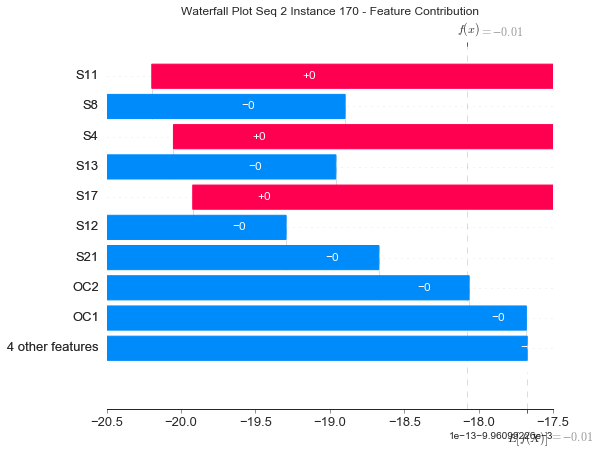

None

Contribution: [-6.06922959e-14 -5.64906635e-14 -1.92721023e-15  5.81465841e-15
  3.43856210e-14 -1.50670949e-14 -5.30130884e-14  7.41587849e-14
 -2.06994659e-14 -3.98120664e-14  8.11768797e-14  3.21527337e-14
 -2.67992229e-14]


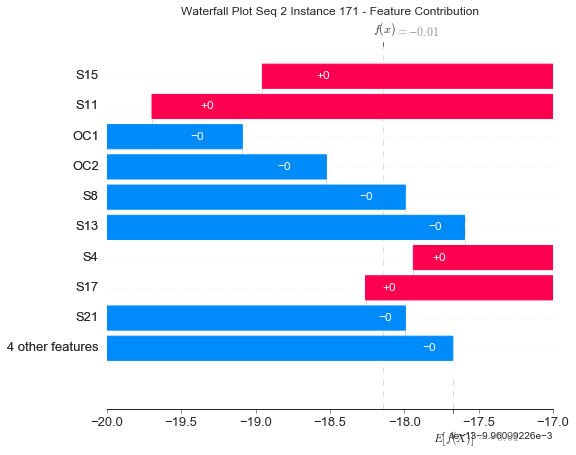

None

Contribution: [-3.68599770e-14 -7.50638429e-14 -1.83701157e-16  6.93906500e-15
  1.15843411e-14  3.93304291e-16 -3.46233120e-14  5.42388773e-14
  3.57550776e-15 -2.97664860e-14  1.19397344e-13  1.86444454e-14
 -5.06505712e-15]


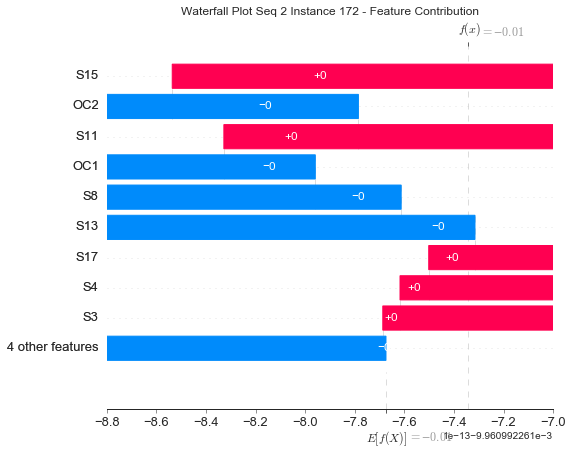

None

Contribution: [-2.11280646e-14 -5.95675988e-14 -2.64459068e-14  2.67362985e-14
  1.63894750e-13 -4.97881562e-14 -1.47004655e-13  2.78298380e-13
 -9.72484490e-14 -1.10575787e-13  6.11704562e-14  1.36645713e-13
 -9.55995672e-14]


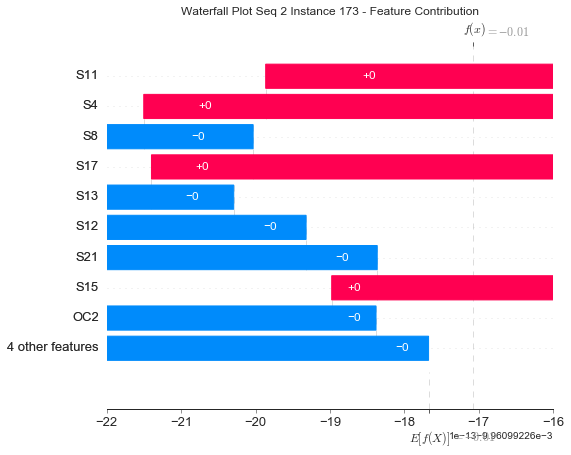

None

Contribution: [ 5.52898215e-15 -7.50915240e-14 -1.83682991e-14  1.68180899e-14
  1.25803515e-13 -4.86357001e-14 -1.23010746e-13  2.12280280e-13
 -9.34844514e-14 -9.32642635e-14  1.32621358e-13  1.10458551e-13
 -9.64804408e-14]


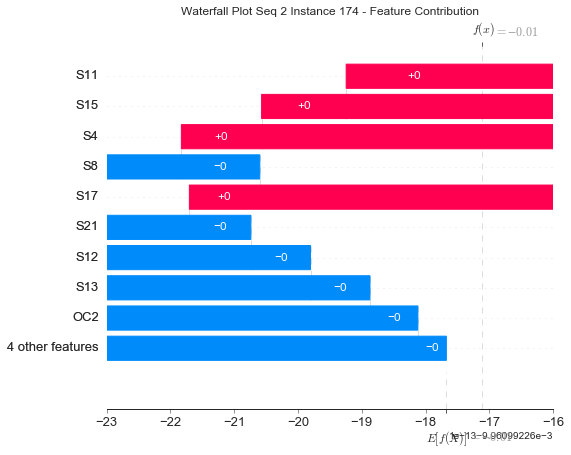

None

Contribution: [ 4.65483771e-14 -2.89289500e-14 -3.87513372e-14  2.08455638e-14
  2.96419248e-13 -1.41800918e-13 -2.12508830e-13  4.02390361e-13
 -2.65687266e-13 -1.49267615e-13  5.68833920e-14  2.28551092e-13
 -2.55926763e-13]


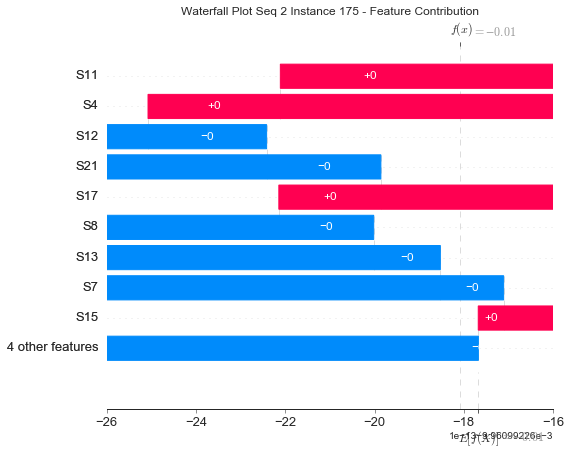

None

Contribution: [-4.48420699e-14 -1.42825029e-13 -1.05549953e-14  1.00752291e-14
  1.40851821e-13 -3.60008179e-14 -1.56773520e-13  2.37434665e-13
 -6.94199811e-14 -1.30445581e-13  1.56229969e-13  1.21245394e-13
 -7.67422557e-14]


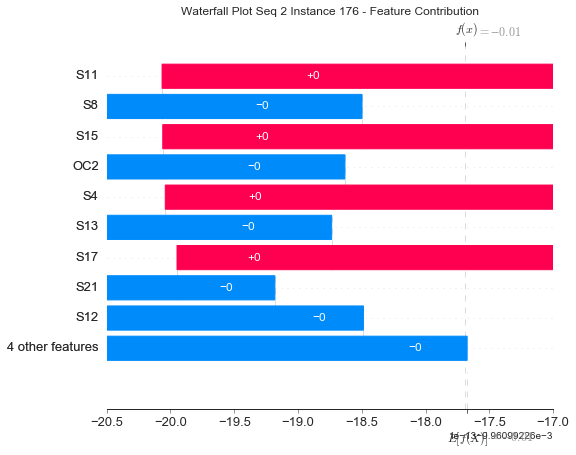

None

Contribution: [ 1.87627606e-14 -1.25476317e-13 -3.57882906e-14  2.21225948e-14
  2.55806525e-13 -1.30277950e-13 -2.41262468e-13  3.90926413e-13
 -2.36038619e-13 -1.71340711e-13  1.60022020e-13  2.26198834e-13
 -2.36413238e-13]


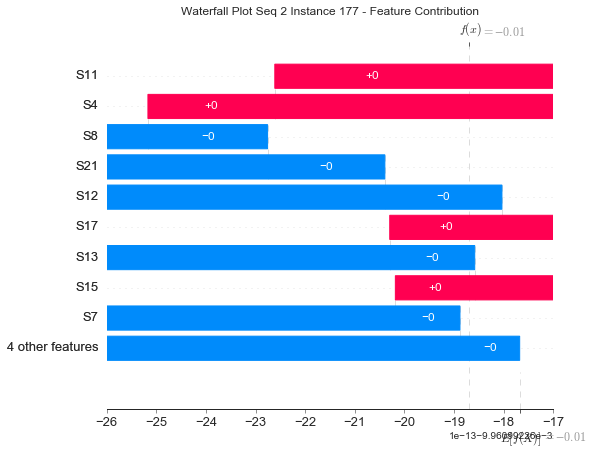

None

Contribution: [-1.21751933e-13 -1.41195839e-13  8.04985469e-15 -7.75633067e-15
  6.06858381e-14  9.87326252e-15 -1.31407472e-13  1.93836483e-13
  2.49774363e-14 -1.40831669e-13  1.41768840e-13  5.94434373e-14
  2.20237477e-14]


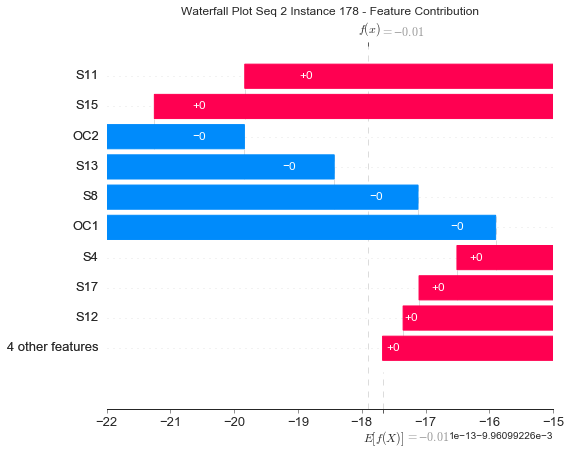

None

Contribution: [ 6.18186126e-14 -9.54301267e-14 -2.16443904e-14 -2.19986887e-15
  2.27277466e-13 -1.29184302e-13 -1.91734513e-13  3.28200114e-13
 -2.35701893e-13 -1.55164821e-13  1.32135175e-13  1.82736218e-13
 -2.33231213e-13]


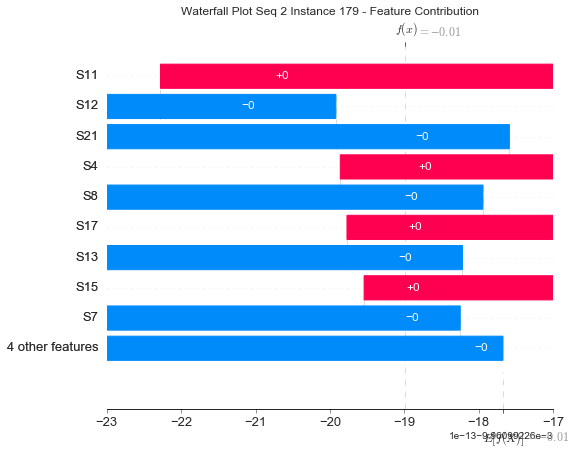

None

Contribution: [-1.95963004e-14 -1.06092611e-13 -1.93221412e-14 -3.34852792e-14
  1.97972430e-13 -1.22444006e-13 -1.37093353e-13  1.93915860e-13
 -2.08059901e-13 -8.32200113e-14  1.50899001e-13  1.43752184e-13
 -2.24512737e-13]


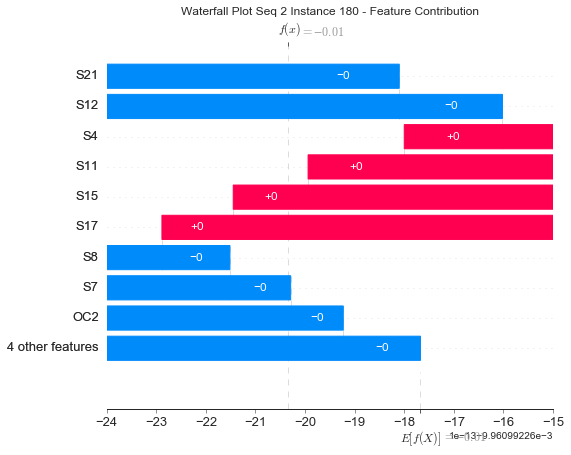

None

Contribution: [-2.11923700e-13 -2.89301433e-13  6.67458981e-14 -9.10628859e-14
 -4.50645082e-13  2.43870706e-13  1.51224871e-13 -4.67555519e-13
  4.88743757e-13  5.58250176e-14  3.83402592e-13 -2.92135917e-13
  4.02761239e-13]


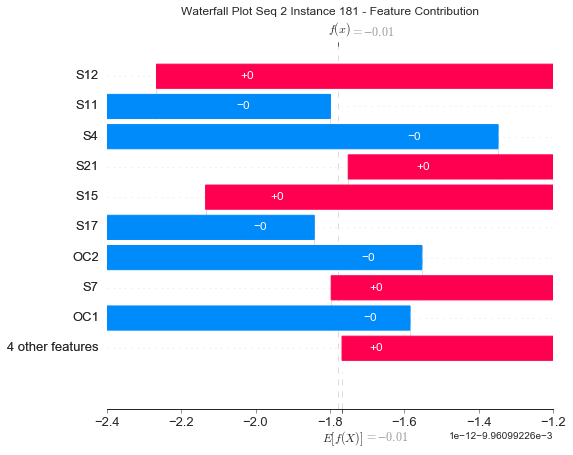

None

Contribution: [ 9.27812176e-14  9.77427774e-14 -2.82823437e-14 -6.03434539e-14
  3.06902317e-13 -1.76925599e-13 -1.42117465e-13  3.37495873e-13
 -3.39476087e-13 -3.97259367e-14 -5.86457627e-14  2.22352600e-13
 -3.03509090e-13]


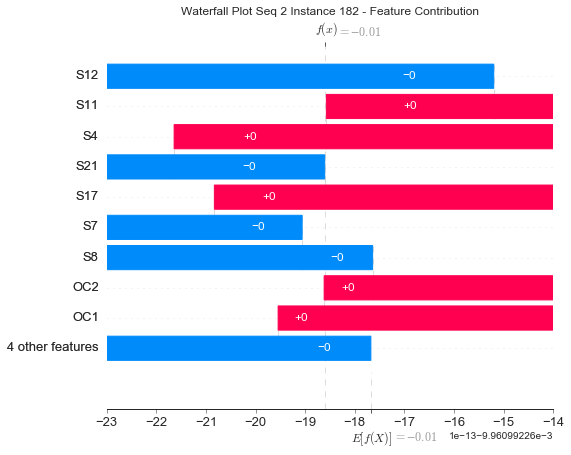

None

Contribution: [-7.50550643e-15 -1.45261136e-13 -1.87077391e-14 -6.54587333e-14
  2.20336783e-14  1.05148536e-13 -2.31702686e-15 -4.82514995e-14
  1.09352794e-13  8.43375730e-14  1.62944595e-13  4.58143858e-14
  9.71941576e-14]


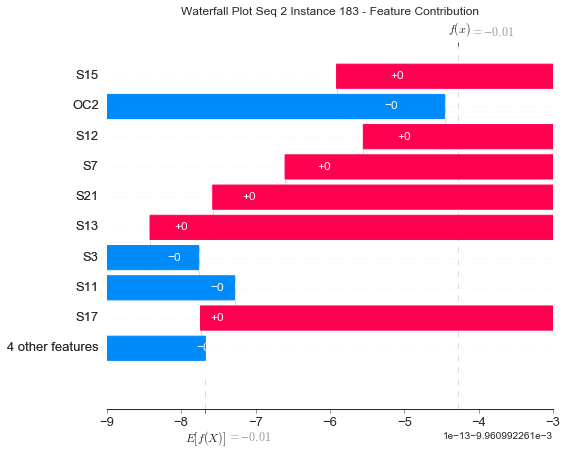

None

Contribution: [ 3.85955184e-13 -6.66967719e-15 -4.39994483e-14  6.97230088e-15
  7.33061235e-13 -2.86469497e-13 -7.03194447e-13  1.12964824e-12
 -5.28961749e-13 -6.37158132e-13 -5.74864646e-13  5.86650466e-13
 -4.64596243e-13]


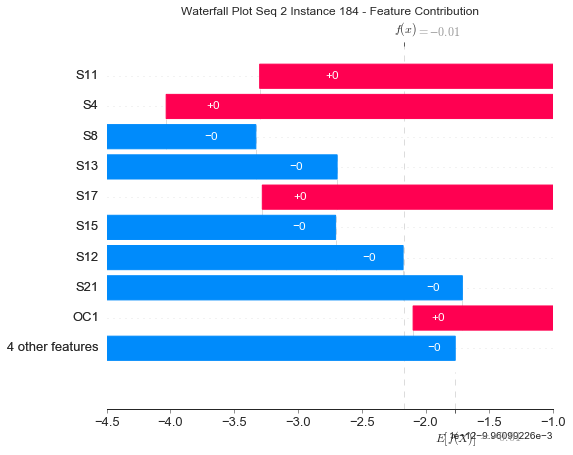

None

Contribution: [ 1.45642233e-13  1.20084078e-13  4.88587442e-14 -1.66901052e-13
 -4.08319130e-13  1.29408244e-13  3.27734395e-13 -6.63710894e-13
  2.78635622e-13  2.73924194e-13 -1.29602641e-13 -3.27263905e-13
  2.34685860e-13]


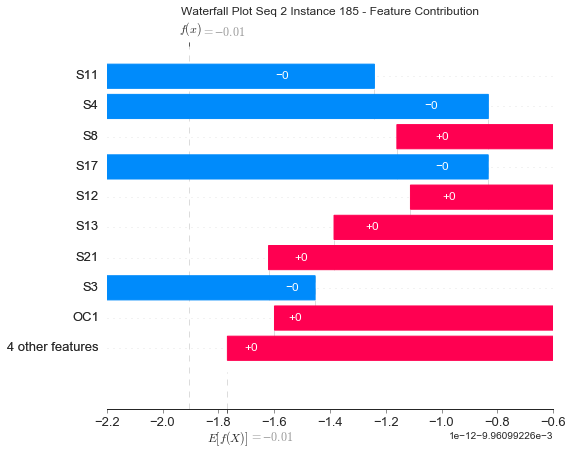

None

Contribution: [ 2.62475263e-13  1.04668864e-13  9.20132636e-14 -2.19547511e-13
 -6.21154224e-13  1.61461963e-13  4.30999745e-13 -9.51070060e-13
  3.76497146e-13  3.39563528e-13  5.39964700e-14 -4.06844236e-13
  3.45519620e-13]


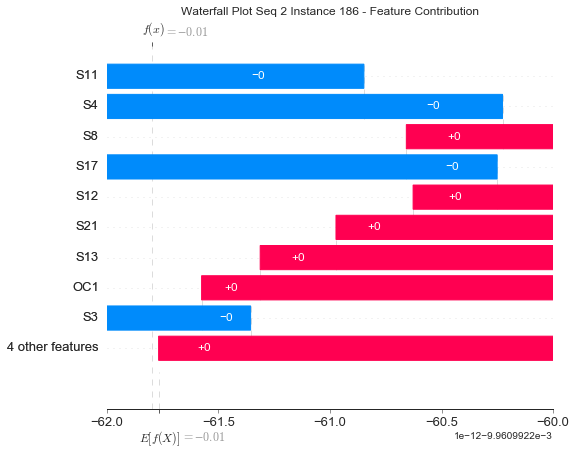

None

Contribution: [ 6.01865237e-13  3.88717460e-13  4.12756911e-15 -1.46946461e-13
 -4.06672309e-13  7.70266622e-14  5.76777233e-13 -9.06851525e-13
  1.40606914e-13  6.92304016e-13 -1.07624806e-13 -2.95486752e-13
  1.92082407e-13]


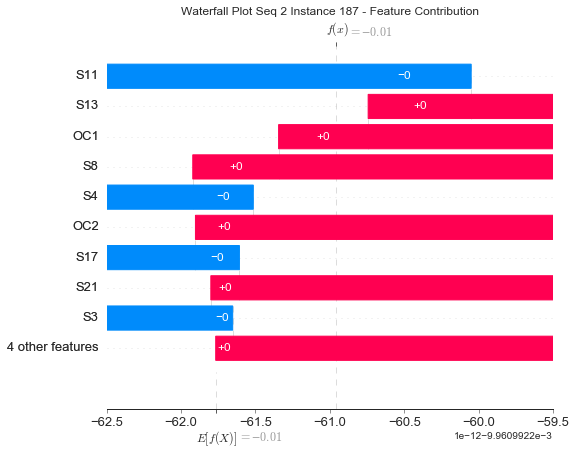

None

Contribution: [ 8.14973252e-13  2.17545600e-13  1.43826432e-14 -2.21000627e-13
 -4.36342097e-13  6.09360517e-14  3.83313986e-13 -7.90834087e-13
  9.86790673e-14  3.71440400e-13 -5.04320598e-13 -2.16942675e-13
  1.52720000e-13]


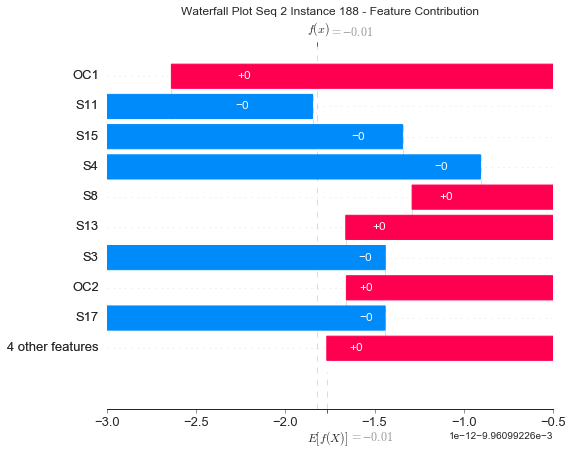

None

Contribution: [ 1.30249923e-12  7.44611675e-13 -5.16776055e-14 -3.14921835e-13
 -5.44009770e-13 -6.68248145e-14  9.74204007e-13 -1.72588376e-12
 -1.51391256e-13  1.21674285e-12 -5.09962623e-13 -3.85152115e-13
 -7.56864935e-14]


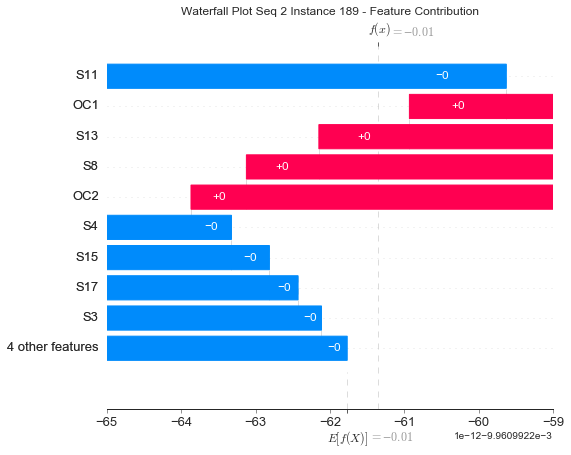

None

Contribution: [ 1.33535164e-12  7.93316584e-13 -7.29657898e-15 -4.37898117e-13
 -5.75626677e-13 -2.05462031e-13  1.00150097e-12 -2.00597633e-12
 -3.85327241e-13  1.28741267e-12 -9.61877821e-13 -4.47187833e-13
 -2.74089182e-13]


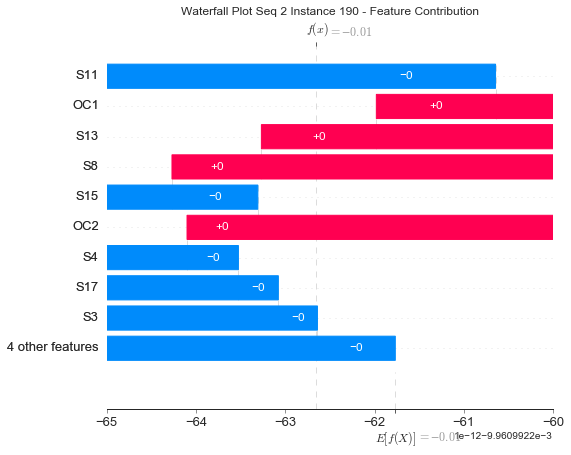

None

Contribution: [ 3.17896154e-13  1.82104969e-13  3.28282648e-13 -6.91114646e-13
 -3.67018698e-12  1.54782025e-12  2.48440504e-12 -5.33990040e-12
  2.88345151e-12  2.12360186e-12 -4.06363691e-13 -2.50876511e-12
  2.64692196e-12]


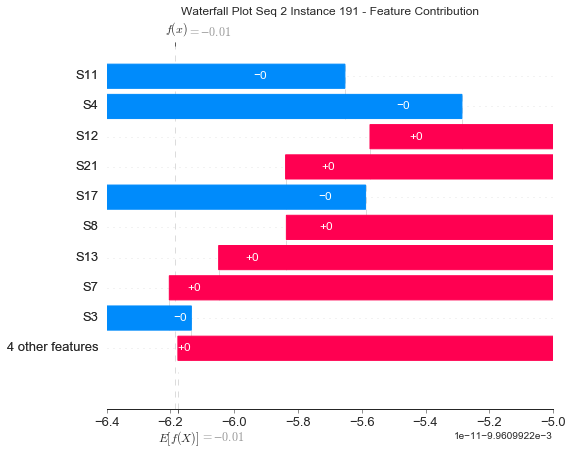

None

Contribution: [ 1.71370947e-12  1.37274849e-12  9.20705298e-14 -5.34188254e-13
 -1.59450730e-12  4.00869442e-13  1.38830917e-12 -2.82975401e-12
  7.94370808e-13  1.16330545e-12 -2.66068808e-12 -1.14042391e-12
  8.45573882e-13]


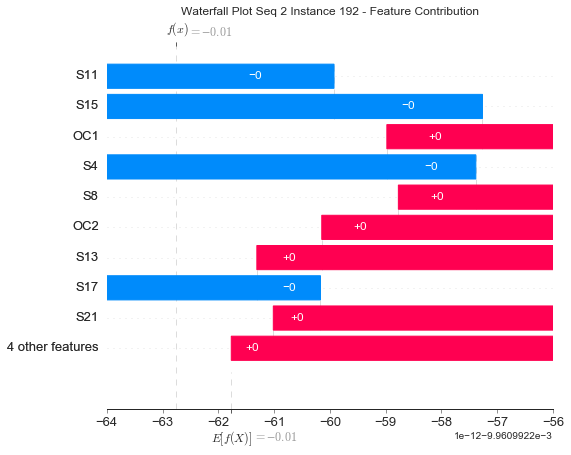

None

Contribution: [ 1.34857316e-12  1.30912317e-12  2.39128839e-13 -9.55079006e-13
 -4.37103392e-12  1.79101710e-12  4.13406375e-12 -7.80414362e-12
  3.09645647e-12  3.93601558e-12 -1.20294454e-12 -3.17462463e-12
  2.99885138e-12]


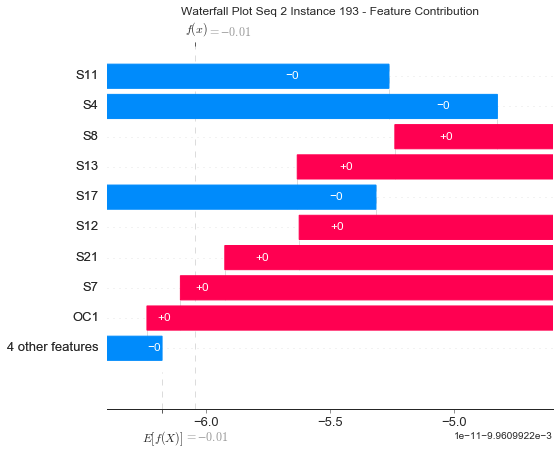

None

Contribution: [ 3.13804234e-12  2.07290348e-12  9.39182543e-14 -5.77366822e-13
 -1.86105948e-12  3.18026069e-13  1.52766710e-12 -3.38544861e-12
  5.62423047e-13  1.46301471e-12 -3.85519611e-12 -1.23140539e-12
  7.60832098e-13]


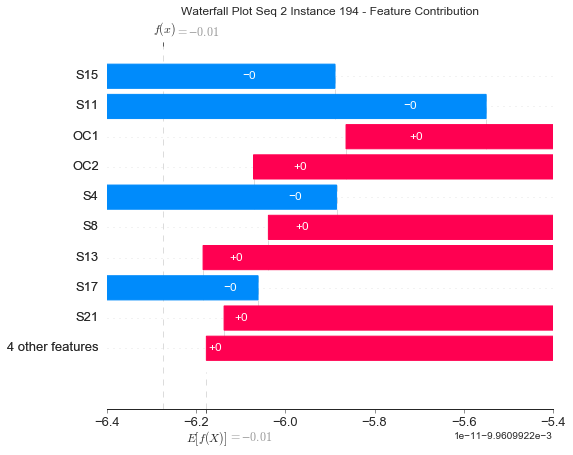

None

Contribution: [ 2.62209568e-12  3.11952764e-12  6.42334384e-13 -1.25586553e-12
 -4.87321771e-12  1.60242848e-12  4.92105488e-12 -9.02450076e-12
  2.95814436e-12  4.16660760e-12 -4.01288811e-12 -4.05387703e-12
  3.09924699e-12]


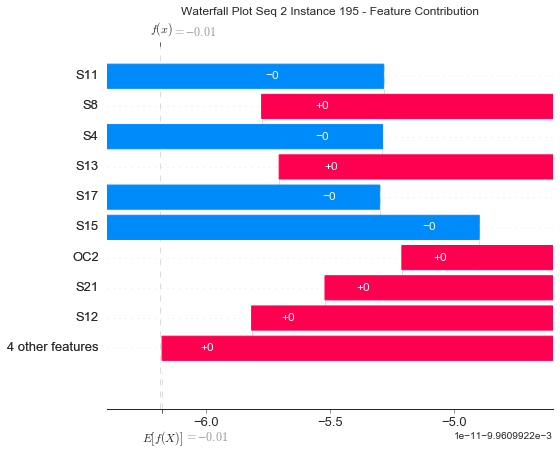

None

Contribution: [ 4.11427619e-12  3.67481046e-12  6.09466972e-14 -1.23403295e-12
 -4.36048550e-12  6.60754708e-13  5.02987539e-12 -9.44427696e-12
  1.21399939e-12  5.48045029e-12 -4.83691776e-12 -3.22425073e-12
  1.36028049e-12]


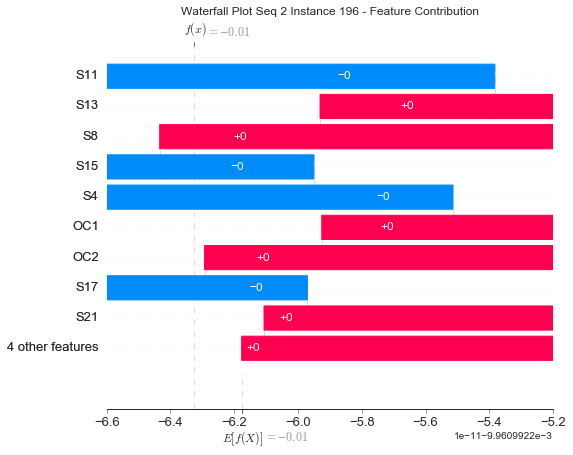

None

Contribution: [ 3.07744672e-12  3.98946197e-12  6.58534804e-13 -2.02244168e-12
 -9.85834591e-12  3.06458830e-12  8.82591743e-12 -1.67764830e-11
  5.73996536e-12  8.28163232e-12 -4.51147973e-12 -7.15602621e-12
  5.53190566e-12]


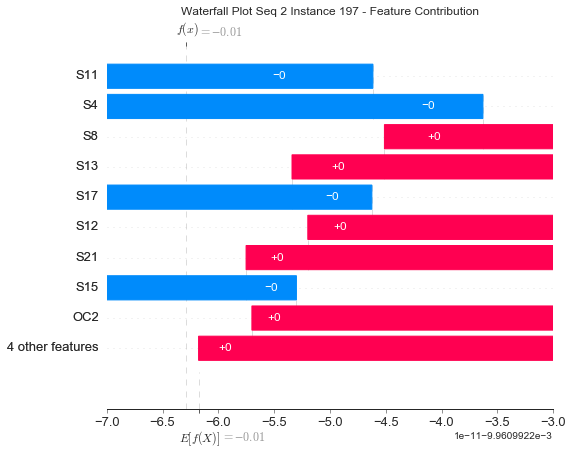

None

Contribution: [ 4.97735186e-12  5.50856496e-12  4.50659692e-13 -1.88305318e-12
 -7.63459955e-12  1.77039253e-12  8.17999488e-12 -1.50806347e-11
  3.45229531e-12  8.39044893e-12 -8.13709256e-12 -5.85806837e-12
  3.57922893e-12]


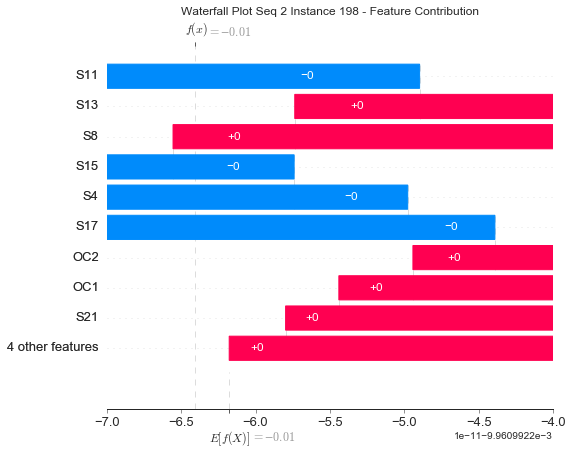

None

Contribution: [ 3.30508212e-12  4.33806593e-12  1.34834624e-12 -2.96743576e-12
 -1.72897478e-11  6.24238682e-12  1.41330688e-11 -2.74872538e-11
  1.17467425e-11  1.29191944e-11 -4.81397734e-12 -1.26270218e-11
  1.11621112e-11]


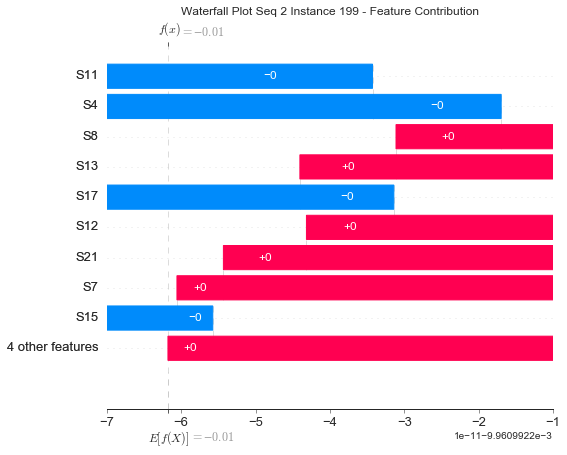

None

Contribution: [ 8.43347094e-12  8.36126481e-12  5.02303006e-13 -2.97719423e-12
 -1.36175012e-11  3.37625067e-12  1.40898465e-11 -2.57494373e-11
  6.19779532e-12  1.45123705e-11 -8.39442404e-12 -9.91702380e-12
  6.26176801e-12]


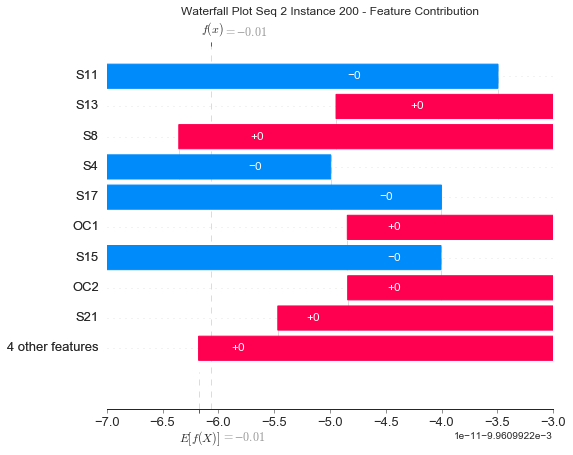

None

Contribution: [ 8.37135569e-12  7.26078182e-12  5.66819324e-13 -2.75533828e-12
 -1.39717213e-11  3.84480685e-12  1.20636296e-11 -2.43258452e-11
  7.22080859e-12  1.25702782e-11 -1.12469678e-11 -9.59733942e-12
  7.16490279e-12]


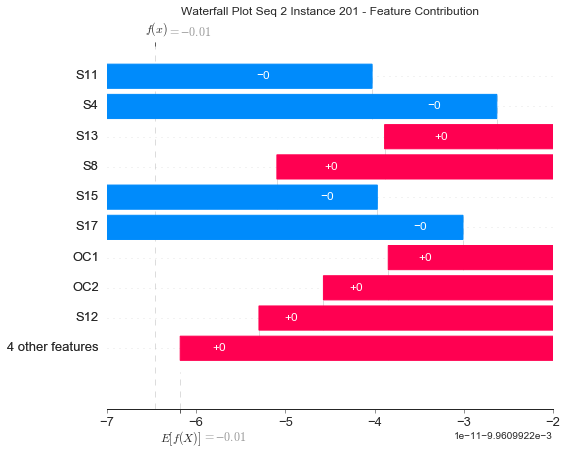

None

Contribution: [ 6.25921363e-12  7.05440394e-12  1.39890389e-12 -3.53770984e-12
 -2.30211163e-11  9.09553682e-12  1.74843751e-11 -3.49684587e-11
  1.64880713e-11  1.57575047e-11 -1.32521745e-11 -1.63972117e-11
  1.59838826e-11]


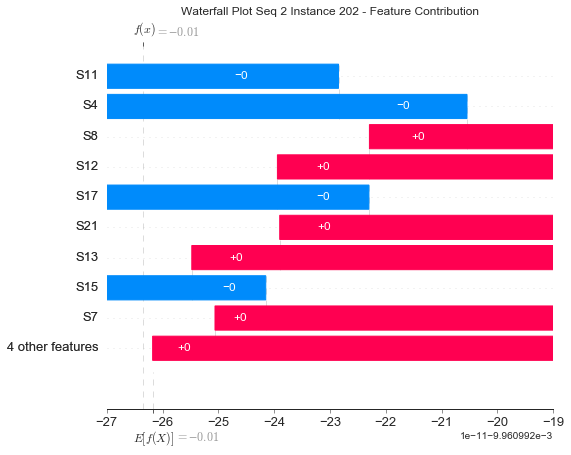

None

Contribution: [ 1.04424429e-11  1.13899393e-11  9.57066999e-13 -3.41433435e-12
 -1.66240841e-11  4.60299333e-12  1.33550566e-11 -2.83196418e-11
  8.89435574e-12  1.34606154e-11 -2.34100083e-11 -1.20844480e-11
  8.91258768e-12]


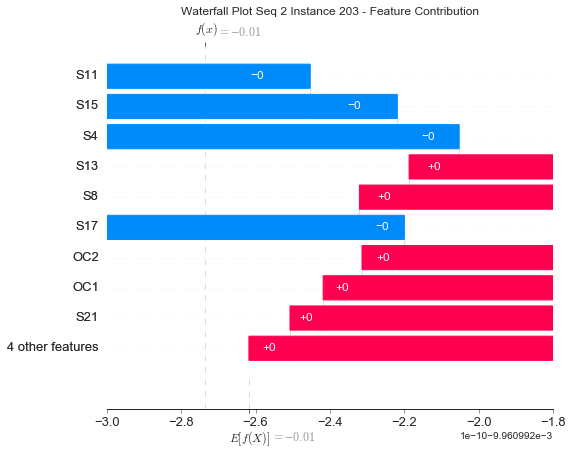

None

Contribution: [ 7.54596038e-12  1.03076879e-11  2.42139728e-12 -6.53355712e-12
 -3.97555634e-11  1.34589163e-11  3.10949079e-11 -6.26932811e-11
  2.53833864e-11  3.06102955e-11 -1.15323038e-11 -2.78951237e-11
  2.34451902e-11]


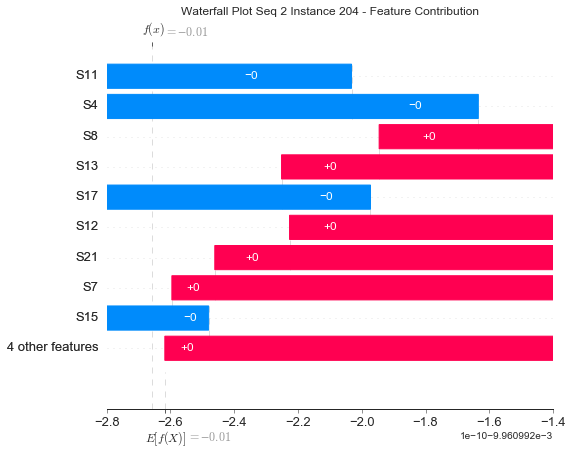

None

Contribution: [ 1.24476740e-11  1.63460964e-11  1.15133781e-12 -5.42360904e-12
 -3.10476853e-11  9.64389419e-12  2.68379364e-11 -5.16813259e-11
  1.77544108e-11  2.81907501e-11 -2.29338874e-11 -2.20025838e-11
  1.72484908e-11]


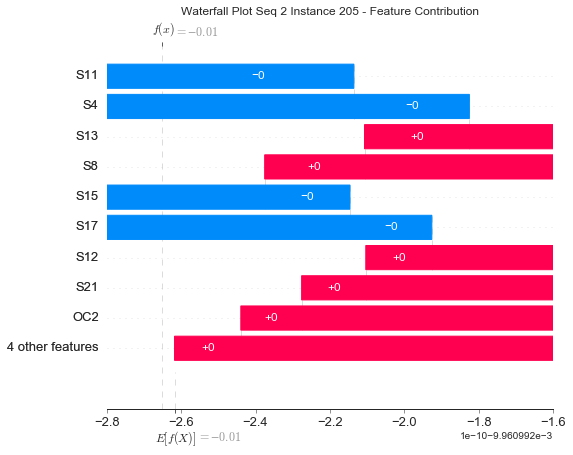

None

Contribution: [ 1.17678315e-11  1.28710653e-11  2.59149147e-12 -6.32028371e-12
 -3.95312116e-11  1.48215953e-11  2.86859946e-11 -5.97167940e-11
  2.75754784e-11  2.64842037e-11 -2.45209408e-11 -2.77599957e-11
  2.61711833e-11]


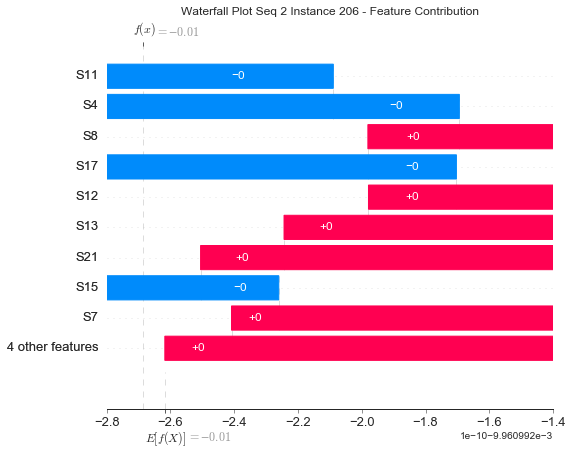

None

Contribution: [ 1.68408933e-11  1.86283038e-11  1.39122557e-12 -7.44762672e-12
 -4.49286858e-11  1.26389307e-11  3.54712995e-11 -7.24412197e-11
  2.40646808e-11  3.80837653e-11 -2.44684446e-11 -3.00334688e-11
  2.30136674e-11]


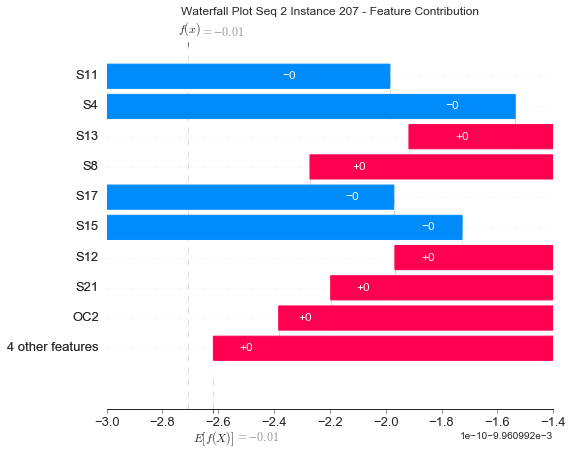

None

Contribution: [ 2.38536725e-11  2.34728331e-11  1.26440210e-12 -9.63219001e-12
 -4.89442341e-11  1.01880431e-11  4.35694363e-11 -8.73939740e-11
  1.99671148e-11  4.87050018e-11 -2.76616525e-11 -3.29262555e-11
  1.90195099e-11]


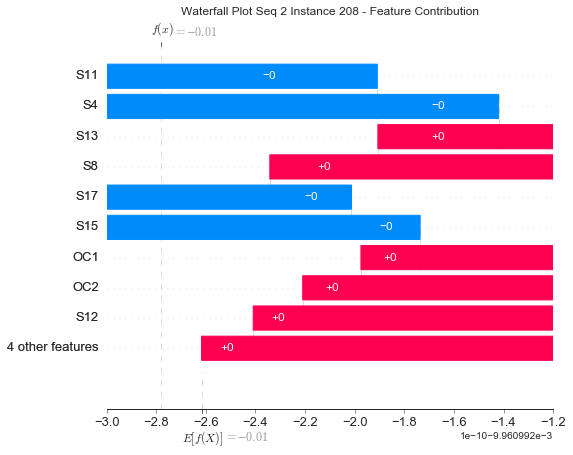

None

Contribution: [ 1.75330341e-11  2.53816794e-11  2.65957742e-12 -1.19329000e-11
 -7.32781613e-11  2.45645310e-11  5.68542331e-11 -1.13495123e-10
  4.60538899e-11  5.61108243e-11 -3.10926597e-11 -5.16342941e-11
  4.28336949e-11]


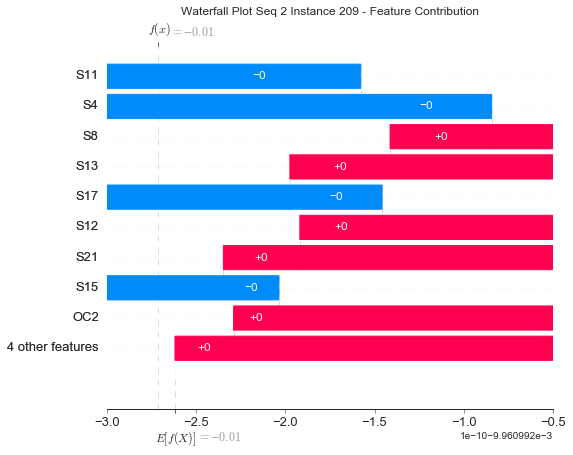

None

Contribution: [ 3.64510123e-11  3.25285493e-11  1.13642852e-12 -1.07093093e-11
 -5.49109126e-11  1.18502959e-11  5.00534822e-11 -9.77715686e-11
  2.20962120e-11  5.64353703e-11 -3.93048927e-11 -3.75017482e-11
  2.19176205e-11]


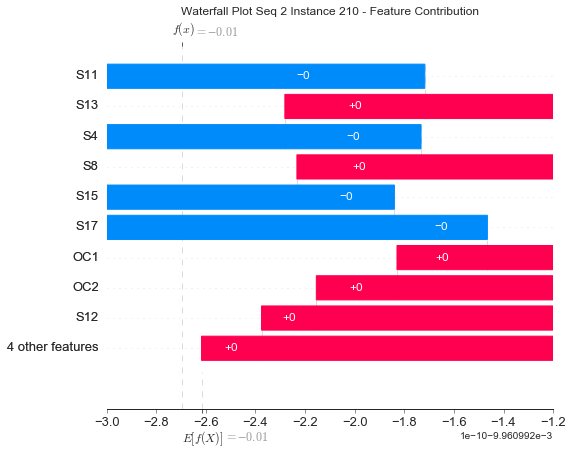

None

Contribution: [ 3.00769687e-11  2.67532801e-11  2.80656574e-12 -1.21903798e-11
 -6.77633574e-11  1.92604942e-11  5.00211990e-11 -1.07079123e-10
  3.71920862e-11  5.31971030e-11 -4.66829006e-11 -4.45790974e-11
  3.48136901e-11]


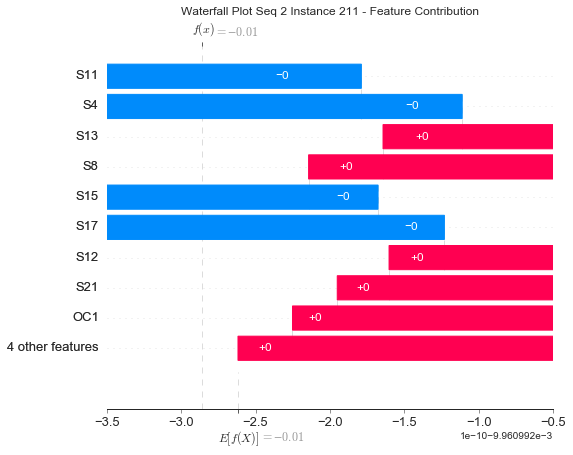

None

Contribution: [ 3.12526845e-11  3.54727081e-11  4.08830435e-12 -1.72597318e-11
 -1.01743246e-10  3.12447290e-11  7.88587529e-11 -1.60923982e-10
  5.89427535e-11  8.11157461e-11 -4.21224236e-11 -7.00483491e-11
  5.45055112e-11]


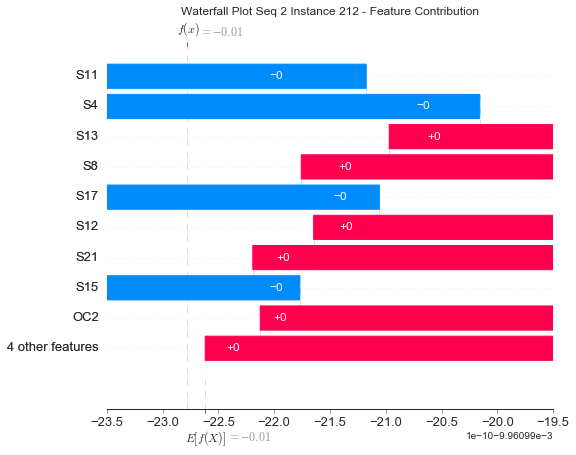

None

Contribution: [ 4.86059040e-11  3.89910743e-11  1.19295860e-12 -1.64293024e-11
 -8.38502531e-11  1.62013875e-11  7.21429999e-11 -1.48542303e-10
  3.18538251e-11  8.45505402e-11 -5.07398498e-11 -5.52445104e-11
  3.07539758e-11]


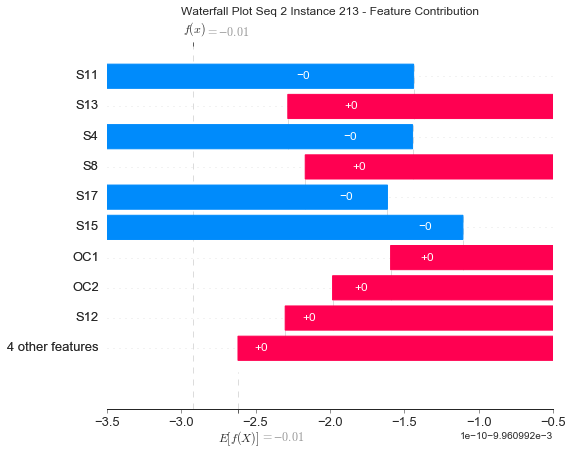

None

Contribution: [ 3.23047249e-11  3.36680371e-11  3.46575394e-12 -2.07890302e-11
 -1.35005035e-10  4.58148346e-11  9.63790922e-11 -2.00985839e-10
  8.43812520e-11  1.02051596e-10 -4.76325229e-11 -8.90680862e-11
  7.58863944e-11]


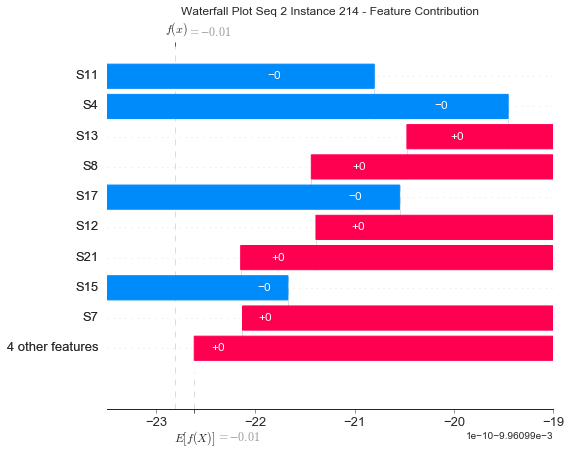

None

Contribution: [ 6.20899859e-11  5.91511770e-11 -2.14241081e-12 -1.88909825e-11
 -9.07076914e-11  2.14465286e-11  8.72107733e-11 -1.67778763e-10
  3.72663879e-11  1.05487175e-10 -7.55538132e-11 -6.21594790e-11
  3.58671252e-11]


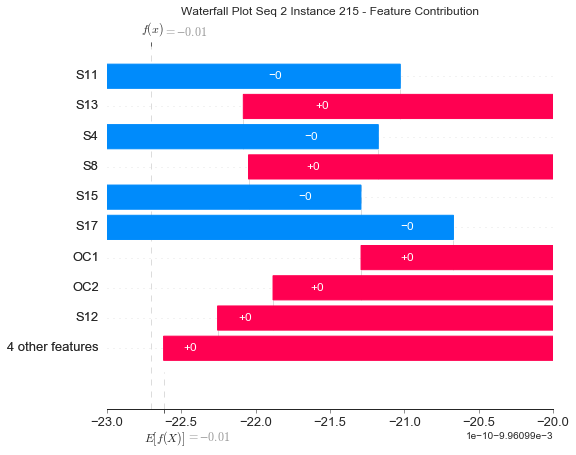

None

Contribution: [ 5.12234144e-11  4.45277981e-11  3.96778617e-12 -1.89474686e-11
 -1.09758508e-10  3.80507743e-11  7.00412228e-11 -1.60016722e-10
  7.03022085e-11  7.08550510e-11 -9.57870450e-11 -7.32618202e-11
  6.51793203e-11]


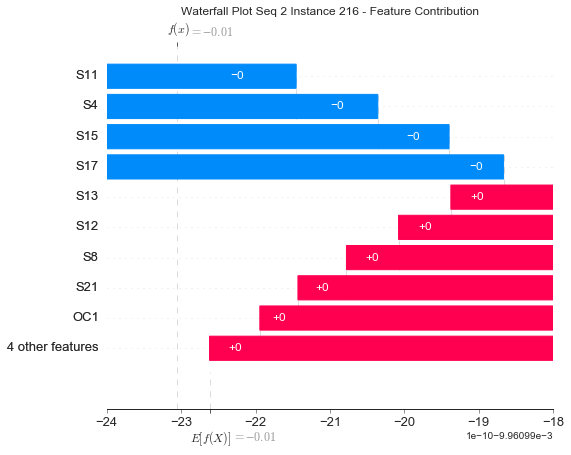

None

Contribution: [ 6.67917527e-11  6.66200151e-11  1.04876286e-12 -2.62947164e-11
 -1.37241218e-10  3.13515221e-11  1.16683649e-10 -2.36565045e-10
  5.75659104e-11  1.37385964e-10 -8.20523510e-11 -9.29614094e-11
  5.49435150e-11]


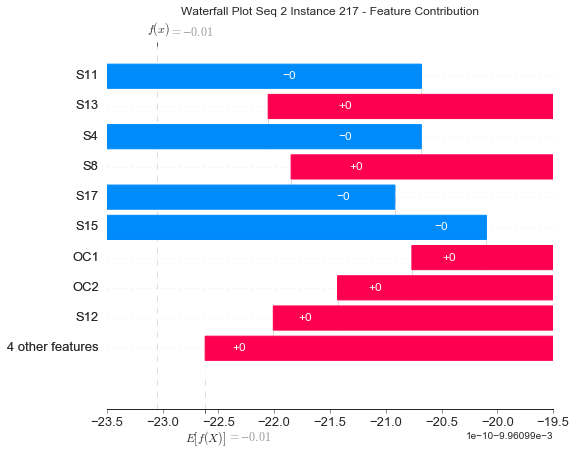

None

Contribution: [ 6.03851552e-11  6.28650673e-11  3.28002165e-12 -2.68096691e-11
 -1.58163441e-10  4.83193138e-11  1.20697966e-10 -2.53099680e-10
  8.92932742e-11  1.31761171e-10 -1.04257478e-10 -1.07066793e-10
  8.23486765e-11]


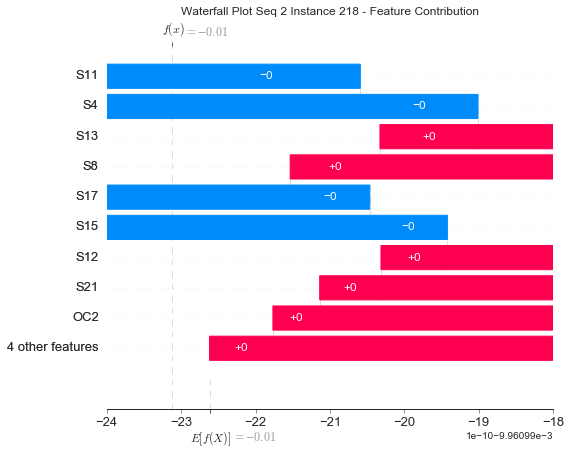

None

Contribution: [ 7.60135080e-11  7.27740715e-11  4.21966238e-12 -3.39320204e-11
 -1.99024297e-10  5.68487098e-11  1.62240915e-10 -3.28096161e-10
  1.04058644e-10  1.81186746e-10 -8.55174334e-11 -1.34923378e-10
  9.73464365e-11]


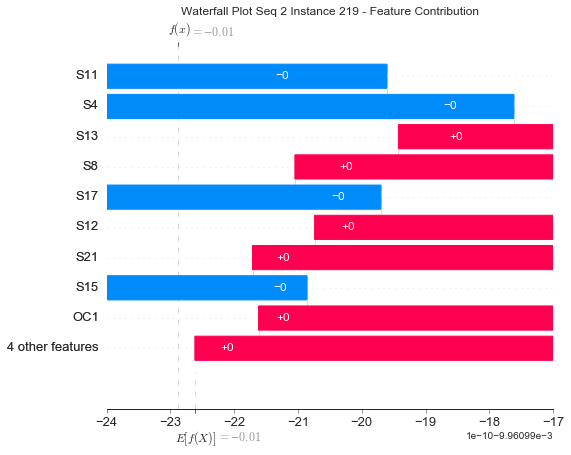

None

Contribution: [ 9.45043904e-11  8.55163509e-11  6.46088760e-13 -2.77046441e-11
 -1.40667505e-10  3.28941076e-11  1.12900654e-10 -2.39589820e-10
  5.94896216e-11  1.34122907e-10 -1.42151388e-10 -9.22793369e-11
  5.93743110e-11]


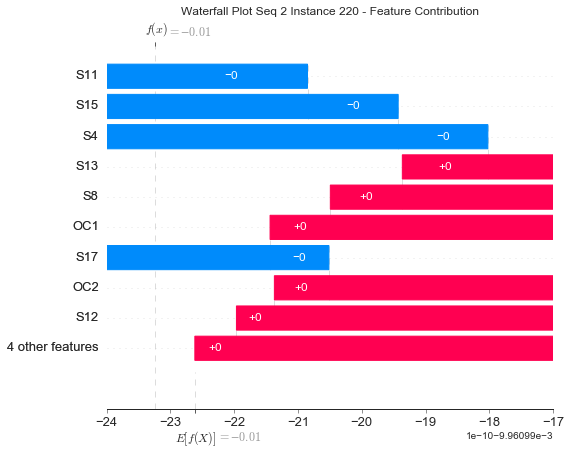

None

Contribution: [ 8.63743868e-11  8.64212521e-11  2.87855785e-13 -4.10258702e-11
 -2.16215754e-10  5.46031553e-11  1.79778512e-10 -3.78689219e-10
  9.84362175e-11  2.09487358e-10 -1.15680417e-10 -1.45481099e-10
  8.95695532e-11]


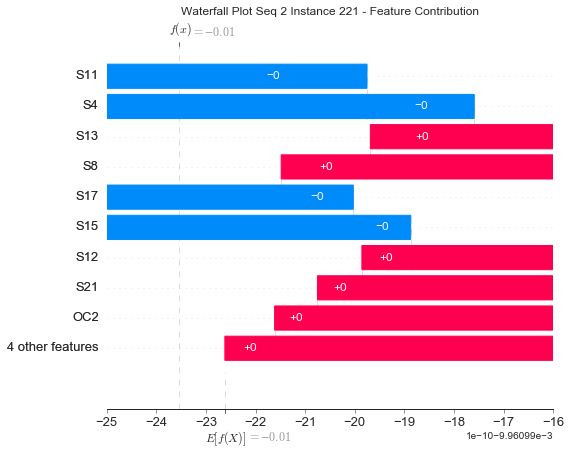

None

Contribution: [ 9.23989982e-11  9.60641844e-11  9.45655533e-12 -4.90809685e-11
 -2.66262429e-10  7.80960713e-11  2.07225057e-10 -4.29906832e-10
  1.44895221e-10  2.30372610e-10 -1.20172844e-10 -1.85009008e-10
  1.34927181e-10]


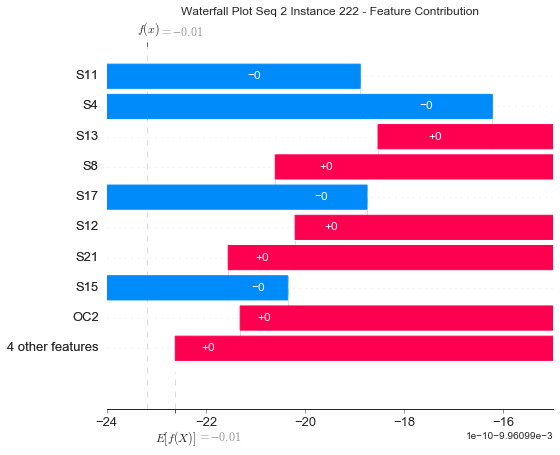

None

Contribution: [ 1.07733197e-10  9.20258869e-11  3.96507046e-12 -4.41500447e-11
 -2.50079041e-10  6.79424017e-11  1.81934828e-10 -3.93814759e-10
  1.22974186e-10  2.07954307e-10 -1.53233107e-10 -1.62682312e-10
  1.16271125e-10]


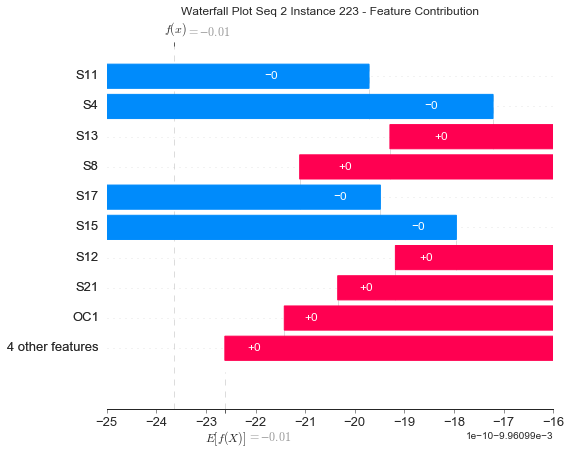

None

Contribution: [ 1.21447519e-10  1.39067924e-10  4.91010054e-12 -5.07186237e-11
 -2.42336817e-10  5.66883103e-11  2.14965157e-10 -4.33118236e-10
  1.05610465e-10  2.52710963e-10 -2.06014761e-10 -1.73509193e-10
  1.00371753e-10]


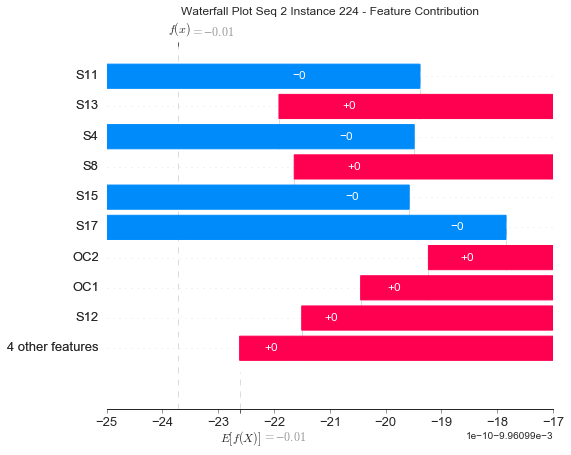

None

Contribution: [ 6.79208911e-11  8.45071027e-11  1.67148673e-11 -7.23385518e-11
 -4.59822985e-10  1.58752858e-10  3.06924125e-10 -6.58289978e-10
  2.93145841e-10  3.19465121e-10 -1.25626023e-10 -3.07703640e-10
  2.63000205e-10]


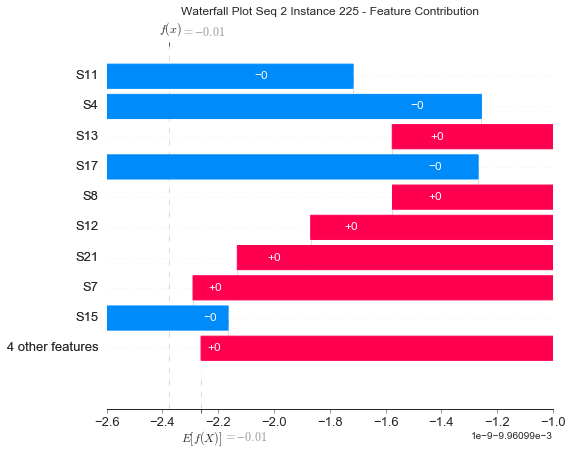

None

Contribution: [ 1.19073723e-10  1.11414260e-10  1.45065860e-11 -6.04672493e-11
 -3.78646031e-10  1.25841740e-10  2.52452254e-10 -5.51381607e-10
  2.30470087e-10  2.67705802e-10 -2.10550424e-10 -2.47653259e-10
  2.16776888e-10]


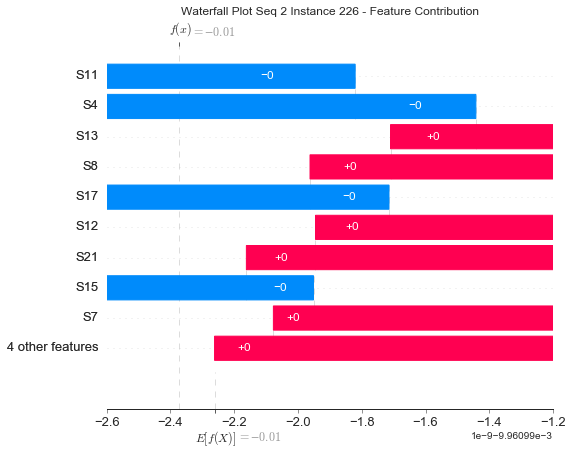

None

Contribution: [ 1.44609449e-10  1.31233330e-10  6.76409883e-12 -7.52162707e-11
 -4.06700673e-10  1.31911190e-10  3.01668135e-10 -6.40496156e-10
  2.38689207e-10  3.37682077e-10 -2.19855092e-10 -2.75066053e-10
  2.16835300e-10]


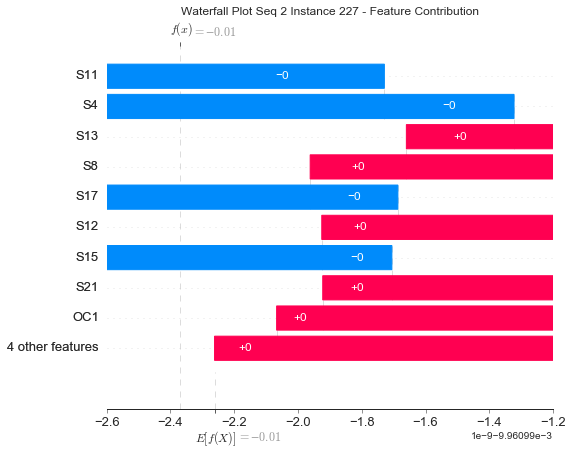

None

Contribution: [ 1.61591768e-10  1.80655074e-10  4.50796995e-12 -8.22936927e-11
 -4.38185710e-10  1.29024444e-10  3.48510387e-10 -7.11166459e-10
  2.25357150e-10  3.86679244e-10 -2.43494475e-10 -3.00026004e-10
  2.13932941e-10]


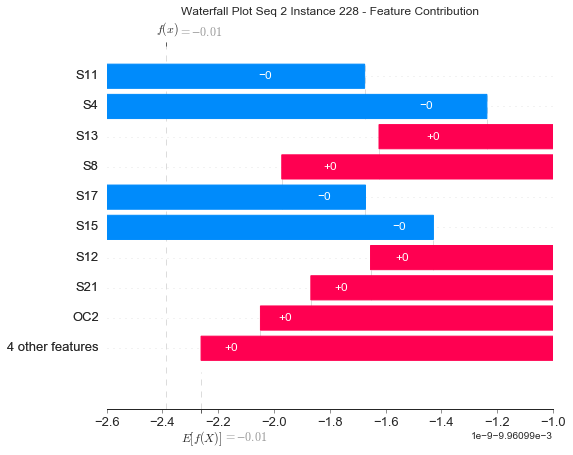

None

Contribution: [ 1.96923519e-10  1.91962002e-10 -1.04902672e-13 -8.46230516e-11
 -4.44119436e-10  1.35142925e-10  3.47408630e-10 -7.16061876e-10
  2.36146880e-10  3.92000626e-10 -2.76702383e-10 -2.90608371e-10
  2.22638394e-10]


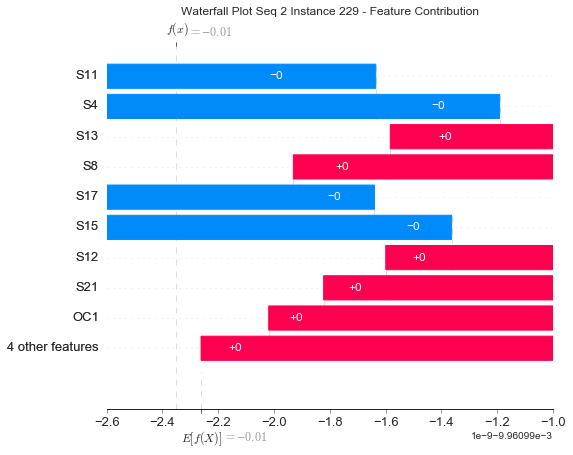

None

Contribution: [ 1.70184727e-10  1.93024124e-10  1.09334200e-11 -7.98144259e-11
 -4.15978890e-10  1.22901633e-10  3.70044245e-10 -7.26082638e-10
  2.16270307e-10  4.29852681e-10 -2.37214220e-10 -3.01218467e-10
  2.07955472e-10]


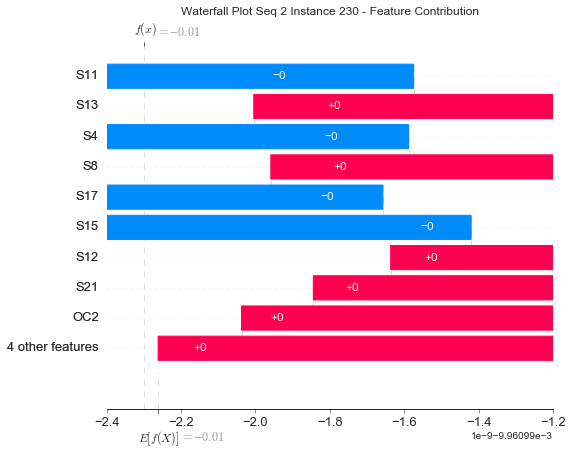

None

Contribution: [ 1.85701121e-10  2.02847725e-10 -1.48751792e-11 -8.38434669e-11
 -3.72738923e-10  9.95854441e-11  3.29006905e-10 -6.75567879e-10
  1.59895569e-10  3.96700200e-10 -3.21512483e-10 -2.44703868e-10
  1.48071749e-10]


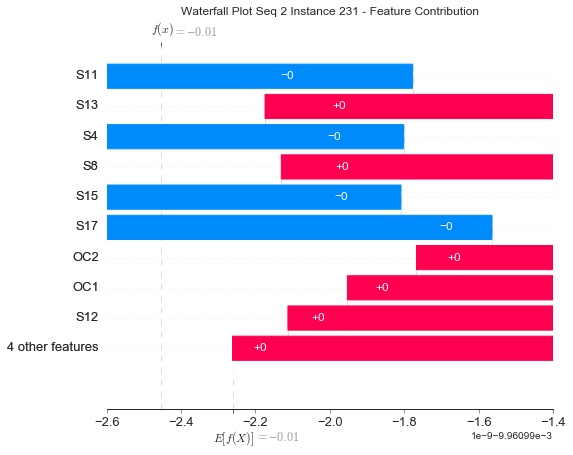

None

Contribution: [ 9.19566367e-11  1.46439777e-10  2.91023577e-11 -9.54962082e-11
 -5.69621628e-10  1.87884472e-10  4.19001472e-10 -8.74611106e-10
  3.42812806e-10  4.54282945e-10 -2.19781929e-10 -4.08121287e-10
  3.10878795e-10]


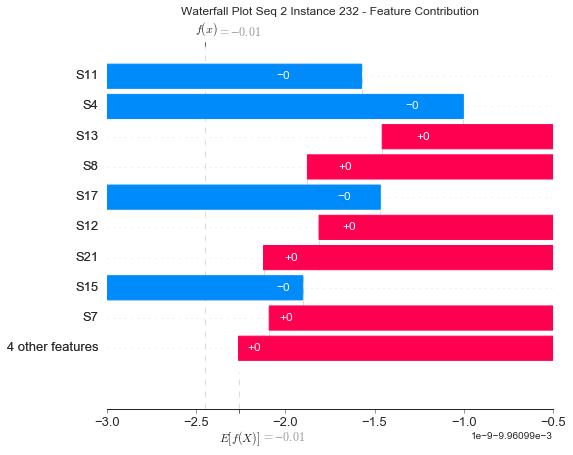

None

Contribution: [ 7.67827468e-11  1.39245601e-10  3.49379345e-11 -1.02200901e-10
 -6.36759367e-10  2.38630088e-10  4.27458069e-10 -8.97756314e-10
  4.29751595e-10  4.38109243e-10 -2.39291642e-10 -4.56140375e-10
  3.91723209e-10]


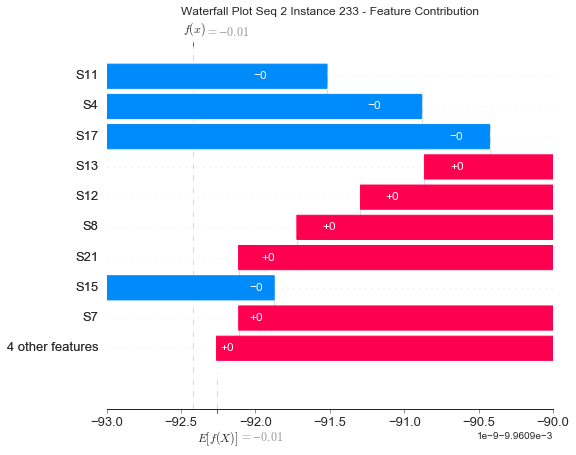

None

Contribution: [ 1.57659871e-10  2.38644438e-10  9.18948077e-12 -8.20763943e-11
 -4.36831016e-10  1.21881560e-10  3.76853160e-10 -7.17043258e-10
  2.10870849e-10  4.53598104e-10 -3.41873890e-10 -3.29749839e-10
  2.07338396e-10]


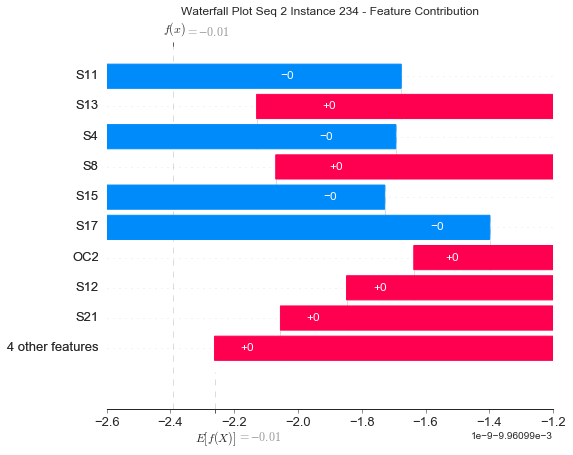

None

Contribution: [ 1.30424421e-10  1.71058515e-10  3.34914180e-11 -1.06988828e-10
 -6.63805899e-10  2.41811904e-10  4.78242501e-10 -9.61892899e-10
  4.20711882e-10  5.30856026e-10 -2.47499077e-10 -4.86663543e-10
  3.94967309e-10]


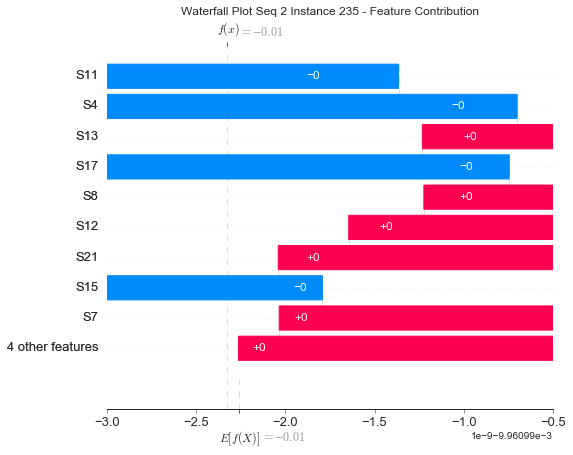

None

Contribution: [ 1.82418636e-10  1.82985627e-10  1.48997030e-11 -9.17644086e-11
 -5.78494808e-10  1.69783618e-10  4.16660317e-10 -8.59011029e-10
  2.98325337e-10  5.13744547e-10 -2.54715554e-10 -3.95855487e-10
  2.83640389e-10]


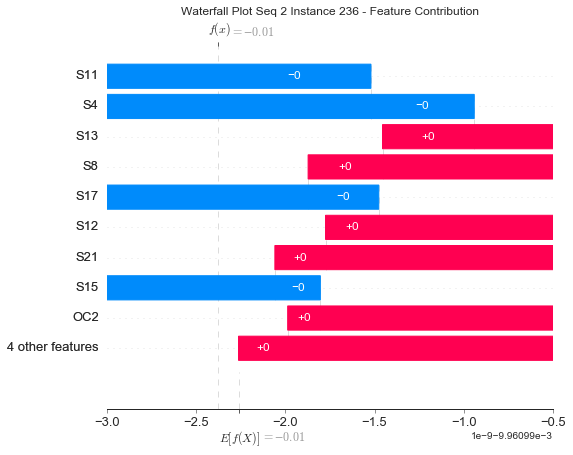

None

Contribution: [ 6.38778891e-11  1.29028288e-10 -3.05731948e-13 -9.54730600e-11
 -5.79354564e-10  2.29948102e-10  4.37585246e-10 -8.56671678e-10
  3.62787300e-10  5.12554277e-10 -1.59004573e-10 -4.13780232e-10
  3.32422978e-10]


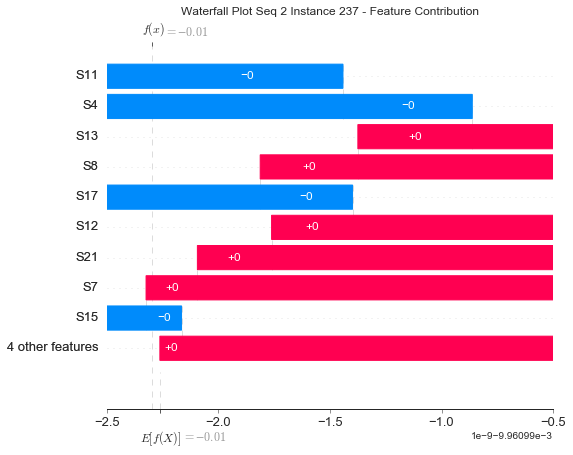

None

Contribution: [ 1.36690936e-10  1.43027798e-10  4.35803000e-12 -5.11648640e-11
 -2.89552909e-10  9.18136261e-11  2.63204819e-10 -4.74788209e-10
  1.57243121e-10  3.24507810e-10 -1.18401094e-10 -2.11749646e-10
  1.48538515e-10]


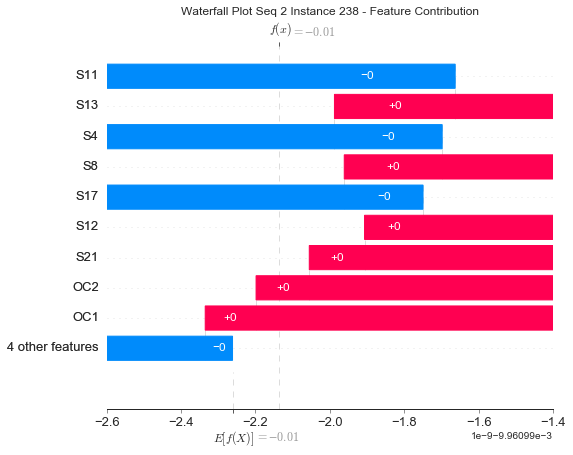

None

Contribution: [-3.85835044e-11  4.45737891e-11  1.48400285e-11 -1.00276185e-11
 -1.45915738e-10  7.30021182e-11  6.54487783e-11 -1.32714187e-10
  1.29140629e-10  5.76705038e-11 -1.16289721e-10 -1.22804808e-10
  1.23538527e-10]


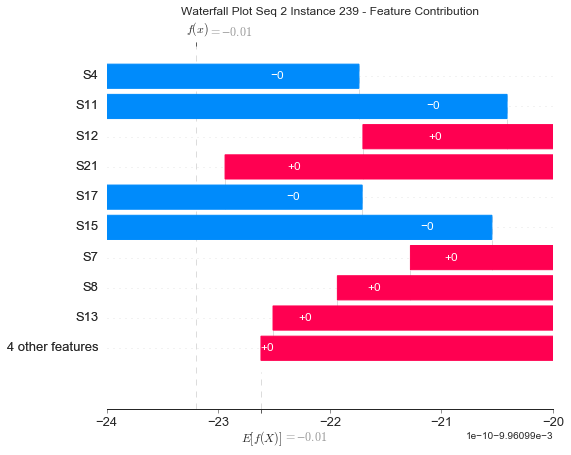

None

Contribution: [ 3.61622503e-11  7.06939993e-11  3.41379377e-13 -9.90912474e-12
 -4.32699154e-11  1.36937267e-11  7.23548305e-11 -1.06166943e-10
  2.06021519e-11  8.77699580e-11 -8.17040394e-11 -5.28012321e-11
  2.80050861e-11]


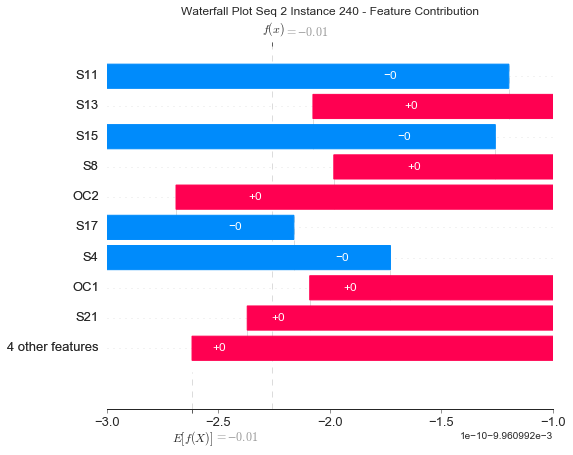

None

Contribution: [ 8.96250955e-12 -1.50400040e-11  2.04912858e-11  1.82666881e-12
 -4.21683036e-11  7.04245906e-12 -9.10439085e-12 -1.54552707e-11
  2.47718634e-11 -2.46406940e-11 -6.42946182e-11 -2.15344183e-11
  2.85709078e-11]


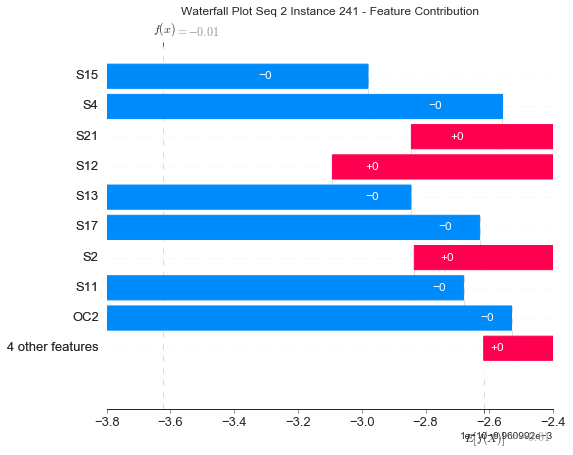

None

Contribution: [-1.17451951e-10 -5.66601800e-11  5.49889995e-11 -2.81878357e-11
 -2.55434479e-10  1.22807417e-10  1.23589403e-10 -2.70793915e-10
  2.49576609e-10  4.96731406e-11  2.34097186e-11 -1.92863864e-10
  2.28630434e-10]


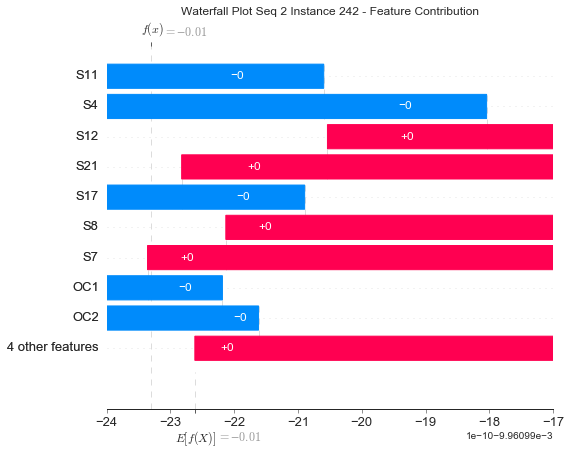

None

Contribution: [-7.65450758e-11  1.76298160e-11  2.30468943e-11 -3.15643692e-11
 -2.87159990e-10  1.01836366e-10  2.28150970e-10 -3.97608224e-10
  1.96907352e-10  2.08168885e-10  1.11055103e-10 -2.11961240e-10
  1.83749682e-10]


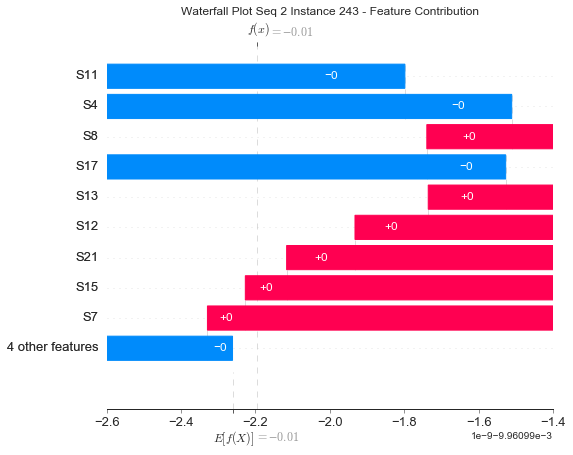

None

Contribution: [-9.43519481e-12  7.89086643e-11  1.43441587e-11  2.34256451e-11
  9.67628824e-11 -8.58843031e-12 -5.26454436e-11  1.79962892e-10
 -1.81289133e-11 -9.94389224e-11 -1.64787795e-10  3.94058501e-11
 -8.87389283e-13]


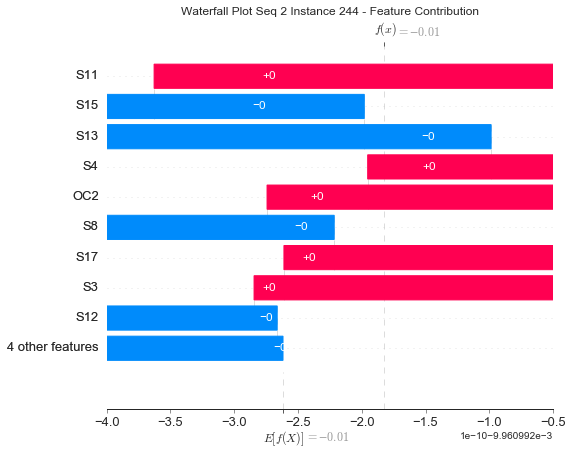

None

Contribution: [-1.97374430e-12  3.11153395e-11 -2.80229355e-12 -1.78894764e-11
 -6.50182547e-11 -4.11361049e-12  9.80519138e-11 -1.58635119e-10
 -3.51816406e-12  1.31645528e-10 -2.72860085e-11 -4.97948904e-11
 -5.80587661e-12]


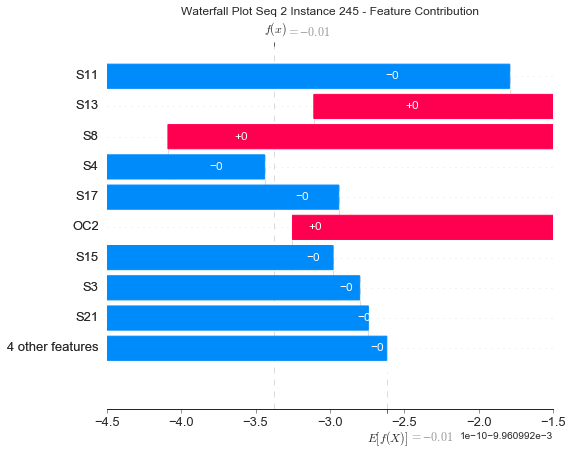

None

Contribution: [-9.23344526e-11  5.47951580e-11  2.56318352e-11  2.29049267e-12
 -8.05138664e-11  5.05353016e-11  7.86792437e-11 -9.52280060e-11
  9.14074302e-11  3.82645859e-11 -9.47950399e-11 -7.59975902e-11
  9.03899733e-11]


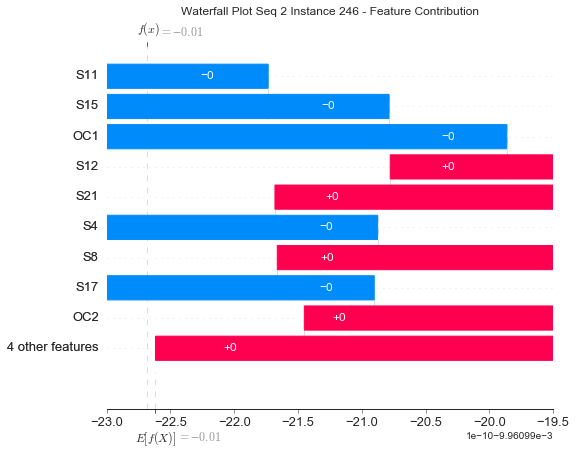

None

Contribution: [ 4.20716656e-11  1.97228081e-10 -1.20005360e-11  3.80329448e-12
  1.27755223e-10 -1.29200622e-10  7.50671331e-11 -1.21851522e-11
 -2.19328639e-10  1.36427578e-10 -1.77666049e-10  5.60818336e-11
 -1.82264356e-10]


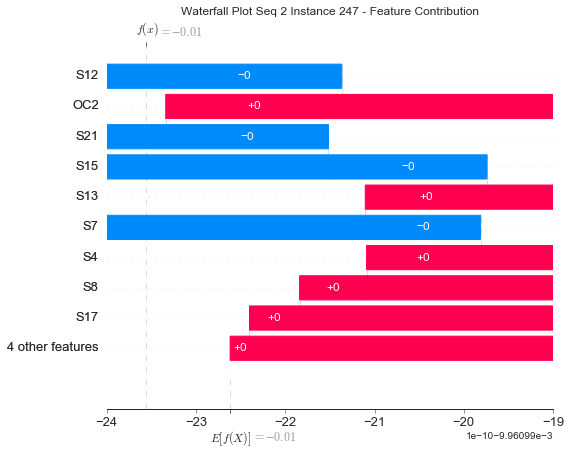

None

Contribution: [-9.14624973e-11 -1.69820737e-11  9.02477919e-12 -6.03374642e-11
 -3.90424360e-10  1.18686297e-10  3.63077651e-10 -6.73292089e-10
  2.04166878e-10  4.14562690e-10  1.82410712e-10 -2.80115375e-10
  1.65381042e-10]


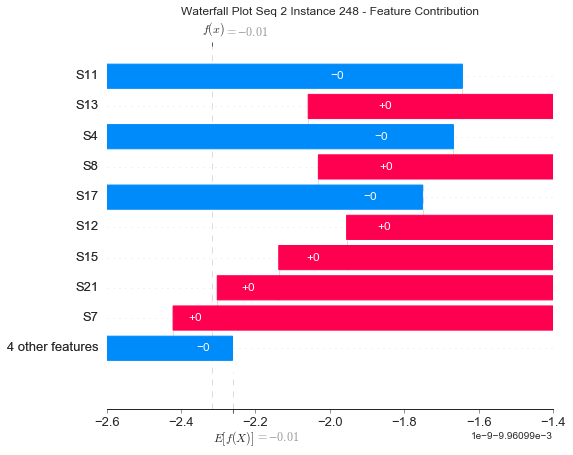

None

Contribution: [-8.98045388e-11  5.13671779e-11  2.89760282e-11 -4.05867961e-12
 -1.63714486e-10  1.19504975e-10  1.09002189e-10 -1.46248749e-10
  2.24801872e-10  2.57613583e-11 -8.16842496e-11 -1.45656445e-10
  2.18003282e-10]


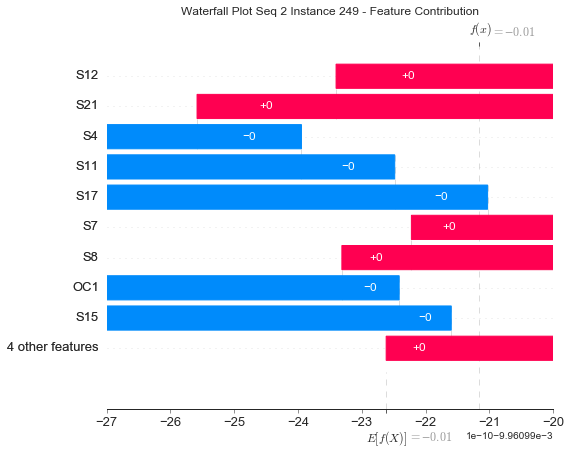

None

Contribution: [ 1.26174099e-10  1.40037065e-10 -6.50412536e-12  2.62786581e-11
  1.72743930e-10 -7.98779862e-11  3.57461213e-11  1.33897574e-10
 -1.58280250e-10  8.57336077e-11 -5.46283019e-11  1.11036597e-10
 -1.24683486e-10]


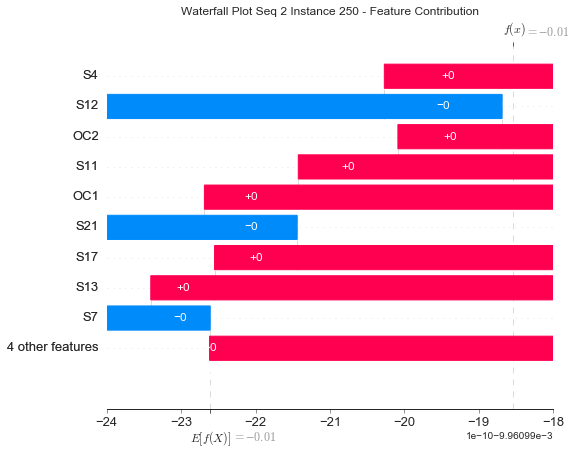

None

Contribution: [ 6.49384435e-11  1.56253593e-10 -6.12763520e-11  4.27945353e-11
  4.93038943e-10 -2.42399240e-10 -1.49988591e-10  4.41407966e-10
 -4.71735428e-10 -3.93416306e-11 -2.36110298e-10  3.07083053e-10
 -4.16431667e-10]


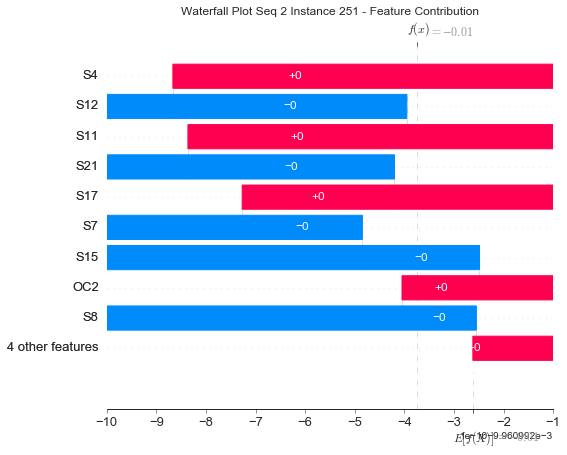

None

Contribution: [-1.27729632e-10  1.12385795e-11  4.90775337e-11 -6.27559532e-11
 -3.86808002e-10  1.62889868e-10  2.83126717e-10 -5.54810198e-10
  3.11790982e-10  2.18197127e-10  2.01673990e-11 -3.09601567e-10
  2.63236072e-10]


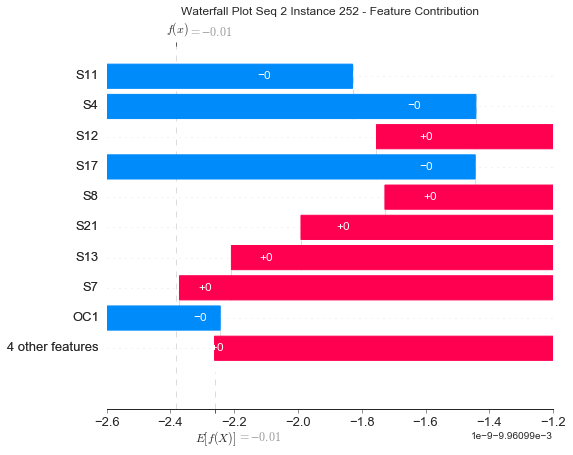

None

Contribution: [-6.19069657e-11  1.20529753e-10  3.60474775e-11 -2.22312429e-11
 -2.02491801e-10  8.37915431e-11  1.55866403e-10 -1.85723895e-10
  1.80433585e-10  7.40426262e-11 -9.51156168e-11 -1.61275632e-10
  1.68631456e-10]


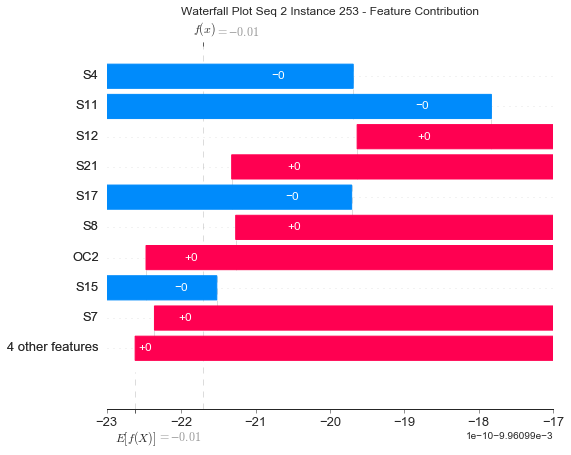

None

Contribution: [ 1.05518976e-10  1.07143273e-10 -2.09377481e-12  7.85591731e-12
  1.22366853e-10 -1.00497041e-10  5.29727096e-11  5.09881373e-11
 -1.50131588e-10  7.48108034e-11 -6.09508485e-11  7.53173773e-11
 -1.10764224e-10]


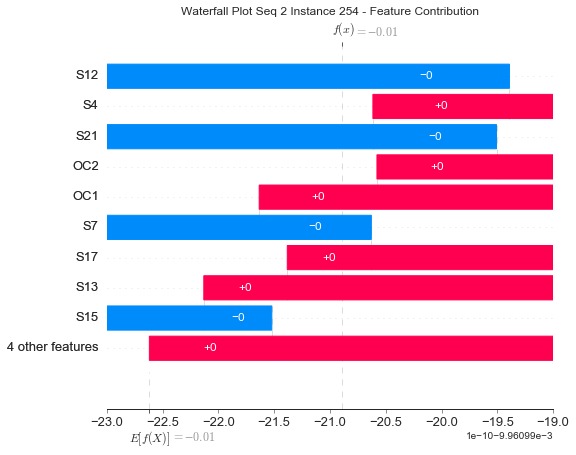

None

Contribution: [-2.19305227e-10 -2.19403953e-10  3.87766798e-11 -2.95795437e-11
 -4.82797580e-10  2.18505325e-10  1.84917193e-10 -4.97647812e-10
  4.07478135e-10  8.10186501e-11  1.51066715e-10 -3.03751274e-10
  3.65058955e-10]


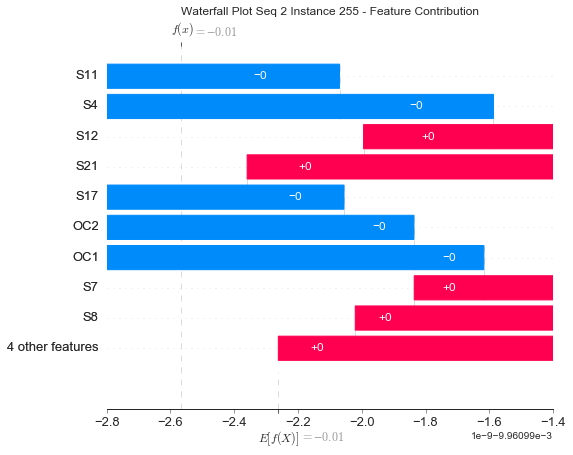

None

Contribution: [ 1.93493416e-10  1.95511329e-10 -4.08329551e-11 -4.65791780e-11
  6.64906741e-11 -2.08211268e-10  2.00361602e-10 -2.71320244e-10
 -3.70935477e-10  3.74834691e-10  1.37526778e-11  5.26193256e-11
 -3.25726196e-10]


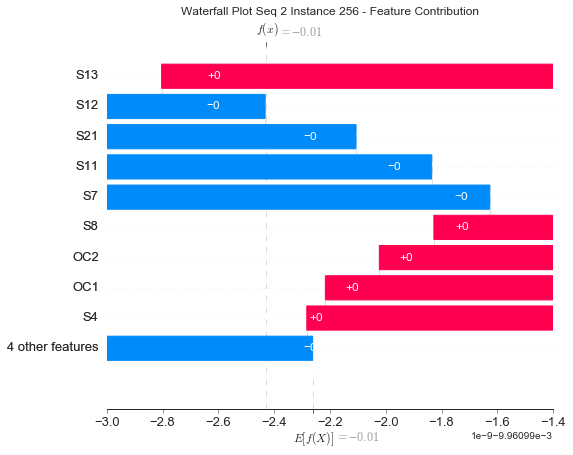

None

Contribution: [-2.18149235e-10 -2.46666965e-10  4.34263875e-11 -5.37398424e-11
 -4.92121122e-10  2.84866269e-10  1.80689491e-10 -4.98357577e-10
  4.79446760e-10  1.04151028e-10  1.43891246e-10 -3.39319128e-10
  4.16974788e-10]


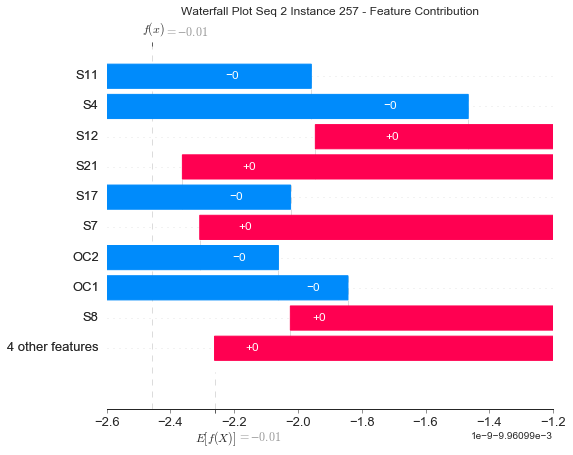

None

Contribution: [-9.65275082e-12 -2.14288760e-11  2.79852825e-11 -5.54783650e-11
 -4.43052872e-10  2.05430464e-10  1.72829279e-10 -3.64103636e-10
  4.01839451e-10  1.20174121e-10  1.34809219e-10 -2.82095347e-10
  3.49753754e-10]


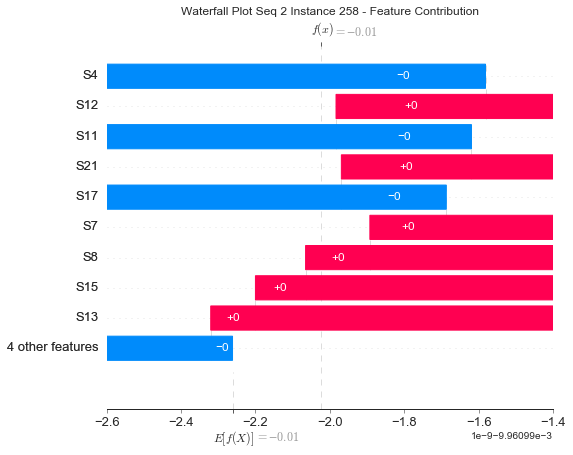

None

Contribution: [ 6.30347077e-12 -2.86679569e-10 -5.00165935e-13  4.03049955e-11
  7.04708653e-11 -1.05579816e-11 -3.54848706e-10  4.86315377e-10
  1.18518530e-12 -3.74899806e-10 -9.55925408e-11  2.04079892e-10
  1.69487202e-11]


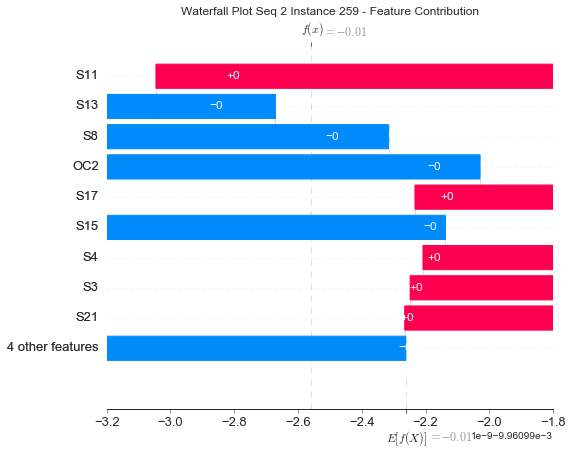

None

Contribution: [-3.60078412e-10 -4.25697283e-10  7.14595674e-11 -1.85626528e-10
 -1.33869993e-09  6.14795659e-10  6.67136457e-10 -1.67025060e-09
  1.09922460e-09  6.49237442e-10  6.29490071e-10 -8.85670870e-10
  9.36170141e-10]


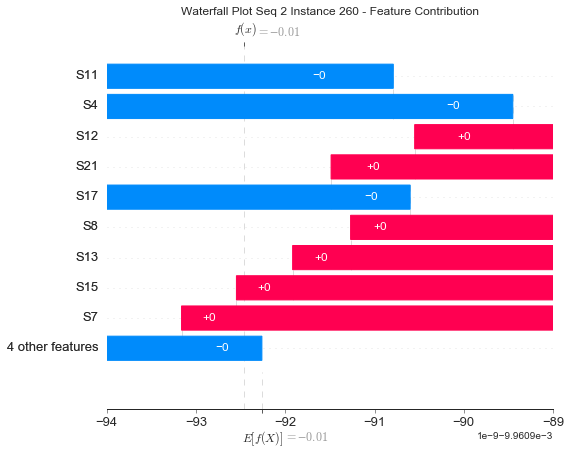

None

Contribution: [ 1.51113445e-11  2.15529428e-10  3.42946678e-11  1.11579392e-11
  4.02695294e-10  6.19070906e-11 -2.81123402e-10  6.89518775e-10
  6.19952908e-11 -4.73063588e-10 -8.43388970e-10  9.77947862e-11
  1.26966909e-10]


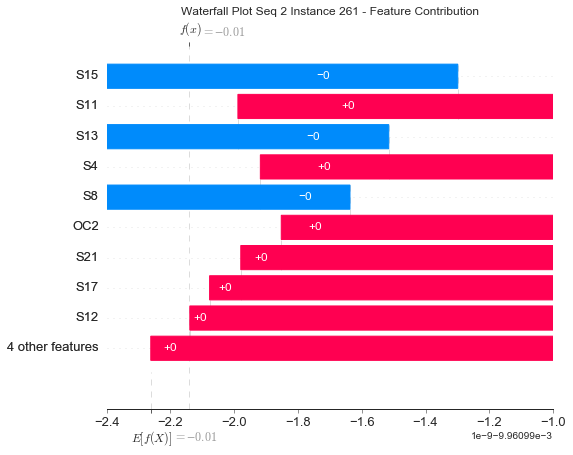

None

Contribution: [ 8.45165951e-12 -1.07905481e-11 -8.31829917e-12  1.19753339e-11
  1.34452935e-10 -1.04443440e-10 -3.48551715e-10  5.78645243e-10
 -1.23809837e-10 -4.21733620e-10 -5.31369004e-10  1.73856943e-10
 -8.36877651e-11]


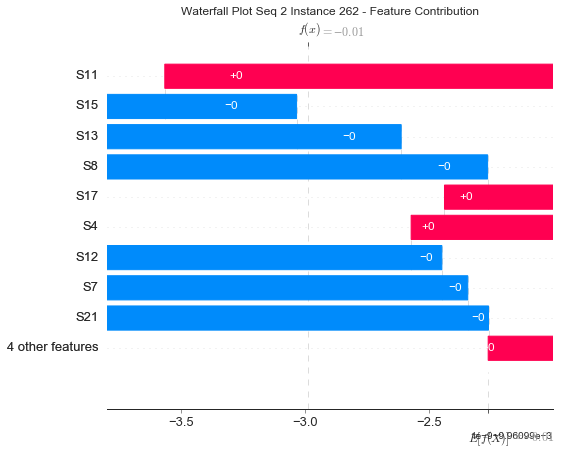

None

Contribution: [-7.98978106e-10 -7.43481332e-10  1.72946671e-10 -2.63349065e-10
 -2.42042653e-09  1.34144085e-09  9.32465327e-10 -2.38124587e-09
  2.38664510e-09  5.49887746e-10  6.91595170e-10 -1.58952329e-09
  2.05155359e-09]


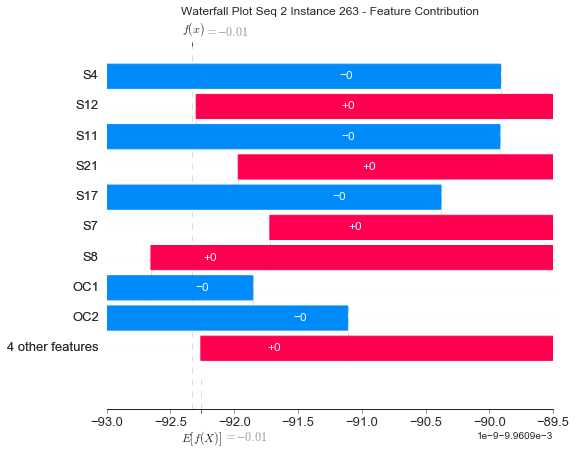

None

Contribution: [ 4.19708129e-10  1.48146898e-10 -1.98304324e-11 -5.21497845e-11
  3.72543038e-11 -1.59440863e-10  1.42502982e-10 -2.29377128e-10
 -2.91867225e-10  4.34146302e-10 -1.54995683e-10  2.09235979e-11
 -2.70433453e-10]


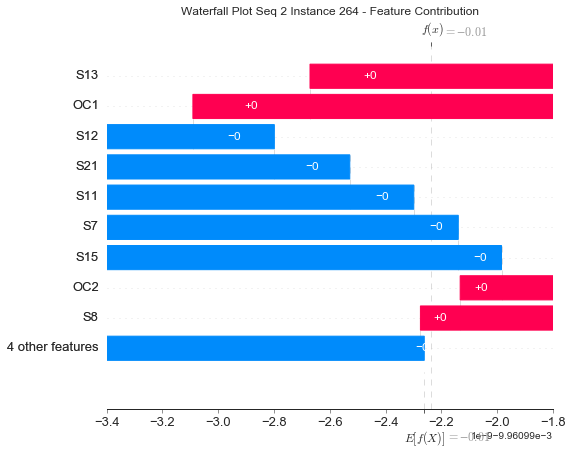

None

Contribution: [-1.56393398e-10  2.05723577e-10  2.62501982e-11 -2.60097721e-10
 -1.61187763e-09  5.34662425e-10  1.16487631e-09 -2.23746444e-09
  9.97402383e-10  1.37625666e-09  3.39941408e-10 -1.05184816e-09
  8.32023450e-10]


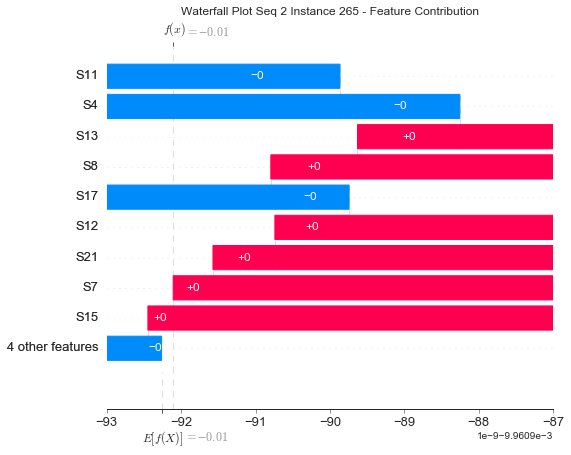

None

Contribution: [-1.59396954e-10 -1.44307288e-10 -8.01949548e-11 -2.95065167e-10
 -1.97271843e-09  1.06119169e-09  1.45862888e-09 -3.04823966e-09
  1.80030024e-09  1.85234139e-09  8.26988256e-10 -1.16814647e-09
  1.36272460e-09]


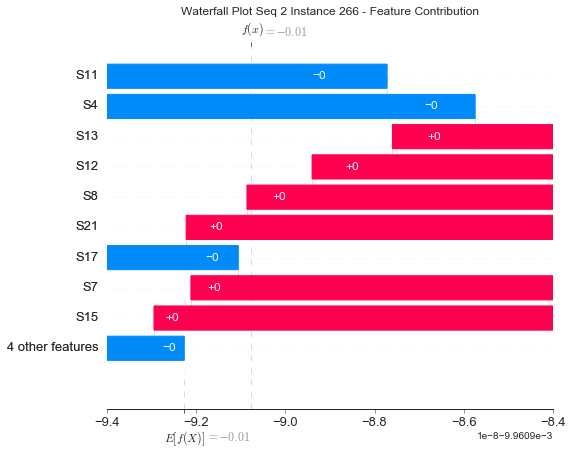

None

Contribution: [ 1.68437364e-09  1.18968679e-09 -1.19840499e-10 -7.41631409e-11
  1.05306730e-09 -5.44987833e-10  2.10690465e-10  2.74854778e-10
 -1.15280796e-09  9.65091451e-10 -9.24665566e-10  5.32819178e-10
 -8.95692964e-10]


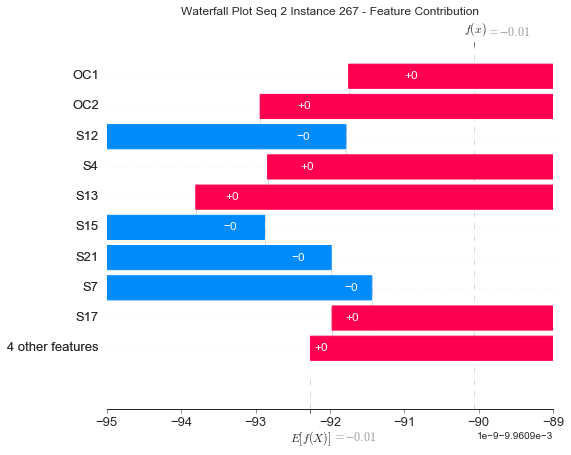

None

Contribution: [ 6.48415488e-10  2.59288591e-10  2.13952731e-10  1.03375711e-10
  2.21225704e-10  3.97076150e-10 -1.00723807e-09  1.50926116e-09
  6.26572960e-10 -1.57030211e-09 -8.45666648e-10  8.83620954e-11
  6.97522928e-10]


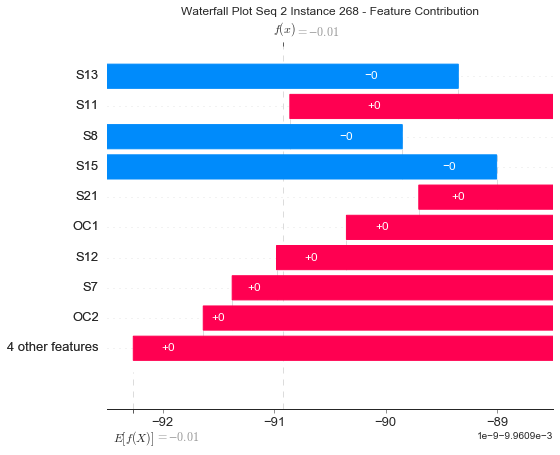

None

Contribution: [ 2.04975614e-09  6.61202537e-10  1.15769463e-10 -4.00016825e-10
 -1.02061593e-09  4.06011440e-11  9.91724480e-10 -2.41528864e-09
  4.58461567e-11  1.56211821e-09 -2.19807488e-11 -7.90115751e-10
  1.30458408e-10]


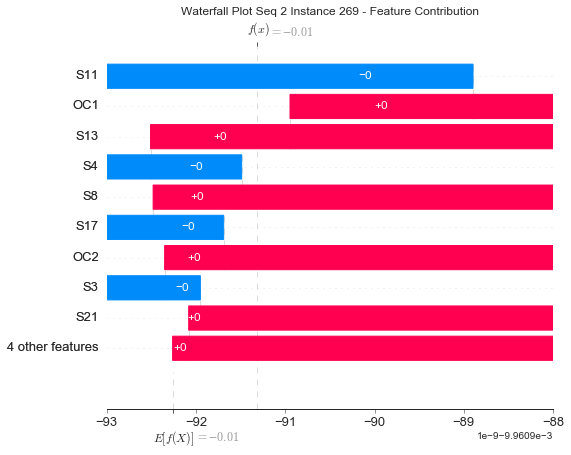

None

Contribution: [ 1.65155845e-09  1.18252985e-09  1.52617988e-10 -1.07929311e-10
 -5.90275181e-12 -1.39114179e-10  3.31516925e-10 -2.51816901e-10
 -3.63664099e-10  7.32056193e-10 -7.54197815e-10 -2.55236193e-10
 -1.49780396e-10]


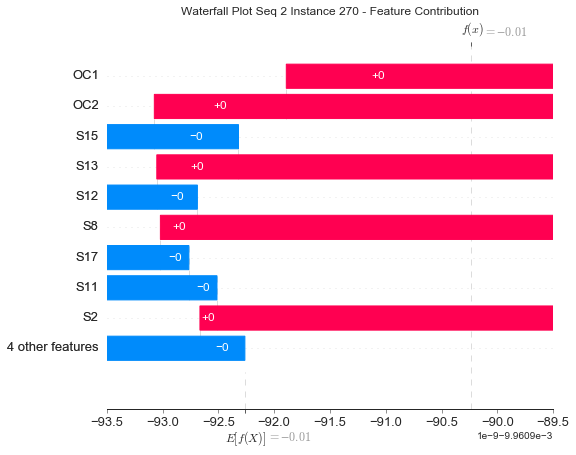

None

Contribution: [ 1.47478529e-09  6.87541468e-10  2.34233632e-10 -6.29212377e-11
  5.72986159e-10 -1.46380991e-10  2.74250900e-10 -3.23037541e-10
 -4.50268933e-10  8.30925273e-10  1.39498774e-10 -7.15845022e-11
 -1.89948821e-10]


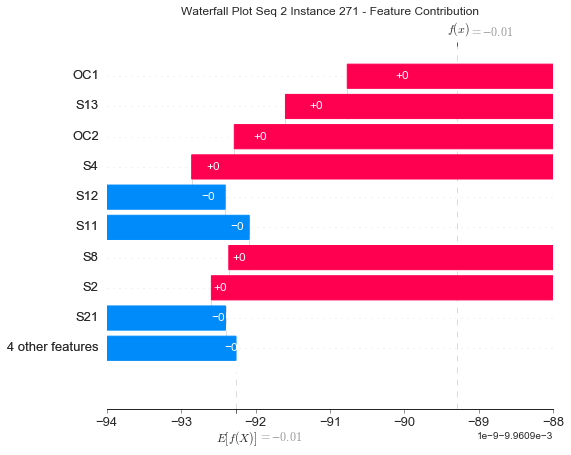

None

Contribution: [ 9.26613231e-10  4.83203755e-11  4.85793128e-10  5.00962050e-10
  1.85159454e-09 -2.43987497e-10 -2.16777507e-09  4.12749923e-09
 -7.28585525e-10 -2.48376097e-09 -8.74904371e-10  5.23712296e-10
 -2.43755627e-10]


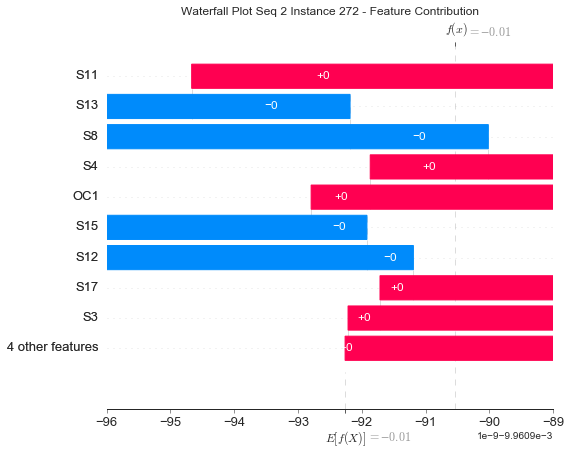

None

Contribution: [ 1.05481708e-11  2.64599648e-10  1.23058660e-10  2.79210405e-10
  9.18270571e-10  1.47615031e-10 -1.35906797e-09  2.38898434e-09
  2.11245382e-10 -1.94454475e-09 -1.25006350e-09  4.82138551e-10
  2.74975764e-10]


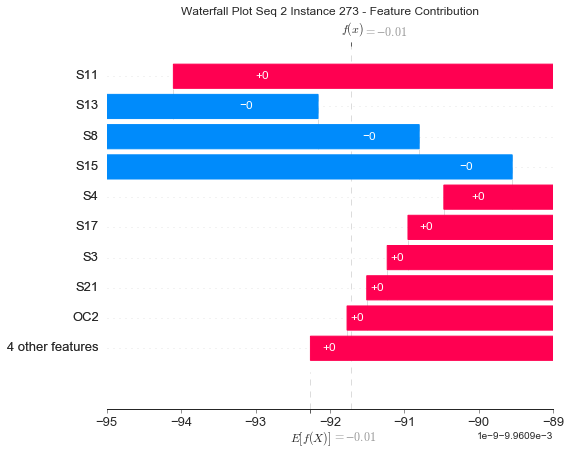

None

Contribution: [ 2.90952218e-09  1.34062816e-09  5.28693089e-10  1.64999767e-11
  1.69641945e-09 -1.34535694e-09  4.59990067e-11  4.23409779e-10
 -2.55085064e-09  8.92497853e-10  3.72256358e-11  2.22045646e-10
 -1.76701220e-09]


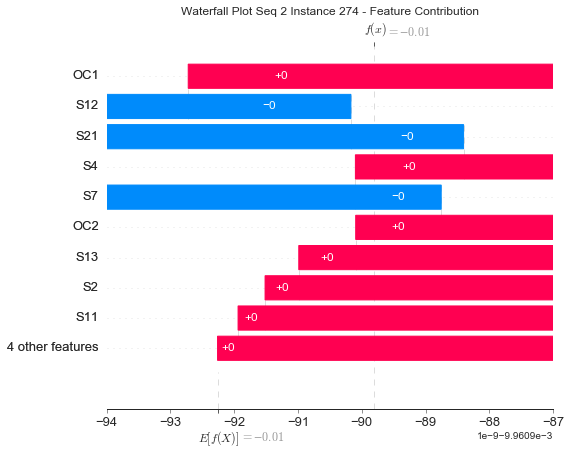

None

Contribution: [ 9.07344477e-10  9.81135728e-10  6.46354137e-10  1.07641740e-09
  5.24490851e-09 -2.56157739e-09 -4.58503013e-09  9.17749166e-09
 -4.14765333e-09 -4.93593921e-09 -4.30645386e-09  2.40622811e-09
 -2.96529978e-09]


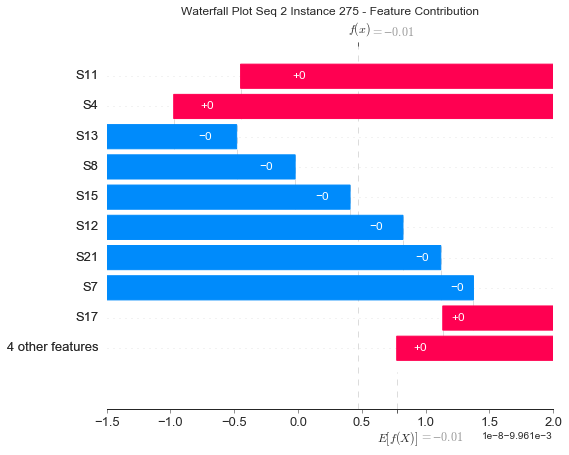

None

Contribution: [ 2.34439523e-10  9.27371846e-10  1.50247606e-10 -4.39622116e-10
 -1.57603197e-09 -2.16211049e-10  1.55767432e-09 -3.68494191e-09
 -3.85652954e-10  2.06053885e-09 -1.43071455e-09 -1.67520187e-09
 -2.70861028e-10]


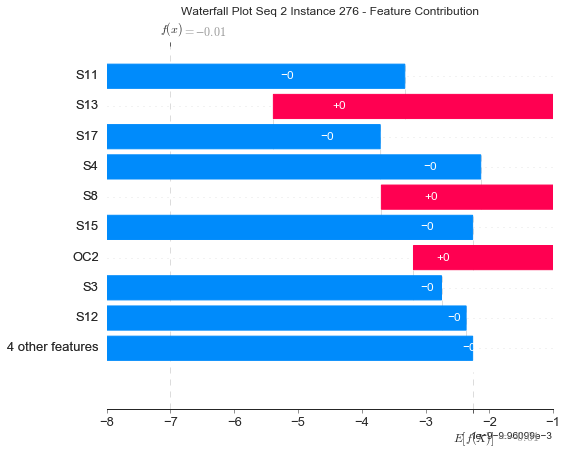

None

Contribution: [-2.38489140e-09 -1.13219850e-10  7.13591186e-10 -4.08787976e-10
 -4.94877339e-09  1.59406766e-09  2.13198148e-09 -5.26427346e-09
  3.13528203e-09  1.64632397e-09 -6.80585699e-10 -3.62738328e-09
  2.98518876e-09]


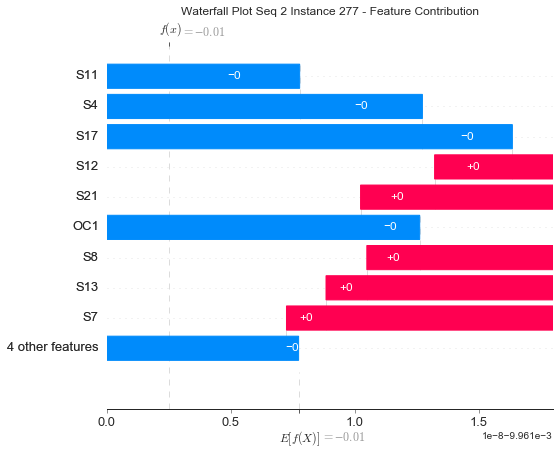

None

Contribution: [-1.21623533e-09 -2.76607959e-10  1.49706170e-09  2.49465421e-10
 -3.55018370e-09  5.63191271e-10  8.18919099e-10 -2.56152011e-09
  1.85567051e-09  3.98373973e-10 -8.95381269e-10 -4.37668568e-09
  2.18617524e-09]


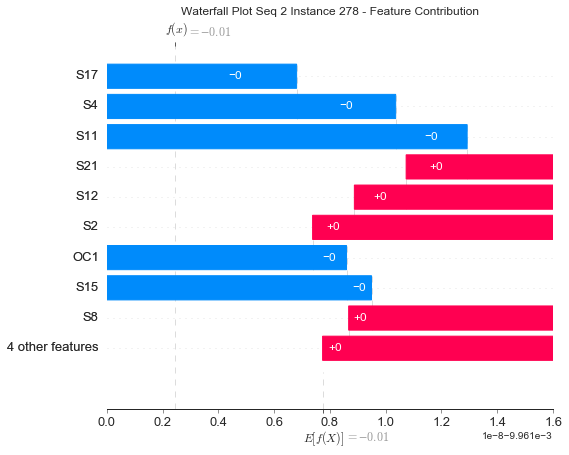

None

Contribution: [ 5.96914407e-10  1.09798814e-09  1.71760800e-10 -1.10369414e-09
 -1.02770361e-08  3.74016196e-09  7.01156866e-09 -1.47746437e-08
  6.59888011e-09  7.75251685e-09 -2.84095331e-10 -6.24353325e-09
  5.99347549e-09]


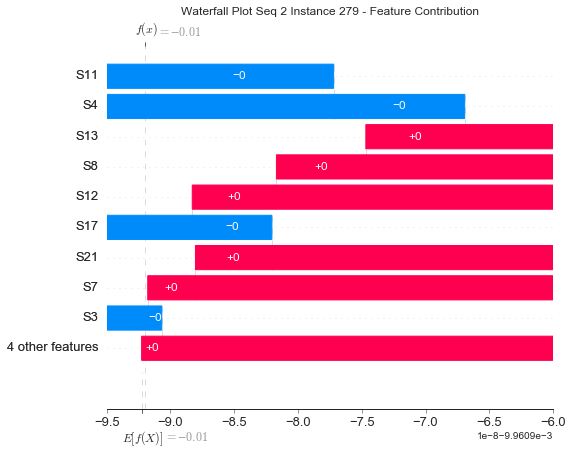

None

Contribution: [ 6.08176842e-09  4.08024325e-09 -3.02047776e-10 -9.31995037e-10
 -2.53831156e-09 -8.26716251e-10  4.15184598e-09 -7.85832643e-09
 -1.55767399e-09  6.23831609e-09 -3.68711595e-09 -1.45436674e-09
 -1.15449372e-09]


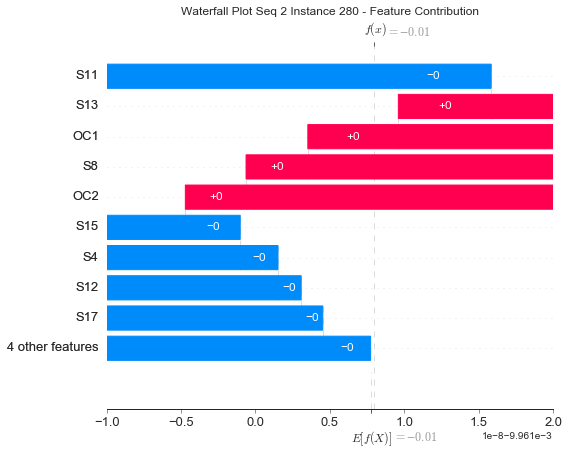

None

Contribution: [ 4.68674433e-09  4.06967793e-09 -3.46267043e-10 -1.18943955e-09
 -4.39686643e-09  8.74117390e-10  5.34283551e-09 -1.00512061e-08
  1.49046131e-09  7.24887084e-09 -3.92589339e-09 -3.08379566e-09
  1.51250523e-09]


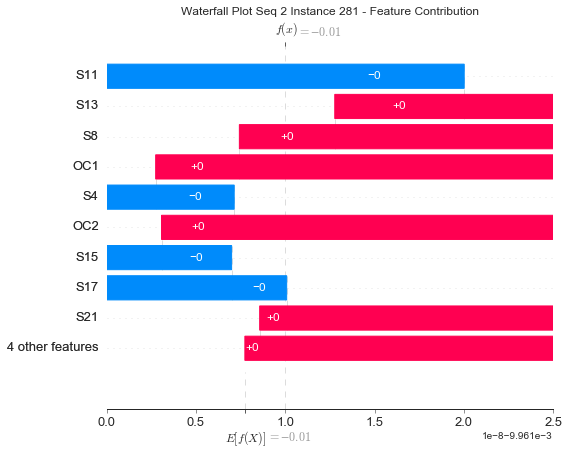

None

Contribution: [ 6.14087492e-09  4.87028640e-09 -3.46388696e-10 -1.26657596e-09
 -4.11288736e-09  6.95940527e-10  5.81425308e-09 -1.03110969e-08
  1.01510400e-09  8.28279756e-09 -3.88035160e-09 -3.09891290e-09
  1.20009003e-09]


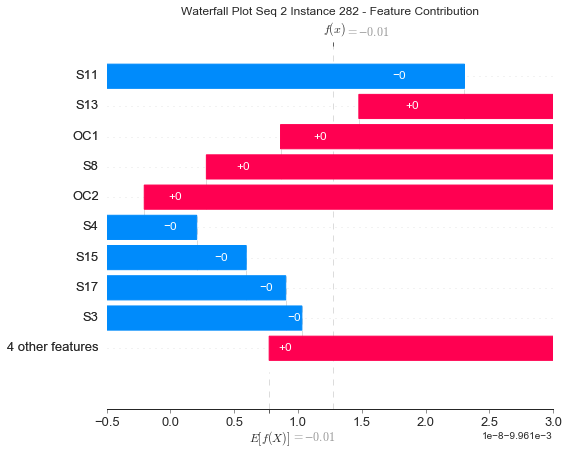

None

Contribution: [ 5.69242786e-09  3.50591089e-09  2.02187073e-10 -2.99576836e-10
 -5.59010338e-10  2.60881261e-10 -6.48820886e-10 -4.16857937e-10
  2.78608997e-10 -8.16876899e-10 -8.80333584e-09 -1.14367814e-10
  8.59815386e-10]


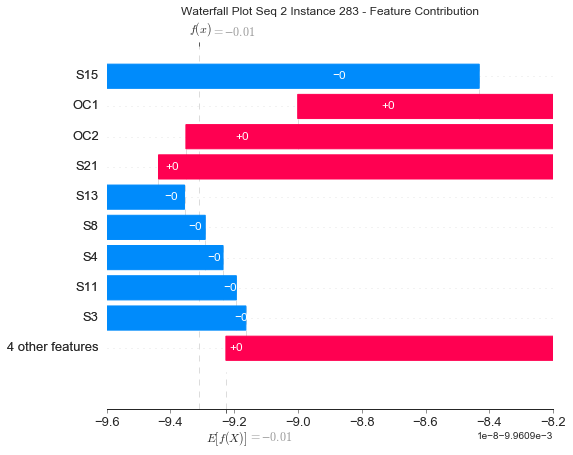

None

Contribution: [ 4.05526368e-09  3.17041637e-09 -5.25262542e-11 -3.66492142e-10
 -2.26672348e-09  4.34436848e-10  2.38293725e-11 -1.77431736e-09
  7.67366837e-10  2.58580119e-11 -1.32063169e-08 -8.34400937e-10
  1.17111509e-09]


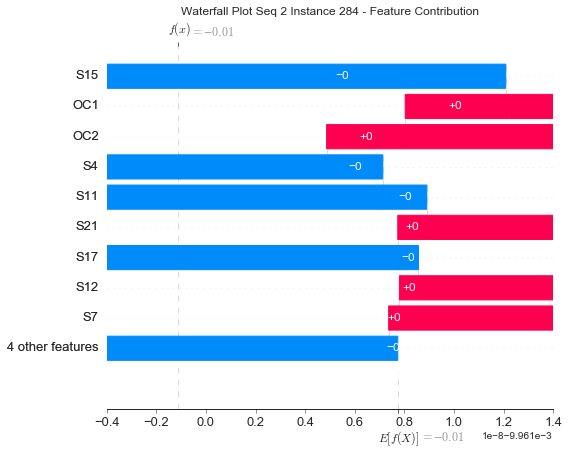

None

Contribution: [ 8.38388081e-10  2.05900452e-09  1.41053680e-09 -2.67692002e-09
 -1.70952266e-08  5.19946664e-09  1.04248077e-08 -2.43230804e-08
  1.00026769e-08  1.06271836e-08 -3.76004028e-09 -1.16121024e-08
  9.14012510e-09]


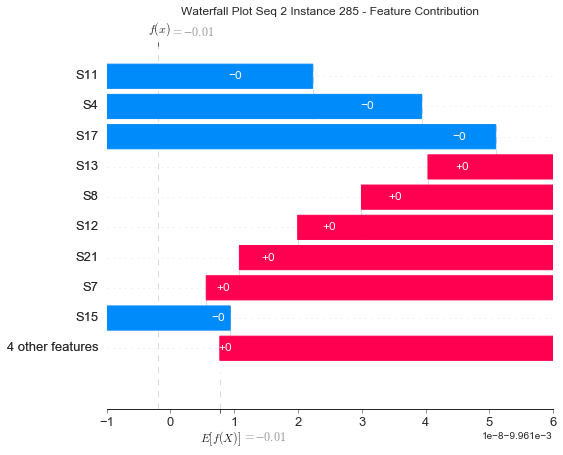

None

Contribution: [ 5.63476377e-10  2.41756526e-09  1.17696830e-09 -2.64173061e-09
 -1.85912885e-08  5.96072303e-09  1.19120829e-08 -2.64909090e-08
  1.13921015e-08  1.20162191e-08 -3.90538579e-09 -1.23167867e-08
  1.04523465e-08]


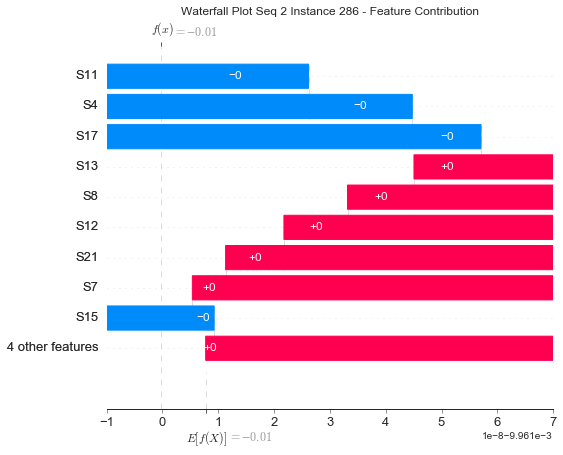

None

Contribution: [-6.35471065e-10  1.86493931e-10  1.79196391e-09 -3.11764015e-09
 -2.56218566e-08  1.11969802e-08  1.54567203e-08 -3.38666979e-08
  2.04572128e-08  1.41017518e-08 -1.85752447e-09 -1.74843180e-08
  1.81275102e-08]


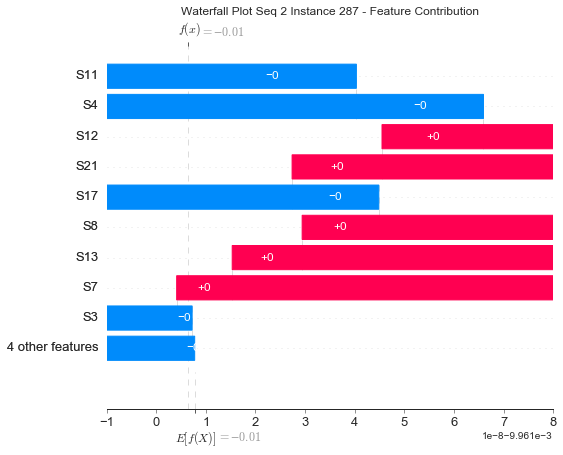

None

Contribution: [ 7.62995622e-09  8.58288640e-09  7.06519565e-10 -1.86020899e-09
 -8.28753421e-09  1.56539470e-09  1.07361080e-08 -1.79837034e-08
  2.58464516e-09  1.41648391e-08 -8.59224247e-09 -6.79398982e-09
  3.06878767e-09]


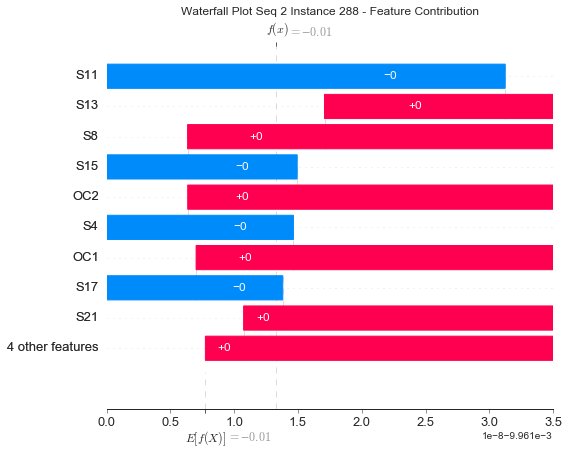

None

Contribution: [ 8.55809468e-09  6.95152602e-09  1.34696587e-09 -2.35962339e-09
 -9.08918629e-09  1.15162581e-10  9.83907977e-09 -1.97595185e-08
 -3.76029971e-11  1.33474325e-08 -9.60607682e-09 -7.36989625e-09
  1.23767130e-09]


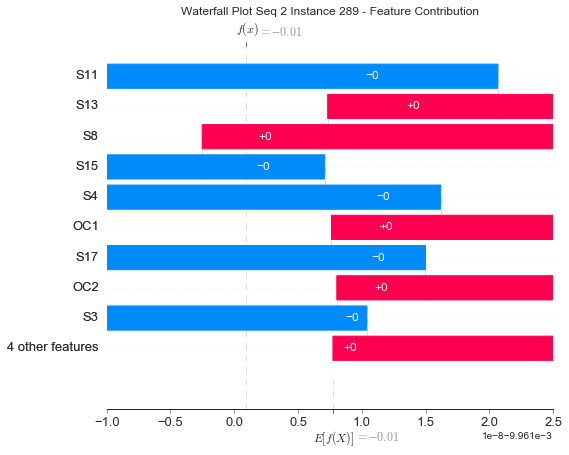

None

Contribution: [ 6.07977668e-10  3.03983994e-09  1.80027893e-09 -3.16755178e-09
 -2.32131239e-08  8.19265100e-09  1.53660213e-08 -3.26839107e-08
  1.44011141e-08  1.62156653e-08 -5.07559461e-09 -1.70459860e-08
  1.37846721e-08]


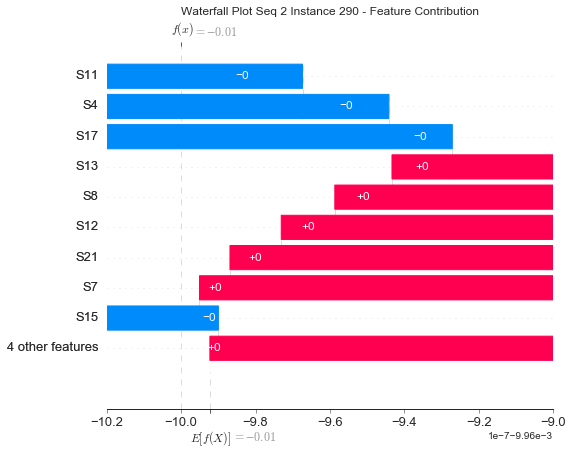

None

Contribution: [ 9.12603060e-09  7.58616903e-09  1.11424114e-09 -2.28710650e-09
 -7.96857247e-09 -1.07033948e-09  8.96710439e-09 -1.79291320e-08
 -1.91106175e-09  1.29143265e-08 -1.11941629e-08 -8.96591246e-09
 -3.16902393e-10]


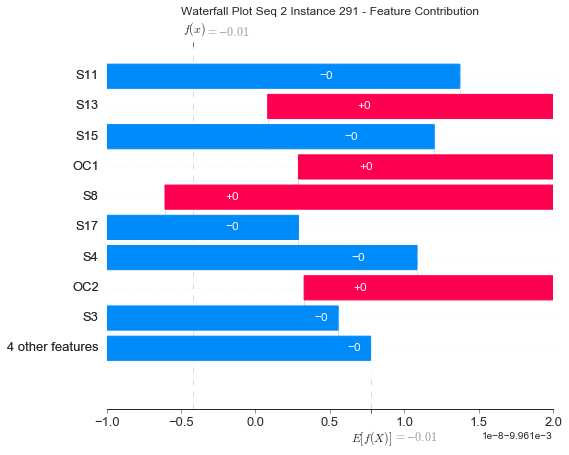

None

Contribution: [-4.67775152e-09  1.39624079e-09 -4.75951611e-10 -3.76198761e-09
 -2.69592988e-08  9.58524282e-09  1.80748749e-08 -3.83595307e-08
  1.64047371e-08  2.03236254e-08 -8.73075745e-09 -1.80332425e-08
  1.45965444e-08]


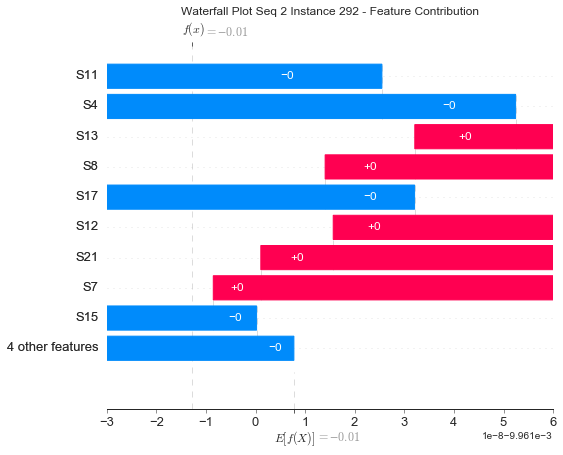

None

Contribution: [-5.95543792e-09  2.41577047e-09  1.08701226e-09  1.67993230e-09
 -2.90048346e-10  9.33841893e-10 -5.45746470e-09  8.91856100e-09
  1.57858271e-09 -6.90745594e-09 -2.62980038e-08 -1.99382666e-09
  2.11982387e-09]


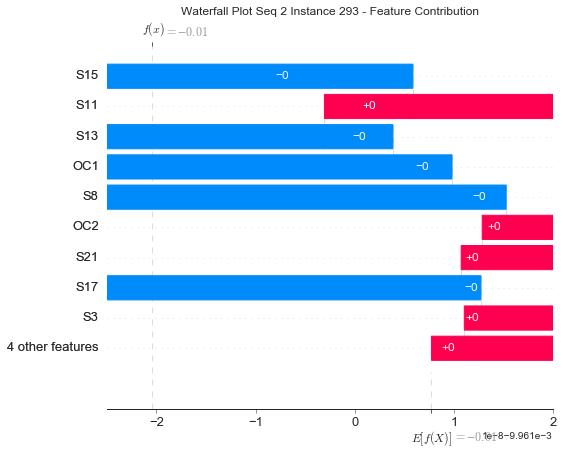

None

Contribution: [ 4.50912951e-09  9.71043779e-09 -6.25304697e-10 -5.76810777e-09
 -2.56261501e-08  7.47927853e-09  1.96279757e-08 -4.05678797e-08
  1.39901024e-08  2.07437694e-08 -1.44121790e-08 -1.91629965e-08
  1.22513617e-08]


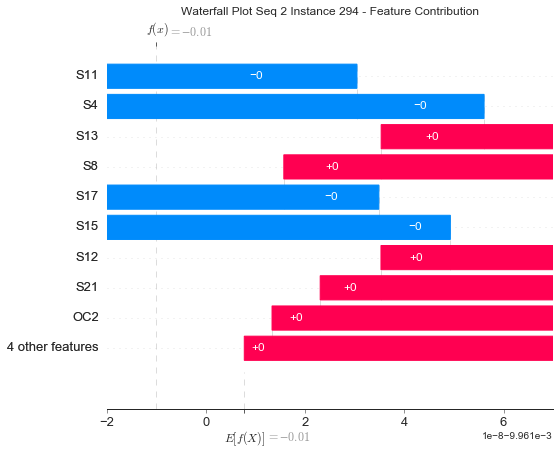

None

Contribution: [ 7.77893429e-13  0.00000000e+00 -8.32371283e-10 -6.79411594e-09
 -4.54242439e-08  1.94181471e-08  2.65003628e-08 -6.08436039e-08
  3.40045681e-08  2.56520405e-08 -2.60543320e-09 -2.86590183e-08
  2.89076425e-08]


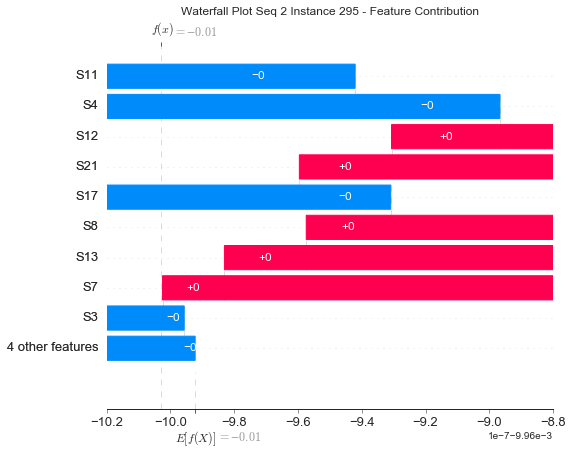

None

Contribution: [ 2.12519335e-08  1.25982851e-08 -1.45014845e-09 -4.73814321e-09
 -1.67344290e-08  3.81833870e-11  1.80726847e-08 -3.73398166e-08
  1.14293276e-10  2.66425833e-08 -1.32948799e-08 -9.54621093e-09
  4.25383118e-10]


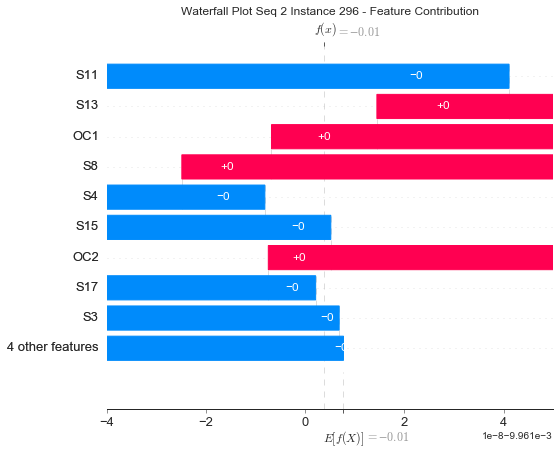

None

Contribution: [ 1.04676901e-12  1.17199609e-11 -3.16880411e-09 -1.03325171e-08
 -5.82979709e-08  2.71040879e-08  3.58033745e-08 -8.20471584e-08
  4.49277984e-08  3.64568393e-08 -3.15436233e-09 -3.26619585e-08
  3.58170915e-08]


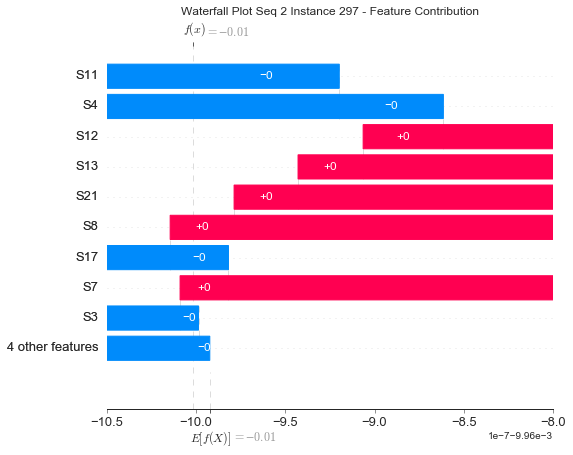

None

Contribution: [ 4.00510807e-08  2.54472887e-08 -3.66915165e-09 -7.37894723e-09
 -2.28020518e-08  4.92491870e-09  3.21662625e-08 -5.45545369e-08
  6.74649003e-09  4.66377372e-08 -1.01091686e-08 -1.19848433e-08
  6.82532697e-09]


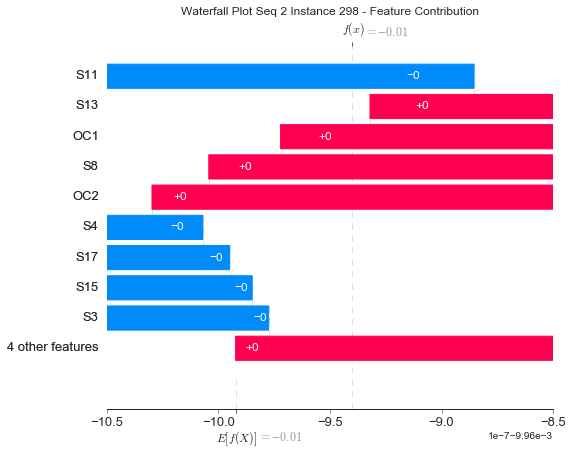

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


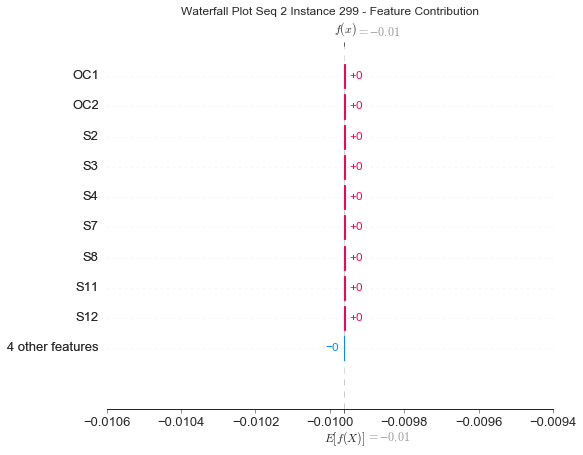

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


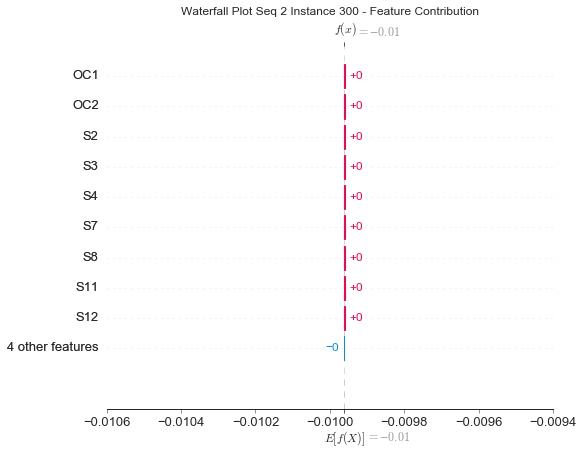

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


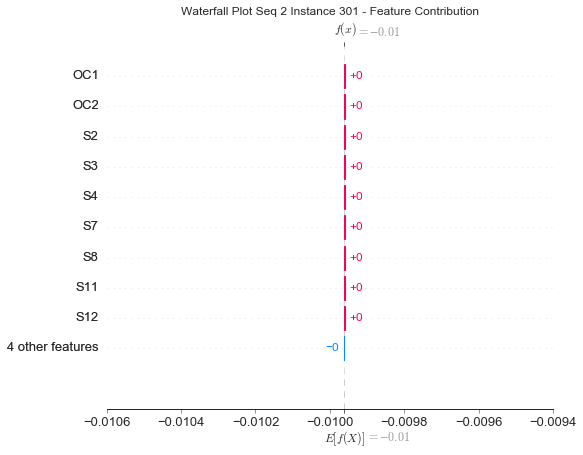

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


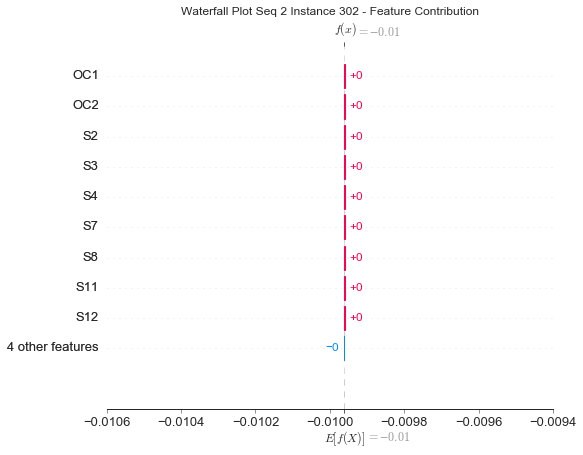

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


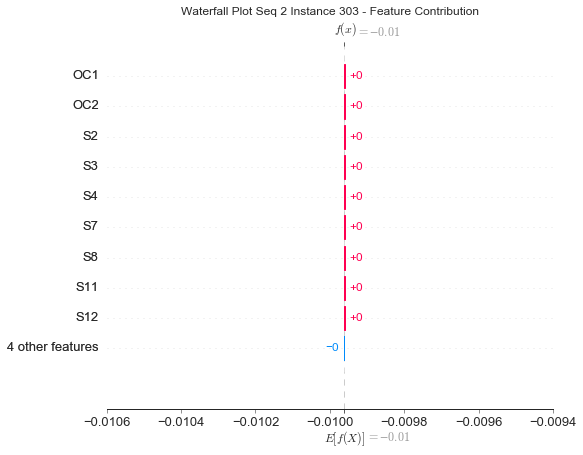

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


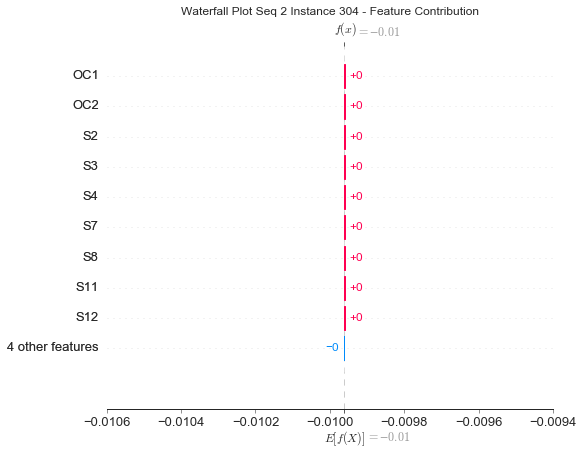

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


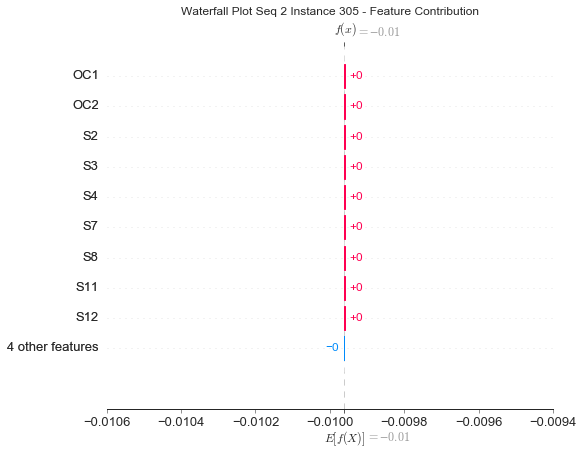

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


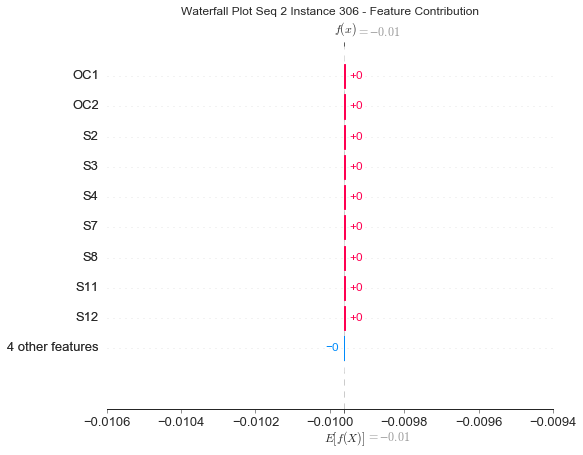

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


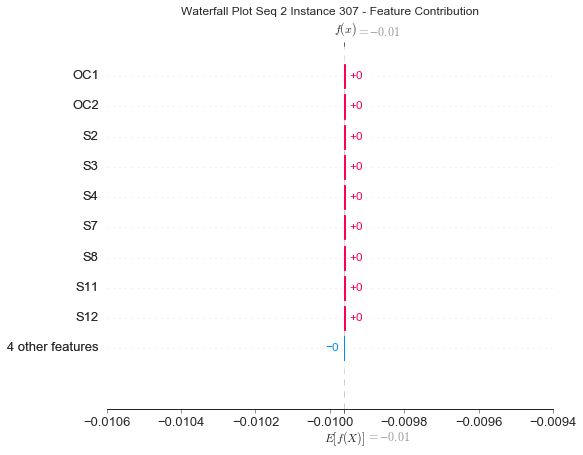

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


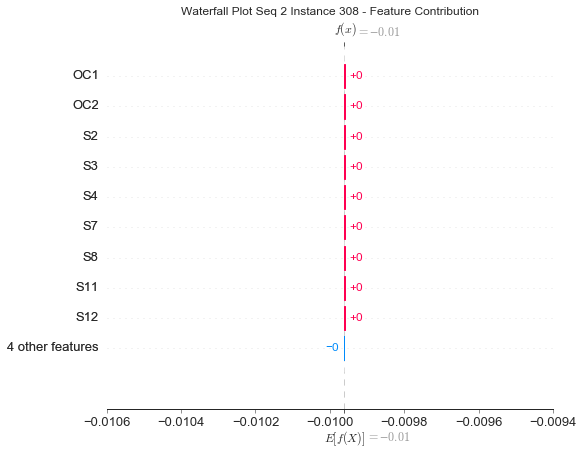

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


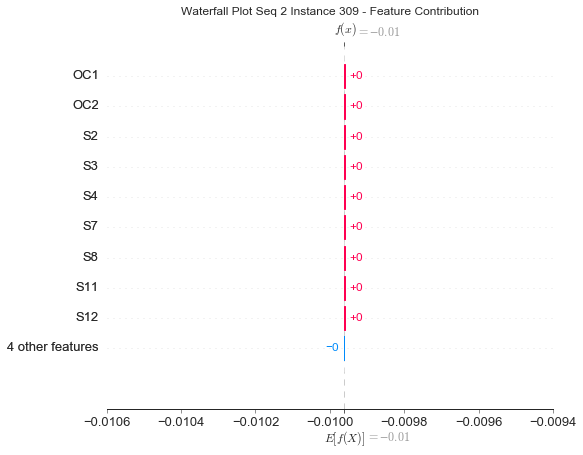

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


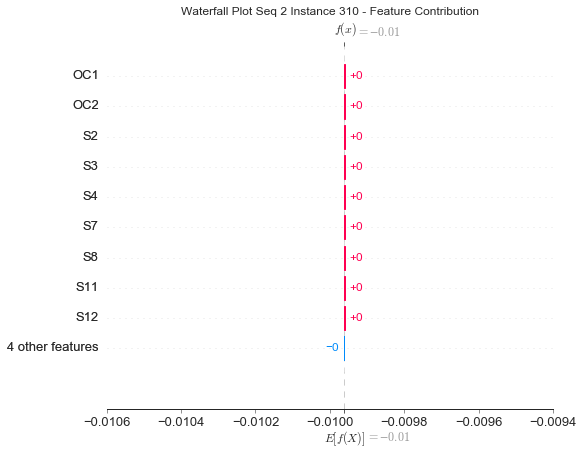

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


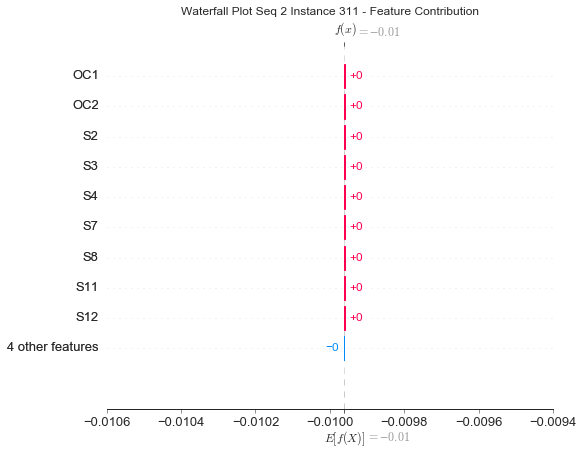

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


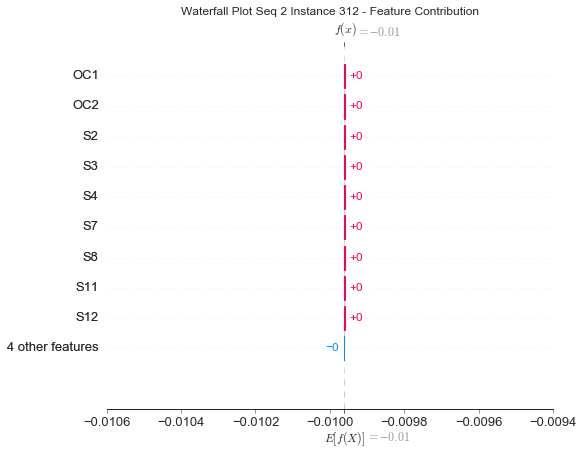

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


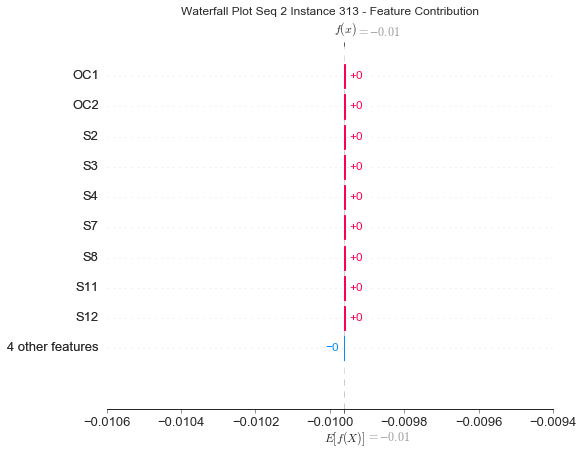

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


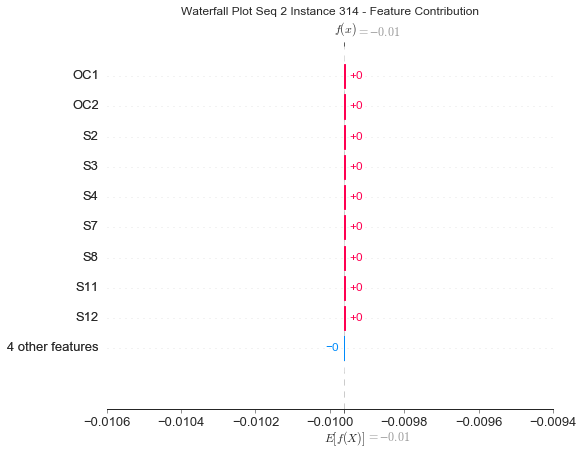

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


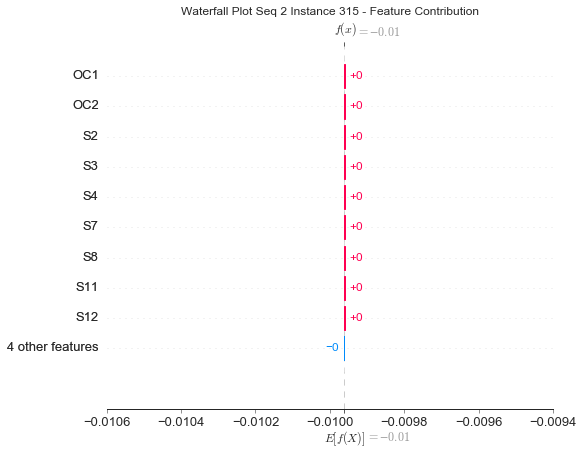

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


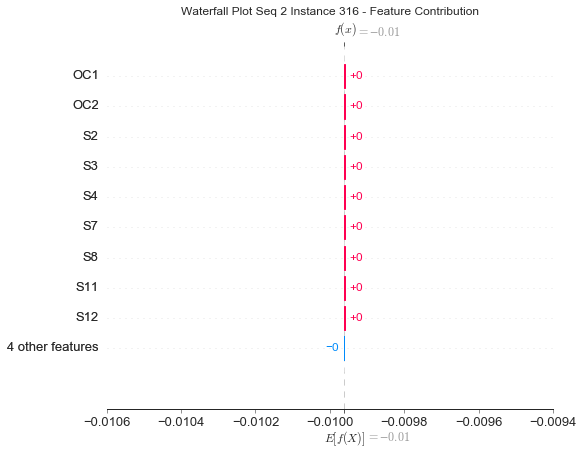

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


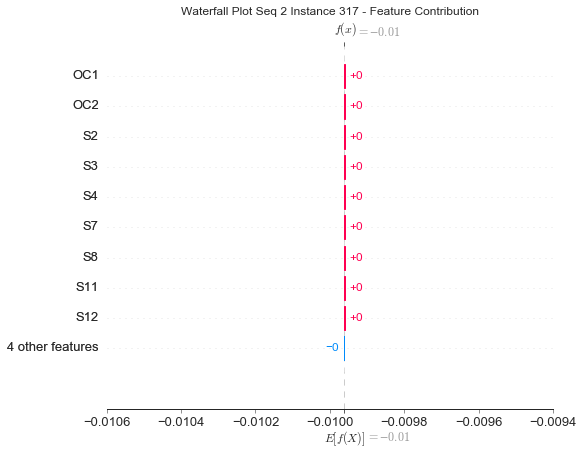

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


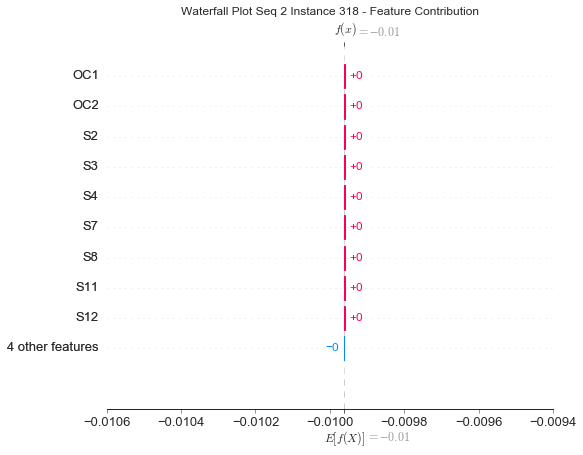

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


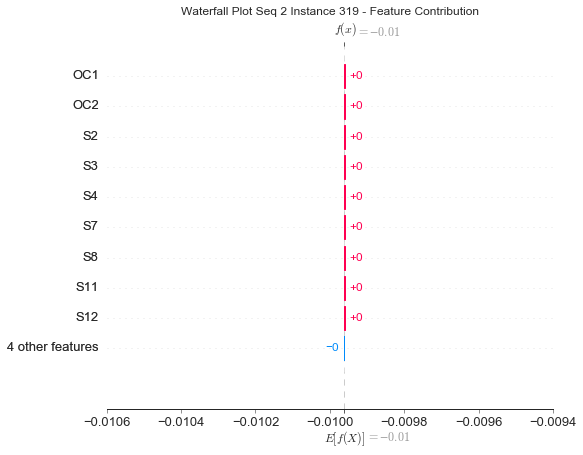

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


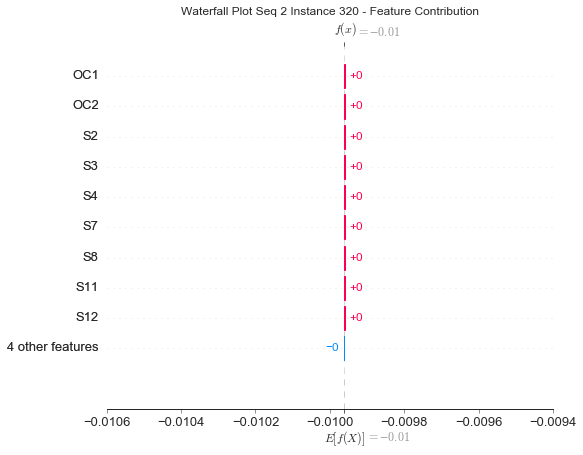

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


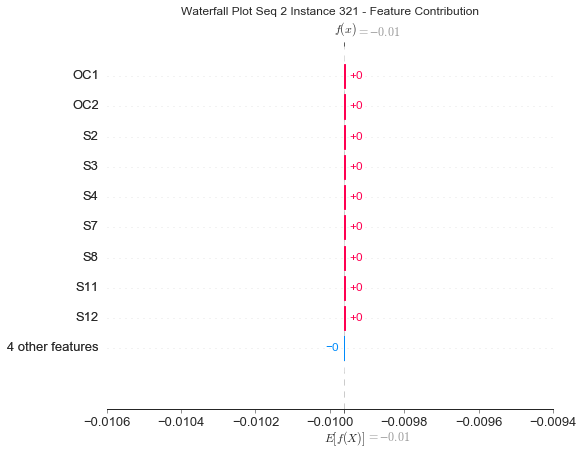

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


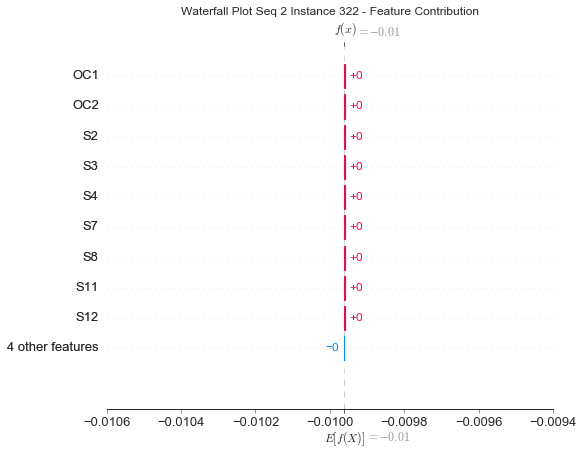

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


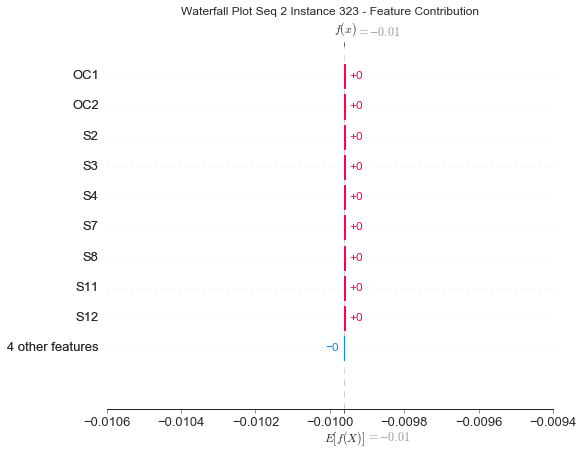

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


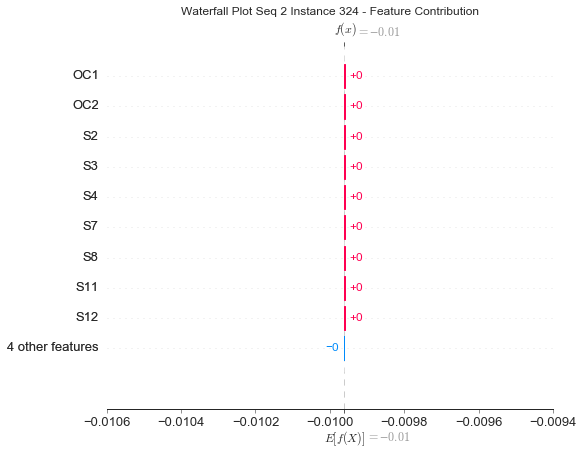

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


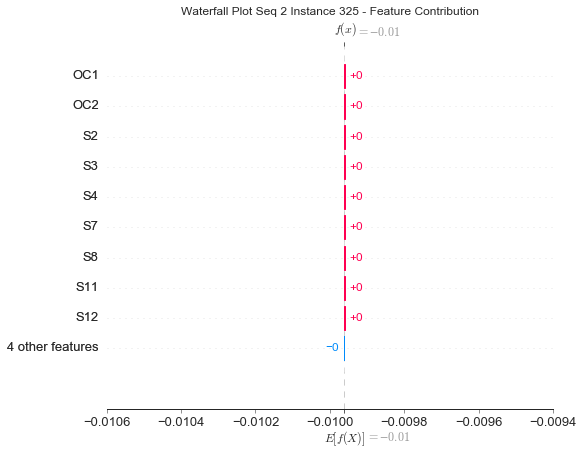

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


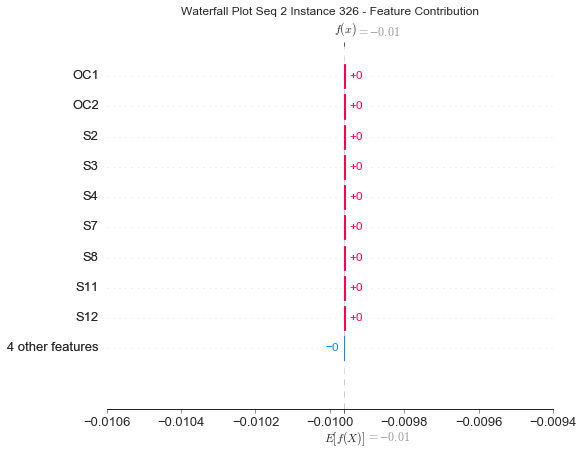

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


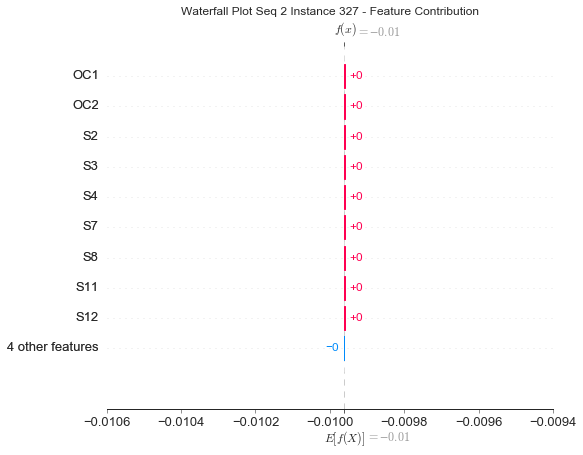

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


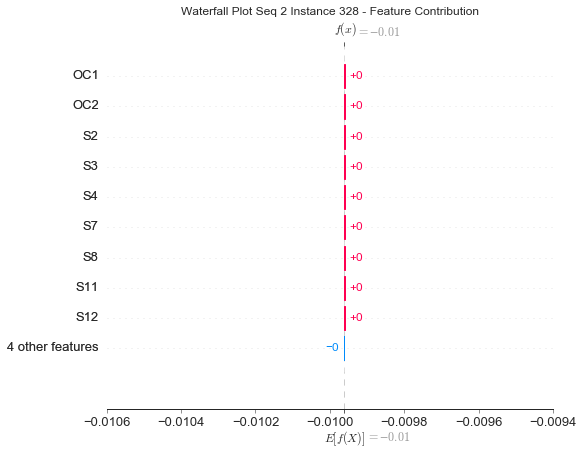

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


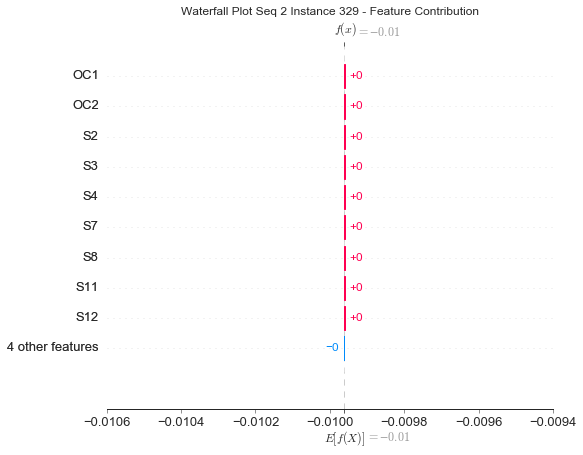

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


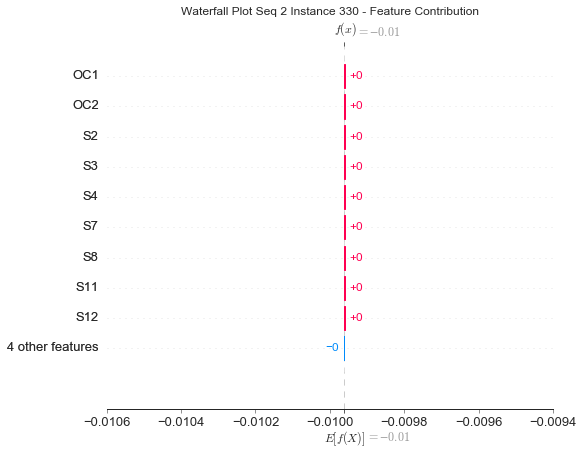

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


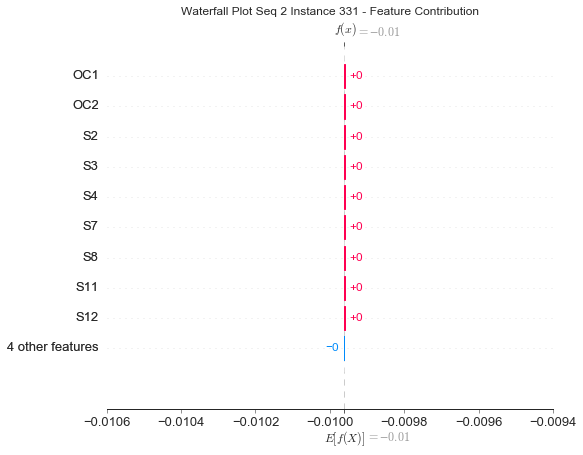

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


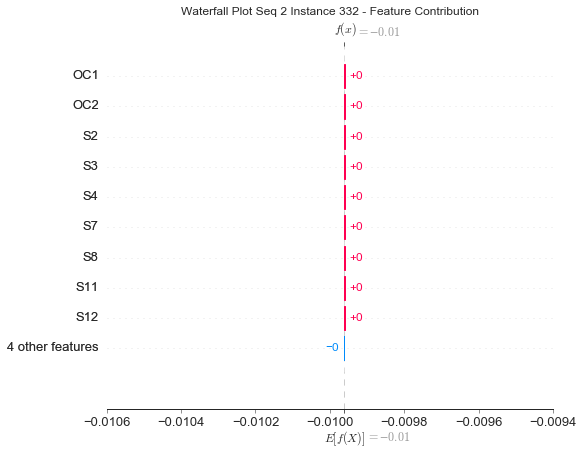

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


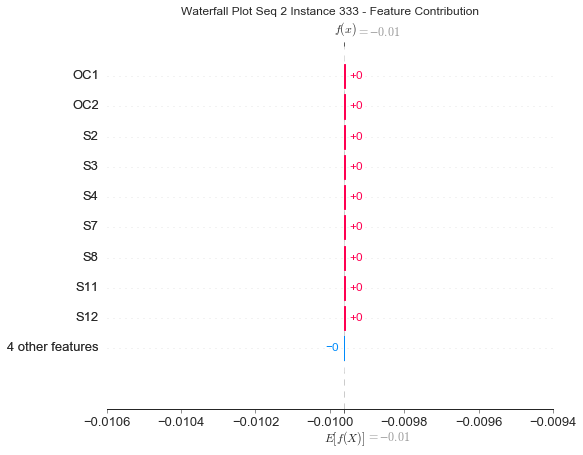

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


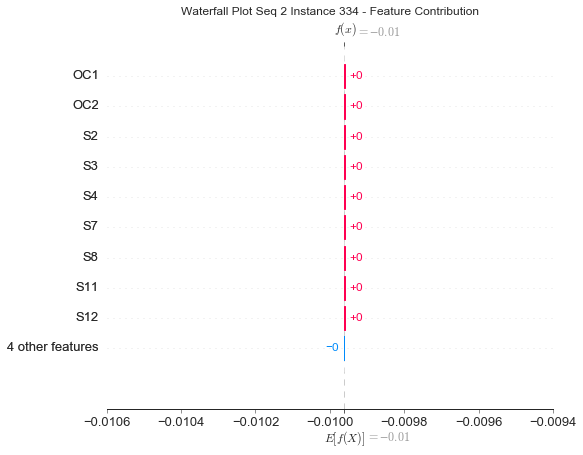

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


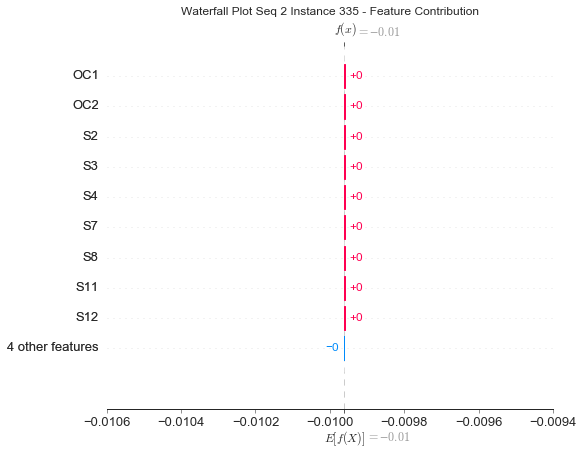

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


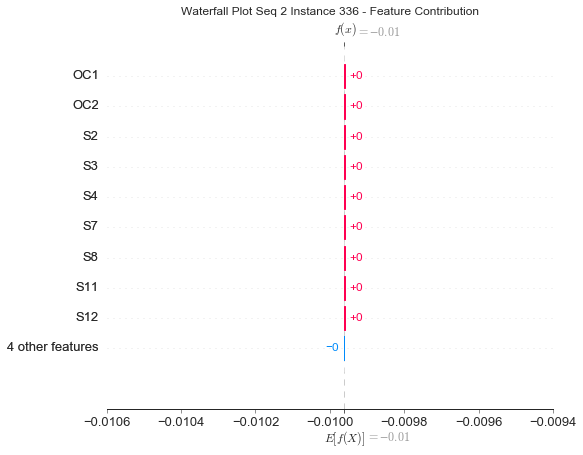

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


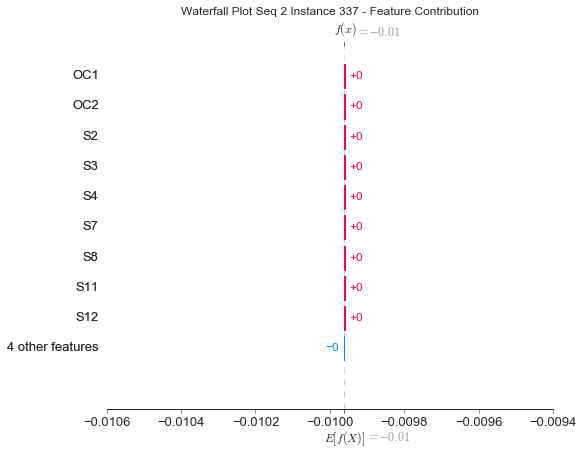

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


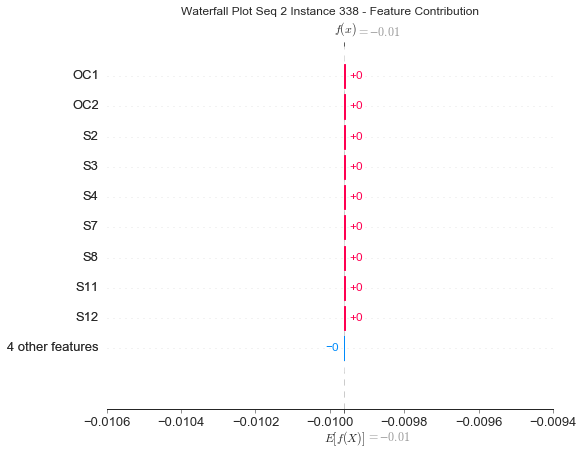

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


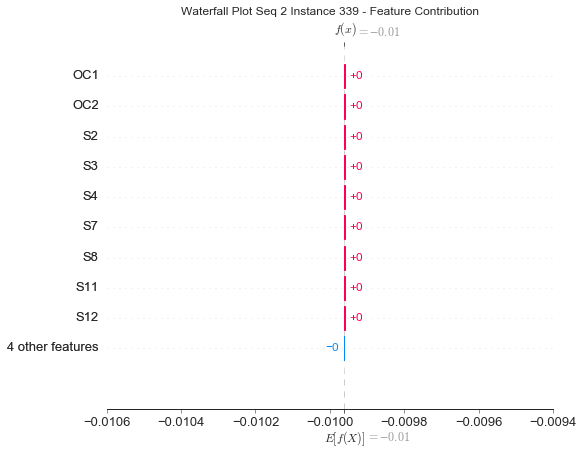

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


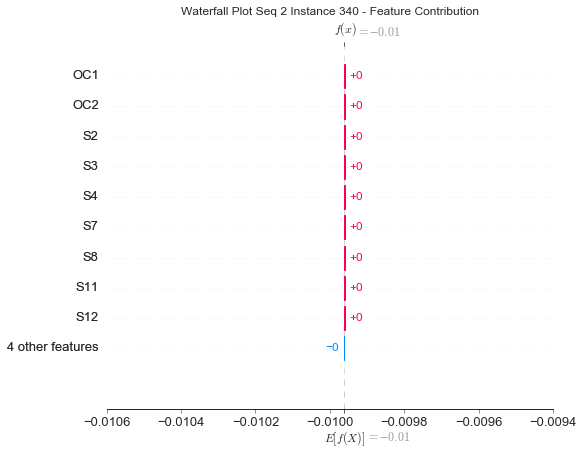

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


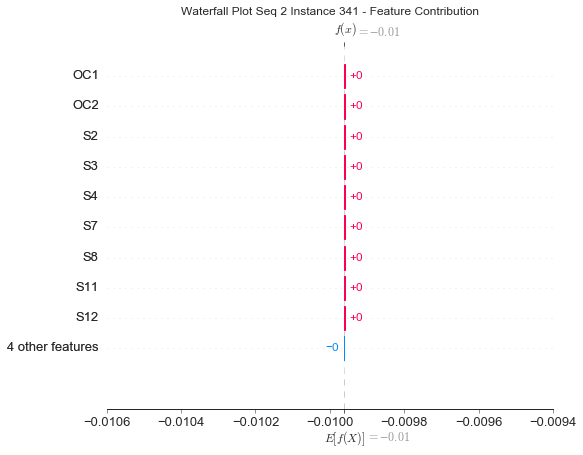

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


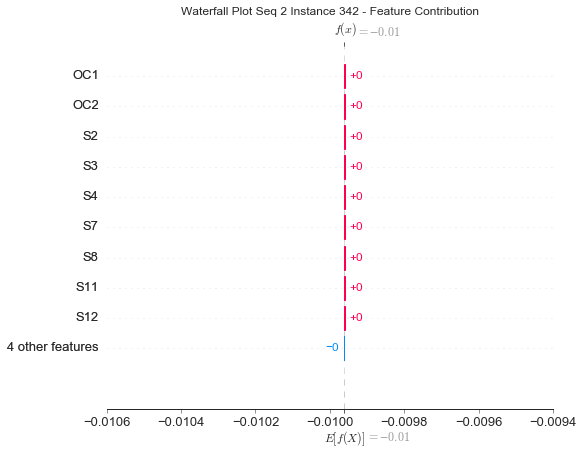

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


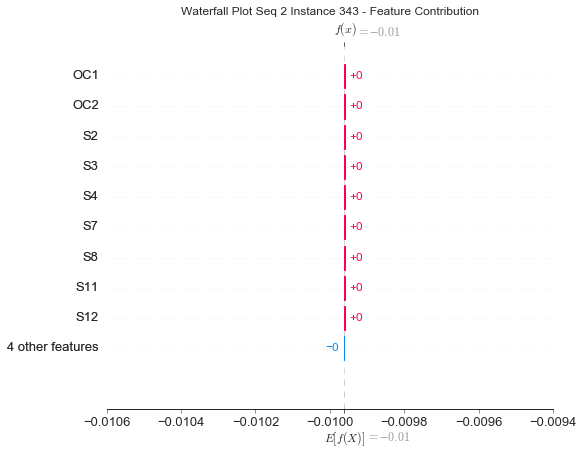

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


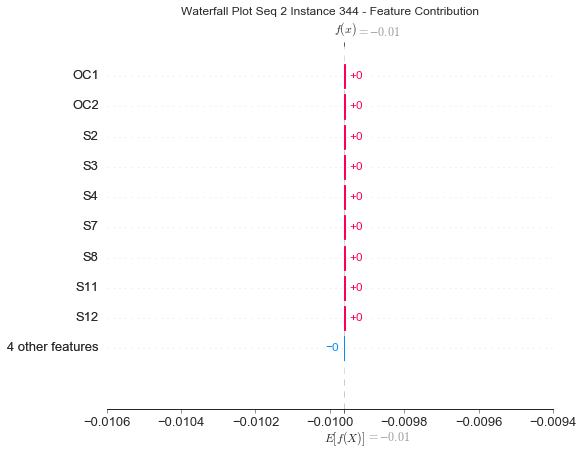

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


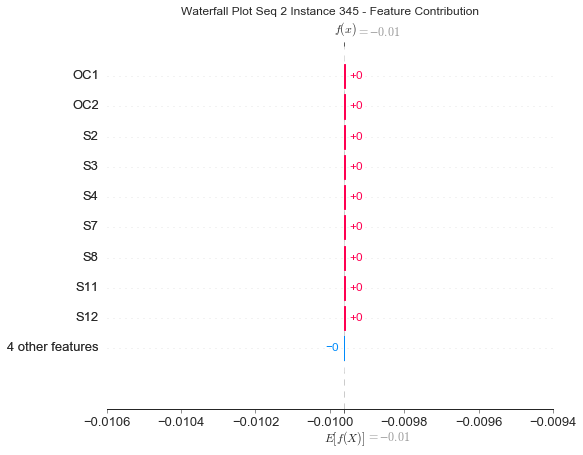

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


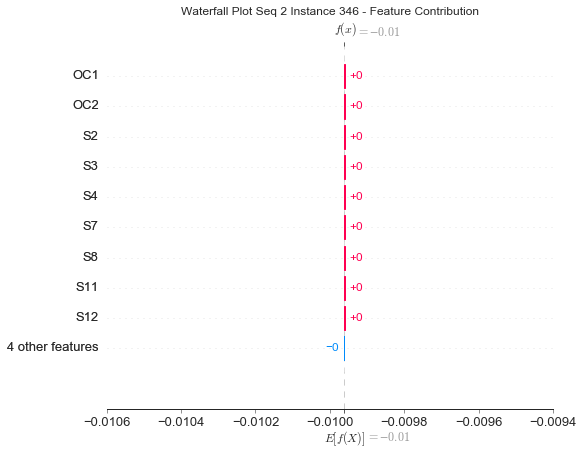

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


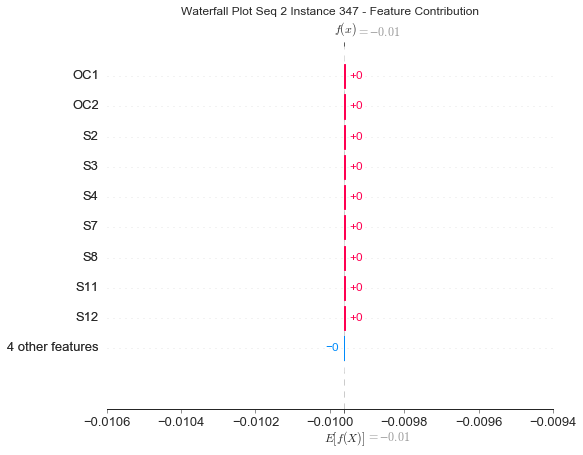

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


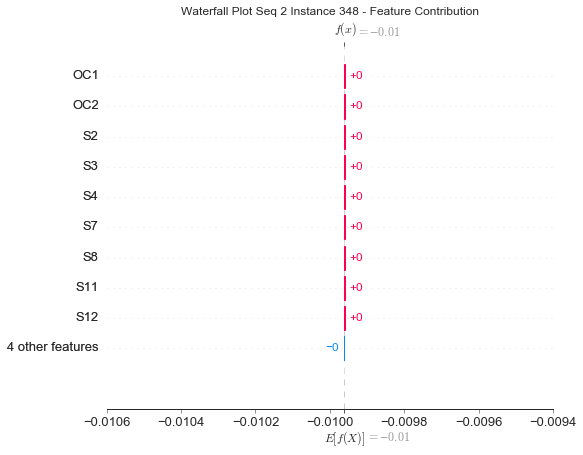

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


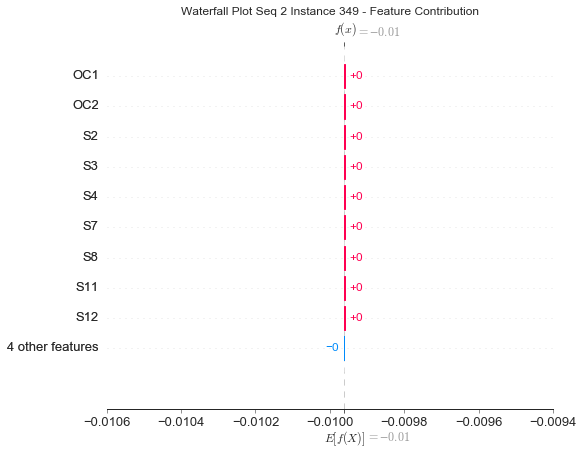

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


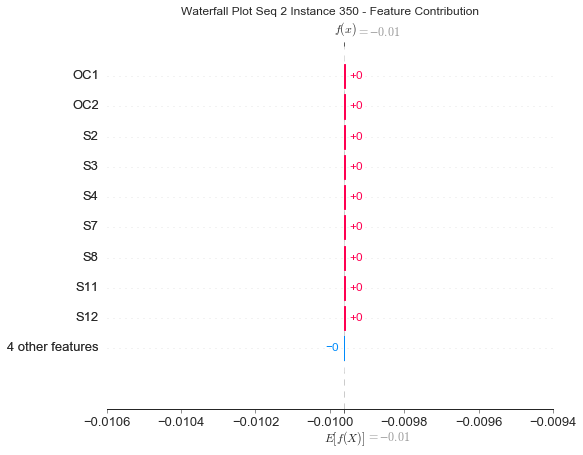

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


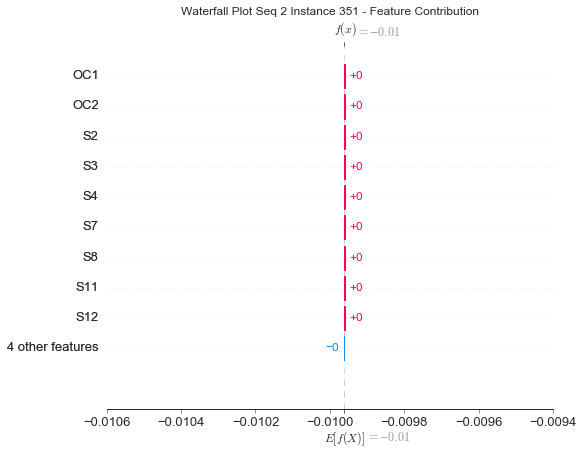

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


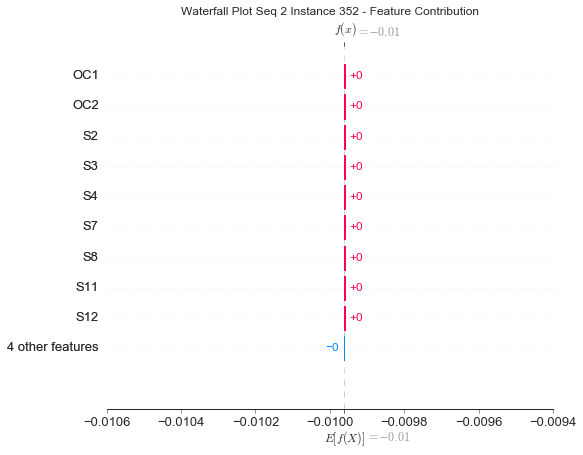

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


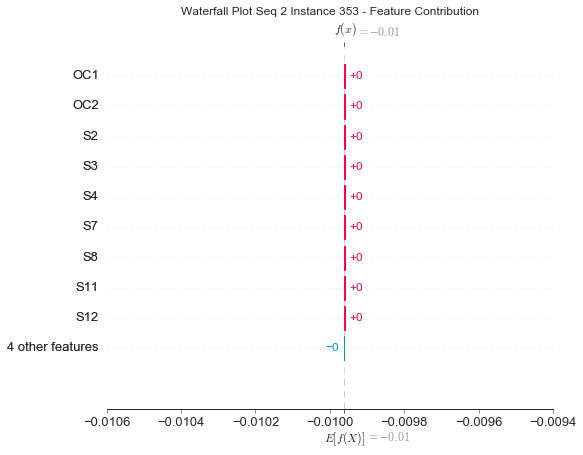

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


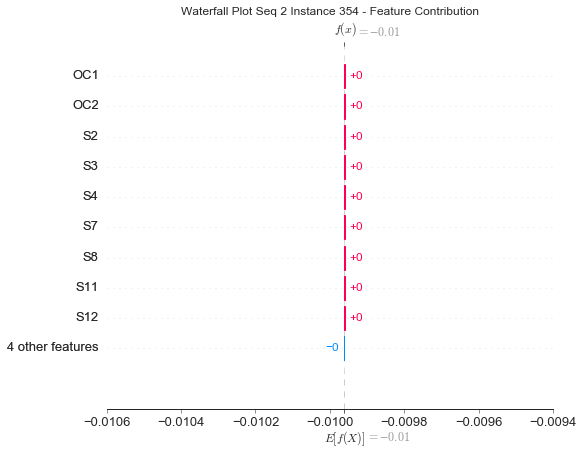

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


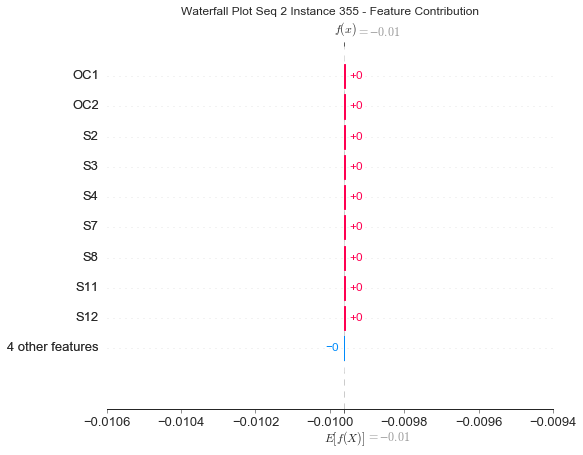

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


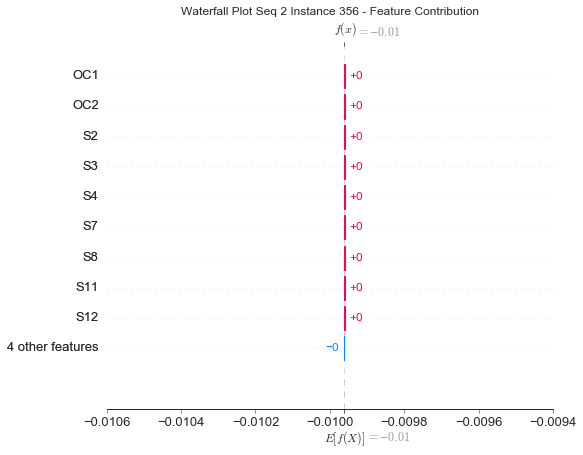

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


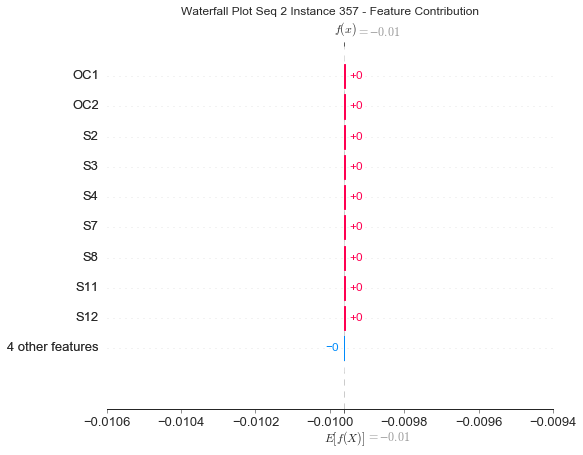

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


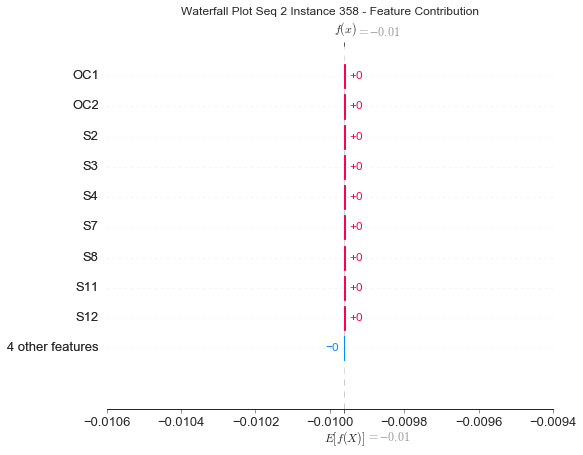

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


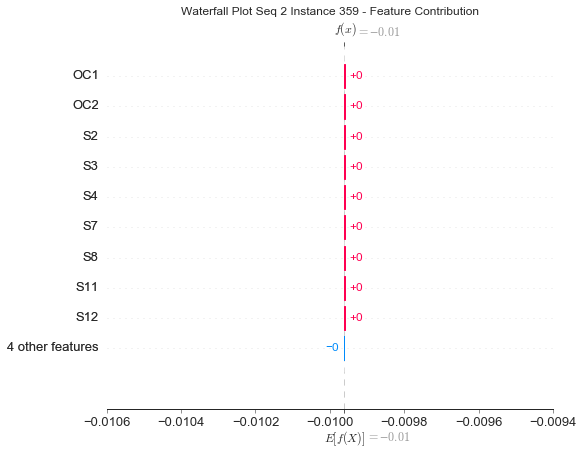

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


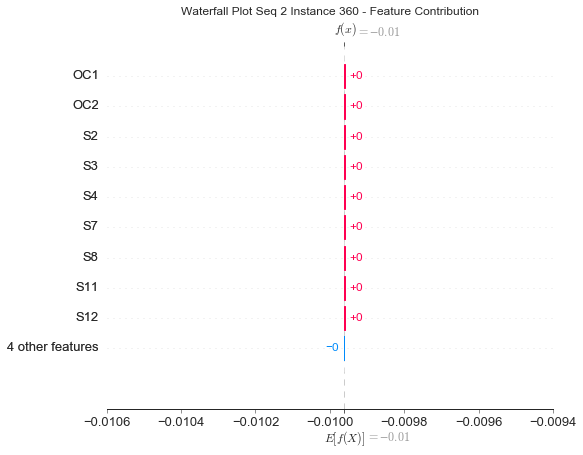

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


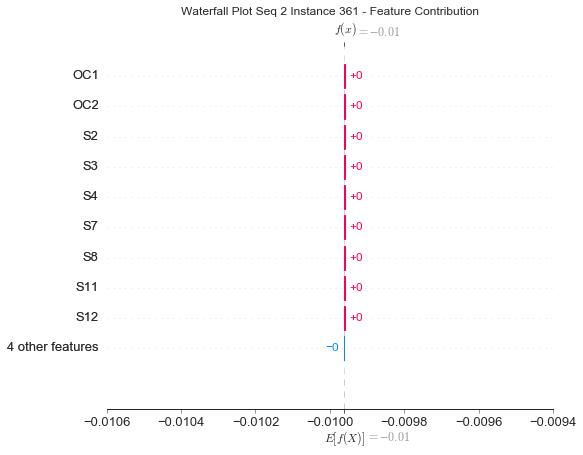

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


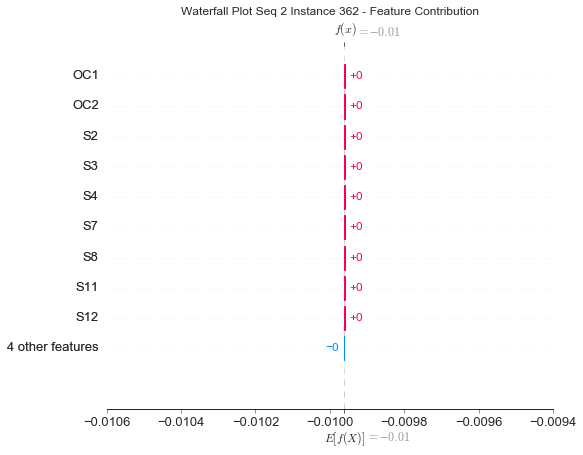

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


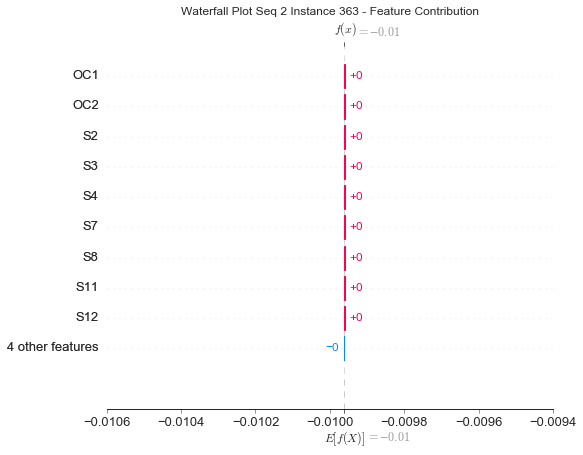

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


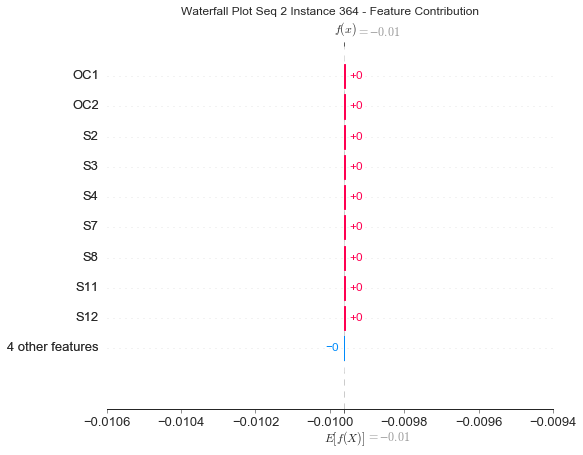

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


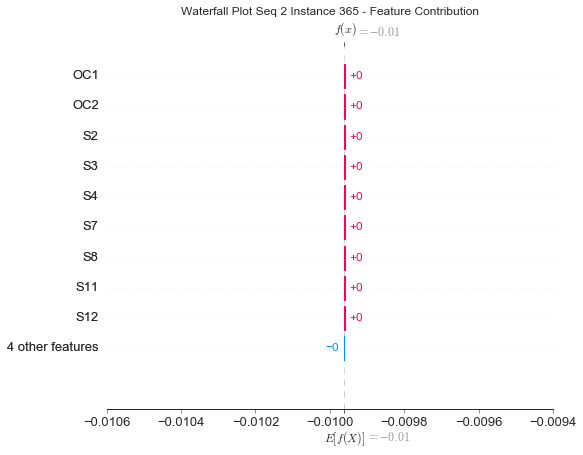

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


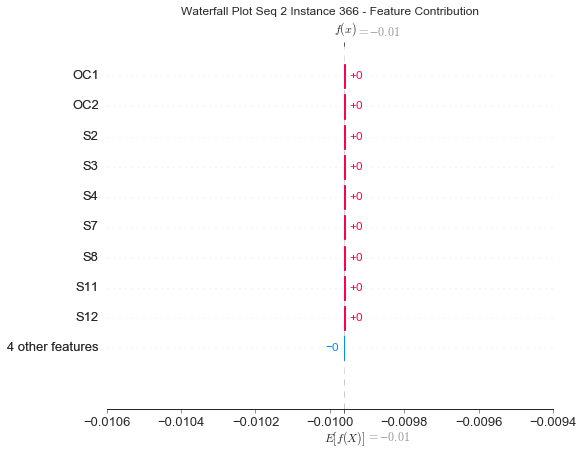

None

Contribution: [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


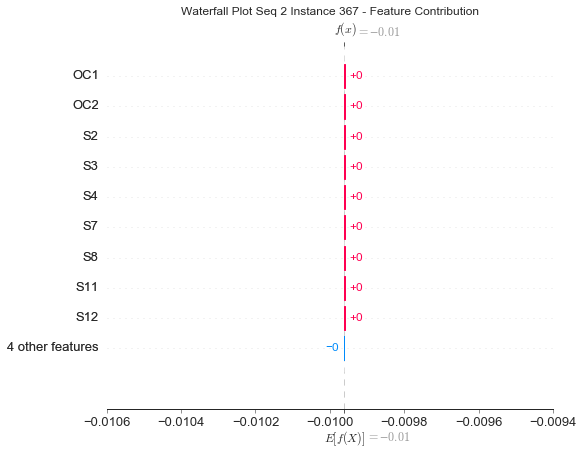

None

<Figure size 432x288 with 0 Axes>

In [57]:
#Waterfall Plot Fleet 2

for s in range(1,2):
    instance=x_test[s:s+1]
    shap_values = explainer.shap_values(instance)
    e = explainer.expected_value
    for j in range(pad):
        print("Contribution:",shap_values[0][0][j])
        plt.title("Waterfall Plot Seq %s " %(s+1)+"Instance %i - Feature Contribution" %(j+1),fontsize=12)
        waterfall_display = shap.plots._waterfall.waterfall_legacy(e[0],shap_values[0][0][j],feature_names=features,show=True)
        display(waterfall_display)
        plt.savefig("Waterfall_Plot %i" %i+'.tiff')
        plt.figure